# TTT4185 Machine learning for Speech technology

## Computer assigment 3b:  Regression analysis

Regression analysis is used to estimate/measure the relationship between an _independent_ variable, say $x$, and a _dependent_ variable, say $y$. One of the simplest regression problems is 
\begin{equation}
y = ax + b
\end{equation}
where $a$ and $b$ are constants. In practice our observations will be contaminated by noise, so we have
\begin{equation}
y = ax + b + n,
\end{equation}
where $n$ is noise, eg. measurement errors. This particular problem is called _linear regression_.

We will have a look at _non-linear regression_, using deep neural networks. Here we are looking at general regression problems in the form 
\begin{equation}
y = f(x) + n.
\end{equation}

We generate our data according to the function $f(x) = x^2 + \cos(20x) \text{ sign}(x)$, obtaining a set of observations $\{(x_i,y_i)\}$.

Then we assume we do not know the underlying function and we try to recover and approximation of $f$ only using the observations $\{(x_i,y_i)\}$.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import tensorflow as tf
from tensorflow import keras

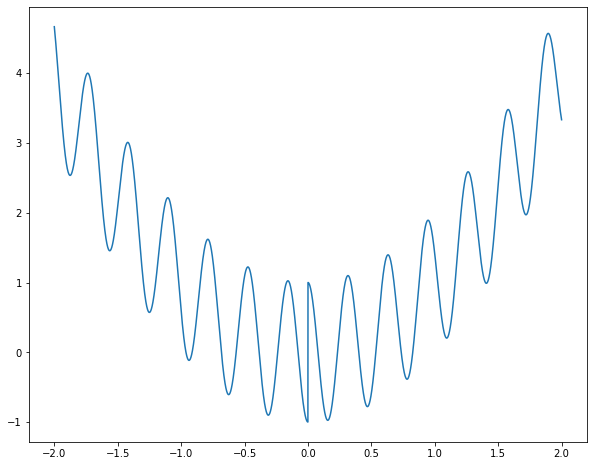

In [2]:
# Define function
def f(x):
    return x**2 + np.cos(20*x)*np.sign(x)

# Setup some simulation parameters
# Number of observations
N = 5000

# Plot a "clean" version of the relationship between x and y
plt.figure(figsize=(10, 8))
x = np.linspace(-2,2,N)
plt.plot(x,f(x))
plt.show()

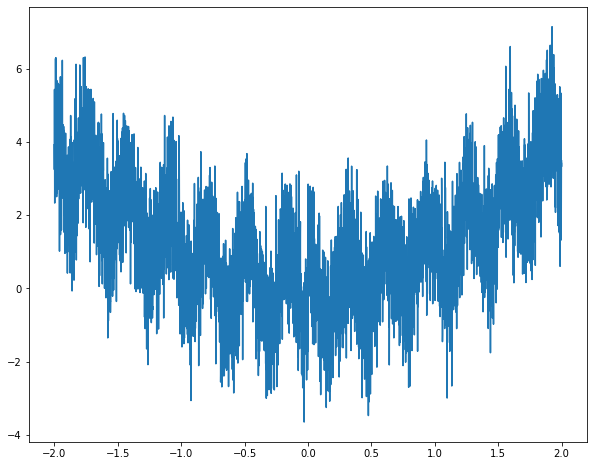

In [3]:
# Create a noise version of the observations
y = f(x) + np.random.randn(len(x))
plt.figure(figsize=(10, 8))
plt.plot(x,y)
plt.show()

One way to perform regression is to assume that the data is generated using a set of functions from a cerain family, for example polynomials of order $p$,
\begin{equation}
\hat f(x) = a_0 + a_1 x + a_2 x^2 \ldots a_p x^p.
\end{equation}
Then regression corresponds to fitting the parameters in the model. Let us see how this works out before using our neural networks.

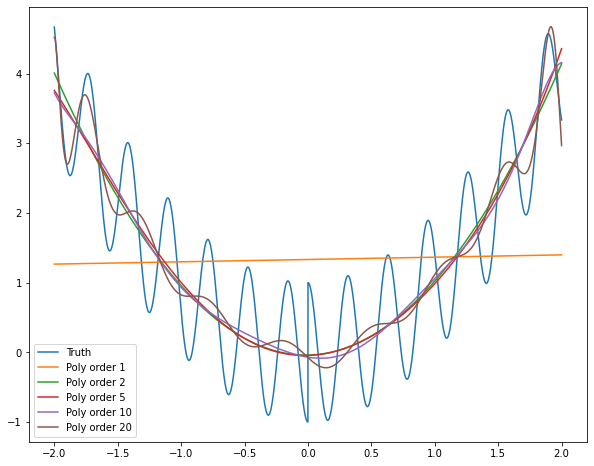

In [4]:
# Give a set of polynomial orders to try
P = [1, 2, 5, 10, 20]

# Define estimator function. Arguments are inout variable, observation and polynomial order
# Returns a set of polynomial coefficients
def reg_estimator(x,y,p):
    # Use simple ls approach
    N = len(x)
    H = np.zeros((N,p+1))
    for col in range(p+1):
        H[:,col] = x**col
    iHtH = np.linalg.inv(np.dot(H.T,H))
    theta = np.dot(np.dot(iHtH,H.T),y)
    return theta

# Computes fx) = c_0 + c_1x + c_2 x^2 ... c_p x^p
def poly(x, C):
    # compute p(x) for coeffs in c
    y = 0*x
    for p, c in enumerate(C):
        y += c*x**p        
    return y

plt.figure(figsize=(10,8))
plt.plot(x,f(x),label="Truth")
for p in P:
    C = reg_estimator(x,y,p)
    plt.plot(x,poly(x,C),label="Poly order " + str(p))
plt.legend()
plt.show()

## Problem 1
Play with different $p$ to see how close you can get to the true function.

Note: Very high $p$ will give numerical problems.

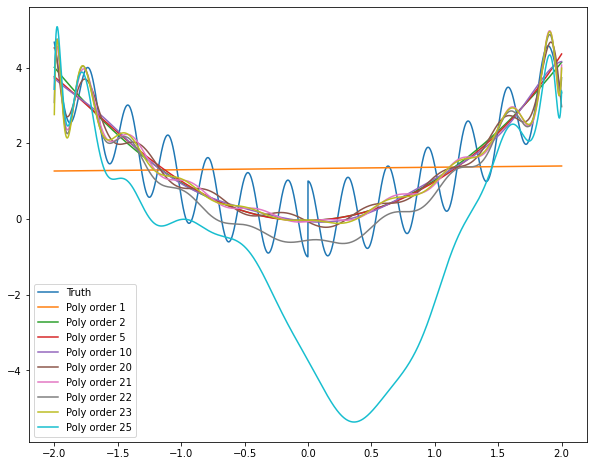

In [5]:
# Give a set of polynomial orders to try
P = [1, 2, 5, 10, 20,21,22,23,25]


plt.figure(figsize=(10,8))
plt.plot(x,f(x),label="Truth")
for p in P:
    C = reg_estimator(x,y,p)
    plt.plot(x,poly(x,C),label="Poly order " + str(p))
plt.legend()
plt.show()

In what follows we will use a deep neural network to approximate $f$. We set this up below

In [6]:
# Ceate a model with a single hidden layer. Note that input and output has
# dimension one
M = 512
model = keras.Sequential([
    keras.layers.Dense(M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(1)
])

model.summary()
# Train the model
model.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 512)               1024      
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 513       
Total params: 1,537
Trainable params: 1,537
Non-trainable params: 0
_________________________________________________________________


We train the network by using $x$ as an input and the squared error between the network output $\hat y$ and the observed value $y$ as a loss
\begin{equation}
 L = \frac{1}{N} \sum_n (\hat y - y)^2
\end{equation}

We first try our network on clean data to check if it works.

In [7]:
# train the model
history = model.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)

Epoch 1/1000
40/40 [==============================] - 0s 436us/step - loss: 1.8367 - accuracy: 0.0000e+00
Epoch 2/1000
40/40 [==============================] - 0s 411us/step - loss: 0.8545 - accuracy: 0.0000e+00
Epoch 3/1000
40/40 [==============================] - 0s 411us/step - loss: 0.7083 - accuracy: 0.0000e+00
Epoch 4/1000
40/40 [==============================] - 0s 440us/step - loss: 0.6320 - accuracy: 0.0000e+00
Epoch 5/1000
40/40 [==============================] - 0s 411us/step - loss: 0.5862 - accuracy: 0.0000e+00
Epoch 6/1000
40/40 [==============================] - 0s 411us/step - loss: 0.5569 - accuracy: 0.0000e+00
Epoch 7/1000
40/40 [==============================] - 0s 411us/step - loss: 0.5356 - accuracy: 0.0000e+00
Epoch 8/1000
40/40 [==============================] - 0s 436us/step - loss: 0.5232 - accuracy: 0.0000e+00
Epoch 9/1000
40/40 [==============================] - 0s 411us/step - loss: 0.5175 - accuracy: 0.0000e+00
Epoch 10/1000
40/40 [=========================

40/40 [==============================] - 0s 411us/step - loss: 0.4914 - accuracy: 0.0000e+00
Epoch 78/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4903 - accuracy: 0.0000e+00
Epoch 79/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4919 - accuracy: 0.0000e+00
Epoch 80/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4896 - accuracy: 0.0000e+00
Epoch 81/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4905 - accuracy: 0.0000e+00
Epoch 82/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4929 - accuracy: 0.0000e+00
Epoch 83/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4898 - accuracy: 0.0000e+00
Epoch 84/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4895 - accuracy: 0.0000e+00
Epoch 85/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4897 - accuracy: 0.0000e+00
Epoch 86/1000
40/40 [==============================

40/40 [==============================] - 0s 411us/step - loss: 0.4873 - accuracy: 0.0000e+00
Epoch 154/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4885 - accuracy: 0.0000e+00
Epoch 155/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4872 - accuracy: 0.0000e+00
Epoch 156/1000
40/40 [==============================] - 0s 436us/step - loss: 0.4869 - accuracy: 0.0000e+00
Epoch 157/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4861 - accuracy: 0.0000e+00
Epoch 158/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4875 - accuracy: 0.0000e+00
Epoch 159/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4877 - accuracy: 0.0000e+00
Epoch 160/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4880 - accuracy: 0.0000e+00
Epoch 161/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4882 - accuracy: 0.0000e+00
Epoch 162/1000
40/40 [=====================

Epoch 229/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4853 - accuracy: 0.0000e+00
Epoch 230/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4828 - accuracy: 0.0000e+00
Epoch 231/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4837 - accuracy: 0.0000e+00
Epoch 232/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4848 - accuracy: 0.0000e+00
Epoch 233/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4867 - accuracy: 0.0000e+00
Epoch 234/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4848 - accuracy: 0.0000e+00
Epoch 235/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4857 - accuracy: 0.0000e+00
Epoch 236/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4830 - accuracy: 0.0000e+00
Epoch 237/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4867 - accuracy: 0.0000e+00
Epoch 238/1000
40/40 [======

40/40 [==============================] - 0s 411us/step - loss: 0.4823 - accuracy: 0.0000e+00
Epoch 305/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4852 - accuracy: 0.0000e+00
Epoch 306/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4830 - accuracy: 0.0000e+00
Epoch 307/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4818 - accuracy: 0.0000e+00
Epoch 308/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4875 - accuracy: 0.0000e+00
Epoch 309/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4863 - accuracy: 0.0000e+00
Epoch 310/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4822 - accuracy: 0.0000e+00
Epoch 311/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4850 - accuracy: 0.0000e+00
Epoch 312/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4820 - accuracy: 0.0000e+00
Epoch 313/1000
40/40 [=====================

Epoch 380/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4811 - accuracy: 0.0000e+00
Epoch 381/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4809 - accuracy: 0.0000e+00
Epoch 382/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4821 - accuracy: 0.0000e+00
Epoch 383/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4800 - accuracy: 0.0000e+00
Epoch 384/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4817 - accuracy: 0.0000e+00
Epoch 385/1000
40/40 [==============================] - 0s 436us/step - loss: 0.4822 - accuracy: 0.0000e+00
Epoch 386/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4802 - accuracy: 0.0000e+00
Epoch 387/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4794 - accuracy: 0.0000e+00
Epoch 388/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4812 - accuracy: 0.0000e+00
Epoch 389/1000
40/40 [======

40/40 [==============================] - 0s 411us/step - loss: 0.4803 - accuracy: 0.0000e+00
Epoch 456/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4784 - accuracy: 0.0000e+00
Epoch 457/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4816 - accuracy: 0.0000e+00
Epoch 458/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4776 - accuracy: 0.0000e+00
Epoch 459/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4787 - accuracy: 0.0000e+00
Epoch 460/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4802 - accuracy: 0.0000e+00
Epoch 461/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4788 - accuracy: 0.0000e+00
Epoch 462/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4789 - accuracy: 0.0000e+00
Epoch 463/1000
40/40 [==============================] - 0s 436us/step - loss: 0.4772 - accuracy: 0.0000e+00
Epoch 464/1000
40/40 [=====================

Epoch 531/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4775 - accuracy: 0.0000e+00
Epoch 532/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4759 - accuracy: 0.0000e+00
Epoch 533/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4758 - accuracy: 0.0000e+00
Epoch 534/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4798 - accuracy: 0.0000e+00
Epoch 535/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4810 - accuracy: 0.0000e+00
Epoch 536/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4768 - accuracy: 0.0000e+00
Epoch 537/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4789 - accuracy: 0.0000e+00
Epoch 538/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4776 - accuracy: 0.0000e+00
Epoch 539/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4784 - accuracy: 0.0000e+00
Epoch 540/1000
40/40 [======

40/40 [==============================] - 0s 411us/step - loss: 0.4748 - accuracy: 0.0000e+00
Epoch 607/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4787 - accuracy: 0.0000e+00
Epoch 608/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4763 - accuracy: 0.0000e+00
Epoch 609/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4738 - accuracy: 0.0000e+00
Epoch 610/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4737 - accuracy: 0.0000e+00
Epoch 611/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4743 - accuracy: 0.0000e+00
Epoch 612/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4748 - accuracy: 0.0000e+00
Epoch 613/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4785 - accuracy: 0.0000e+00
Epoch 614/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4751 - accuracy: 0.0000e+00
Epoch 615/1000
40/40 [=====================

Epoch 682/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4736 - accuracy: 0.0000e+00
Epoch 683/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4790 - accuracy: 0.0000e+00
Epoch 684/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4740 - accuracy: 0.0000e+00
Epoch 685/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4697 - accuracy: 0.0000e+00
Epoch 686/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4714 - accuracy: 0.0000e+00
Epoch 687/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4756 - accuracy: 0.0000e+00
Epoch 688/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4763 - accuracy: 0.0000e+00
Epoch 689/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4711 - accuracy: 0.0000e+00
Epoch 690/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4725 - accuracy: 0.0000e+00
Epoch 691/1000
40/40 [======

40/40 [==============================] - 0s 411us/step - loss: 0.4680 - accuracy: 0.0000e+00
Epoch 758/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4711 - accuracy: 0.0000e+00
Epoch 759/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4731 - accuracy: 0.0000e+00
Epoch 760/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4693 - accuracy: 0.0000e+00
Epoch 761/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4687 - accuracy: 0.0000e+00
Epoch 762/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4667 - accuracy: 0.0000e+00
Epoch 763/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4691 - accuracy: 0.0000e+00
Epoch 764/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4693 - accuracy: 0.0000e+00
Epoch 765/1000
40/40 [==============================] - 0s 419us/step - loss: 0.4680 - accuracy: 0.0000e+00
Epoch 766/1000
40/40 [=====================

Epoch 833/1000
40/40 [==============================] - 0s 436us/step - loss: 0.4645 - accuracy: 0.0000e+00
Epoch 834/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4661 - accuracy: 0.0000e+00
Epoch 835/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4675 - accuracy: 0.0000e+00
Epoch 836/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4654 - accuracy: 0.0000e+00
Epoch 837/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4670 - accuracy: 0.0000e+00
Epoch 838/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4745 - accuracy: 0.0000e+00
Epoch 839/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4684 - accuracy: 0.0000e+00
Epoch 840/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4657 - accuracy: 0.0000e+00
Epoch 841/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4655 - accuracy: 0.0000e+00
Epoch 842/1000
40/40 [======

40/40 [==============================] - 0s 411us/step - loss: 0.4646 - accuracy: 0.0000e+00
Epoch 909/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4649 - accuracy: 0.0000e+00
Epoch 910/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4637 - accuracy: 0.0000e+00
Epoch 911/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4676 - accuracy: 0.0000e+00
Epoch 912/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4622 - accuracy: 0.0000e+00
Epoch 913/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4632 - accuracy: 0.0000e+00
Epoch 914/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4631 - accuracy: 0.0000e+00
Epoch 915/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4618 - accuracy: 0.0000e+00
Epoch 916/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4635 - accuracy: 0.0000e+00
Epoch 917/1000
40/40 [=====================

Epoch 984/1000
40/40 [==============================] - 0s 436us/step - loss: 0.4602 - accuracy: 0.0000e+00
Epoch 985/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4585 - accuracy: 0.0000e+00
Epoch 986/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4687 - accuracy: 0.0000e+00
Epoch 987/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4594 - accuracy: 0.0000e+00
Epoch 988/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4624 - accuracy: 0.0000e+00
Epoch 989/1000
40/40 [==============================] - 0s 436us/step - loss: 0.4672 - accuracy: 0.0000e+00
Epoch 990/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4624 - accuracy: 0.0000e+00
Epoch 991/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4620 - accuracy: 0.0000e+00
Epoch 992/1000
40/40 [==============================] - 0s 411us/step - loss: 0.4631 - accuracy: 0.0000e+00
Epoch 993/1000
40/40 [======

Using the variable `history`, plot the evolution of the loss during training. 

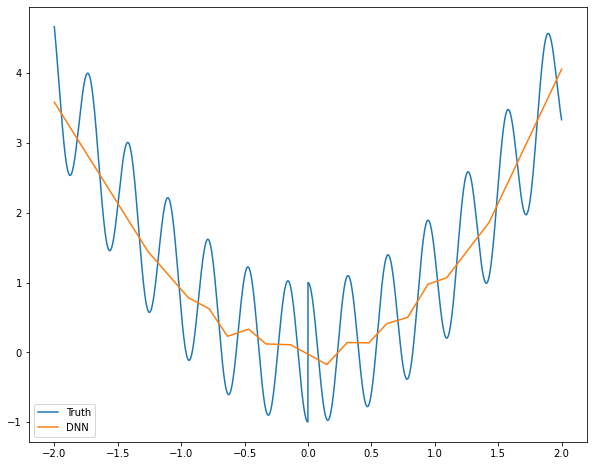

In [8]:
# Compute \hat y from the network and compare this to the true f(x)
z = model.predict(x)
plt.figure(figsize=(10,8))
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

## Problem 2
Try increasing the number of nodes in the network to see if the results can be improved.

In [9]:
# Ceate a model with a single hidden layer. Note that input and output has
# dimension one
M = 512
model1 = keras.Sequential([
    keras.layers.Dense(2*M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(1)
])

model1.summary()
# Train the model
model1.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

# Ceate a model with a single hidden layer. Note that input and output has
# dimension one

model2 = keras.Sequential([
    keras.layers.Dense(4*M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(1)
])

model2.summary()
# Train the model
model2.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

# Ceate a model with a single hidden layer. Note that input and output has
# dimension one

model3 = keras.Sequential([
    keras.layers.Dense(6*M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(1)
])

model3.summary()
# Train the model
model3.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 1024)              2048      
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 1025      
Total params: 3,073
Trainable params: 3,073
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 2048)              4096      
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 2049      
Total params: 6,145
Trainable params: 6,145
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_3"
______

In [10]:
# train the model
history1 = model1.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)
# train the model
history2 = model2.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)
# train the model
history3 = model3.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)

Epoch 1/1000
40/40 [==============================] - 0s 488us/step - loss: 1.7096 - accuracy: 0.0000e+00
Epoch 2/1000
40/40 [==============================] - 0s 488us/step - loss: 0.7764 - accuracy: 0.0000e+00
Epoch 3/1000
40/40 [==============================] - 0s 462us/step - loss: 0.6474 - accuracy: 0.0000e+00
Epoch 4/1000
40/40 [==============================] - 0s 462us/step - loss: 0.5837 - accuracy: 0.0000e+00
Epoch 5/1000
40/40 [==============================] - 0s 488us/step - loss: 0.5471 - accuracy: 0.0000e+00
Epoch 6/1000
40/40 [==============================] - 0s 488us/step - loss: 0.5264 - accuracy: 0.0000e+00
Epoch 7/1000
40/40 [==============================] - 0s 462us/step - loss: 0.5167 - accuracy: 0.0000e+00
Epoch 8/1000
40/40 [==============================] - 0s 488us/step - loss: 0.5121 - accuracy: 0.0000e+00
Epoch 9/1000
40/40 [==============================] - 0s 462us/step - loss: 0.5104 - accuracy: 0.0000e+00
Epoch 10/1000
40/40 [=========================

40/40 [==============================] - 0s 462us/step - loss: 0.4885 - accuracy: 0.0000e+00
Epoch 78/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4889 - accuracy: 0.0000e+00
Epoch 79/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4903 - accuracy: 0.0000e+00
Epoch 80/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4925 - accuracy: 0.0000e+00
Epoch 81/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4988 - accuracy: 0.0000e+00
Epoch 82/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4896 - accuracy: 0.0000e+00
Epoch 83/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4893 - accuracy: 0.0000e+00
Epoch 84/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4888 - accuracy: 0.0000e+00
Epoch 85/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4892 - accuracy: 0.0000e+00
Epoch 86/1000
40/40 [==============================

40/40 [==============================] - 0s 462us/step - loss: 0.4845 - accuracy: 0.0000e+00
Epoch 154/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4845 - accuracy: 0.0000e+00
Epoch 155/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4922 - accuracy: 0.0000e+00
Epoch 156/1000
40/40 [==============================] - 0s 474us/step - loss: 0.4893 - accuracy: 0.0000e+00
Epoch 157/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4874 - accuracy: 0.0000e+00
Epoch 158/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4892 - accuracy: 0.0000e+00
Epoch 159/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4874 - accuracy: 0.0000e+00
Epoch 160/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4858 - accuracy: 0.0000e+00
Epoch 161/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4872 - accuracy: 0.0000e+00
Epoch 162/1000
40/40 [=====================

Epoch 229/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4838 - accuracy: 0.0000e+00
Epoch 230/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4826 - accuracy: 0.0000e+00
Epoch 231/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4846 - accuracy: 0.0000e+00
Epoch 232/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4863 - accuracy: 0.0000e+00
Epoch 233/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 234/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4858 - accuracy: 0.0000e+00
Epoch 235/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4830 - accuracy: 0.0000e+00
Epoch 236/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4834 - accuracy: 0.0000e+00
Epoch 237/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4827 - accuracy: 0.0000e+00
Epoch 238/1000
40/40 [======

40/40 [==============================] - 0s 488us/step - loss: 0.4835 - accuracy: 0.0000e+00
Epoch 305/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4812 - accuracy: 0.0000e+00
Epoch 306/1000
40/40 [==============================] - 0s 496us/step - loss: 0.4816 - accuracy: 0.0000e+00
Epoch 307/1000
40/40 [==============================] - 0s 487us/step - loss: 0.4818 - accuracy: 0.0000e+00
Epoch 308/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4816 - accuracy: 0.0000e+00
Epoch 309/1000
40/40 [==============================] - 0s 499us/step - loss: 0.4827 - accuracy: 0.0000e+00
Epoch 310/1000
40/40 [==============================] - 0s 483us/step - loss: 0.4821 - accuracy: 0.0000e+00
Epoch 311/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4819 - accuracy: 0.0000e+00
Epoch 312/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4812 - accuracy: 0.0000e+00
Epoch 313/1000
40/40 [=====================

Epoch 380/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4804 - accuracy: 0.0000e+00
Epoch 381/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4796 - accuracy: 0.0000e+00
Epoch 382/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4818 - accuracy: 0.0000e+00
Epoch 383/1000
40/40 [==============================] - 0s 552us/step - loss: 0.4785 - accuracy: 0.0000e+00
Epoch 384/1000
40/40 [==============================] - 0s 513us/step - loss: 0.4789 - accuracy: 0.0000e+00
Epoch 385/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4785 - accuracy: 0.0000e+00
Epoch 386/1000
40/40 [==============================] - 0s 475us/step - loss: 0.4797 - accuracy: 0.0000e+00
Epoch 387/1000
40/40 [==============================] - 0s 667us/step - loss: 0.4807 - accuracy: 0.0000e+00
Epoch 388/1000
40/40 [==============================] - 0s 565us/step - loss: 0.4797 - accuracy: 0.0000e+00
Epoch 389/1000
40/40 [======

40/40 [==============================] - 0s 488us/step - loss: 0.4773 - accuracy: 0.0000e+00
Epoch 456/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4773 - accuracy: 0.0000e+00
Epoch 457/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4775 - accuracy: 0.0000e+00
Epoch 458/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4769 - accuracy: 0.0000e+00
Epoch 459/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4755 - accuracy: 0.0000e+00
Epoch 460/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4780 - accuracy: 0.0000e+00
Epoch 461/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4761 - accuracy: 0.0000e+00
Epoch 462/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4756 - accuracy: 0.0000e+00
Epoch 463/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4790 - accuracy: 0.0000e+00
Epoch 464/1000
40/40 [=====================

Epoch 531/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4760 - accuracy: 0.0000e+00
Epoch 532/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4725 - accuracy: 0.0000e+00
Epoch 533/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4744 - accuracy: 0.0000e+00
Epoch 534/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4743 - accuracy: 0.0000e+00
Epoch 535/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4730 - accuracy: 0.0000e+00
Epoch 536/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4724 - accuracy: 0.0000e+00
Epoch 537/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4732 - accuracy: 0.0000e+00
Epoch 538/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4722 - accuracy: 0.0000e+00
Epoch 539/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4744 - accuracy: 0.0000e+00
Epoch 540/1000
40/40 [======

40/40 [==============================] - 0s 462us/step - loss: 0.4720 - accuracy: 0.0000e+00
Epoch 607/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4704 - accuracy: 0.0000e+00
Epoch 608/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4706 - accuracy: 0.0000e+00
Epoch 609/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4739 - accuracy: 0.0000e+00
Epoch 610/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4702 - accuracy: 0.0000e+00
Epoch 611/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4727 - accuracy: 0.0000e+00
Epoch 612/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4714 - accuracy: 0.0000e+00
Epoch 613/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4729 - accuracy: 0.0000e+00
Epoch 614/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4728 - accuracy: 0.0000e+00
Epoch 615/1000
40/40 [=====================

Epoch 682/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4733 - accuracy: 0.0000e+00
Epoch 683/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4672 - accuracy: 0.0000e+00
Epoch 684/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4704 - accuracy: 0.0000e+00
Epoch 685/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4693 - accuracy: 0.0000e+00
Epoch 686/1000
40/40 [==============================] - 0s 464us/step - loss: 0.4686 - accuracy: 0.0000e+00
Epoch 687/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4681 - accuracy: 0.0000e+00
Epoch 688/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4669 - accuracy: 0.0000e+00
Epoch 689/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4684 - accuracy: 0.0000e+00
Epoch 690/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4656 - accuracy: 0.0000e+00
Epoch 691/1000
40/40 [======

40/40 [==============================] - 0s 488us/step - loss: 0.4661 - accuracy: 0.0000e+00
Epoch 758/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4637 - accuracy: 0.0000e+00
Epoch 759/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4655 - accuracy: 0.0000e+00
Epoch 760/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4646 - accuracy: 0.0000e+00
Epoch 761/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4671 - accuracy: 0.0000e+00
Epoch 762/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4629 - accuracy: 0.0000e+00
Epoch 763/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4646 - accuracy: 0.0000e+00
Epoch 764/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4650 - accuracy: 0.0000e+00
Epoch 765/1000
40/40 [==============================] - 0s 450us/step - loss: 0.4672 - accuracy: 0.0000e+00
Epoch 766/1000
40/40 [=====================

Epoch 833/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4599 - accuracy: 0.0000e+00
Epoch 834/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4650 - accuracy: 0.0000e+00
Epoch 835/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4637 - accuracy: 0.0000e+00
Epoch 836/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4593 - accuracy: 0.0000e+00
Epoch 837/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4603 - accuracy: 0.0000e+00
Epoch 838/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4624 - accuracy: 0.0000e+00
Epoch 839/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4612 - accuracy: 0.0000e+00
Epoch 840/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4638 - accuracy: 0.0000e+00
Epoch 841/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4649 - accuracy: 0.0000e+00
Epoch 842/1000
40/40 [======

40/40 [==============================] - 0s 462us/step - loss: 0.4578 - accuracy: 0.0000e+00
Epoch 909/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4578 - accuracy: 0.0000e+00
Epoch 910/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4593 - accuracy: 0.0000e+00
Epoch 911/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4560 - accuracy: 0.0000e+00
Epoch 912/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4608 - accuracy: 0.0000e+00
Epoch 913/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4592 - accuracy: 0.0000e+00
Epoch 914/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4619 - accuracy: 0.0000e+00
Epoch 915/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4566 - accuracy: 0.0000e+00
Epoch 916/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4572 - accuracy: 0.0000e+00
Epoch 917/1000
40/40 [=====================

Epoch 984/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4553 - accuracy: 0.0000e+00
Epoch 985/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4574 - accuracy: 0.0000e+00
Epoch 986/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4538 - accuracy: 0.0000e+00
Epoch 987/1000
40/40 [==============================] - 0s 462us/step - loss: 0.4529 - accuracy: 0.0000e+00
Epoch 988/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4584 - accuracy: 0.0000e+00
Epoch 989/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4551 - accuracy: 0.0000e+00
Epoch 990/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4516 - accuracy: 0.0000e+00
Epoch 991/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4547 - accuracy: 0.0000e+00
Epoch 992/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4532 - accuracy: 0.0000e+00
Epoch 993/1000
40/40 [======

40/40 [==============================] - 0s 950us/step - loss: 0.4920 - accuracy: 0.0000e+00
Epoch 61/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4912 - accuracy: 0.0000e+00
Epoch 62/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4876 - accuracy: 0.0000e+00
Epoch 63/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4894 - accuracy: 0.0000e+00
Epoch 64/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4875 - accuracy: 0.0000e+00
Epoch 65/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4944 - accuracy: 0.0000e+00
Epoch 66/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4918 - accuracy: 0.0000e+00
Epoch 67/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4928 - accuracy: 0.0000e+00
Epoch 68/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4909 - accuracy: 0.0000e+00
Epoch 69/1000
40/40 [==============================] - 

40/40 [==============================] - 0s 950us/step - loss: 0.4867 - accuracy: 0.0000e+00
Epoch 137/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4952 - accuracy: 0.0000e+00
Epoch 138/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4868 - accuracy: 0.0000e+00
Epoch 139/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.0000e+00
Epoch 140/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4861 - accuracy: 0.0000e+00
Epoch 141/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4854 - accuracy: 0.0000e+00
Epoch 142/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4882 - accuracy: 0.0000e+00
Epoch 143/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4859 - accuracy: 0.0000e+00
Epoch 144/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4897 - accuracy: 0.0000e+00
Epoch 145/1000
40/40 [=========================

40/40 [==============================] - 0s 1ms/step - loss: 0.4852 - accuracy: 0.0000e+00
Epoch 213/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4905 - accuracy: 0.0000e+00
Epoch 214/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4841 - accuracy: 0.0000e+00
Epoch 215/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4875 - accuracy: 0.0000e+00
Epoch 216/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4852 - accuracy: 0.0000e+00
Epoch 217/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4839 - accuracy: 0.0000e+00
Epoch 218/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4834 - accuracy: 0.0000e+00
Epoch 219/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4893 - accuracy: 0.0000e+00
Epoch 220/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4834 - accuracy: 0.0000e+00
Epoch 221/1000
40/40 [=========================

40/40 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 289/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4837 - accuracy: 0.0000e+00
Epoch 290/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4827 - accuracy: 0.0000e+00
Epoch 291/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4830 - accuracy: 0.0000e+00
Epoch 292/1000
40/40 [==============================] - 0s 993us/step - loss: 0.4827 - accuracy: 0.0000e+00
Epoch 293/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4858 - accuracy: 0.0000e+00
Epoch 294/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4828 - accuracy: 0.0000e+00
Epoch 295/1000
40/40 [==============================] - 0s 966us/step - loss: 0.4839 - accuracy: 0.0000e+00
Epoch 296/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4888 - accuracy: 0.0000e+00
Epoch 297/1000
40/40 [===========================

40/40 [==============================] - 0s 975us/step - loss: 0.4845 - accuracy: 0.0000e+00
Epoch 365/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 366/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4812 - accuracy: 0.0000e+00
Epoch 367/1000
40/40 [==============================] - 0s 898us/step - loss: 0.4825 - accuracy: 0.0000e+00
Epoch 368/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4826 - accuracy: 0.0000e+00
Epoch 369/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4821 - accuracy: 0.0000e+00
Epoch 370/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4802 - accuracy: 0.0000e+00
Epoch 371/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4806 - accuracy: 0.0000e+00
Epoch 372/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4804 - accuracy: 0.0000e+00
Epoch 373/1000
40/40 [=====================

40/40 [==============================] - 0s 1ms/step - loss: 0.4810 - accuracy: 0.0000e+00
Epoch 441/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4790 - accuracy: 0.0000e+00
Epoch 442/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4835 - accuracy: 0.0000e+00
Epoch 443/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4799 - accuracy: 0.0000e+00
Epoch 444/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4784 - accuracy: 0.0000e+00
Epoch 445/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4819 - accuracy: 0.0000e+00
Epoch 446/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4804 - accuracy: 0.0000e+00
Epoch 447/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4826 - accuracy: 0.0000e+00
Epoch 448/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4826 - accuracy: 0.0000e+00
Epoch 449/1000
40/40 [=========================

40/40 [==============================] - 0s 975us/step - loss: 0.4807 - accuracy: 0.0000e+00
Epoch 517/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4769 - accuracy: 0.0000e+00
Epoch 518/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4816 - accuracy: 0.0000e+00
Epoch 519/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4776 - accuracy: 0.0000e+00
Epoch 520/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4805 - accuracy: 0.0000e+00
Epoch 521/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4805 - accuracy: 0.0000e+00
Epoch 522/1000
40/40 [==============================] - 0s 939us/step - loss: 0.4781 - accuracy: 0.0000e+00
Epoch 523/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4814 - accuracy: 0.0000e+00
Epoch 524/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4803 - accuracy: 0.0000e+00
Epoch 525/1000
40/40 [=======================

40/40 [==============================] - 0s 975us/step - loss: 0.4773 - accuracy: 0.0000e+00
Epoch 593/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.0000e+00
Epoch 594/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4767 - accuracy: 0.0000e+00
Epoch 595/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4779 - accuracy: 0.0000e+00
Epoch 596/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4765 - accuracy: 0.0000e+00
Epoch 597/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4760 - accuracy: 0.0000e+00
Epoch 598/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4783 - accuracy: 0.0000e+00
Epoch 599/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4809 - accuracy: 0.0000e+00
Epoch 600/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4751 - accuracy: 0.0000e+00
Epoch 601/1000
40/40 [===========================

40/40 [==============================] - 0s 924us/step - loss: 0.4736 - accuracy: 0.0000e+00
Epoch 669/1000
40/40 [==============================] - 0s 916us/step - loss: 0.4735 - accuracy: 0.0000e+00
Epoch 670/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4761 - accuracy: 0.0000e+00
Epoch 671/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4737 - accuracy: 0.0000e+00
Epoch 672/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4746 - accuracy: 0.0000e+00
Epoch 673/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4752 - accuracy: 0.0000e+00
Epoch 674/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4738 - accuracy: 0.0000e+00
Epoch 675/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4742 - accuracy: 0.0000e+00
Epoch 676/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4759 - accuracy: 0.0000e+00
Epoch 677/1000
40/40 [=====================

40/40 [==============================] - 0s 975us/step - loss: 0.4743 - accuracy: 0.0000e+00
Epoch 745/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4735 - accuracy: 0.0000e+00
Epoch 746/1000
40/40 [==============================] - 0s 964us/step - loss: 0.4710 - accuracy: 0.0000e+00
Epoch 747/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4730 - accuracy: 0.0000e+00
Epoch 748/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4708 - accuracy: 0.0000e+00
Epoch 749/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4714 - accuracy: 0.0000e+00
Epoch 750/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4715 - accuracy: 0.0000e+00
Epoch 751/1000
40/40 [==============================] - 0s 994us/step - loss: 0.4729 - accuracy: 0.0000e+00
Epoch 752/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4742 - accuracy: 0.0000e+00
Epoch 753/1000
40/40 [=======================

40/40 [==============================] - 0s 963us/step - loss: 0.4684 - accuracy: 0.0000e+00
Epoch 821/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4724 - accuracy: 0.0000e+00
Epoch 822/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4687 - accuracy: 0.0000e+00
Epoch 823/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4679 - accuracy: 0.0000e+00
Epoch 824/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4684 - accuracy: 0.0000e+00
Epoch 825/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4678 - accuracy: 0.0000e+00
Epoch 826/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4690 - accuracy: 0.0000e+00
Epoch 827/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4676 - accuracy: 0.0000e+00
Epoch 828/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4687 - accuracy: 0.0000e+00
Epoch 829/1000
40/40 [=========================

40/40 [==============================] - 0s 924us/step - loss: 0.4696 - accuracy: 0.0000e+00
Epoch 897/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4672 - accuracy: 0.0000e+00
Epoch 898/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4669 - accuracy: 0.0000e+00
Epoch 899/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4651 - accuracy: 0.0000e+00
Epoch 900/1000
40/40 [==============================] - 0s 943us/step - loss: 0.4689 - accuracy: 0.0000e+00
Epoch 901/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4675 - accuracy: 0.0000e+00
Epoch 902/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4671 - accuracy: 0.0000e+00
Epoch 903/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4653 - accuracy: 0.0000e+00
Epoch 904/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4658 - accuracy: 0.0000e+00
Epoch 905/1000
40/40 [=======================

40/40 [==============================] - 0s 950us/step - loss: 0.4649 - accuracy: 0.0000e+00
Epoch 973/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4622 - accuracy: 0.0000e+00
Epoch 974/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4616 - accuracy: 0.0000e+00
Epoch 975/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4640 - accuracy: 0.0000e+00
Epoch 976/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4608 - accuracy: 0.0000e+00
Epoch 977/1000
40/40 [==============================] - 0s 950us/step - loss: 0.4653 - accuracy: 0.0000e+00
Epoch 978/1000
40/40 [==============================] - 0s 924us/step - loss: 0.4641 - accuracy: 0.0000e+00
Epoch 979/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4613 - accuracy: 0.0000e+00
Epoch 980/1000
40/40 [==============================] - 0s 975us/step - loss: 0.4633 - accuracy: 0.0000e+00
Epoch 981/1000
40/40 [=======================

40/40 [==============================] - 0s 1ms/step - loss: 0.4887 - accuracy: 0.0000e+00
Epoch 50/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4860 - accuracy: 0.0000e+00
Epoch 51/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4942 - accuracy: 0.0000e+00
Epoch 52/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4885 - accuracy: 0.0000e+00
Epoch 53/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4940 - accuracy: 0.0000e+00
Epoch 54/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4945 - accuracy: 0.0000e+00
Epoch 55/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4918 - accuracy: 0.0000e+00
Epoch 56/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4864 - accuracy: 0.0000e+00
Epoch 57/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4884 - accuracy: 0.0000e+00
Epoch 58/1000
40/40 [==============================] - 0s 1ms/step - 

40/40 [==============================] - 0s 1ms/step - loss: 0.4889 - accuracy: 0.0000e+00
Epoch 127/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4897 - accuracy: 0.0000e+00
Epoch 128/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4867 - accuracy: 0.0000e+00
Epoch 129/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4859 - accuracy: 0.0000e+00
Epoch 130/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4890 - accuracy: 0.0000e+00
Epoch 131/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4912 - accuracy: 0.0000e+00
Epoch 132/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4861 - accuracy: 0.0000e+00
Epoch 133/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4880 - accuracy: 0.0000e+00
Epoch 134/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4895 - accuracy: 0.0000e+00
Epoch 135/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4936 - accuracy: 0.0000e+00
Epoch 204/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4895 - accuracy: 0.0000e+00
Epoch 205/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4877 - accuracy: 0.0000e+00
Epoch 206/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 207/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4850 - accuracy: 0.0000e+00
Epoch 208/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4905 - accuracy: 0.0000e+00
Epoch 209/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 210/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.0000e+00
Epoch 211/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4921 - accuracy: 0.0000e+00
Epoch 212/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4857 - accuracy: 0.0000e+00
Epoch 281/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4842 - accuracy: 0.0000e+00
Epoch 282/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4876 - accuracy: 0.0000e+00
Epoch 283/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4839 - accuracy: 0.0000e+00
Epoch 284/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4850 - accuracy: 0.0000e+00
Epoch 285/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4918 - accuracy: 0.0000e+00
Epoch 286/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4890 - accuracy: 0.0000e+00
Epoch 287/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4876 - accuracy: 0.0000e+00
Epoch 288/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4850 - accuracy: 0.0000e+00
Epoch 289/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4877 - accuracy: 0.0000e+00
Epoch 358/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4861 - accuracy: 0.0000e+00
Epoch 359/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4865 - accuracy: 0.0000e+00
Epoch 360/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4902 - accuracy: 0.0000e+00
Epoch 361/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4886 - accuracy: 0.0000e+00
Epoch 362/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4866 - accuracy: 0.0000e+00
Epoch 363/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4877 - accuracy: 0.0000e+00
Epoch 364/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4853 - accuracy: 0.0000e+00
Epoch 365/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4857 - accuracy: 0.0000e+00
Epoch 366/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 2ms/step - loss: 0.4859 - accuracy: 0.0000e+00
Epoch 435/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4876 - accuracy: 0.0000e+00
Epoch 436/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4849 - accuracy: 0.0000e+00
Epoch 437/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4848 - accuracy: 0.0000e+00
Epoch 438/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.0000e+00
Epoch 439/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4834 - accuracy: 0.0000e+00
Epoch 440/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.0000e+00
Epoch 441/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4853 - accuracy: 0.0000e+00
Epoch 442/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4879 - accuracy: 0.0000e+00
Epoch 443/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4848 - accuracy: 0.0000e+00
Epoch 512/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4862 - accuracy: 0.0000e+00
Epoch 513/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4880 - accuracy: 0.0000e+00
Epoch 514/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4867 - accuracy: 0.0000e+00
Epoch 515/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4928 - accuracy: 0.0000e+00
Epoch 516/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4858 - accuracy: 0.0000e+00
Epoch 517/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4875 - accuracy: 0.0000e+00
Epoch 518/1000
40/40 [==============================] - 0s 2ms/step - loss: 0.4881 - accuracy: 0.0000e+00
Epoch 519/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4865 - accuracy: 0.0000e+00
Epoch 520/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4854 - accuracy: 0.0000e+00
Epoch 589/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 590/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4840 - accuracy: 0.0000e+00
Epoch 591/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4837 - accuracy: 0.0000e+00
Epoch 592/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4878 - accuracy: 0.0000e+00
Epoch 593/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4850 - accuracy: 0.0000e+00
Epoch 594/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4850 - accuracy: 0.0000e+00
Epoch 595/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4843 - accuracy: 0.0000e+00
Epoch 596/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.0000e+00
Epoch 597/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4845 - accuracy: 0.0000e+00
Epoch 666/1000
40/40 [==============================] - 0s 2ms/step - loss: 0.4843 - accuracy: 0.0000e+00
Epoch 667/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 668/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4832 - accuracy: 0.0000e+00
Epoch 669/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4831 - accuracy: 0.0000e+00
Epoch 670/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4847 - accuracy: 0.0000e+00
Epoch 671/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4856 - accuracy: 0.0000e+00
Epoch 672/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.0000e+00
Epoch 673/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4868 - accuracy: 0.0000e+00
Epoch 674/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4818 - accuracy: 0.0000e+00
Epoch 743/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4825 - accuracy: 0.0000e+00
Epoch 744/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4837 - accuracy: 0.0000e+00
Epoch 745/1000
40/40 [==============================] - 0s 2ms/step - loss: 0.4832 - accuracy: 0.0000e+00
Epoch 746/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4840 - accuracy: 0.0000e+00
Epoch 747/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4816 - accuracy: 0.0000e+00
Epoch 748/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4826 - accuracy: 0.0000e+00
Epoch 749/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4820 - accuracy: 0.0000e+00
Epoch 750/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4915 - accuracy: 0.0000e+00
Epoch 751/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4798 - accuracy: 0.0000e+00
Epoch 820/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4824 - accuracy: 0.0000e+00
Epoch 821/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.0000e+00
Epoch 822/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4838 - accuracy: 0.0000e+00
Epoch 823/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.0000e+00
Epoch 824/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4815 - accuracy: 0.0000e+00
Epoch 825/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4810 - accuracy: 0.0000e+00
Epoch 826/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4841 - accuracy: 0.0000e+00
Epoch 827/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4819 - accuracy: 0.0000e+00
Epoch 828/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4803 - accuracy: 0.0000e+00
Epoch 897/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4782 - accuracy: 0.0000e+00
Epoch 898/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4790 - accuracy: 0.0000e+00
Epoch 899/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4798 - accuracy: 0.0000e+00
Epoch 900/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4791 - accuracy: 0.0000e+00
Epoch 901/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4799 - accuracy: 0.0000e+00
Epoch 902/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4809 - accuracy: 0.0000e+00
Epoch 903/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4777 - accuracy: 0.0000e+00
Epoch 904/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4778 - accuracy: 0.0000e+00
Epoch 905/1000
40/40 [==============================] - 0s 1m

40/40 [==============================] - 0s 1ms/step - loss: 0.4758 - accuracy: 0.0000e+00
Epoch 974/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4797 - accuracy: 0.0000e+00
Epoch 975/1000
40/40 [==============================] - 0s 2ms/step - loss: 0.4776 - accuracy: 0.0000e+00
Epoch 976/1000
40/40 [==============================] - 0s 2ms/step - loss: 0.4788 - accuracy: 0.0000e+00
Epoch 977/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4788 - accuracy: 0.0000e+00
Epoch 978/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4764 - accuracy: 0.0000e+00
Epoch 979/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4758 - accuracy: 0.0000e+00
Epoch 980/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4787 - accuracy: 0.0000e+00
Epoch 981/1000
40/40 [==============================] - 0s 1ms/step - loss: 0.4752 - accuracy: 0.0000e+00
Epoch 982/1000
40/40 [==============================] - 0s 1m

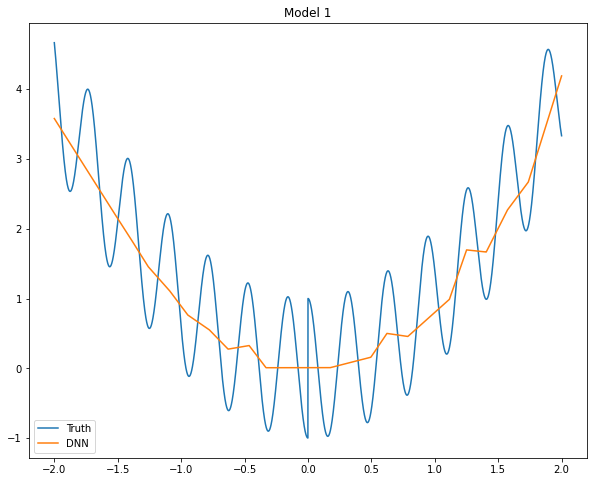

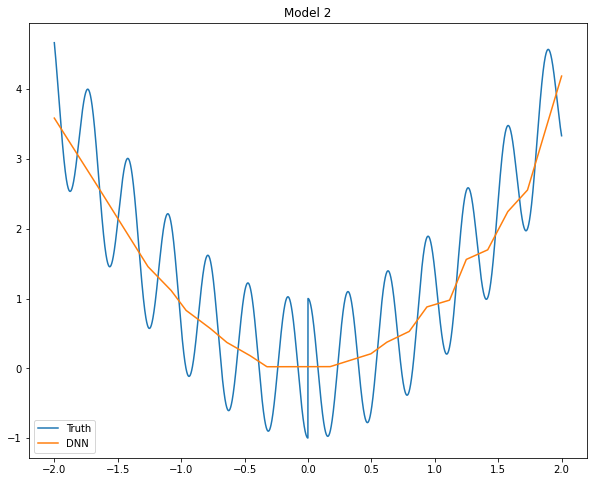

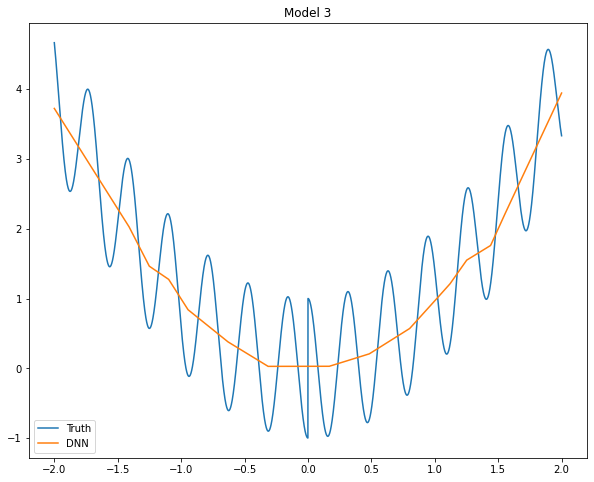

In [11]:
# Compute \hat y from the network and compare this to the true f(x)
z = model1.predict(x)
plt.figure(figsize=(10,8))
plt.title('Model 1')
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

# Compute \hat y from the network and compare this to the true f(x)
z = model2.predict(x)
plt.figure(figsize=(10,8))
plt.title('Model 2')
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

# Compute \hat y from the network and compare this to the true f(x)
z = model3.predict(x)
plt.figure(figsize=(10,8))
plt.title('Model 3')
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

Next we will use a deep network with more than one hidden layer.

In [12]:
# Create a model with multiple hidden layers. Note that input and output has
# dimension one
M = 16
model = keras.Sequential([
    keras.layers.Dense(M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(M, activation=tf.nn.relu),
    keras.layers.Dense(M, activation=tf.nn.relu),
    keras.layers.Dense(M, activation=tf.nn.relu),
    keras.layers.Dense(1)
])
model.summary()

# Train the model
model.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

history = model.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 16)                32        
_________________________________________________________________
dense_9 (Dense)              (None, 16)                272       
_________________________________________________________________
dense_10 (Dense)             (None, 16)                272       
_________________________________________________________________
dense_11 (Dense)             (None, 16)                272       
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 17        
Total params: 865
Trainable params: 865
Non-trainable params: 0
_________________________________________________________________
Epoch 1/1000
40/40 [==============================] - 0s 385us/step - loss: 3.2175 - accuracy: 0.0000e+00
Epoch 2/1000
40/

40/40 [==============================] - 0s 359us/step - loss: 0.4891 - accuracy: 0.0000e+00
Epoch 69/1000
40/40 [==============================] - 0s 488us/step - loss: 0.4845 - accuracy: 0.0000e+00
Epoch 70/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4939 - accuracy: 0.0000e+00
Epoch 71/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4839 - accuracy: 0.0000e+00
Epoch 72/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4844 - accuracy: 0.0000e+00
Epoch 73/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4846 - accuracy: 0.0000e+00
Epoch 74/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4868 - accuracy: 0.0000e+00
Epoch 75/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4881 - accuracy: 0.0000e+00
Epoch 76/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4844 - accuracy: 0.0000e+00
Epoch 77/1000
40/40 [==============================

40/40 [==============================] - 0s 385us/step - loss: 0.4792 - accuracy: 0.0000e+00
Epoch 145/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4797 - accuracy: 0.0000e+00
Epoch 146/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4775 - accuracy: 0.0000e+00
Epoch 147/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4768 - accuracy: 0.0000e+00
Epoch 148/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4781 - accuracy: 0.0000e+00
Epoch 149/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4761 - accuracy: 0.0000e+00
Epoch 150/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4790 - accuracy: 0.0000e+00
Epoch 151/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4776 - accuracy: 0.0000e+00
Epoch 152/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4789 - accuracy: 0.0000e+00
Epoch 153/1000
40/40 [=====================

Epoch 220/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4638 - accuracy: 0.0000e+00
Epoch 221/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4662 - accuracy: 0.0000e+00
Epoch 222/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4673 - accuracy: 0.0000e+00
Epoch 223/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4647 - accuracy: 0.0000e+00
Epoch 224/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4660 - accuracy: 0.0000e+00
Epoch 225/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4602 - accuracy: 0.0000e+00
Epoch 226/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4610 - accuracy: 0.0000e+00
Epoch 227/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4616 - accuracy: 0.0000e+00
Epoch 228/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4607 - accuracy: 0.0000e+00
Epoch 229/1000
40/40 [======

40/40 [==============================] - 0s 359us/step - loss: 0.4136 - accuracy: 0.0000e+00
Epoch 296/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4075 - accuracy: 0.0000e+00
Epoch 297/1000
40/40 [==============================] - 0s 334us/step - loss: 0.4193 - accuracy: 0.0000e+00
Epoch 298/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4166 - accuracy: 0.0000e+00
Epoch 299/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4004 - accuracy: 0.0000e+00
Epoch 300/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4054 - accuracy: 0.0000e+00
Epoch 301/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4094 - accuracy: 0.0000e+00
Epoch 302/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3991 - accuracy: 0.0000e+00
Epoch 303/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4332 - accuracy: 0.0000e+00
Epoch 304/1000
40/40 [=====================

Epoch 371/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3169 - accuracy: 0.0000e+00
Epoch 372/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3146 - accuracy: 0.0000e+00
Epoch 373/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3198 - accuracy: 0.0000e+00
Epoch 374/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3178 - accuracy: 0.0000e+00
Epoch 375/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3188 - accuracy: 0.0000e+00
Epoch 376/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3095 - accuracy: 0.0000e+00
Epoch 377/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3127 - accuracy: 0.0000e+00
Epoch 378/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3122 - accuracy: 0.0000e+00
Epoch 379/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3191 - accuracy: 0.0000e+00
Epoch 380/1000
40/40 [======

40/40 [==============================] - 0s 385us/step - loss: 0.2780 - accuracy: 0.0000e+00
Epoch 447/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2751 - accuracy: 0.0000e+00
Epoch 448/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2719 - accuracy: 0.0000e+00
Epoch 449/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2695 - accuracy: 0.0000e+00
Epoch 450/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2749 - accuracy: 0.0000e+00
Epoch 451/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2721 - accuracy: 0.0000e+00
Epoch 452/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2738 - accuracy: 0.0000e+00
Epoch 453/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2784 - accuracy: 0.0000e+00
Epoch 454/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2736 - accuracy: 0.0000e+00
Epoch 455/1000
40/40 [=====================

Epoch 522/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2770 - accuracy: 0.0000e+00
Epoch 523/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2616 - accuracy: 0.0000e+00
Epoch 524/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2569 - accuracy: 0.0000e+00
Epoch 525/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2617 - accuracy: 0.0000e+00
Epoch 526/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2700 - accuracy: 0.0000e+00
Epoch 527/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2605 - accuracy: 0.0000e+00
Epoch 528/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2536 - accuracy: 0.0000e+00
Epoch 529/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2633 - accuracy: 0.0000e+00
Epoch 530/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2609 - accuracy: 0.0000e+00
Epoch 531/1000
40/40 [======

40/40 [==============================] - 0s 359us/step - loss: 0.2463 - accuracy: 0.0000e+00
Epoch 598/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2484 - accuracy: 0.0000e+00
Epoch 599/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2554 - accuracy: 0.0000e+00
Epoch 600/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2535 - accuracy: 0.0000e+00
Epoch 601/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2533 - accuracy: 0.0000e+00
Epoch 602/1000
40/40 [==============================] - 0s 361us/step - loss: 0.2569 - accuracy: 0.0000e+00
Epoch 603/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2486 - accuracy: 0.0000e+00
Epoch 604/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2499 - accuracy: 0.0000e+00
Epoch 605/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2659 - accuracy: 0.0000e+00
Epoch 606/1000
40/40 [=====================

Epoch 673/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2394 - accuracy: 0.0000e+00
Epoch 674/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2385 - accuracy: 0.0000e+00
Epoch 675/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2573 - accuracy: 0.0000e+00
Epoch 676/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2458 - accuracy: 0.0000e+00
Epoch 677/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2462 - accuracy: 0.0000e+00
Epoch 678/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2467 - accuracy: 0.0000e+00
Epoch 679/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2431 - accuracy: 0.0000e+00
Epoch 680/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2360 - accuracy: 0.0000e+00
Epoch 681/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2390 - accuracy: 0.0000e+00
Epoch 682/1000
40/40 [======

40/40 [==============================] - 0s 359us/step - loss: 0.2411 - accuracy: 0.0000e+00
Epoch 749/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2343 - accuracy: 0.0000e+00
Epoch 750/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2352 - accuracy: 0.0000e+00
Epoch 751/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2352 - accuracy: 0.0000e+00
Epoch 752/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2332 - accuracy: 0.0000e+00
Epoch 753/1000
40/40 [==============================] - 0s 334us/step - loss: 0.2359 - accuracy: 0.0000e+00
Epoch 754/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2385 - accuracy: 0.0000e+00
Epoch 755/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2345 - accuracy: 0.0000e+00
Epoch 756/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2345 - accuracy: 0.0000e+00
Epoch 757/1000
40/40 [=====================

Epoch 824/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2389 - accuracy: 0.0000e+00
Epoch 825/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2375 - accuracy: 0.0000e+00
Epoch 826/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2343 - accuracy: 0.0000e+00
Epoch 827/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2344 - accuracy: 0.0000e+00
Epoch 828/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2501 - accuracy: 0.0000e+00
Epoch 829/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2464 - accuracy: 0.0000e+00
Epoch 830/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2382 - accuracy: 0.0000e+00
Epoch 831/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2300 - accuracy: 0.0000e+00
Epoch 832/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2330 - accuracy: 0.0000e+00
Epoch 833/1000
40/40 [======

40/40 [==============================] - 0s 385us/step - loss: 0.2382 - accuracy: 0.0000e+00
Epoch 900/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2440 - accuracy: 0.0000e+00
Epoch 901/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2344 - accuracy: 0.0000e+00
Epoch 902/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2339 - accuracy: 0.0000e+00
Epoch 903/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2328 - accuracy: 0.0000e+00
Epoch 904/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2430 - accuracy: 0.0000e+00
Epoch 905/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2333 - accuracy: 0.0000e+00
Epoch 906/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2313 - accuracy: 0.0000e+00
Epoch 907/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2338 - accuracy: 0.0000e+00
Epoch 908/1000
40/40 [=====================

Epoch 975/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2291 - accuracy: 0.0000e+00
Epoch 976/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2337 - accuracy: 0.0000e+00
Epoch 977/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2322 - accuracy: 0.0000e+00
Epoch 978/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2381 - accuracy: 0.0000e+00
Epoch 979/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2247 - accuracy: 0.0000e+00
Epoch 980/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2239 - accuracy: 0.0000e+00
Epoch 981/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2245 - accuracy: 0.0000e+00
Epoch 982/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2269 - accuracy: 0.0000e+00
Epoch 983/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2250 - accuracy: 0.0000e+00
Epoch 984/1000
40/40 [======

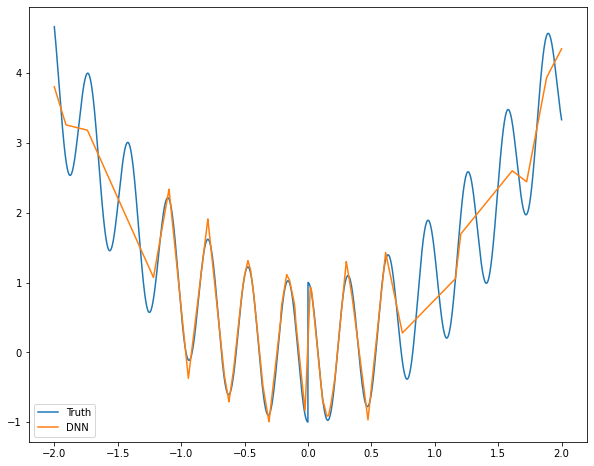

In [13]:
z = model.predict(x)
plt.figure(figsize=(10,8))
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

## Problem 3
Try increasing the number of hidden nodes per layer until performance is satisfactory. Can the same effect be achieved by just adding more layers?

In [14]:
# Create a model with multiple hidden layers. Note that input and output has
# dimension one
M = 16
model1 = keras.Sequential([
    keras.layers.Dense(M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(M, activation=tf.nn.relu),
    keras.layers.Dense(M, activation=tf.nn.relu),
    keras.layers.Dense(M, activation=tf.nn.relu),
    keras.layers.Dense(1)
])
model1.summary()

# Train the model
model1.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

history1 = model1.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)


# Create a model with multiple hidden layers. Note that input and output has
# dimension one

model2 = keras.Sequential([
    keras.layers.Dense(2*M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(4*M, activation=tf.nn.relu),
    keras.layers.Dense(4*M, activation=tf.nn.relu),
    keras.layers.Dense(4*M, activation=tf.nn.relu),
    keras.layers.Dense(1)
])
model2.summary()

# Train the model
model2.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

history2 = model2.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)

# Create a model with multiple hidden layers. Note that input and output has
# dimension one

model3 = keras.Sequential([
    keras.layers.Dense(10*M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(10*M, activation=tf.nn.relu),
    keras.layers.Dense(4*M, activation=tf.nn.relu),
    keras.layers.Dense(6*M, activation=tf.nn.relu),
    keras.layers.Dense(1)
])
model3.summary()

# Train the model
model3.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

history3 = model3.fit(x, f(x), epochs=1000, batch_size=128, verbose=True)

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 16)                32        
_________________________________________________________________
dense_14 (Dense)             (None, 16)                272       
_________________________________________________________________
dense_15 (Dense)             (None, 16)                272       
_________________________________________________________________
dense_16 (Dense)             (None, 16)                272       
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 17        
Total params: 865
Trainable params: 865
Non-trainable params: 0
_________________________________________________________________
Epoch 1/1000
40/40 [==============================] - 0s 385us/step - loss: 2.8169 - accuracy: 0.0000e+00
Epoch 2/1000
40/

40/40 [==============================] - 0s 359us/step - loss: 0.4249 - accuracy: 0.0000e+00
Epoch 69/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4246 - accuracy: 0.0000e+00
Epoch 70/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4217 - accuracy: 0.0000e+00
Epoch 71/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4244 - accuracy: 0.0000e+00
Epoch 72/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4234 - accuracy: 0.0000e+00
Epoch 73/1000
40/40 [==============================] - 0s 385us/step - loss: 0.4233 - accuracy: 0.0000e+00
Epoch 74/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4215 - accuracy: 0.0000e+00
Epoch 75/1000
40/40 [==============================] - 0s 352us/step - loss: 0.4217 - accuracy: 0.0000e+00
Epoch 76/1000
40/40 [==============================] - 0s 359us/step - loss: 0.4268 - accuracy: 0.0000e+00
Epoch 77/1000
40/40 [==============================

40/40 [==============================] - 0s 359us/step - loss: 0.3765 - accuracy: 0.0000e+00
Epoch 145/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3754 - accuracy: 0.0000e+00
Epoch 146/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3751 - accuracy: 0.0000e+00
Epoch 147/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3750 - accuracy: 0.0000e+00
Epoch 148/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3741 - accuracy: 0.0000e+00
Epoch 149/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3732 - accuracy: 0.0000e+00
Epoch 150/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3710 - accuracy: 0.0000e+00
Epoch 151/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3749 - accuracy: 0.0000e+00
Epoch 152/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3726 - accuracy: 0.0000e+00
Epoch 153/1000
40/40 [=====================

Epoch 220/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3324 - accuracy: 0.0000e+00
Epoch 221/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3339 - accuracy: 0.0000e+00
Epoch 222/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3330 - accuracy: 0.0000e+00
Epoch 223/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3336 - accuracy: 0.0000e+00
Epoch 224/1000
40/40 [==============================] - 0s 334us/step - loss: 0.3349 - accuracy: 0.0000e+00
Epoch 225/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3407 - accuracy: 0.0000e+00
Epoch 226/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3347 - accuracy: 0.0000e+00
Epoch 227/1000
40/40 [==============================] - 0s 385us/step - loss: 0.3311 - accuracy: 0.0000e+00
Epoch 228/1000
40/40 [==============================] - 0s 359us/step - loss: 0.3380 - accuracy: 0.0000e+00
Epoch 229/1000
40/40 [======

40/40 [==============================] - 0s 359us/step - loss: 0.2884 - accuracy: 0.0000e+00
Epoch 296/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2899 - accuracy: 0.0000e+00
Epoch 297/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2975 - accuracy: 0.0000e+00
Epoch 298/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2940 - accuracy: 0.0000e+00
Epoch 299/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2867 - accuracy: 0.0000e+00
Epoch 300/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2839 - accuracy: 0.0000e+00
Epoch 301/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2842 - accuracy: 0.0000e+00
Epoch 302/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2837 - accuracy: 0.0000e+00
Epoch 303/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2820 - accuracy: 0.0000e+00
Epoch 304/1000
40/40 [=====================

Epoch 371/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2686 - accuracy: 0.0000e+00
Epoch 372/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2740 - accuracy: 0.0000e+00
Epoch 373/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2735 - accuracy: 0.0000e+00
Epoch 374/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2669 - accuracy: 0.0000e+00
Epoch 375/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2670 - accuracy: 0.0000e+00
Epoch 376/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2716 - accuracy: 0.0000e+00
Epoch 377/1000
40/40 [==============================] - 0s 356us/step - loss: 0.2730 - accuracy: 0.0000e+00
Epoch 378/1000
40/40 [==============================] - 0s 334us/step - loss: 0.2701 - accuracy: 0.0000e+00
Epoch 379/1000
40/40 [==============================] - 0s 334us/step - loss: 0.2681 - accuracy: 0.0000e+00
Epoch 380/1000
40/40 [======

40/40 [==============================] - 0s 359us/step - loss: 0.2628 - accuracy: 0.0000e+00
Epoch 447/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2692 - accuracy: 0.0000e+00
Epoch 448/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2686 - accuracy: 0.0000e+00
Epoch 449/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2649 - accuracy: 0.0000e+00
Epoch 450/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2643 - accuracy: 0.0000e+00
Epoch 451/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2614 - accuracy: 0.0000e+00
Epoch 452/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2657 - accuracy: 0.0000e+00
Epoch 453/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2663 - accuracy: 0.0000e+00
Epoch 454/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2698 - accuracy: 0.0000e+00
Epoch 455/1000
40/40 [=====================

Epoch 522/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2696 - accuracy: 0.0000e+00
Epoch 523/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2590 - accuracy: 0.0000e+00
Epoch 524/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2603 - accuracy: 0.0000e+00
Epoch 525/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2609 - accuracy: 0.0000e+00
Epoch 526/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2647 - accuracy: 0.0000e+00
Epoch 527/1000
40/40 [==============================] - 0s 334us/step - loss: 0.2607 - accuracy: 0.0000e+00
Epoch 528/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2605 - accuracy: 0.0000e+00
Epoch 529/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2634 - accuracy: 0.0000e+00
Epoch 530/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2587 - accuracy: 0.0000e+00
Epoch 531/1000
40/40 [======

40/40 [==============================] - 0s 359us/step - loss: 0.2585 - accuracy: 0.0000e+00
Epoch 598/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2610 - accuracy: 0.0000e+00
Epoch 599/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2611 - accuracy: 0.0000e+00
Epoch 600/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2617 - accuracy: 0.0000e+00
Epoch 601/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2687 - accuracy: 0.0000e+00
Epoch 602/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2611 - accuracy: 0.0000e+00
Epoch 603/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2636 - accuracy: 0.0000e+00
Epoch 604/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2581 - accuracy: 0.0000e+00
Epoch 605/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2652 - accuracy: 0.0000e+00
Epoch 606/1000
40/40 [=====================

Epoch 673/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2571 - accuracy: 0.0000e+00
Epoch 674/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2548 - accuracy: 0.0000e+00
Epoch 675/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2604 - accuracy: 0.0000e+00
Epoch 676/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2568 - accuracy: 0.0000e+00
Epoch 677/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2651 - accuracy: 0.0000e+00
Epoch 678/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2584 - accuracy: 0.0000e+00
Epoch 679/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2601 - accuracy: 0.0000e+00
Epoch 680/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2577 - accuracy: 0.0000e+00
Epoch 681/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2561 - accuracy: 0.0000e+00
Epoch 682/1000
40/40 [======

40/40 [==============================] - 0s 385us/step - loss: 0.2583 - accuracy: 0.0000e+00
Epoch 749/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2589 - accuracy: 0.0000e+00
Epoch 750/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2599 - accuracy: 0.0000e+00
Epoch 751/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2565 - accuracy: 0.0000e+00
Epoch 752/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2571 - accuracy: 0.0000e+00
Epoch 753/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2618 - accuracy: 0.0000e+00
Epoch 754/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2584 - accuracy: 0.0000e+00
Epoch 755/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2615 - accuracy: 0.0000e+00
Epoch 756/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2593 - accuracy: 0.0000e+00
Epoch 757/1000
40/40 [=====================

Epoch 824/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2554 - accuracy: 0.0000e+00
Epoch 825/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2553 - accuracy: 0.0000e+00
Epoch 826/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2617 - accuracy: 0.0000e+00
Epoch 827/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2574 - accuracy: 0.0000e+00
Epoch 828/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2552 - accuracy: 0.0000e+00
Epoch 829/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2558 - accuracy: 0.0000e+00
Epoch 830/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2614 - accuracy: 0.0000e+00
Epoch 831/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2547 - accuracy: 0.0000e+00
Epoch 832/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2580 - accuracy: 0.0000e+00
Epoch 833/1000
40/40 [======

40/40 [==============================] - 0s 359us/step - loss: 0.2561 - accuracy: 0.0000e+00
Epoch 900/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2557 - accuracy: 0.0000e+00
Epoch 901/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2552 - accuracy: 0.0000e+00
Epoch 902/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2557 - accuracy: 0.0000e+00
Epoch 903/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2606 - accuracy: 0.0000e+00
Epoch 904/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2522 - accuracy: 0.0000e+00
Epoch 905/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2561 - accuracy: 0.0000e+00
Epoch 906/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2577 - accuracy: 0.0000e+00
Epoch 907/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2519 - accuracy: 0.0000e+00
Epoch 908/1000
40/40 [=====================

Epoch 975/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2519 - accuracy: 0.0000e+00
Epoch 976/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2697 - accuracy: 0.0000e+00
Epoch 977/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2537 - accuracy: 0.0000e+00
Epoch 978/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2592 - accuracy: 0.0000e+00
Epoch 979/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2517 - accuracy: 0.0000e+00
Epoch 980/1000
40/40 [==============================] - 0s 411us/step - loss: 0.2544 - accuracy: 0.0000e+00
Epoch 981/1000
40/40 [==============================] - 0s 385us/step - loss: 0.2523 - accuracy: 0.0000e+00
Epoch 982/1000
40/40 [==============================] - 0s 411us/step - loss: 0.2684 - accuracy: 0.0000e+00
Epoch 983/1000
40/40 [==============================] - 0s 359us/step - loss: 0.2525 - accuracy: 0.0000e+00
Epoch 984/1000
40/40 [======

40/40 [==============================] - 0s 462us/step - loss: 0.3997 - accuracy: 0.0000e+00
Epoch 42/1000
40/40 [==============================] - 0s 462us/step - loss: 0.3923 - accuracy: 0.0000e+00
Epoch 43/1000
40/40 [==============================] - 0s 488us/step - loss: 0.3899 - accuracy: 0.0000e+00
Epoch 44/1000
40/40 [==============================] - 0s 462us/step - loss: 0.3918 - accuracy: 0.0000e+00
Epoch 45/1000
40/40 [==============================] - 0s 462us/step - loss: 0.3933 - accuracy: 0.0000e+00
Epoch 46/1000
40/40 [==============================] - 0s 462us/step - loss: 0.3927 - accuracy: 0.0000e+00
Epoch 47/1000
40/40 [==============================] - 0s 462us/step - loss: 0.3905 - accuracy: 0.0000e+00
Epoch 48/1000
40/40 [==============================] - 0s 488us/step - loss: 0.3852 - accuracy: 0.0000e+00
Epoch 49/1000
40/40 [==============================] - 0s 462us/step - loss: 0.3884 - accuracy: 0.0000e+00
Epoch 50/1000
40/40 [==============================

40/40 [==============================] - 0s 488us/step - loss: 0.3226 - accuracy: 0.0000e+00
Epoch 118/1000
40/40 [==============================] - 0s 513us/step - loss: 0.3202 - accuracy: 0.0000e+00
Epoch 119/1000
40/40 [==============================] - 0s 513us/step - loss: 0.3259 - accuracy: 0.0000e+00
Epoch 120/1000
40/40 [==============================] - 0s 513us/step - loss: 0.3176 - accuracy: 0.0000e+00
Epoch 121/1000
40/40 [==============================] - 0s 488us/step - loss: 0.3276 - accuracy: 0.0000e+00
Epoch 122/1000
40/40 [==============================] - 0s 488us/step - loss: 0.3266 - accuracy: 0.0000e+00
Epoch 123/1000
40/40 [==============================] - 0s 488us/step - loss: 0.3129 - accuracy: 0.0000e+00
Epoch 124/1000
40/40 [==============================] - 0s 488us/step - loss: 0.3118 - accuracy: 0.0000e+00
Epoch 125/1000
40/40 [==============================] - 0s 462us/step - loss: 0.3154 - accuracy: 0.0000e+00
Epoch 126/1000
40/40 [=====================

Epoch 193/1000
40/40 [==============================] - 0s 488us/step - loss: 0.2107 - accuracy: 0.0000e+00
Epoch 194/1000
40/40 [==============================] - 0s 488us/step - loss: 0.2281 - accuracy: 0.0000e+00
Epoch 195/1000
40/40 [==============================] - 0s 462us/step - loss: 0.2049 - accuracy: 0.0000e+00
Epoch 196/1000
40/40 [==============================] - 0s 462us/step - loss: 0.2313 - accuracy: 0.0000e+00
Epoch 197/1000
40/40 [==============================] - 0s 462us/step - loss: 0.2211 - accuracy: 0.0000e+00
Epoch 198/1000
40/40 [==============================] - 0s 462us/step - loss: 0.2024 - accuracy: 0.0000e+00
Epoch 199/1000
40/40 [==============================] - 0s 462us/step - loss: 0.1955 - accuracy: 0.0000e+00
Epoch 200/1000
40/40 [==============================] - 0s 462us/step - loss: 0.1934 - accuracy: 0.0000e+00
Epoch 201/1000
40/40 [==============================] - 0s 462us/step - loss: 0.2018 - accuracy: 0.0000e+00
Epoch 202/1000
40/40 [======

40/40 [==============================] - 0s 513us/step - loss: 0.1373 - accuracy: 0.0000e+00
Epoch 269/1000
40/40 [==============================] - 0s 488us/step - loss: 0.1289 - accuracy: 0.0000e+00
Epoch 270/1000
40/40 [==============================] - 0s 513us/step - loss: 0.1292 - accuracy: 0.0000e+00
Epoch 271/1000
40/40 [==============================] - 0s 462us/step - loss: 0.1304 - accuracy: 0.0000e+00
Epoch 272/1000
40/40 [==============================] - 0s 488us/step - loss: 0.1401 - accuracy: 0.0000e+00
Epoch 273/1000
40/40 [==============================] - 0s 513us/step - loss: 0.1366 - accuracy: 0.0000e+00
Epoch 274/1000
40/40 [==============================] - 0s 488us/step - loss: 0.1309 - accuracy: 0.0000e+00
Epoch 275/1000
40/40 [==============================] - 0s 488us/step - loss: 0.1354 - accuracy: 0.0000e+00
Epoch 276/1000
40/40 [==============================] - 0s 462us/step - loss: 0.1405 - accuracy: 0.0000e+00
Epoch 277/1000
40/40 [=====================

Epoch 344/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0910 - accuracy: 0.0000e+00
Epoch 345/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0898 - accuracy: 0.0000e+00
Epoch 346/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0858 - accuracy: 0.0000e+00
Epoch 347/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0892 - accuracy: 0.0000e+00
Epoch 348/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0872 - accuracy: 0.0000e+00
Epoch 349/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0912 - accuracy: 0.0000e+00
Epoch 350/1000
40/40 [==============================] - 0s 488us/step - loss: 0.1007 - accuracy: 0.0000e+00
Epoch 351/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0942 - accuracy: 0.0000e+00
Epoch 352/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0906 - accuracy: 0.0000e+00
Epoch 353/1000
40/40 [======

40/40 [==============================] - 0s 462us/step - loss: 0.0341 - accuracy: 0.0000e+00
Epoch 420/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0344 - accuracy: 0.0000e+00
Epoch 421/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0366 - accuracy: 0.0000e+00
Epoch 422/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0303 - accuracy: 0.0000e+00
Epoch 423/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0323 - accuracy: 0.0000e+00
Epoch 424/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0287 - accuracy: 0.0000e+00
Epoch 425/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0299 - accuracy: 0.0000e+00
Epoch 426/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0373 - accuracy: 0.0000e+00
Epoch 427/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0280 - accuracy: 0.0000e+00
Epoch 428/1000
40/40 [=====================

Epoch 495/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0140 - accuracy: 0.0000e+00
Epoch 496/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0125 - accuracy: 0.0000e+00
Epoch 497/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0113 - accuracy: 0.0000e+00
Epoch 498/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0126 - accuracy: 0.0000e+00
Epoch 499/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0153 - accuracy: 0.0000e+00
Epoch 500/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0142 - accuracy: 0.0000e+00
Epoch 501/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0122 - accuracy: 0.0000e+00
Epoch 502/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0172 - accuracy: 0.0000e+00
Epoch 503/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0177 - accuracy: 0.0000e+00
Epoch 504/1000
40/40 [======

40/40 [==============================] - 0s 462us/step - loss: 0.0122 - accuracy: 0.0000e+00
Epoch 571/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0054 - accuracy: 0.0000e+00
Epoch 572/1000
40/40 [==============================] - 0s 436us/step - loss: 0.0048 - accuracy: 0.0000e+00
Epoch 573/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0069 - accuracy: 0.0000e+00
Epoch 574/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0099 - accuracy: 0.0000e+00
Epoch 575/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0081 - accuracy: 0.0000e+00
Epoch 576/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0053 - accuracy: 0.0000e+00
Epoch 577/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0074 - accuracy: 0.0000e+00
Epoch 578/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0092 - accuracy: 0.0000e+00
Epoch 579/1000
40/40 [=====================

Epoch 646/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0039 - accuracy: 0.0000e+00
Epoch 647/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0042 - accuracy: 0.0000e+00
Epoch 648/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0042 - accuracy: 0.0000e+00
Epoch 649/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0057 - accuracy: 0.0000e+00
Epoch 650/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0052 - accuracy: 0.0000e+00
Epoch 651/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0050 - accuracy: 0.0000e+00
Epoch 652/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0044 - accuracy: 0.0000e+00
Epoch 653/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0052 - accuracy: 0.0000e+00
Epoch 654/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0053 - accuracy: 0.0000e+00
Epoch 655/1000
40/40 [======

40/40 [==============================] - 0s 481us/step - loss: 0.0040 - accuracy: 0.0000e+00
Epoch 722/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0051 - accuracy: 0.0000e+00
Epoch 723/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0064 - accuracy: 0.0000e+00
Epoch 724/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0054 - accuracy: 0.0000e+00
Epoch 725/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0077 - accuracy: 0.0000e+00
Epoch 726/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0054 - accuracy: 0.0000e+00
Epoch 727/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0062 - accuracy: 0.0000e+00
Epoch 728/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0101 - accuracy: 0.0000e+00
Epoch 729/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0077 - accuracy: 0.0000e+00
Epoch 730/1000
40/40 [=====================

Epoch 797/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0044 - accuracy: 0.0000e+00
Epoch 798/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0056 - accuracy: 0.0000e+00
Epoch 799/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0050 - accuracy: 0.0000e+00
Epoch 800/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0047 - accuracy: 0.0000e+00
Epoch 801/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0030 - accuracy: 0.0000e+00
Epoch 802/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0051 - accuracy: 0.0000e+00
Epoch 803/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0039 - accuracy: 0.0000e+00
Epoch 804/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0037 - accuracy: 0.0000e+00
Epoch 805/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0051 - accuracy: 0.0000e+00
Epoch 806/1000
40/40 [======

40/40 [==============================] - 0s 462us/step - loss: 0.0047 - accuracy: 0.0000e+00
Epoch 873/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0046 - accuracy: 0.0000e+00
Epoch 874/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0055 - accuracy: 0.0000e+00
Epoch 875/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0061 - accuracy: 0.0000e+00
Epoch 876/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0063 - accuracy: 0.0000e+00
Epoch 877/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0033 - accuracy: 0.0000e+00
Epoch 878/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0065 - accuracy: 0.0000e+00
Epoch 879/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0048 - accuracy: 0.0000e+00
Epoch 880/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0030 - accuracy: 0.0000e+00
Epoch 881/1000
40/40 [=====================

Epoch 948/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0073 - accuracy: 0.0000e+00
Epoch 949/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0040 - accuracy: 0.0000e+00
Epoch 950/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0162 - accuracy: 0.0000e+00
Epoch 951/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0054 - accuracy: 0.0000e+00
Epoch 952/1000
40/40 [==============================] - 0s 488us/step - loss: 0.0053 - accuracy: 0.0000e+00
Epoch 953/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0035 - accuracy: 0.0000e+00
Epoch 954/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0056 - accuracy: 0.0000e+00
Epoch 955/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0035 - accuracy: 0.0000e+00
Epoch 956/1000
40/40 [==============================] - 0s 462us/step - loss: 0.0038 - accuracy: 0.0000e+00
Epoch 957/1000
40/40 [======

40/40 [==============================] - 0s 590us/step - loss: 0.4093 - accuracy: 0.0000e+00
Epoch 15/1000
40/40 [==============================] - 0s 590us/step - loss: 0.4008 - accuracy: 0.0000e+00
Epoch 16/1000
40/40 [==============================] - 0s 590us/step - loss: 0.3985 - accuracy: 0.0000e+00
Epoch 17/1000
40/40 [==============================] - 0s 616us/step - loss: 0.3922 - accuracy: 0.0000e+00
Epoch 18/1000
40/40 [==============================] - 0s 590us/step - loss: 0.3894 - accuracy: 0.0000e+00
Epoch 19/1000
40/40 [==============================] - 0s 590us/step - loss: 0.3922 - accuracy: 0.0000e+00
Epoch 20/1000
40/40 [==============================] - 0s 590us/step - loss: 0.3877 - accuracy: 0.0000e+00
Epoch 21/1000
40/40 [==============================] - 0s 590us/step - loss: 0.4006 - accuracy: 0.0000e+00
Epoch 22/1000
40/40 [==============================] - 0s 590us/step - loss: 0.3871 - accuracy: 0.0000e+00
Epoch 23/1000
40/40 [==============================

40/40 [==============================] - 0s 590us/step - loss: 0.1818 - accuracy: 0.0000e+00
Epoch 91/1000
40/40 [==============================] - 0s 590us/step - loss: 0.1788 - accuracy: 0.0000e+00
Epoch 92/1000
40/40 [==============================] - 0s 590us/step - loss: 0.1661 - accuracy: 0.0000e+00
Epoch 93/1000
40/40 [==============================] - 0s 590us/step - loss: 0.1633 - accuracy: 0.0000e+00
Epoch 94/1000
40/40 [==============================] - 0s 590us/step - loss: 0.1585 - accuracy: 0.0000e+00
Epoch 95/1000
40/40 [==============================] - 0s 590us/step - loss: 0.1650 - accuracy: 0.0000e+00
Epoch 96/1000
40/40 [==============================] - 0s 590us/step - loss: 0.1799 - accuracy: 0.0000e+00
Epoch 97/1000
40/40 [==============================] - 0s 565us/step - loss: 0.1657 - accuracy: 0.0000e+00
Epoch 98/1000
40/40 [==============================] - 0s 590us/step - loss: 0.1444 - accuracy: 0.0000e+00
Epoch 99/1000
40/40 [==============================

40/40 [==============================] - 0s 590us/step - loss: 0.0465 - accuracy: 0.0000e+00
Epoch 167/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0432 - accuracy: 0.0000e+00
Epoch 168/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0517 - accuracy: 0.0000e+00
Epoch 169/1000
40/40 [==============================] - 0s 565us/step - loss: 0.0562 - accuracy: 0.0000e+00
Epoch 170/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0516 - accuracy: 0.0000e+00
Epoch 171/1000
40/40 [==============================] - 0s 565us/step - loss: 0.0456 - accuracy: 0.0000e+00
Epoch 172/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0540 - accuracy: 0.0000e+00
Epoch 173/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0402 - accuracy: 0.0000e+00
Epoch 174/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0379 - accuracy: 0.0000e+00
Epoch 175/1000
40/40 [=====================

Epoch 242/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0064 - accuracy: 0.0000e+00
Epoch 243/1000
40/40 [==============================] - 0s 607us/step - loss: 0.0055 - accuracy: 0.0000e+00
Epoch 244/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0072 - accuracy: 0.0000e+00
Epoch 245/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0063 - accuracy: 0.0000e+00
Epoch 246/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0062 - accuracy: 0.0000e+00
Epoch 247/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0052 - accuracy: 0.0000e+00
Epoch 248/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0043 - accuracy: 0.0000e+00
Epoch 249/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0044 - accuracy: 0.0000e+00
Epoch 250/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0086 - accuracy: 0.0000e+00
Epoch 251/1000
40/40 [======

40/40 [==============================] - 0s 590us/step - loss: 0.0028 - accuracy: 0.0000e+00
Epoch 318/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0030 - accuracy: 0.0000e+00
Epoch 319/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0049 - accuracy: 0.0000e+00
Epoch 320/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0053 - accuracy: 0.0000e+00
Epoch 321/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0032 - accuracy: 0.0000e+00
Epoch 322/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0037 - accuracy: 0.0000e+00
Epoch 323/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0041 - accuracy: 0.0000e+00
Epoch 324/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0068 - accuracy: 0.0000e+00
Epoch 325/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0079 - accuracy: 0.0000e+00
Epoch 326/1000
40/40 [=====================

Epoch 393/1000
40/40 [==============================] - 0s 642us/step - loss: 0.0054 - accuracy: 0.0000e+00
Epoch 394/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0029 - accuracy: 0.0000e+00
Epoch 395/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0027 - accuracy: 0.0000e+00
Epoch 396/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0034 - accuracy: 0.0000e+00
Epoch 397/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0026 - accuracy: 0.0000e+00
Epoch 398/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0021 - accuracy: 0.0000e+00
Epoch 399/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0018 - accuracy: 0.0000e+00
Epoch 400/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0023 - accuracy: 0.0000e+00
Epoch 401/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0028 - accuracy: 0.0000e+00
Epoch 402/1000
40/40 [======

40/40 [==============================] - 0s 590us/step - loss: 0.0067 - accuracy: 0.0000e+00
Epoch 469/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0061 - accuracy: 0.0000e+00
Epoch 470/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0304 - accuracy: 0.0000e+00
Epoch 471/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0113 - accuracy: 0.0000e+00
Epoch 472/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0037 - accuracy: 0.0000e+00
Epoch 473/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0056 - accuracy: 0.0000e+00
Epoch 474/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0033 - accuracy: 0.0000e+00
Epoch 475/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0032 - accuracy: 0.0000e+00
Epoch 476/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0037 - accuracy: 0.0000e+00
Epoch 477/1000
40/40 [=====================

Epoch 544/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0040 - accuracy: 0.0000e+00
Epoch 545/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0046 - accuracy: 0.0000e+00
Epoch 546/1000
40/40 [==============================] - 0s 565us/step - loss: 0.0050 - accuracy: 0.0000e+00
Epoch 547/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0191 - accuracy: 0.0000e+00
Epoch 548/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0059 - accuracy: 0.0000e+00
Epoch 549/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0050 - accuracy: 0.0000e+00
Epoch 550/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0034 - accuracy: 0.0000e+00
Epoch 551/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0025 - accuracy: 0.0000e+00
Epoch 552/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0036 - accuracy: 0.0000e+00
Epoch 553/1000
40/40 [======

40/40 [==============================] - 0s 590us/step - loss: 0.0037 - accuracy: 0.0000e+00
Epoch 620/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0124 - accuracy: 0.0000e+00
Epoch 621/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0058 - accuracy: 0.0000e+00
Epoch 622/1000
40/40 [==============================] - 0s 560us/step - loss: 0.0039 - accuracy: 0.0000e+00
Epoch 623/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0032 - accuracy: 0.0000e+00
Epoch 624/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0020 - accuracy: 0.0000e+00
Epoch 625/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0017 - accuracy: 0.0000e+00
Epoch 626/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0021 - accuracy: 0.0000e+00
Epoch 627/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0014 - accuracy: 0.0000e+00
Epoch 628/1000
40/40 [=====================

Epoch 695/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0036 - accuracy: 0.0000e+00
Epoch 696/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0028 - accuracy: 0.0000e+00
Epoch 697/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0020 - accuracy: 0.0000e+00
Epoch 698/1000
40/40 [==============================] - 0s 565us/step - loss: 0.0069 - accuracy: 0.0000e+00
Epoch 699/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0031 - accuracy: 0.0000e+00
Epoch 700/1000
40/40 [==============================] - 0s 565us/step - loss: 0.0031 - accuracy: 0.0000e+00
Epoch 701/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0025 - accuracy: 0.0000e+00
Epoch 702/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0014 - accuracy: 0.0000e+00
Epoch 703/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0012 - accuracy: 0.0000e+00
Epoch 704/1000
40/40 [======

40/40 [==============================] - 0s 590us/step - loss: 0.0025 - accuracy: 0.0000e+00
Epoch 771/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0024 - accuracy: 0.0000e+00
Epoch 772/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0038 - accuracy: 0.0000e+00
Epoch 773/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0037 - accuracy: 0.0000e+00
Epoch 774/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0046 - accuracy: 0.0000e+00
Epoch 775/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0025 - accuracy: 0.0000e+00
Epoch 776/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0017 - accuracy: 0.0000e+00
Epoch 777/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0024 - accuracy: 0.0000e+00
Epoch 778/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0033 - accuracy: 0.0000e+00
Epoch 779/1000
40/40 [=====================

Epoch 846/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0019 - accuracy: 0.0000e+00
Epoch 847/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0024 - accuracy: 0.0000e+00
Epoch 848/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0033 - accuracy: 0.0000e+00
Epoch 849/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0019 - accuracy: 0.0000e+00
Epoch 850/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0017 - accuracy: 0.0000e+00
Epoch 851/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0018 - accuracy: 0.0000e+00
Epoch 852/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0018 - accuracy: 0.0000e+00
Epoch 853/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0022 - accuracy: 0.0000e+00
Epoch 854/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0049 - accuracy: 0.0000e+00
Epoch 855/1000
40/40 [======

40/40 [==============================] - 0s 606us/step - loss: 0.0038 - accuracy: 0.0000e+00
Epoch 922/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0029 - accuracy: 0.0000e+00
Epoch 923/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0020 - accuracy: 0.0000e+00
Epoch 924/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0027 - accuracy: 0.0000e+00
Epoch 925/1000
40/40 [==============================] - 0s 565us/step - loss: 0.0073 - accuracy: 0.0000e+00
Epoch 926/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0054 - accuracy: 0.0000e+00
Epoch 927/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0025 - accuracy: 0.0000e+00
Epoch 928/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0021 - accuracy: 0.0000e+00
Epoch 929/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0040 - accuracy: 0.0000e+00
Epoch 930/1000
40/40 [=====================

Epoch 997/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0030 - accuracy: 0.0000e+00
Epoch 998/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0040 - accuracy: 0.0000e+00
Epoch 999/1000
40/40 [==============================] - 0s 590us/step - loss: 0.0025 - accuracy: 0.0000e+00
Epoch 1000/1000
40/40 [==============================] - 0s 616us/step - loss: 0.0027 - accuracy: 0.0000e+00


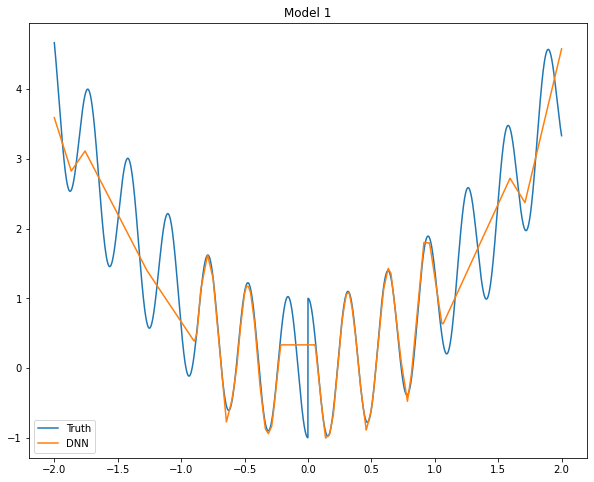

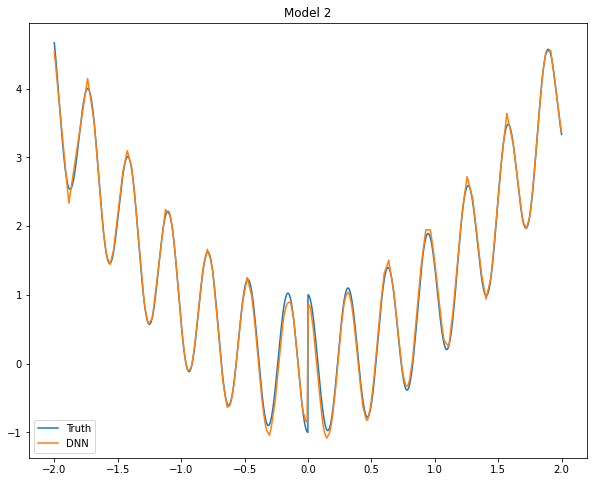

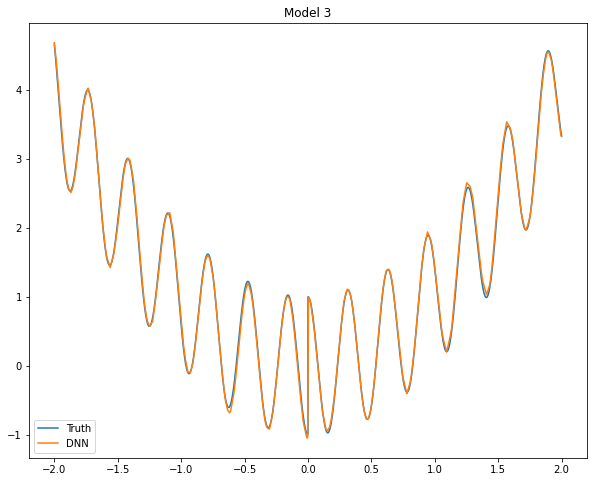

In [15]:
z = model1.predict(x)
plt.figure(figsize=(10,8))
plt.title('Model 1')
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

z = model2.predict(x)
plt.figure(figsize=(10,8))
plt.title('Model 2')
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

z = model3.predict(x)
plt.figure(figsize=(10,8))
plt.title('Model 3')
plt.plot(x,f(x),label="Truth")
plt.plot(x,z,label="DNN")
plt.legend()
plt.show()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_28 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_29 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_30 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_31 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_32 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_33 (Dense)             (None, 1)                 3         
Total params: 31
Trainable params: 31
Non-trainable params: 0
__________________________________________________________

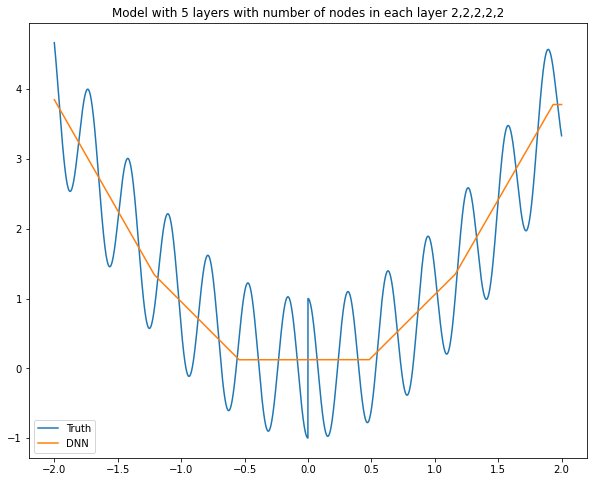

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_34 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_35 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_36 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_37 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_38 (Dense)             (None, 4)                 12        
_________________________________________________________________
dense_39 (Dense)             (None, 1)                 5         
Total params: 39
Trainable params: 39
Non-trainable params: 0
__________________________________________________________

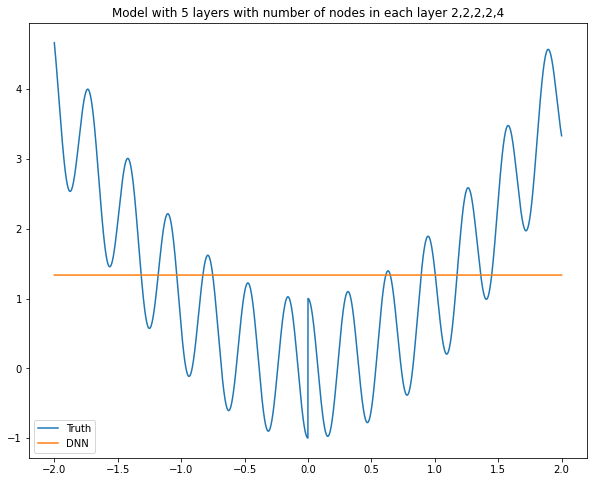

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_40 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_41 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_42 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_43 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_44 (Dense)             (None, 8)                 24        
_________________________________________________________________
dense_45 (Dense)             (None, 1)                 9         
Total params: 55
Trainable params: 55
Non-trainable params: 0
_________________________________________________________

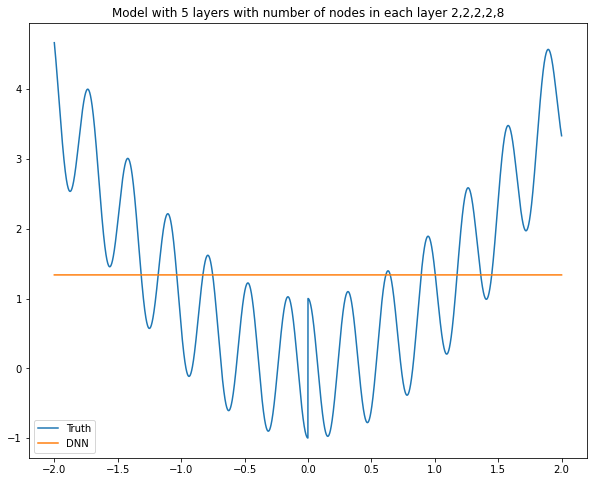

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_46 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_47 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_48 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_49 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_50 (Dense)             (None, 16)                48        
_________________________________________________________________
dense_51 (Dense)             (None, 1)                 17        
Total params: 87
Trainable params: 87
Non-trainable params: 0
_________________________________________________________

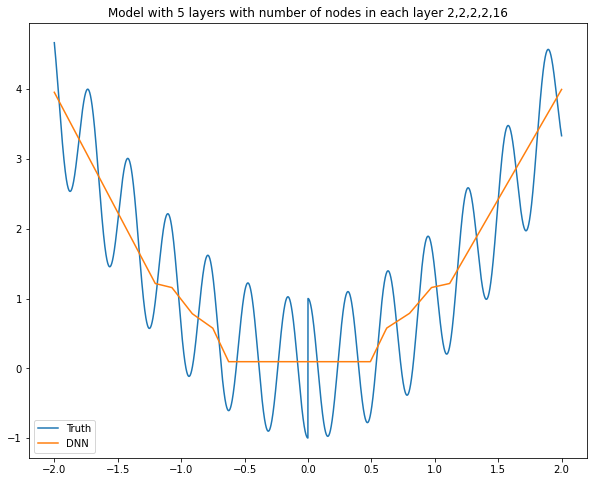

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_52 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_53 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_54 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_55 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_56 (Dense)             (None, 32)                96        
_________________________________________________________________
dense_57 (Dense)             (None, 1)                 33        
Total params: 151
Trainable params: 151
Non-trainable params: 0
_______________________________________________________

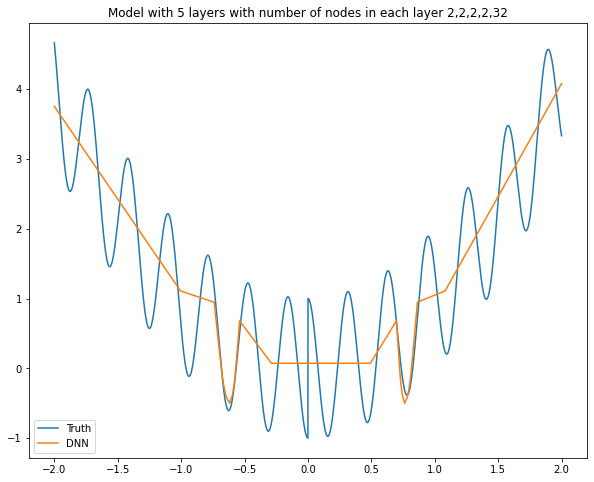

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_58 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_59 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_60 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_61 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_62 (Dense)             (None, 64)                192       
_________________________________________________________________
dense_63 (Dense)             (None, 1)                 65        
Total params: 279
Trainable params: 279
Non-trainable params: 0
_______________________________________________________

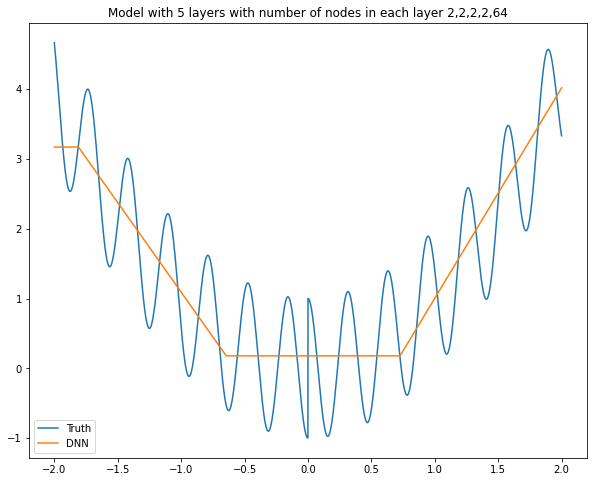

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_64 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_65 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_66 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_67 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_68 (Dense)             (None, 128)               384       
_________________________________________________________________
dense_69 (Dense)             (None, 1)                 129       
Total params: 535
Trainable params: 535
Non-trainable params: 0
_______________________________________________________

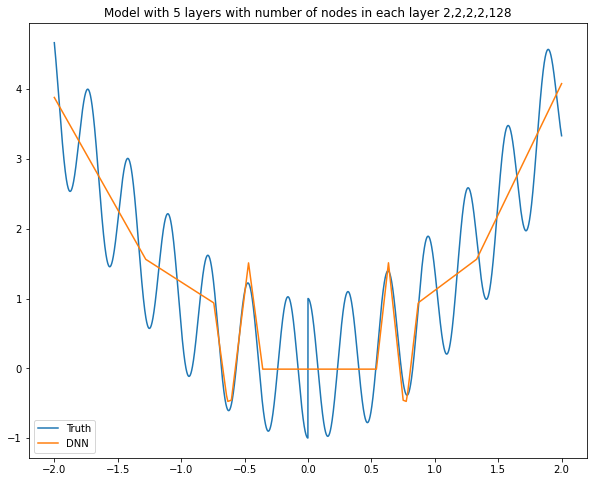

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_70 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_71 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_72 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_73 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_74 (Dense)             (None, 256)               768       
_________________________________________________________________
dense_75 (Dense)             (None, 1)                 257       
Total params: 1,047
Trainable params: 1,047
Non-trainable params: 0
___________________________________________________

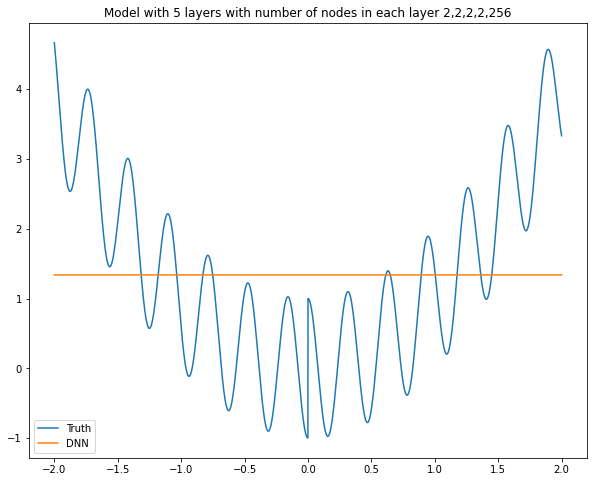

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_76 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_77 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_78 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_79 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_80 (Dense)             (None, 512)               1536      
_________________________________________________________________
dense_81 (Dense)             (None, 1)                 513       
Total params: 2,071
Trainable params: 2,071
Non-trainable params: 0
___________________________________________________

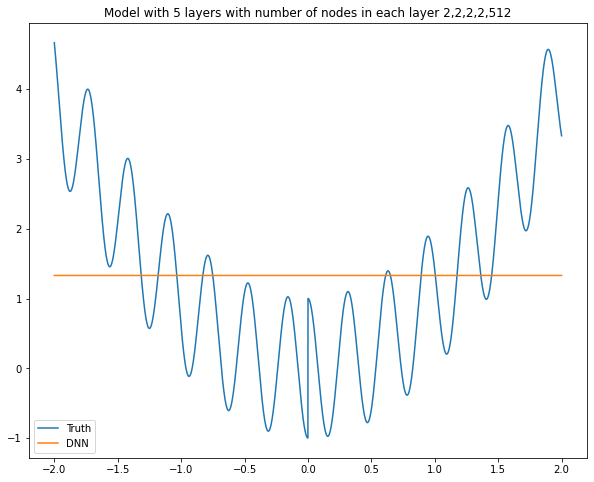

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_82 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_83 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_84 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_85 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_86 (Dense)             (None, 1024)              3072      
_________________________________________________________________
dense_87 (Dense)             (None, 1)                 1025      
Total params: 4,119
Trainable params: 4,119
Non-trainable params: 0
___________________________________________________

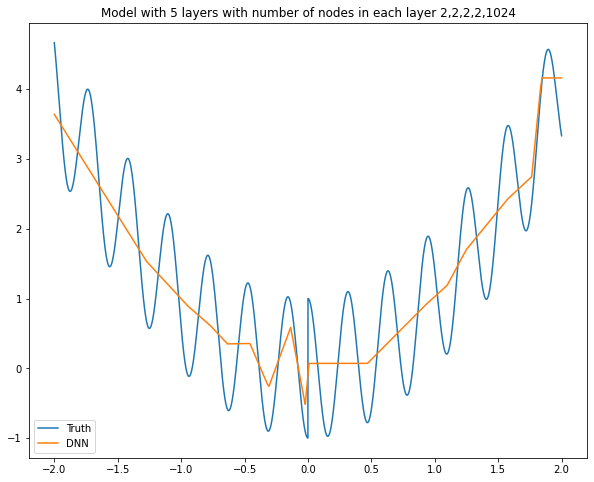

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_88 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_89 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_90 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_91 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_92 (Dense)             (None, 2048)              6144      
_________________________________________________________________
dense_93 (Dense)             (None, 1)                 2049      
Total params: 8,215
Trainable params: 8,215
Non-trainable params: 0
___________________________________________________

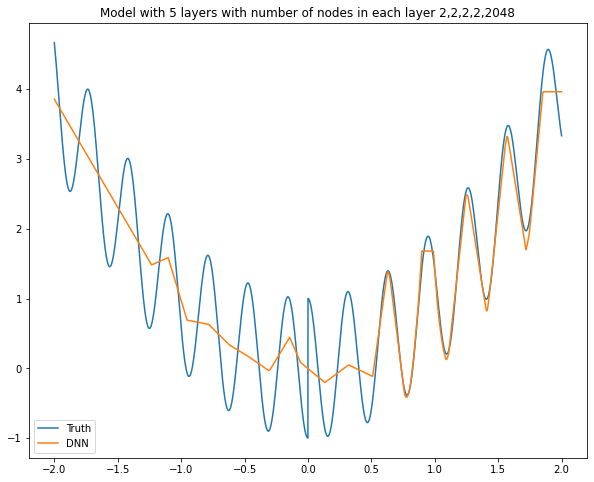

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_94 (Dense)             (None, 2)                 4         
_________________________________________________________________
dense_95 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_96 (Dense)             (None, 2)                 6         
_________________________________________________________________
dense_97 (Dense)             (None, 4)                 12        
_________________________________________________________________
dense_98 (Dense)             (None, 2)                 10        
_________________________________________________________________
dense_99 (Dense)             (None, 1)                 3         
Total params: 41
Trainable params: 41
Non-trainable params: 0
_________________________________________________________

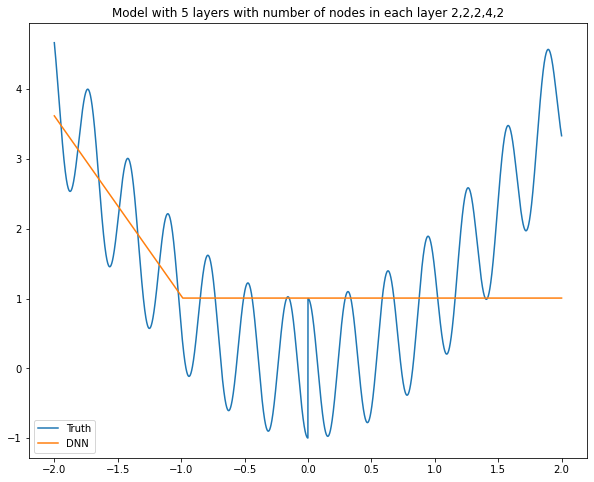

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_100 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_101 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_102 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_103 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_104 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_105 (Dense)            (None, 1)                 5         
Total params: 53
Trainable params: 53
Non-trainable params: 0
_________________________________________________________

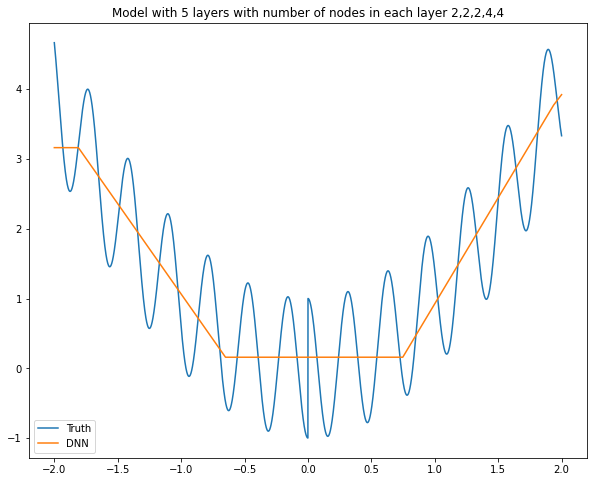

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_106 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_107 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_108 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_109 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_110 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_111 (Dense)            (None, 1)                 9         
Total params: 77
Trainable params: 77
Non-trainable params: 0
_________________________________________________________

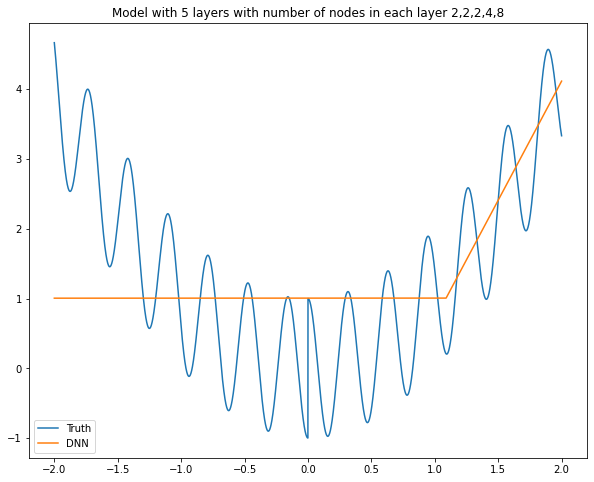

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_112 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_113 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_114 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_115 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_116 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_117 (Dense)            (None, 1)                 17        
Total params: 125
Trainable params: 125
Non-trainable params: 0
_______________________________________________________

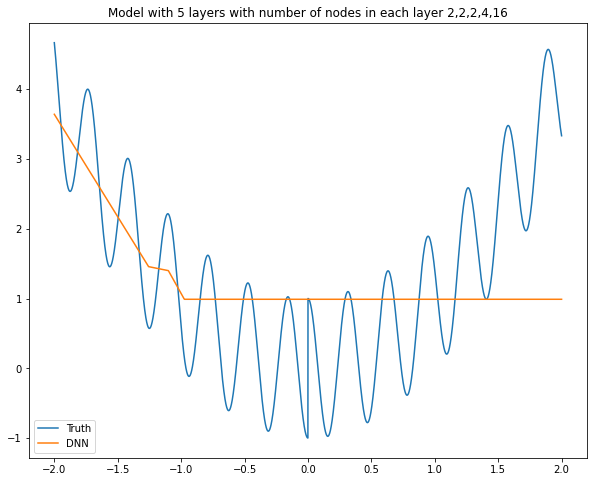

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_118 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_119 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_120 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_121 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_122 (Dense)            (None, 32)                160       
_________________________________________________________________
dense_123 (Dense)            (None, 1)                 33        
Total params: 221
Trainable params: 221
Non-trainable params: 0
_______________________________________________________

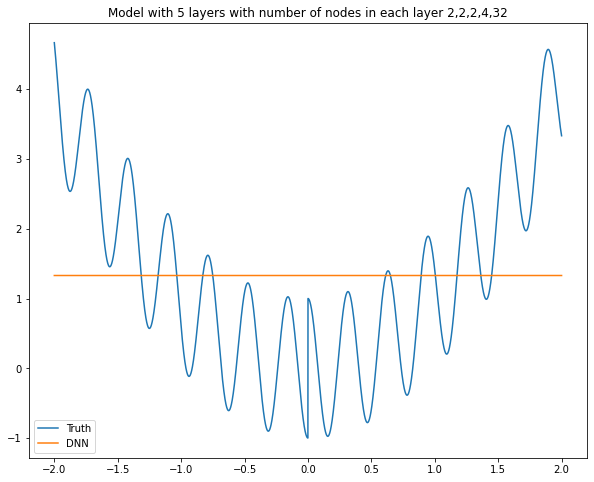

Model: "sequential_24"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_124 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_125 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_126 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_127 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_128 (Dense)            (None, 64)                320       
_________________________________________________________________
dense_129 (Dense)            (None, 1)                 65        
Total params: 413
Trainable params: 413
Non-trainable params: 0
_______________________________________________________

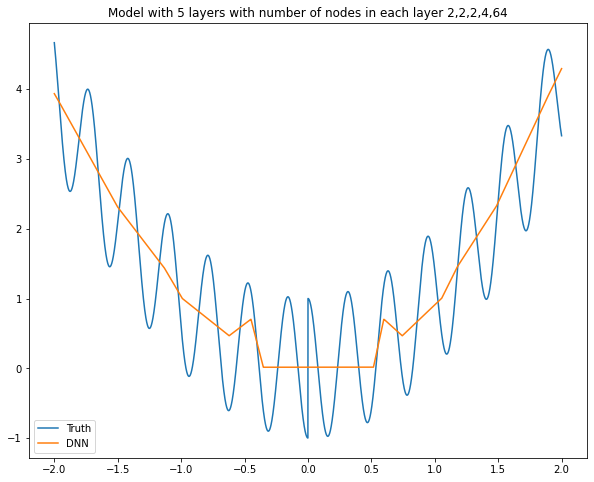

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_130 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_131 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_132 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_133 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_134 (Dense)            (None, 128)               640       
_________________________________________________________________
dense_135 (Dense)            (None, 1)                 129       
Total params: 797
Trainable params: 797
Non-trainable params: 0
_______________________________________________________

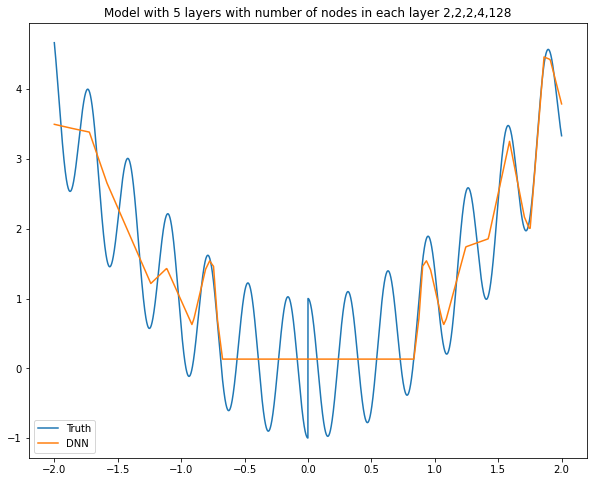

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_136 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_137 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_138 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_139 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_140 (Dense)            (None, 256)               1280      
_________________________________________________________________
dense_141 (Dense)            (None, 1)                 257       
Total params: 1,565
Trainable params: 1,565
Non-trainable params: 0
___________________________________________________

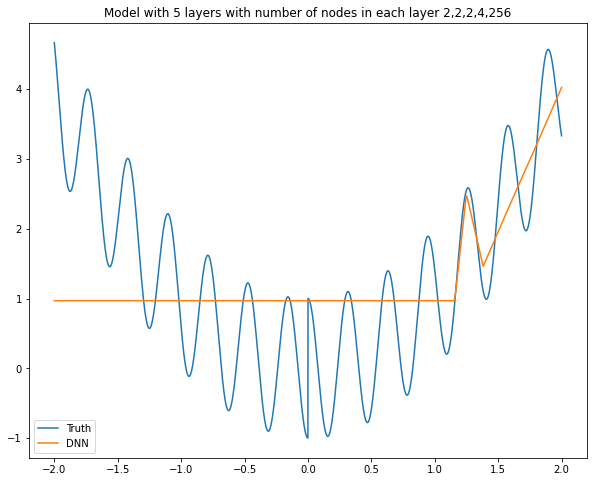

Model: "sequential_27"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_142 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_143 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_144 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_145 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_146 (Dense)            (None, 512)               2560      
_________________________________________________________________
dense_147 (Dense)            (None, 1)                 513       
Total params: 3,101
Trainable params: 3,101
Non-trainable params: 0
___________________________________________________

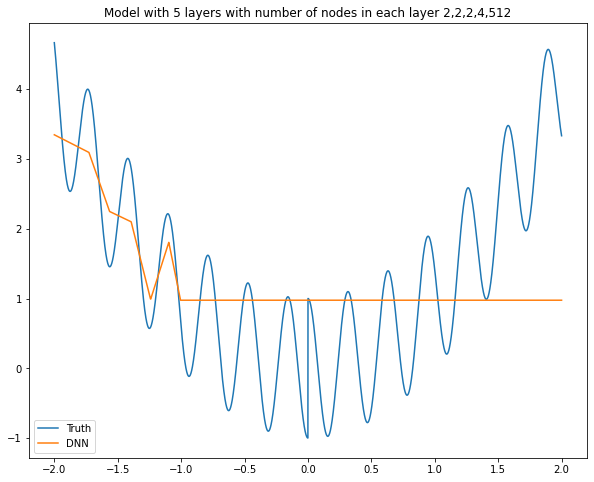

Model: "sequential_28"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_148 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_149 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_150 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_151 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_152 (Dense)            (None, 1024)              5120      
_________________________________________________________________
dense_153 (Dense)            (None, 1)                 1025      
Total params: 6,173
Trainable params: 6,173
Non-trainable params: 0
___________________________________________________

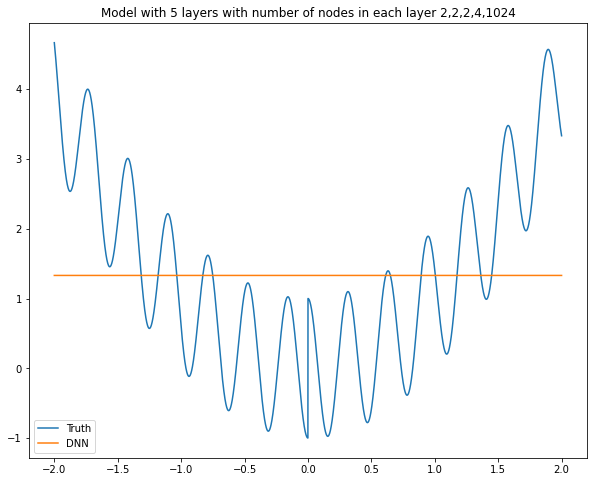

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_154 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_155 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_156 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_157 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_158 (Dense)            (None, 2048)              10240     
_________________________________________________________________
dense_159 (Dense)            (None, 1)                 2049      
Total params: 12,317
Trainable params: 12,317
Non-trainable params: 0
_________________________________________________

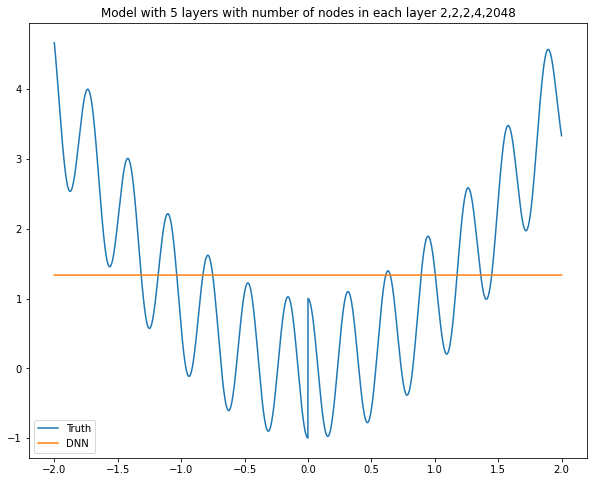

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_160 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_161 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_162 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_163 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_164 (Dense)            (None, 2)                 18        
_________________________________________________________________
dense_165 (Dense)            (None, 1)                 3         
Total params: 61
Trainable params: 61
Non-trainable params: 0
_________________________________________________________

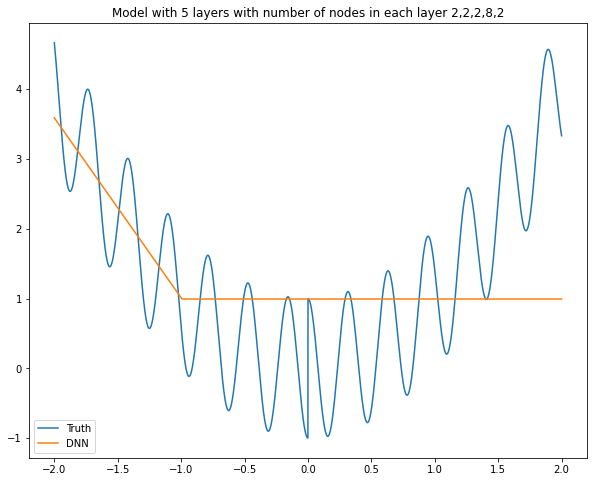

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_166 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_167 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_168 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_169 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_170 (Dense)            (None, 4)                 36        
_________________________________________________________________
dense_171 (Dense)            (None, 1)                 5         
Total params: 81
Trainable params: 81
Non-trainable params: 0
_________________________________________________________

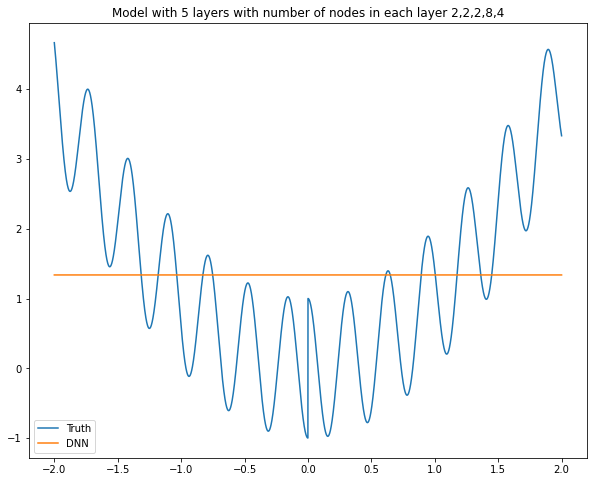

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_172 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_173 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_174 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_175 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_176 (Dense)            (None, 8)                 72        
_________________________________________________________________
dense_177 (Dense)            (None, 1)                 9         
Total params: 121
Trainable params: 121
Non-trainable params: 0
_______________________________________________________

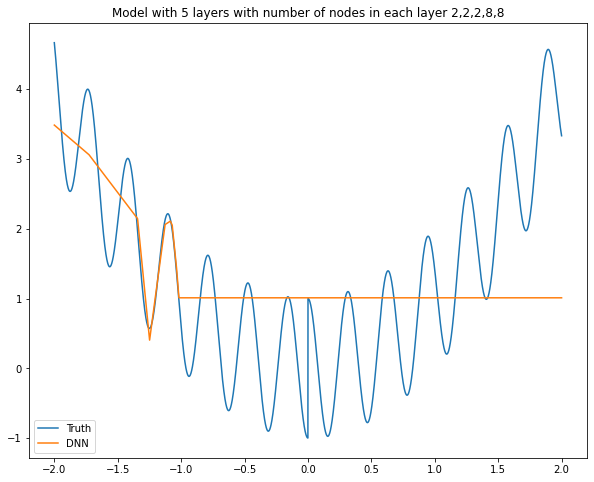

Model: "sequential_33"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_178 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_179 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_180 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_181 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_182 (Dense)            (None, 16)                144       
_________________________________________________________________
dense_183 (Dense)            (None, 1)                 17        
Total params: 201
Trainable params: 201
Non-trainable params: 0
_______________________________________________________

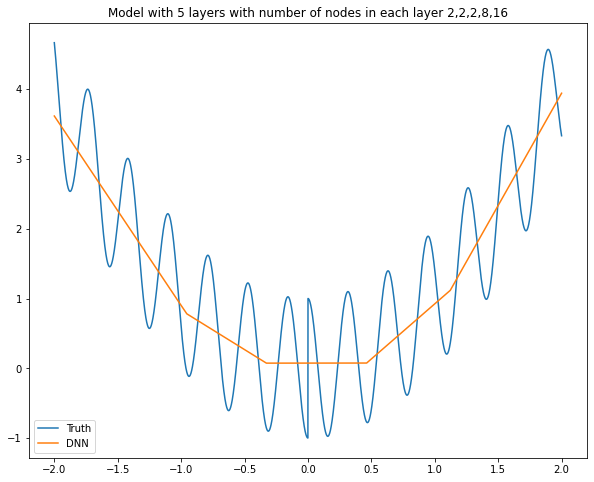

Model: "sequential_34"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_184 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_185 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_186 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_187 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_188 (Dense)            (None, 32)                288       
_________________________________________________________________
dense_189 (Dense)            (None, 1)                 33        
Total params: 361
Trainable params: 361
Non-trainable params: 0
_______________________________________________________

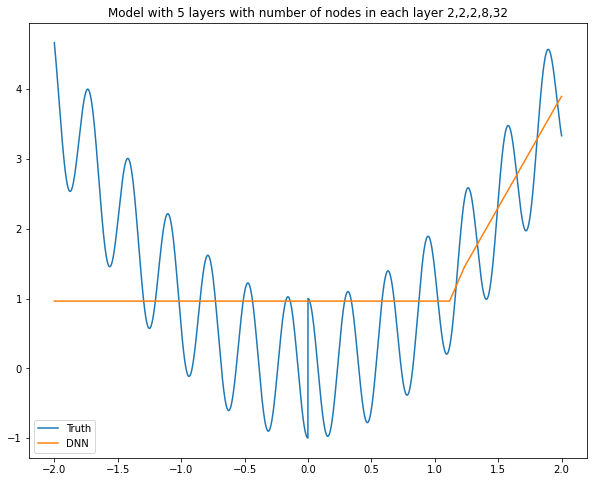

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_190 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_191 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_192 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_193 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_194 (Dense)            (None, 64)                576       
_________________________________________________________________
dense_195 (Dense)            (None, 1)                 65        
Total params: 681
Trainable params: 681
Non-trainable params: 0
_______________________________________________________

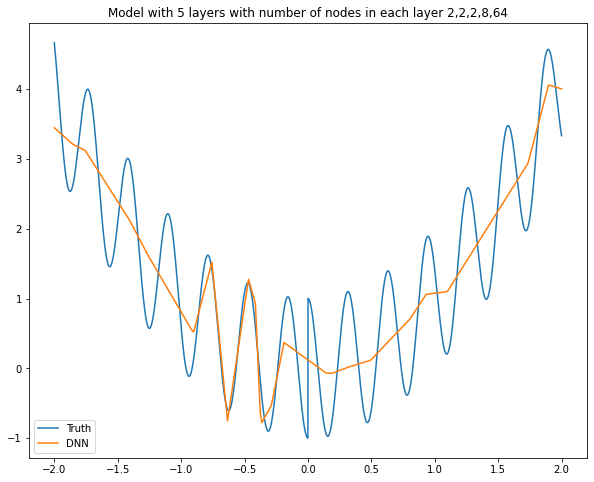

Model: "sequential_36"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_196 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_197 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_198 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_199 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_200 (Dense)            (None, 128)               1152      
_________________________________________________________________
dense_201 (Dense)            (None, 1)                 129       
Total params: 1,321
Trainable params: 1,321
Non-trainable params: 0
___________________________________________________

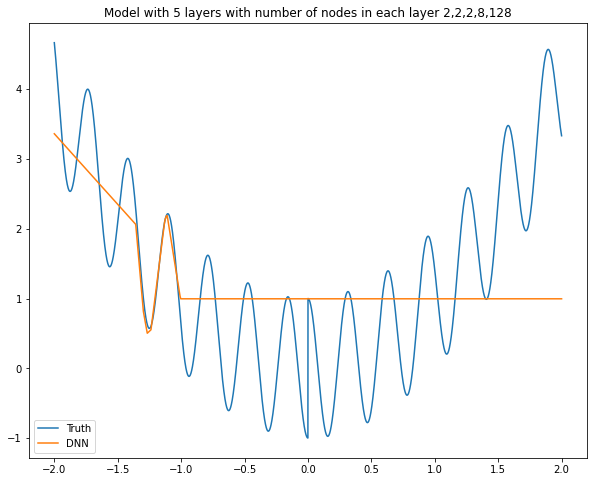

Model: "sequential_37"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_202 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_203 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_204 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_205 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_206 (Dense)            (None, 256)               2304      
_________________________________________________________________
dense_207 (Dense)            (None, 1)                 257       
Total params: 2,601
Trainable params: 2,601
Non-trainable params: 0
___________________________________________________

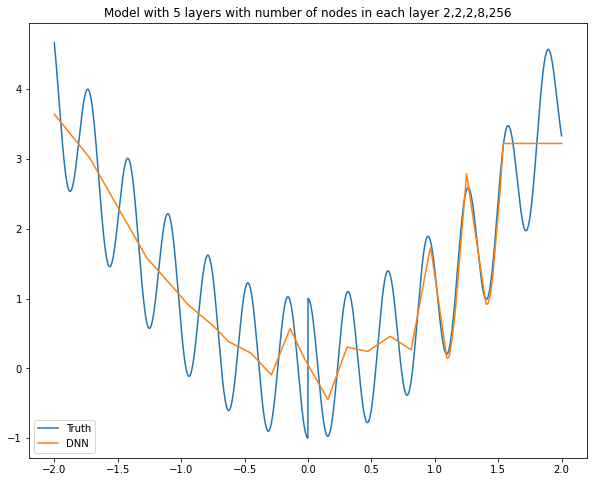

Model: "sequential_38"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_208 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_209 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_210 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_211 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_212 (Dense)            (None, 512)               4608      
_________________________________________________________________
dense_213 (Dense)            (None, 1)                 513       
Total params: 5,161
Trainable params: 5,161
Non-trainable params: 0
___________________________________________________

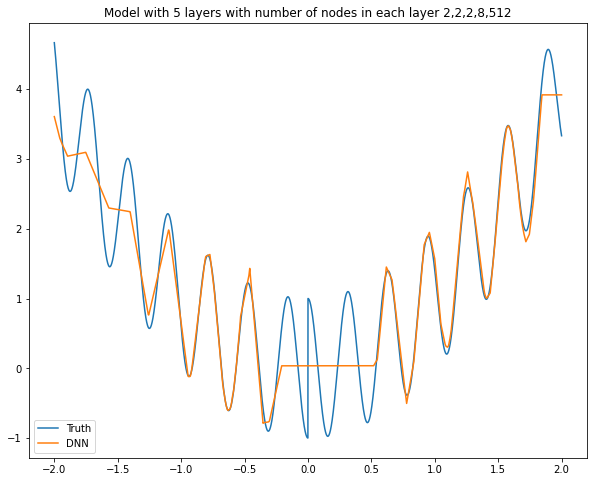

Model: "sequential_39"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_214 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_215 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_216 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_217 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_218 (Dense)            (None, 1024)              9216      
_________________________________________________________________
dense_219 (Dense)            (None, 1)                 1025      
Total params: 10,281
Trainable params: 10,281
Non-trainable params: 0
_________________________________________________

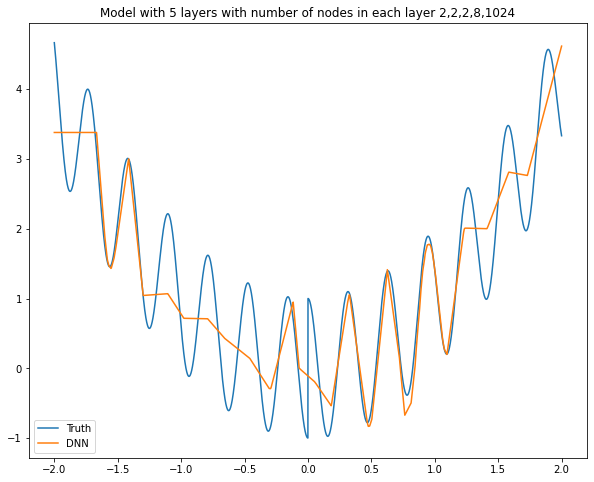

Model: "sequential_40"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_220 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_221 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_222 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_223 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_224 (Dense)            (None, 2048)              18432     
_________________________________________________________________
dense_225 (Dense)            (None, 1)                 2049      
Total params: 20,521
Trainable params: 20,521
Non-trainable params: 0
_________________________________________________

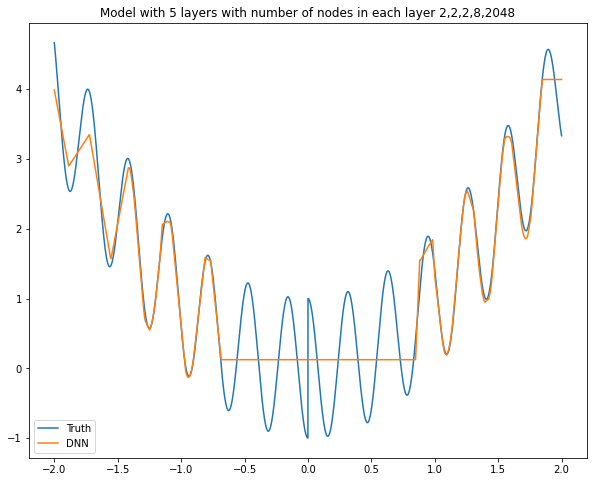

Model: "sequential_41"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_226 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_227 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_228 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_229 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_230 (Dense)            (None, 2)                 34        
_________________________________________________________________
dense_231 (Dense)            (None, 1)                 3         
Total params: 101
Trainable params: 101
Non-trainable params: 0
_______________________________________________________

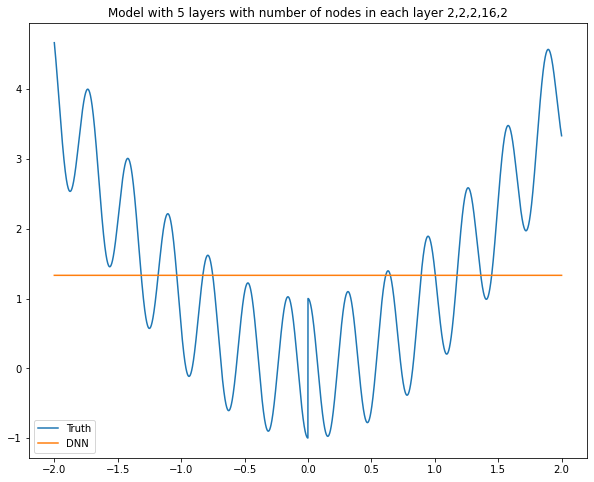

Model: "sequential_42"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_232 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_233 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_234 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_235 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_236 (Dense)            (None, 4)                 68        
_________________________________________________________________
dense_237 (Dense)            (None, 1)                 5         
Total params: 137
Trainable params: 137
Non-trainable params: 0
_______________________________________________________

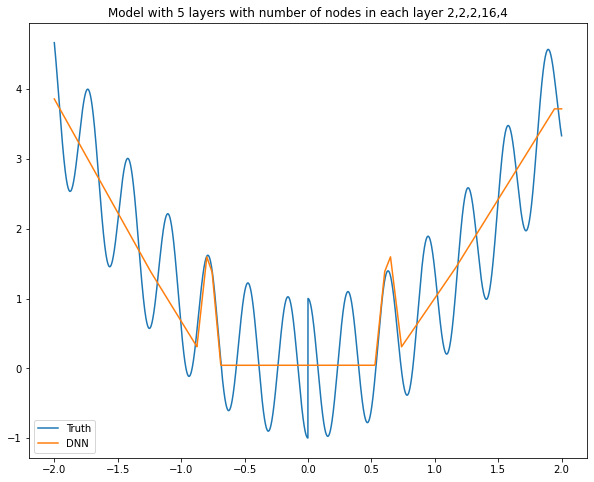

Model: "sequential_43"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_238 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_239 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_240 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_241 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_242 (Dense)            (None, 8)                 136       
_________________________________________________________________
dense_243 (Dense)            (None, 1)                 9         
Total params: 209
Trainable params: 209
Non-trainable params: 0
_______________________________________________________

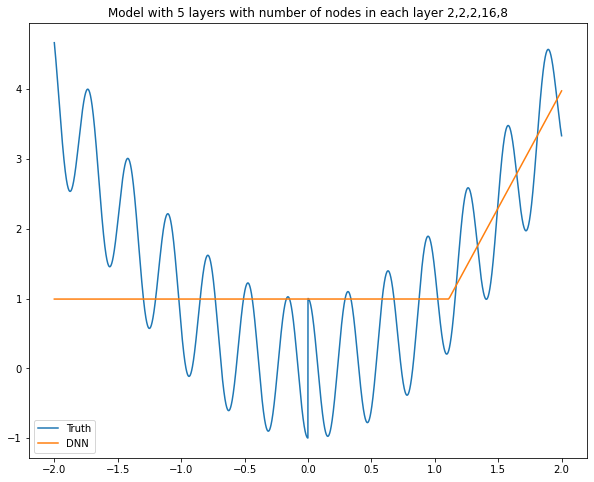

Model: "sequential_44"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_244 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_245 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_246 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_247 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_248 (Dense)            (None, 16)                272       
_________________________________________________________________
dense_249 (Dense)            (None, 1)                 17        
Total params: 353
Trainable params: 353
Non-trainable params: 0
_______________________________________________________

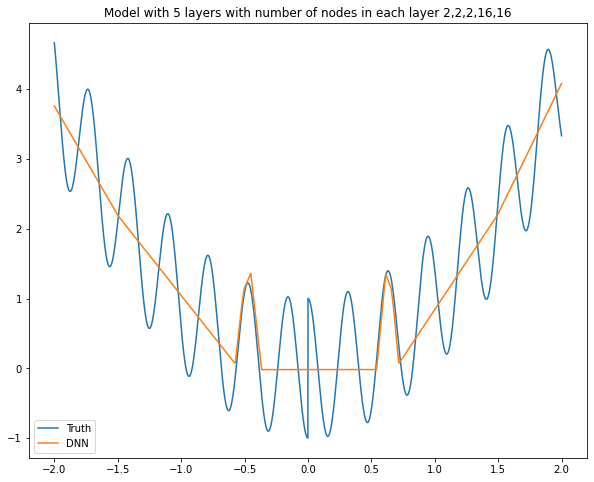

Model: "sequential_45"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_250 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_251 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_252 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_253 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_254 (Dense)            (None, 32)                544       
_________________________________________________________________
dense_255 (Dense)            (None, 1)                 33        
Total params: 641
Trainable params: 641
Non-trainable params: 0
_______________________________________________________

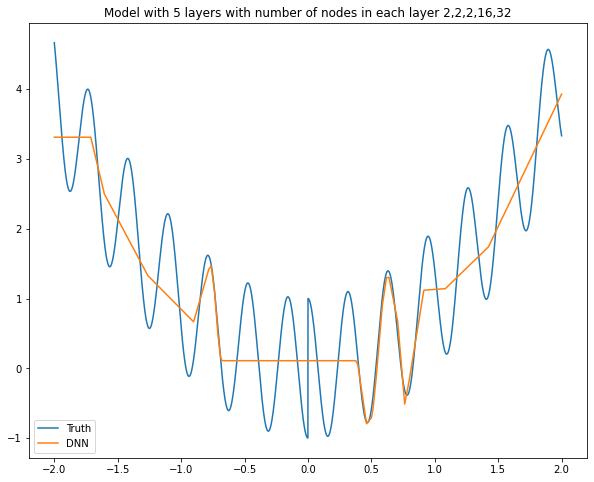

Model: "sequential_46"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_256 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_257 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_258 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_259 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_260 (Dense)            (None, 64)                1088      
_________________________________________________________________
dense_261 (Dense)            (None, 1)                 65        
Total params: 1,217
Trainable params: 1,217
Non-trainable params: 0
___________________________________________________

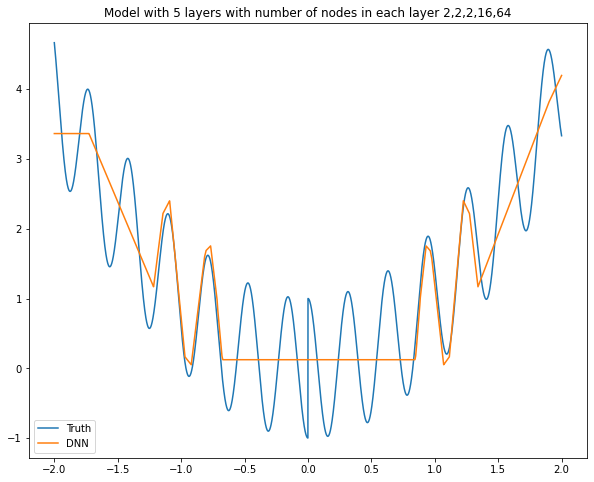

Model: "sequential_47"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_262 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_263 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_264 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_265 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_266 (Dense)            (None, 128)               2176      
_________________________________________________________________
dense_267 (Dense)            (None, 1)                 129       
Total params: 2,369
Trainable params: 2,369
Non-trainable params: 0
___________________________________________________

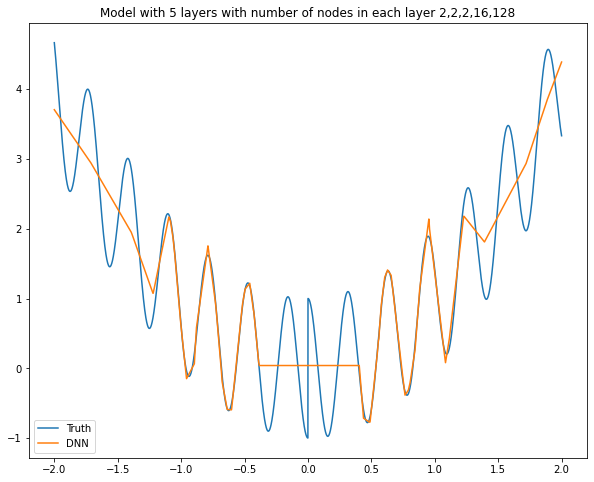

Model: "sequential_48"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_268 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_269 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_270 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_271 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_272 (Dense)            (None, 256)               4352      
_________________________________________________________________
dense_273 (Dense)            (None, 1)                 257       
Total params: 4,673
Trainable params: 4,673
Non-trainable params: 0
___________________________________________________

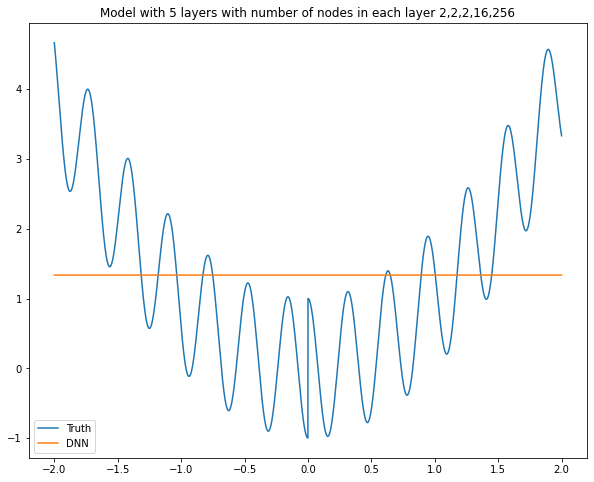

Model: "sequential_49"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_274 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_275 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_276 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_277 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_278 (Dense)            (None, 512)               8704      
_________________________________________________________________
dense_279 (Dense)            (None, 1)                 513       
Total params: 9,281
Trainable params: 9,281
Non-trainable params: 0
___________________________________________________

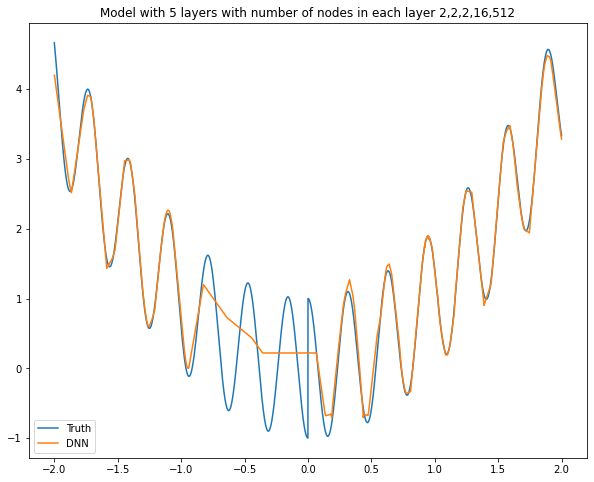

Model: "sequential_50"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_280 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_281 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_282 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_283 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_284 (Dense)            (None, 1024)              17408     
_________________________________________________________________
dense_285 (Dense)            (None, 1)                 1025      
Total params: 18,497
Trainable params: 18,497
Non-trainable params: 0
_________________________________________________

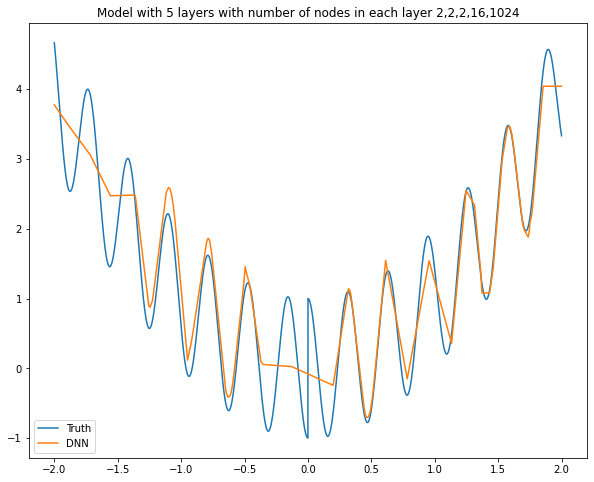

Model: "sequential_51"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_286 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_287 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_288 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_289 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_290 (Dense)            (None, 2048)              34816     
_________________________________________________________________
dense_291 (Dense)            (None, 1)                 2049      
Total params: 36,929
Trainable params: 36,929
Non-trainable params: 0
_________________________________________________

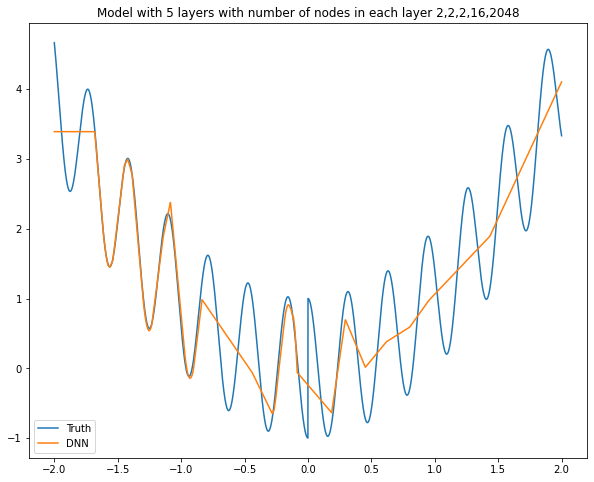

Model: "sequential_52"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_292 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_293 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_294 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_295 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_296 (Dense)            (None, 2)                 66        
_________________________________________________________________
dense_297 (Dense)            (None, 1)                 3         
Total params: 181
Trainable params: 181
Non-trainable params: 0
_______________________________________________________

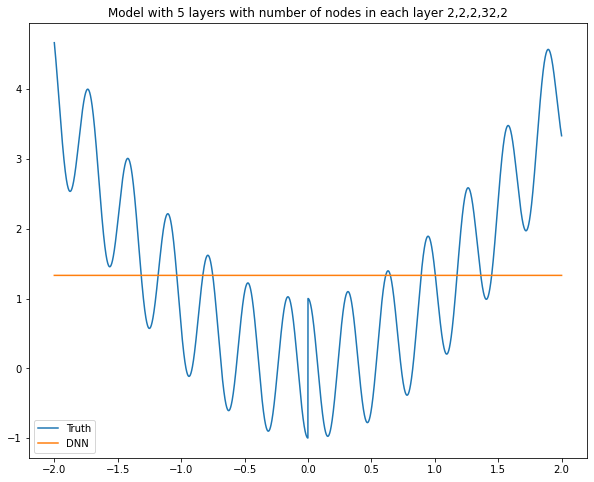

Model: "sequential_53"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_298 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_299 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_300 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_301 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_302 (Dense)            (None, 4)                 132       
_________________________________________________________________
dense_303 (Dense)            (None, 1)                 5         
Total params: 249
Trainable params: 249
Non-trainable params: 0
_______________________________________________________

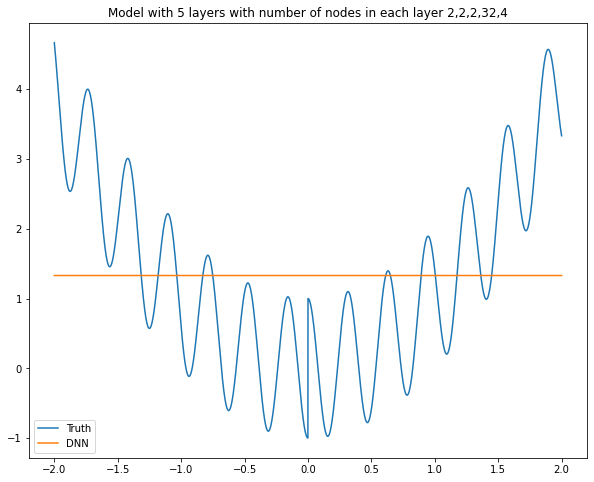

Model: "sequential_54"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_304 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_305 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_306 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_307 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_308 (Dense)            (None, 8)                 264       
_________________________________________________________________
dense_309 (Dense)            (None, 1)                 9         
Total params: 385
Trainable params: 385
Non-trainable params: 0
_______________________________________________________

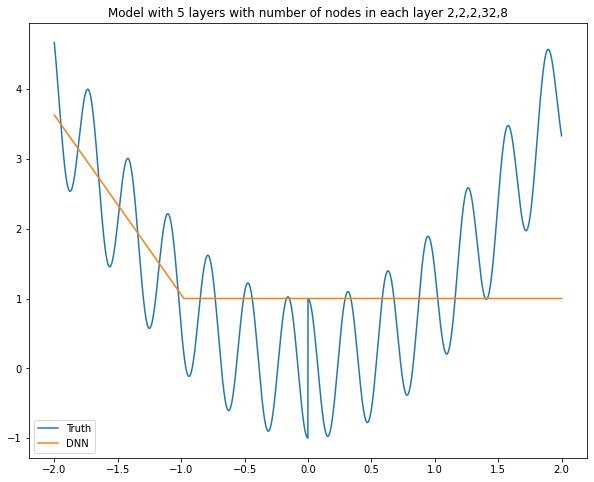

Model: "sequential_55"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_310 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_311 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_312 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_313 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_314 (Dense)            (None, 16)                528       
_________________________________________________________________
dense_315 (Dense)            (None, 1)                 17        
Total params: 657
Trainable params: 657
Non-trainable params: 0
_______________________________________________________

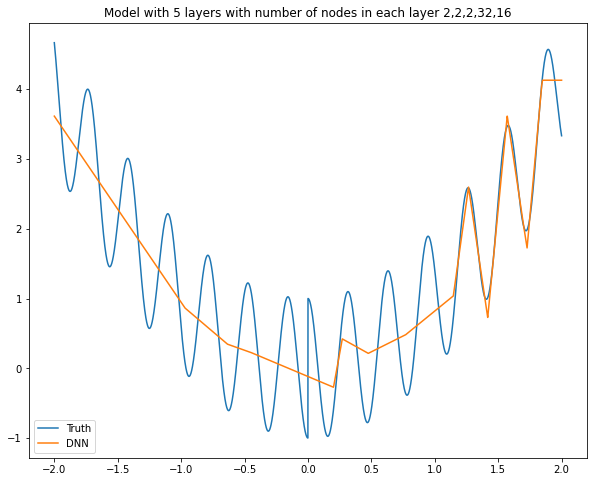

Model: "sequential_56"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_316 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_317 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_318 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_319 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_320 (Dense)            (None, 32)                1056      
_________________________________________________________________
dense_321 (Dense)            (None, 1)                 33        
Total params: 1,201
Trainable params: 1,201
Non-trainable params: 0
___________________________________________________

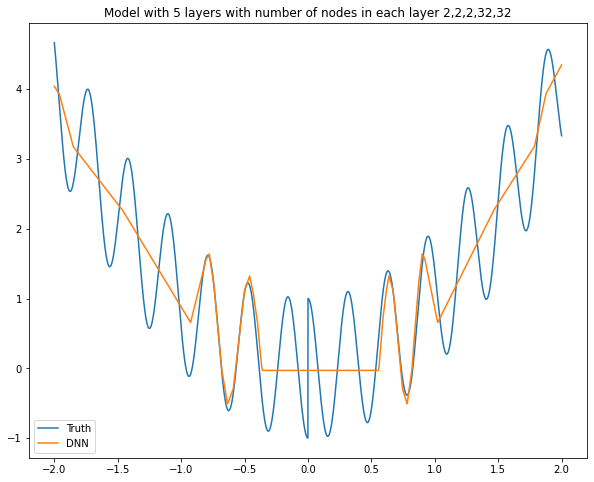

Model: "sequential_57"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_322 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_323 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_324 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_325 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_326 (Dense)            (None, 64)                2112      
_________________________________________________________________
dense_327 (Dense)            (None, 1)                 65        
Total params: 2,289
Trainable params: 2,289
Non-trainable params: 0
___________________________________________________

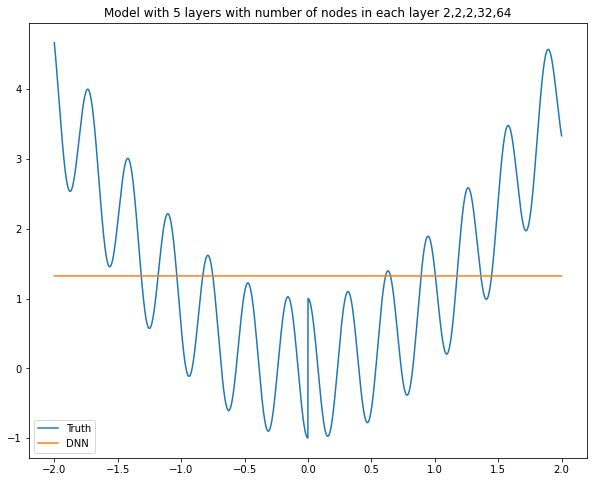

Model: "sequential_58"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_328 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_329 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_330 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_331 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_332 (Dense)            (None, 128)               4224      
_________________________________________________________________
dense_333 (Dense)            (None, 1)                 129       
Total params: 4,465
Trainable params: 4,465
Non-trainable params: 0
___________________________________________________

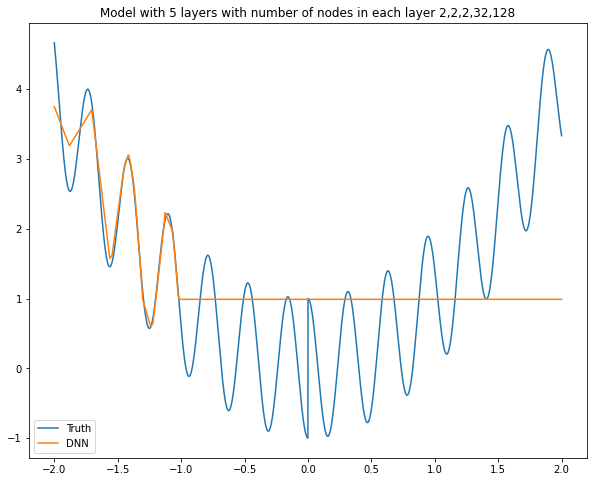

Model: "sequential_59"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_334 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_335 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_336 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_337 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_338 (Dense)            (None, 256)               8448      
_________________________________________________________________
dense_339 (Dense)            (None, 1)                 257       
Total params: 8,817
Trainable params: 8,817
Non-trainable params: 0
___________________________________________________

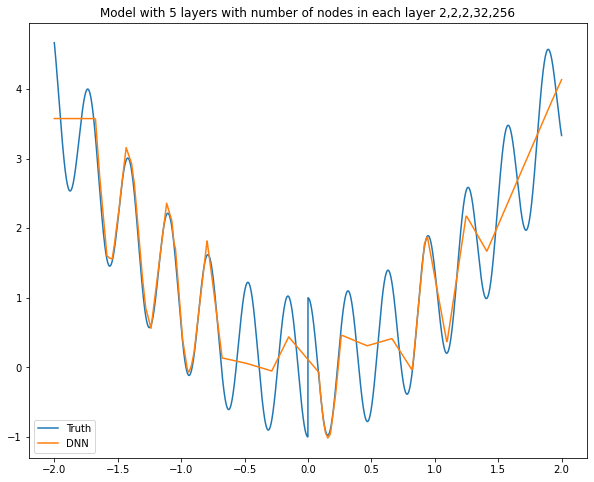

Model: "sequential_60"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_340 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_341 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_342 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_343 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_344 (Dense)            (None, 512)               16896     
_________________________________________________________________
dense_345 (Dense)            (None, 1)                 513       
Total params: 17,521
Trainable params: 17,521
Non-trainable params: 0
_________________________________________________

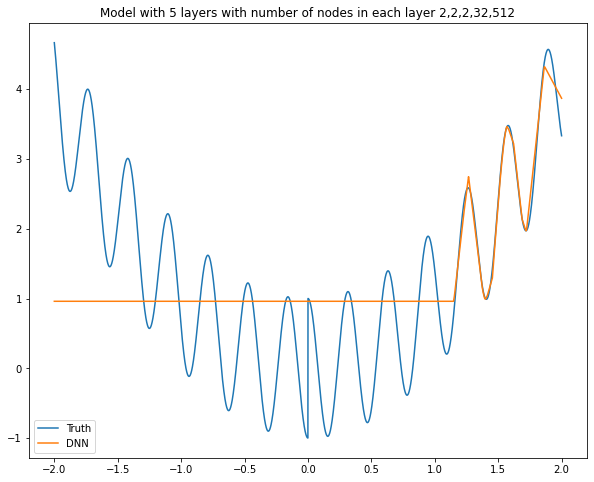

Model: "sequential_61"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_346 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_347 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_348 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_349 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_350 (Dense)            (None, 1024)              33792     
_________________________________________________________________
dense_351 (Dense)            (None, 1)                 1025      
Total params: 34,929
Trainable params: 34,929
Non-trainable params: 0
_________________________________________________

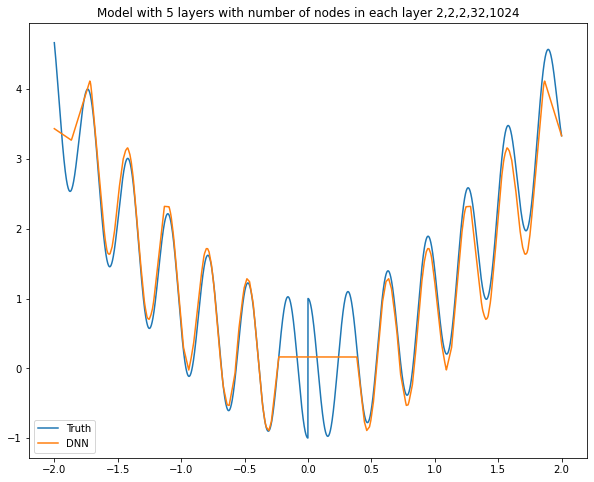

Model: "sequential_62"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_352 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_353 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_354 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_355 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_356 (Dense)            (None, 2048)              67584     
_________________________________________________________________
dense_357 (Dense)            (None, 1)                 2049      
Total params: 69,745
Trainable params: 69,745
Non-trainable params: 0
_________________________________________________

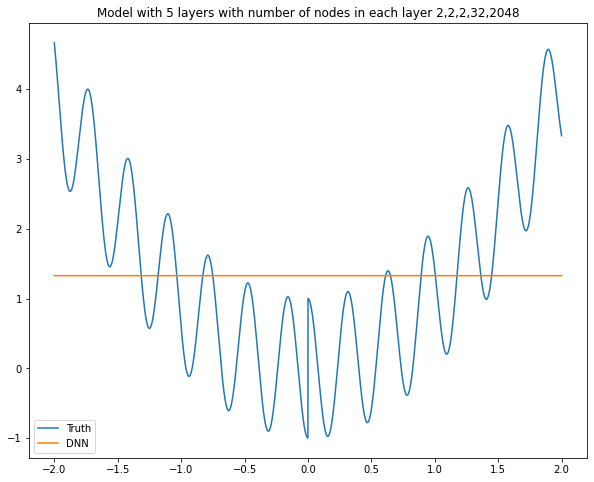

Model: "sequential_63"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_358 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_359 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_360 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_361 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_362 (Dense)            (None, 2)                 130       
_________________________________________________________________
dense_363 (Dense)            (None, 1)                 3         
Total params: 341
Trainable params: 341
Non-trainable params: 0
_______________________________________________________

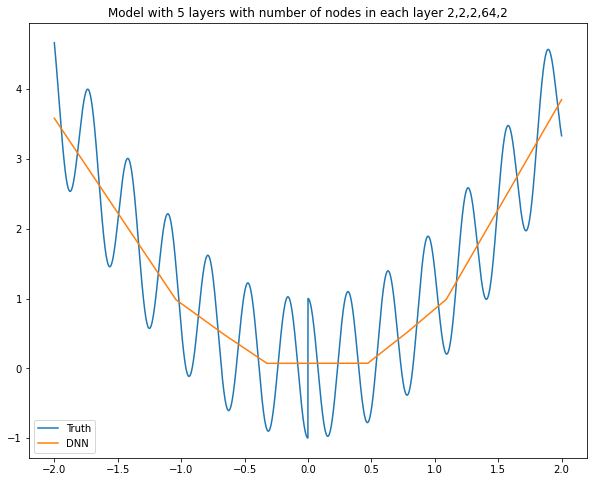

Model: "sequential_64"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_364 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_365 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_366 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_367 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_368 (Dense)            (None, 4)                 260       
_________________________________________________________________
dense_369 (Dense)            (None, 1)                 5         
Total params: 473
Trainable params: 473
Non-trainable params: 0
_______________________________________________________

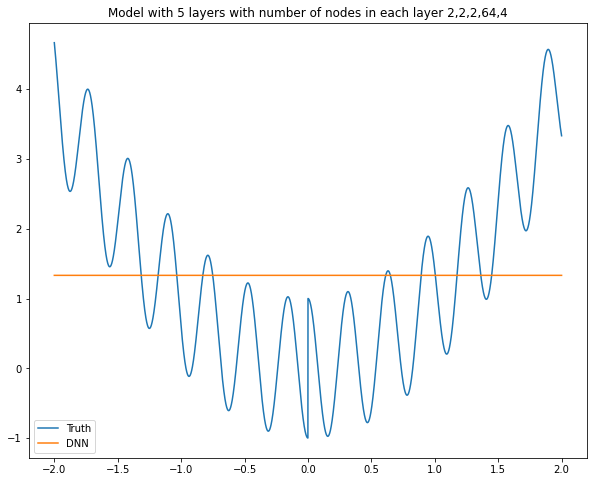

Model: "sequential_65"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_370 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_371 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_372 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_373 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_374 (Dense)            (None, 8)                 520       
_________________________________________________________________
dense_375 (Dense)            (None, 1)                 9         
Total params: 737
Trainable params: 737
Non-trainable params: 0
_______________________________________________________

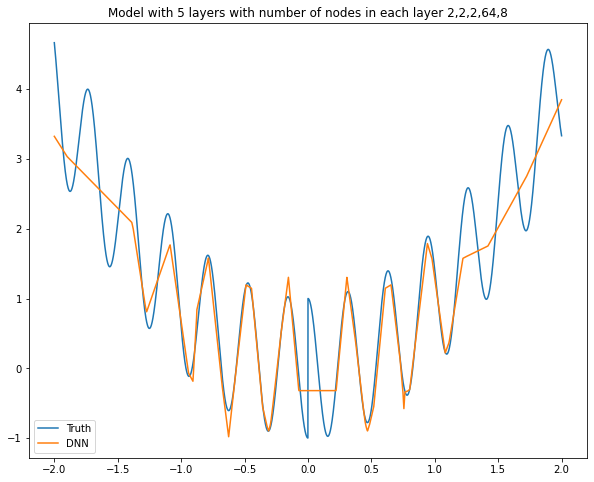

Model: "sequential_66"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_376 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_377 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_378 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_379 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_380 (Dense)            (None, 16)                1040      
_________________________________________________________________
dense_381 (Dense)            (None, 1)                 17        
Total params: 1,265
Trainable params: 1,265
Non-trainable params: 0
___________________________________________________

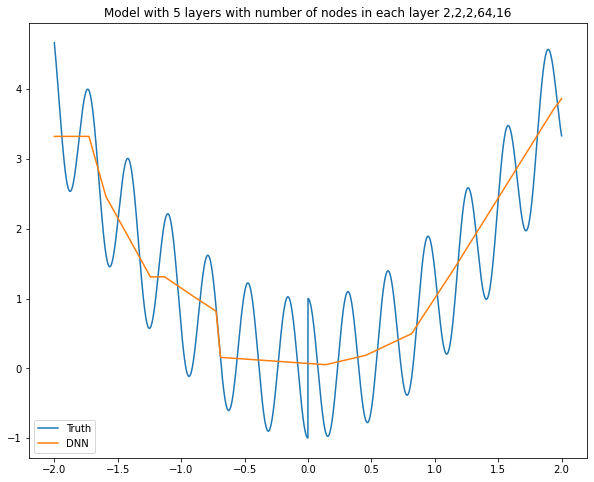

Model: "sequential_67"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_382 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_383 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_384 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_385 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_386 (Dense)            (None, 32)                2080      
_________________________________________________________________
dense_387 (Dense)            (None, 1)                 33        
Total params: 2,321
Trainable params: 2,321
Non-trainable params: 0
___________________________________________________

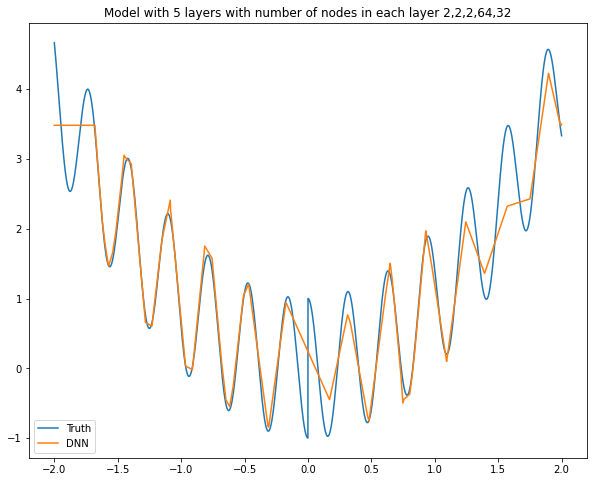

Model: "sequential_68"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_388 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_389 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_390 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_391 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_392 (Dense)            (None, 64)                4160      
_________________________________________________________________
dense_393 (Dense)            (None, 1)                 65        
Total params: 4,433
Trainable params: 4,433
Non-trainable params: 0
___________________________________________________

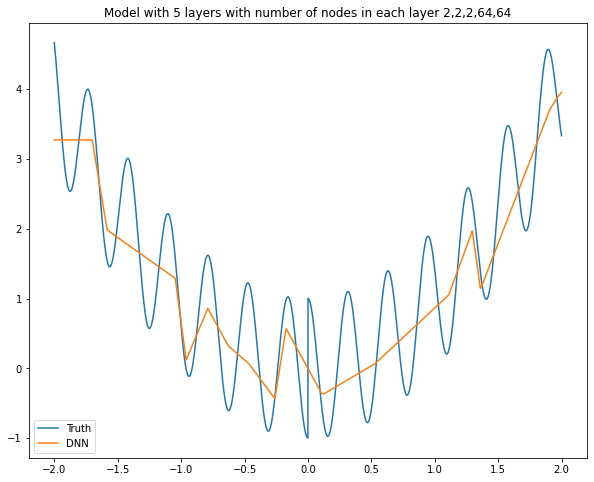

Model: "sequential_69"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_394 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_395 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_396 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_397 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_398 (Dense)            (None, 128)               8320      
_________________________________________________________________
dense_399 (Dense)            (None, 1)                 129       
Total params: 8,657
Trainable params: 8,657
Non-trainable params: 0
___________________________________________________

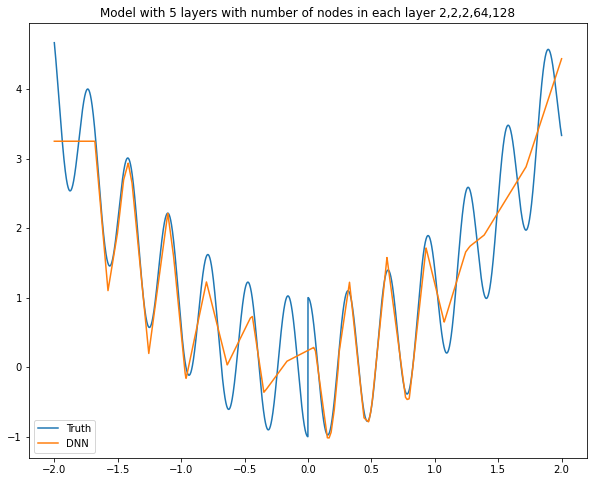

Model: "sequential_70"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_400 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_401 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_402 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_403 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_404 (Dense)            (None, 256)               16640     
_________________________________________________________________
dense_405 (Dense)            (None, 1)                 257       
Total params: 17,105
Trainable params: 17,105
Non-trainable params: 0
_________________________________________________

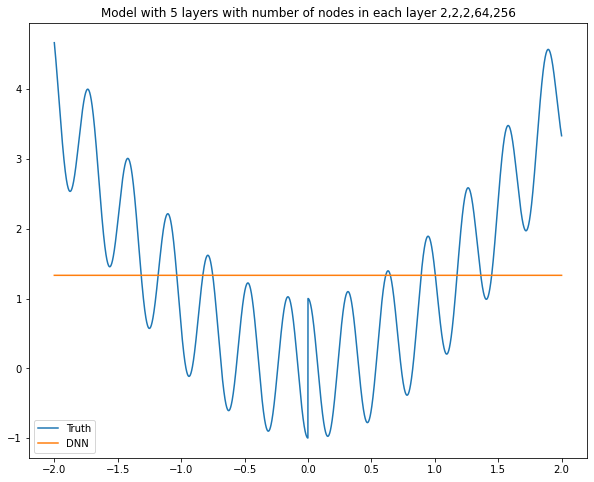

Model: "sequential_71"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_406 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_407 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_408 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_409 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_410 (Dense)            (None, 512)               33280     
_________________________________________________________________
dense_411 (Dense)            (None, 1)                 513       
Total params: 34,001
Trainable params: 34,001
Non-trainable params: 0
_________________________________________________

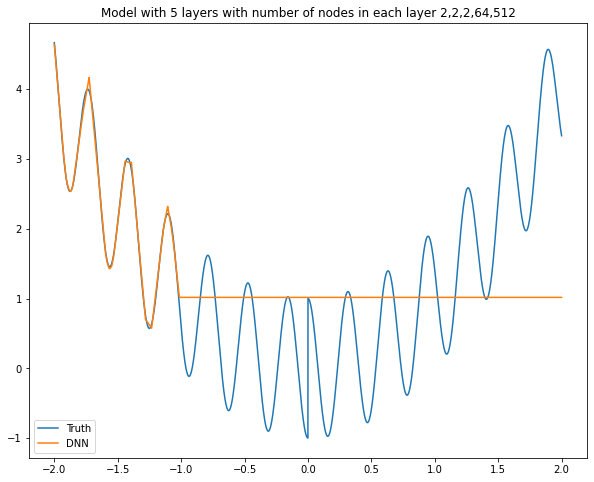

Model: "sequential_72"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_412 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_413 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_414 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_415 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_416 (Dense)            (None, 1024)              66560     
_________________________________________________________________
dense_417 (Dense)            (None, 1)                 1025      
Total params: 67,793
Trainable params: 67,793
Non-trainable params: 0
_________________________________________________

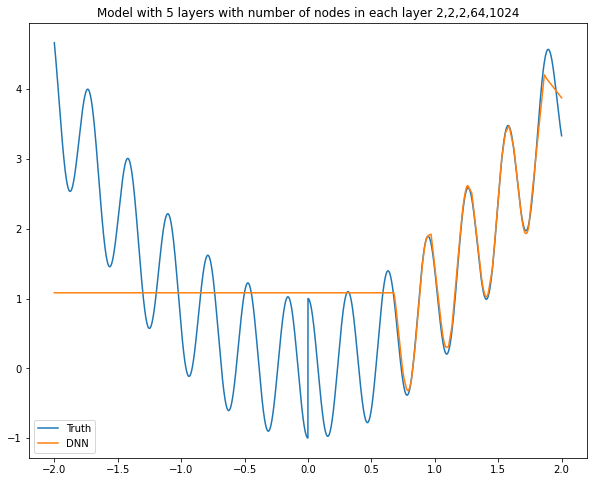

Model: "sequential_73"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_418 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_419 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_420 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_421 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_422 (Dense)            (None, 2048)              133120    
_________________________________________________________________
dense_423 (Dense)            (None, 1)                 2049      
Total params: 135,377
Trainable params: 135,377
Non-trainable params: 0
_______________________________________________

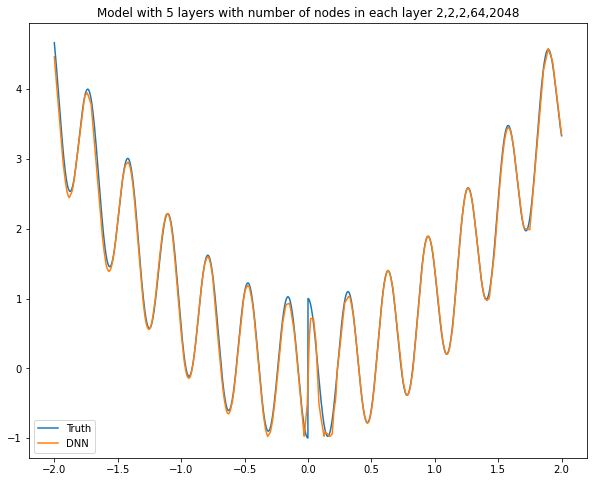

Model: "sequential_74"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_424 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_425 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_426 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_427 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_428 (Dense)            (None, 2)                 258       
_________________________________________________________________
dense_429 (Dense)            (None, 1)                 3         
Total params: 661
Trainable params: 661
Non-trainable params: 0
_______________________________________________________

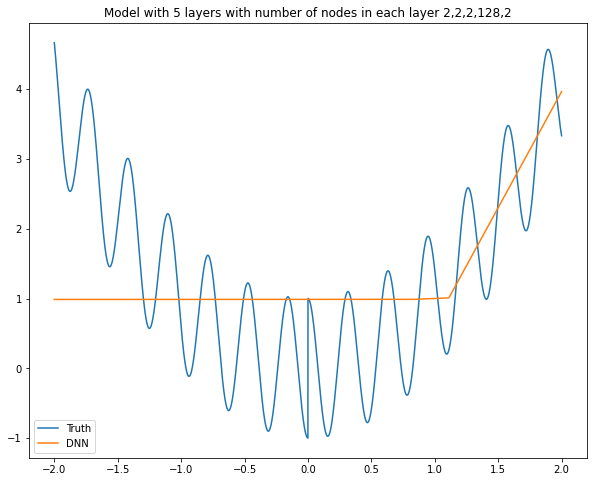

Model: "sequential_75"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_430 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_431 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_432 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_433 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_434 (Dense)            (None, 4)                 516       
_________________________________________________________________
dense_435 (Dense)            (None, 1)                 5         
Total params: 921
Trainable params: 921
Non-trainable params: 0
_______________________________________________________

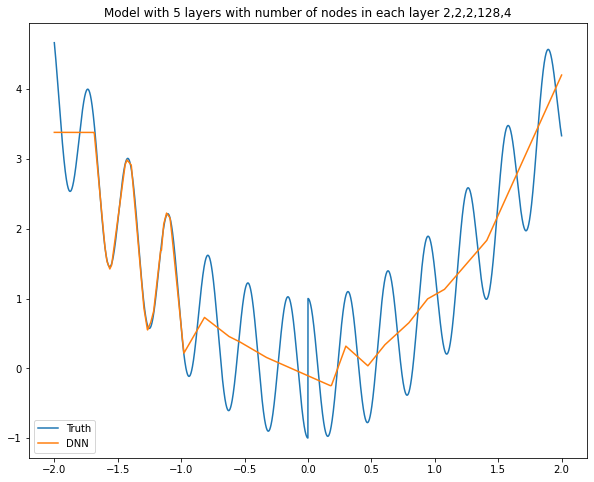

Model: "sequential_76"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_436 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_437 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_438 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_439 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_440 (Dense)            (None, 8)                 1032      
_________________________________________________________________
dense_441 (Dense)            (None, 1)                 9         
Total params: 1,441
Trainable params: 1,441
Non-trainable params: 0
___________________________________________________

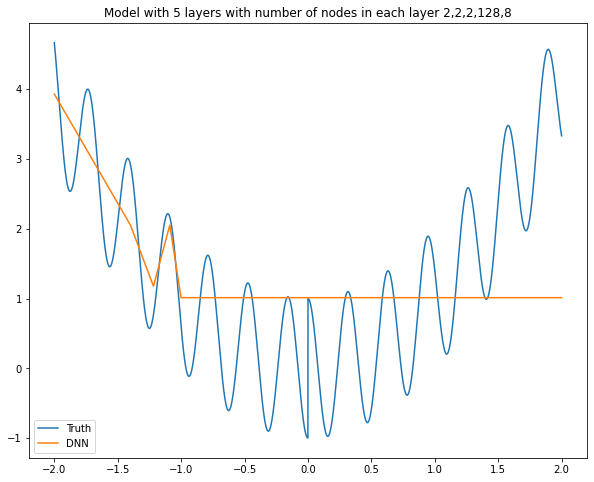

Model: "sequential_77"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_442 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_443 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_444 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_445 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_446 (Dense)            (None, 16)                2064      
_________________________________________________________________
dense_447 (Dense)            (None, 1)                 17        
Total params: 2,481
Trainable params: 2,481
Non-trainable params: 0
___________________________________________________

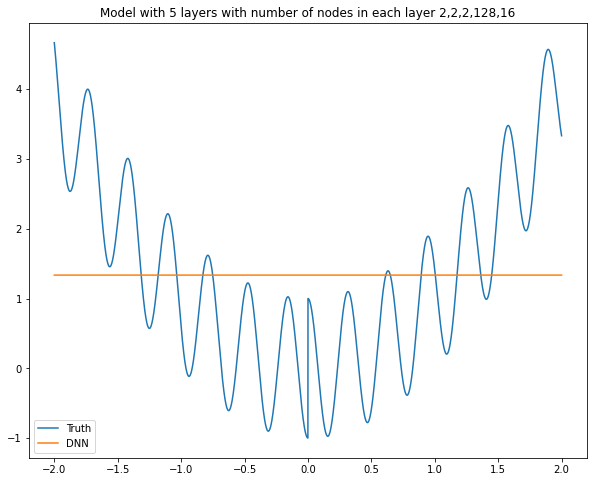

Model: "sequential_78"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_448 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_449 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_450 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_451 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_452 (Dense)            (None, 32)                4128      
_________________________________________________________________
dense_453 (Dense)            (None, 1)                 33        
Total params: 4,561
Trainable params: 4,561
Non-trainable params: 0
___________________________________________________

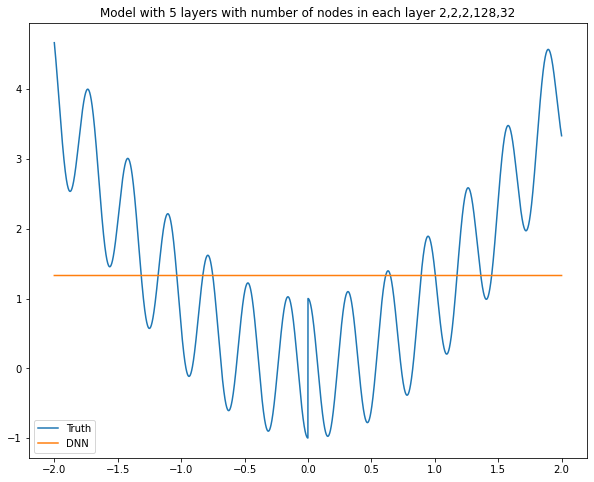

Model: "sequential_79"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_454 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_455 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_456 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_457 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_458 (Dense)            (None, 64)                8256      
_________________________________________________________________
dense_459 (Dense)            (None, 1)                 65        
Total params: 8,721
Trainable params: 8,721
Non-trainable params: 0
___________________________________________________

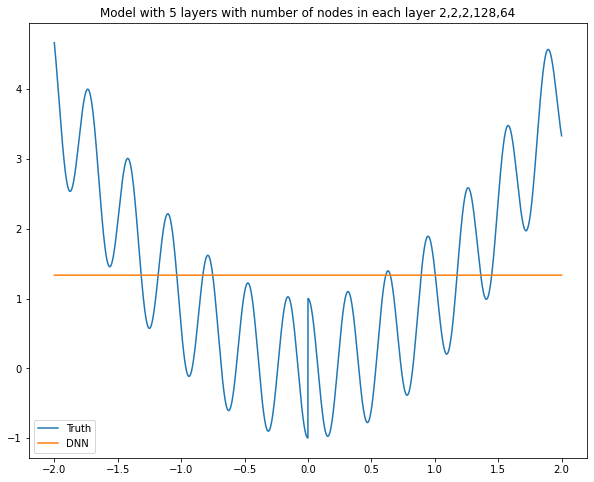

Model: "sequential_80"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_460 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_461 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_462 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_463 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_464 (Dense)            (None, 128)               16512     
_________________________________________________________________
dense_465 (Dense)            (None, 1)                 129       
Total params: 17,041
Trainable params: 17,041
Non-trainable params: 0
_________________________________________________

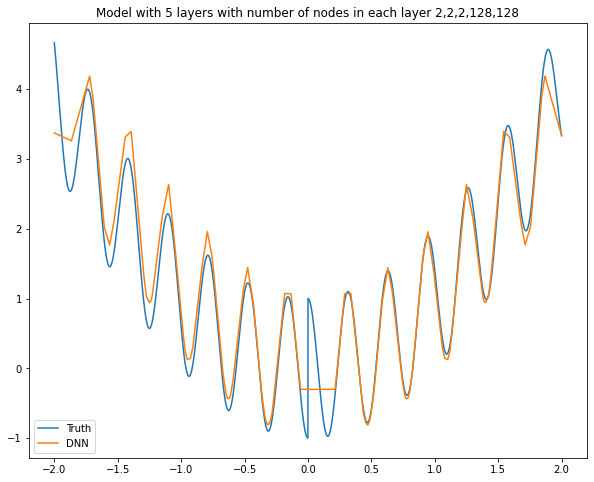

Model: "sequential_81"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_466 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_467 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_468 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_469 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_470 (Dense)            (None, 256)               33024     
_________________________________________________________________
dense_471 (Dense)            (None, 1)                 257       
Total params: 33,681
Trainable params: 33,681
Non-trainable params: 0
_________________________________________________

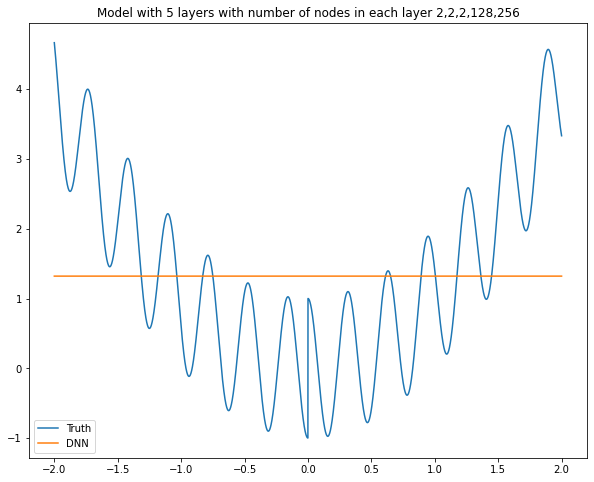

Model: "sequential_82"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_472 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_473 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_474 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_475 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_476 (Dense)            (None, 512)               66048     
_________________________________________________________________
dense_477 (Dense)            (None, 1)                 513       
Total params: 66,961
Trainable params: 66,961
Non-trainable params: 0
_________________________________________________

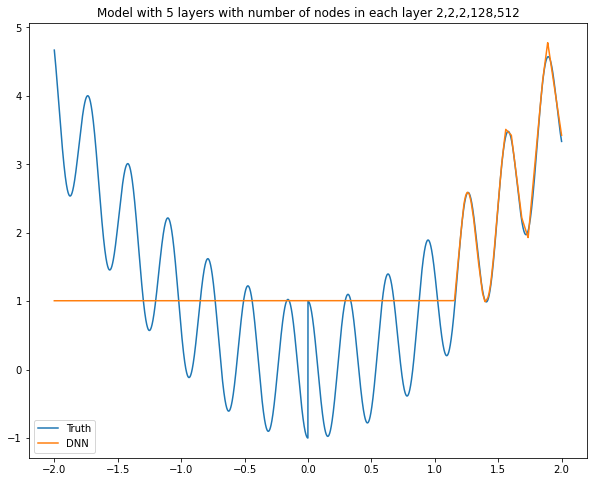

Model: "sequential_83"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_478 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_479 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_480 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_481 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_482 (Dense)            (None, 1024)              132096    
_________________________________________________________________
dense_483 (Dense)            (None, 1)                 1025      
Total params: 133,521
Trainable params: 133,521
Non-trainable params: 0
_______________________________________________

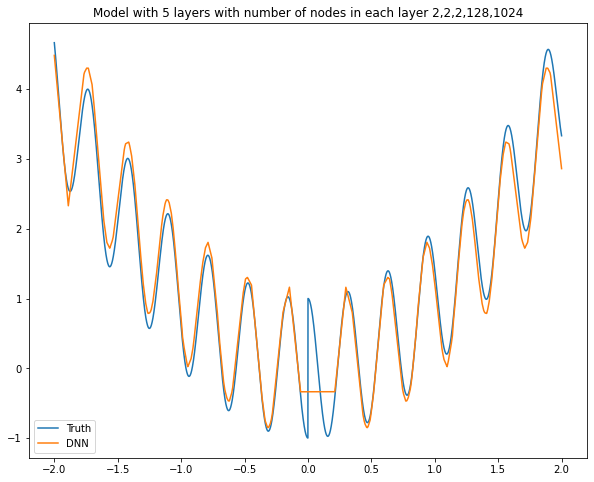

Model: "sequential_84"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_484 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_485 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_486 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_487 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_488 (Dense)            (None, 2048)              264192    
_________________________________________________________________
dense_489 (Dense)            (None, 1)                 2049      
Total params: 266,641
Trainable params: 266,641
Non-trainable params: 0
_______________________________________________

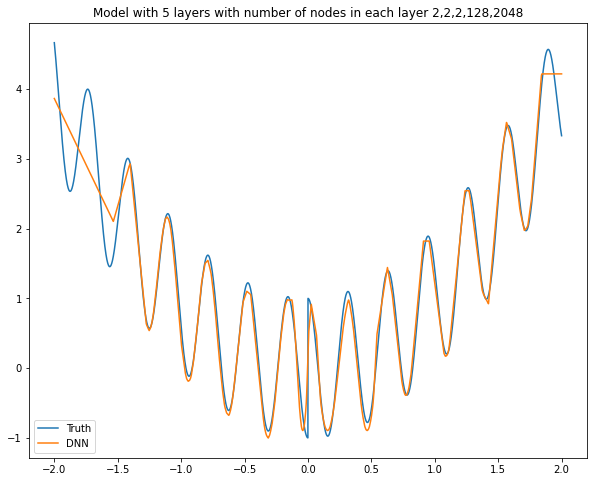

Model: "sequential_85"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_490 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_491 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_492 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_493 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_494 (Dense)            (None, 2)                 514       
_________________________________________________________________
dense_495 (Dense)            (None, 1)                 3         
Total params: 1,301
Trainable params: 1,301
Non-trainable params: 0
___________________________________________________

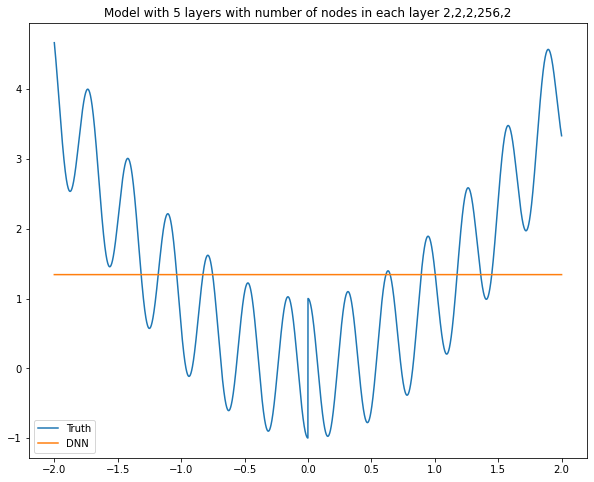

Model: "sequential_86"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_496 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_497 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_498 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_499 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_500 (Dense)            (None, 4)                 1028      
_________________________________________________________________
dense_501 (Dense)            (None, 1)                 5         
Total params: 1,817
Trainable params: 1,817
Non-trainable params: 0
___________________________________________________

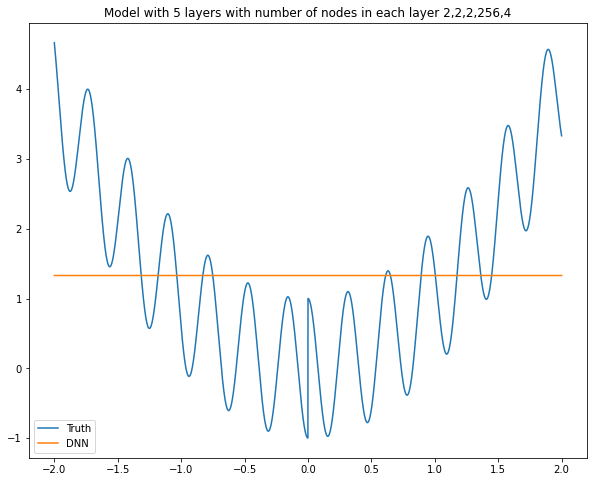

Model: "sequential_87"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_502 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_503 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_504 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_505 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_506 (Dense)            (None, 8)                 2056      
_________________________________________________________________
dense_507 (Dense)            (None, 1)                 9         
Total params: 2,849
Trainable params: 2,849
Non-trainable params: 0
___________________________________________________

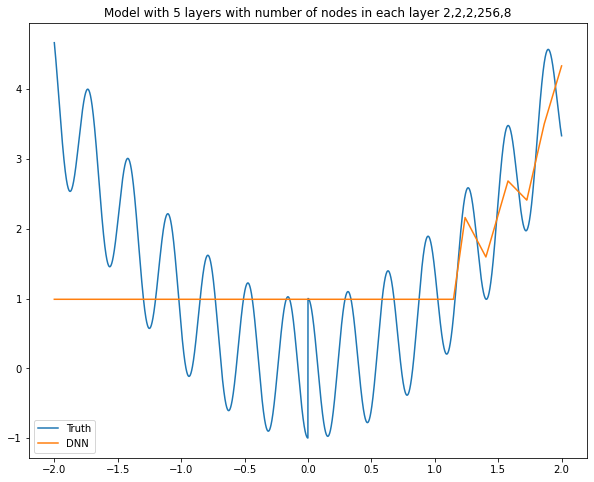

Model: "sequential_88"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_508 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_509 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_510 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_511 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_512 (Dense)            (None, 16)                4112      
_________________________________________________________________
dense_513 (Dense)            (None, 1)                 17        
Total params: 4,913
Trainable params: 4,913
Non-trainable params: 0
___________________________________________________

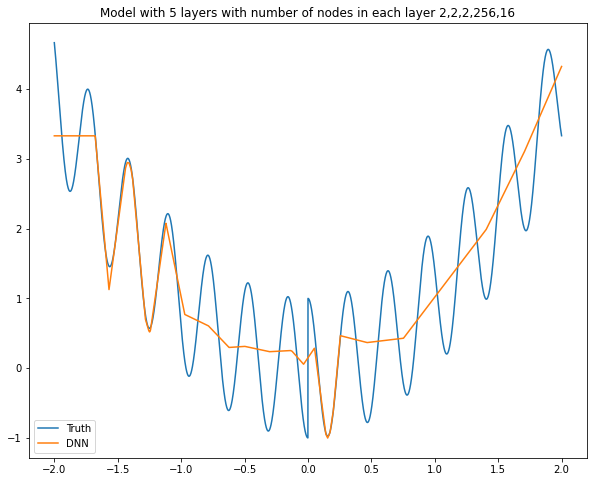

Model: "sequential_89"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_514 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_515 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_516 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_517 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_518 (Dense)            (None, 32)                8224      
_________________________________________________________________
dense_519 (Dense)            (None, 1)                 33        
Total params: 9,041
Trainable params: 9,041
Non-trainable params: 0
___________________________________________________

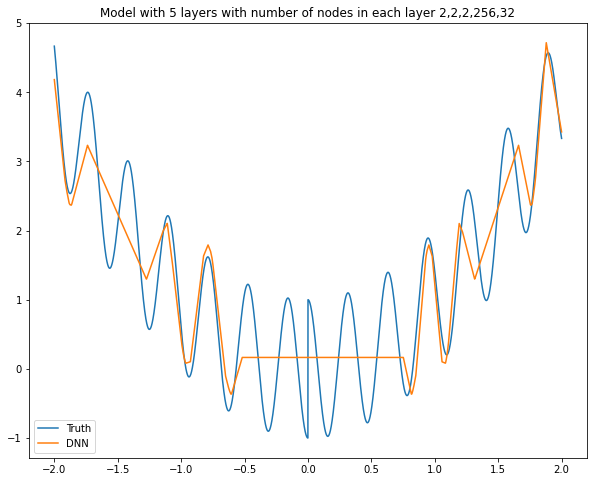

Model: "sequential_90"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_520 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_521 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_522 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_523 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_524 (Dense)            (None, 64)                16448     
_________________________________________________________________
dense_525 (Dense)            (None, 1)                 65        
Total params: 17,297
Trainable params: 17,297
Non-trainable params: 0
_________________________________________________

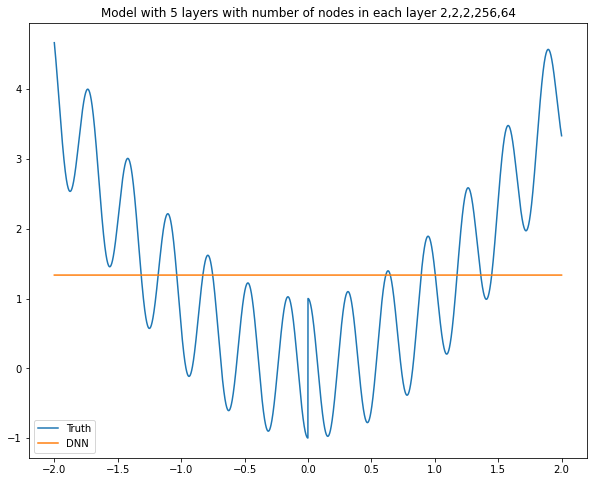

Model: "sequential_91"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_526 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_527 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_528 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_529 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_530 (Dense)            (None, 128)               32896     
_________________________________________________________________
dense_531 (Dense)            (None, 1)                 129       
Total params: 33,809
Trainable params: 33,809
Non-trainable params: 0
_________________________________________________

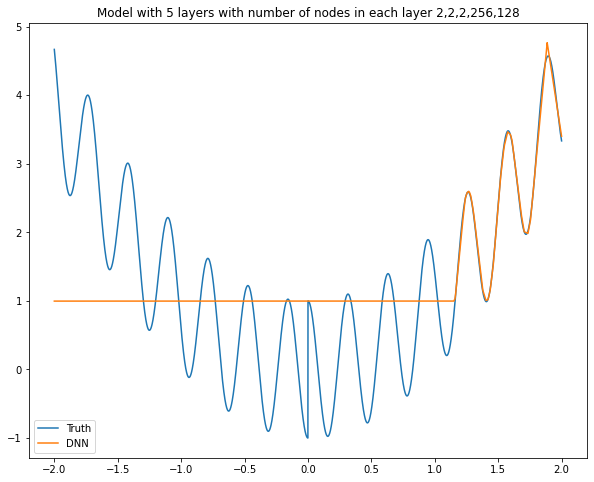

Model: "sequential_92"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_532 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_533 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_534 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_535 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_536 (Dense)            (None, 256)               65792     
_________________________________________________________________
dense_537 (Dense)            (None, 1)                 257       
Total params: 66,833
Trainable params: 66,833
Non-trainable params: 0
_________________________________________________

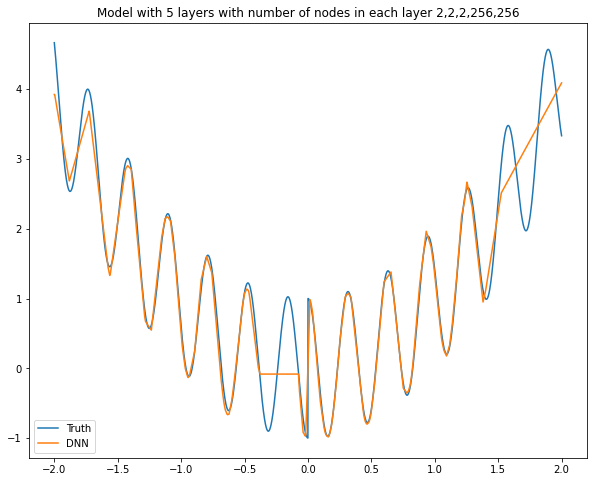

Model: "sequential_93"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_538 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_539 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_540 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_541 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_542 (Dense)            (None, 512)               131584    
_________________________________________________________________
dense_543 (Dense)            (None, 1)                 513       
Total params: 132,881
Trainable params: 132,881
Non-trainable params: 0
_______________________________________________

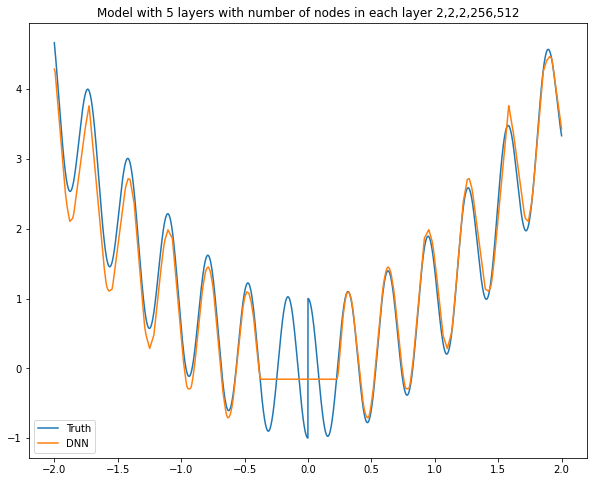

Model: "sequential_94"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_544 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_545 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_546 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_547 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_548 (Dense)            (None, 1024)              263168    
_________________________________________________________________
dense_549 (Dense)            (None, 1)                 1025      
Total params: 264,977
Trainable params: 264,977
Non-trainable params: 0
_______________________________________________

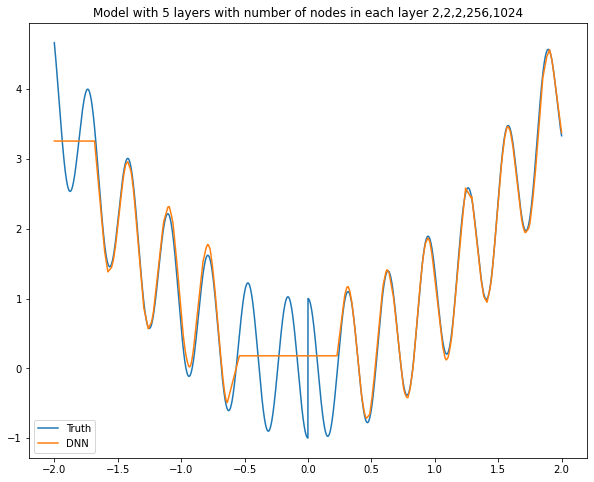

Model: "sequential_95"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_550 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_551 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_552 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_553 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_554 (Dense)            (None, 2048)              526336    
_________________________________________________________________
dense_555 (Dense)            (None, 1)                 2049      
Total params: 529,169
Trainable params: 529,169
Non-trainable params: 0
_______________________________________________

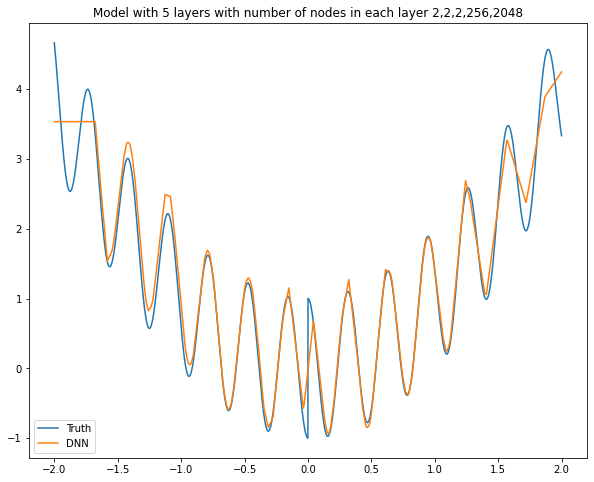

Model: "sequential_96"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_556 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_557 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_558 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_559 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_560 (Dense)            (None, 2)                 1026      
_________________________________________________________________
dense_561 (Dense)            (None, 1)                 3         
Total params: 2,581
Trainable params: 2,581
Non-trainable params: 0
___________________________________________________

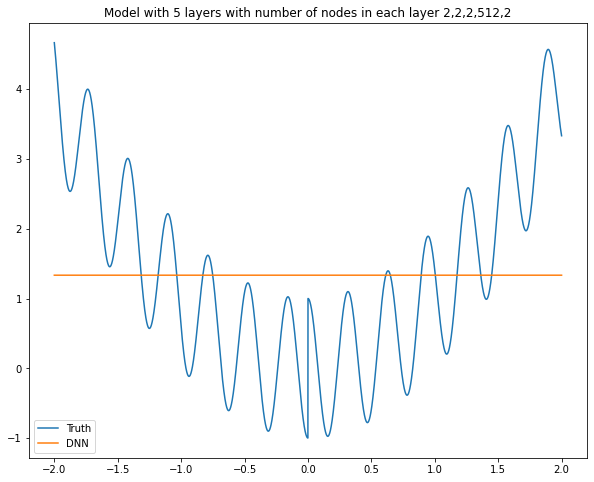

Model: "sequential_97"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_562 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_563 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_564 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_565 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_566 (Dense)            (None, 4)                 2052      
_________________________________________________________________
dense_567 (Dense)            (None, 1)                 5         
Total params: 3,609
Trainable params: 3,609
Non-trainable params: 0
___________________________________________________

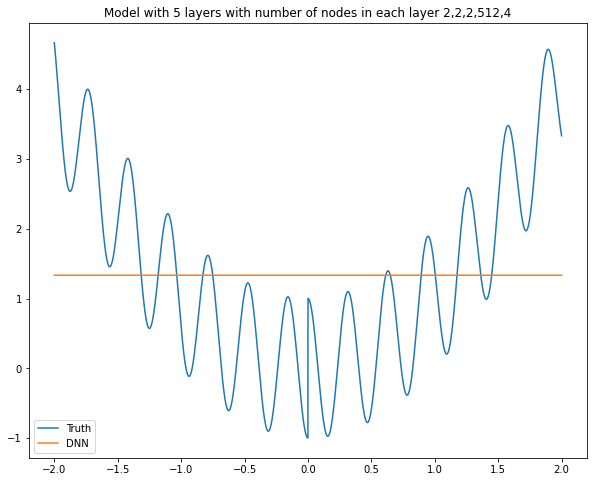

Model: "sequential_98"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_568 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_569 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_570 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_571 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_572 (Dense)            (None, 8)                 4104      
_________________________________________________________________
dense_573 (Dense)            (None, 1)                 9         
Total params: 5,665
Trainable params: 5,665
Non-trainable params: 0
___________________________________________________

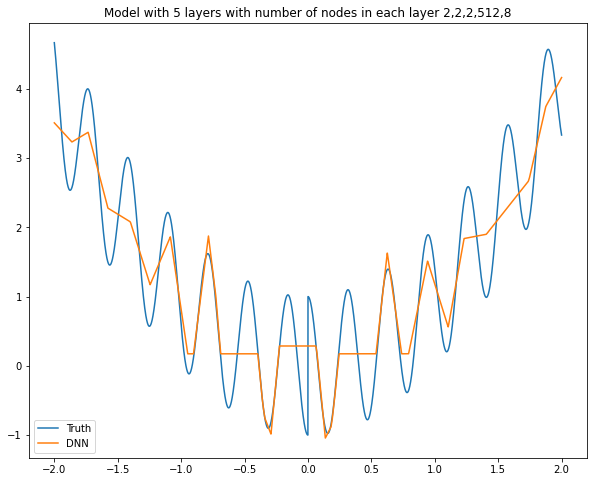

Model: "sequential_99"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_574 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_575 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_576 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_577 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_578 (Dense)            (None, 16)                8208      
_________________________________________________________________
dense_579 (Dense)            (None, 1)                 17        
Total params: 9,777
Trainable params: 9,777
Non-trainable params: 0
___________________________________________________

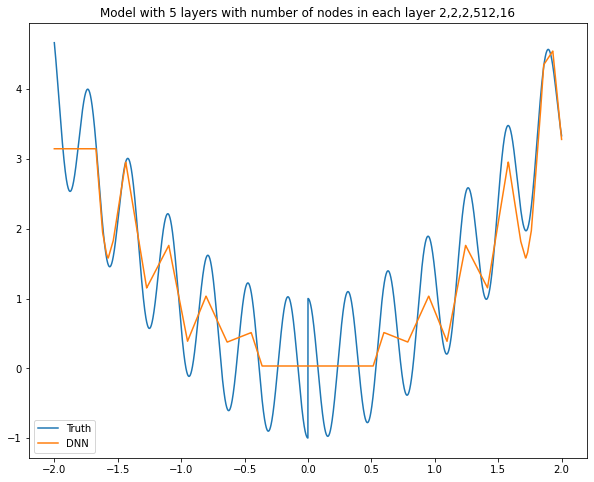

Model: "sequential_100"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_580 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_581 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_582 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_583 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_584 (Dense)            (None, 32)                16416     
_________________________________________________________________
dense_585 (Dense)            (None, 1)                 33        
Total params: 18,001
Trainable params: 18,001
Non-trainable params: 0
________________________________________________

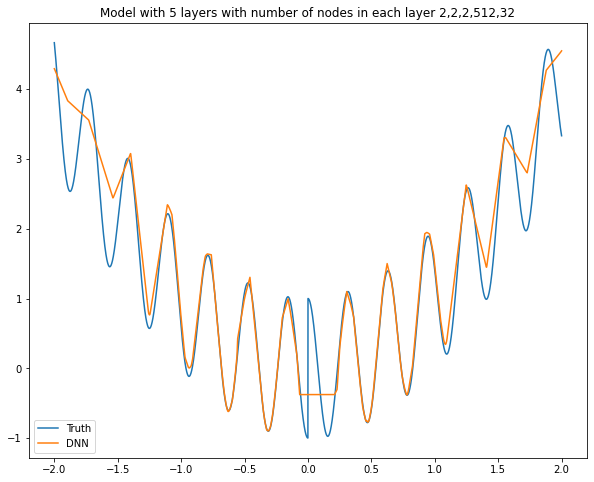

Model: "sequential_101"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_586 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_587 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_588 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_589 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_590 (Dense)            (None, 64)                32832     
_________________________________________________________________
dense_591 (Dense)            (None, 1)                 65        
Total params: 34,449
Trainable params: 34,449
Non-trainable params: 0
________________________________________________

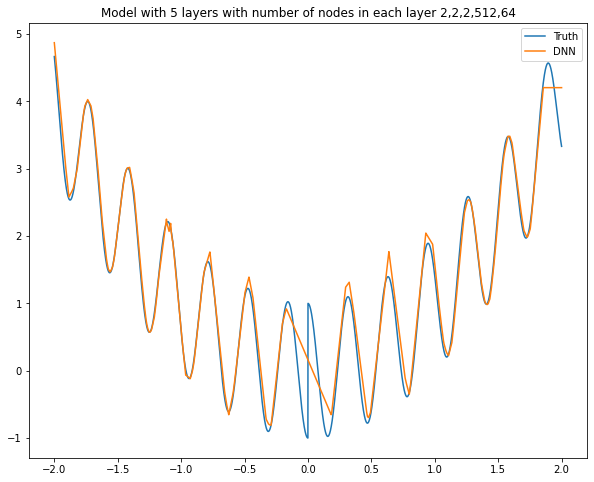

Model: "sequential_102"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_592 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_593 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_594 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_595 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_596 (Dense)            (None, 128)               65664     
_________________________________________________________________
dense_597 (Dense)            (None, 1)                 129       
Total params: 67,345
Trainable params: 67,345
Non-trainable params: 0
________________________________________________

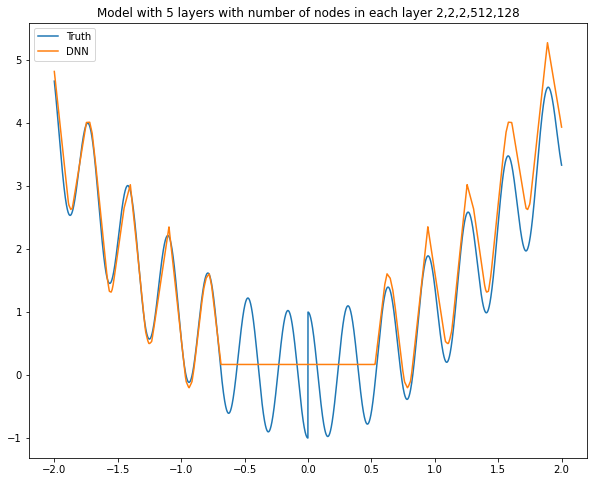

Model: "sequential_103"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_598 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_599 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_600 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_601 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_602 (Dense)            (None, 256)               131328    
_________________________________________________________________
dense_603 (Dense)            (None, 1)                 257       
Total params: 133,137
Trainable params: 133,137
Non-trainable params: 0
______________________________________________

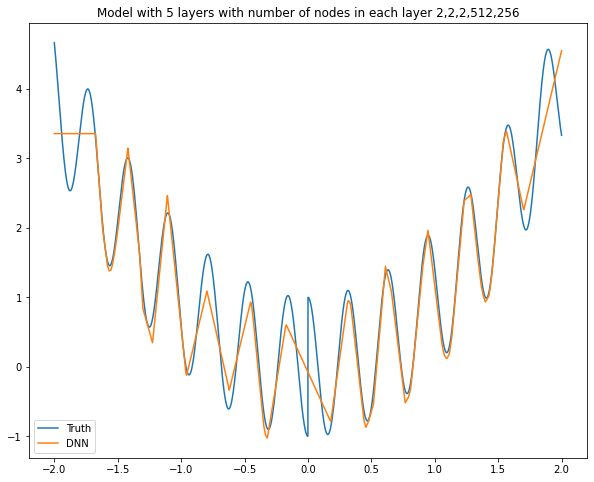

Model: "sequential_104"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_604 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_605 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_606 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_607 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_608 (Dense)            (None, 512)               262656    
_________________________________________________________________
dense_609 (Dense)            (None, 1)                 513       
Total params: 264,721
Trainable params: 264,721
Non-trainable params: 0
______________________________________________

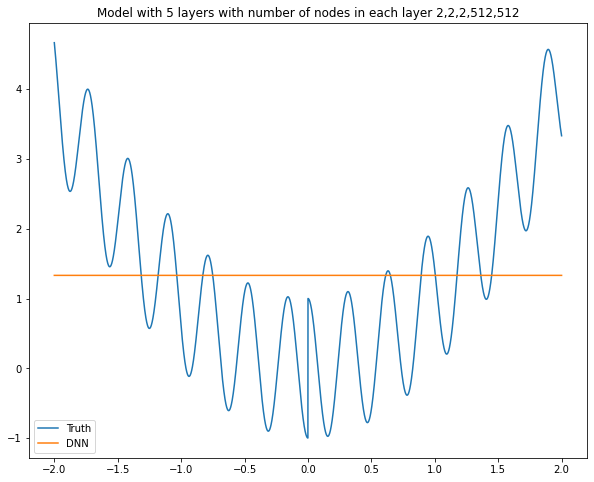

Model: "sequential_105"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_610 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_611 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_612 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_613 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_614 (Dense)            (None, 1024)              525312    
_________________________________________________________________
dense_615 (Dense)            (None, 1)                 1025      
Total params: 527,889
Trainable params: 527,889
Non-trainable params: 0
______________________________________________

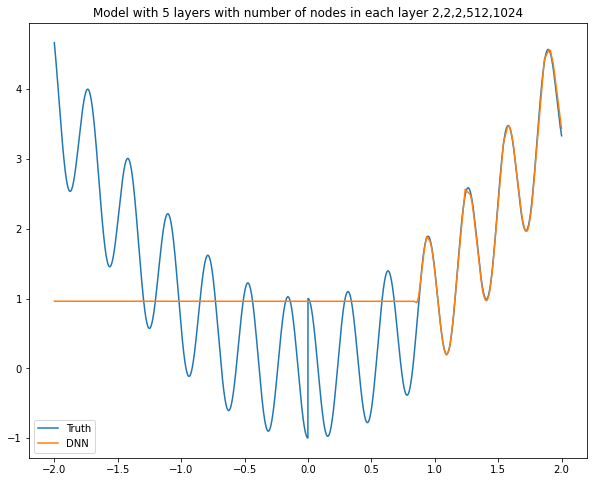

Model: "sequential_106"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_616 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_617 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_618 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_619 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_620 (Dense)            (None, 2048)              1050624   
_________________________________________________________________
dense_621 (Dense)            (None, 1)                 2049      
Total params: 1,054,225
Trainable params: 1,054,225
Non-trainable params: 0
__________________________________________

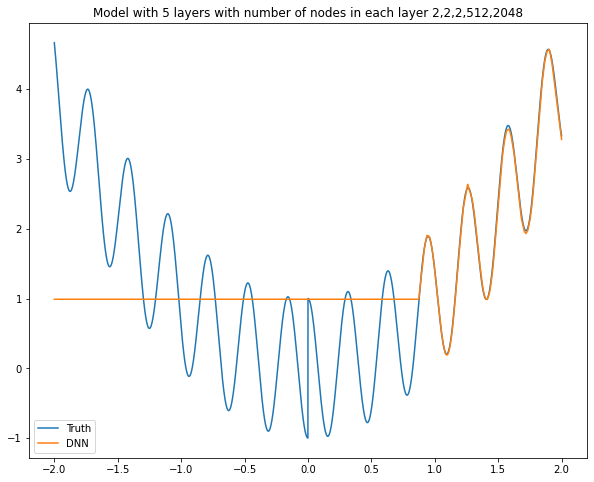

Model: "sequential_107"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_622 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_623 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_624 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_625 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_626 (Dense)            (None, 2)                 2050      
_________________________________________________________________
dense_627 (Dense)            (None, 1)                 3         
Total params: 5,141
Trainable params: 5,141
Non-trainable params: 0
__________________________________________________

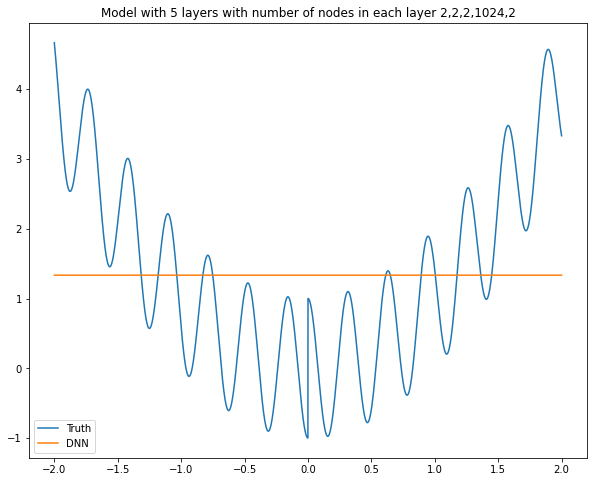

Model: "sequential_108"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_628 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_629 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_630 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_631 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_632 (Dense)            (None, 4)                 4100      
_________________________________________________________________
dense_633 (Dense)            (None, 1)                 5         
Total params: 7,193
Trainable params: 7,193
Non-trainable params: 0
__________________________________________________

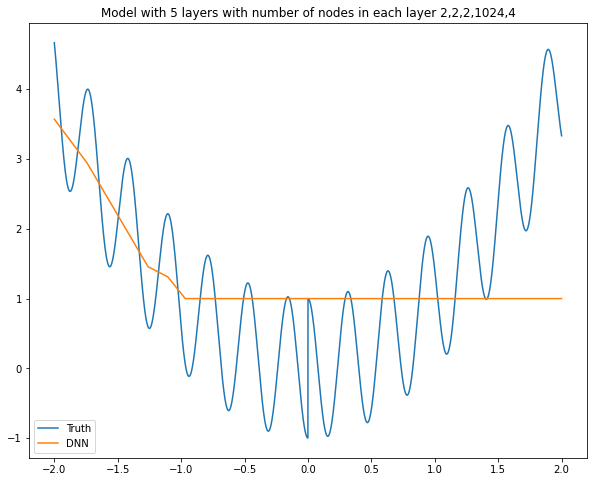

Model: "sequential_109"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_634 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_635 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_636 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_637 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_638 (Dense)            (None, 8)                 8200      
_________________________________________________________________
dense_639 (Dense)            (None, 1)                 9         
Total params: 11,297
Trainable params: 11,297
Non-trainable params: 0
________________________________________________

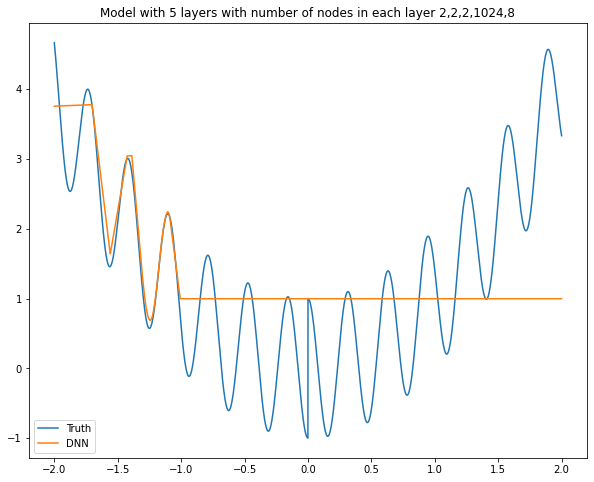

Model: "sequential_110"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_640 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_641 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_642 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_643 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_644 (Dense)            (None, 16)                16400     
_________________________________________________________________
dense_645 (Dense)            (None, 1)                 17        
Total params: 19,505
Trainable params: 19,505
Non-trainable params: 0
________________________________________________

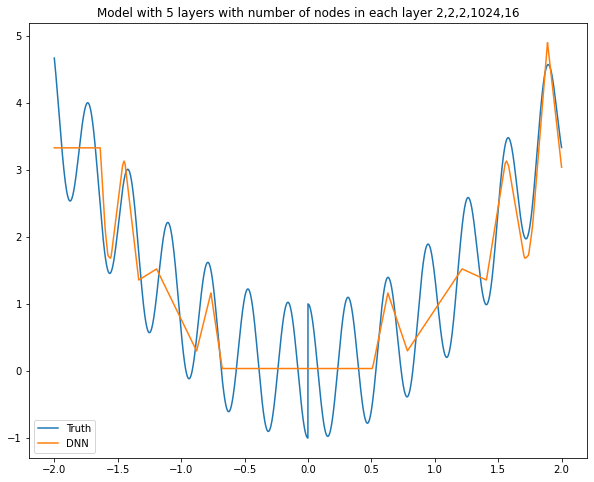

Model: "sequential_111"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_646 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_647 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_648 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_649 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_650 (Dense)            (None, 32)                32800     
_________________________________________________________________
dense_651 (Dense)            (None, 1)                 33        
Total params: 35,921
Trainable params: 35,921
Non-trainable params: 0
________________________________________________

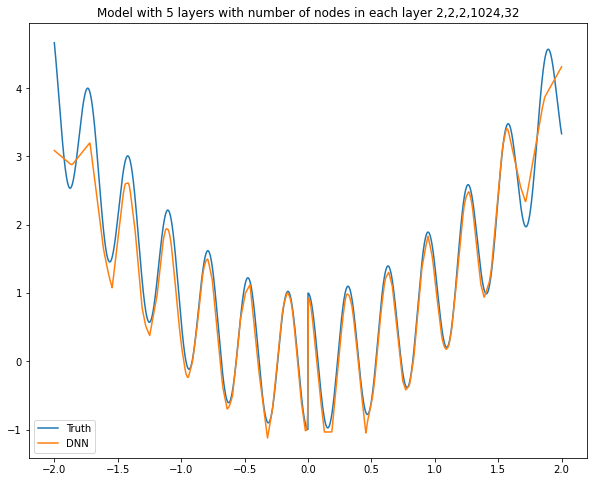

Model: "sequential_112"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_652 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_653 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_654 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_655 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_656 (Dense)            (None, 64)                65600     
_________________________________________________________________
dense_657 (Dense)            (None, 1)                 65        
Total params: 68,753
Trainable params: 68,753
Non-trainable params: 0
________________________________________________

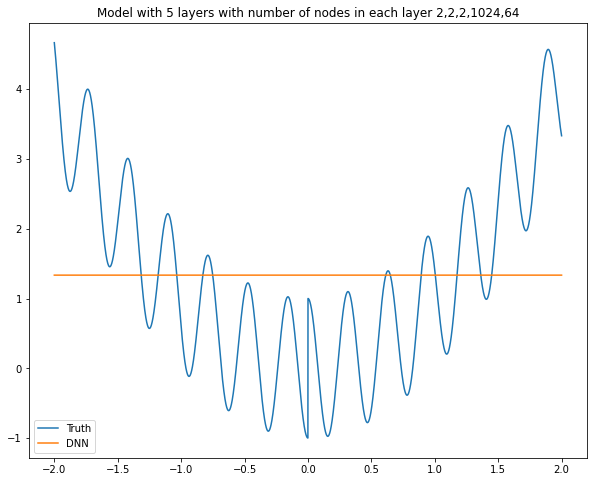

Model: "sequential_113"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_658 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_659 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_660 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_661 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_662 (Dense)            (None, 128)               131200    
_________________________________________________________________
dense_663 (Dense)            (None, 1)                 129       
Total params: 134,417
Trainable params: 134,417
Non-trainable params: 0
______________________________________________

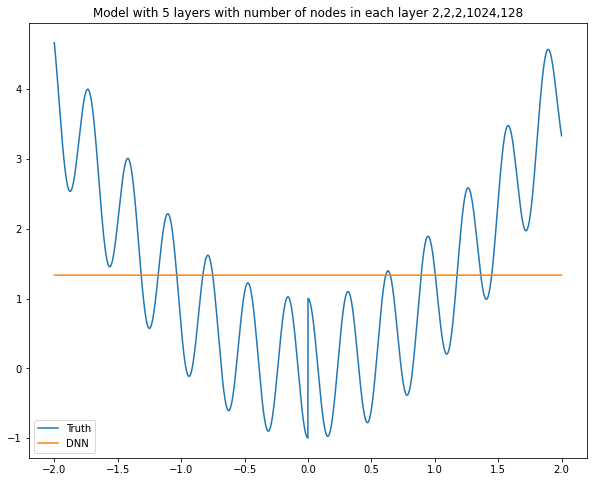

Model: "sequential_114"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_664 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_665 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_666 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_667 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_668 (Dense)            (None, 256)               262400    
_________________________________________________________________
dense_669 (Dense)            (None, 1)                 257       
Total params: 265,745
Trainable params: 265,745
Non-trainable params: 0
______________________________________________

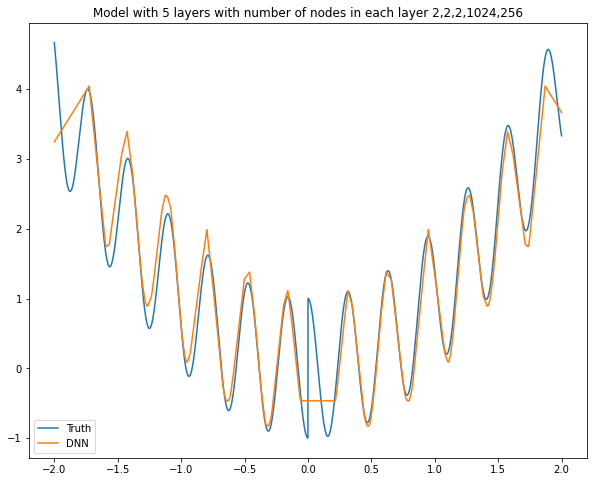

Model: "sequential_115"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_670 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_671 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_672 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_673 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_674 (Dense)            (None, 512)               524800    
_________________________________________________________________
dense_675 (Dense)            (None, 1)                 513       
Total params: 528,401
Trainable params: 528,401
Non-trainable params: 0
______________________________________________

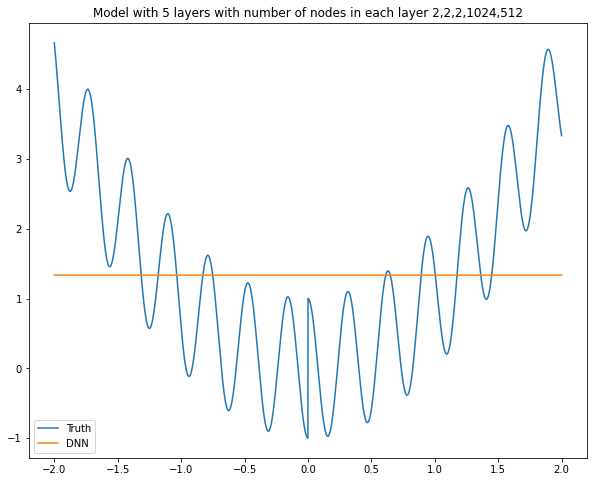

Model: "sequential_116"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_676 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_677 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_678 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_679 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_680 (Dense)            (None, 1024)              1049600   
_________________________________________________________________
dense_681 (Dense)            (None, 1)                 1025      
Total params: 1,053,713
Trainable params: 1,053,713
Non-trainable params: 0
__________________________________________

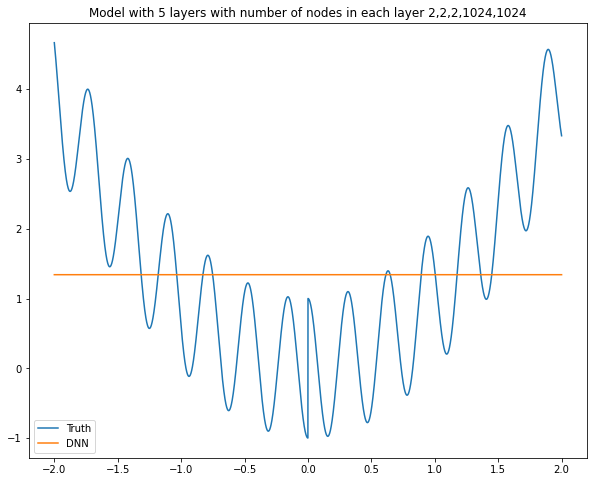

Model: "sequential_117"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_682 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_683 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_684 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_685 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_686 (Dense)            (None, 2048)              2099200   
_________________________________________________________________
dense_687 (Dense)            (None, 1)                 2049      
Total params: 2,104,337
Trainable params: 2,104,337
Non-trainable params: 0
__________________________________________

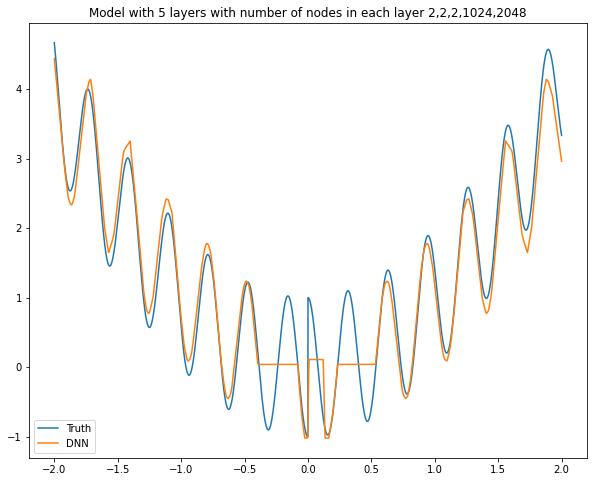

Model: "sequential_118"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_688 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_689 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_690 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_691 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_692 (Dense)            (None, 2)                 4098      
_________________________________________________________________
dense_693 (Dense)            (None, 1)                 3         
Total params: 10,261
Trainable params: 10,261
Non-trainable params: 0
________________________________________________

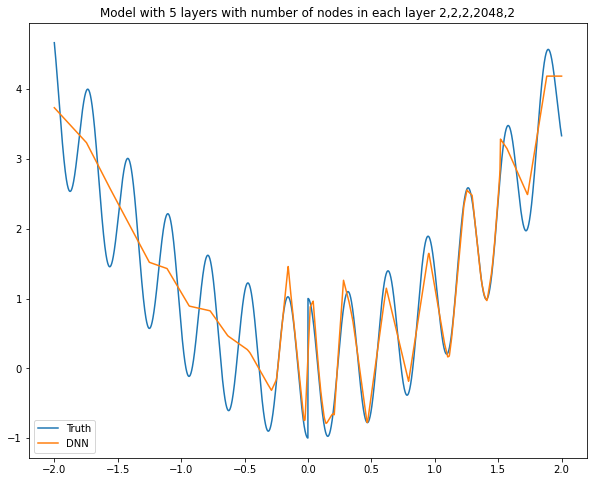

Model: "sequential_119"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_694 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_695 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_696 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_697 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_698 (Dense)            (None, 4)                 8196      
_________________________________________________________________
dense_699 (Dense)            (None, 1)                 5         
Total params: 14,361
Trainable params: 14,361
Non-trainable params: 0
________________________________________________

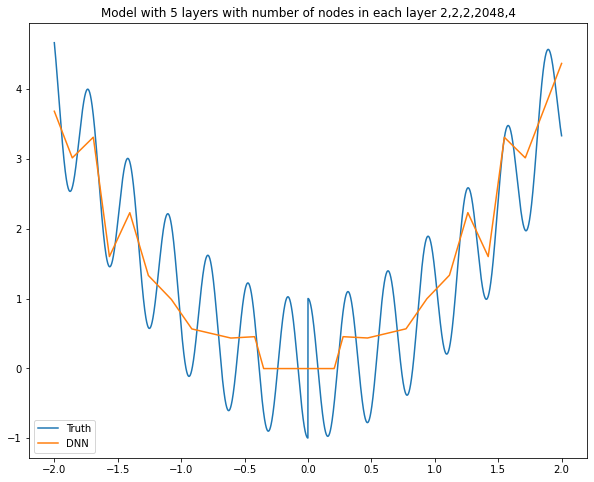

Model: "sequential_120"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_700 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_701 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_702 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_703 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_704 (Dense)            (None, 8)                 16392     
_________________________________________________________________
dense_705 (Dense)            (None, 1)                 9         
Total params: 22,561
Trainable params: 22,561
Non-trainable params: 0
________________________________________________

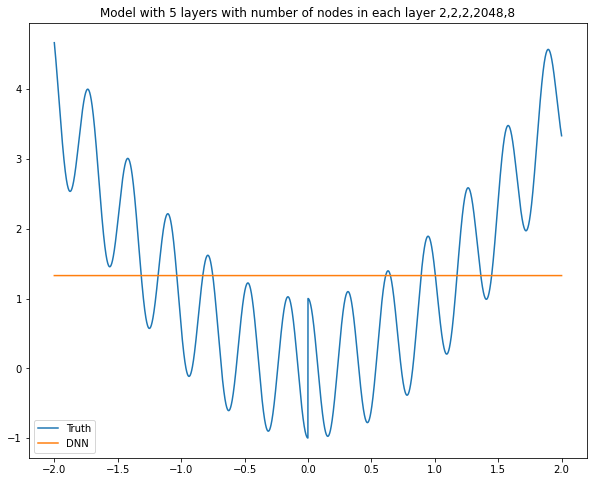

Model: "sequential_121"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_706 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_707 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_708 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_709 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_710 (Dense)            (None, 16)                32784     
_________________________________________________________________
dense_711 (Dense)            (None, 1)                 17        
Total params: 38,961
Trainable params: 38,961
Non-trainable params: 0
________________________________________________

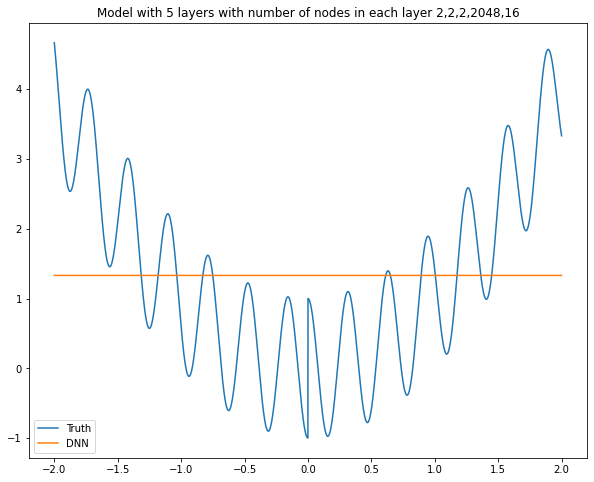

Model: "sequential_122"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_712 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_713 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_714 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_715 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_716 (Dense)            (None, 32)                65568     
_________________________________________________________________
dense_717 (Dense)            (None, 1)                 33        
Total params: 71,761
Trainable params: 71,761
Non-trainable params: 0
________________________________________________

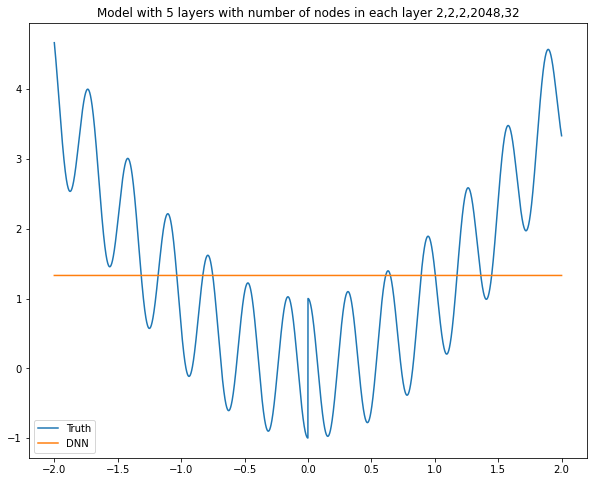

Model: "sequential_123"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_718 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_719 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_720 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_721 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_722 (Dense)            (None, 64)                131136    
_________________________________________________________________
dense_723 (Dense)            (None, 1)                 65        
Total params: 137,361
Trainable params: 137,361
Non-trainable params: 0
______________________________________________

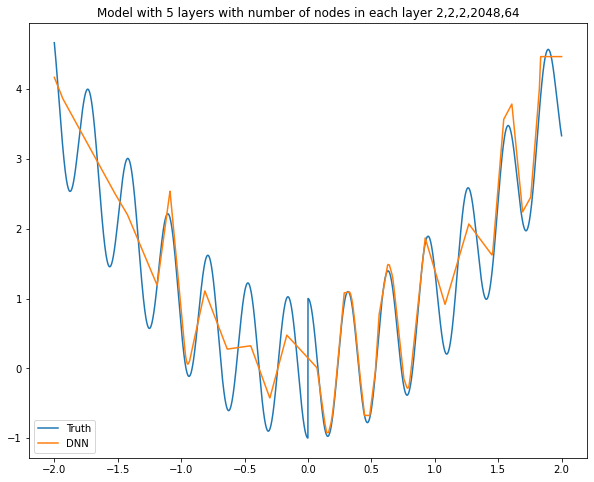

Model: "sequential_124"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_724 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_725 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_726 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_727 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_728 (Dense)            (None, 128)               262272    
_________________________________________________________________
dense_729 (Dense)            (None, 1)                 129       
Total params: 268,561
Trainable params: 268,561
Non-trainable params: 0
______________________________________________

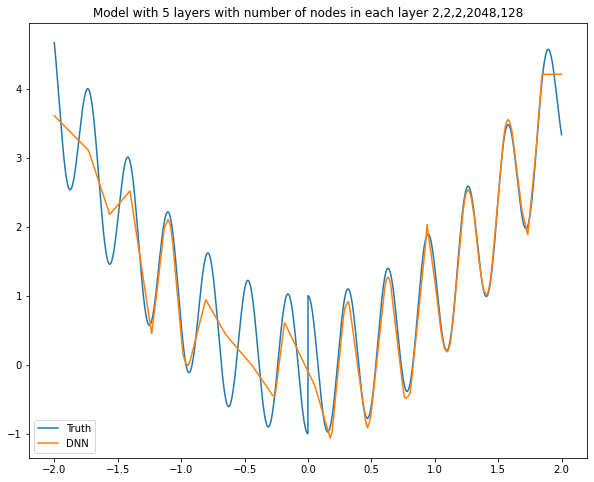

Model: "sequential_125"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_730 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_731 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_732 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_733 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_734 (Dense)            (None, 256)               524544    
_________________________________________________________________
dense_735 (Dense)            (None, 1)                 257       
Total params: 530,961
Trainable params: 530,961
Non-trainable params: 0
______________________________________________

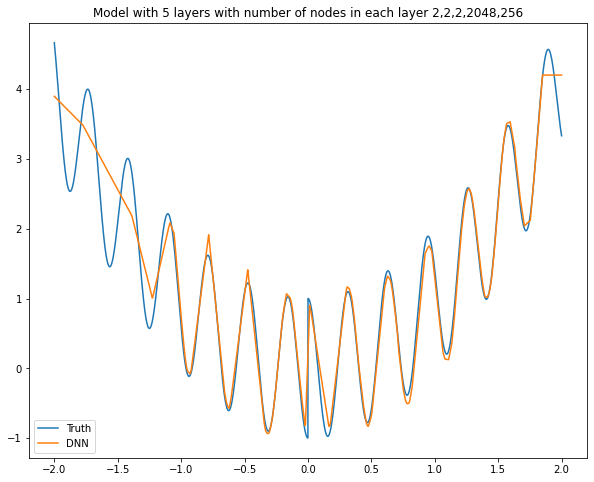

Model: "sequential_126"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_736 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_737 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_738 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_739 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_740 (Dense)            (None, 512)               1049088   
_________________________________________________________________
dense_741 (Dense)            (None, 1)                 513       
Total params: 1,055,761
Trainable params: 1,055,761
Non-trainable params: 0
__________________________________________

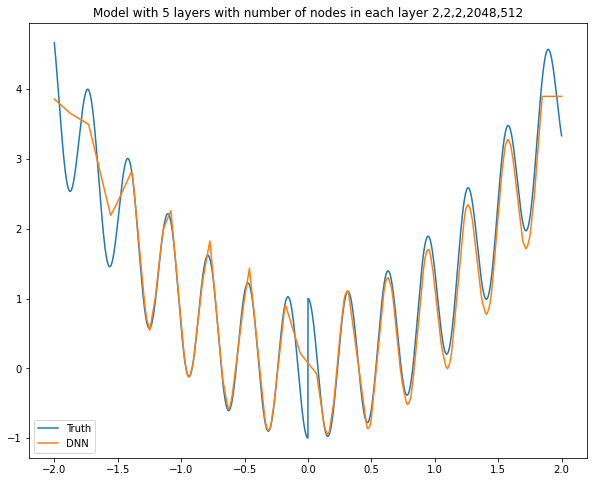

Model: "sequential_127"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_742 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_743 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_744 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_745 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_746 (Dense)            (None, 1024)              2098176   
_________________________________________________________________
dense_747 (Dense)            (None, 1)                 1025      
Total params: 2,105,361
Trainable params: 2,105,361
Non-trainable params: 0
__________________________________________

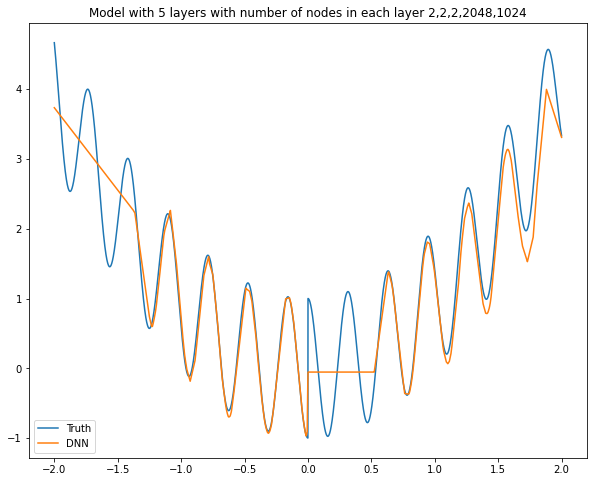

Model: "sequential_128"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_748 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_749 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_750 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_751 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_752 (Dense)            (None, 2048)              4196352   
_________________________________________________________________
dense_753 (Dense)            (None, 1)                 2049      
Total params: 4,204,561
Trainable params: 4,204,561
Non-trainable params: 0
__________________________________________

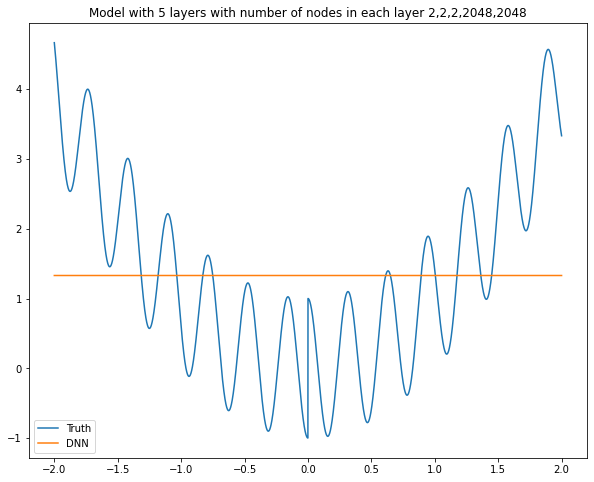

Model: "sequential_129"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_754 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_755 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_756 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_757 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_758 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_759 (Dense)            (None, 1)                 3         
Total params: 41
Trainable params: 41
Non-trainable params: 0
________________________________________________________

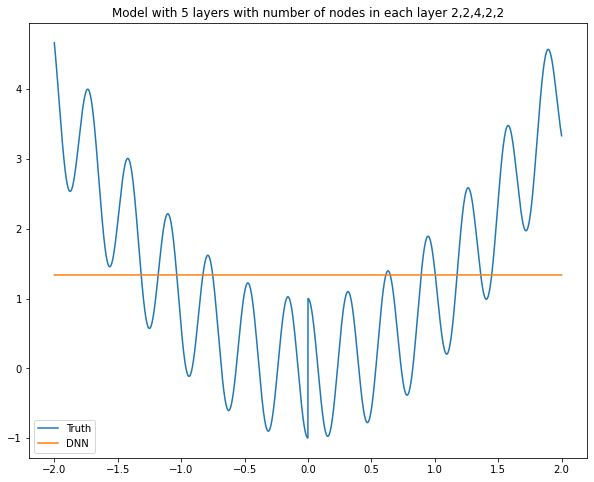

Model: "sequential_130"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_760 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_761 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_762 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_763 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_764 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_765 (Dense)            (None, 1)                 5         
Total params: 49
Trainable params: 49
Non-trainable params: 0
________________________________________________________

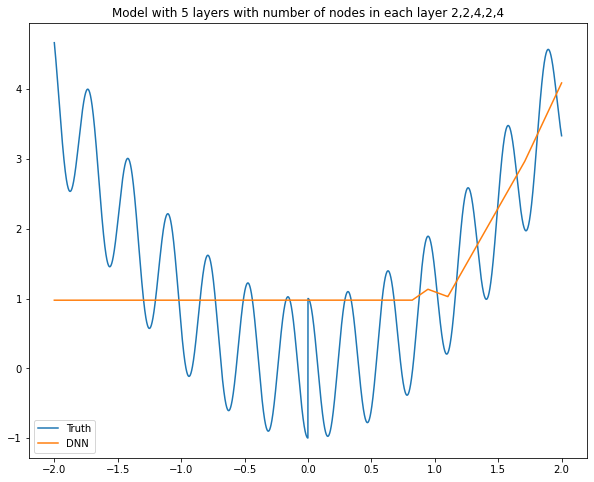

Model: "sequential_131"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_766 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_767 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_768 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_769 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_770 (Dense)            (None, 8)                 24        
_________________________________________________________________
dense_771 (Dense)            (None, 1)                 9         
Total params: 65
Trainable params: 65
Non-trainable params: 0
________________________________________________________

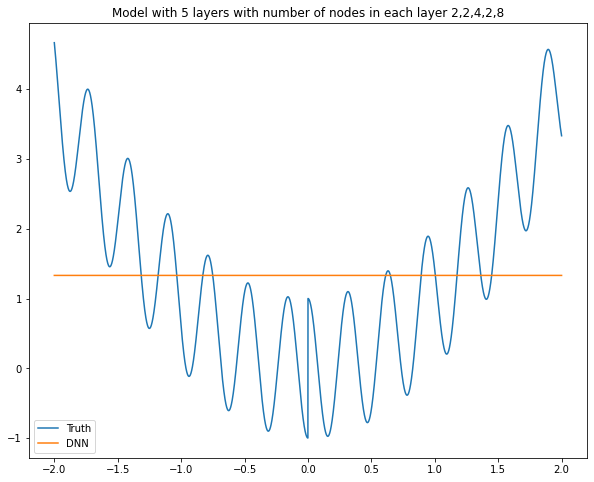

Model: "sequential_132"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_772 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_773 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_774 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_775 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_776 (Dense)            (None, 16)                48        
_________________________________________________________________
dense_777 (Dense)            (None, 1)                 17        
Total params: 97
Trainable params: 97
Non-trainable params: 0
________________________________________________________

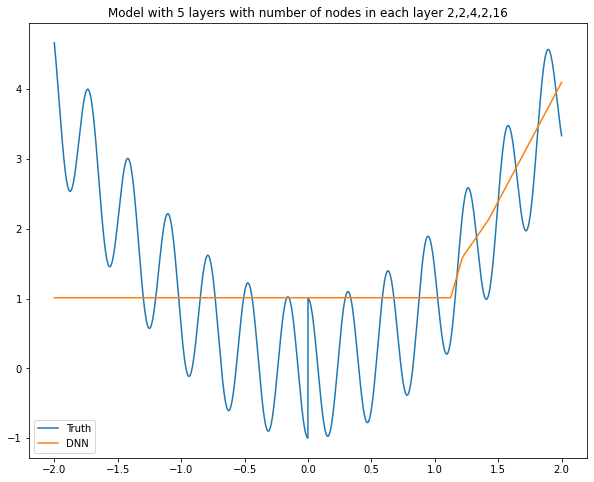

Model: "sequential_133"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_778 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_779 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_780 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_781 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_782 (Dense)            (None, 32)                96        
_________________________________________________________________
dense_783 (Dense)            (None, 1)                 33        
Total params: 161
Trainable params: 161
Non-trainable params: 0
______________________________________________________

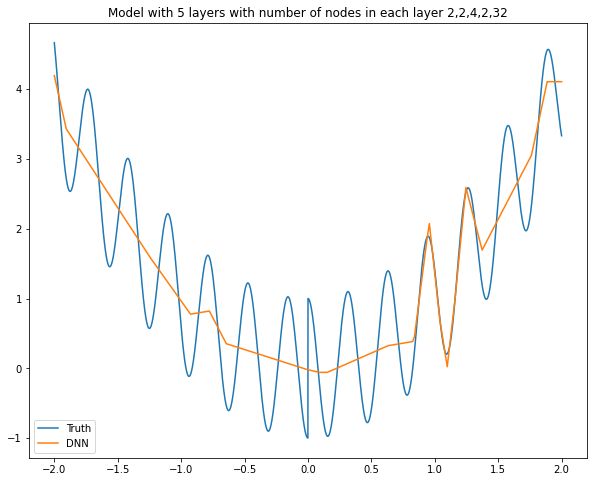

Model: "sequential_134"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_784 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_785 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_786 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_787 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_788 (Dense)            (None, 64)                192       
_________________________________________________________________
dense_789 (Dense)            (None, 1)                 65        
Total params: 289
Trainable params: 289
Non-trainable params: 0
______________________________________________________

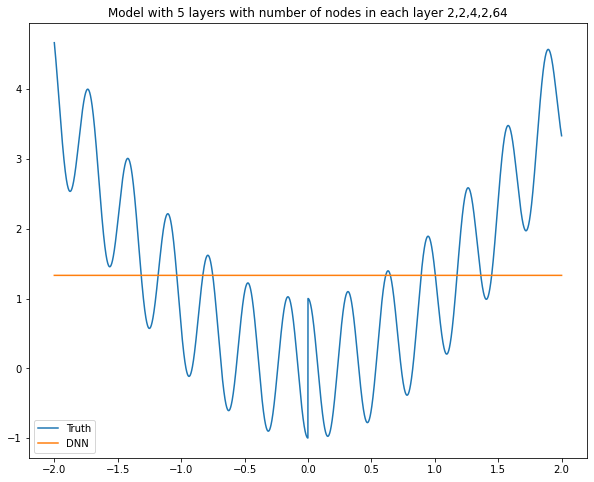

Model: "sequential_135"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_790 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_791 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_792 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_793 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_794 (Dense)            (None, 128)               384       
_________________________________________________________________
dense_795 (Dense)            (None, 1)                 129       
Total params: 545
Trainable params: 545
Non-trainable params: 0
______________________________________________________

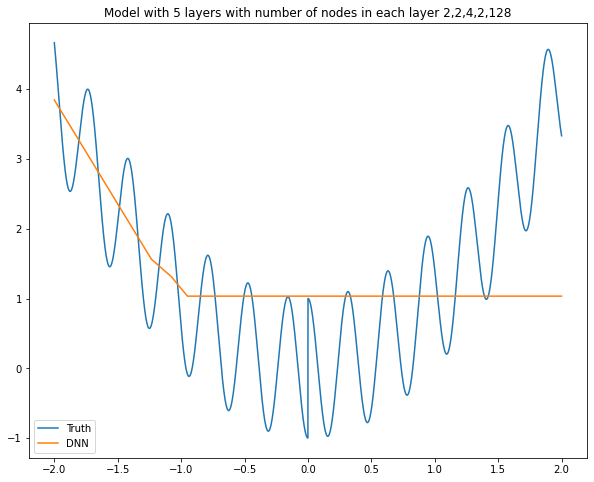

Model: "sequential_136"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_796 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_797 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_798 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_799 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_800 (Dense)            (None, 256)               768       
_________________________________________________________________
dense_801 (Dense)            (None, 1)                 257       
Total params: 1,057
Trainable params: 1,057
Non-trainable params: 0
__________________________________________________

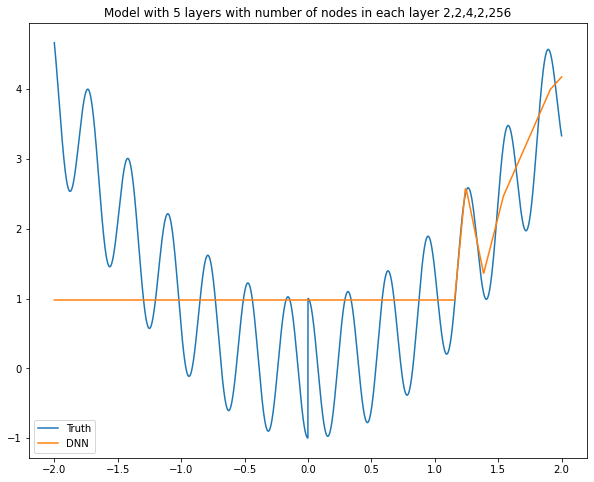

Model: "sequential_137"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_802 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_803 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_804 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_805 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_806 (Dense)            (None, 512)               1536      
_________________________________________________________________
dense_807 (Dense)            (None, 1)                 513       
Total params: 2,081
Trainable params: 2,081
Non-trainable params: 0
__________________________________________________

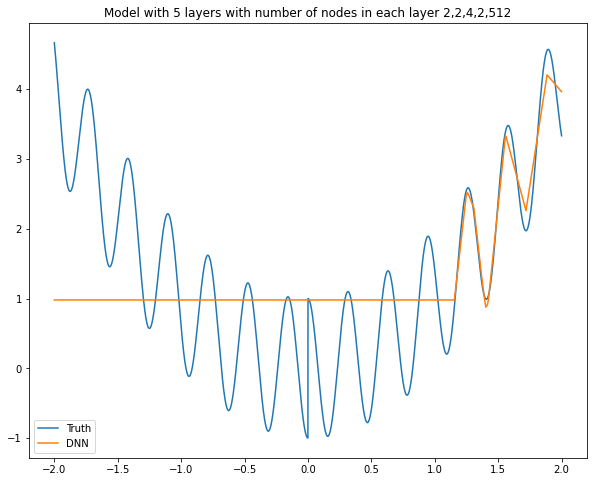

Model: "sequential_138"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_808 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_809 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_810 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_811 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_812 (Dense)            (None, 1024)              3072      
_________________________________________________________________
dense_813 (Dense)            (None, 1)                 1025      
Total params: 4,129
Trainable params: 4,129
Non-trainable params: 0
__________________________________________________

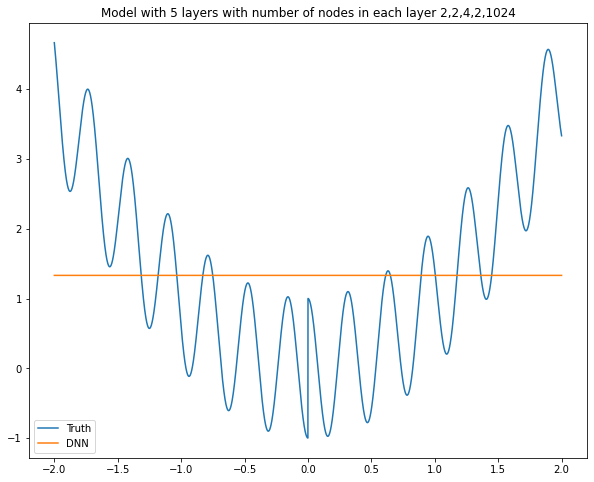

Model: "sequential_139"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_814 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_815 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_816 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_817 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_818 (Dense)            (None, 2048)              6144      
_________________________________________________________________
dense_819 (Dense)            (None, 1)                 2049      
Total params: 8,225
Trainable params: 8,225
Non-trainable params: 0
__________________________________________________

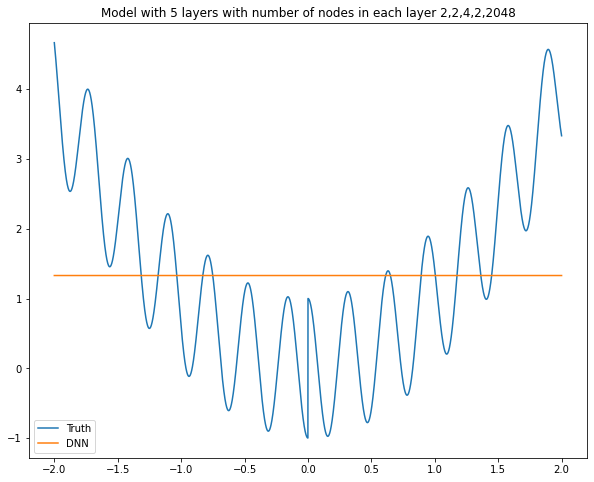

Model: "sequential_140"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_820 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_821 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_822 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_823 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_824 (Dense)            (None, 2)                 10        
_________________________________________________________________
dense_825 (Dense)            (None, 1)                 3         
Total params: 55
Trainable params: 55
Non-trainable params: 0
________________________________________________________

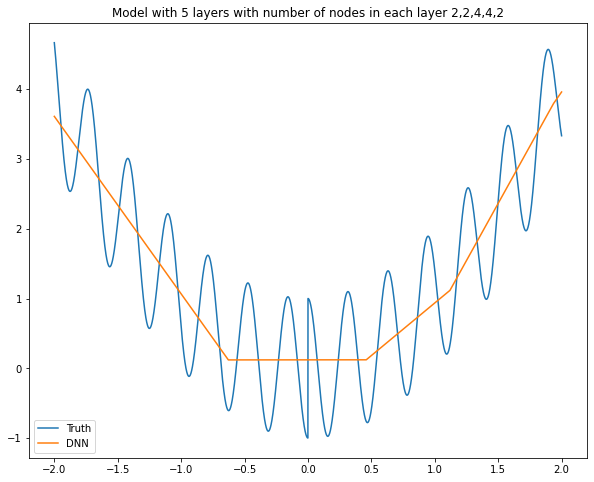

Model: "sequential_141"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_826 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_827 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_828 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_829 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_830 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_831 (Dense)            (None, 1)                 5         
Total params: 67
Trainable params: 67
Non-trainable params: 0
________________________________________________________

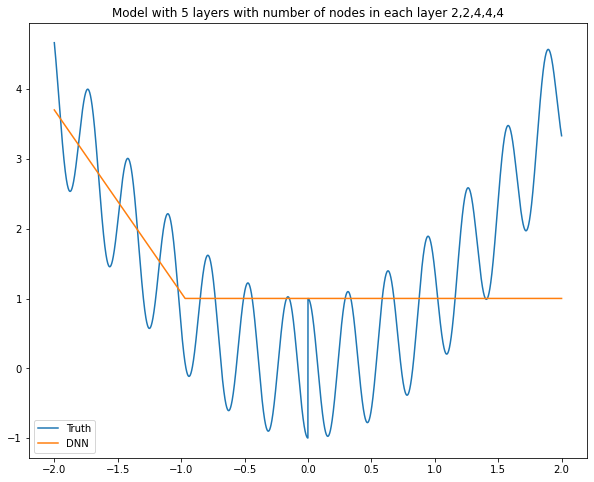

Model: "sequential_142"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_832 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_833 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_834 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_835 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_836 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_837 (Dense)            (None, 1)                 9         
Total params: 91
Trainable params: 91
Non-trainable params: 0
________________________________________________________

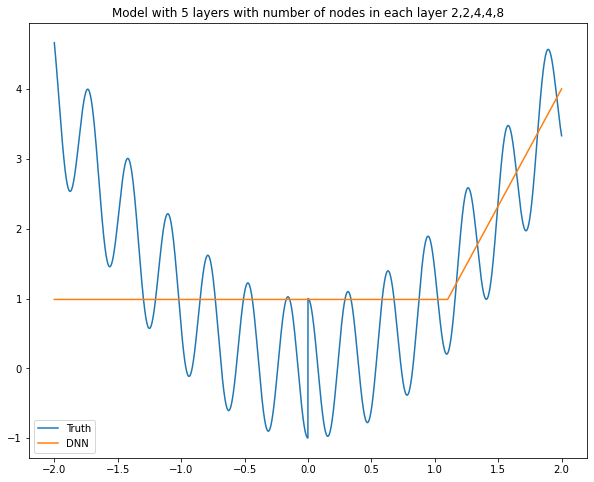

Model: "sequential_143"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_838 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_839 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_840 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_841 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_842 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_843 (Dense)            (None, 1)                 17        
Total params: 139
Trainable params: 139
Non-trainable params: 0
______________________________________________________

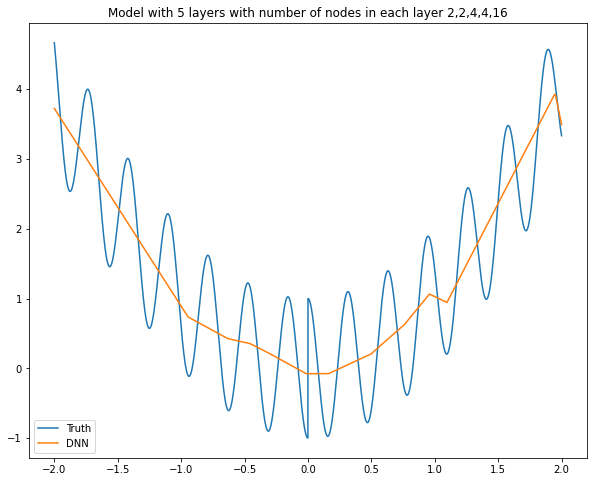

Model: "sequential_144"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_844 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_845 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_846 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_847 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_848 (Dense)            (None, 32)                160       
_________________________________________________________________
dense_849 (Dense)            (None, 1)                 33        
Total params: 235
Trainable params: 235
Non-trainable params: 0
______________________________________________________

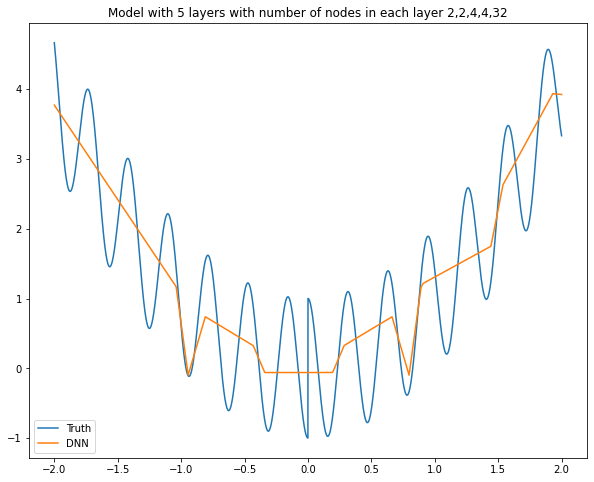

Model: "sequential_145"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_850 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_851 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_852 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_853 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_854 (Dense)            (None, 64)                320       
_________________________________________________________________
dense_855 (Dense)            (None, 1)                 65        
Total params: 427
Trainable params: 427
Non-trainable params: 0
______________________________________________________

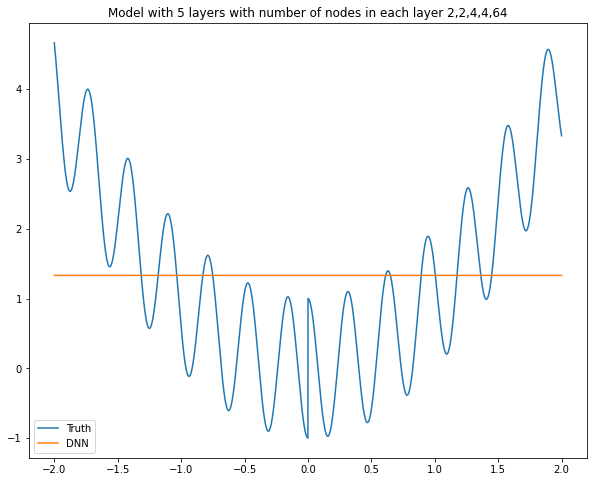

Model: "sequential_146"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_856 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_857 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_858 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_859 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_860 (Dense)            (None, 128)               640       
_________________________________________________________________
dense_861 (Dense)            (None, 1)                 129       
Total params: 811
Trainable params: 811
Non-trainable params: 0
______________________________________________________

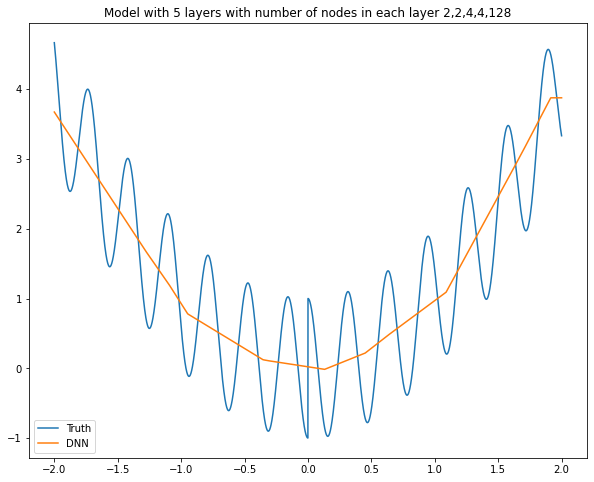

Model: "sequential_147"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_862 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_863 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_864 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_865 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_866 (Dense)            (None, 256)               1280      
_________________________________________________________________
dense_867 (Dense)            (None, 1)                 257       
Total params: 1,579
Trainable params: 1,579
Non-trainable params: 0
__________________________________________________

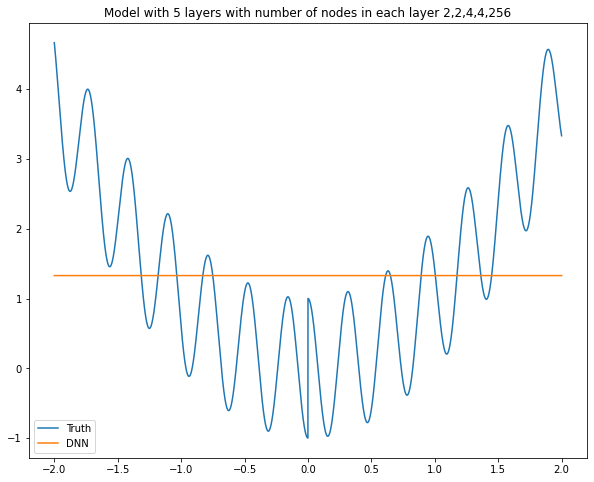

Model: "sequential_148"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_868 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_869 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_870 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_871 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_872 (Dense)            (None, 512)               2560      
_________________________________________________________________
dense_873 (Dense)            (None, 1)                 513       
Total params: 3,115
Trainable params: 3,115
Non-trainable params: 0
__________________________________________________

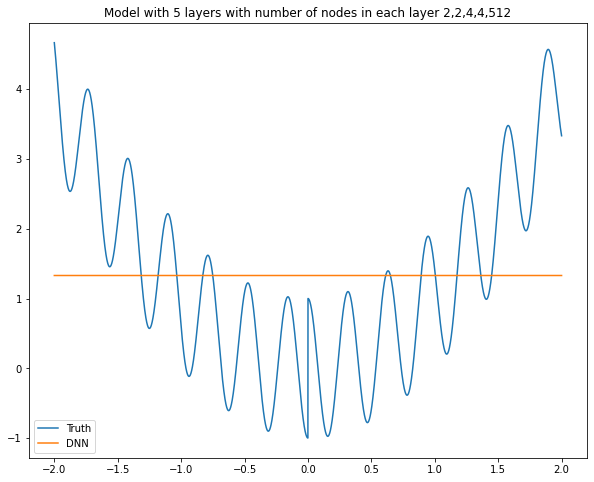

Model: "sequential_149"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_874 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_875 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_876 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_877 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_878 (Dense)            (None, 1024)              5120      
_________________________________________________________________
dense_879 (Dense)            (None, 1)                 1025      
Total params: 6,187
Trainable params: 6,187
Non-trainable params: 0
__________________________________________________

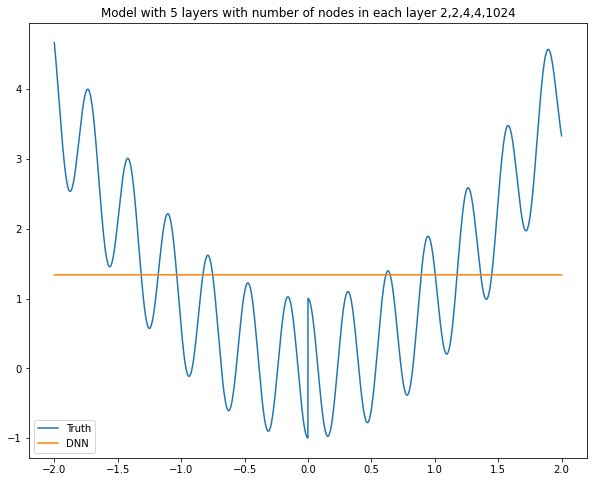

Model: "sequential_150"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_880 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_881 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_882 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_883 (Dense)            (None, 4)                 20        
_________________________________________________________________
dense_884 (Dense)            (None, 2048)              10240     
_________________________________________________________________
dense_885 (Dense)            (None, 1)                 2049      
Total params: 12,331
Trainable params: 12,331
Non-trainable params: 0
________________________________________________

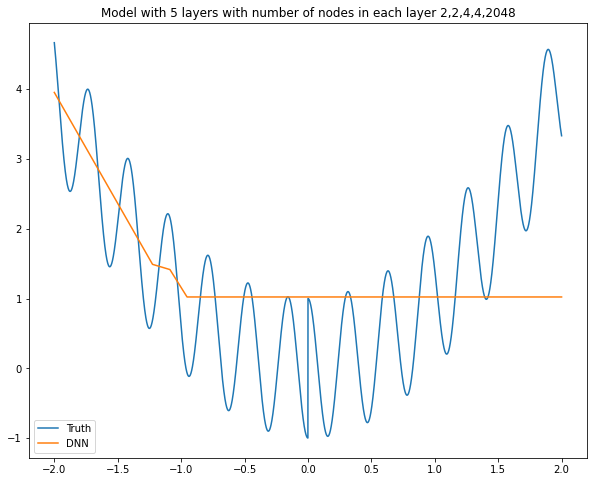

Model: "sequential_151"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_886 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_887 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_888 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_889 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_890 (Dense)            (None, 2)                 18        
_________________________________________________________________
dense_891 (Dense)            (None, 1)                 3         
Total params: 83
Trainable params: 83
Non-trainable params: 0
________________________________________________________

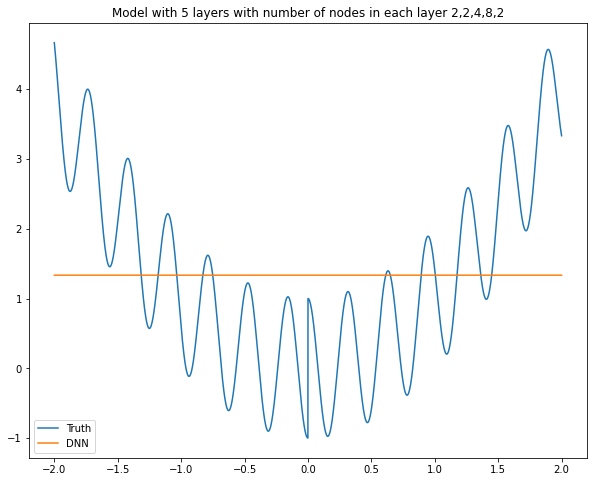

Model: "sequential_152"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_892 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_893 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_894 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_895 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_896 (Dense)            (None, 4)                 36        
_________________________________________________________________
dense_897 (Dense)            (None, 1)                 5         
Total params: 103
Trainable params: 103
Non-trainable params: 0
______________________________________________________

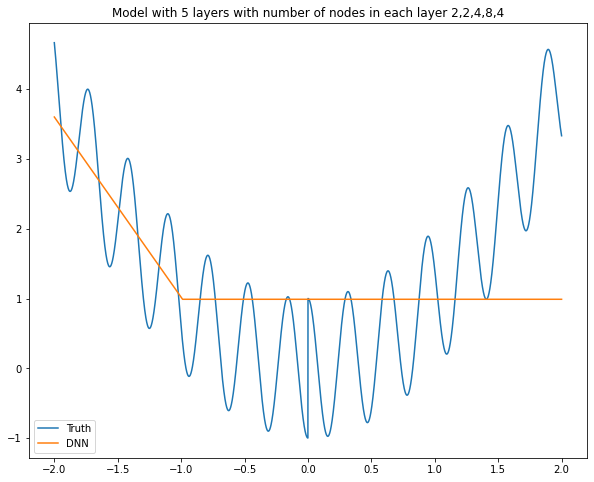

Model: "sequential_153"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_898 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_899 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_900 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_901 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_902 (Dense)            (None, 8)                 72        
_________________________________________________________________
dense_903 (Dense)            (None, 1)                 9         
Total params: 143
Trainable params: 143
Non-trainable params: 0
______________________________________________________

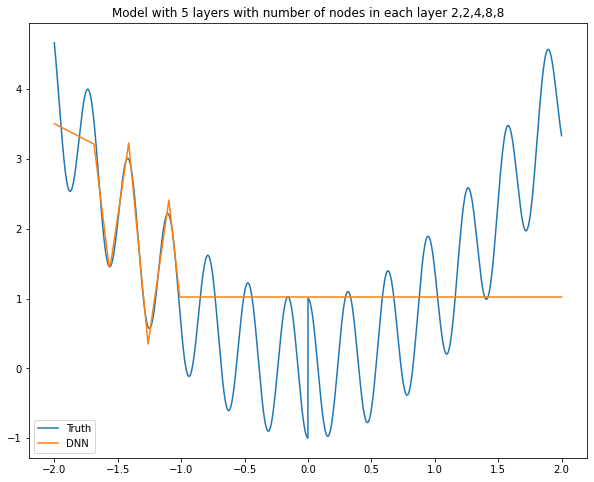

Model: "sequential_154"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_904 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_905 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_906 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_907 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_908 (Dense)            (None, 16)                144       
_________________________________________________________________
dense_909 (Dense)            (None, 1)                 17        
Total params: 223
Trainable params: 223
Non-trainable params: 0
______________________________________________________

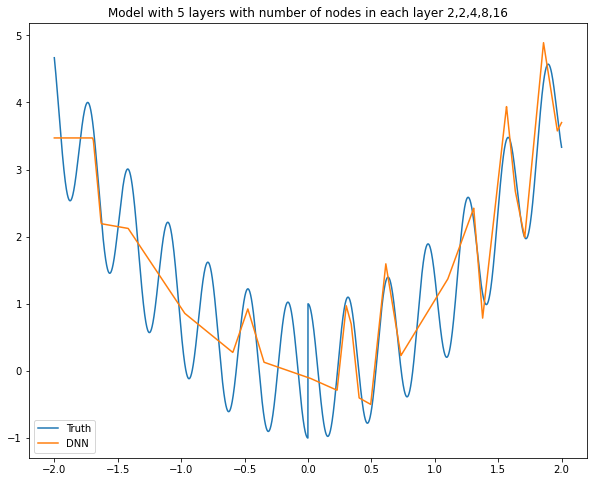

Model: "sequential_155"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_910 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_911 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_912 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_913 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_914 (Dense)            (None, 32)                288       
_________________________________________________________________
dense_915 (Dense)            (None, 1)                 33        
Total params: 383
Trainable params: 383
Non-trainable params: 0
______________________________________________________

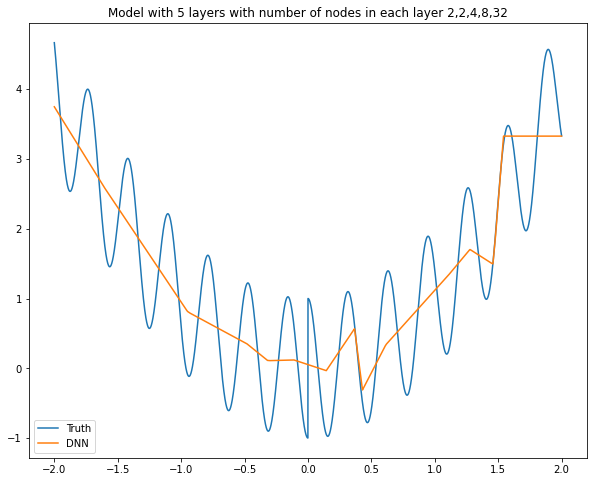

Model: "sequential_156"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_916 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_917 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_918 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_919 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_920 (Dense)            (None, 64)                576       
_________________________________________________________________
dense_921 (Dense)            (None, 1)                 65        
Total params: 703
Trainable params: 703
Non-trainable params: 0
______________________________________________________

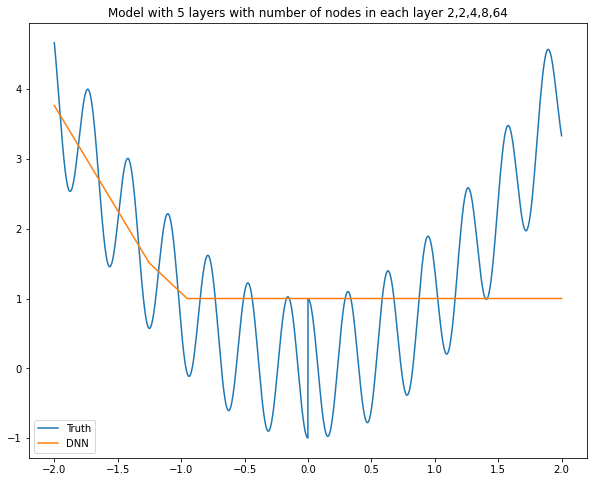

Model: "sequential_157"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_922 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_923 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_924 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_925 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_926 (Dense)            (None, 128)               1152      
_________________________________________________________________
dense_927 (Dense)            (None, 1)                 129       
Total params: 1,343
Trainable params: 1,343
Non-trainable params: 0
__________________________________________________

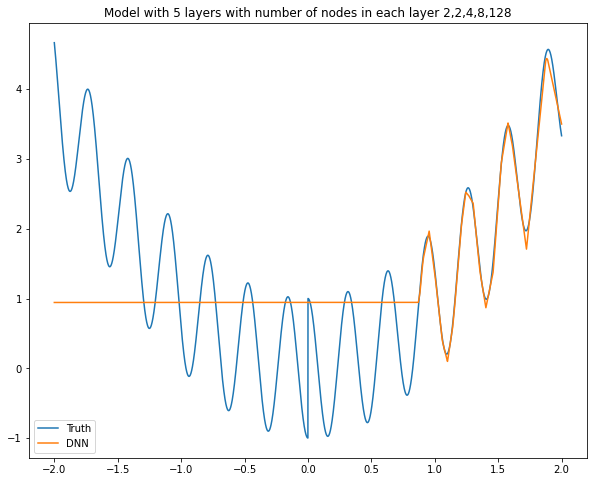

Model: "sequential_158"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_928 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_929 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_930 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_931 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_932 (Dense)            (None, 256)               2304      
_________________________________________________________________
dense_933 (Dense)            (None, 1)                 257       
Total params: 2,623
Trainable params: 2,623
Non-trainable params: 0
__________________________________________________

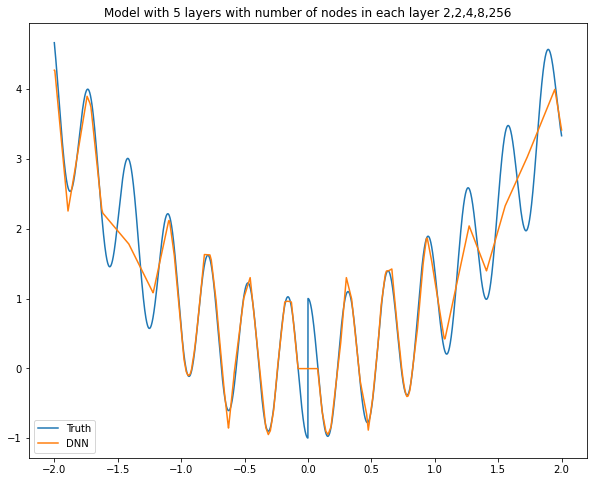

Model: "sequential_159"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_934 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_935 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_936 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_937 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_938 (Dense)            (None, 512)               4608      
_________________________________________________________________
dense_939 (Dense)            (None, 1)                 513       
Total params: 5,183
Trainable params: 5,183
Non-trainable params: 0
__________________________________________________

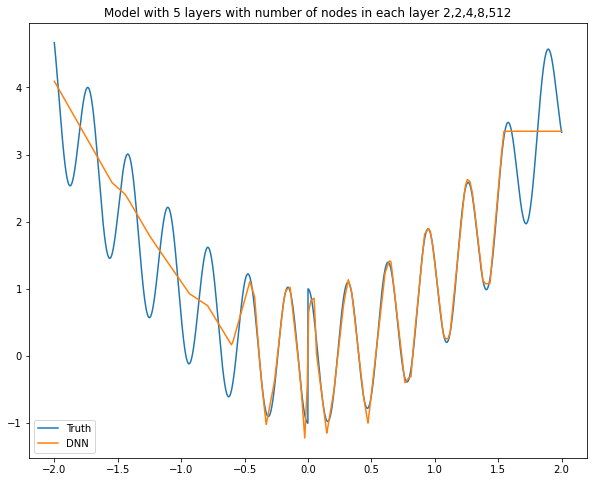

Model: "sequential_160"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_940 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_941 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_942 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_943 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_944 (Dense)            (None, 1024)              9216      
_________________________________________________________________
dense_945 (Dense)            (None, 1)                 1025      
Total params: 10,303
Trainable params: 10,303
Non-trainable params: 0
________________________________________________

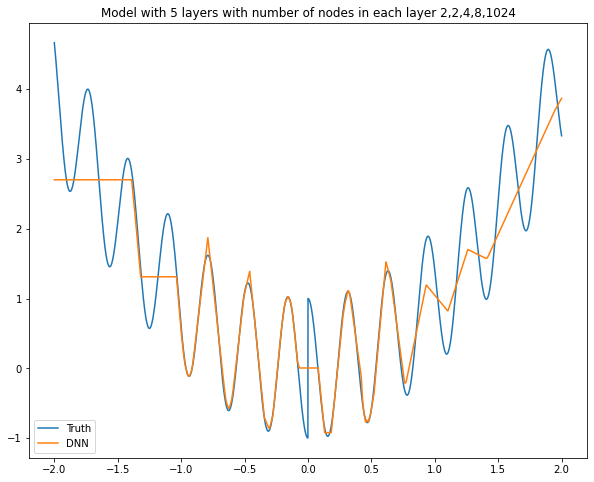

Model: "sequential_161"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_946 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_947 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_948 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_949 (Dense)            (None, 8)                 40        
_________________________________________________________________
dense_950 (Dense)            (None, 2048)              18432     
_________________________________________________________________
dense_951 (Dense)            (None, 1)                 2049      
Total params: 20,543
Trainable params: 20,543
Non-trainable params: 0
________________________________________________

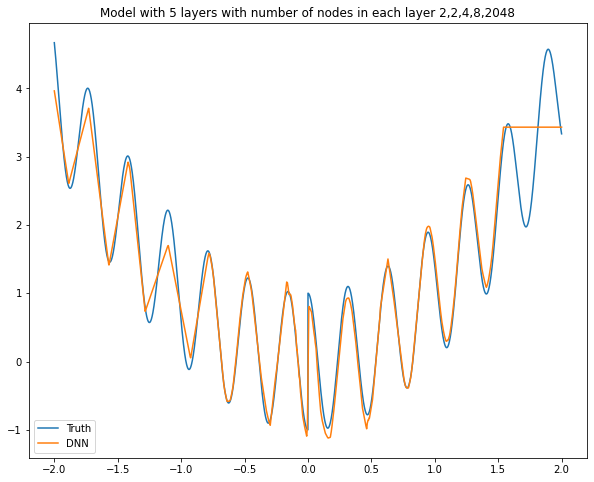

Model: "sequential_162"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_952 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_953 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_954 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_955 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_956 (Dense)            (None, 2)                 34        
_________________________________________________________________
dense_957 (Dense)            (None, 1)                 3         
Total params: 139
Trainable params: 139
Non-trainable params: 0
______________________________________________________

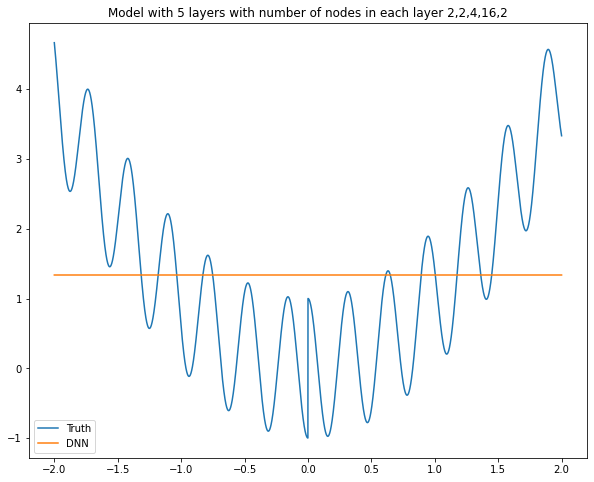

Model: "sequential_163"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_958 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_959 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_960 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_961 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_962 (Dense)            (None, 4)                 68        
_________________________________________________________________
dense_963 (Dense)            (None, 1)                 5         
Total params: 175
Trainable params: 175
Non-trainable params: 0
______________________________________________________

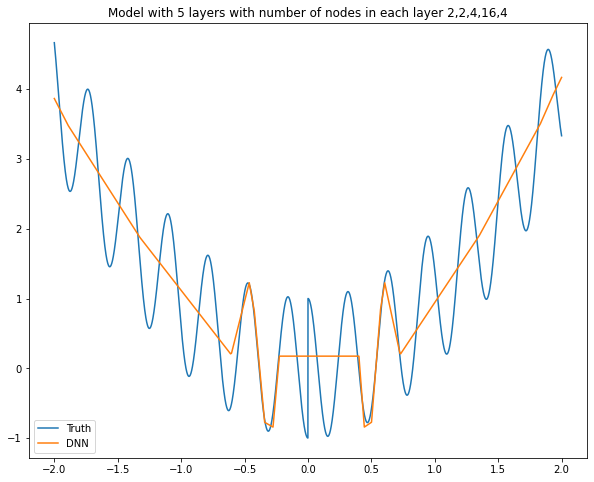

Model: "sequential_164"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_964 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_965 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_966 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_967 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_968 (Dense)            (None, 8)                 136       
_________________________________________________________________
dense_969 (Dense)            (None, 1)                 9         
Total params: 247
Trainable params: 247
Non-trainable params: 0
______________________________________________________

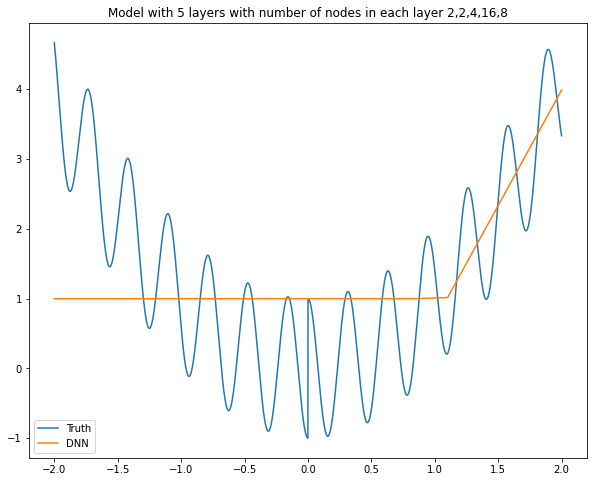

Model: "sequential_165"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_970 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_971 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_972 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_973 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_974 (Dense)            (None, 16)                272       
_________________________________________________________________
dense_975 (Dense)            (None, 1)                 17        
Total params: 391
Trainable params: 391
Non-trainable params: 0
______________________________________________________

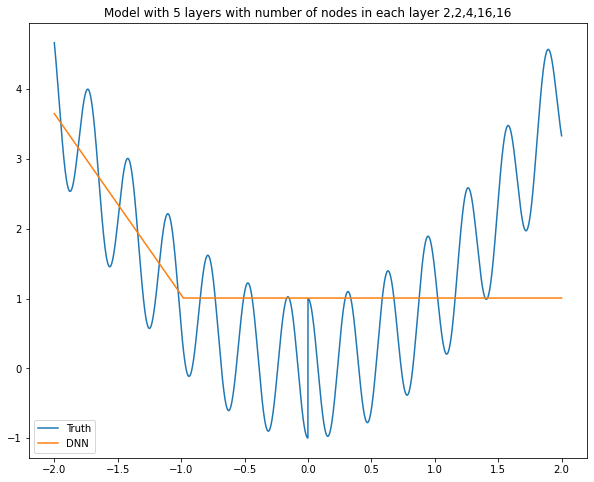

Model: "sequential_166"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_976 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_977 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_978 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_979 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_980 (Dense)            (None, 32)                544       
_________________________________________________________________
dense_981 (Dense)            (None, 1)                 33        
Total params: 679
Trainable params: 679
Non-trainable params: 0
______________________________________________________

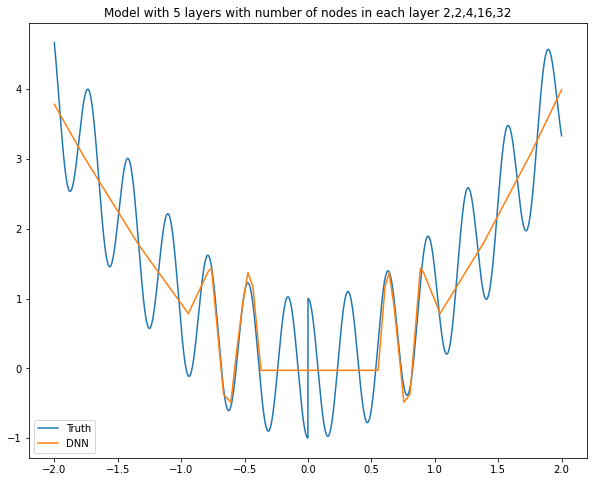

Model: "sequential_167"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_982 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_983 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_984 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_985 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_986 (Dense)            (None, 64)                1088      
_________________________________________________________________
dense_987 (Dense)            (None, 1)                 65        
Total params: 1,255
Trainable params: 1,255
Non-trainable params: 0
__________________________________________________

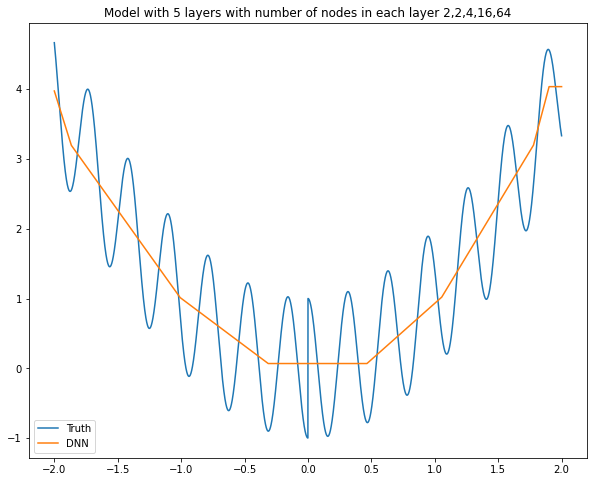

Model: "sequential_168"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_988 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_989 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_990 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_991 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_992 (Dense)            (None, 128)               2176      
_________________________________________________________________
dense_993 (Dense)            (None, 1)                 129       
Total params: 2,407
Trainable params: 2,407
Non-trainable params: 0
__________________________________________________

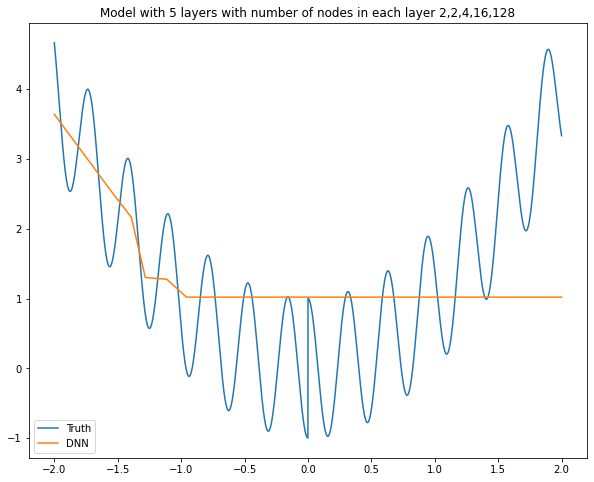

Model: "sequential_169"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_994 (Dense)            (None, 2)                 4         
_________________________________________________________________
dense_995 (Dense)            (None, 2)                 6         
_________________________________________________________________
dense_996 (Dense)            (None, 4)                 12        
_________________________________________________________________
dense_997 (Dense)            (None, 16)                80        
_________________________________________________________________
dense_998 (Dense)            (None, 256)               4352      
_________________________________________________________________
dense_999 (Dense)            (None, 1)                 257       
Total params: 4,711
Trainable params: 4,711
Non-trainable params: 0
__________________________________________________

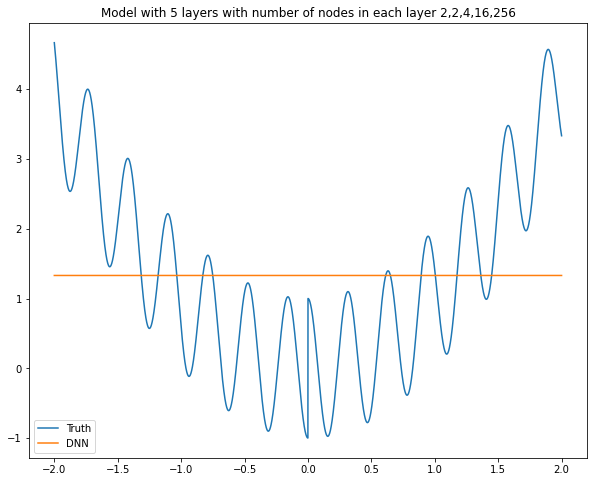

Model: "sequential_170"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1000 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1001 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1002 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1003 (Dense)           (None, 16)                80        
_________________________________________________________________
dense_1004 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_1005 (Dense)           (None, 1)                 513       
Total params: 9,319
Trainable params: 9,319
Non-trainable params: 0
__________________________________________________

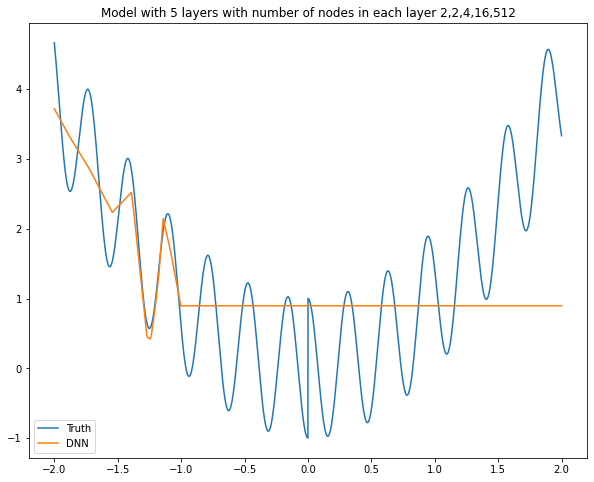

Model: "sequential_171"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1006 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1007 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1008 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1009 (Dense)           (None, 16)                80        
_________________________________________________________________
dense_1010 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_1011 (Dense)           (None, 1)                 1025      
Total params: 18,535
Trainable params: 18,535
Non-trainable params: 0
________________________________________________

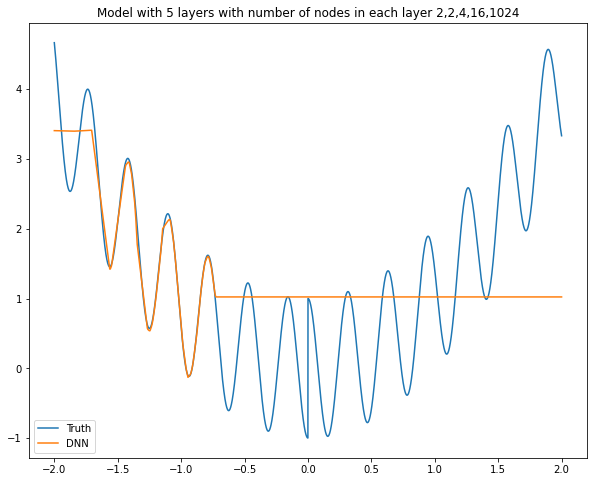

Model: "sequential_172"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1012 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1013 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1014 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1015 (Dense)           (None, 16)                80        
_________________________________________________________________
dense_1016 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_1017 (Dense)           (None, 1)                 2049      
Total params: 36,967
Trainable params: 36,967
Non-trainable params: 0
________________________________________________

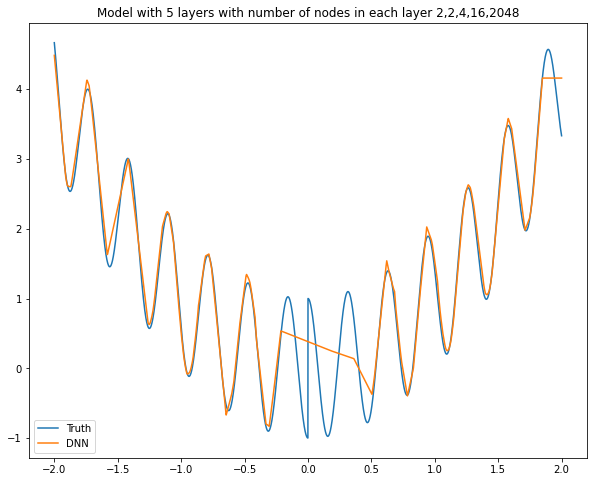

Model: "sequential_173"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1018 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1019 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1020 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1021 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1022 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_1023 (Dense)           (None, 1)                 3         
Total params: 251
Trainable params: 251
Non-trainable params: 0
______________________________________________________

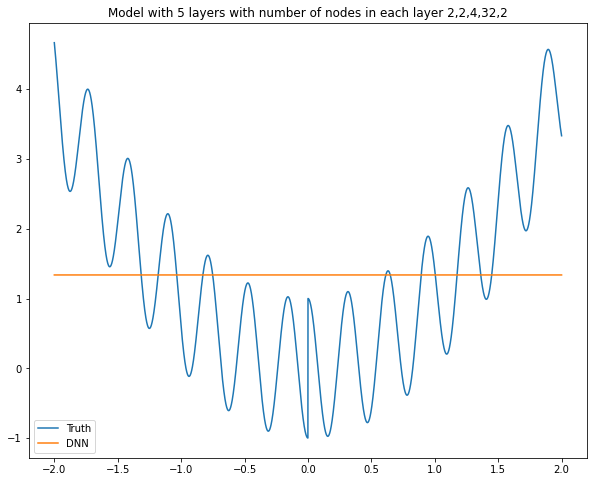

Model: "sequential_174"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1024 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1025 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1026 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1027 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1028 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_1029 (Dense)           (None, 1)                 5         
Total params: 319
Trainable params: 319
Non-trainable params: 0
______________________________________________________

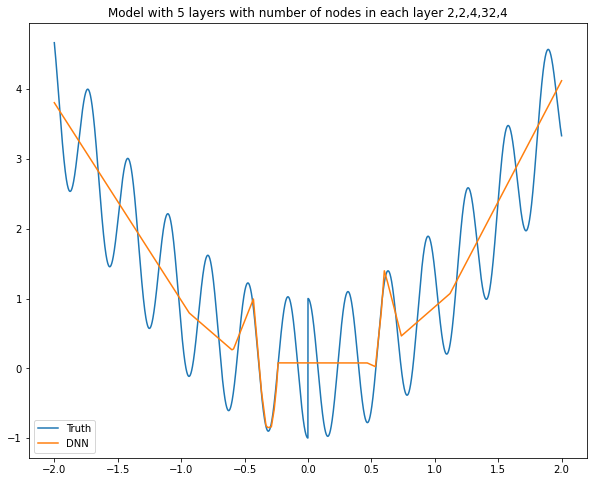

Model: "sequential_175"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1030 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1031 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1032 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1033 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1034 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_1035 (Dense)           (None, 1)                 9         
Total params: 455
Trainable params: 455
Non-trainable params: 0
______________________________________________________

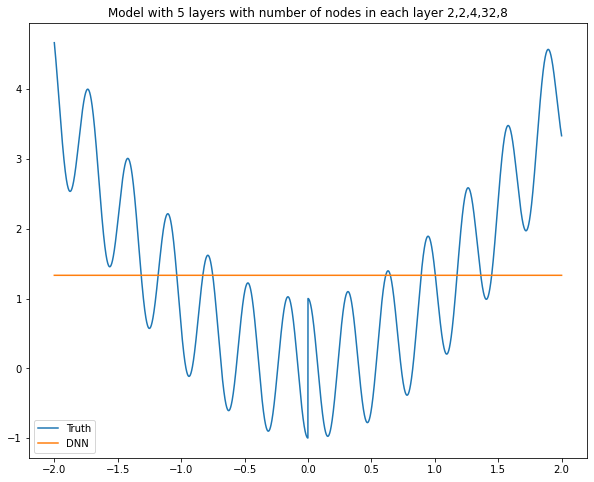

Model: "sequential_176"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1036 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1037 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1038 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1039 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1040 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_1041 (Dense)           (None, 1)                 17        
Total params: 727
Trainable params: 727
Non-trainable params: 0
______________________________________________________

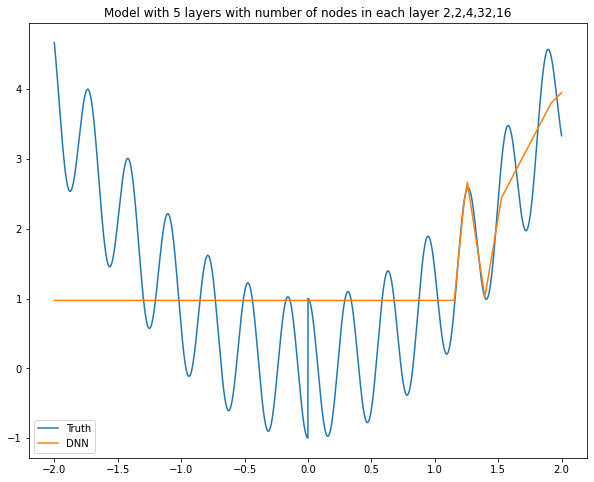

Model: "sequential_177"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1042 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1043 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1044 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1045 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1046 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_1047 (Dense)           (None, 1)                 33        
Total params: 1,271
Trainable params: 1,271
Non-trainable params: 0
__________________________________________________

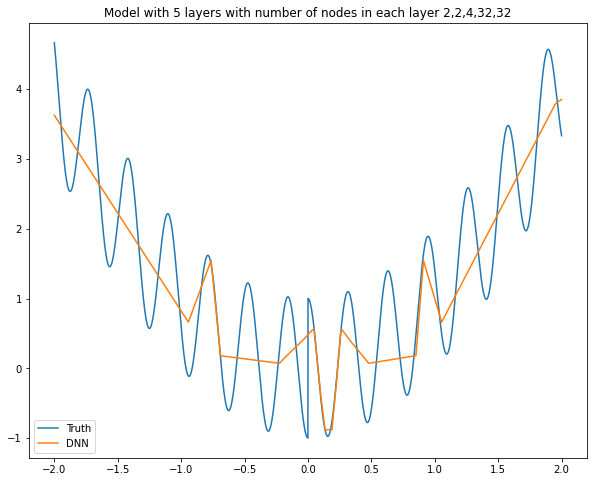

Model: "sequential_178"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1048 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1049 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1050 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1051 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1052 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_1053 (Dense)           (None, 1)                 65        
Total params: 2,359
Trainable params: 2,359
Non-trainable params: 0
__________________________________________________

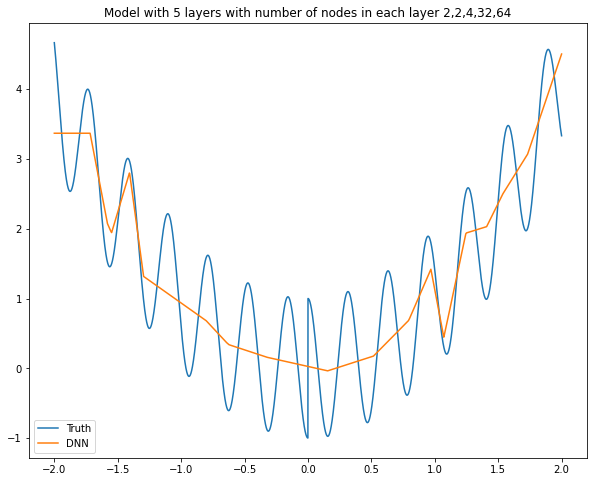

Model: "sequential_179"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1054 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1055 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1056 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1057 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1058 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_1059 (Dense)           (None, 1)                 129       
Total params: 4,535
Trainable params: 4,535
Non-trainable params: 0
__________________________________________________

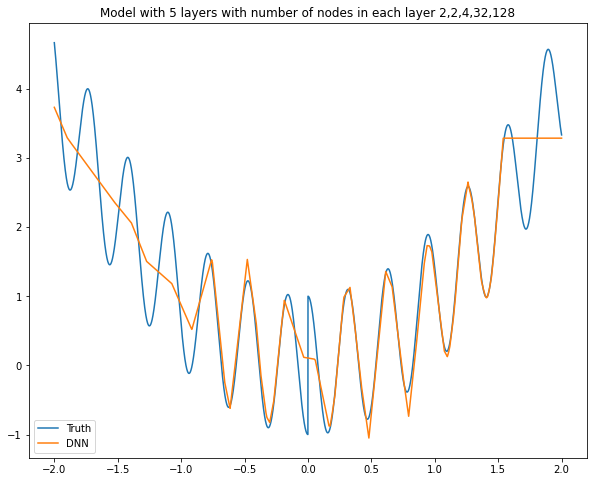

Model: "sequential_180"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1060 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1061 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1062 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1063 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1064 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_1065 (Dense)           (None, 1)                 257       
Total params: 8,887
Trainable params: 8,887
Non-trainable params: 0
__________________________________________________

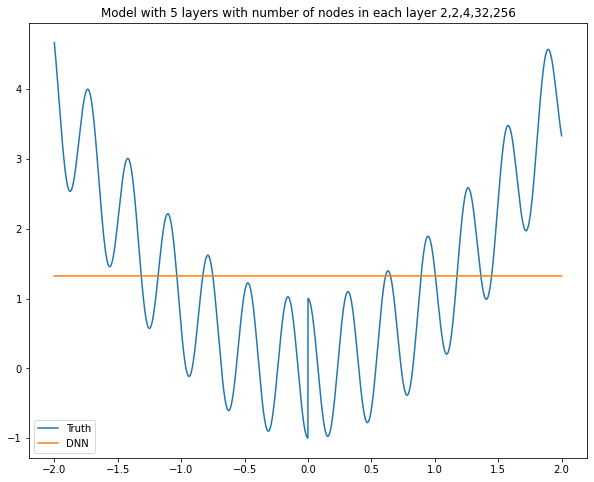

Model: "sequential_181"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1066 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1067 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1068 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1069 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1070 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_1071 (Dense)           (None, 1)                 513       
Total params: 17,591
Trainable params: 17,591
Non-trainable params: 0
________________________________________________

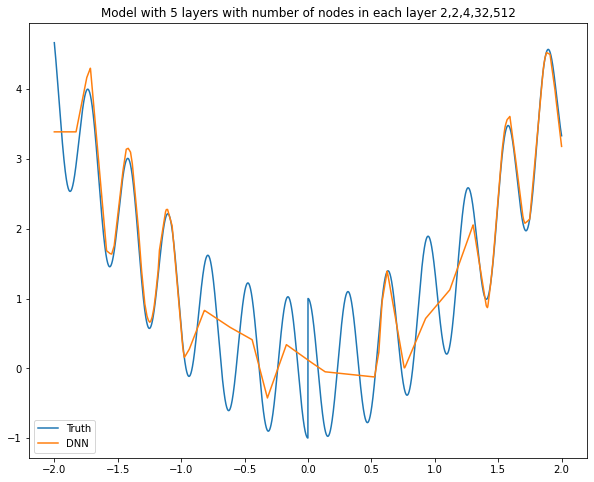

Model: "sequential_182"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1072 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1073 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1074 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1075 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1076 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_1077 (Dense)           (None, 1)                 1025      
Total params: 34,999
Trainable params: 34,999
Non-trainable params: 0
________________________________________________

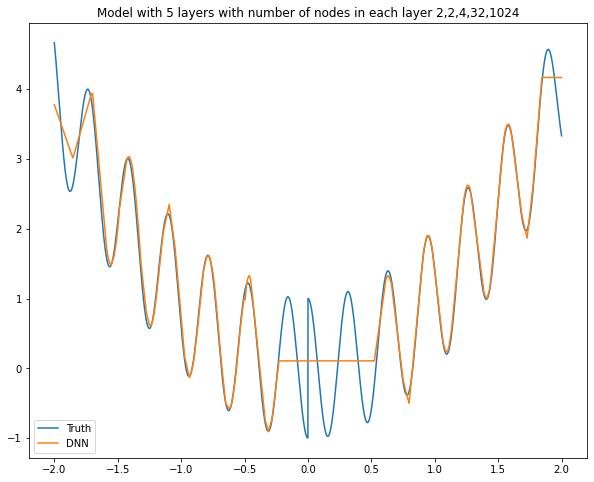

Model: "sequential_183"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1078 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1079 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1080 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1081 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1082 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_1083 (Dense)           (None, 1)                 2049      
Total params: 69,815
Trainable params: 69,815
Non-trainable params: 0
________________________________________________

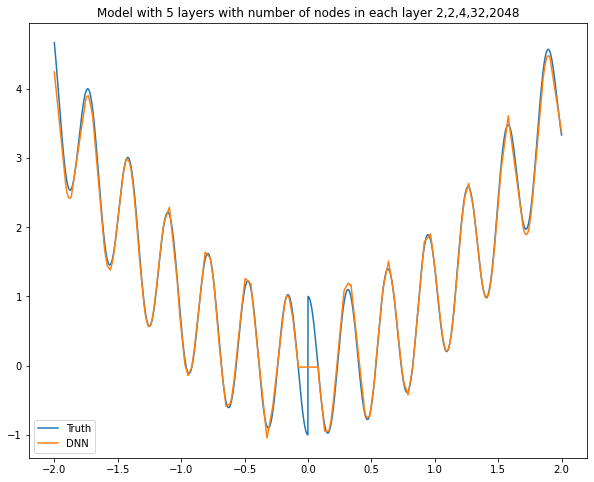

Model: "sequential_184"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1084 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1085 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1086 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1087 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1088 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_1089 (Dense)           (None, 1)                 3         
Total params: 475
Trainable params: 475
Non-trainable params: 0
______________________________________________________

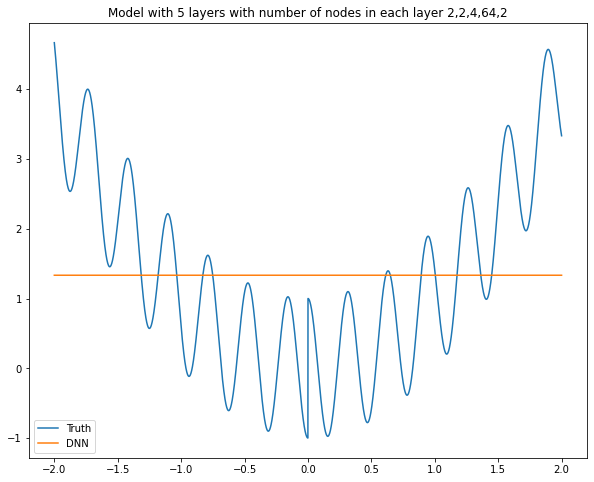

Model: "sequential_185"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1090 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1091 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1092 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1093 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1094 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_1095 (Dense)           (None, 1)                 5         
Total params: 607
Trainable params: 607
Non-trainable params: 0
______________________________________________________

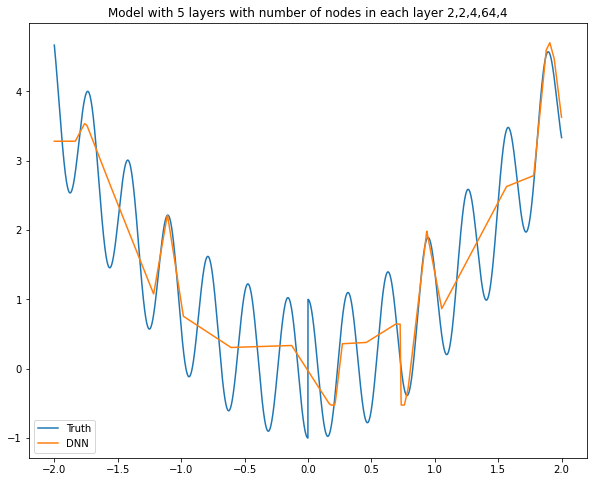

Model: "sequential_186"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1096 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1097 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1098 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1099 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1100 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_1101 (Dense)           (None, 1)                 9         
Total params: 871
Trainable params: 871
Non-trainable params: 0
______________________________________________________

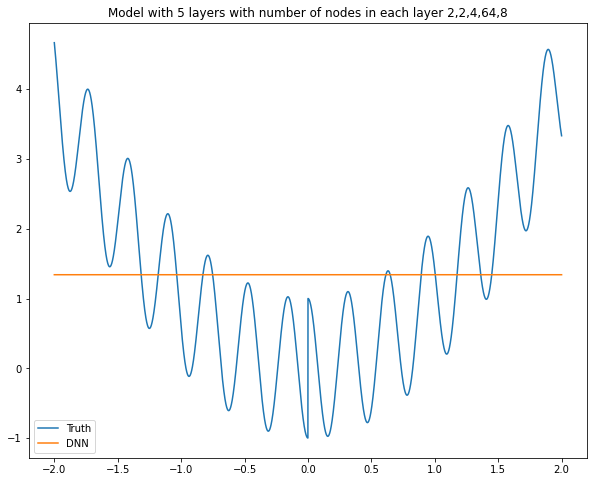

Model: "sequential_187"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1102 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1103 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1104 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1105 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1106 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_1107 (Dense)           (None, 1)                 17        
Total params: 1,399
Trainable params: 1,399
Non-trainable params: 0
__________________________________________________

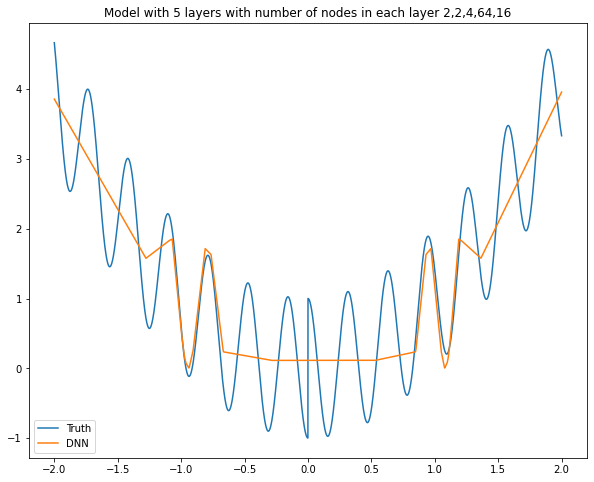

Model: "sequential_188"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1108 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1109 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1110 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1111 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1112 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_1113 (Dense)           (None, 1)                 33        
Total params: 2,455
Trainable params: 2,455
Non-trainable params: 0
__________________________________________________

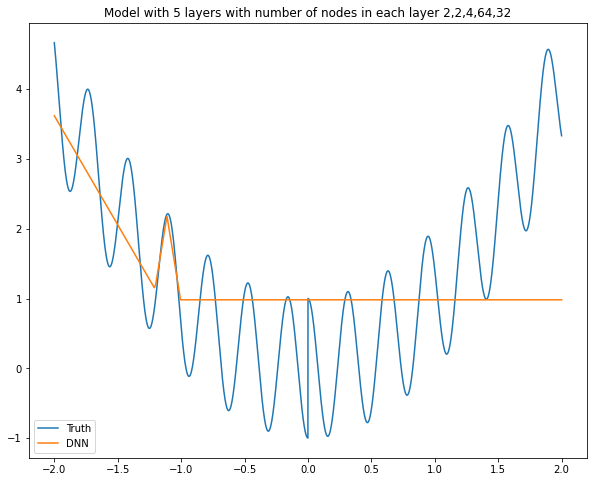

Model: "sequential_189"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1114 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1115 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1116 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1117 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1118 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_1119 (Dense)           (None, 1)                 65        
Total params: 4,567
Trainable params: 4,567
Non-trainable params: 0
__________________________________________________

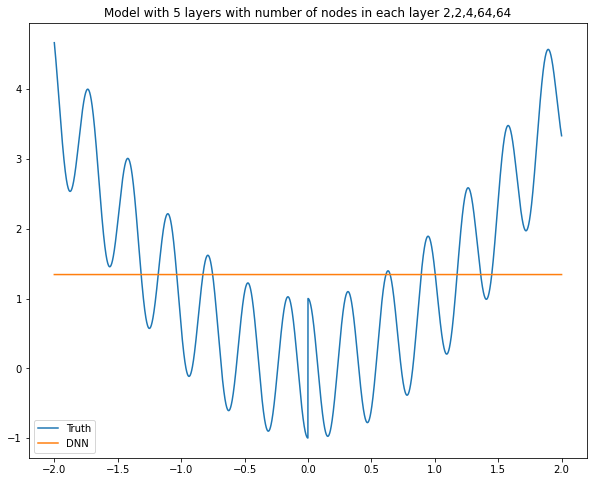

Model: "sequential_190"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1120 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1121 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1122 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1123 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1124 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_1125 (Dense)           (None, 1)                 129       
Total params: 8,791
Trainable params: 8,791
Non-trainable params: 0
__________________________________________________

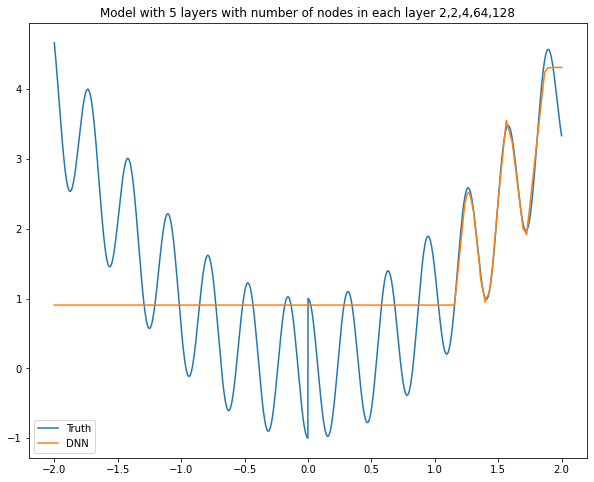

Model: "sequential_191"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1126 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1127 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1128 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1129 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1130 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_1131 (Dense)           (None, 1)                 257       
Total params: 17,239
Trainable params: 17,239
Non-trainable params: 0
________________________________________________

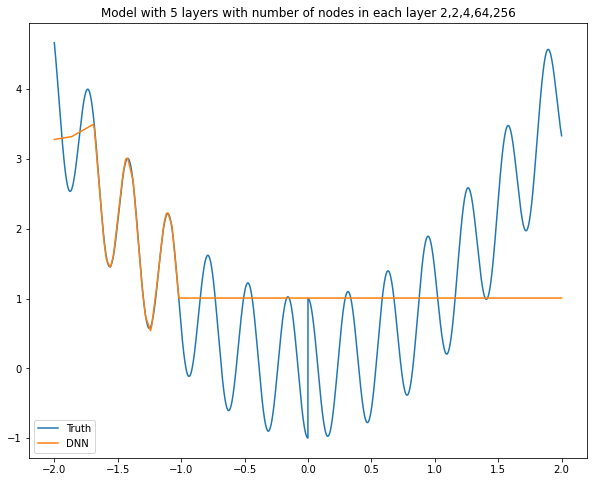

Model: "sequential_192"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1132 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1133 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1134 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1135 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1136 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_1137 (Dense)           (None, 1)                 513       
Total params: 34,135
Trainable params: 34,135
Non-trainable params: 0
________________________________________________

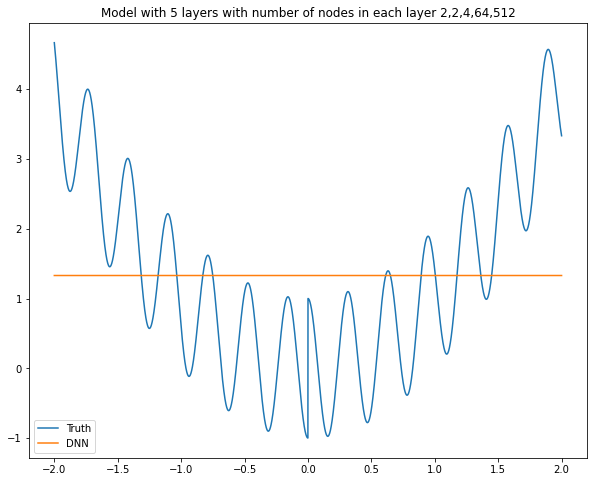

Model: "sequential_193"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1138 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1139 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1140 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1141 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1142 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_1143 (Dense)           (None, 1)                 1025      
Total params: 67,927
Trainable params: 67,927
Non-trainable params: 0
________________________________________________

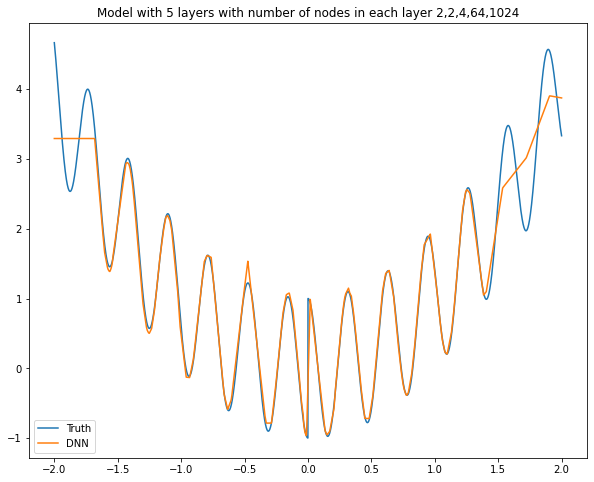

Model: "sequential_194"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1144 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1145 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1146 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1147 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1148 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_1149 (Dense)           (None, 1)                 2049      
Total params: 135,511
Trainable params: 135,511
Non-trainable params: 0
______________________________________________

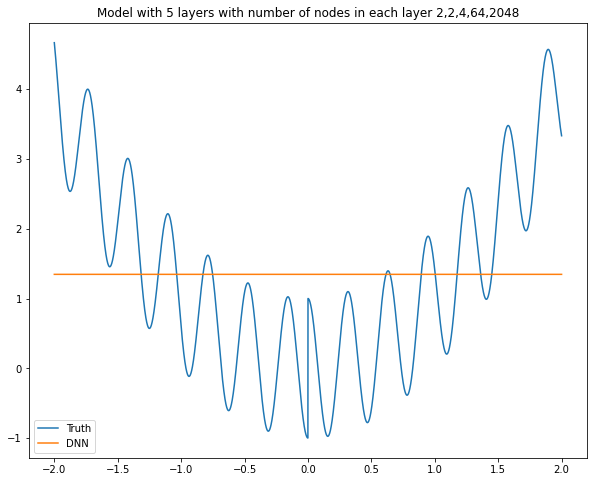

Model: "sequential_195"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1150 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1151 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1152 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1153 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1154 (Dense)           (None, 2)                 258       
_________________________________________________________________
dense_1155 (Dense)           (None, 1)                 3         
Total params: 923
Trainable params: 923
Non-trainable params: 0
______________________________________________________

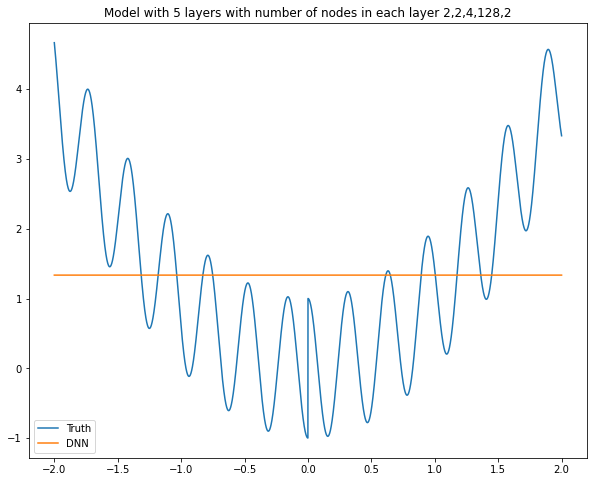

Model: "sequential_196"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1156 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1157 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1158 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1159 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1160 (Dense)           (None, 4)                 516       
_________________________________________________________________
dense_1161 (Dense)           (None, 1)                 5         
Total params: 1,183
Trainable params: 1,183
Non-trainable params: 0
__________________________________________________

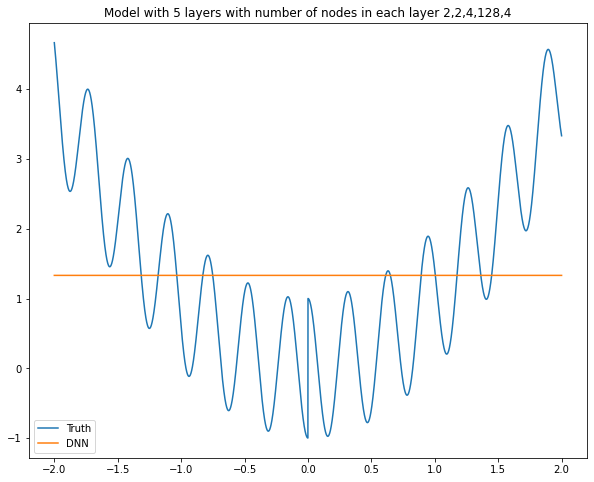

Model: "sequential_197"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1162 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1163 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1164 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1165 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1166 (Dense)           (None, 8)                 1032      
_________________________________________________________________
dense_1167 (Dense)           (None, 1)                 9         
Total params: 1,703
Trainable params: 1,703
Non-trainable params: 0
__________________________________________________

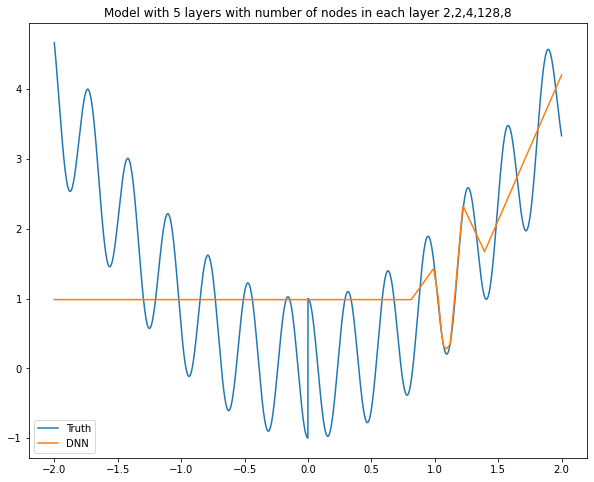

Model: "sequential_198"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1168 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1169 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1170 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1171 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1172 (Dense)           (None, 16)                2064      
_________________________________________________________________
dense_1173 (Dense)           (None, 1)                 17        
Total params: 2,743
Trainable params: 2,743
Non-trainable params: 0
__________________________________________________

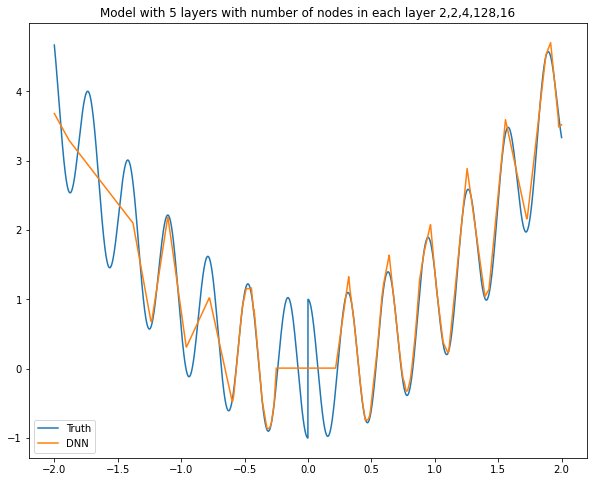

Model: "sequential_199"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1174 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1175 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1176 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1177 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1178 (Dense)           (None, 32)                4128      
_________________________________________________________________
dense_1179 (Dense)           (None, 1)                 33        
Total params: 4,823
Trainable params: 4,823
Non-trainable params: 0
__________________________________________________

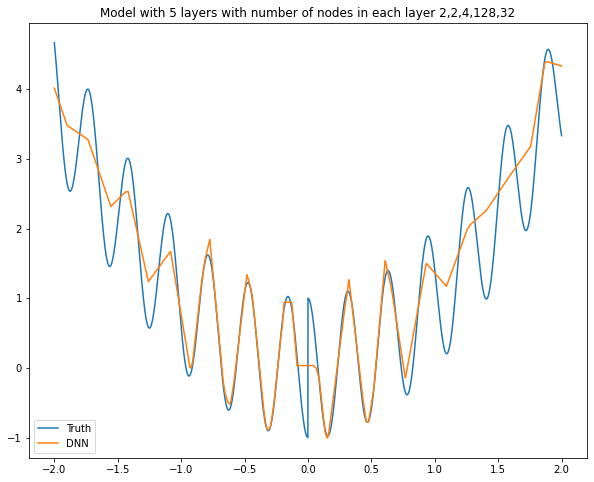

Model: "sequential_200"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1180 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1181 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1182 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1183 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1184 (Dense)           (None, 64)                8256      
_________________________________________________________________
dense_1185 (Dense)           (None, 1)                 65        
Total params: 8,983
Trainable params: 8,983
Non-trainable params: 0
__________________________________________________

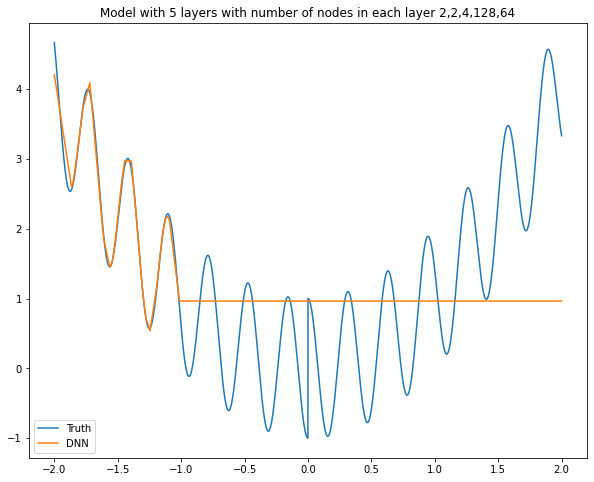

Model: "sequential_201"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1186 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1187 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1188 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1189 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1190 (Dense)           (None, 128)               16512     
_________________________________________________________________
dense_1191 (Dense)           (None, 1)                 129       
Total params: 17,303
Trainable params: 17,303
Non-trainable params: 0
________________________________________________

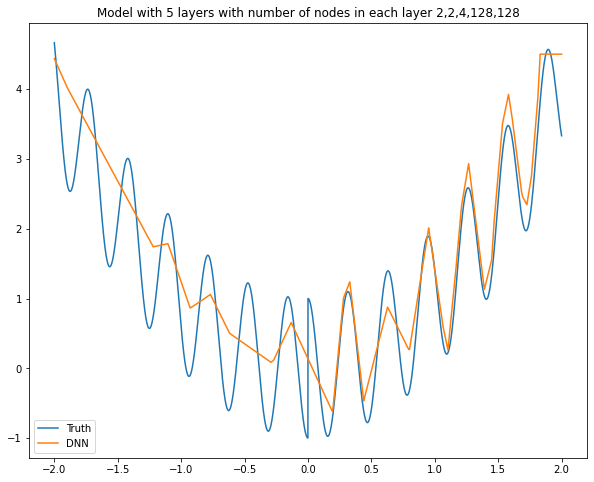

Model: "sequential_202"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1192 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1193 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1194 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1195 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1196 (Dense)           (None, 256)               33024     
_________________________________________________________________
dense_1197 (Dense)           (None, 1)                 257       
Total params: 33,943
Trainable params: 33,943
Non-trainable params: 0
________________________________________________

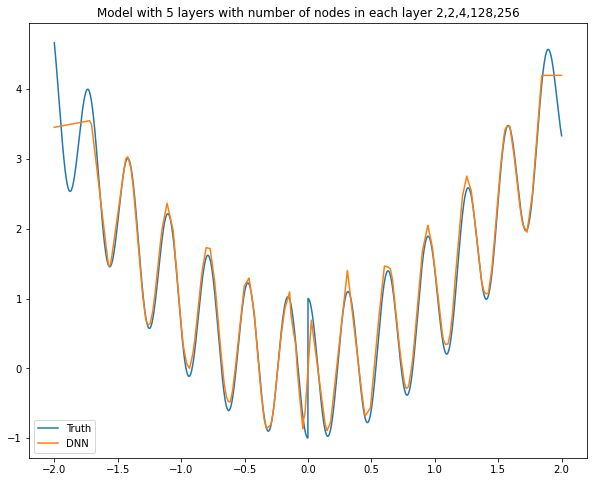

Model: "sequential_203"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1198 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1199 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1200 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1201 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1202 (Dense)           (None, 512)               66048     
_________________________________________________________________
dense_1203 (Dense)           (None, 1)                 513       
Total params: 67,223
Trainable params: 67,223
Non-trainable params: 0
________________________________________________

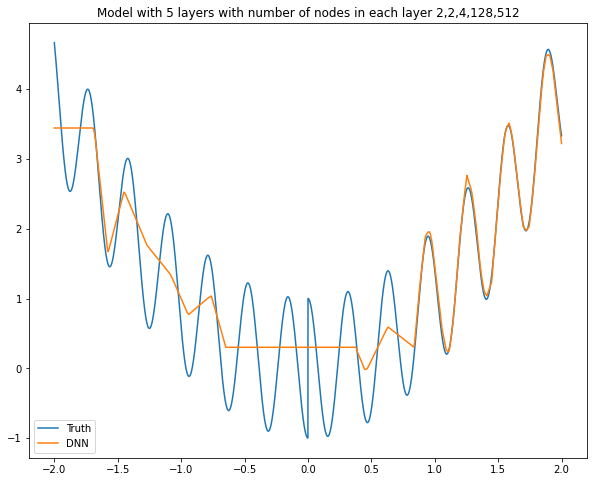

Model: "sequential_204"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1204 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1205 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1206 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1207 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1208 (Dense)           (None, 1024)              132096    
_________________________________________________________________
dense_1209 (Dense)           (None, 1)                 1025      
Total params: 133,783
Trainable params: 133,783
Non-trainable params: 0
______________________________________________

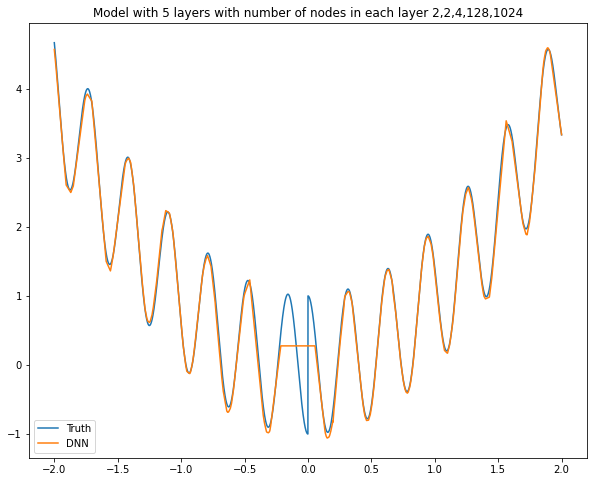

Model: "sequential_205"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1210 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1211 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1212 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1213 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1214 (Dense)           (None, 2048)              264192    
_________________________________________________________________
dense_1215 (Dense)           (None, 1)                 2049      
Total params: 266,903
Trainable params: 266,903
Non-trainable params: 0
______________________________________________

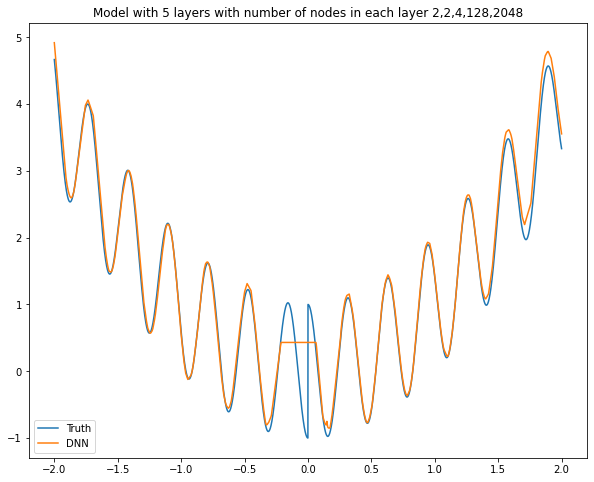

Model: "sequential_206"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1216 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1217 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1218 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1219 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1220 (Dense)           (None, 2)                 514       
_________________________________________________________________
dense_1221 (Dense)           (None, 1)                 3         
Total params: 1,819
Trainable params: 1,819
Non-trainable params: 0
__________________________________________________

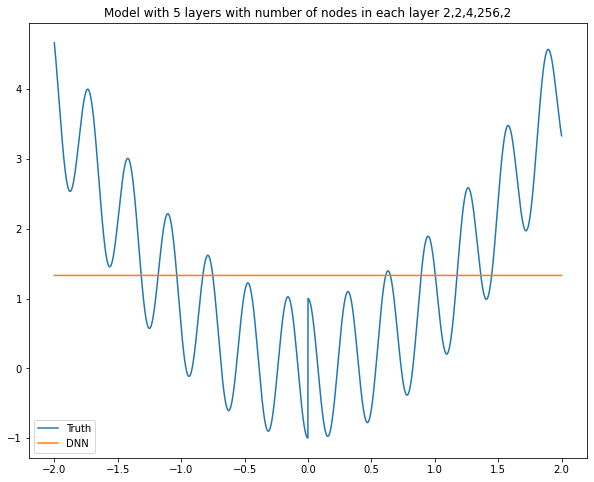

Model: "sequential_207"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1222 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1223 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1224 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1225 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1226 (Dense)           (None, 4)                 1028      
_________________________________________________________________
dense_1227 (Dense)           (None, 1)                 5         
Total params: 2,335
Trainable params: 2,335
Non-trainable params: 0
__________________________________________________

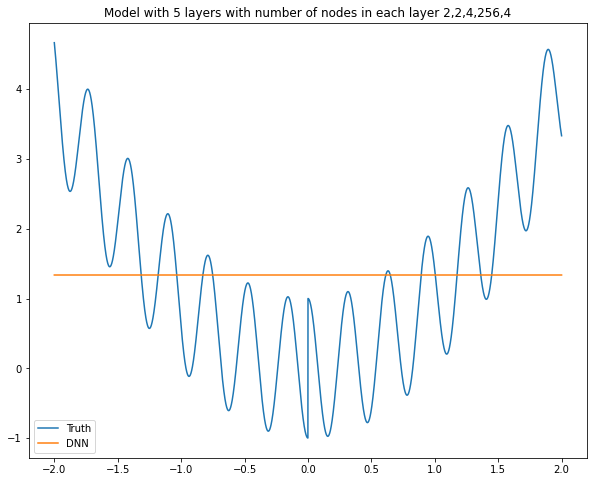

Model: "sequential_208"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1228 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1229 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1230 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1231 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1232 (Dense)           (None, 8)                 2056      
_________________________________________________________________
dense_1233 (Dense)           (None, 1)                 9         
Total params: 3,367
Trainable params: 3,367
Non-trainable params: 0
__________________________________________________

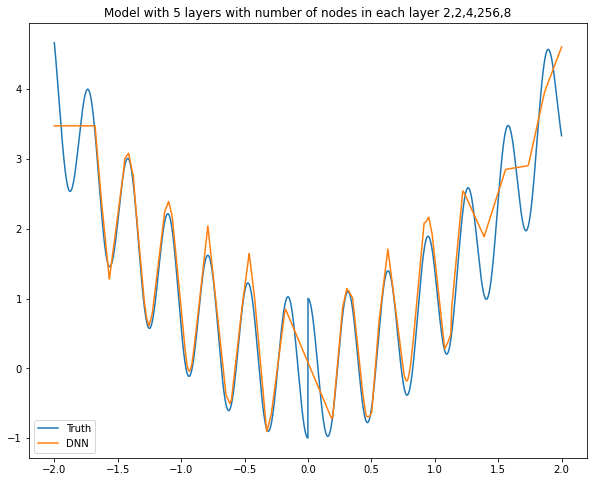

Model: "sequential_209"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1234 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1235 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1236 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1237 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1238 (Dense)           (None, 16)                4112      
_________________________________________________________________
dense_1239 (Dense)           (None, 1)                 17        
Total params: 5,431
Trainable params: 5,431
Non-trainable params: 0
__________________________________________________

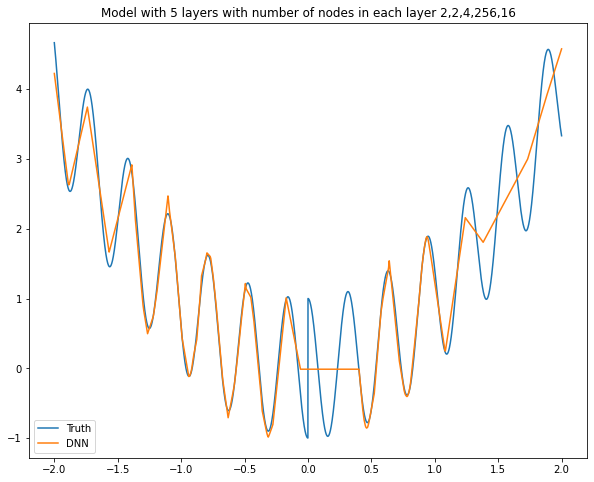

Model: "sequential_210"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1240 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1241 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1242 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1243 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1244 (Dense)           (None, 32)                8224      
_________________________________________________________________
dense_1245 (Dense)           (None, 1)                 33        
Total params: 9,559
Trainable params: 9,559
Non-trainable params: 0
__________________________________________________

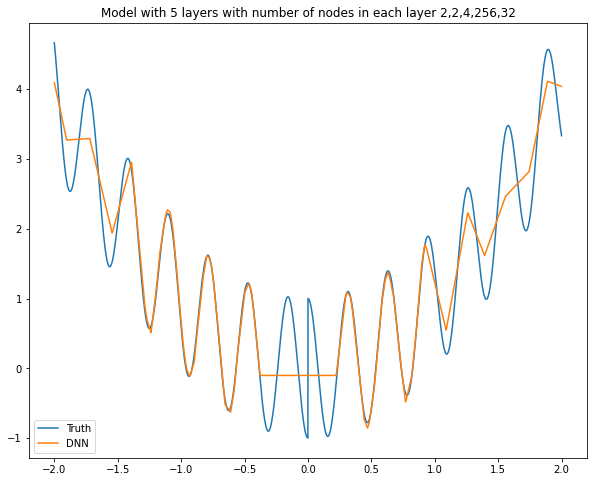

Model: "sequential_211"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1246 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1247 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1248 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1249 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1250 (Dense)           (None, 64)                16448     
_________________________________________________________________
dense_1251 (Dense)           (None, 1)                 65        
Total params: 17,815
Trainable params: 17,815
Non-trainable params: 0
________________________________________________

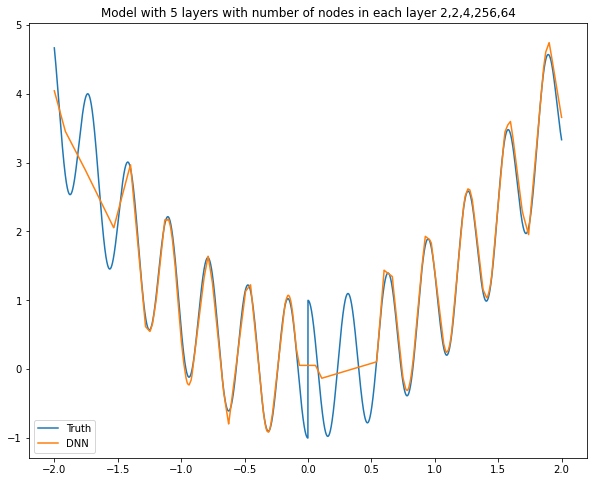

Model: "sequential_212"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1252 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1253 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1254 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1255 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1256 (Dense)           (None, 128)               32896     
_________________________________________________________________
dense_1257 (Dense)           (None, 1)                 129       
Total params: 34,327
Trainable params: 34,327
Non-trainable params: 0
________________________________________________

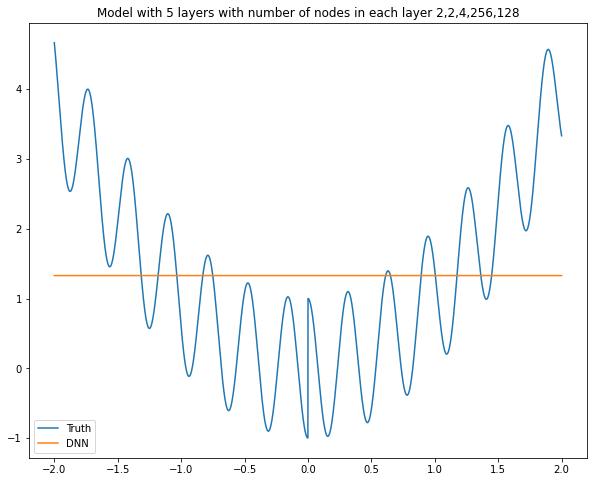

Model: "sequential_213"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1258 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1259 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1260 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1261 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1262 (Dense)           (None, 256)               65792     
_________________________________________________________________
dense_1263 (Dense)           (None, 1)                 257       
Total params: 67,351
Trainable params: 67,351
Non-trainable params: 0
________________________________________________

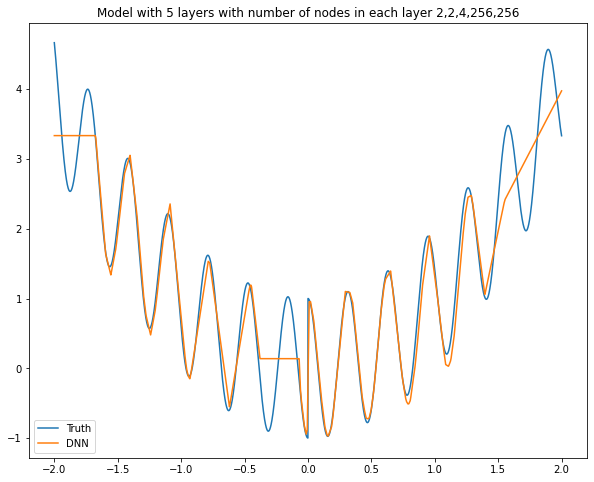

Model: "sequential_214"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1264 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1265 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1266 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1267 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1268 (Dense)           (None, 512)               131584    
_________________________________________________________________
dense_1269 (Dense)           (None, 1)                 513       
Total params: 133,399
Trainable params: 133,399
Non-trainable params: 0
______________________________________________

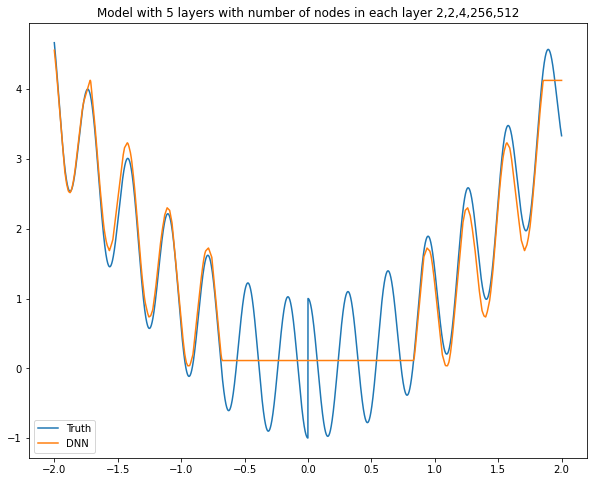

Model: "sequential_215"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1270 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1271 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1272 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1273 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1274 (Dense)           (None, 1024)              263168    
_________________________________________________________________
dense_1275 (Dense)           (None, 1)                 1025      
Total params: 265,495
Trainable params: 265,495
Non-trainable params: 0
______________________________________________

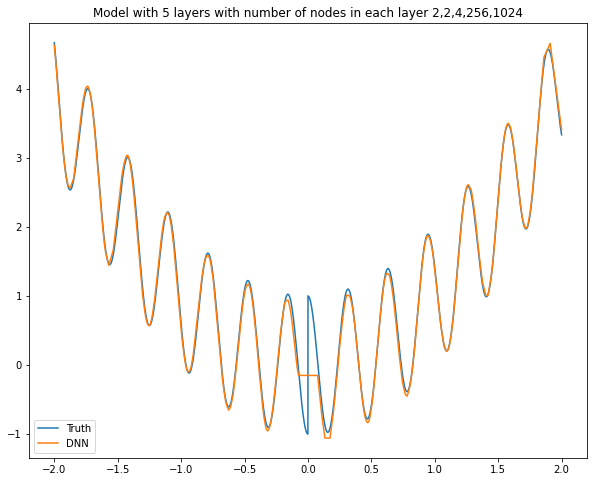

Model: "sequential_216"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1276 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1277 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1278 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1279 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1280 (Dense)           (None, 2048)              526336    
_________________________________________________________________
dense_1281 (Dense)           (None, 1)                 2049      
Total params: 529,687
Trainable params: 529,687
Non-trainable params: 0
______________________________________________

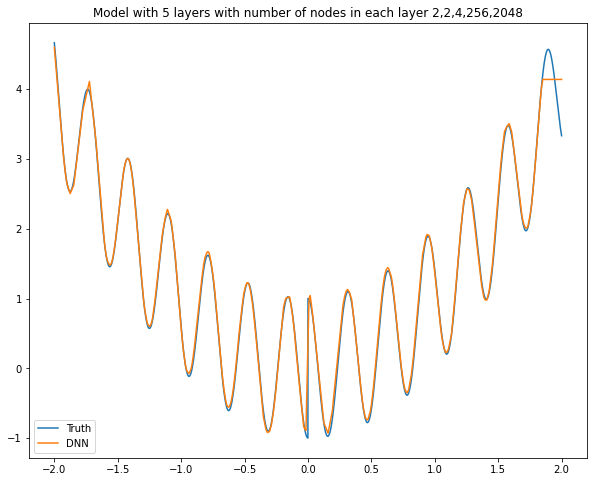

Model: "sequential_217"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1282 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1283 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1284 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1285 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1286 (Dense)           (None, 2)                 1026      
_________________________________________________________________
dense_1287 (Dense)           (None, 1)                 3         
Total params: 3,611
Trainable params: 3,611
Non-trainable params: 0
__________________________________________________

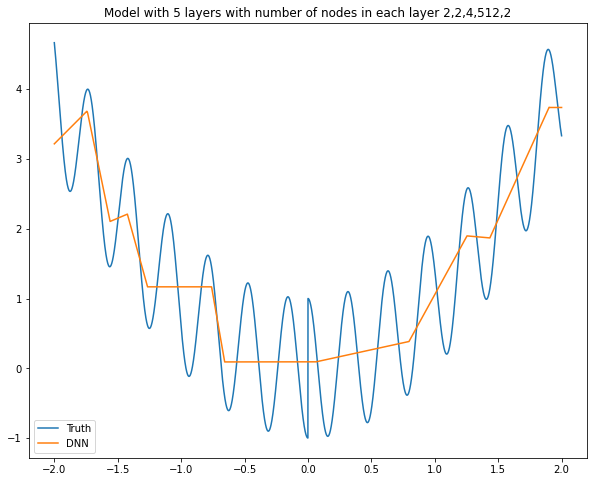

Model: "sequential_218"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1288 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1289 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1290 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1291 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1292 (Dense)           (None, 4)                 2052      
_________________________________________________________________
dense_1293 (Dense)           (None, 1)                 5         
Total params: 4,639
Trainable params: 4,639
Non-trainable params: 0
__________________________________________________

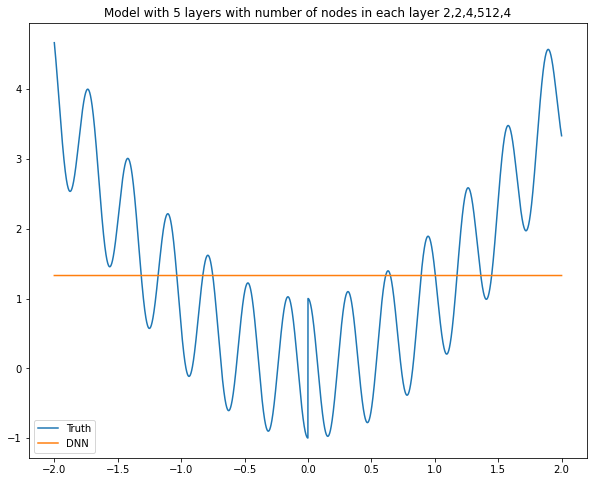

Model: "sequential_219"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1294 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1295 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1296 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1297 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1298 (Dense)           (None, 8)                 4104      
_________________________________________________________________
dense_1299 (Dense)           (None, 1)                 9         
Total params: 6,695
Trainable params: 6,695
Non-trainable params: 0
__________________________________________________

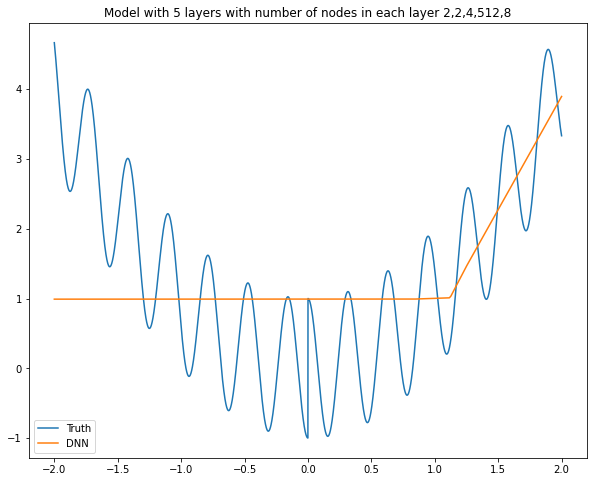

Model: "sequential_220"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1300 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1301 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1302 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1303 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1304 (Dense)           (None, 16)                8208      
_________________________________________________________________
dense_1305 (Dense)           (None, 1)                 17        
Total params: 10,807
Trainable params: 10,807
Non-trainable params: 0
________________________________________________

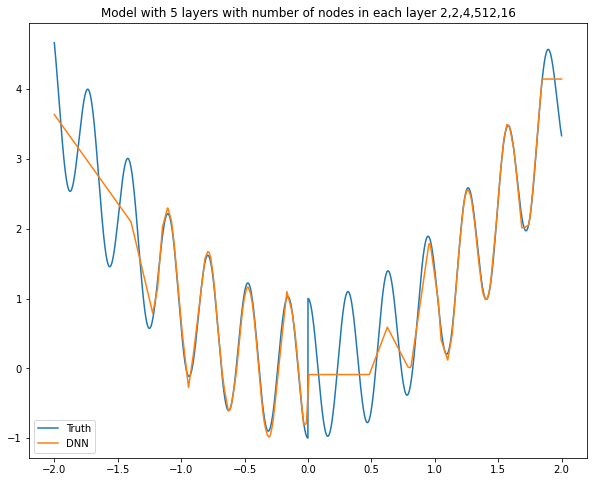

Model: "sequential_221"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1306 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1307 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1308 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1309 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1310 (Dense)           (None, 32)                16416     
_________________________________________________________________
dense_1311 (Dense)           (None, 1)                 33        
Total params: 19,031
Trainable params: 19,031
Non-trainable params: 0
________________________________________________

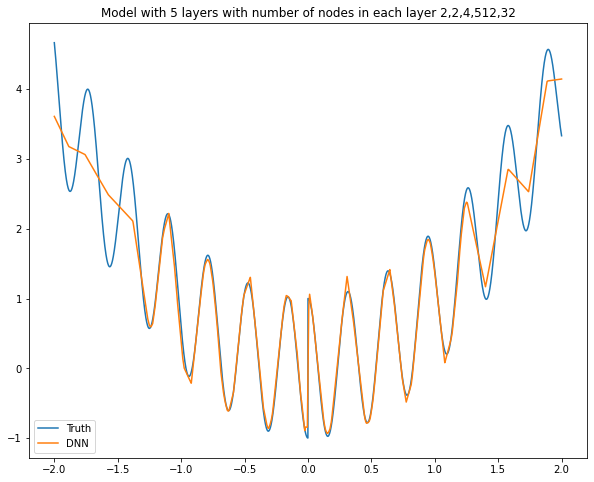

Model: "sequential_222"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1312 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1313 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1314 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1315 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1316 (Dense)           (None, 64)                32832     
_________________________________________________________________
dense_1317 (Dense)           (None, 1)                 65        
Total params: 35,479
Trainable params: 35,479
Non-trainable params: 0
________________________________________________

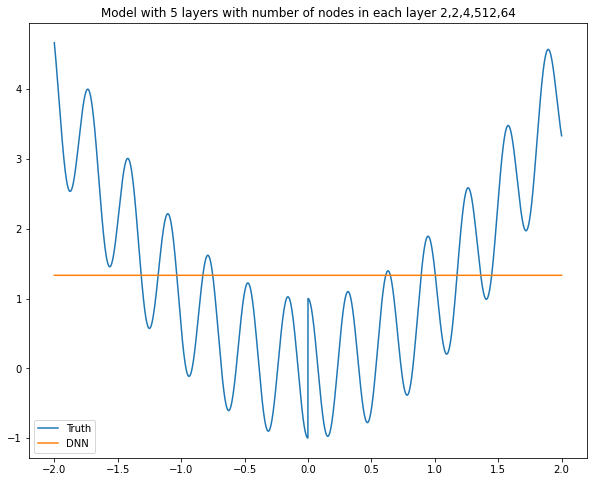

Model: "sequential_223"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1318 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1319 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1320 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1321 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1322 (Dense)           (None, 128)               65664     
_________________________________________________________________
dense_1323 (Dense)           (None, 1)                 129       
Total params: 68,375
Trainable params: 68,375
Non-trainable params: 0
________________________________________________

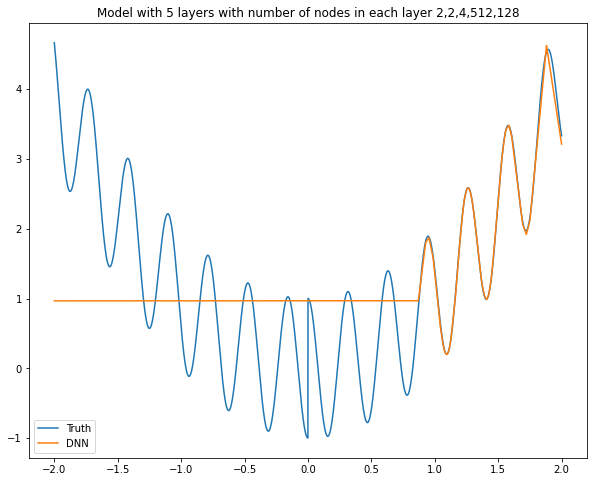

Model: "sequential_224"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1324 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1325 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1326 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1327 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1328 (Dense)           (None, 256)               131328    
_________________________________________________________________
dense_1329 (Dense)           (None, 1)                 257       
Total params: 134,167
Trainable params: 134,167
Non-trainable params: 0
______________________________________________

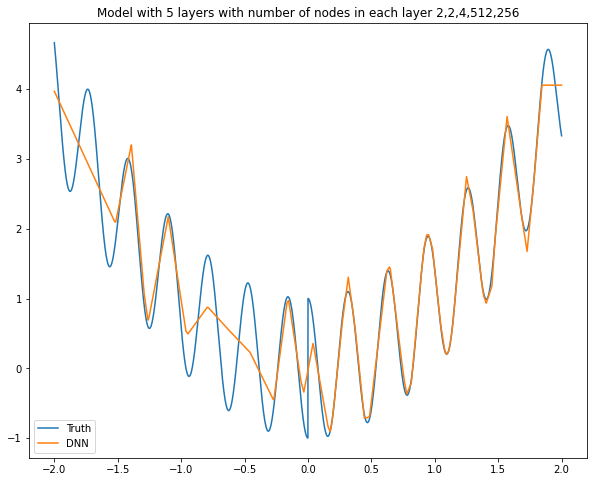

Model: "sequential_225"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1330 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1331 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1332 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1333 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1334 (Dense)           (None, 512)               262656    
_________________________________________________________________
dense_1335 (Dense)           (None, 1)                 513       
Total params: 265,751
Trainable params: 265,751
Non-trainable params: 0
______________________________________________

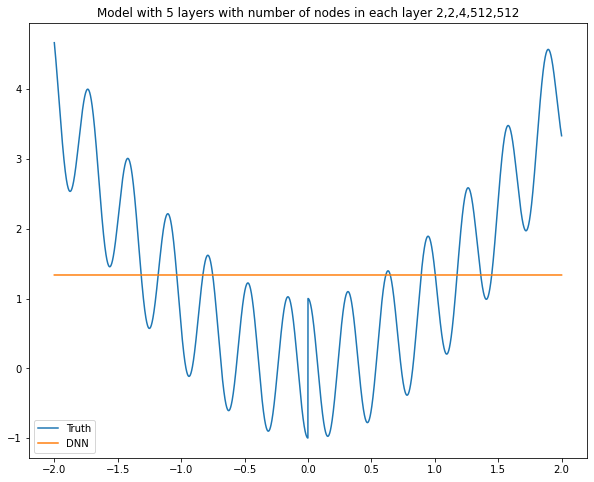

Model: "sequential_226"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1336 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1337 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1338 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1339 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1340 (Dense)           (None, 1024)              525312    
_________________________________________________________________
dense_1341 (Dense)           (None, 1)                 1025      
Total params: 528,919
Trainable params: 528,919
Non-trainable params: 0
______________________________________________

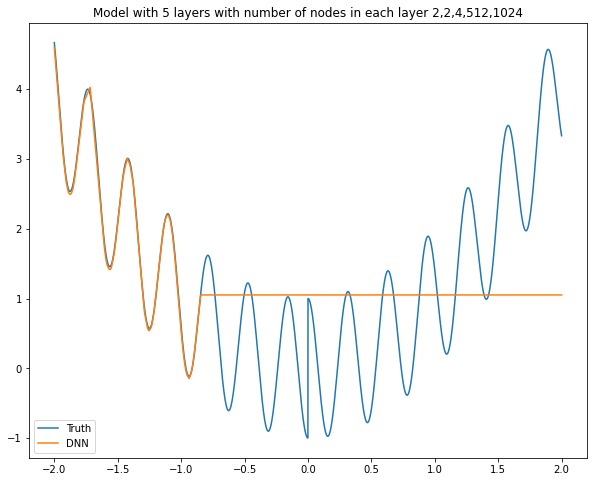

Model: "sequential_227"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1342 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1343 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1344 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1345 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1346 (Dense)           (None, 2048)              1050624   
_________________________________________________________________
dense_1347 (Dense)           (None, 1)                 2049      
Total params: 1,055,255
Trainable params: 1,055,255
Non-trainable params: 0
__________________________________________

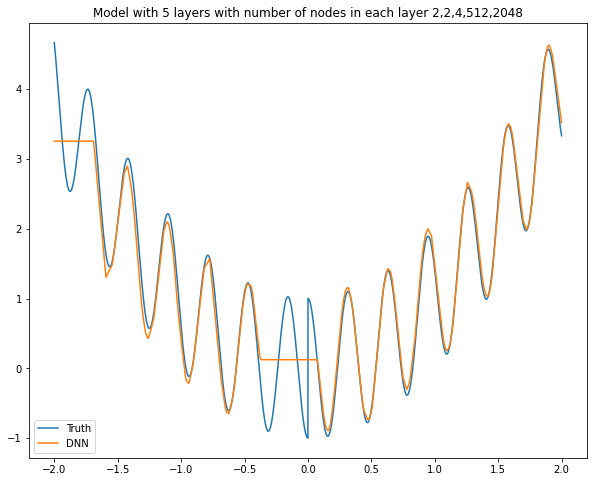

Model: "sequential_228"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1348 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1349 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1350 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1351 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1352 (Dense)           (None, 2)                 2050      
_________________________________________________________________
dense_1353 (Dense)           (None, 1)                 3         
Total params: 7,195
Trainable params: 7,195
Non-trainable params: 0
__________________________________________________

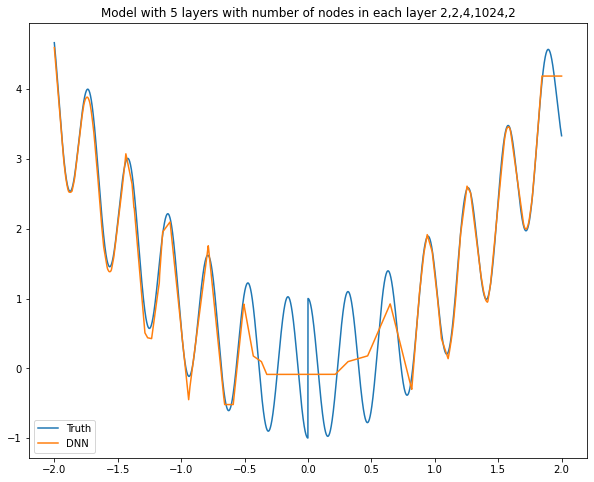

Model: "sequential_229"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1354 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1355 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1356 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1357 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1358 (Dense)           (None, 4)                 4100      
_________________________________________________________________
dense_1359 (Dense)           (None, 1)                 5         
Total params: 9,247
Trainable params: 9,247
Non-trainable params: 0
__________________________________________________

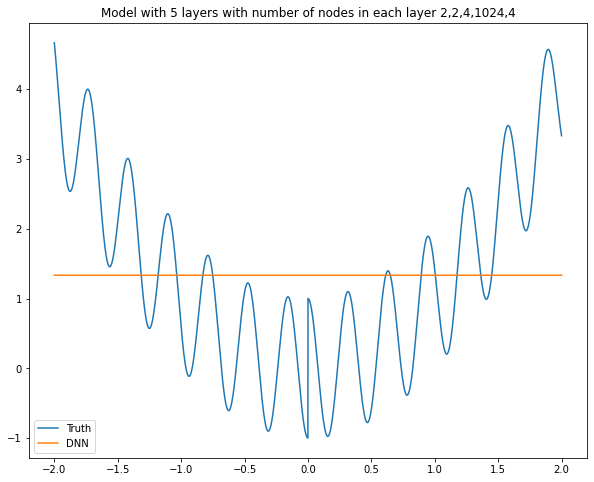

Model: "sequential_230"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1360 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1361 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1362 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1363 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1364 (Dense)           (None, 8)                 8200      
_________________________________________________________________
dense_1365 (Dense)           (None, 1)                 9         
Total params: 13,351
Trainable params: 13,351
Non-trainable params: 0
________________________________________________

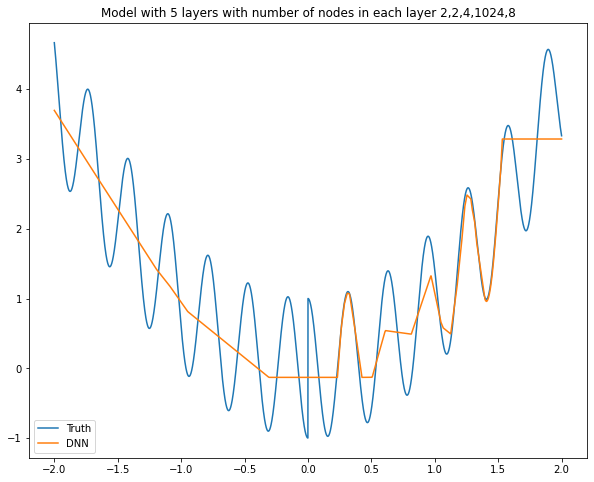

Model: "sequential_231"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1366 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1367 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1368 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1369 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1370 (Dense)           (None, 16)                16400     
_________________________________________________________________
dense_1371 (Dense)           (None, 1)                 17        
Total params: 21,559
Trainable params: 21,559
Non-trainable params: 0
________________________________________________

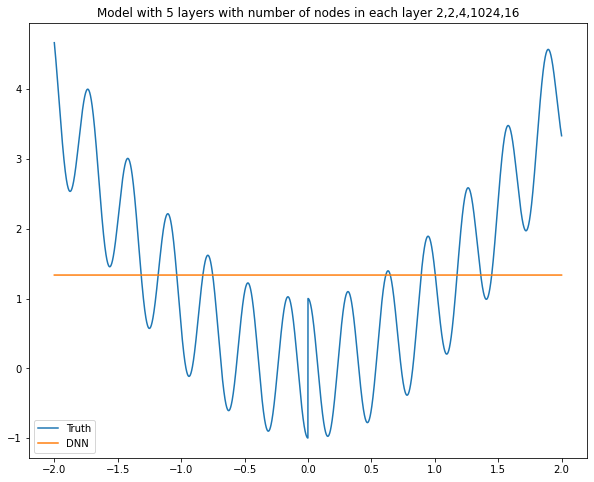

Model: "sequential_232"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1372 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1373 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1374 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1375 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1376 (Dense)           (None, 32)                32800     
_________________________________________________________________
dense_1377 (Dense)           (None, 1)                 33        
Total params: 37,975
Trainable params: 37,975
Non-trainable params: 0
________________________________________________

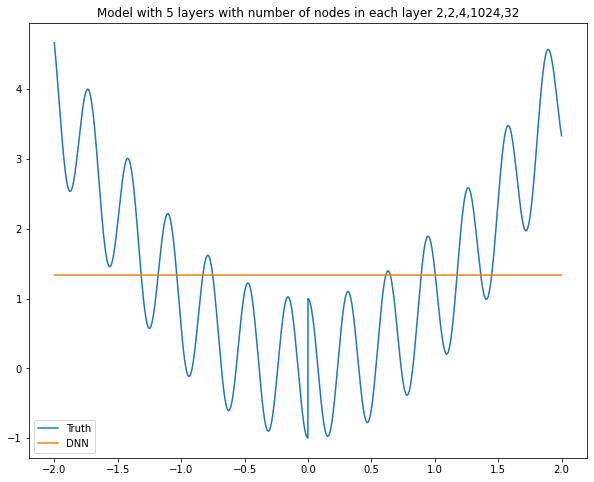

Model: "sequential_233"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1378 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1379 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1380 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1381 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1382 (Dense)           (None, 64)                65600     
_________________________________________________________________
dense_1383 (Dense)           (None, 1)                 65        
Total params: 70,807
Trainable params: 70,807
Non-trainable params: 0
________________________________________________

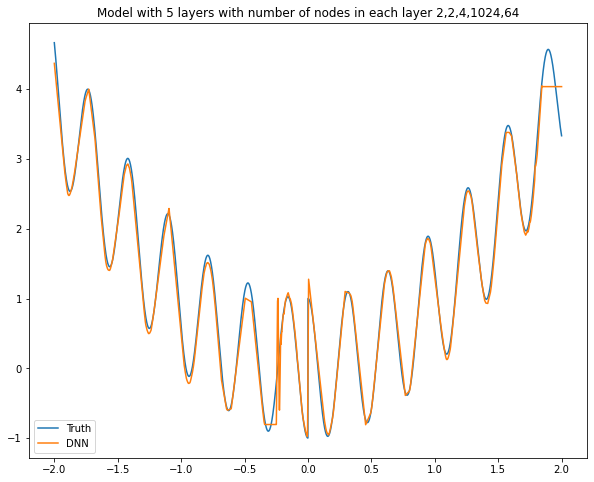

Model: "sequential_234"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1384 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1385 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1386 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1387 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1388 (Dense)           (None, 128)               131200    
_________________________________________________________________
dense_1389 (Dense)           (None, 1)                 129       
Total params: 136,471
Trainable params: 136,471
Non-trainable params: 0
______________________________________________

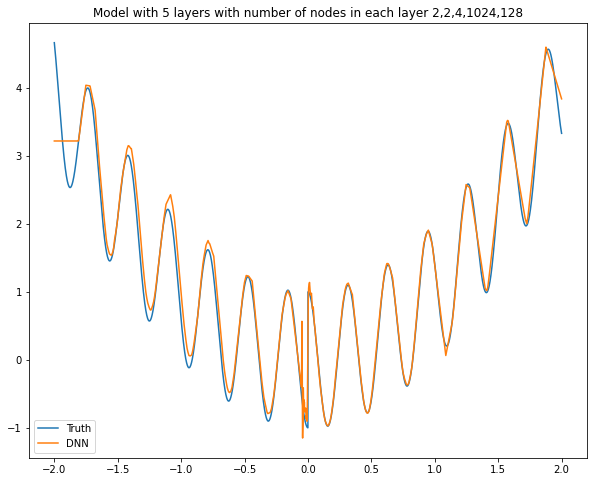

Model: "sequential_235"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1390 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1391 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1392 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1393 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1394 (Dense)           (None, 256)               262400    
_________________________________________________________________
dense_1395 (Dense)           (None, 1)                 257       
Total params: 267,799
Trainable params: 267,799
Non-trainable params: 0
______________________________________________

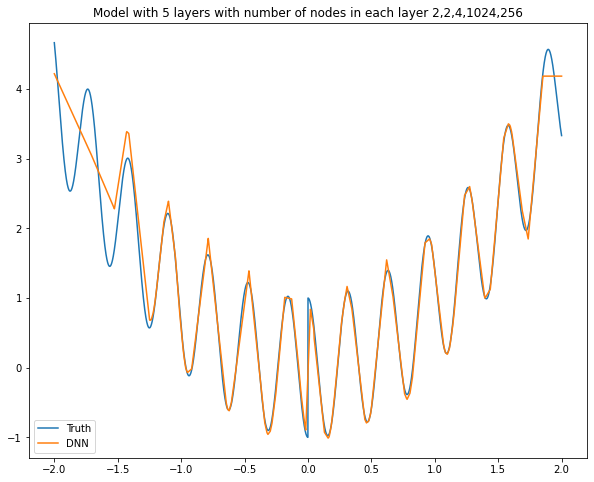

Model: "sequential_236"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1396 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1397 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1398 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1399 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1400 (Dense)           (None, 512)               524800    
_________________________________________________________________
dense_1401 (Dense)           (None, 1)                 513       
Total params: 530,455
Trainable params: 530,455
Non-trainable params: 0
______________________________________________

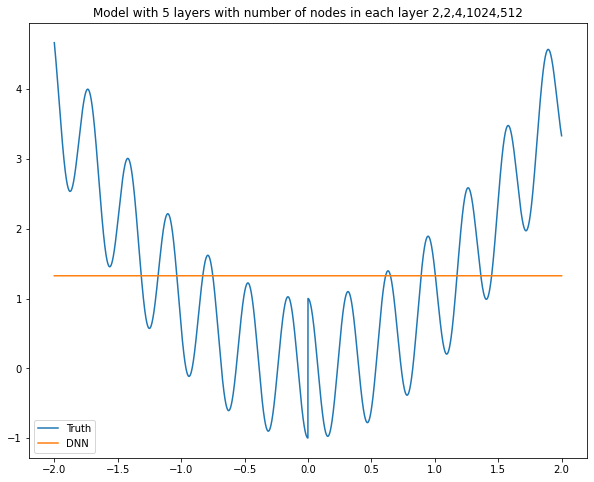

Model: "sequential_237"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1402 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1403 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1404 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1405 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1406 (Dense)           (None, 1024)              1049600   
_________________________________________________________________
dense_1407 (Dense)           (None, 1)                 1025      
Total params: 1,055,767
Trainable params: 1,055,767
Non-trainable params: 0
__________________________________________

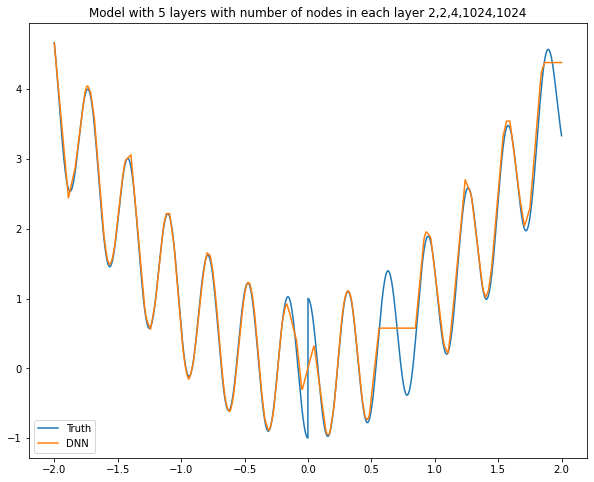

Model: "sequential_238"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1408 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1409 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1410 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1411 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1412 (Dense)           (None, 2048)              2099200   
_________________________________________________________________
dense_1413 (Dense)           (None, 1)                 2049      
Total params: 2,106,391
Trainable params: 2,106,391
Non-trainable params: 0
__________________________________________

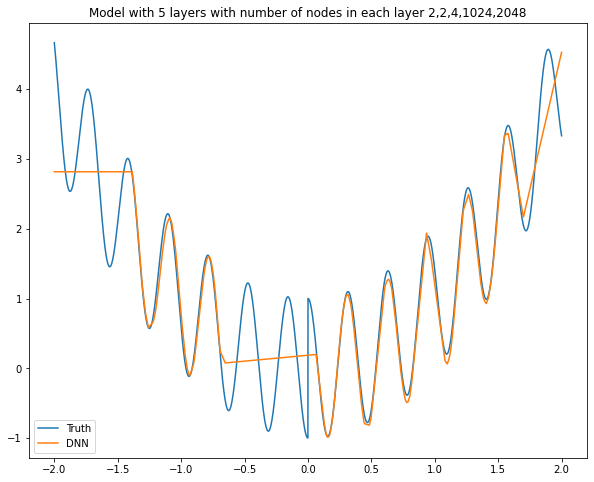

Model: "sequential_239"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1414 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1415 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1416 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1417 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1418 (Dense)           (None, 2)                 4098      
_________________________________________________________________
dense_1419 (Dense)           (None, 1)                 3         
Total params: 14,363
Trainable params: 14,363
Non-trainable params: 0
________________________________________________

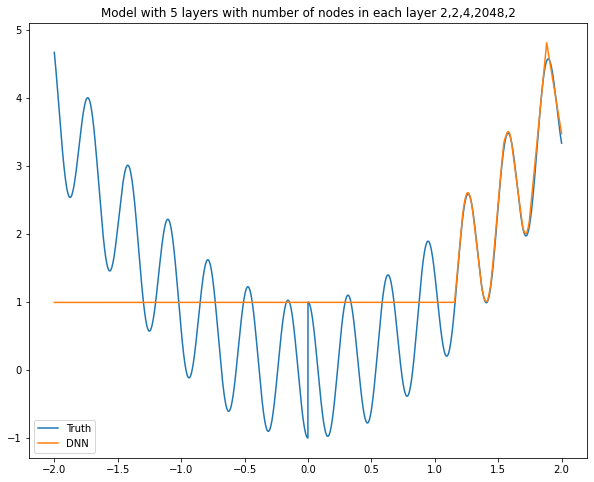

Model: "sequential_240"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1420 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1421 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1422 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1423 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1424 (Dense)           (None, 4)                 8196      
_________________________________________________________________
dense_1425 (Dense)           (None, 1)                 5         
Total params: 18,463
Trainable params: 18,463
Non-trainable params: 0
________________________________________________

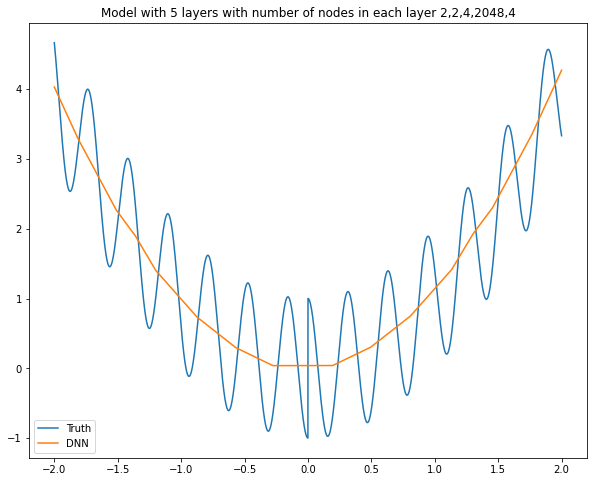

Model: "sequential_241"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1426 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1427 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1428 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1429 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1430 (Dense)           (None, 8)                 16392     
_________________________________________________________________
dense_1431 (Dense)           (None, 1)                 9         
Total params: 26,663
Trainable params: 26,663
Non-trainable params: 0
________________________________________________

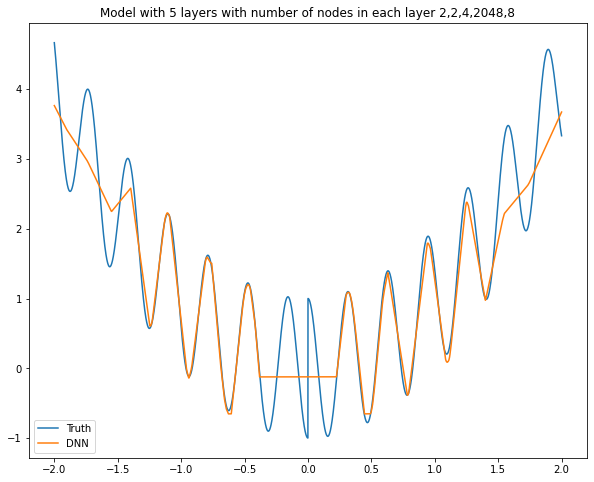

Model: "sequential_242"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1432 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1433 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1434 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1435 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1436 (Dense)           (None, 16)                32784     
_________________________________________________________________
dense_1437 (Dense)           (None, 1)                 17        
Total params: 43,063
Trainable params: 43,063
Non-trainable params: 0
________________________________________________

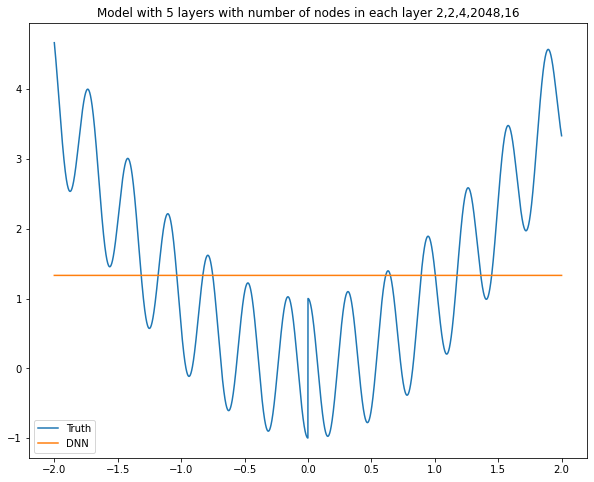

Model: "sequential_243"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1438 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1439 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1440 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1441 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1442 (Dense)           (None, 32)                65568     
_________________________________________________________________
dense_1443 (Dense)           (None, 1)                 33        
Total params: 75,863
Trainable params: 75,863
Non-trainable params: 0
________________________________________________

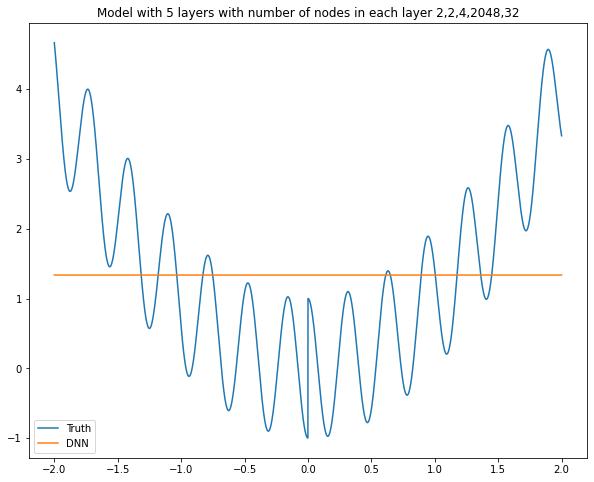

Model: "sequential_244"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1444 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1445 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1446 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1447 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1448 (Dense)           (None, 64)                131136    
_________________________________________________________________
dense_1449 (Dense)           (None, 1)                 65        
Total params: 141,463
Trainable params: 141,463
Non-trainable params: 0
______________________________________________

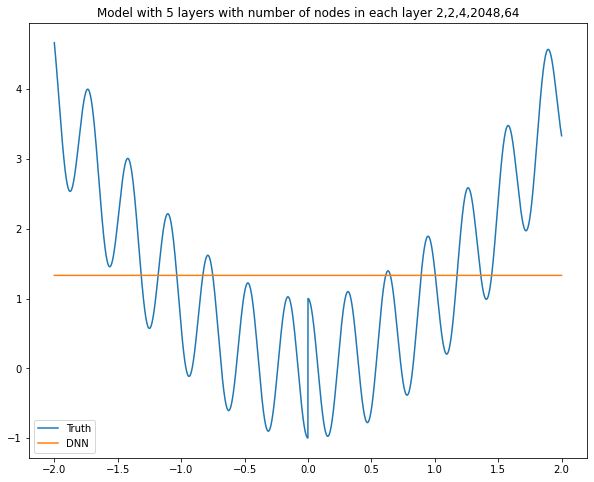

Model: "sequential_245"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1450 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1451 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1452 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1453 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1454 (Dense)           (None, 128)               262272    
_________________________________________________________________
dense_1455 (Dense)           (None, 1)                 129       
Total params: 272,663
Trainable params: 272,663
Non-trainable params: 0
______________________________________________

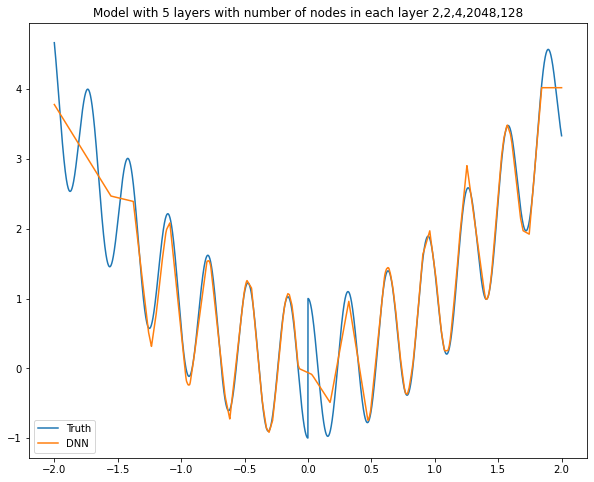

Model: "sequential_246"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1456 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1457 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1458 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1459 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1460 (Dense)           (None, 256)               524544    
_________________________________________________________________
dense_1461 (Dense)           (None, 1)                 257       
Total params: 535,063
Trainable params: 535,063
Non-trainable params: 0
______________________________________________

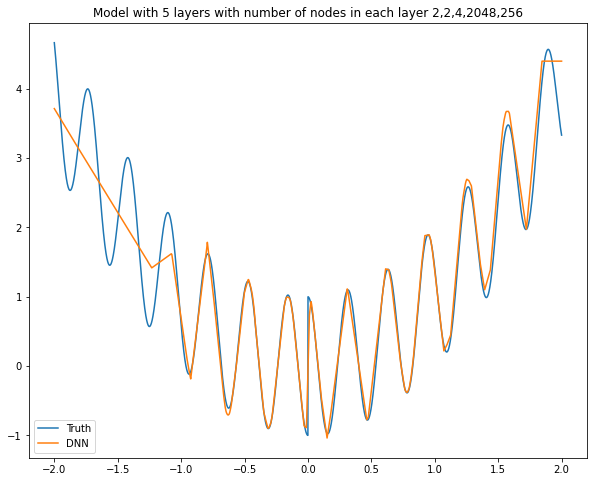

Model: "sequential_247"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1462 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1463 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1464 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1465 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1466 (Dense)           (None, 512)               1049088   
_________________________________________________________________
dense_1467 (Dense)           (None, 1)                 513       
Total params: 1,059,863
Trainable params: 1,059,863
Non-trainable params: 0
__________________________________________

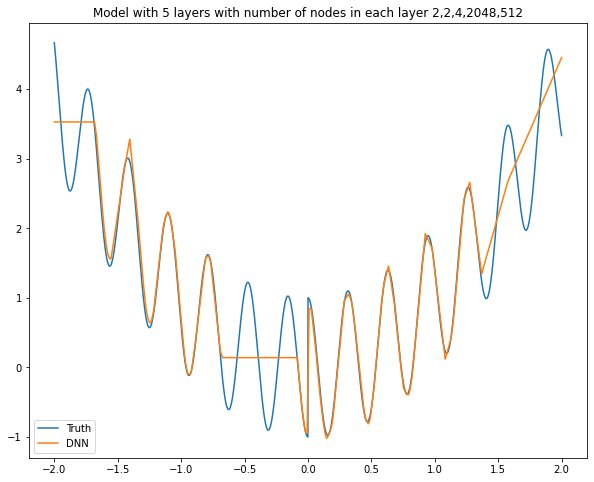

Model: "sequential_248"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1468 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1469 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1470 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1471 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1472 (Dense)           (None, 1024)              2098176   
_________________________________________________________________
dense_1473 (Dense)           (None, 1)                 1025      
Total params: 2,109,463
Trainable params: 2,109,463
Non-trainable params: 0
__________________________________________

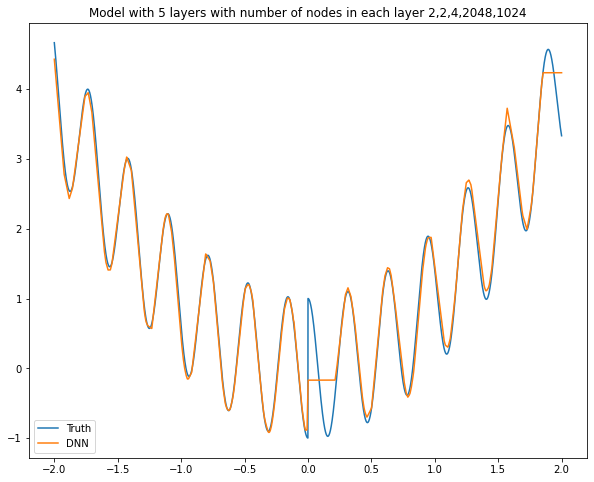

Model: "sequential_249"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1474 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1475 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1476 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1477 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1478 (Dense)           (None, 2048)              4196352   
_________________________________________________________________
dense_1479 (Dense)           (None, 1)                 2049      
Total params: 4,208,663
Trainable params: 4,208,663
Non-trainable params: 0
__________________________________________

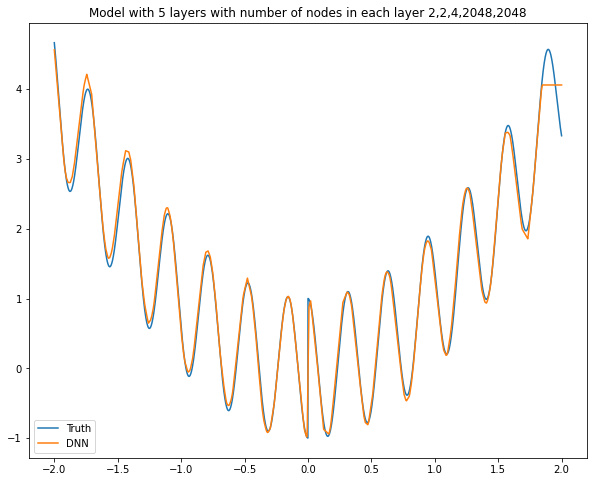

Model: "sequential_250"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1480 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1481 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1482 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1483 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1484 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1485 (Dense)           (None, 1)                 3         
Total params: 61
Trainable params: 61
Non-trainable params: 0
________________________________________________________

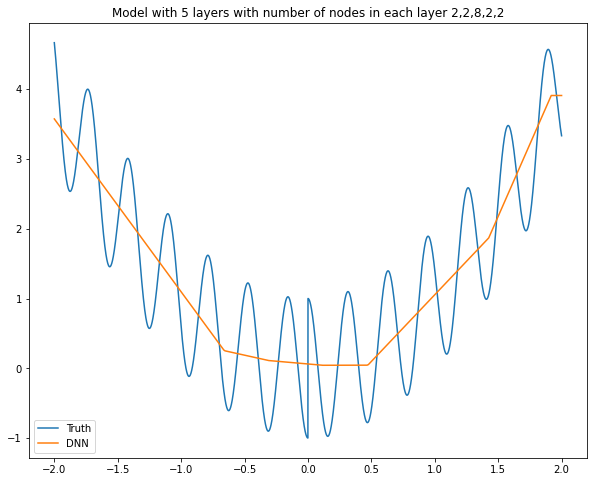

Model: "sequential_251"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1486 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1487 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1488 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1489 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1490 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_1491 (Dense)           (None, 1)                 5         
Total params: 69
Trainable params: 69
Non-trainable params: 0
________________________________________________________

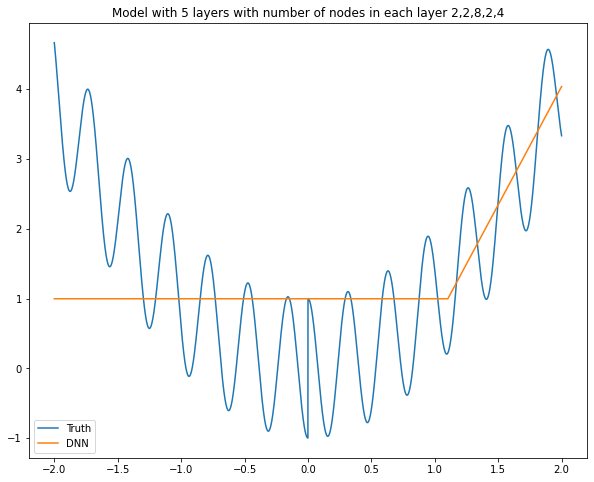

Model: "sequential_252"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1492 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1493 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1494 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1495 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1496 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1497 (Dense)           (None, 1)                 9         
Total params: 85
Trainable params: 85
Non-trainable params: 0
________________________________________________________

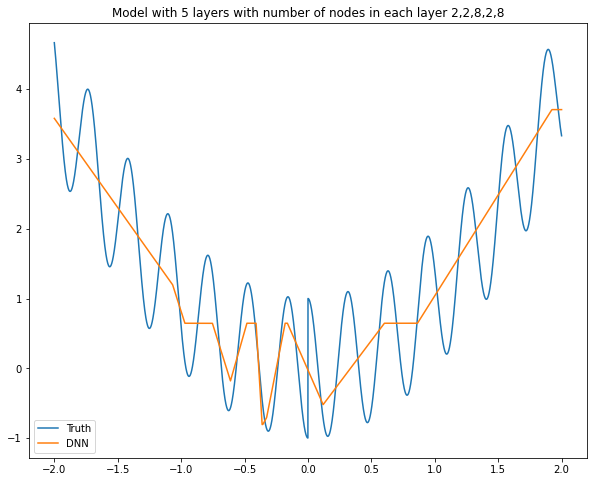

Model: "sequential_253"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1498 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1499 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1500 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1501 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1502 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_1503 (Dense)           (None, 1)                 17        
Total params: 117
Trainable params: 117
Non-trainable params: 0
______________________________________________________

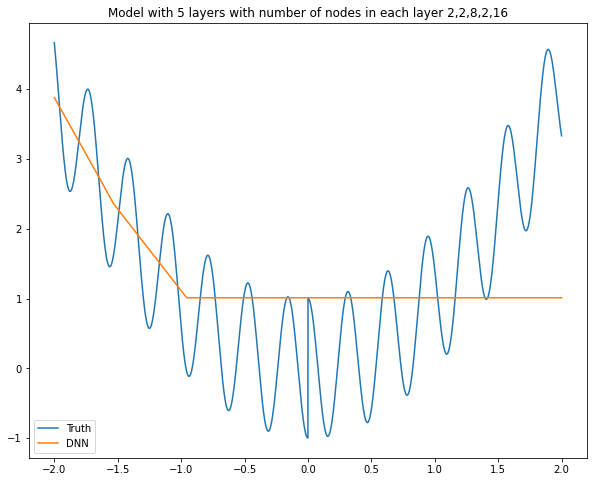

Model: "sequential_254"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1504 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1505 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1506 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1507 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1508 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_1509 (Dense)           (None, 1)                 33        
Total params: 181
Trainable params: 181
Non-trainable params: 0
______________________________________________________

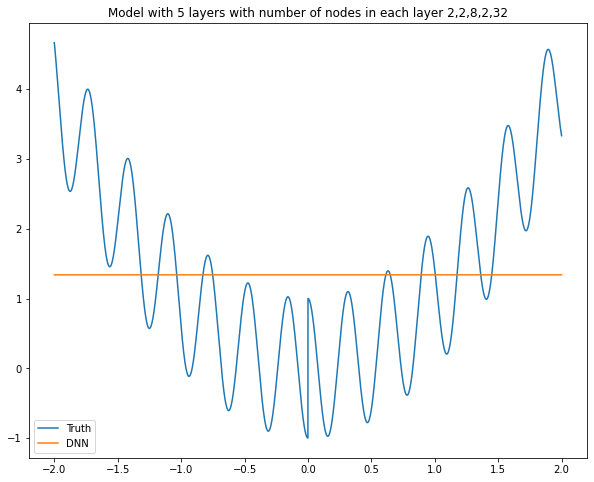

Model: "sequential_255"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1510 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1511 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1512 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1513 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1514 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_1515 (Dense)           (None, 1)                 65        
Total params: 309
Trainable params: 309
Non-trainable params: 0
______________________________________________________

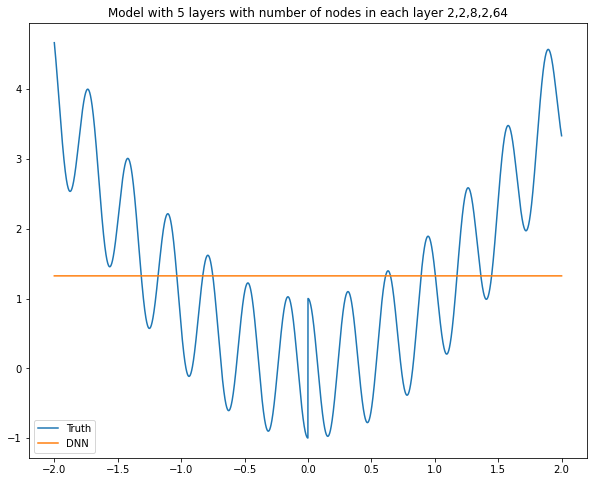

Model: "sequential_256"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1516 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1517 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1518 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1519 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1520 (Dense)           (None, 128)               384       
_________________________________________________________________
dense_1521 (Dense)           (None, 1)                 129       
Total params: 565
Trainable params: 565
Non-trainable params: 0
______________________________________________________

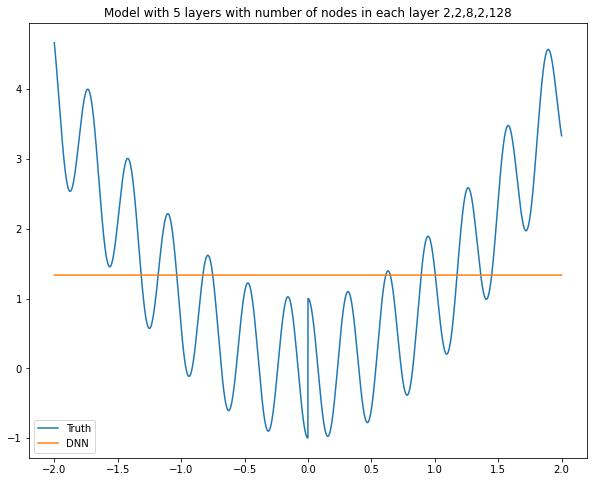

Model: "sequential_257"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1522 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1523 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1524 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1525 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1526 (Dense)           (None, 256)               768       
_________________________________________________________________
dense_1527 (Dense)           (None, 1)                 257       
Total params: 1,077
Trainable params: 1,077
Non-trainable params: 0
__________________________________________________

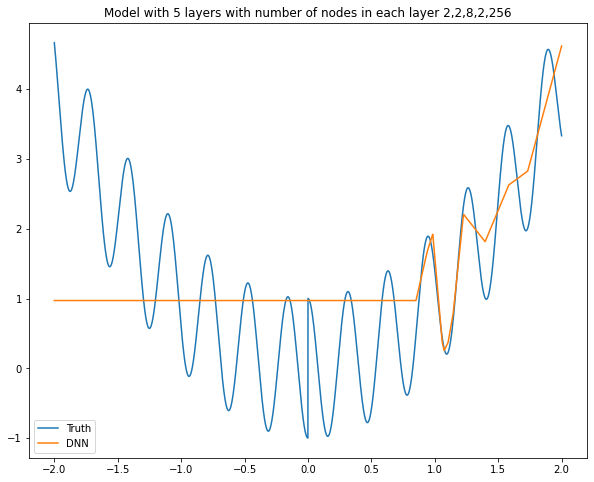

Model: "sequential_258"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1528 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1529 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1530 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1531 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1532 (Dense)           (None, 512)               1536      
_________________________________________________________________
dense_1533 (Dense)           (None, 1)                 513       
Total params: 2,101
Trainable params: 2,101
Non-trainable params: 0
__________________________________________________

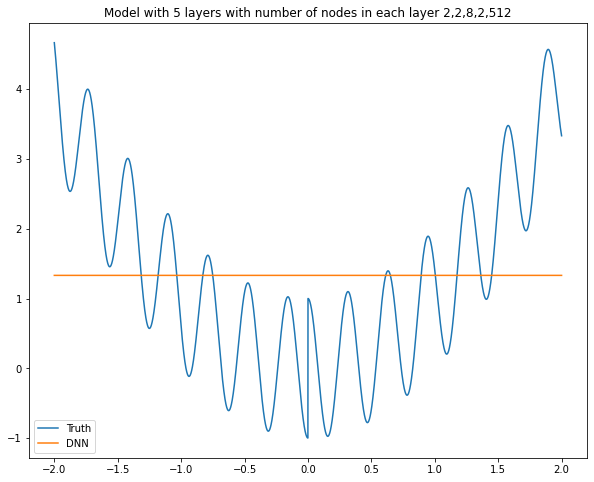

Model: "sequential_259"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1534 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1535 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1536 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1537 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1538 (Dense)           (None, 1024)              3072      
_________________________________________________________________
dense_1539 (Dense)           (None, 1)                 1025      
Total params: 4,149
Trainable params: 4,149
Non-trainable params: 0
__________________________________________________

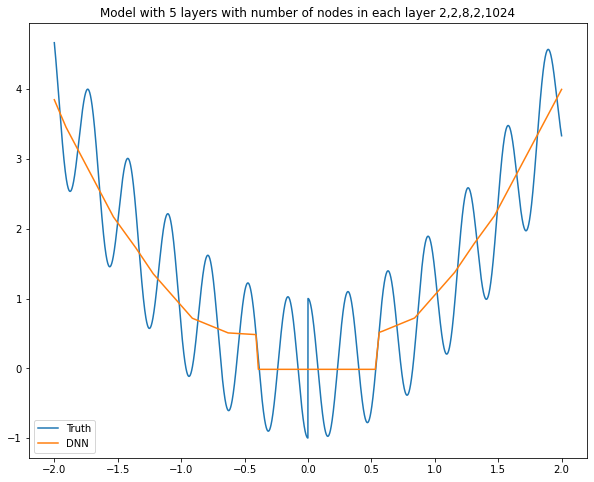

Model: "sequential_260"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1540 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1541 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1542 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1543 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1544 (Dense)           (None, 2048)              6144      
_________________________________________________________________
dense_1545 (Dense)           (None, 1)                 2049      
Total params: 8,245
Trainable params: 8,245
Non-trainable params: 0
__________________________________________________

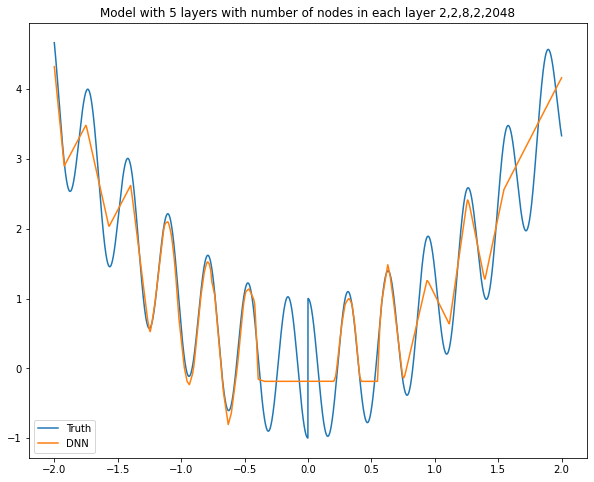

Model: "sequential_261"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1546 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1547 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1548 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1549 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1550 (Dense)           (None, 2)                 10        
_________________________________________________________________
dense_1551 (Dense)           (None, 1)                 3         
Total params: 83
Trainable params: 83
Non-trainable params: 0
________________________________________________________

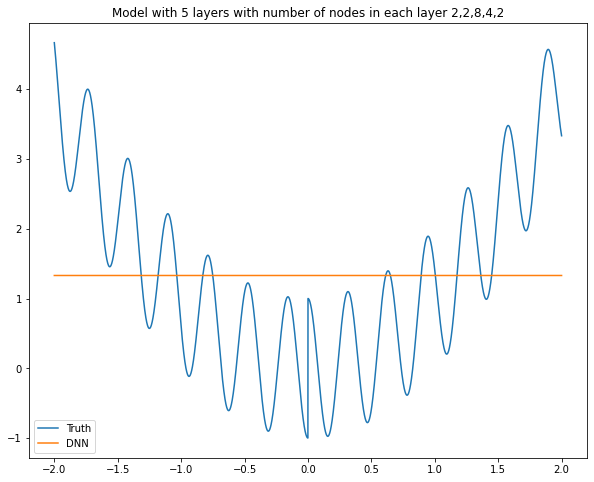

Model: "sequential_262"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1552 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1553 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1554 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1555 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1556 (Dense)           (None, 4)                 20        
_________________________________________________________________
dense_1557 (Dense)           (None, 1)                 5         
Total params: 95
Trainable params: 95
Non-trainable params: 0
________________________________________________________

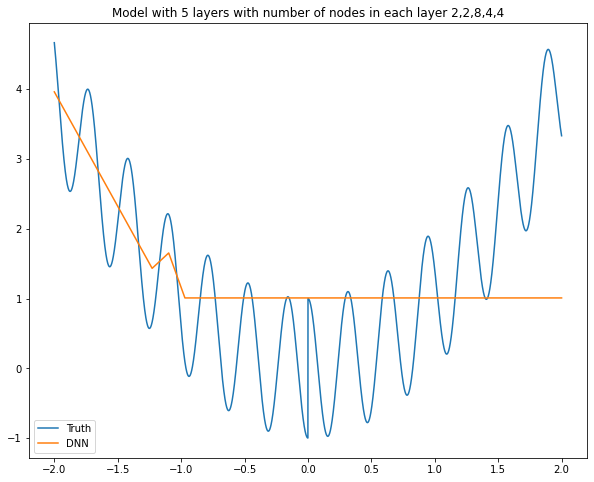

Model: "sequential_263"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1558 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1559 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1560 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1561 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1562 (Dense)           (None, 8)                 40        
_________________________________________________________________
dense_1563 (Dense)           (None, 1)                 9         
Total params: 119
Trainable params: 119
Non-trainable params: 0
______________________________________________________

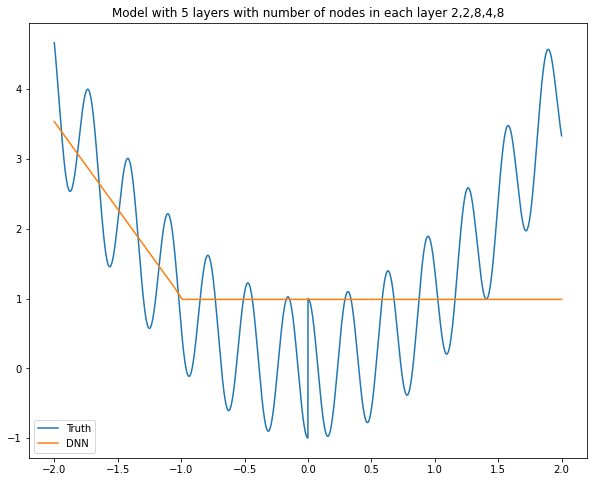

Model: "sequential_264"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1564 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1565 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1566 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1567 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1568 (Dense)           (None, 16)                80        
_________________________________________________________________
dense_1569 (Dense)           (None, 1)                 17        
Total params: 167
Trainable params: 167
Non-trainable params: 0
______________________________________________________

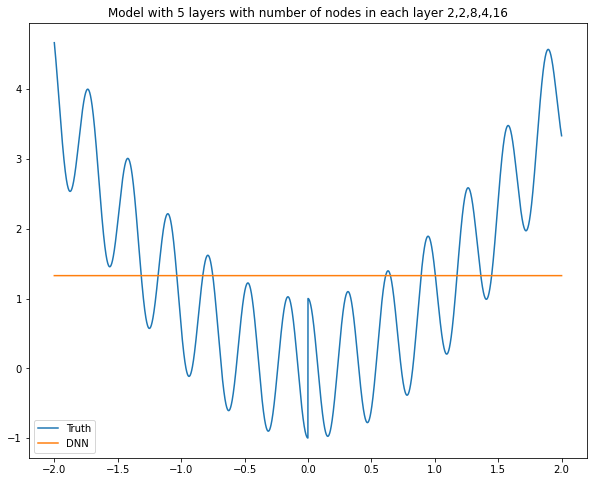

Model: "sequential_265"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1570 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1571 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1572 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1573 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1574 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_1575 (Dense)           (None, 1)                 33        
Total params: 263
Trainable params: 263
Non-trainable params: 0
______________________________________________________

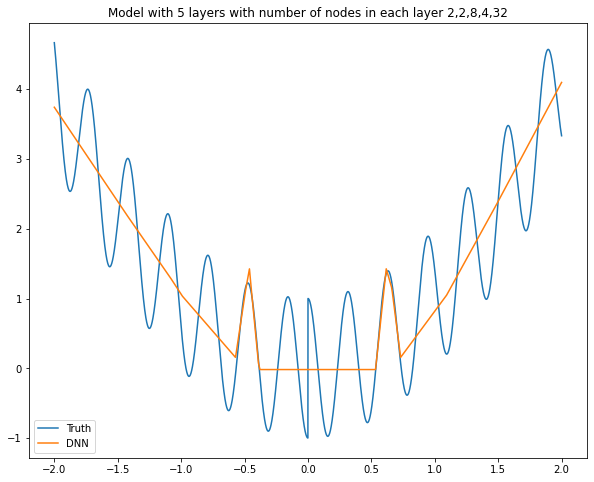

Model: "sequential_266"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1576 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1577 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1578 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1579 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1580 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_1581 (Dense)           (None, 1)                 65        
Total params: 455
Trainable params: 455
Non-trainable params: 0
______________________________________________________

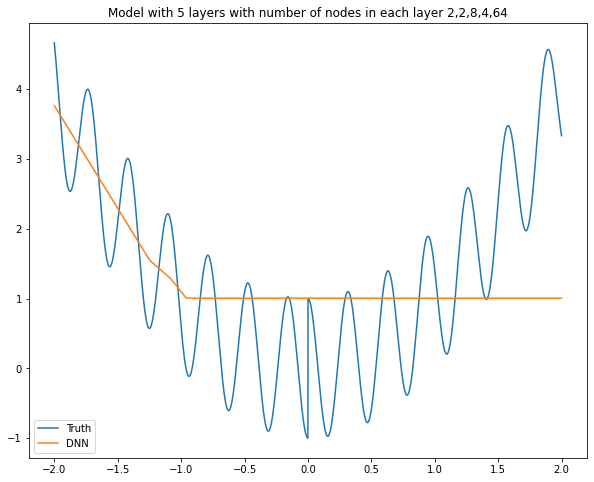

Model: "sequential_267"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1582 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1583 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1584 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1585 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1586 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_1587 (Dense)           (None, 1)                 129       
Total params: 839
Trainable params: 839
Non-trainable params: 0
______________________________________________________

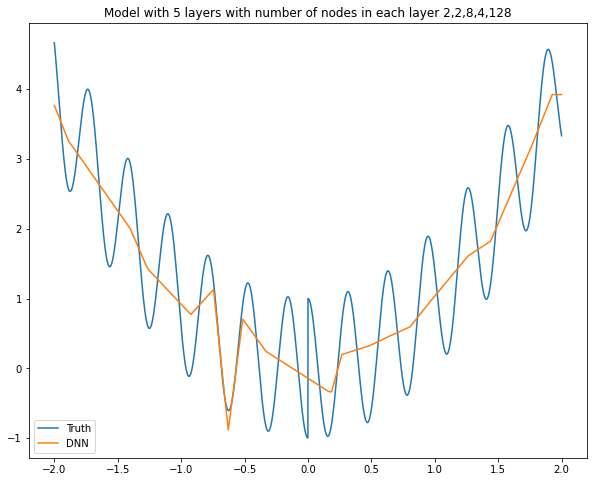

Model: "sequential_268"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1588 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1589 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1590 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1591 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1592 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_1593 (Dense)           (None, 1)                 257       
Total params: 1,607
Trainable params: 1,607
Non-trainable params: 0
__________________________________________________

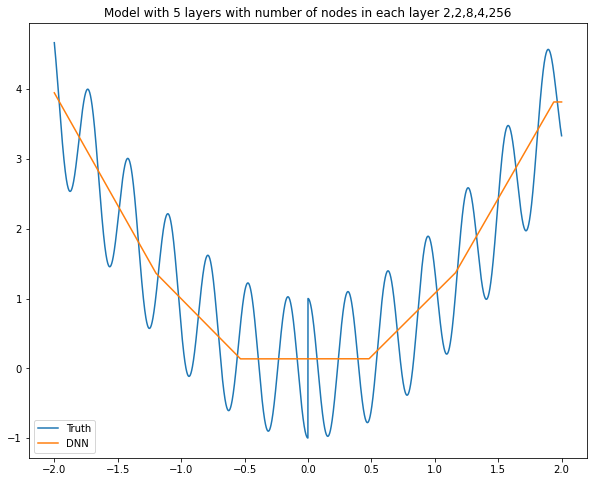

Model: "sequential_269"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1594 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1595 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1596 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1597 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1598 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_1599 (Dense)           (None, 1)                 513       
Total params: 3,143
Trainable params: 3,143
Non-trainable params: 0
__________________________________________________

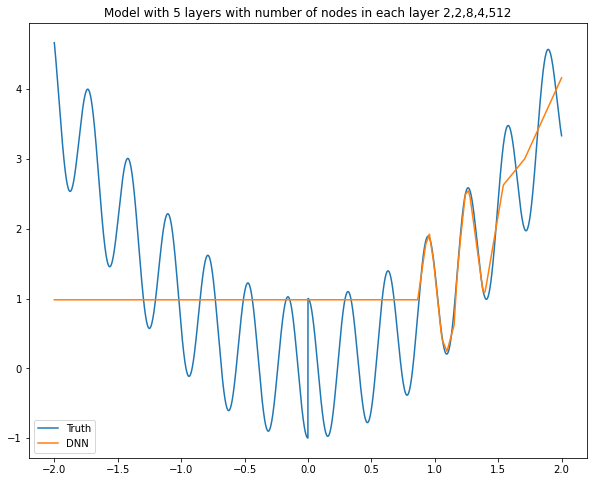

Model: "sequential_270"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1600 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1601 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1602 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1603 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1604 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_1605 (Dense)           (None, 1)                 1025      
Total params: 6,215
Trainable params: 6,215
Non-trainable params: 0
__________________________________________________

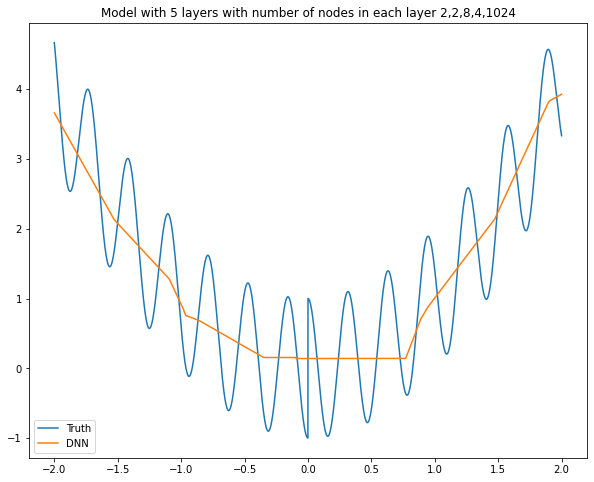

Model: "sequential_271"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1606 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1607 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1608 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1609 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1610 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_1611 (Dense)           (None, 1)                 2049      
Total params: 12,359
Trainable params: 12,359
Non-trainable params: 0
________________________________________________

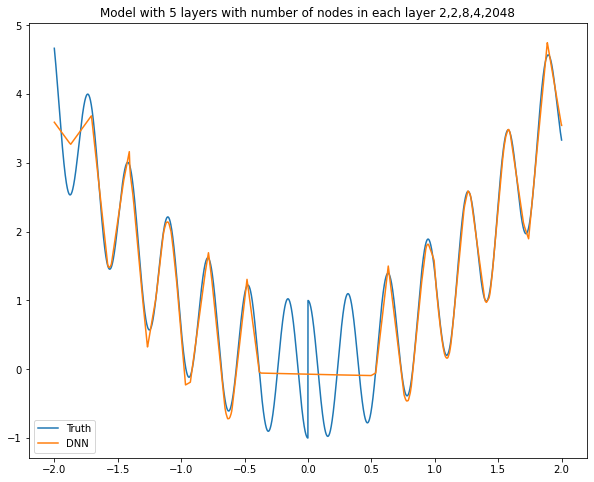

Model: "sequential_272"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1612 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1613 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1614 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1615 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1616 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_1617 (Dense)           (None, 1)                 3         
Total params: 127
Trainable params: 127
Non-trainable params: 0
______________________________________________________

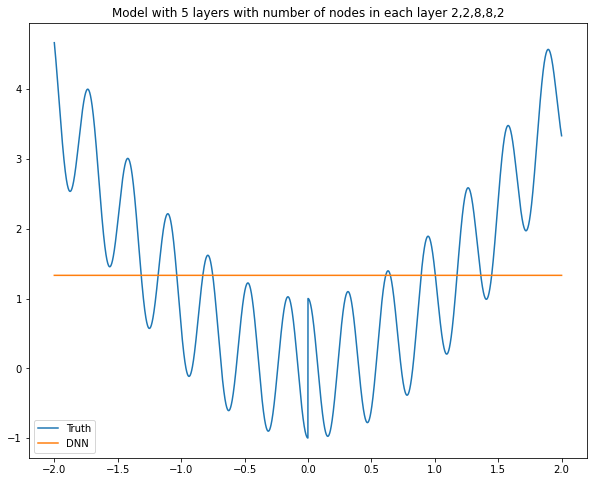

Model: "sequential_273"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1618 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1619 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1620 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1621 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1622 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_1623 (Dense)           (None, 1)                 5         
Total params: 147
Trainable params: 147
Non-trainable params: 0
______________________________________________________

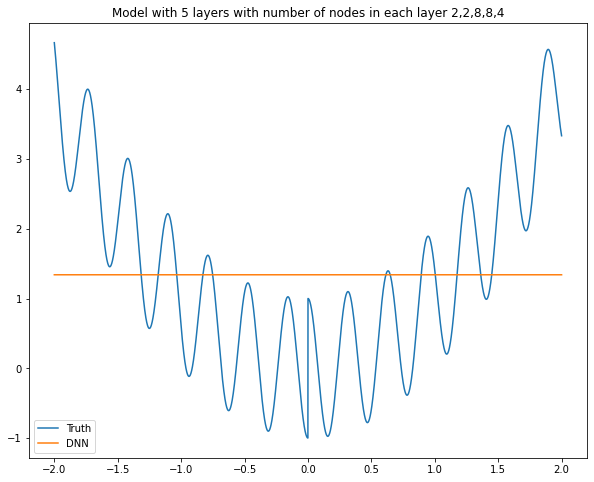

Model: "sequential_274"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1624 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1625 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1626 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1627 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1628 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1629 (Dense)           (None, 1)                 9         
Total params: 187
Trainable params: 187
Non-trainable params: 0
______________________________________________________

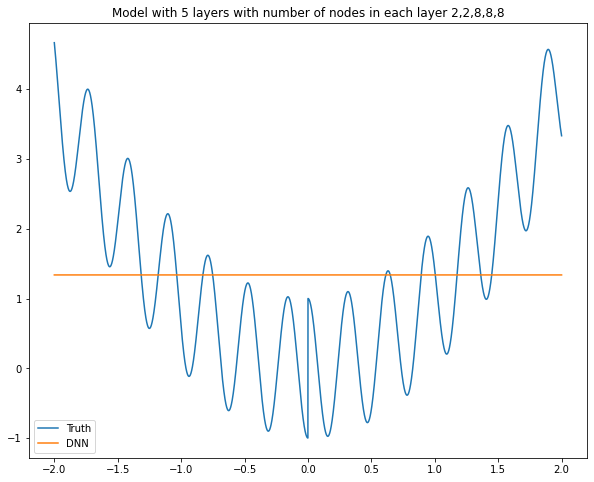

Model: "sequential_275"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1630 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1631 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1632 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1633 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1634 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1635 (Dense)           (None, 1)                 17        
Total params: 267
Trainable params: 267
Non-trainable params: 0
______________________________________________________

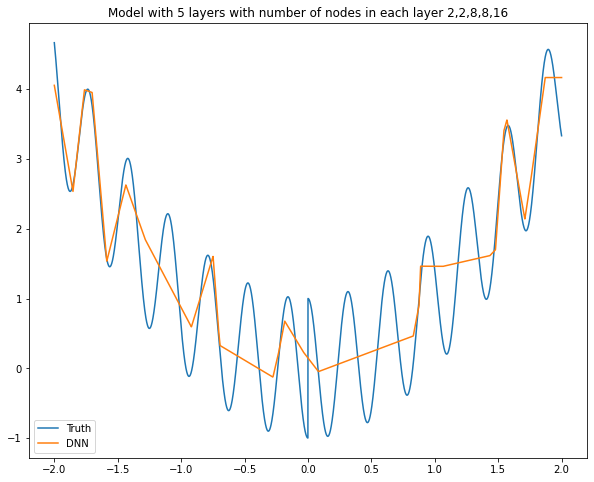

Model: "sequential_276"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1636 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1637 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1638 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1639 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1640 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1641 (Dense)           (None, 1)                 33        
Total params: 427
Trainable params: 427
Non-trainable params: 0
______________________________________________________

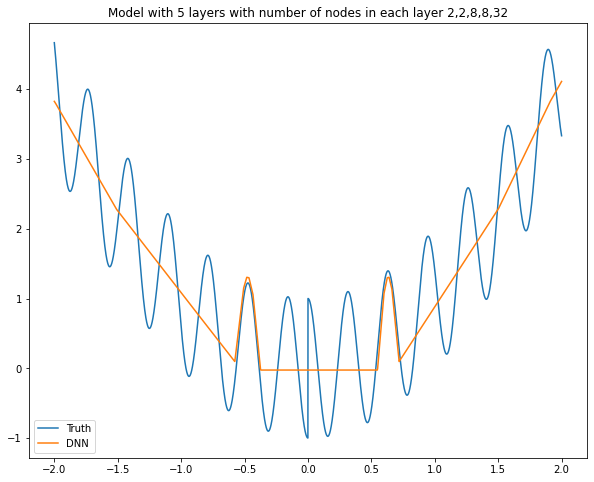

Model: "sequential_277"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1642 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1643 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1644 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1645 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1646 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1647 (Dense)           (None, 1)                 65        
Total params: 747
Trainable params: 747
Non-trainable params: 0
______________________________________________________

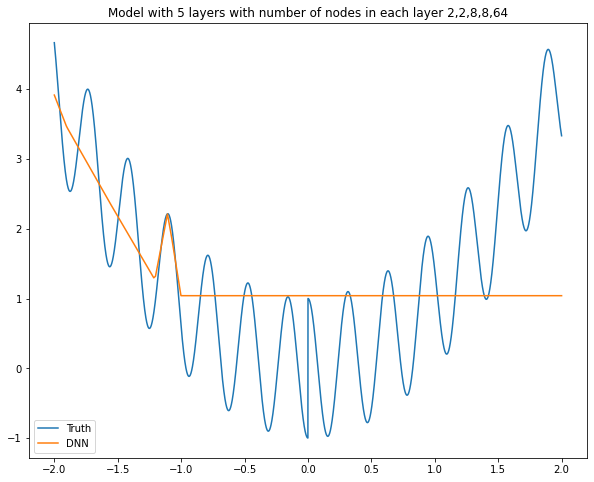

Model: "sequential_278"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1648 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1649 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1650 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1651 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1652 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1653 (Dense)           (None, 1)                 129       
Total params: 1,387
Trainable params: 1,387
Non-trainable params: 0
__________________________________________________

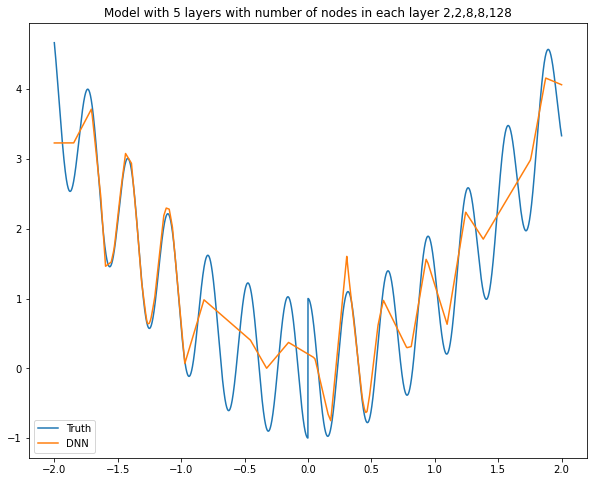

Model: "sequential_279"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1654 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1655 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1656 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1657 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1658 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1659 (Dense)           (None, 1)                 257       
Total params: 2,667
Trainable params: 2,667
Non-trainable params: 0
__________________________________________________

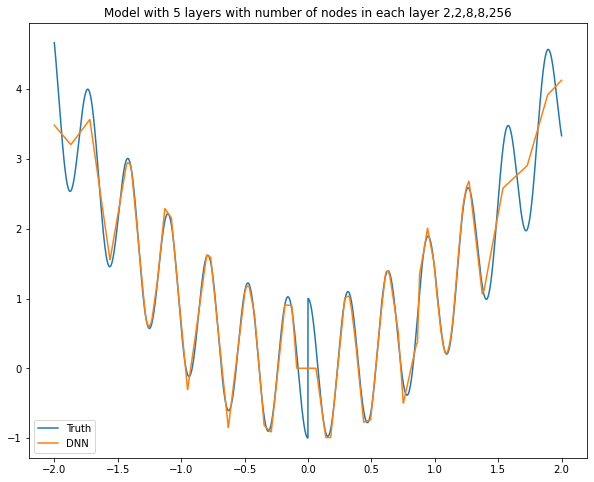

Model: "sequential_280"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1660 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1661 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1662 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1663 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1664 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_1665 (Dense)           (None, 1)                 513       
Total params: 5,227
Trainable params: 5,227
Non-trainable params: 0
__________________________________________________

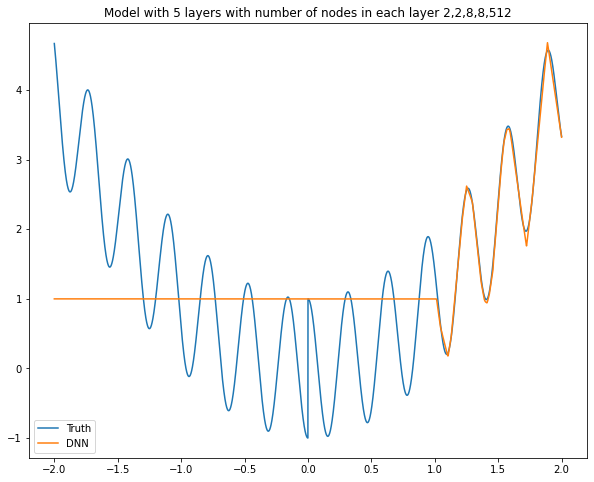

Model: "sequential_281"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1666 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1667 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1668 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1669 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1670 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_1671 (Dense)           (None, 1)                 1025      
Total params: 10,347
Trainable params: 10,347
Non-trainable params: 0
________________________________________________

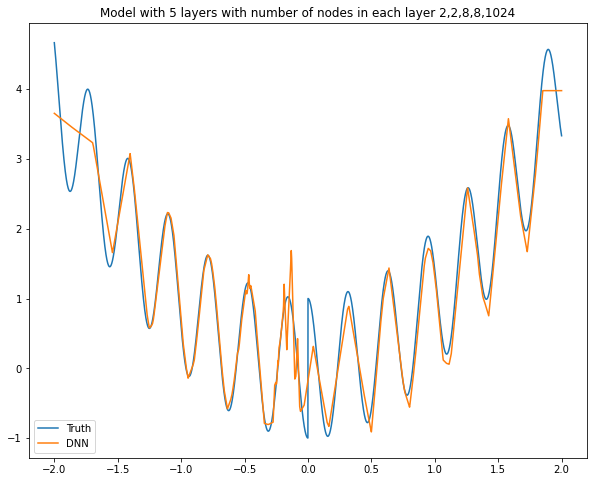

Model: "sequential_282"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1672 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1673 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1674 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1675 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_1676 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_1677 (Dense)           (None, 1)                 2049      
Total params: 20,587
Trainable params: 20,587
Non-trainable params: 0
________________________________________________

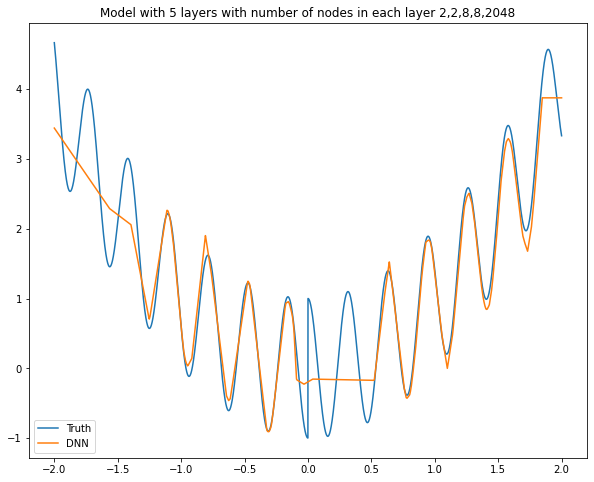

Model: "sequential_283"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1678 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1679 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1680 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1681 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1682 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_1683 (Dense)           (None, 1)                 3         
Total params: 215
Trainable params: 215
Non-trainable params: 0
______________________________________________________

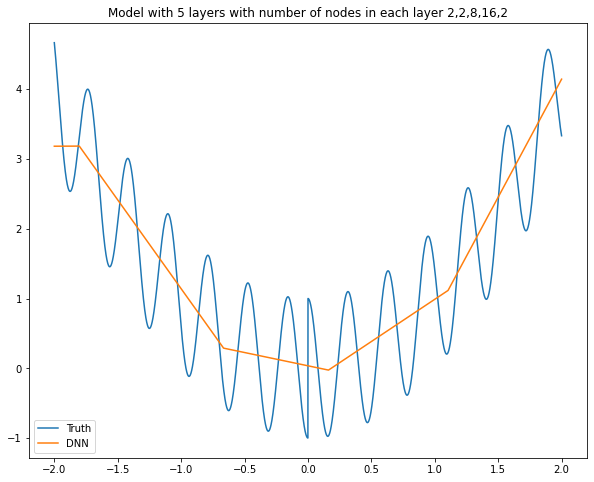

Model: "sequential_284"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1684 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1685 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1686 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1687 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1688 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_1689 (Dense)           (None, 1)                 5         
Total params: 251
Trainable params: 251
Non-trainable params: 0
______________________________________________________

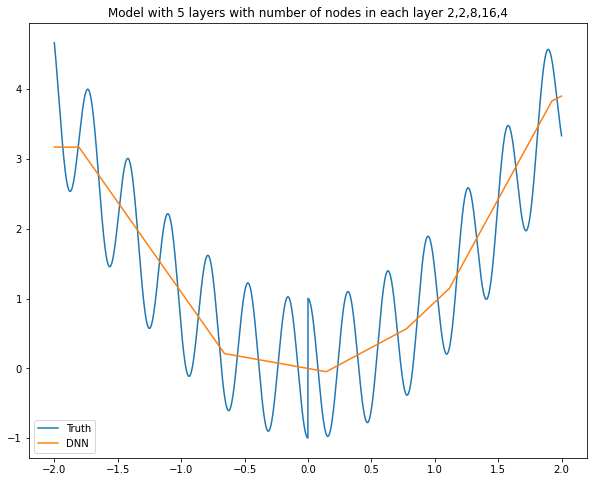

Model: "sequential_285"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1690 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1691 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1692 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1693 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1694 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_1695 (Dense)           (None, 1)                 9         
Total params: 323
Trainable params: 323
Non-trainable params: 0
______________________________________________________

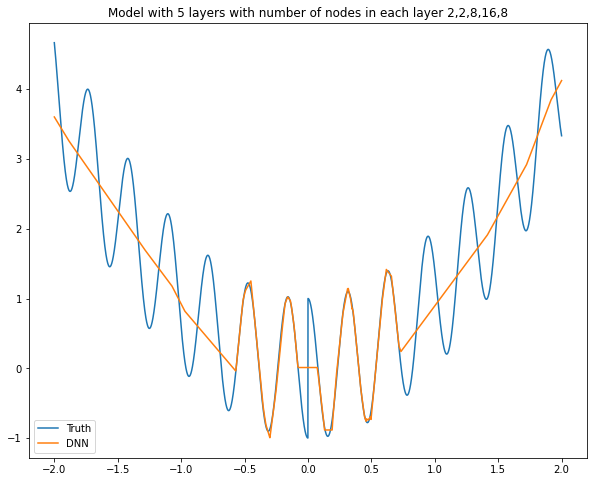

Model: "sequential_286"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1696 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1697 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1698 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1699 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1700 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_1701 (Dense)           (None, 1)                 17        
Total params: 467
Trainable params: 467
Non-trainable params: 0
______________________________________________________

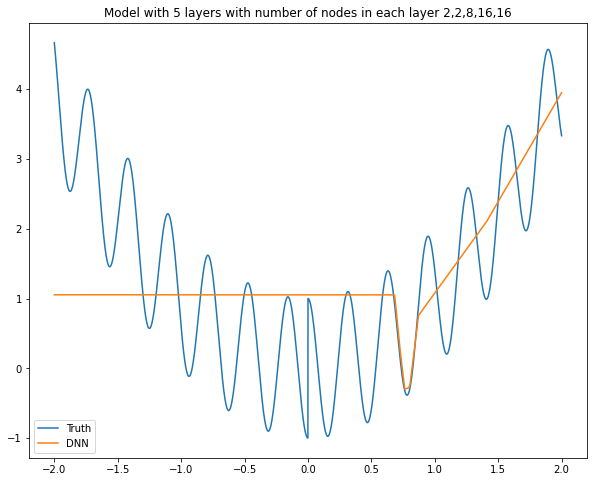

Model: "sequential_287"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1702 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1703 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1704 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1705 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1706 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_1707 (Dense)           (None, 1)                 33        
Total params: 755
Trainable params: 755
Non-trainable params: 0
______________________________________________________

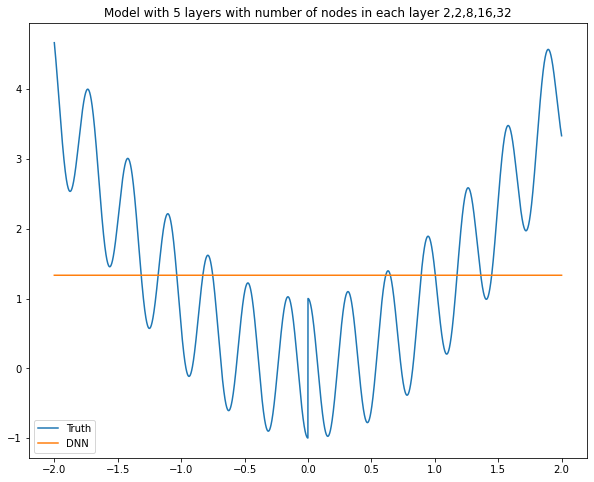

Model: "sequential_288"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1708 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1709 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1710 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1711 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1712 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_1713 (Dense)           (None, 1)                 65        
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
__________________________________________________

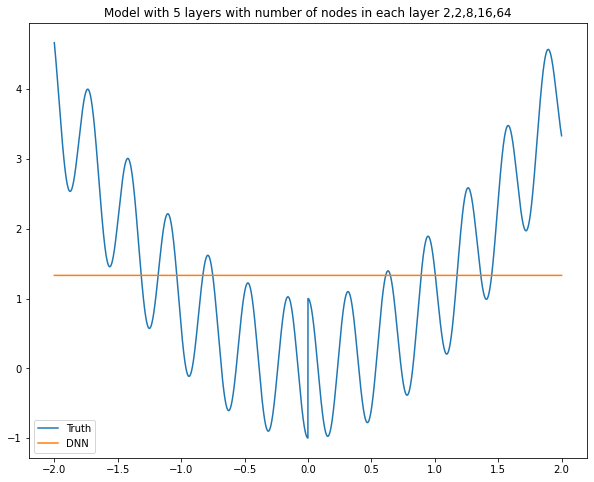

Model: "sequential_289"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1714 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1715 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1716 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1717 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1718 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_1719 (Dense)           (None, 1)                 129       
Total params: 2,483
Trainable params: 2,483
Non-trainable params: 0
__________________________________________________

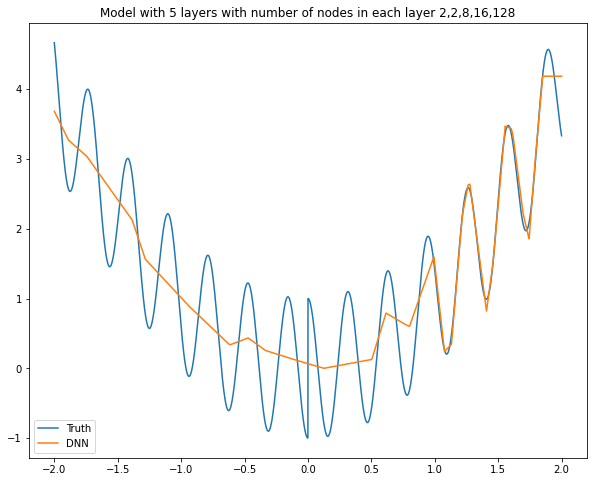

Model: "sequential_290"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1720 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1721 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1722 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1723 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1724 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_1725 (Dense)           (None, 1)                 257       
Total params: 4,787
Trainable params: 4,787
Non-trainable params: 0
__________________________________________________

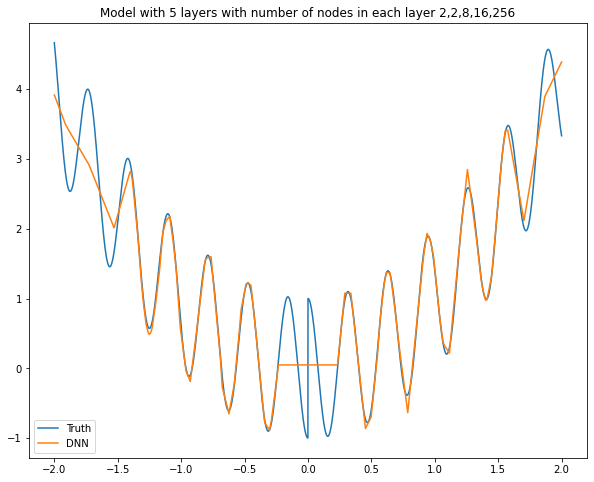

Model: "sequential_291"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1726 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1727 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1728 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1729 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1730 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_1731 (Dense)           (None, 1)                 513       
Total params: 9,395
Trainable params: 9,395
Non-trainable params: 0
__________________________________________________

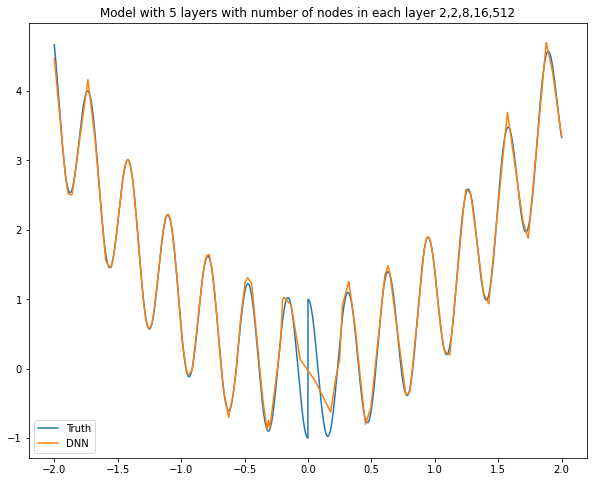

Model: "sequential_292"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1732 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1733 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1734 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1735 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1736 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_1737 (Dense)           (None, 1)                 1025      
Total params: 18,611
Trainable params: 18,611
Non-trainable params: 0
________________________________________________

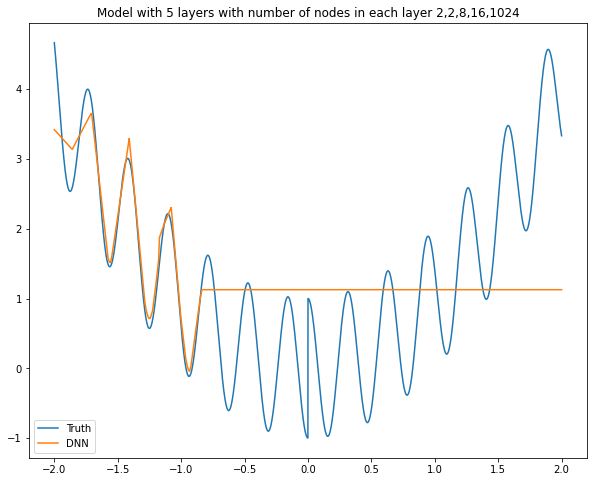

Model: "sequential_293"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1738 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1739 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1740 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1741 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_1742 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_1743 (Dense)           (None, 1)                 2049      
Total params: 37,043
Trainable params: 37,043
Non-trainable params: 0
________________________________________________

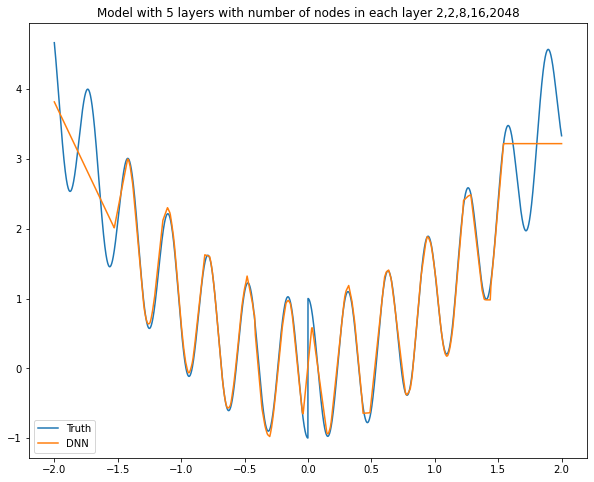

Model: "sequential_294"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1744 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1745 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1746 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1747 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1748 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_1749 (Dense)           (None, 1)                 3         
Total params: 391
Trainable params: 391
Non-trainable params: 0
______________________________________________________

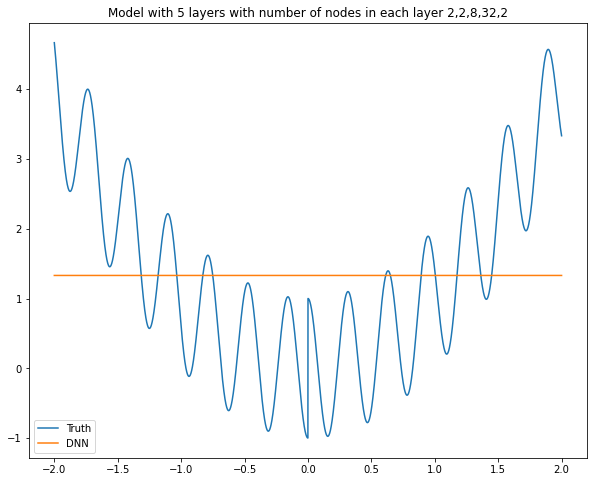

Model: "sequential_295"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1750 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1751 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1752 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1753 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1754 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_1755 (Dense)           (None, 1)                 5         
Total params: 459
Trainable params: 459
Non-trainable params: 0
______________________________________________________

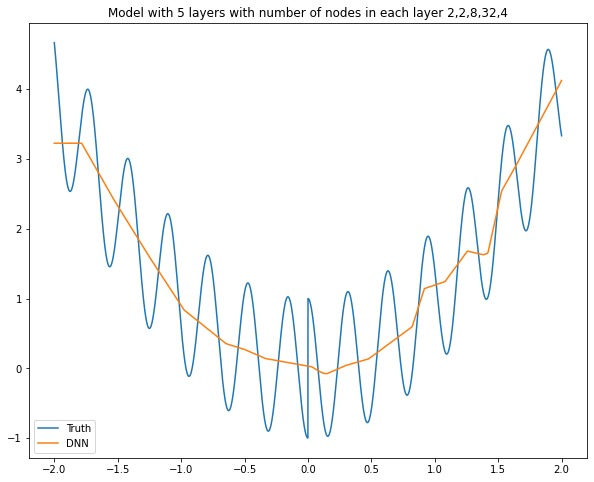

Model: "sequential_296"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1756 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1757 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1758 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1759 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1760 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_1761 (Dense)           (None, 1)                 9         
Total params: 595
Trainable params: 595
Non-trainable params: 0
______________________________________________________

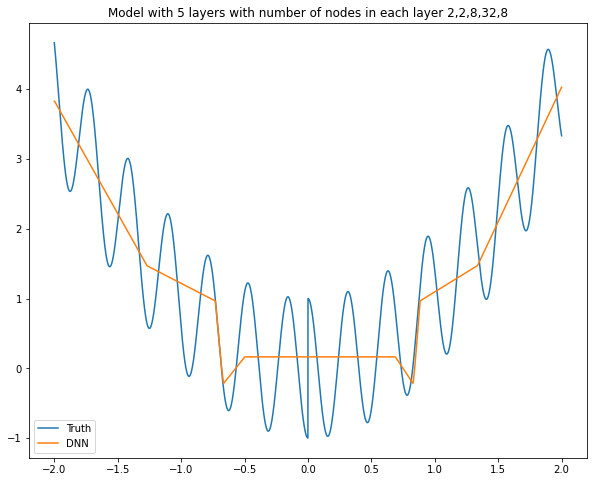

Model: "sequential_297"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1762 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1763 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1764 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1765 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1766 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_1767 (Dense)           (None, 1)                 17        
Total params: 867
Trainable params: 867
Non-trainable params: 0
______________________________________________________

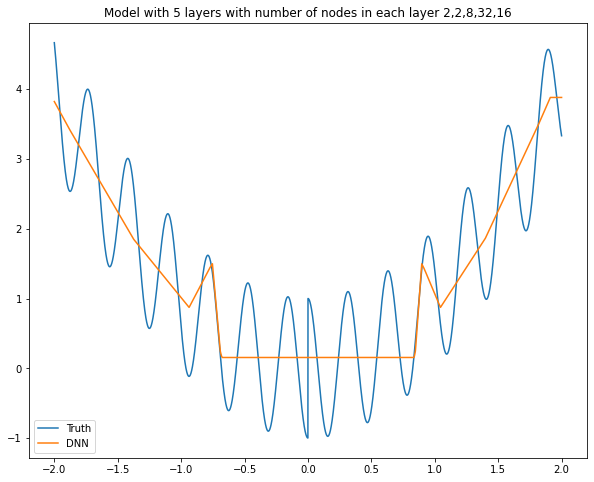

Model: "sequential_298"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1768 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1769 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1770 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1771 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1772 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_1773 (Dense)           (None, 1)                 33        
Total params: 1,411
Trainable params: 1,411
Non-trainable params: 0
__________________________________________________

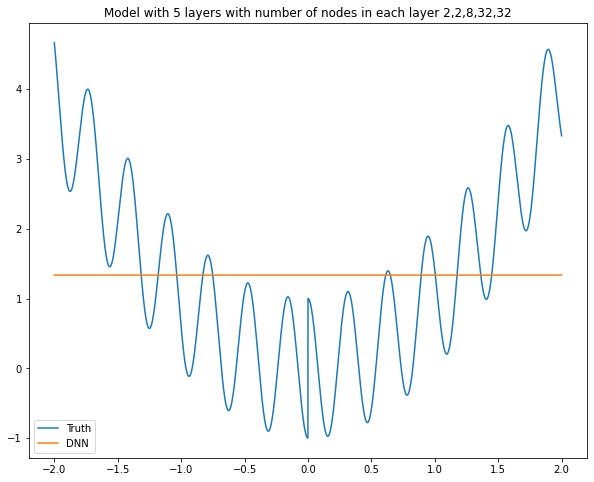

Model: "sequential_299"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1774 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1775 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1776 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1777 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1778 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_1779 (Dense)           (None, 1)                 65        
Total params: 2,499
Trainable params: 2,499
Non-trainable params: 0
__________________________________________________

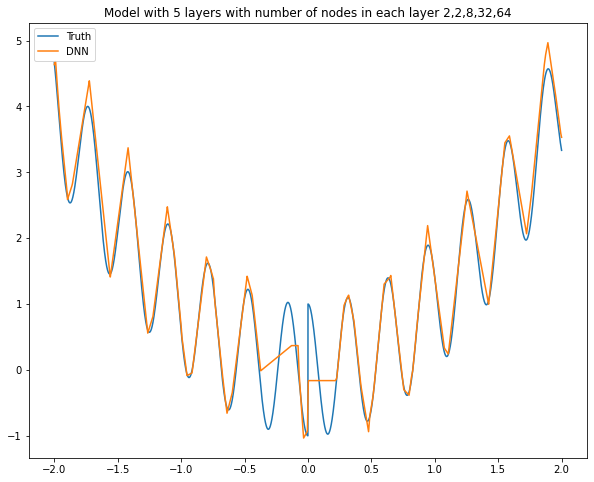

Model: "sequential_300"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1780 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1781 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1782 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1783 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1784 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_1785 (Dense)           (None, 1)                 129       
Total params: 4,675
Trainable params: 4,675
Non-trainable params: 0
__________________________________________________

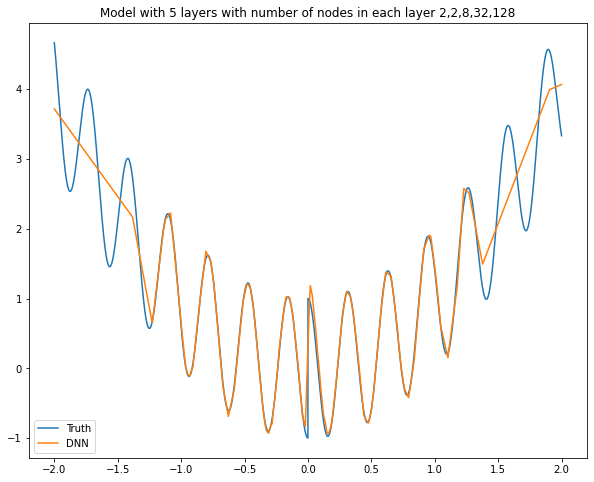

Model: "sequential_301"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1786 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1787 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1788 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1789 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1790 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_1791 (Dense)           (None, 1)                 257       
Total params: 9,027
Trainable params: 9,027
Non-trainable params: 0
__________________________________________________

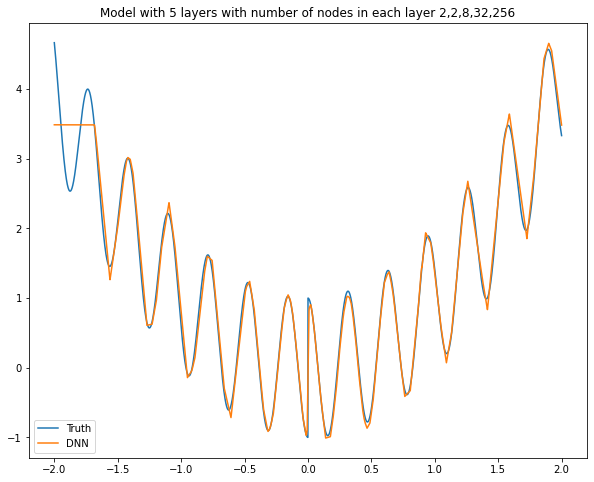

Model: "sequential_302"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1792 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1793 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1794 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1795 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1796 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_1797 (Dense)           (None, 1)                 513       
Total params: 17,731
Trainable params: 17,731
Non-trainable params: 0
________________________________________________

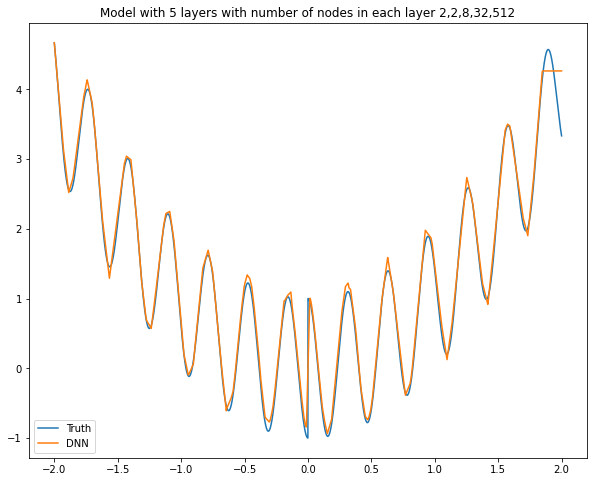

Model: "sequential_303"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1798 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1799 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1800 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1801 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1802 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_1803 (Dense)           (None, 1)                 1025      
Total params: 35,139
Trainable params: 35,139
Non-trainable params: 0
________________________________________________

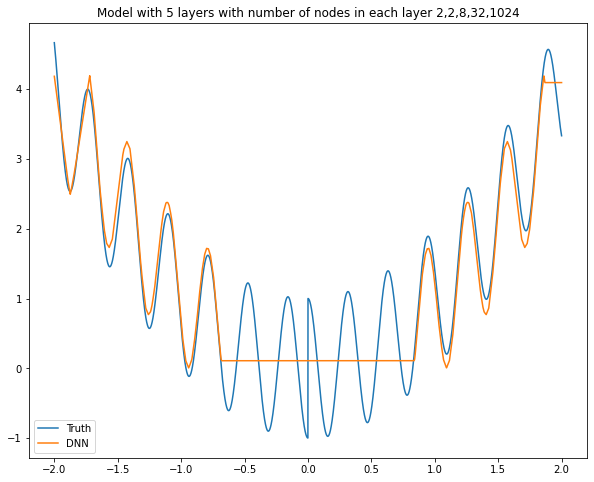

Model: "sequential_304"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1804 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1805 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1806 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1807 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_1808 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_1809 (Dense)           (None, 1)                 2049      
Total params: 69,955
Trainable params: 69,955
Non-trainable params: 0
________________________________________________

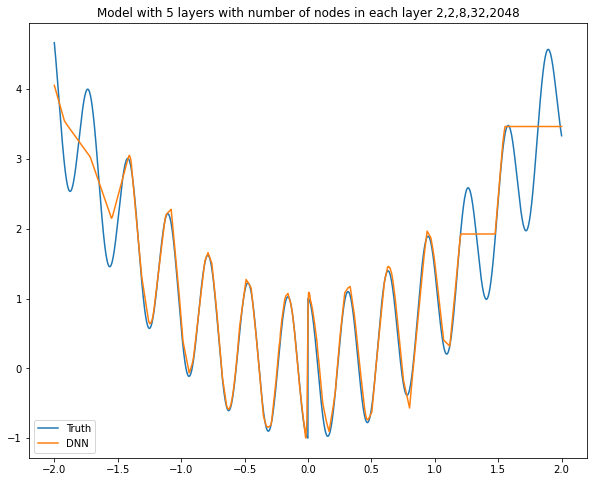

Model: "sequential_305"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1810 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1811 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1812 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1813 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1814 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_1815 (Dense)           (None, 1)                 3         
Total params: 743
Trainable params: 743
Non-trainable params: 0
______________________________________________________

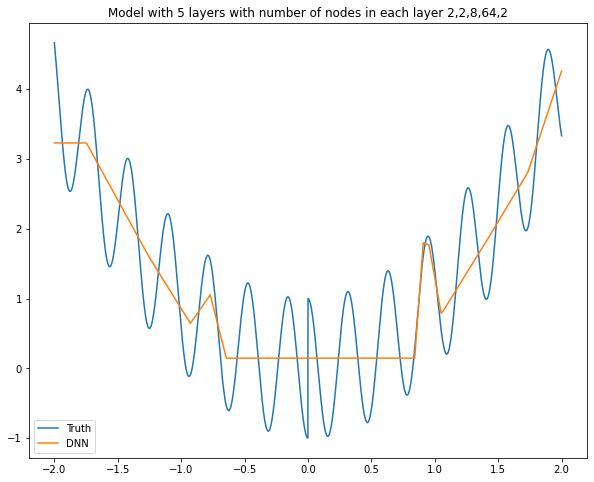

Model: "sequential_306"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1816 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1817 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1818 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1819 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1820 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_1821 (Dense)           (None, 1)                 5         
Total params: 875
Trainable params: 875
Non-trainable params: 0
______________________________________________________

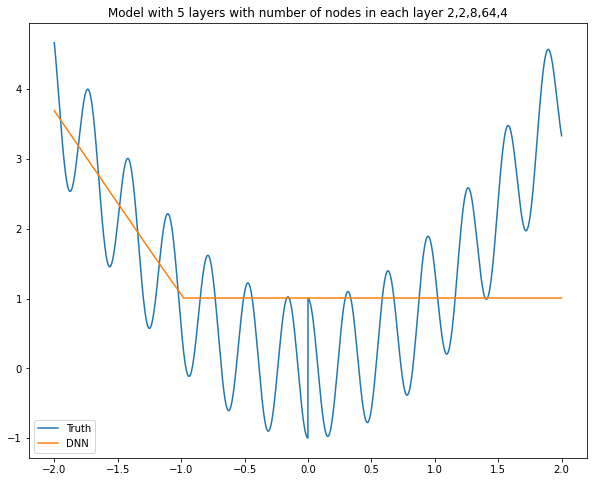

Model: "sequential_307"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1822 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1823 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1824 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1825 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1826 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_1827 (Dense)           (None, 1)                 9         
Total params: 1,139
Trainable params: 1,139
Non-trainable params: 0
__________________________________________________

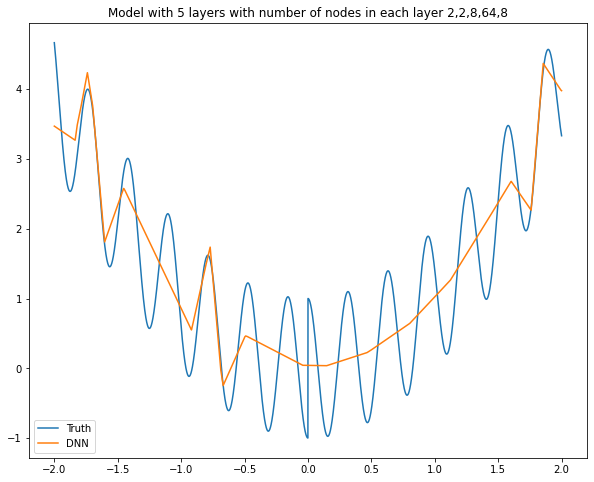

Model: "sequential_308"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1828 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1829 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1830 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1831 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1832 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_1833 (Dense)           (None, 1)                 17        
Total params: 1,667
Trainable params: 1,667
Non-trainable params: 0
__________________________________________________

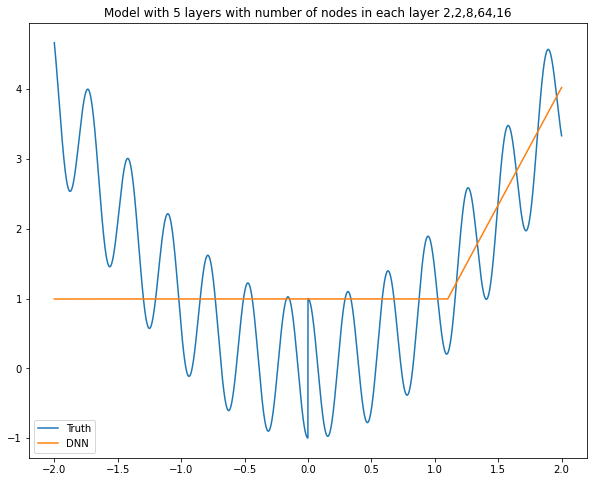

Model: "sequential_309"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1834 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1835 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1836 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1837 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1838 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_1839 (Dense)           (None, 1)                 33        
Total params: 2,723
Trainable params: 2,723
Non-trainable params: 0
__________________________________________________

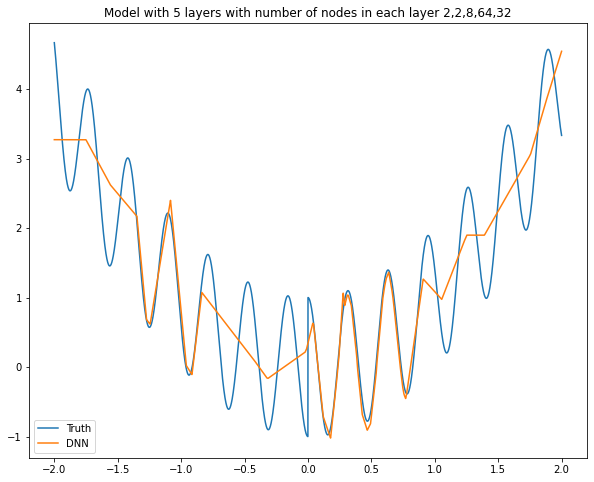

Model: "sequential_310"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1840 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1841 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1842 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1843 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1844 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_1845 (Dense)           (None, 1)                 65        
Total params: 4,835
Trainable params: 4,835
Non-trainable params: 0
__________________________________________________

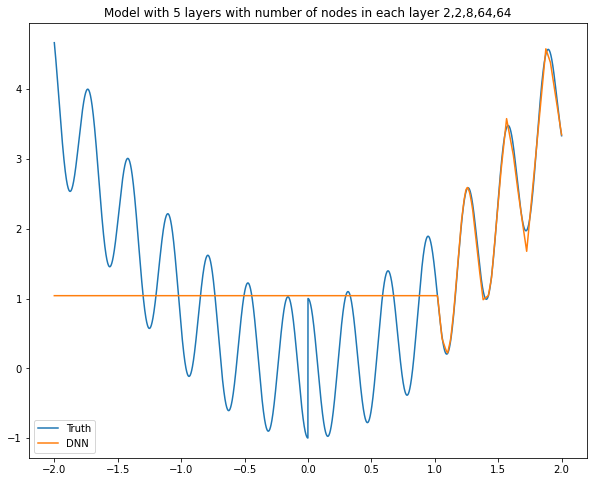

Model: "sequential_311"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1846 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1847 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1848 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1849 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1850 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_1851 (Dense)           (None, 1)                 129       
Total params: 9,059
Trainable params: 9,059
Non-trainable params: 0
__________________________________________________

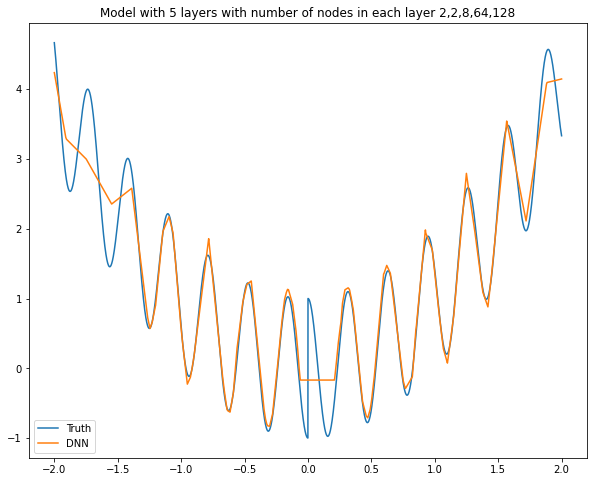

Model: "sequential_312"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1852 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1853 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1854 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1855 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1856 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_1857 (Dense)           (None, 1)                 257       
Total params: 17,507
Trainable params: 17,507
Non-trainable params: 0
________________________________________________

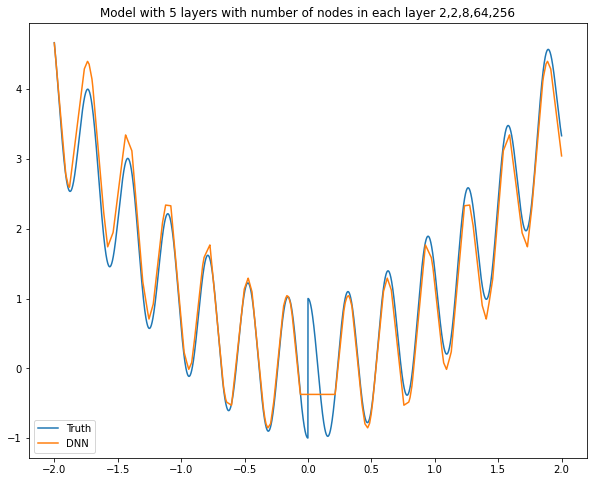

Model: "sequential_313"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1858 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1859 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1860 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1861 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1862 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_1863 (Dense)           (None, 1)                 513       
Total params: 34,403
Trainable params: 34,403
Non-trainable params: 0
________________________________________________

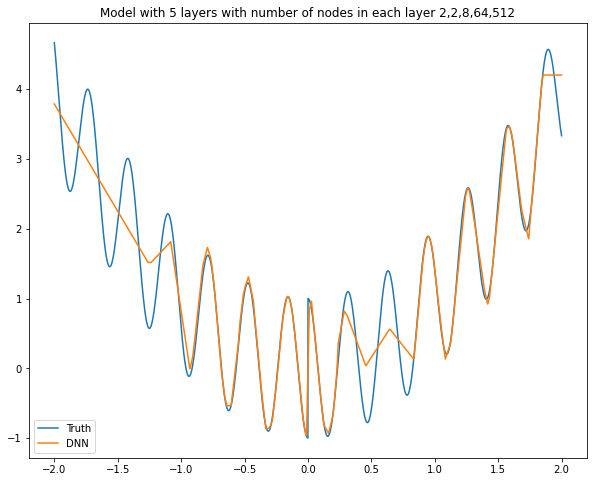

Model: "sequential_314"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1864 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1865 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1866 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1867 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1868 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_1869 (Dense)           (None, 1)                 1025      
Total params: 68,195
Trainable params: 68,195
Non-trainable params: 0
________________________________________________

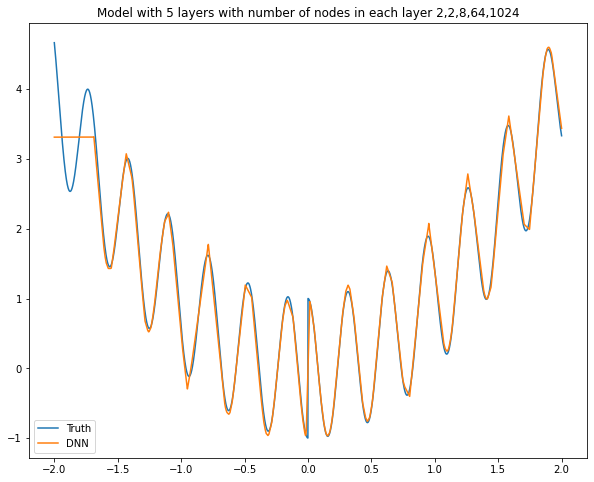

Model: "sequential_315"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1870 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1871 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1872 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1873 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_1874 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_1875 (Dense)           (None, 1)                 2049      
Total params: 135,779
Trainable params: 135,779
Non-trainable params: 0
______________________________________________

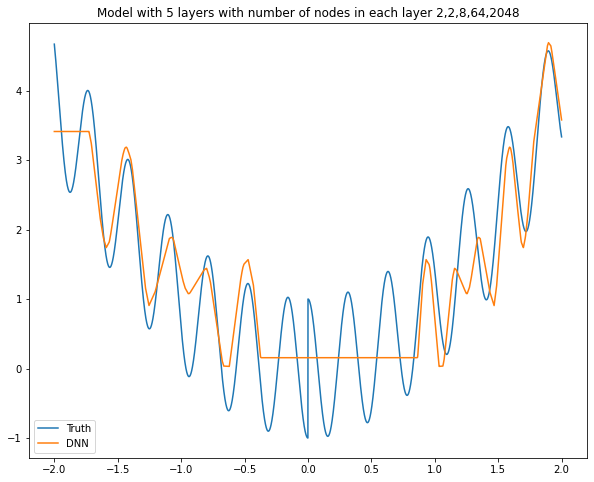

Model: "sequential_316"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1876 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1877 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1878 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1879 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1880 (Dense)           (None, 2)                 258       
_________________________________________________________________
dense_1881 (Dense)           (None, 1)                 3         
Total params: 1,447
Trainable params: 1,447
Non-trainable params: 0
__________________________________________________

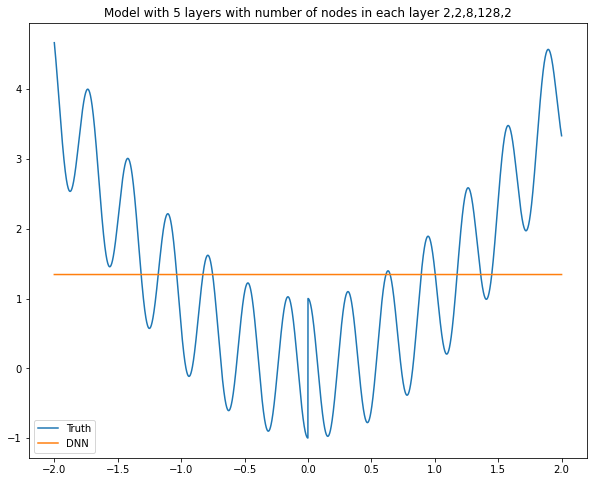

Model: "sequential_317"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1882 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1883 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1884 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1885 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1886 (Dense)           (None, 4)                 516       
_________________________________________________________________
dense_1887 (Dense)           (None, 1)                 5         
Total params: 1,707
Trainable params: 1,707
Non-trainable params: 0
__________________________________________________

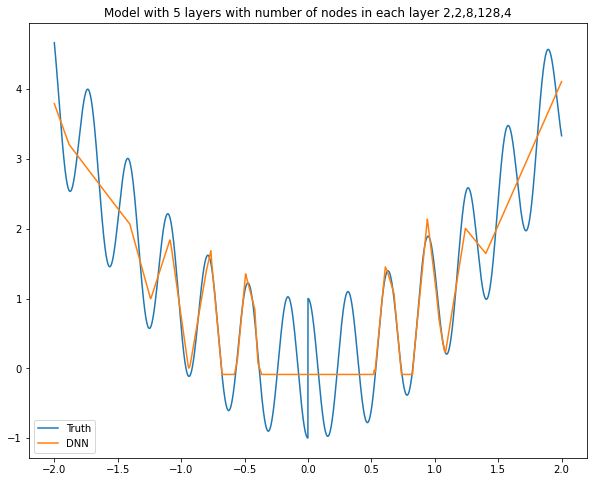

Model: "sequential_318"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1888 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1889 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1890 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1891 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1892 (Dense)           (None, 8)                 1032      
_________________________________________________________________
dense_1893 (Dense)           (None, 1)                 9         
Total params: 2,227
Trainable params: 2,227
Non-trainable params: 0
__________________________________________________

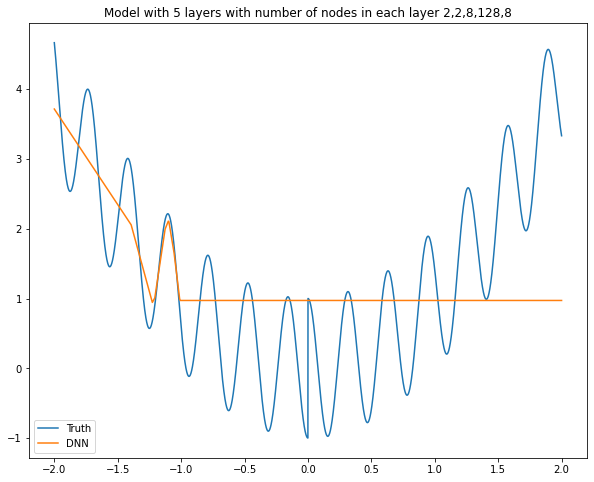

Model: "sequential_319"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1894 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1895 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1896 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1897 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1898 (Dense)           (None, 16)                2064      
_________________________________________________________________
dense_1899 (Dense)           (None, 1)                 17        
Total params: 3,267
Trainable params: 3,267
Non-trainable params: 0
__________________________________________________

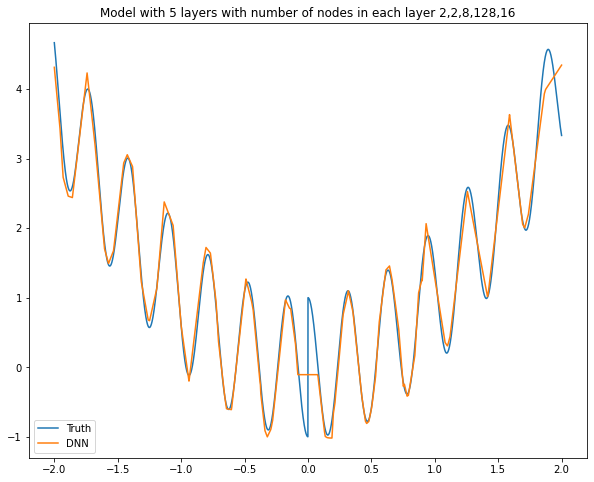

Model: "sequential_320"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1900 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1901 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1902 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1903 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1904 (Dense)           (None, 32)                4128      
_________________________________________________________________
dense_1905 (Dense)           (None, 1)                 33        
Total params: 5,347
Trainable params: 5,347
Non-trainable params: 0
__________________________________________________

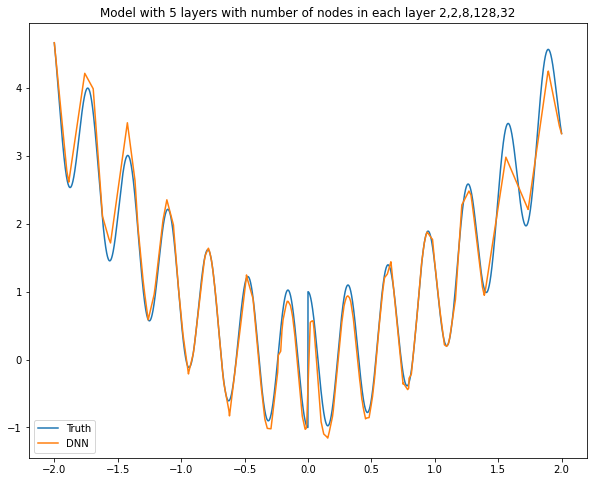

Model: "sequential_321"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1906 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1907 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1908 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1909 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1910 (Dense)           (None, 64)                8256      
_________________________________________________________________
dense_1911 (Dense)           (None, 1)                 65        
Total params: 9,507
Trainable params: 9,507
Non-trainable params: 0
__________________________________________________

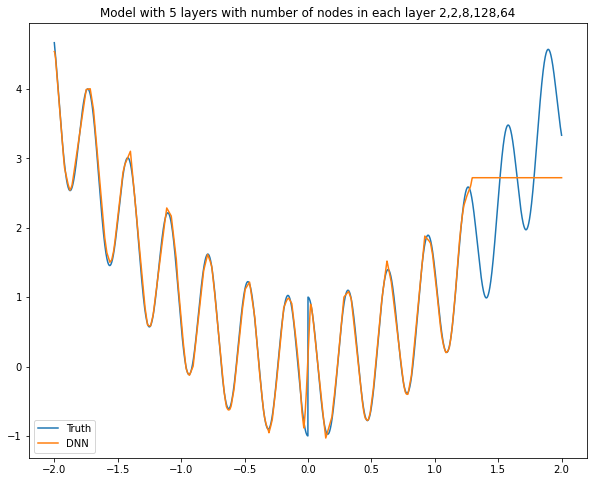

Model: "sequential_322"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1912 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1913 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1914 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1915 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1916 (Dense)           (None, 128)               16512     
_________________________________________________________________
dense_1917 (Dense)           (None, 1)                 129       
Total params: 17,827
Trainable params: 17,827
Non-trainable params: 0
________________________________________________

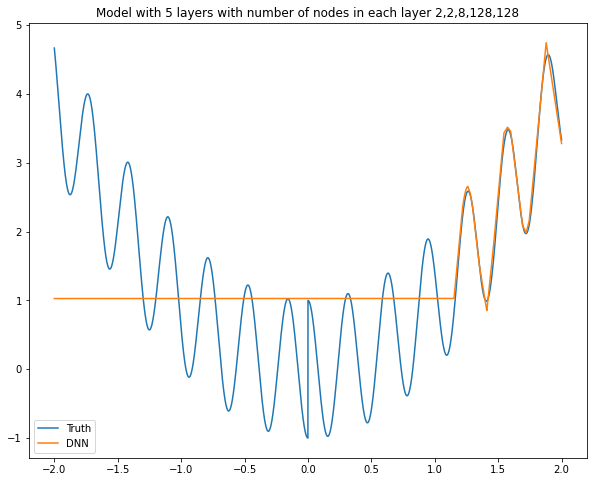

Model: "sequential_323"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1918 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1919 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1920 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1921 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1922 (Dense)           (None, 256)               33024     
_________________________________________________________________
dense_1923 (Dense)           (None, 1)                 257       
Total params: 34,467
Trainable params: 34,467
Non-trainable params: 0
________________________________________________

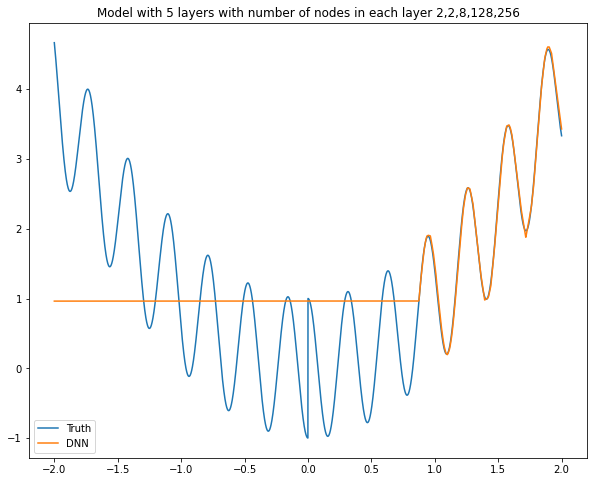

Model: "sequential_324"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1924 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1925 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1926 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1927 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1928 (Dense)           (None, 512)               66048     
_________________________________________________________________
dense_1929 (Dense)           (None, 1)                 513       
Total params: 67,747
Trainable params: 67,747
Non-trainable params: 0
________________________________________________

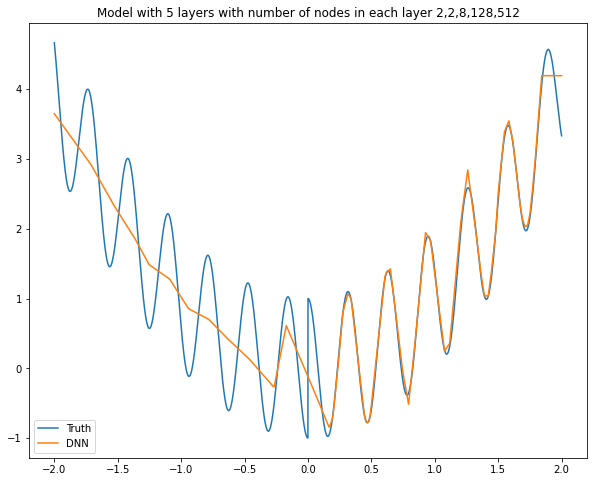

Model: "sequential_325"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1930 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1931 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1932 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1933 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1934 (Dense)           (None, 1024)              132096    
_________________________________________________________________
dense_1935 (Dense)           (None, 1)                 1025      
Total params: 134,307
Trainable params: 134,307
Non-trainable params: 0
______________________________________________

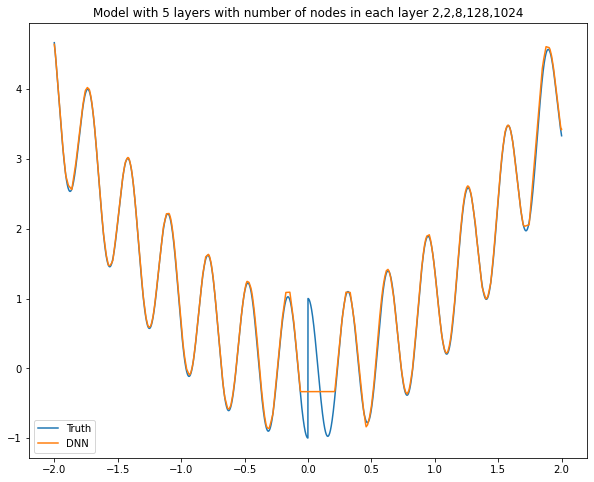

Model: "sequential_326"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1936 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1937 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1938 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1939 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_1940 (Dense)           (None, 2048)              264192    
_________________________________________________________________
dense_1941 (Dense)           (None, 1)                 2049      
Total params: 267,427
Trainable params: 267,427
Non-trainable params: 0
______________________________________________

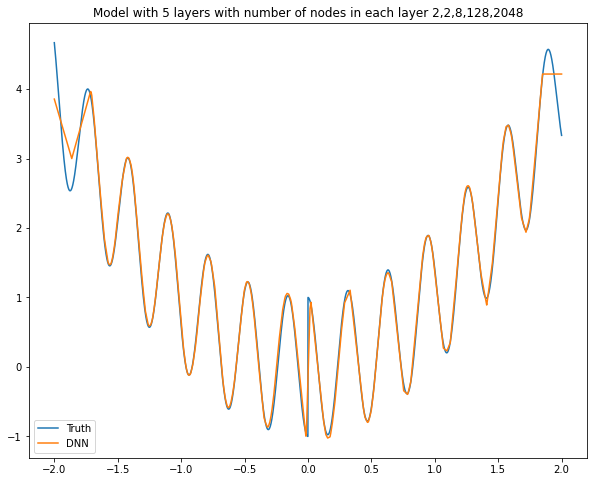

Model: "sequential_327"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1942 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1943 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1944 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1945 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1946 (Dense)           (None, 2)                 514       
_________________________________________________________________
dense_1947 (Dense)           (None, 1)                 3         
Total params: 2,855
Trainable params: 2,855
Non-trainable params: 0
__________________________________________________

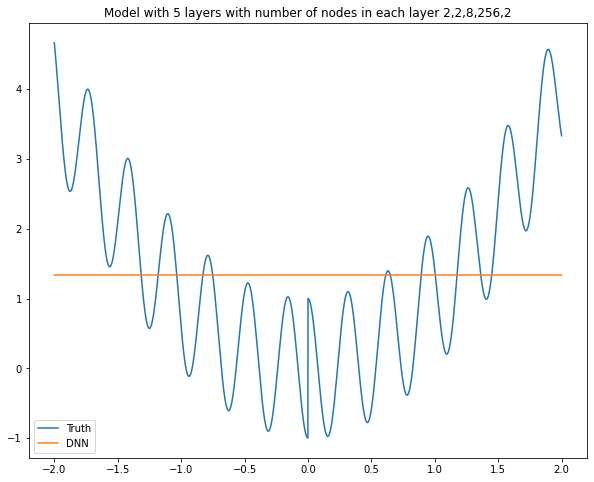

Model: "sequential_328"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1948 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1949 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1950 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1951 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1952 (Dense)           (None, 4)                 1028      
_________________________________________________________________
dense_1953 (Dense)           (None, 1)                 5         
Total params: 3,371
Trainable params: 3,371
Non-trainable params: 0
__________________________________________________

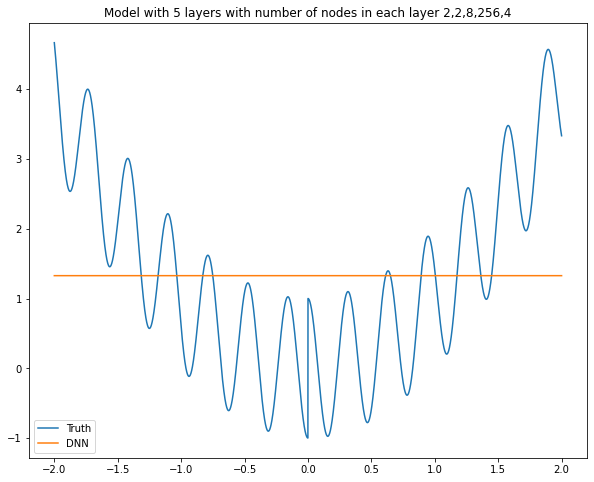

Model: "sequential_329"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1954 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1955 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1956 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1957 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1958 (Dense)           (None, 8)                 2056      
_________________________________________________________________
dense_1959 (Dense)           (None, 1)                 9         
Total params: 4,403
Trainable params: 4,403
Non-trainable params: 0
__________________________________________________

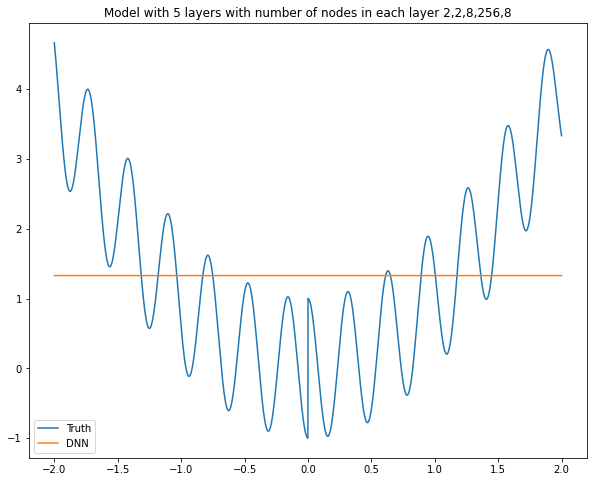

Model: "sequential_330"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1960 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1961 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1962 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1963 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1964 (Dense)           (None, 16)                4112      
_________________________________________________________________
dense_1965 (Dense)           (None, 1)                 17        
Total params: 6,467
Trainable params: 6,467
Non-trainable params: 0
__________________________________________________

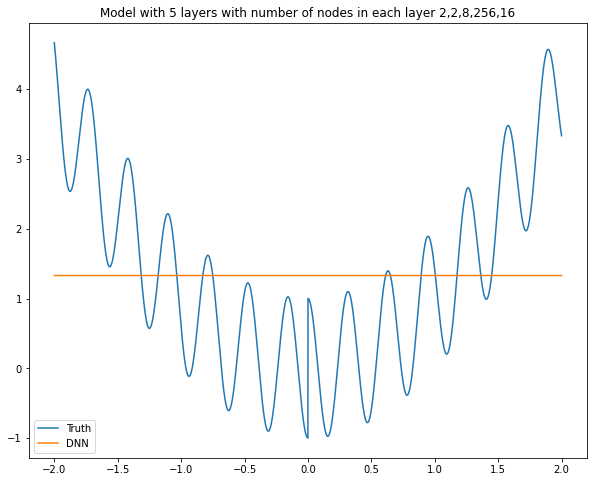

Model: "sequential_331"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1966 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1967 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1968 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1969 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1970 (Dense)           (None, 32)                8224      
_________________________________________________________________
dense_1971 (Dense)           (None, 1)                 33        
Total params: 10,595
Trainable params: 10,595
Non-trainable params: 0
________________________________________________

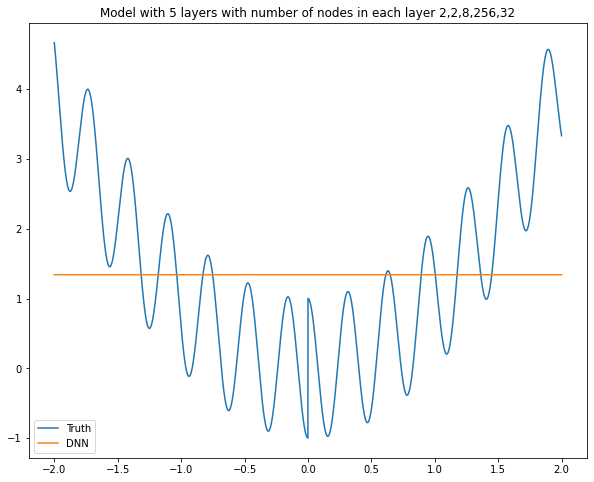

Model: "sequential_332"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1972 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1973 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1974 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1975 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1976 (Dense)           (None, 64)                16448     
_________________________________________________________________
dense_1977 (Dense)           (None, 1)                 65        
Total params: 18,851
Trainable params: 18,851
Non-trainable params: 0
________________________________________________

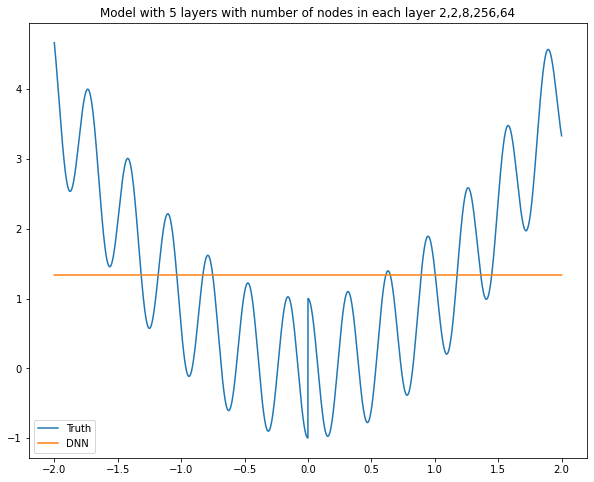

Model: "sequential_333"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1978 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1979 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1980 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1981 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1982 (Dense)           (None, 128)               32896     
_________________________________________________________________
dense_1983 (Dense)           (None, 1)                 129       
Total params: 35,363
Trainable params: 35,363
Non-trainable params: 0
________________________________________________

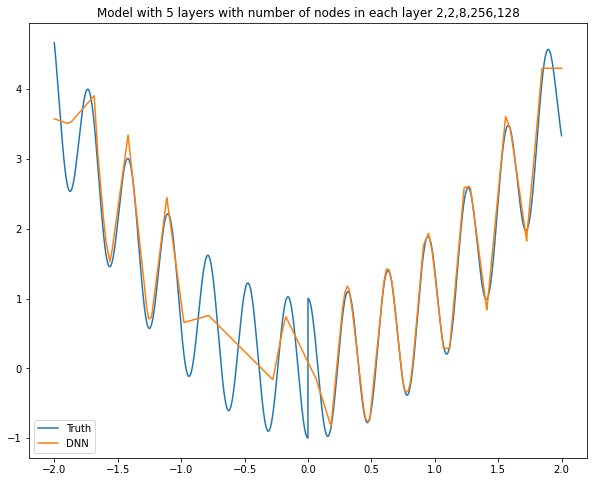

Model: "sequential_334"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1984 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1985 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1986 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1987 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1988 (Dense)           (None, 256)               65792     
_________________________________________________________________
dense_1989 (Dense)           (None, 1)                 257       
Total params: 68,387
Trainable params: 68,387
Non-trainable params: 0
________________________________________________

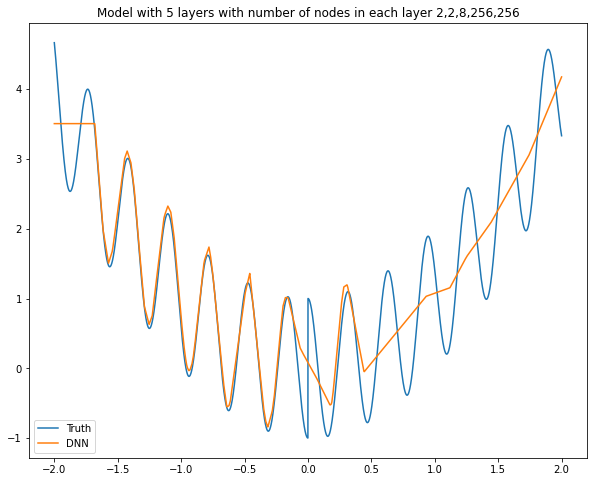

Model: "sequential_335"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1990 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1991 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1992 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1993 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_1994 (Dense)           (None, 512)               131584    
_________________________________________________________________
dense_1995 (Dense)           (None, 1)                 513       
Total params: 134,435
Trainable params: 134,435
Non-trainable params: 0
______________________________________________

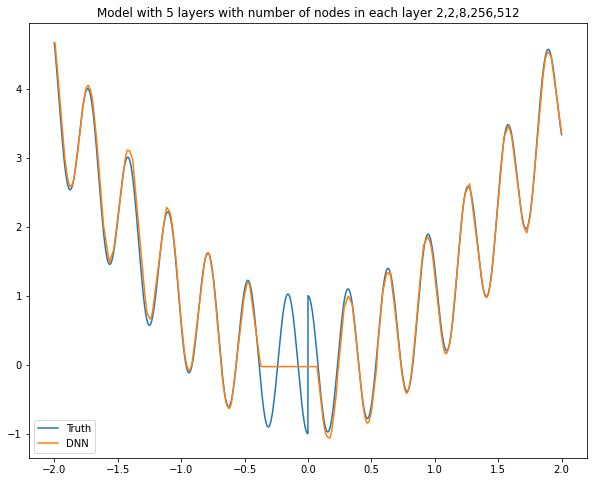

Model: "sequential_336"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1996 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_1997 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_1998 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_1999 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_2000 (Dense)           (None, 1024)              263168    
_________________________________________________________________
dense_2001 (Dense)           (None, 1)                 1025      
Total params: 266,531
Trainable params: 266,531
Non-trainable params: 0
______________________________________________

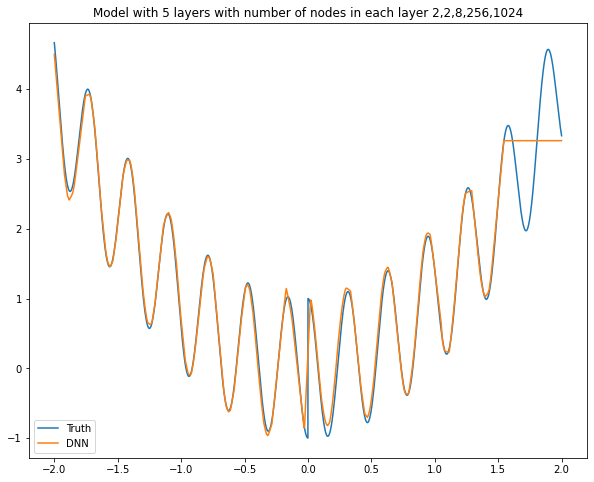

Model: "sequential_337"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2002 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2003 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2004 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2005 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_2006 (Dense)           (None, 2048)              526336    
_________________________________________________________________
dense_2007 (Dense)           (None, 1)                 2049      
Total params: 530,723
Trainable params: 530,723
Non-trainable params: 0
______________________________________________

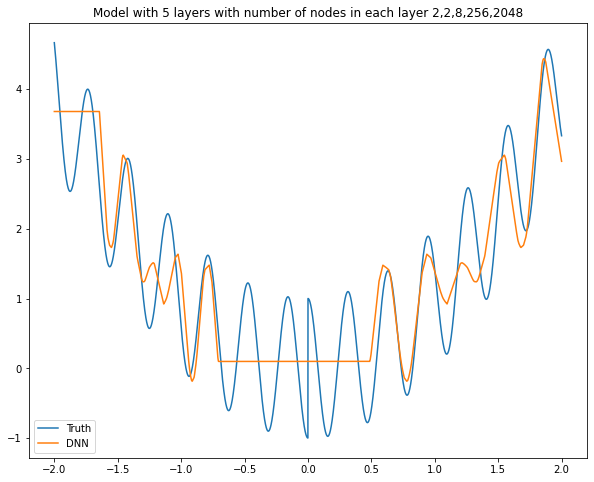

Model: "sequential_338"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2008 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2009 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2010 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2011 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2012 (Dense)           (None, 2)                 1026      
_________________________________________________________________
dense_2013 (Dense)           (None, 1)                 3         
Total params: 5,671
Trainable params: 5,671
Non-trainable params: 0
__________________________________________________

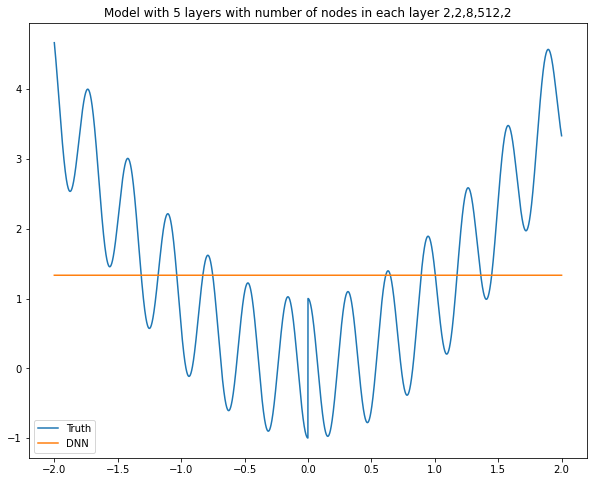

Model: "sequential_339"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2014 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2015 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2016 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2017 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2018 (Dense)           (None, 4)                 2052      
_________________________________________________________________
dense_2019 (Dense)           (None, 1)                 5         
Total params: 6,699
Trainable params: 6,699
Non-trainable params: 0
__________________________________________________

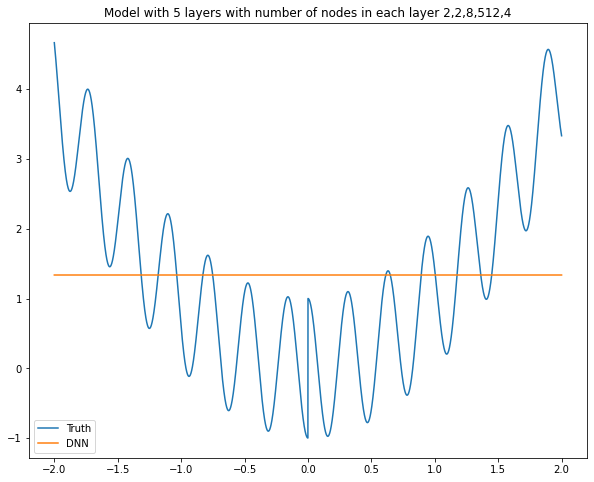

Model: "sequential_340"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2020 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2021 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2022 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2023 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2024 (Dense)           (None, 8)                 4104      
_________________________________________________________________
dense_2025 (Dense)           (None, 1)                 9         
Total params: 8,755
Trainable params: 8,755
Non-trainable params: 0
__________________________________________________

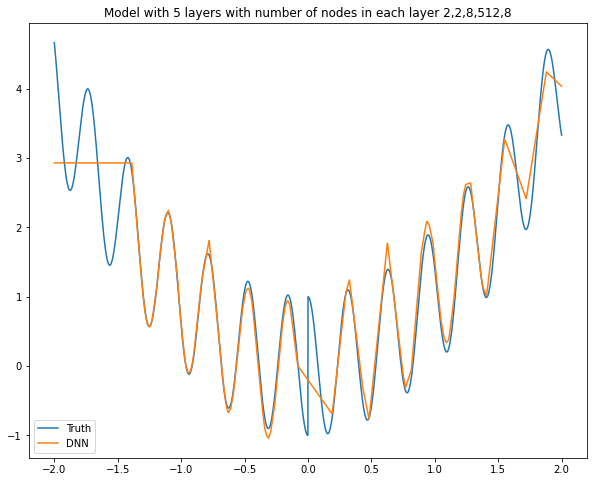

Model: "sequential_341"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2026 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2027 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2028 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2029 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2030 (Dense)           (None, 16)                8208      
_________________________________________________________________
dense_2031 (Dense)           (None, 1)                 17        
Total params: 12,867
Trainable params: 12,867
Non-trainable params: 0
________________________________________________

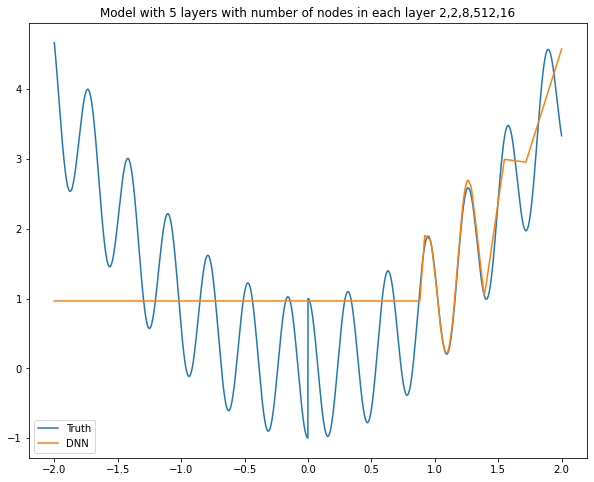

Model: "sequential_342"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2032 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2033 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2034 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2035 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2036 (Dense)           (None, 32)                16416     
_________________________________________________________________
dense_2037 (Dense)           (None, 1)                 33        
Total params: 21,091
Trainable params: 21,091
Non-trainable params: 0
________________________________________________

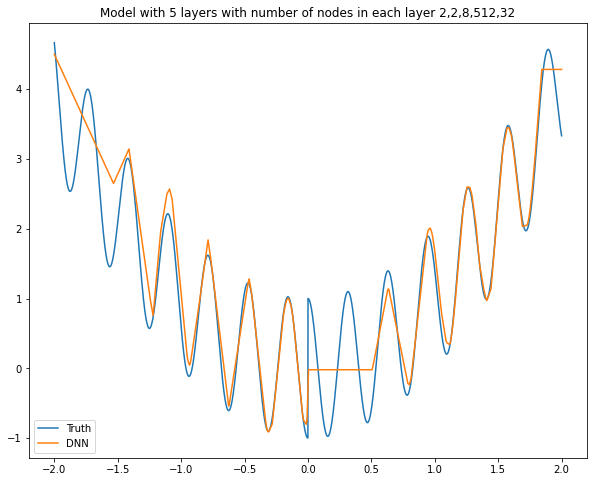

Model: "sequential_343"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2038 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2039 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2040 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2041 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2042 (Dense)           (None, 64)                32832     
_________________________________________________________________
dense_2043 (Dense)           (None, 1)                 65        
Total params: 37,539
Trainable params: 37,539
Non-trainable params: 0
________________________________________________

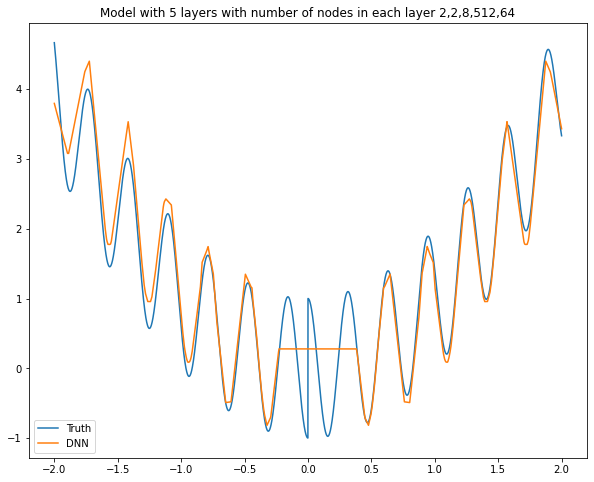

Model: "sequential_344"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2044 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2045 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2046 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2047 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2048 (Dense)           (None, 128)               65664     
_________________________________________________________________
dense_2049 (Dense)           (None, 1)                 129       
Total params: 70,435
Trainable params: 70,435
Non-trainable params: 0
________________________________________________

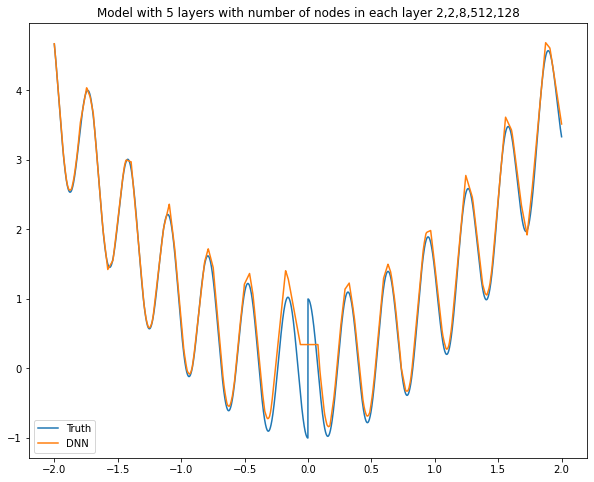

Model: "sequential_345"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2050 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2051 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2052 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2053 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2054 (Dense)           (None, 256)               131328    
_________________________________________________________________
dense_2055 (Dense)           (None, 1)                 257       
Total params: 136,227
Trainable params: 136,227
Non-trainable params: 0
______________________________________________

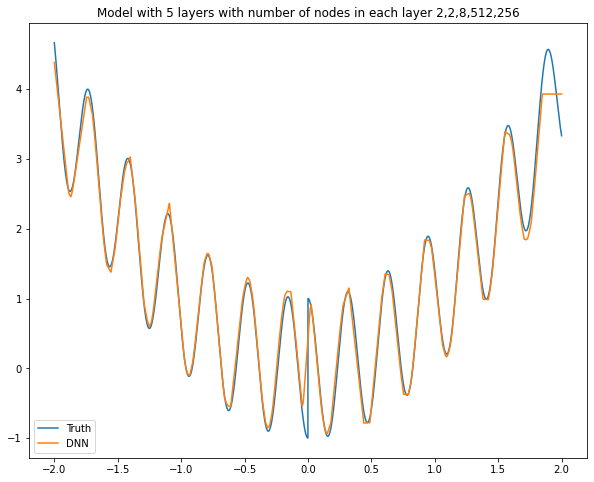

Model: "sequential_346"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2056 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2057 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2058 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2059 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2060 (Dense)           (None, 512)               262656    
_________________________________________________________________
dense_2061 (Dense)           (None, 1)                 513       
Total params: 267,811
Trainable params: 267,811
Non-trainable params: 0
______________________________________________

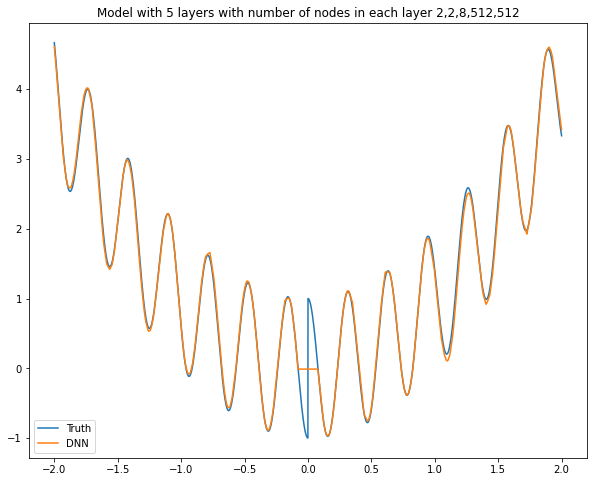

Model: "sequential_347"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2062 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2063 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2064 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2065 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2066 (Dense)           (None, 1024)              525312    
_________________________________________________________________
dense_2067 (Dense)           (None, 1)                 1025      
Total params: 530,979
Trainable params: 530,979
Non-trainable params: 0
______________________________________________

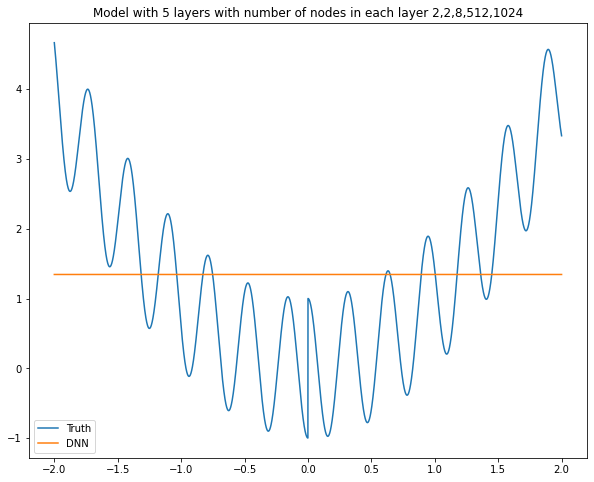

Model: "sequential_348"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2068 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2069 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2070 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2071 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2072 (Dense)           (None, 2048)              1050624   
_________________________________________________________________
dense_2073 (Dense)           (None, 1)                 2049      
Total params: 1,057,315
Trainable params: 1,057,315
Non-trainable params: 0
__________________________________________

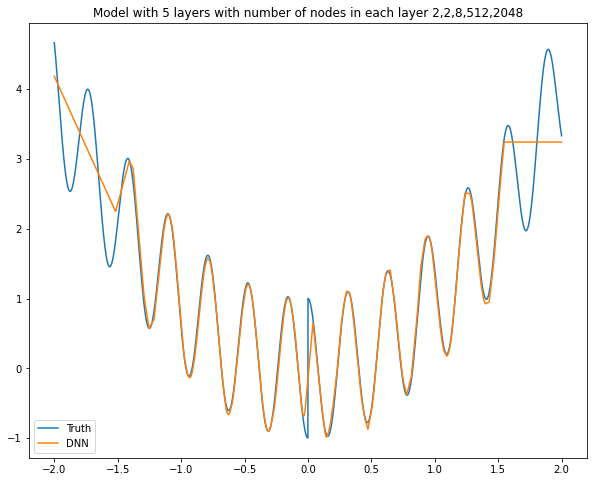

Model: "sequential_349"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2074 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2075 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2076 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2077 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2078 (Dense)           (None, 2)                 2050      
_________________________________________________________________
dense_2079 (Dense)           (None, 1)                 3         
Total params: 11,303
Trainable params: 11,303
Non-trainable params: 0
________________________________________________

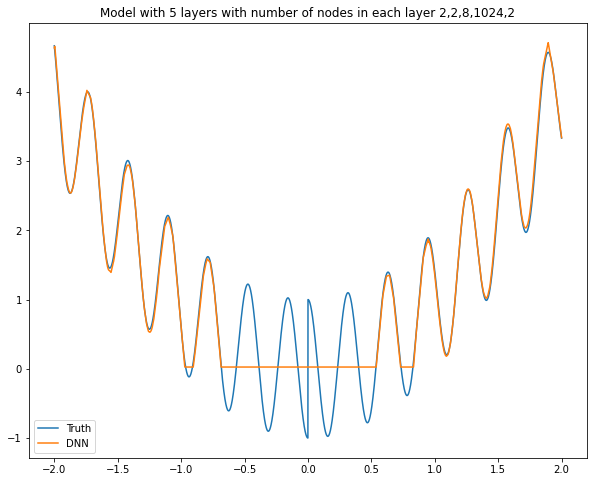

Model: "sequential_350"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2080 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2081 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2082 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2083 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2084 (Dense)           (None, 4)                 4100      
_________________________________________________________________
dense_2085 (Dense)           (None, 1)                 5         
Total params: 13,355
Trainable params: 13,355
Non-trainable params: 0
________________________________________________

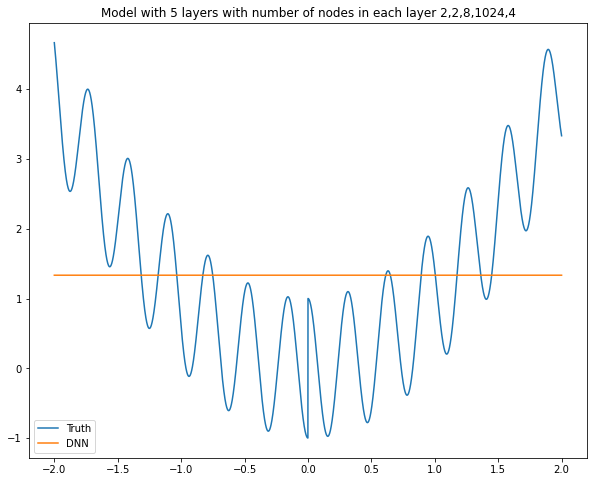

Model: "sequential_351"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2086 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2087 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2088 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2089 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2090 (Dense)           (None, 8)                 8200      
_________________________________________________________________
dense_2091 (Dense)           (None, 1)                 9         
Total params: 17,459
Trainable params: 17,459
Non-trainable params: 0
________________________________________________

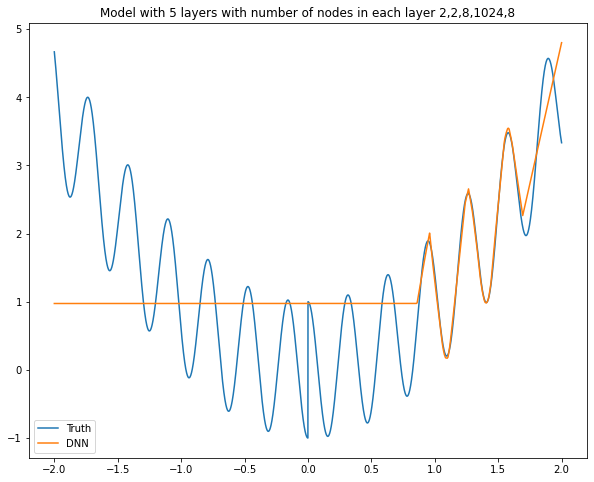

Model: "sequential_352"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2092 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2093 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2094 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2095 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2096 (Dense)           (None, 16)                16400     
_________________________________________________________________
dense_2097 (Dense)           (None, 1)                 17        
Total params: 25,667
Trainable params: 25,667
Non-trainable params: 0
________________________________________________

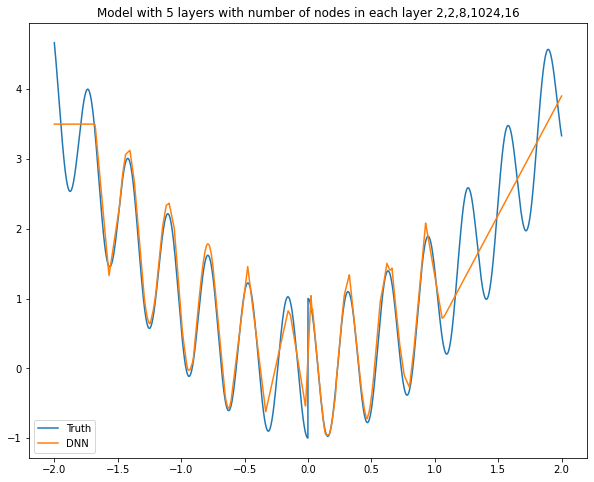

Model: "sequential_353"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2098 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2099 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2100 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2101 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2102 (Dense)           (None, 32)                32800     
_________________________________________________________________
dense_2103 (Dense)           (None, 1)                 33        
Total params: 42,083
Trainable params: 42,083
Non-trainable params: 0
________________________________________________

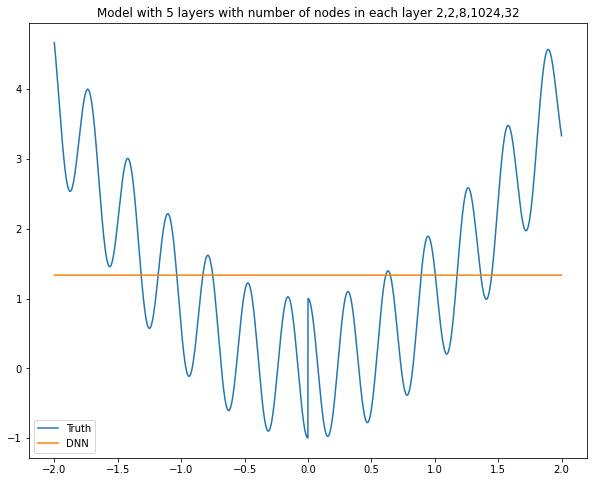

Model: "sequential_354"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2104 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2105 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2106 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2107 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2108 (Dense)           (None, 64)                65600     
_________________________________________________________________
dense_2109 (Dense)           (None, 1)                 65        
Total params: 74,915
Trainable params: 74,915
Non-trainable params: 0
________________________________________________

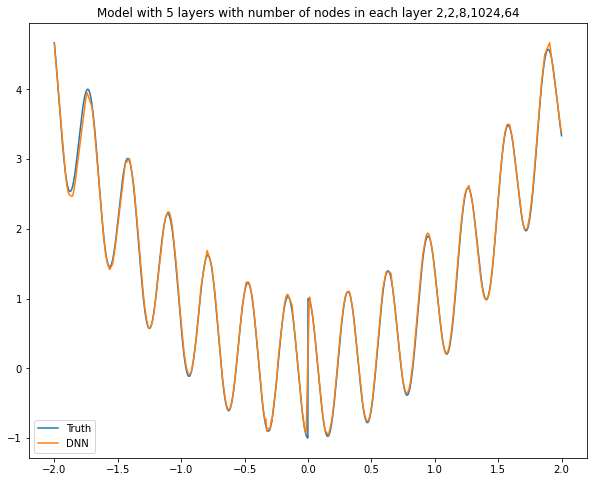

Model: "sequential_355"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2110 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2111 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2112 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2113 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2114 (Dense)           (None, 128)               131200    
_________________________________________________________________
dense_2115 (Dense)           (None, 1)                 129       
Total params: 140,579
Trainable params: 140,579
Non-trainable params: 0
______________________________________________

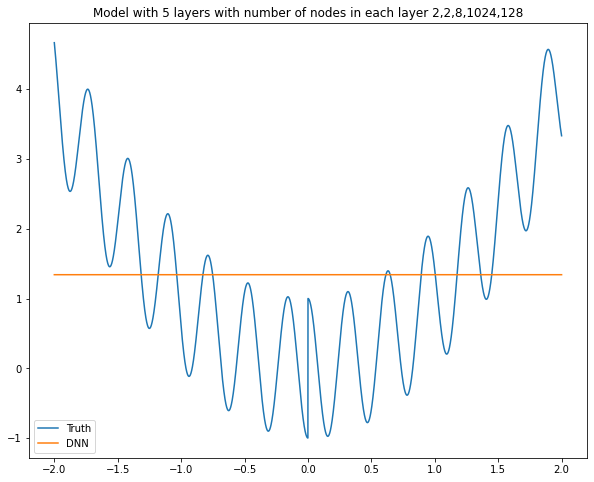

Model: "sequential_356"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2116 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2117 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2118 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2119 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2120 (Dense)           (None, 256)               262400    
_________________________________________________________________
dense_2121 (Dense)           (None, 1)                 257       
Total params: 271,907
Trainable params: 271,907
Non-trainable params: 0
______________________________________________

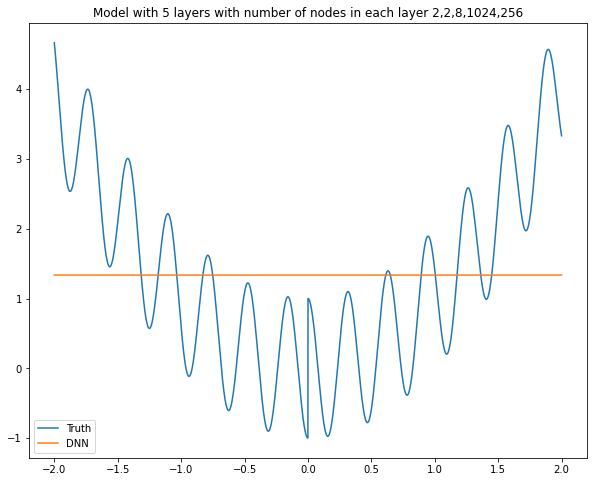

Model: "sequential_357"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2122 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2123 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2124 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2125 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2126 (Dense)           (None, 512)               524800    
_________________________________________________________________
dense_2127 (Dense)           (None, 1)                 513       
Total params: 534,563
Trainable params: 534,563
Non-trainable params: 0
______________________________________________

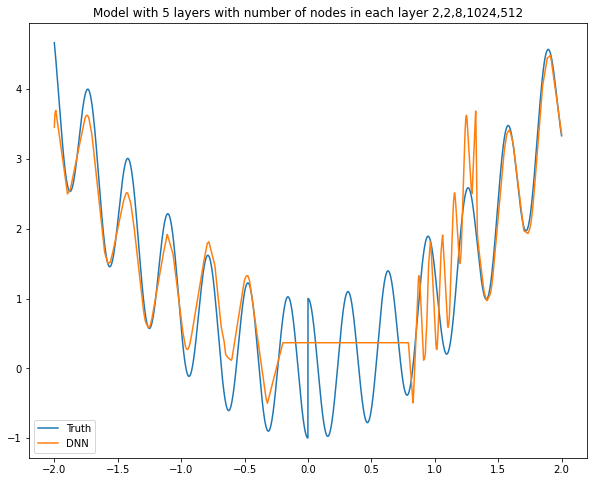

Model: "sequential_358"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2128 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2129 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2130 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2131 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2132 (Dense)           (None, 1024)              1049600   
_________________________________________________________________
dense_2133 (Dense)           (None, 1)                 1025      
Total params: 1,059,875
Trainable params: 1,059,875
Non-trainable params: 0
__________________________________________

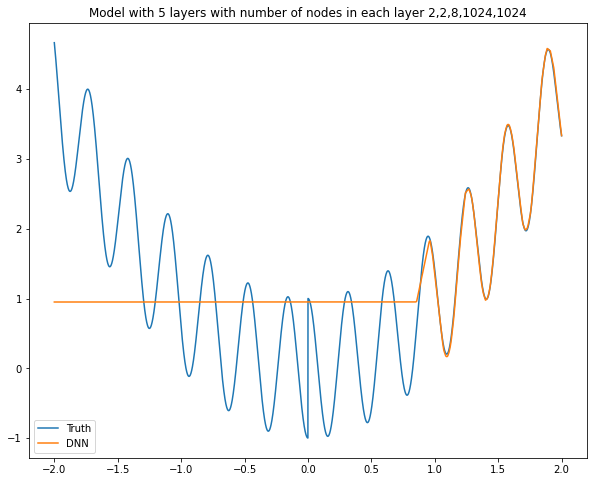

Model: "sequential_359"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2134 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2135 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2136 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2137 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2138 (Dense)           (None, 2048)              2099200   
_________________________________________________________________
dense_2139 (Dense)           (None, 1)                 2049      
Total params: 2,110,499
Trainable params: 2,110,499
Non-trainable params: 0
__________________________________________

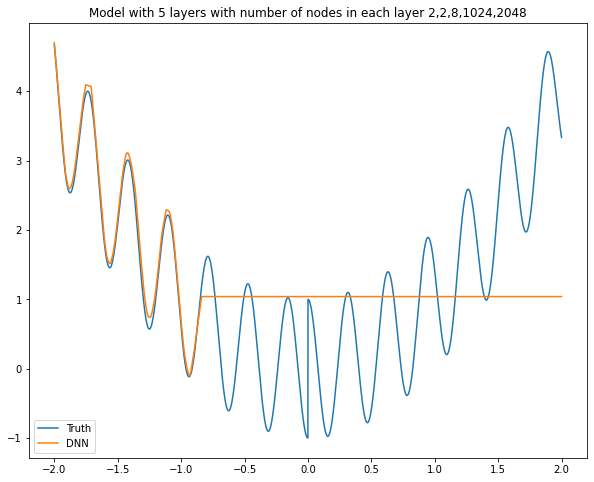

Model: "sequential_360"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2140 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2141 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2142 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2143 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2144 (Dense)           (None, 2)                 4098      
_________________________________________________________________
dense_2145 (Dense)           (None, 1)                 3         
Total params: 22,567
Trainable params: 22,567
Non-trainable params: 0
________________________________________________

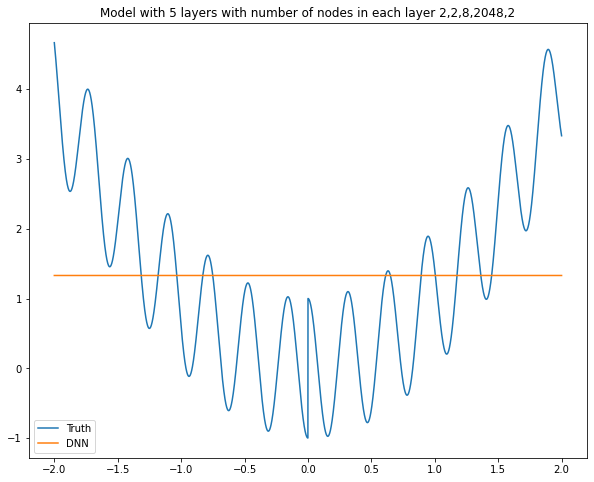

Model: "sequential_361"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2146 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2147 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2148 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2149 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2150 (Dense)           (None, 4)                 8196      
_________________________________________________________________
dense_2151 (Dense)           (None, 1)                 5         
Total params: 26,667
Trainable params: 26,667
Non-trainable params: 0
________________________________________________

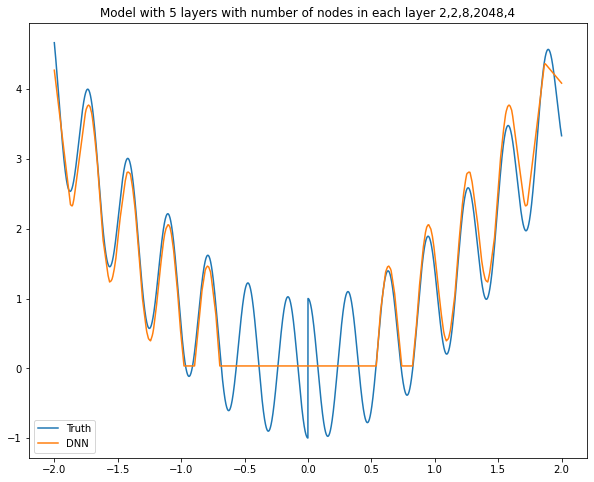

Model: "sequential_362"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2152 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2153 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2154 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2155 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2156 (Dense)           (None, 8)                 16392     
_________________________________________________________________
dense_2157 (Dense)           (None, 1)                 9         
Total params: 34,867
Trainable params: 34,867
Non-trainable params: 0
________________________________________________

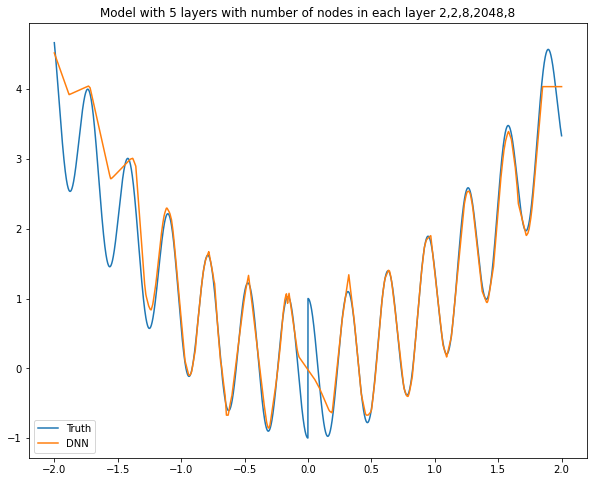

Model: "sequential_363"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2158 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2159 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2160 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2161 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2162 (Dense)           (None, 16)                32784     
_________________________________________________________________
dense_2163 (Dense)           (None, 1)                 17        
Total params: 51,267
Trainable params: 51,267
Non-trainable params: 0
________________________________________________

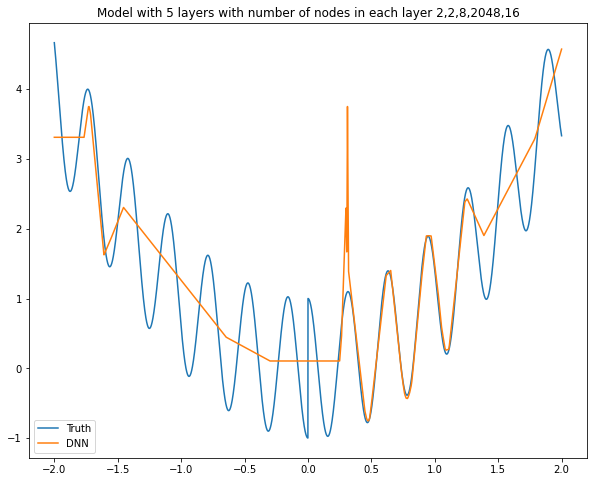

Model: "sequential_364"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2164 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2165 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2166 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2167 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2168 (Dense)           (None, 32)                65568     
_________________________________________________________________
dense_2169 (Dense)           (None, 1)                 33        
Total params: 84,067
Trainable params: 84,067
Non-trainable params: 0
________________________________________________

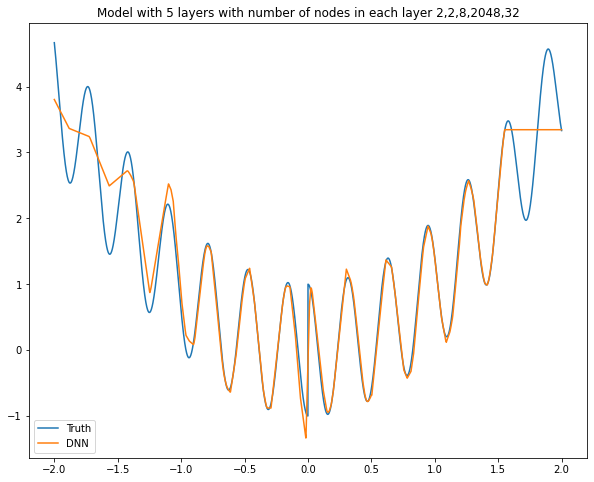

Model: "sequential_365"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2170 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2171 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2172 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2173 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2174 (Dense)           (None, 64)                131136    
_________________________________________________________________
dense_2175 (Dense)           (None, 1)                 65        
Total params: 149,667
Trainable params: 149,667
Non-trainable params: 0
______________________________________________

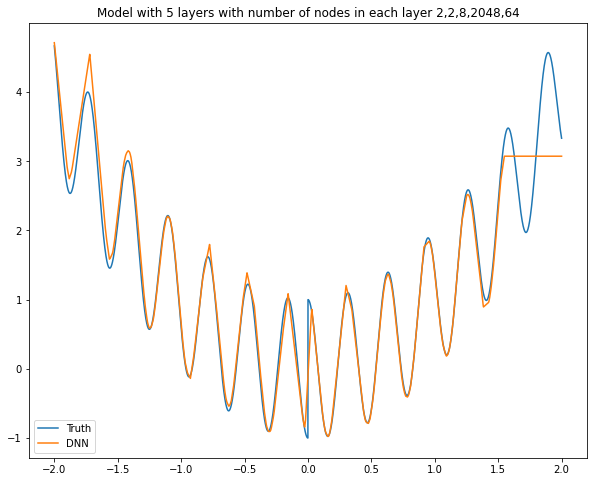

Model: "sequential_366"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2176 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2177 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2178 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2179 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2180 (Dense)           (None, 128)               262272    
_________________________________________________________________
dense_2181 (Dense)           (None, 1)                 129       
Total params: 280,867
Trainable params: 280,867
Non-trainable params: 0
______________________________________________

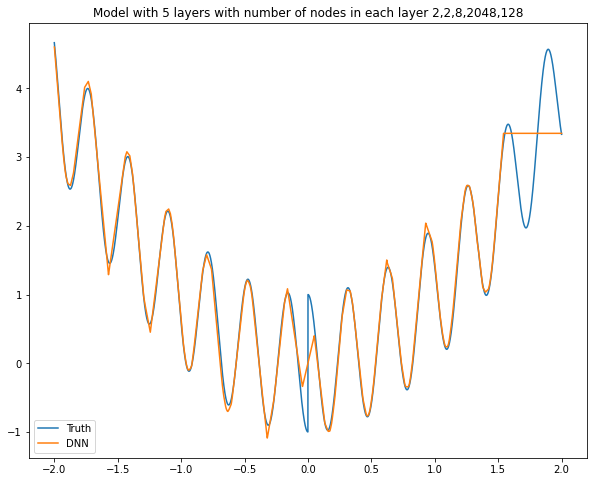

Model: "sequential_367"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2182 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2183 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2184 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2185 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2186 (Dense)           (None, 256)               524544    
_________________________________________________________________
dense_2187 (Dense)           (None, 1)                 257       
Total params: 543,267
Trainable params: 543,267
Non-trainable params: 0
______________________________________________

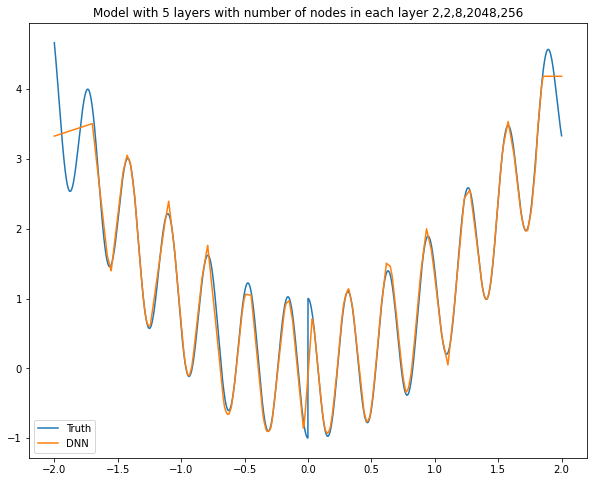

Model: "sequential_368"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2188 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2189 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2190 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2191 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2192 (Dense)           (None, 512)               1049088   
_________________________________________________________________
dense_2193 (Dense)           (None, 1)                 513       
Total params: 1,068,067
Trainable params: 1,068,067
Non-trainable params: 0
__________________________________________

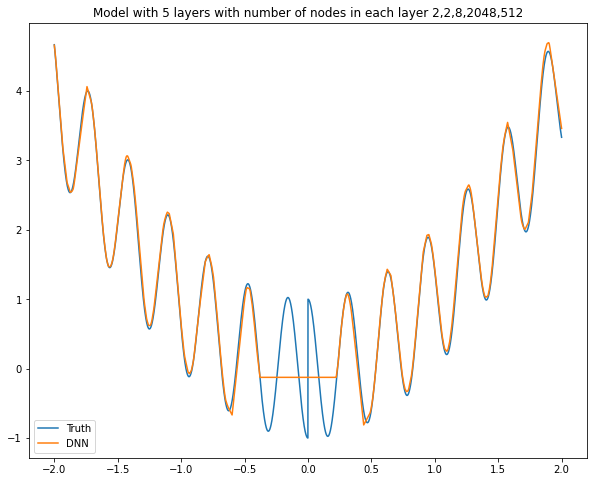

Model: "sequential_369"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2194 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2195 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2196 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2197 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2198 (Dense)           (None, 1024)              2098176   
_________________________________________________________________
dense_2199 (Dense)           (None, 1)                 1025      
Total params: 2,117,667
Trainable params: 2,117,667
Non-trainable params: 0
__________________________________________

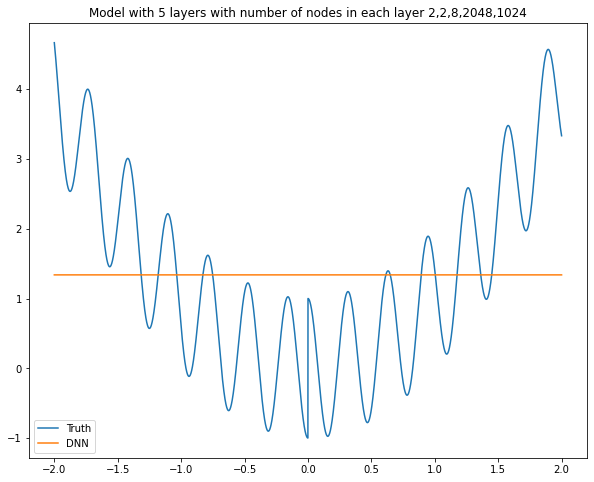

Model: "sequential_370"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2200 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2201 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2202 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2203 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2204 (Dense)           (None, 2048)              4196352   
_________________________________________________________________
dense_2205 (Dense)           (None, 1)                 2049      
Total params: 4,216,867
Trainable params: 4,216,867
Non-trainable params: 0
__________________________________________

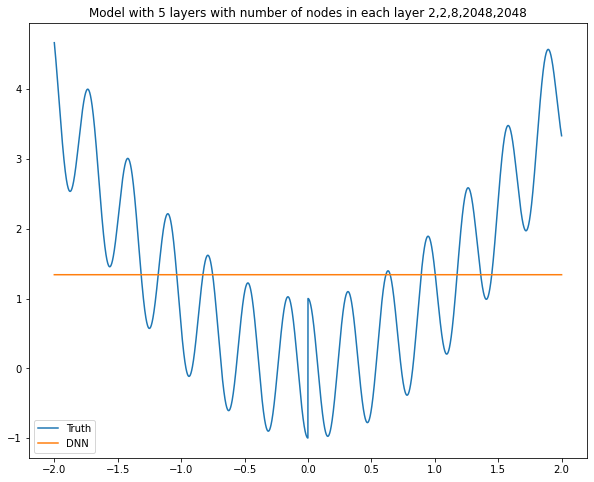

Model: "sequential_371"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2206 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2207 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2208 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2209 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2210 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2211 (Dense)           (None, 1)                 3         
Total params: 101
Trainable params: 101
Non-trainable params: 0
______________________________________________________

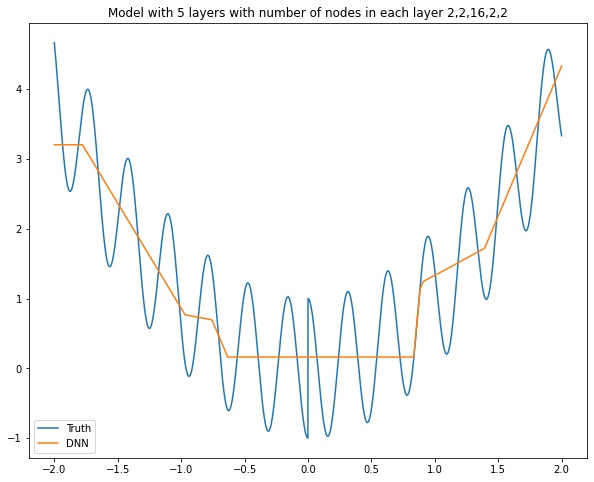

Model: "sequential_372"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2212 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2213 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2214 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2215 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2216 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_2217 (Dense)           (None, 1)                 5         
Total params: 109
Trainable params: 109
Non-trainable params: 0
______________________________________________________

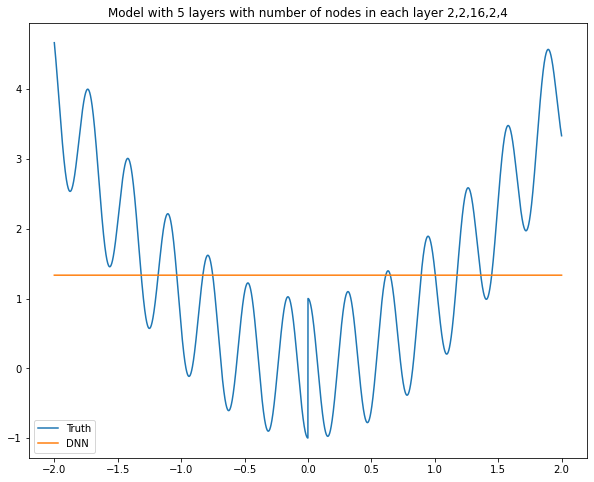

Model: "sequential_373"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2218 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2219 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2220 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2221 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2222 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2223 (Dense)           (None, 1)                 9         
Total params: 125
Trainable params: 125
Non-trainable params: 0
______________________________________________________

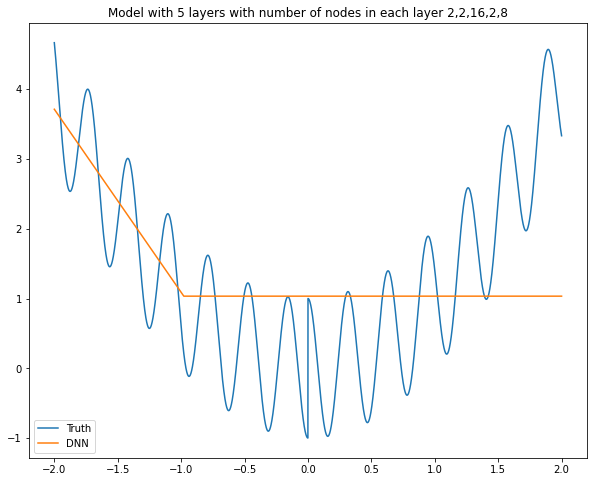

Model: "sequential_374"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2224 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2225 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2226 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2227 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2228 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2229 (Dense)           (None, 1)                 17        
Total params: 157
Trainable params: 157
Non-trainable params: 0
______________________________________________________

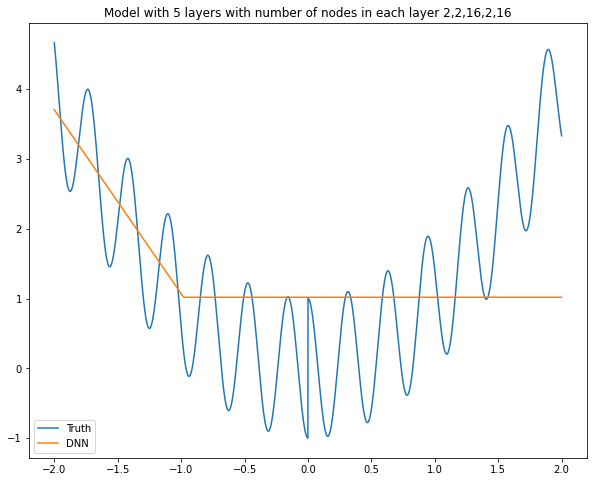

Model: "sequential_375"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2230 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2231 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2232 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2233 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2234 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2235 (Dense)           (None, 1)                 33        
Total params: 221
Trainable params: 221
Non-trainable params: 0
______________________________________________________

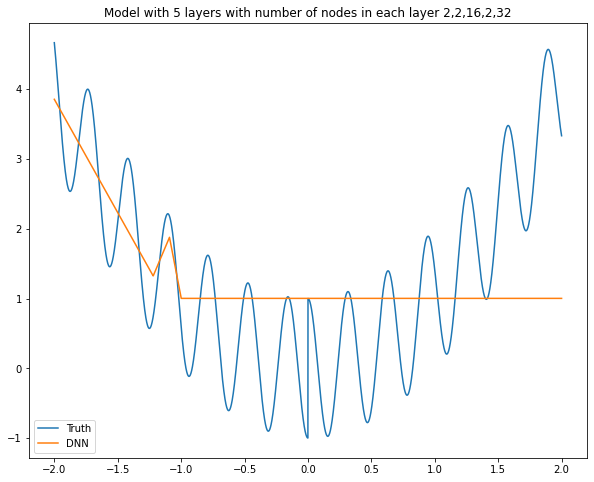

Model: "sequential_376"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2236 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2237 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2238 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2239 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2240 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_2241 (Dense)           (None, 1)                 65        
Total params: 349
Trainable params: 349
Non-trainable params: 0
______________________________________________________

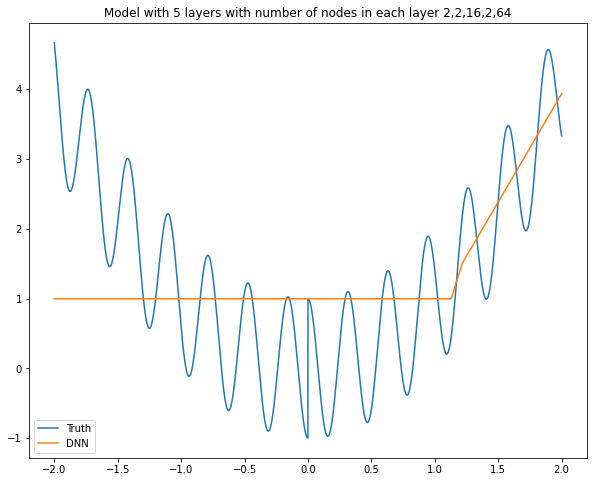

Model: "sequential_377"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2242 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2243 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2244 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2245 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2246 (Dense)           (None, 128)               384       
_________________________________________________________________
dense_2247 (Dense)           (None, 1)                 129       
Total params: 605
Trainable params: 605
Non-trainable params: 0
______________________________________________________

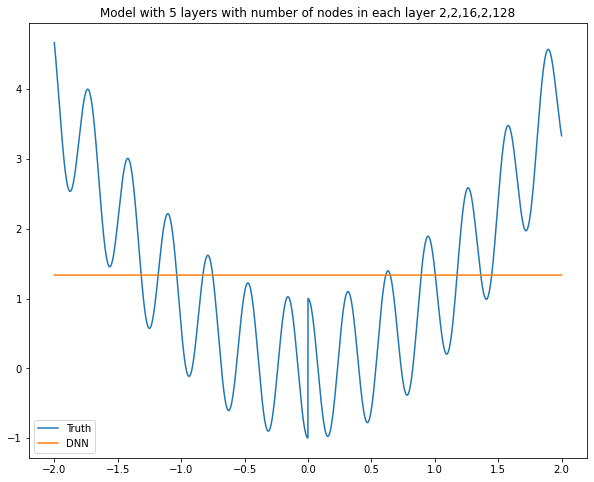

Model: "sequential_378"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2248 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2249 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2250 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2251 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2252 (Dense)           (None, 256)               768       
_________________________________________________________________
dense_2253 (Dense)           (None, 1)                 257       
Total params: 1,117
Trainable params: 1,117
Non-trainable params: 0
__________________________________________________

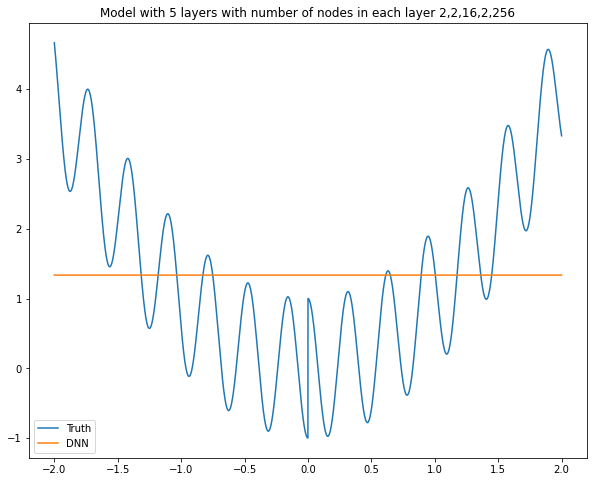

Model: "sequential_379"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2254 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2255 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2256 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2257 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2258 (Dense)           (None, 512)               1536      
_________________________________________________________________
dense_2259 (Dense)           (None, 1)                 513       
Total params: 2,141
Trainable params: 2,141
Non-trainable params: 0
__________________________________________________

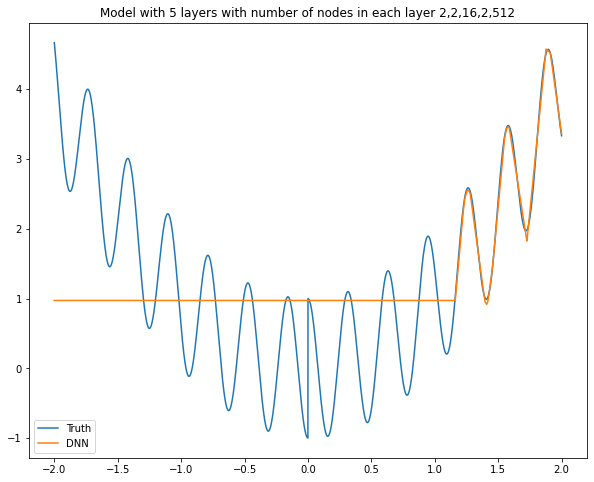

Model: "sequential_380"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2260 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2261 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2262 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2263 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2264 (Dense)           (None, 1024)              3072      
_________________________________________________________________
dense_2265 (Dense)           (None, 1)                 1025      
Total params: 4,189
Trainable params: 4,189
Non-trainable params: 0
__________________________________________________

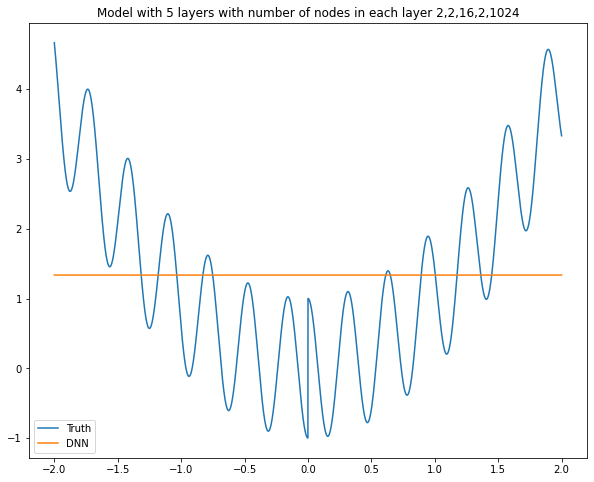

Model: "sequential_381"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2266 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2267 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2268 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2269 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2270 (Dense)           (None, 2048)              6144      
_________________________________________________________________
dense_2271 (Dense)           (None, 1)                 2049      
Total params: 8,285
Trainable params: 8,285
Non-trainable params: 0
__________________________________________________

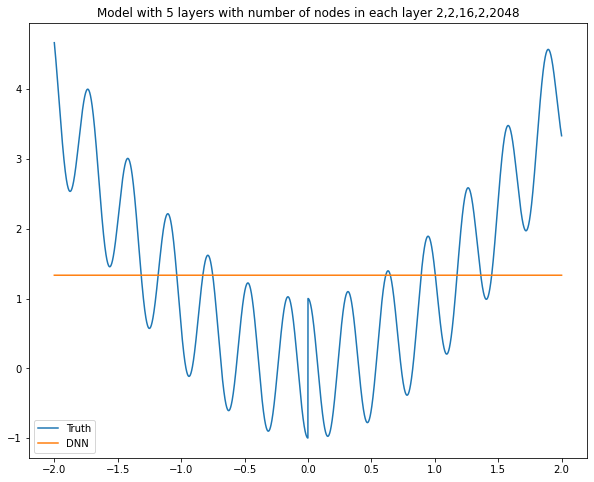

Model: "sequential_382"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2272 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2273 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2274 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2275 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2276 (Dense)           (None, 2)                 10        
_________________________________________________________________
dense_2277 (Dense)           (None, 1)                 3         
Total params: 139
Trainable params: 139
Non-trainable params: 0
______________________________________________________

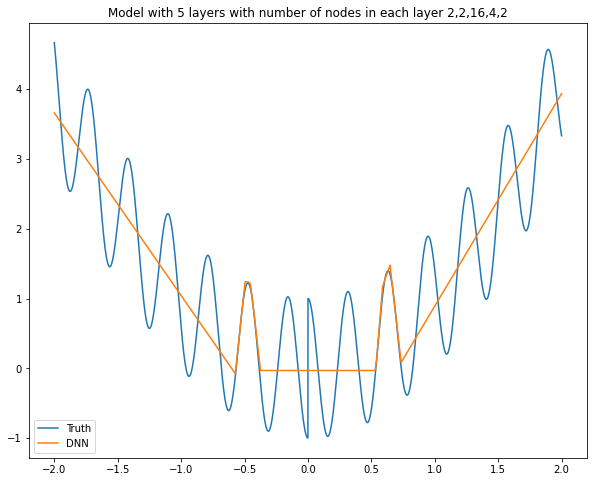

Model: "sequential_383"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2278 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2279 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2280 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2281 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2282 (Dense)           (None, 4)                 20        
_________________________________________________________________
dense_2283 (Dense)           (None, 1)                 5         
Total params: 151
Trainable params: 151
Non-trainable params: 0
______________________________________________________

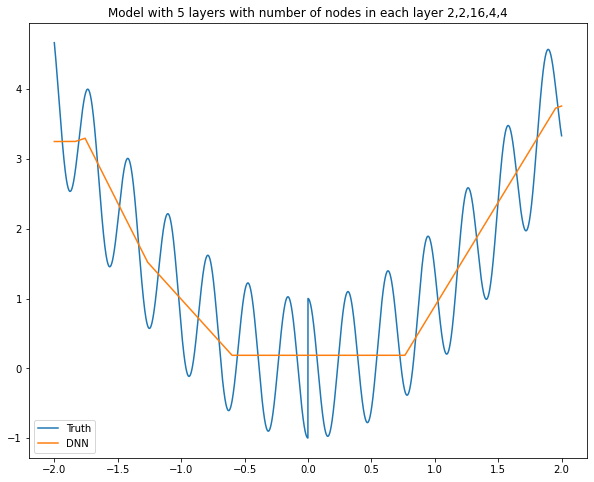

Model: "sequential_384"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2284 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2285 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2286 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2287 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2288 (Dense)           (None, 8)                 40        
_________________________________________________________________
dense_2289 (Dense)           (None, 1)                 9         
Total params: 175
Trainable params: 175
Non-trainable params: 0
______________________________________________________

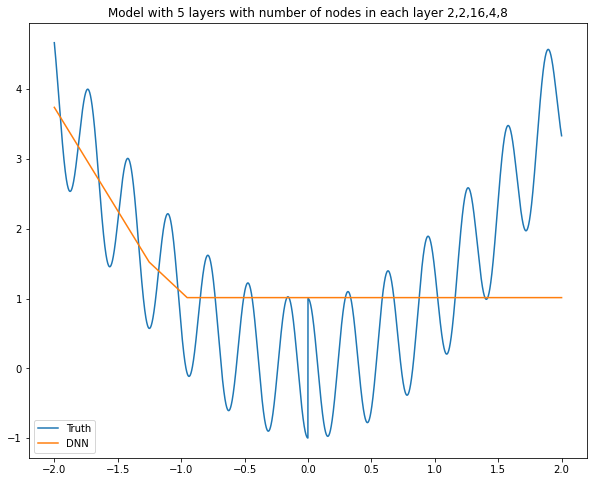

Model: "sequential_385"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2290 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2291 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2292 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2293 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2294 (Dense)           (None, 16)                80        
_________________________________________________________________
dense_2295 (Dense)           (None, 1)                 17        
Total params: 223
Trainable params: 223
Non-trainable params: 0
______________________________________________________

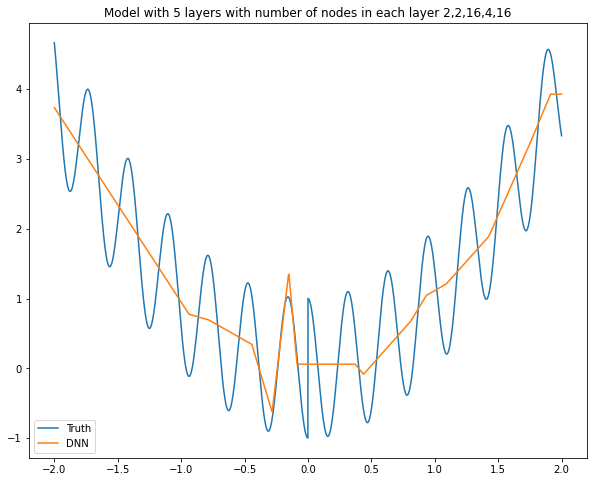

Model: "sequential_386"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2296 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2297 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2298 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2299 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2300 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_2301 (Dense)           (None, 1)                 33        
Total params: 319
Trainable params: 319
Non-trainable params: 0
______________________________________________________

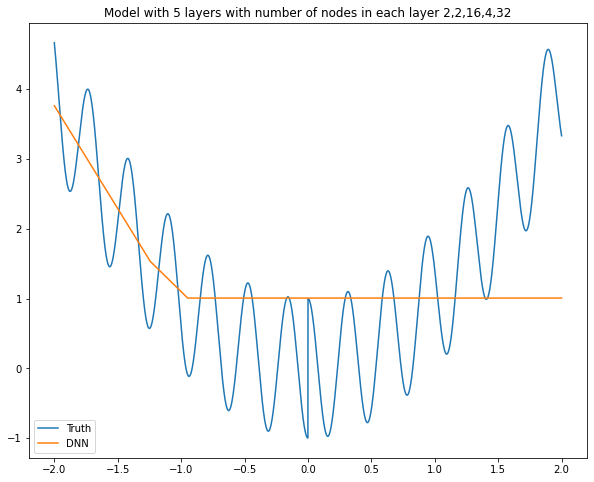

Model: "sequential_387"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2302 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2303 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2304 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2305 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2306 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_2307 (Dense)           (None, 1)                 65        
Total params: 511
Trainable params: 511
Non-trainable params: 0
______________________________________________________

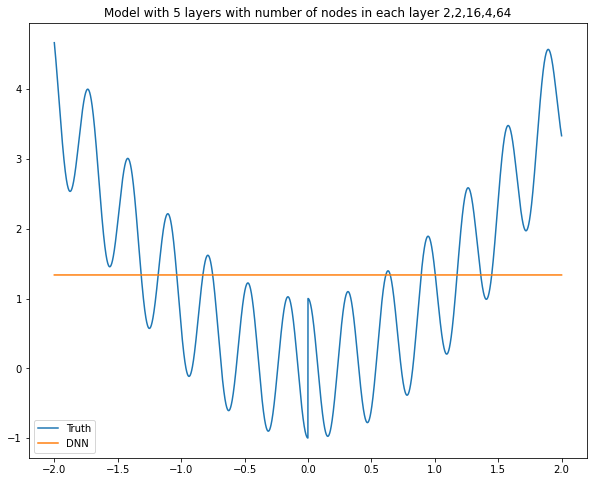

Model: "sequential_388"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2308 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2309 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2310 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2311 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2312 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_2313 (Dense)           (None, 1)                 129       
Total params: 895
Trainable params: 895
Non-trainable params: 0
______________________________________________________

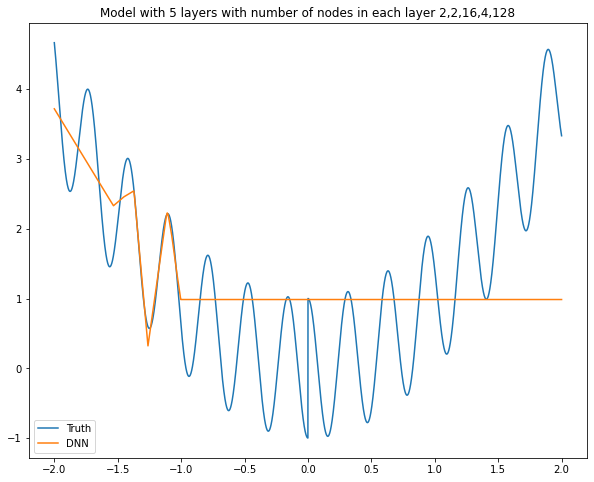

Model: "sequential_389"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2314 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2315 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2316 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2317 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2318 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_2319 (Dense)           (None, 1)                 257       
Total params: 1,663
Trainable params: 1,663
Non-trainable params: 0
__________________________________________________

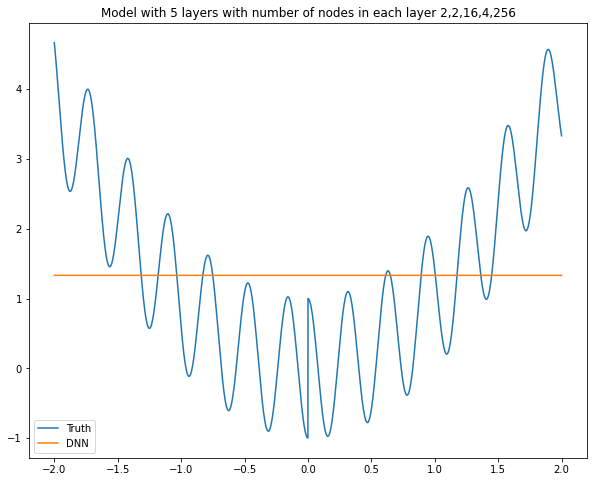

Model: "sequential_390"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2320 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2321 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2322 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2323 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2324 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_2325 (Dense)           (None, 1)                 513       
Total params: 3,199
Trainable params: 3,199
Non-trainable params: 0
__________________________________________________

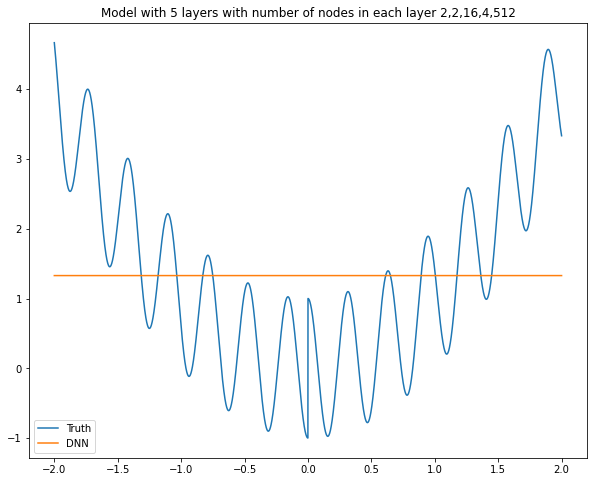

Model: "sequential_391"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2326 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2327 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2328 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2329 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2330 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_2331 (Dense)           (None, 1)                 1025      
Total params: 6,271
Trainable params: 6,271
Non-trainable params: 0
__________________________________________________

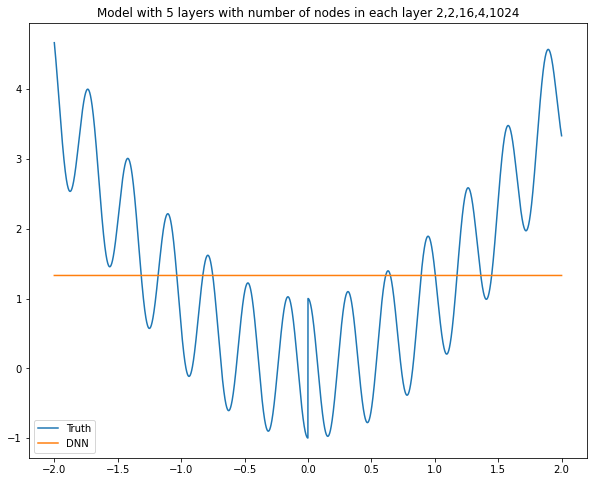

Model: "sequential_392"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2332 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2333 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2334 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2335 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2336 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_2337 (Dense)           (None, 1)                 2049      
Total params: 12,415
Trainable params: 12,415
Non-trainable params: 0
________________________________________________

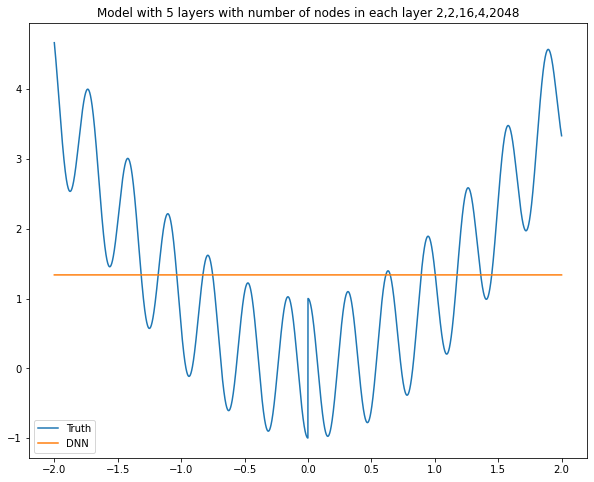

Model: "sequential_393"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2338 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2339 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2340 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2341 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2342 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_2343 (Dense)           (None, 1)                 3         
Total params: 215
Trainable params: 215
Non-trainable params: 0
______________________________________________________

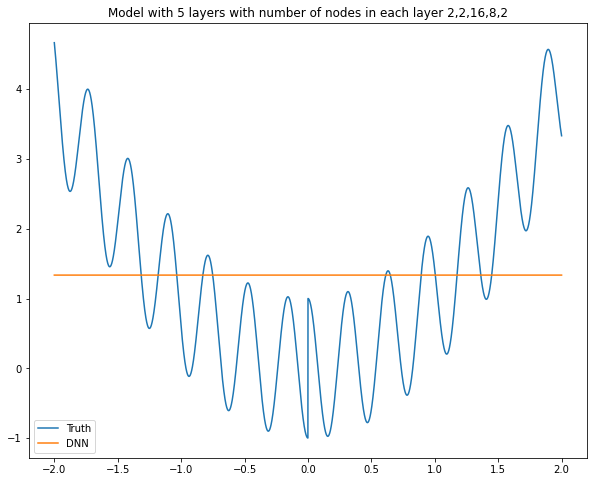

Model: "sequential_394"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2344 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2345 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2346 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2347 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2348 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_2349 (Dense)           (None, 1)                 5         
Total params: 235
Trainable params: 235
Non-trainable params: 0
______________________________________________________

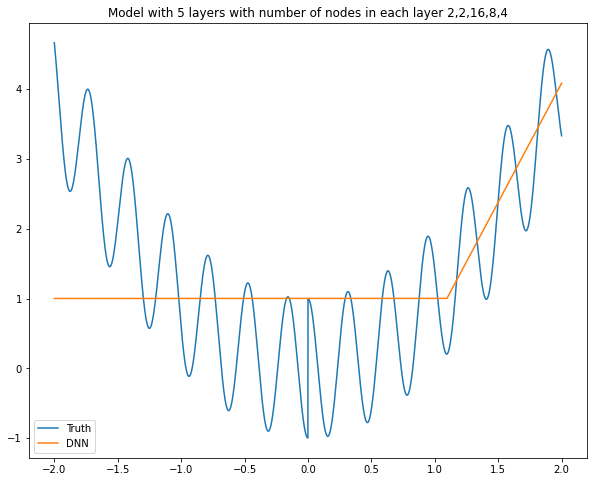

Model: "sequential_395"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2350 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2351 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2352 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2353 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2354 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_2355 (Dense)           (None, 1)                 9         
Total params: 275
Trainable params: 275
Non-trainable params: 0
______________________________________________________

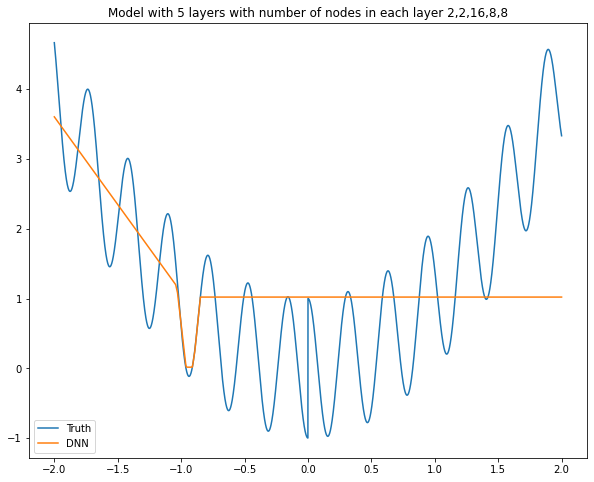

Model: "sequential_396"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2356 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2357 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2358 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2359 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2360 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_2361 (Dense)           (None, 1)                 17        
Total params: 355
Trainable params: 355
Non-trainable params: 0
______________________________________________________

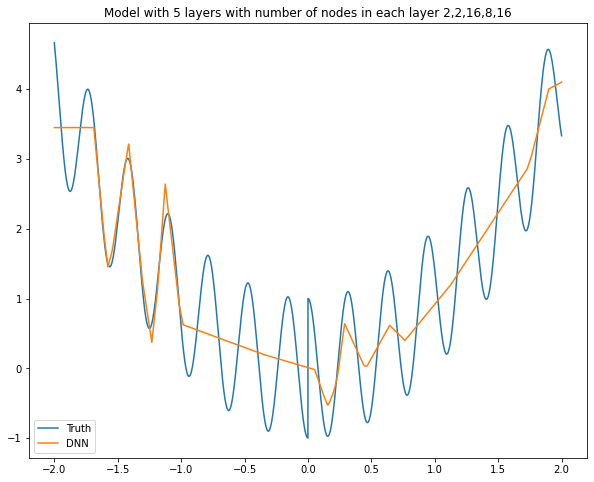

Model: "sequential_397"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2362 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2363 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2364 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2365 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2366 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_2367 (Dense)           (None, 1)                 33        
Total params: 515
Trainable params: 515
Non-trainable params: 0
______________________________________________________

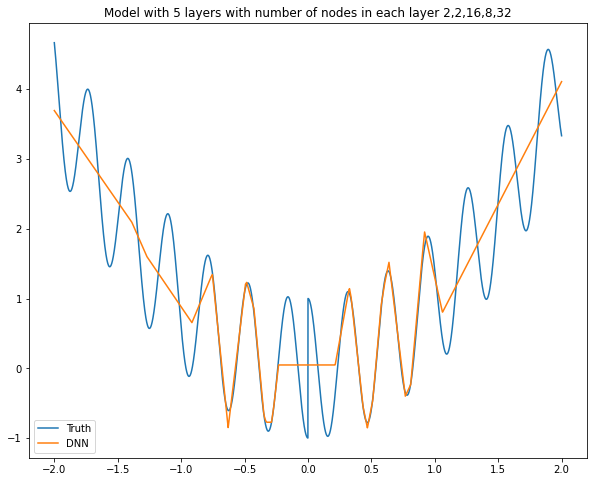

Model: "sequential_398"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2368 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2369 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2370 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2371 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2372 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_2373 (Dense)           (None, 1)                 65        
Total params: 835
Trainable params: 835
Non-trainable params: 0
______________________________________________________

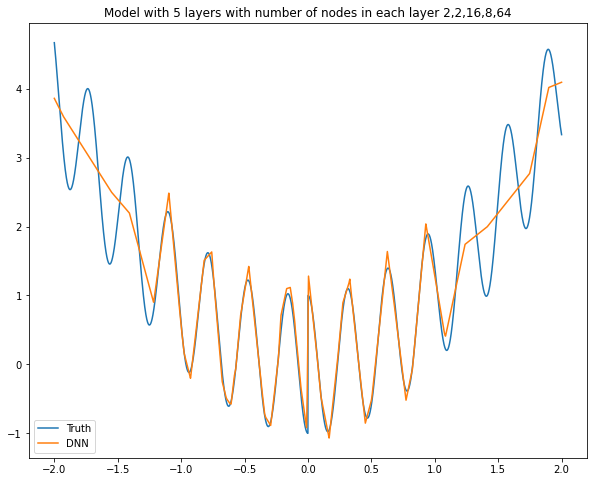

Model: "sequential_399"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2374 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2375 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2376 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2377 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2378 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_2379 (Dense)           (None, 1)                 129       
Total params: 1,475
Trainable params: 1,475
Non-trainable params: 0
__________________________________________________

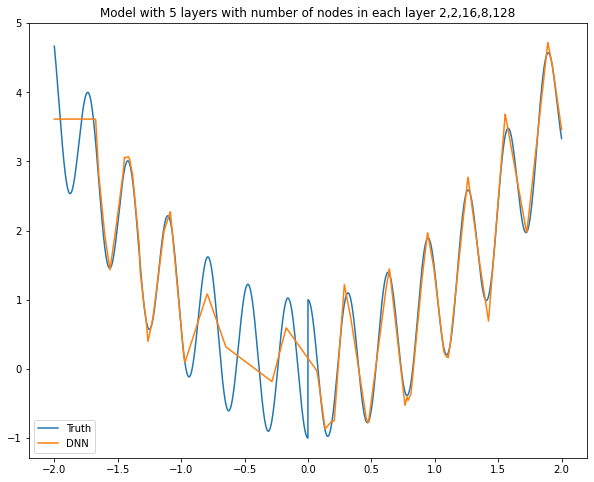

Model: "sequential_400"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2380 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2381 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2382 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2383 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2384 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_2385 (Dense)           (None, 1)                 257       
Total params: 2,755
Trainable params: 2,755
Non-trainable params: 0
__________________________________________________

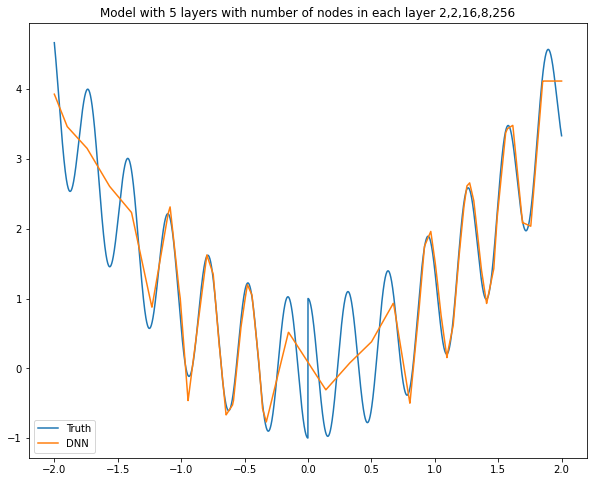

Model: "sequential_401"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2386 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2387 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2388 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2389 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2390 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_2391 (Dense)           (None, 1)                 513       
Total params: 5,315
Trainable params: 5,315
Non-trainable params: 0
__________________________________________________

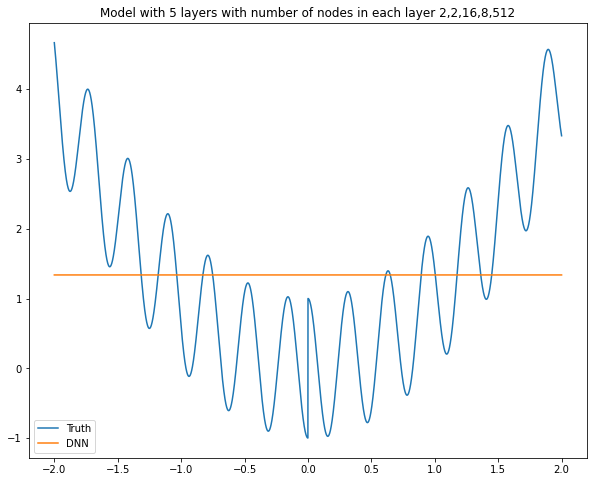

Model: "sequential_402"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2392 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2393 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2394 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2395 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2396 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_2397 (Dense)           (None, 1)                 1025      
Total params: 10,435
Trainable params: 10,435
Non-trainable params: 0
________________________________________________

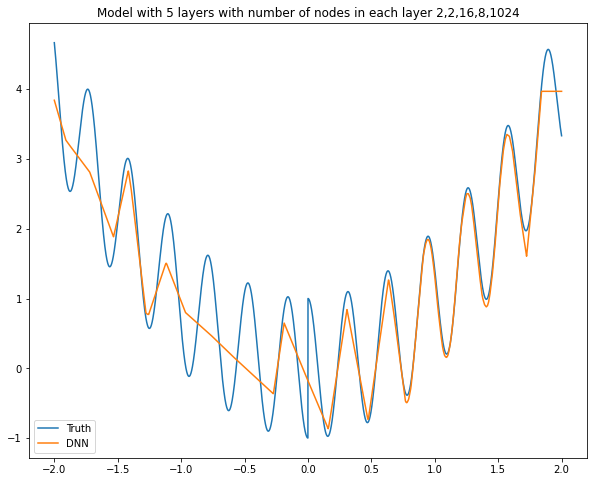

Model: "sequential_403"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2398 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2399 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2400 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2401 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2402 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_2403 (Dense)           (None, 1)                 2049      
Total params: 20,675
Trainable params: 20,675
Non-trainable params: 0
________________________________________________

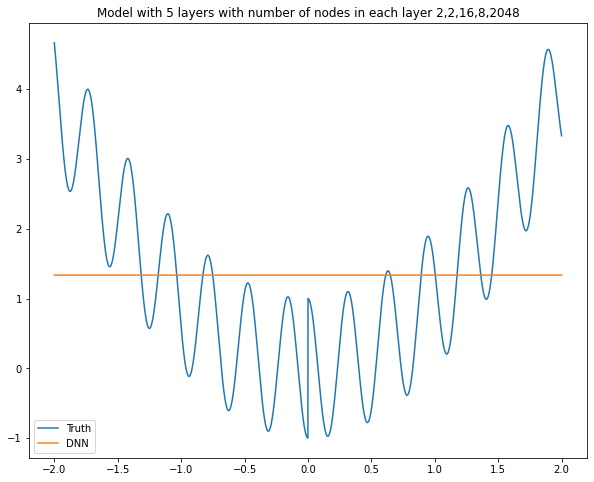

Model: "sequential_404"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2404 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2405 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2406 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2407 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2408 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_2409 (Dense)           (None, 1)                 3         
Total params: 367
Trainable params: 367
Non-trainable params: 0
______________________________________________________

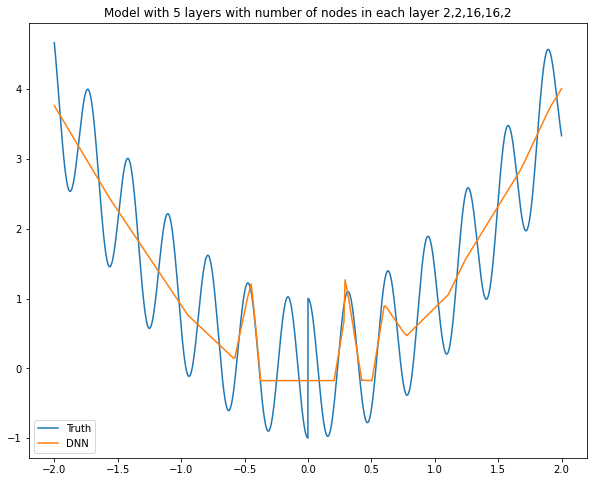

Model: "sequential_405"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2410 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2411 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2412 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2413 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2414 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_2415 (Dense)           (None, 1)                 5         
Total params: 403
Trainable params: 403
Non-trainable params: 0
______________________________________________________

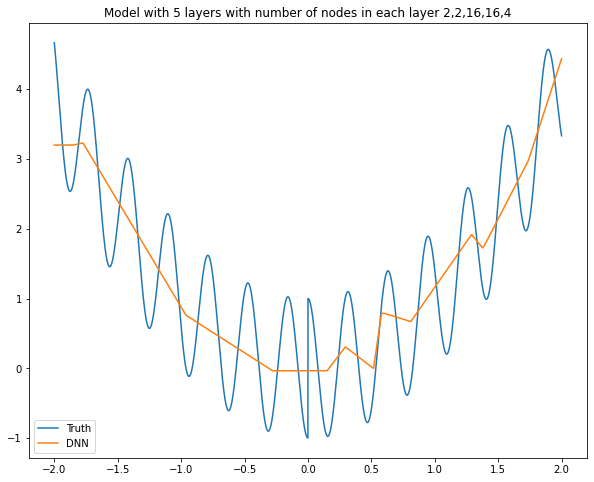

Model: "sequential_406"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2416 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2417 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2418 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2419 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2420 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_2421 (Dense)           (None, 1)                 9         
Total params: 475
Trainable params: 475
Non-trainable params: 0
______________________________________________________

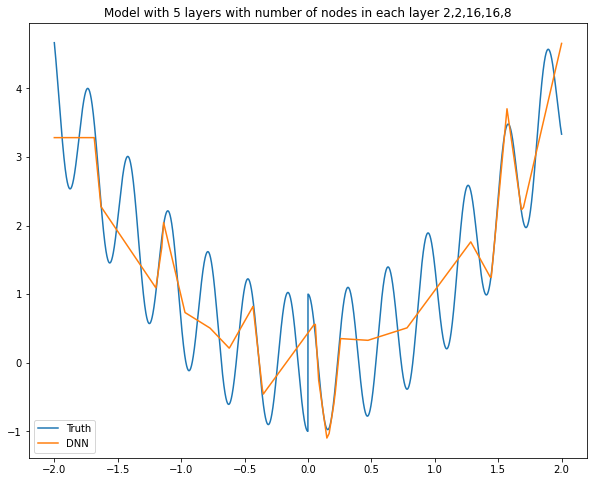

Model: "sequential_407"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2422 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2423 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2424 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2425 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2426 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2427 (Dense)           (None, 1)                 17        
Total params: 619
Trainable params: 619
Non-trainable params: 0
______________________________________________________

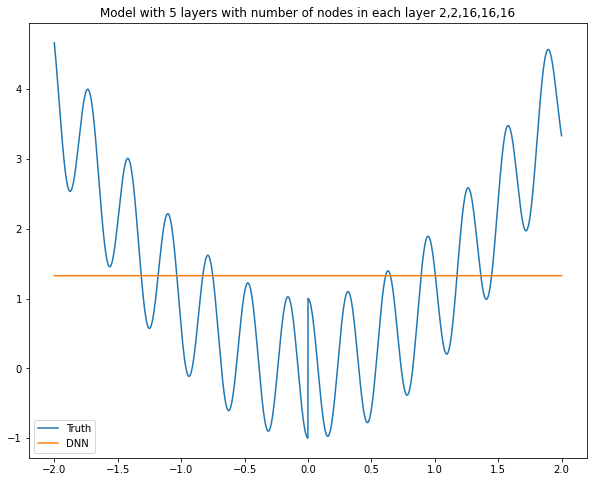

Model: "sequential_408"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2428 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2429 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2430 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2431 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2432 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2433 (Dense)           (None, 1)                 33        
Total params: 907
Trainable params: 907
Non-trainable params: 0
______________________________________________________

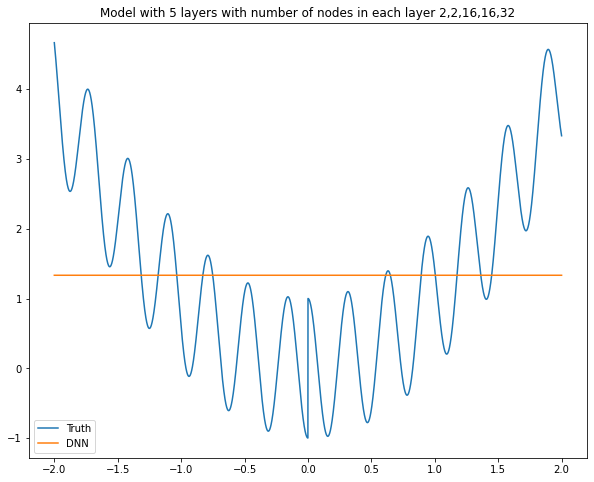

Model: "sequential_409"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2434 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2435 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2436 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2437 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2438 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2439 (Dense)           (None, 1)                 65        
Total params: 1,483
Trainable params: 1,483
Non-trainable params: 0
__________________________________________________

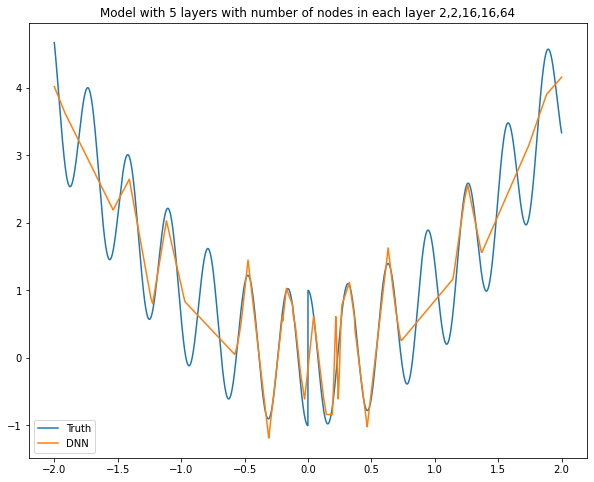

Model: "sequential_410"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2440 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2441 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2442 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2443 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2444 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2445 (Dense)           (None, 1)                 129       
Total params: 2,635
Trainable params: 2,635
Non-trainable params: 0
__________________________________________________

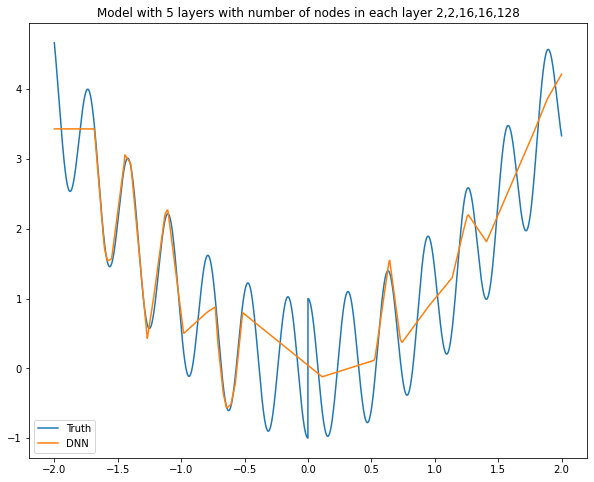

Model: "sequential_411"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2446 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2447 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2448 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2449 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2450 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2451 (Dense)           (None, 1)                 257       
Total params: 4,939
Trainable params: 4,939
Non-trainable params: 0
__________________________________________________

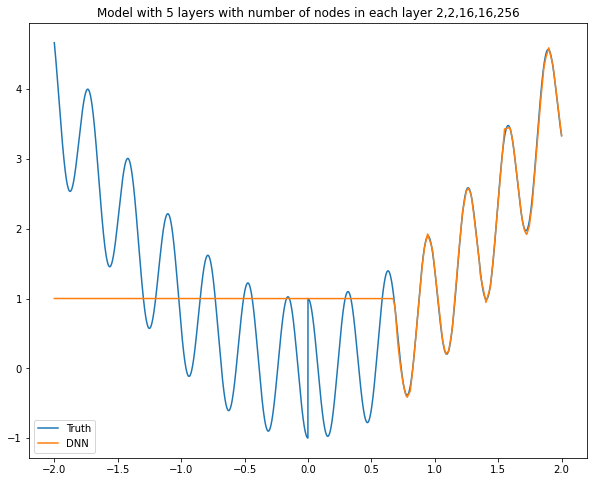

Model: "sequential_412"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2452 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2453 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2454 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2455 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2456 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2457 (Dense)           (None, 1)                 513       
Total params: 9,547
Trainable params: 9,547
Non-trainable params: 0
__________________________________________________

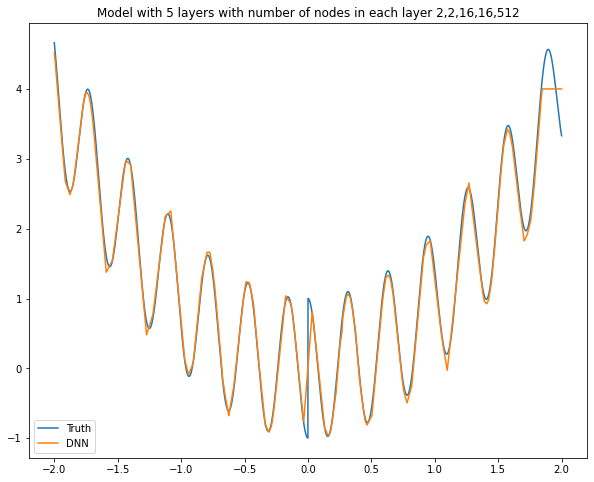

Model: "sequential_413"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2458 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2459 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2460 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2461 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2462 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2463 (Dense)           (None, 1)                 1025      
Total params: 18,763
Trainable params: 18,763
Non-trainable params: 0
________________________________________________

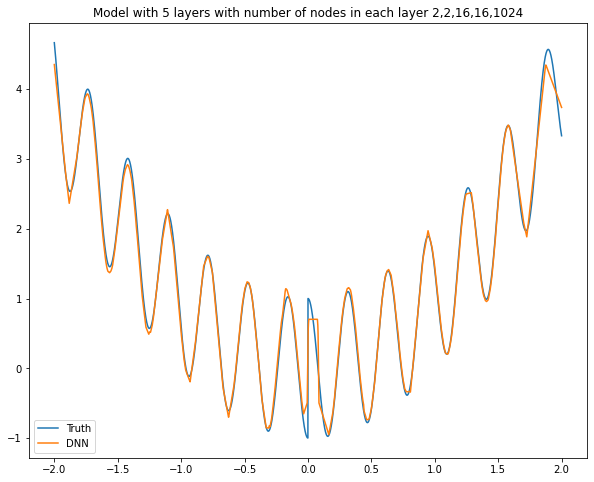

Model: "sequential_414"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2464 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2465 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2466 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2467 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_2468 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2469 (Dense)           (None, 1)                 2049      
Total params: 37,195
Trainable params: 37,195
Non-trainable params: 0
________________________________________________

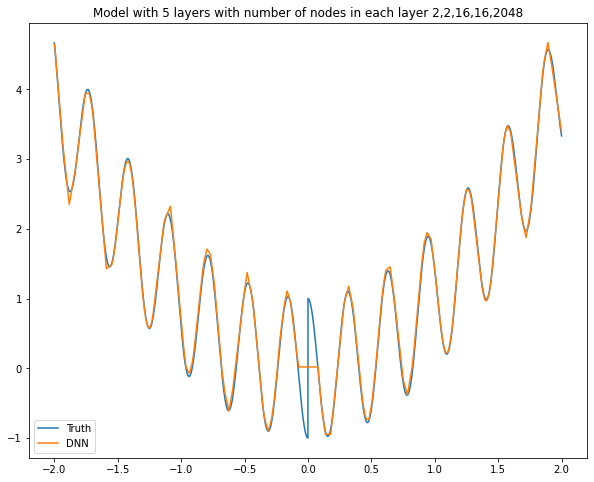

Model: "sequential_415"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2470 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2471 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2472 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2473 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2474 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2475 (Dense)           (None, 1)                 3         
Total params: 671
Trainable params: 671
Non-trainable params: 0
______________________________________________________

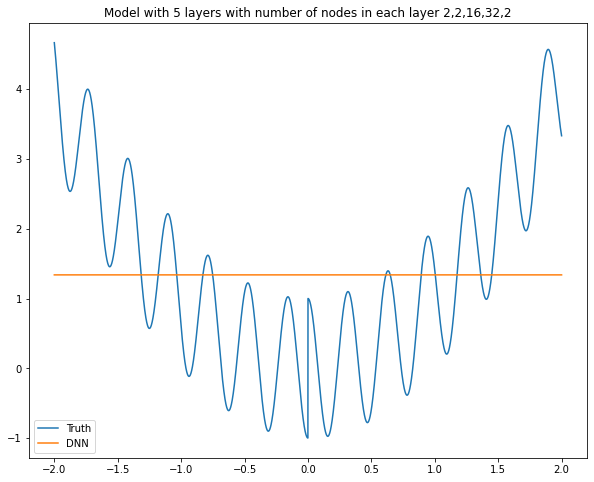

Model: "sequential_416"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2476 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2477 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2478 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2479 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2480 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_2481 (Dense)           (None, 1)                 5         
Total params: 739
Trainable params: 739
Non-trainable params: 0
______________________________________________________

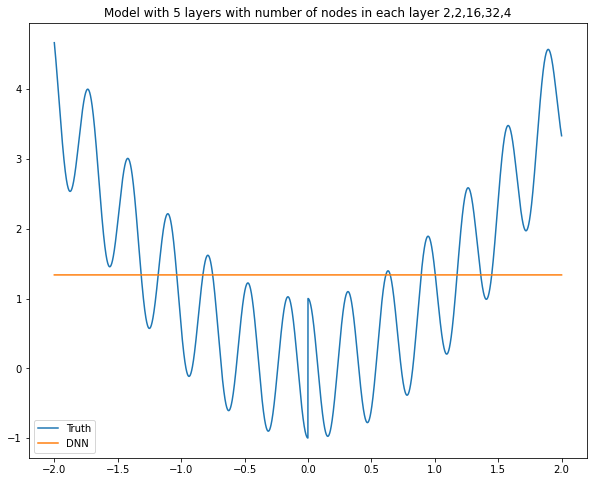

Model: "sequential_417"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2482 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2483 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2484 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2485 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2486 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_2487 (Dense)           (None, 1)                 9         
Total params: 875
Trainable params: 875
Non-trainable params: 0
______________________________________________________

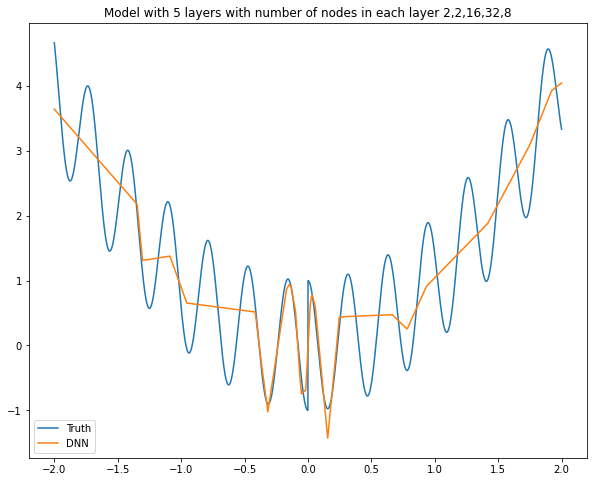

Model: "sequential_418"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2488 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2489 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2490 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2491 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2492 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_2493 (Dense)           (None, 1)                 17        
Total params: 1,147
Trainable params: 1,147
Non-trainable params: 0
__________________________________________________

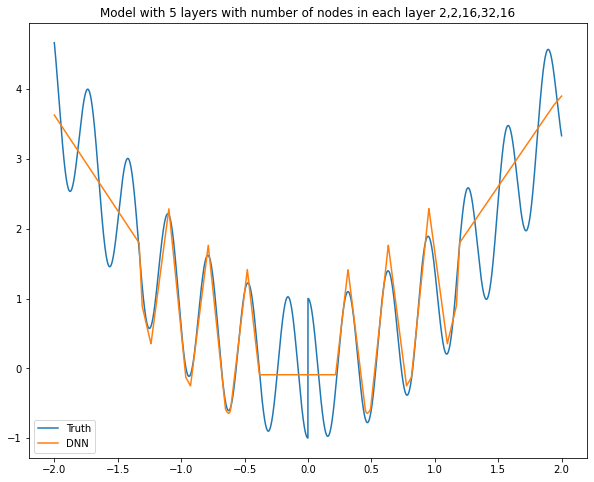

Model: "sequential_419"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2494 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2495 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2496 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2497 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2498 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_2499 (Dense)           (None, 1)                 33        
Total params: 1,691
Trainable params: 1,691
Non-trainable params: 0
__________________________________________________

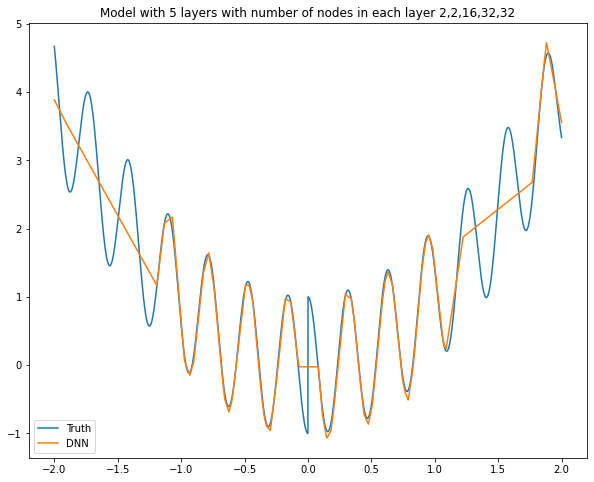

Model: "sequential_420"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2500 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2501 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2502 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2503 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2504 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_2505 (Dense)           (None, 1)                 65        
Total params: 2,779
Trainable params: 2,779
Non-trainable params: 0
__________________________________________________

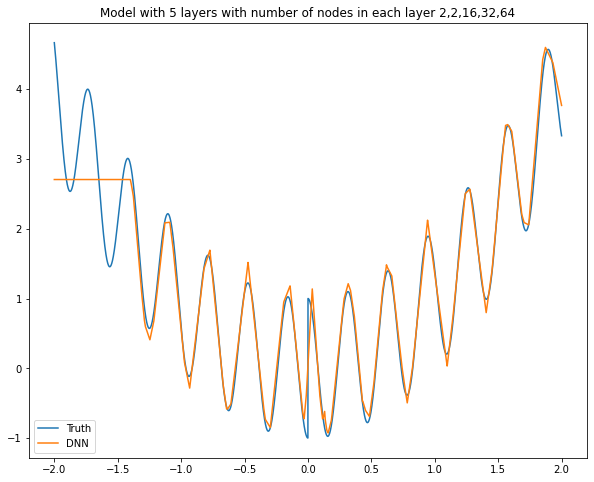

Model: "sequential_421"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2506 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2507 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2508 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2509 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2510 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_2511 (Dense)           (None, 1)                 129       
Total params: 4,955
Trainable params: 4,955
Non-trainable params: 0
__________________________________________________

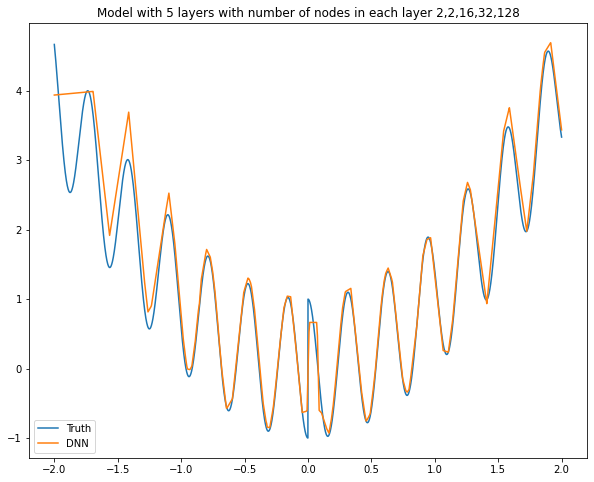

Model: "sequential_422"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2512 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2513 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2514 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2515 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2516 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_2517 (Dense)           (None, 1)                 257       
Total params: 9,307
Trainable params: 9,307
Non-trainable params: 0
__________________________________________________

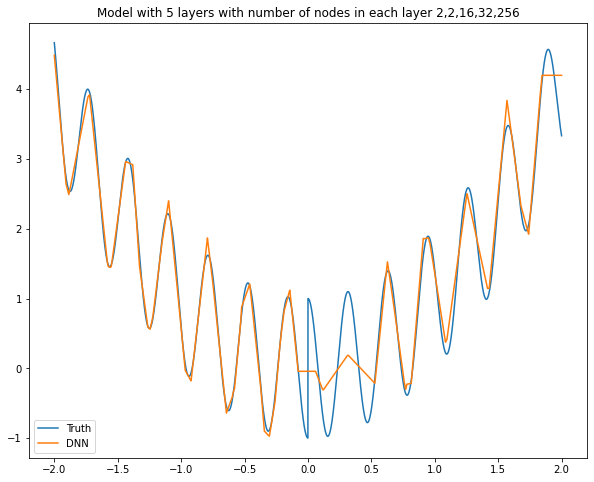

Model: "sequential_423"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2518 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2519 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2520 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2521 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2522 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_2523 (Dense)           (None, 1)                 513       
Total params: 18,011
Trainable params: 18,011
Non-trainable params: 0
________________________________________________

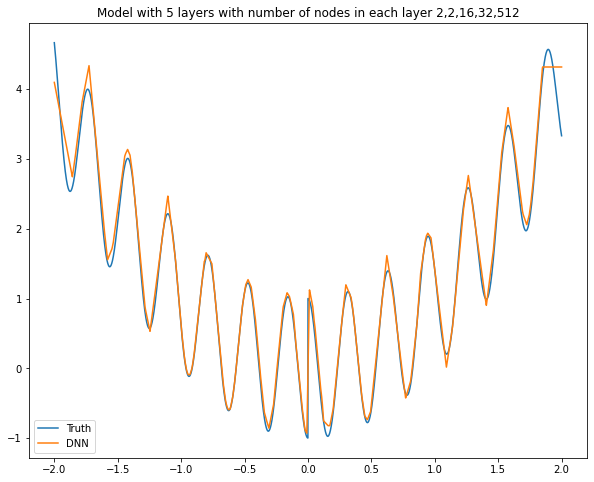

Model: "sequential_424"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2524 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2525 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2526 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2527 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2528 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_2529 (Dense)           (None, 1)                 1025      
Total params: 35,419
Trainable params: 35,419
Non-trainable params: 0
________________________________________________

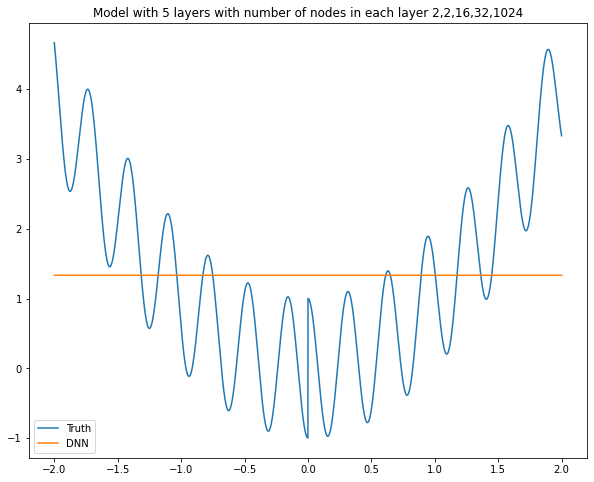

Model: "sequential_425"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2530 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2531 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2532 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2533 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_2534 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_2535 (Dense)           (None, 1)                 2049      
Total params: 70,235
Trainable params: 70,235
Non-trainable params: 0
________________________________________________

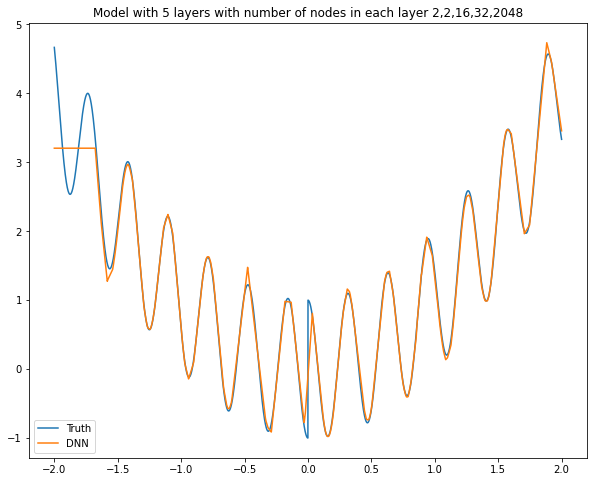

Model: "sequential_426"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2536 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2537 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2538 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2539 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2540 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_2541 (Dense)           (None, 1)                 3         
Total params: 1,279
Trainable params: 1,279
Non-trainable params: 0
__________________________________________________

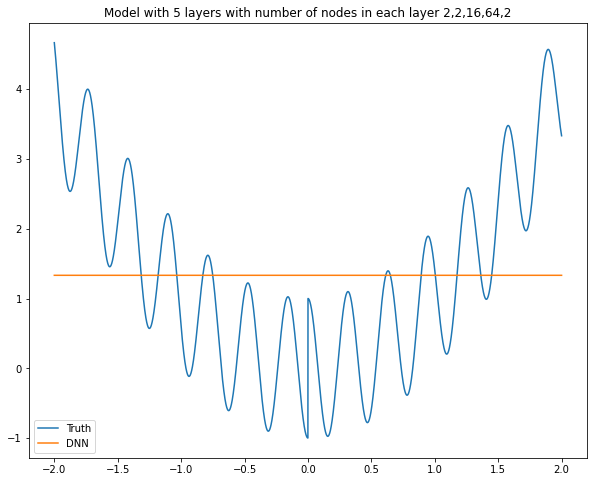

Model: "sequential_427"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2542 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2543 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2544 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2545 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2546 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_2547 (Dense)           (None, 1)                 5         
Total params: 1,411
Trainable params: 1,411
Non-trainable params: 0
__________________________________________________

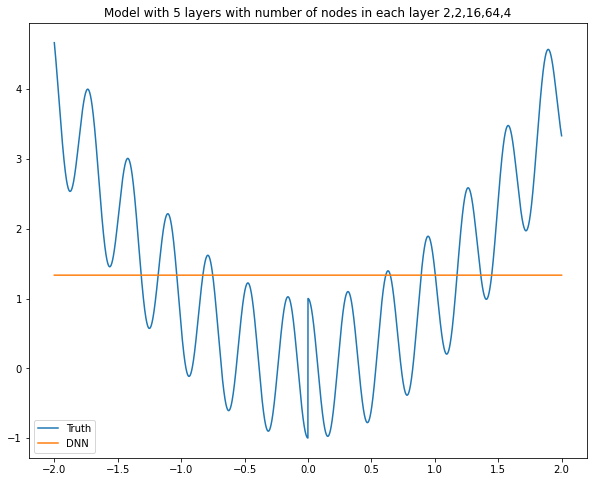

Model: "sequential_428"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2548 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2549 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2550 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2551 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2552 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_2553 (Dense)           (None, 1)                 9         
Total params: 1,675
Trainable params: 1,675
Non-trainable params: 0
__________________________________________________

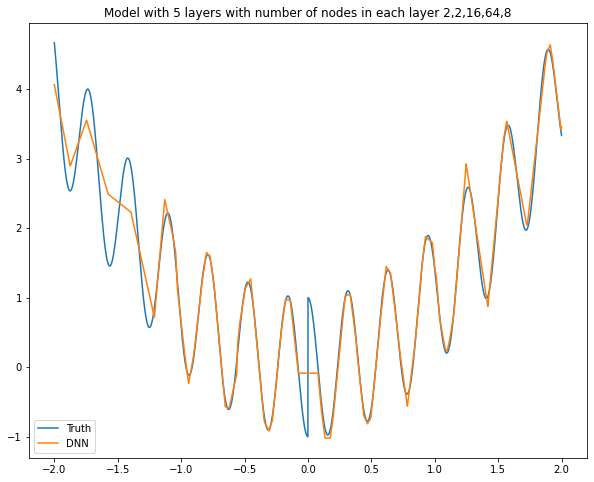

Model: "sequential_429"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2554 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2555 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2556 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2557 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2558 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_2559 (Dense)           (None, 1)                 17        
Total params: 2,203
Trainable params: 2,203
Non-trainable params: 0
__________________________________________________

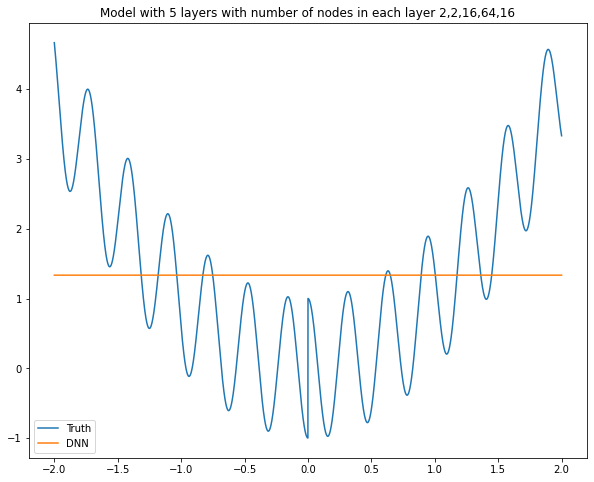

Model: "sequential_430"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2560 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2561 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2562 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2563 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2564 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_2565 (Dense)           (None, 1)                 33        
Total params: 3,259
Trainable params: 3,259
Non-trainable params: 0
__________________________________________________

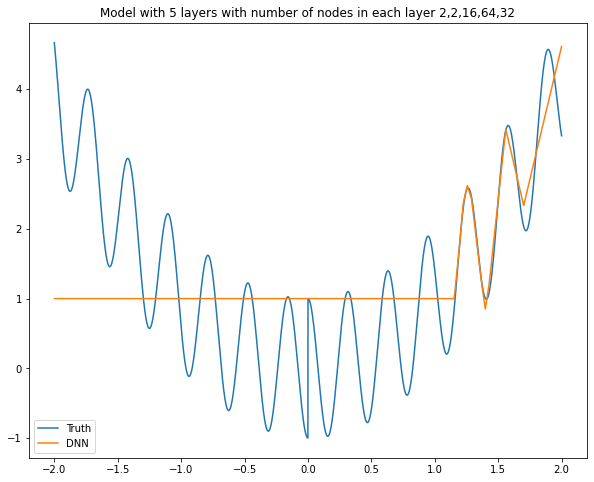

Model: "sequential_431"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2566 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2567 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2568 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2569 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2570 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_2571 (Dense)           (None, 1)                 65        
Total params: 5,371
Trainable params: 5,371
Non-trainable params: 0
__________________________________________________

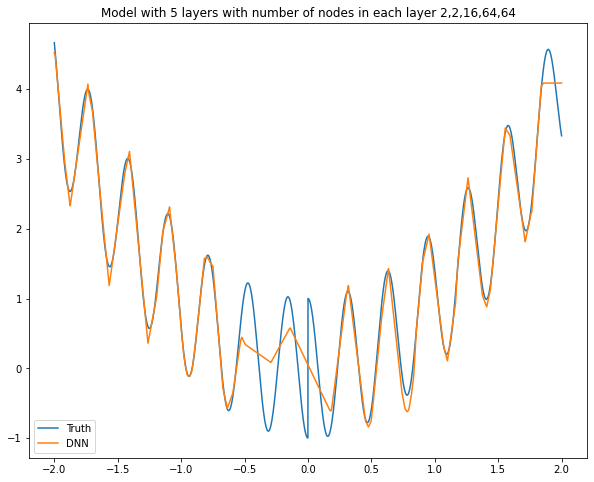

Model: "sequential_432"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2572 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2573 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2574 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2575 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2576 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_2577 (Dense)           (None, 1)                 129       
Total params: 9,595
Trainable params: 9,595
Non-trainable params: 0
__________________________________________________

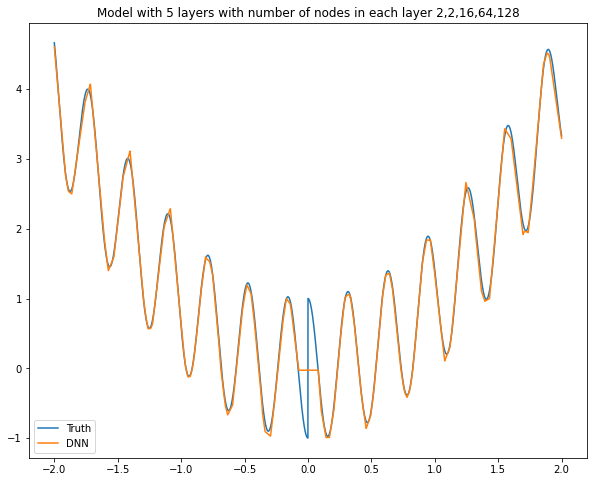

Model: "sequential_433"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2578 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2579 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2580 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2581 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2582 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_2583 (Dense)           (None, 1)                 257       
Total params: 18,043
Trainable params: 18,043
Non-trainable params: 0
________________________________________________

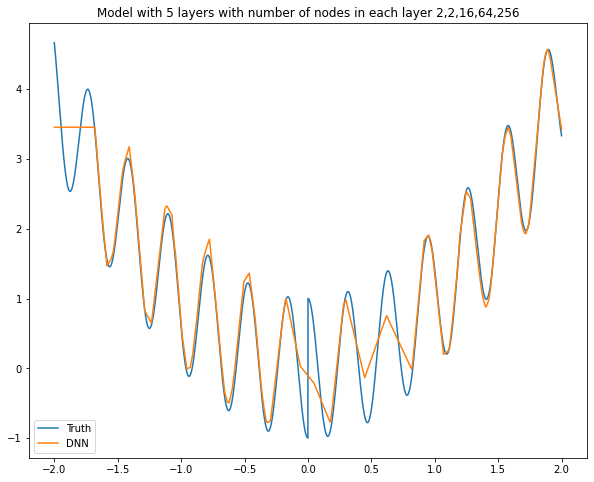

Model: "sequential_434"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2584 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2585 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2586 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2587 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2588 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_2589 (Dense)           (None, 1)                 513       
Total params: 34,939
Trainable params: 34,939
Non-trainable params: 0
________________________________________________

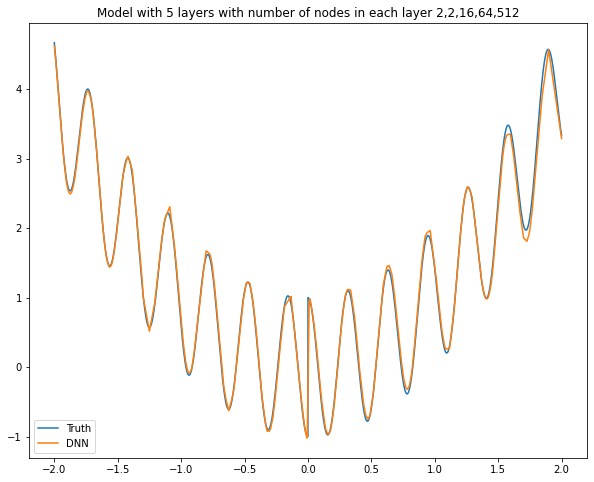

Model: "sequential_435"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2590 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2591 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2592 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2593 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2594 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_2595 (Dense)           (None, 1)                 1025      
Total params: 68,731
Trainable params: 68,731
Non-trainable params: 0
________________________________________________

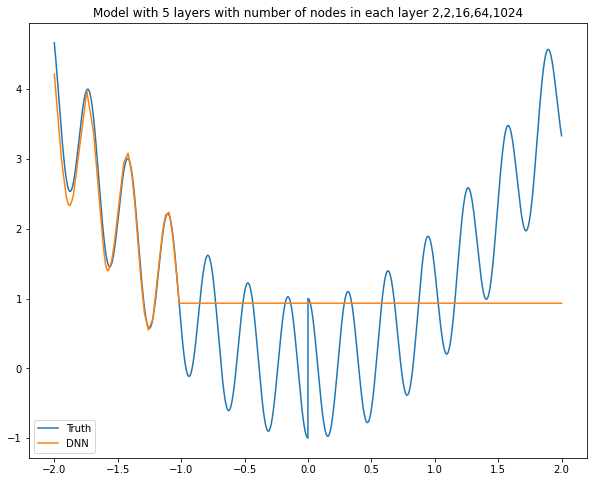

Model: "sequential_436"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2596 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2597 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2598 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2599 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_2600 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_2601 (Dense)           (None, 1)                 2049      
Total params: 136,315
Trainable params: 136,315
Non-trainable params: 0
______________________________________________

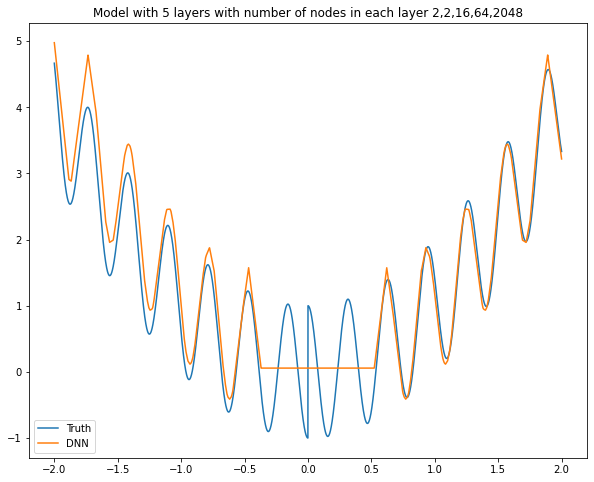

Model: "sequential_437"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2602 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2603 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2604 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2605 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2606 (Dense)           (None, 2)                 258       
_________________________________________________________________
dense_2607 (Dense)           (None, 1)                 3         
Total params: 2,495
Trainable params: 2,495
Non-trainable params: 0
__________________________________________________

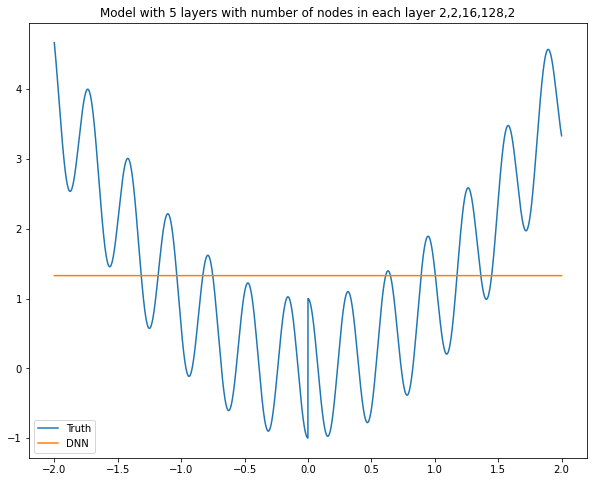

Model: "sequential_438"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2608 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2609 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2610 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2611 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2612 (Dense)           (None, 4)                 516       
_________________________________________________________________
dense_2613 (Dense)           (None, 1)                 5         
Total params: 2,755
Trainable params: 2,755
Non-trainable params: 0
__________________________________________________

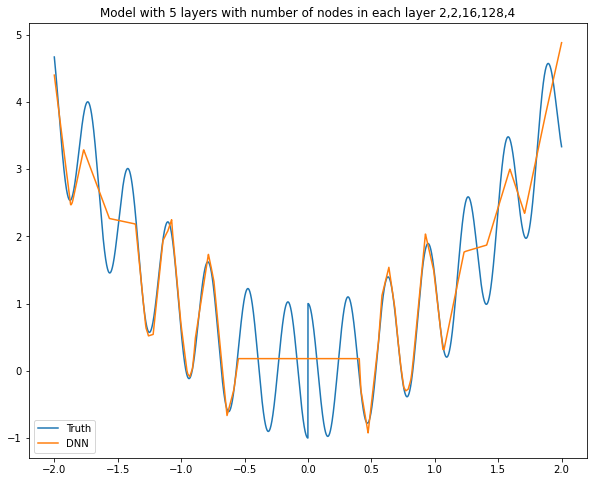

Model: "sequential_439"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2614 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2615 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2616 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2617 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2618 (Dense)           (None, 8)                 1032      
_________________________________________________________________
dense_2619 (Dense)           (None, 1)                 9         
Total params: 3,275
Trainable params: 3,275
Non-trainable params: 0
__________________________________________________

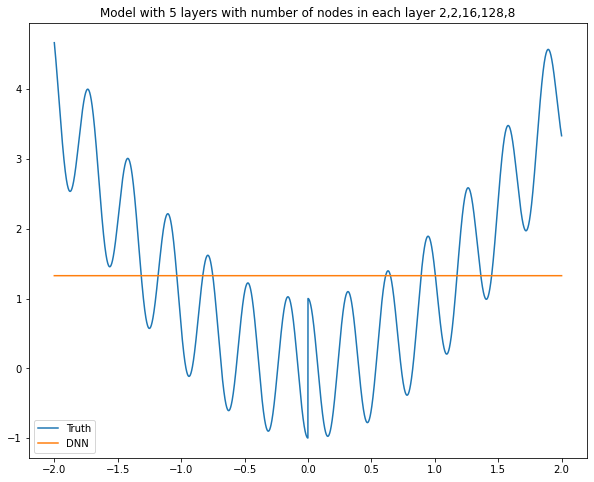

Model: "sequential_440"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2620 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2621 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2622 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2623 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2624 (Dense)           (None, 16)                2064      
_________________________________________________________________
dense_2625 (Dense)           (None, 1)                 17        
Total params: 4,315
Trainable params: 4,315
Non-trainable params: 0
__________________________________________________

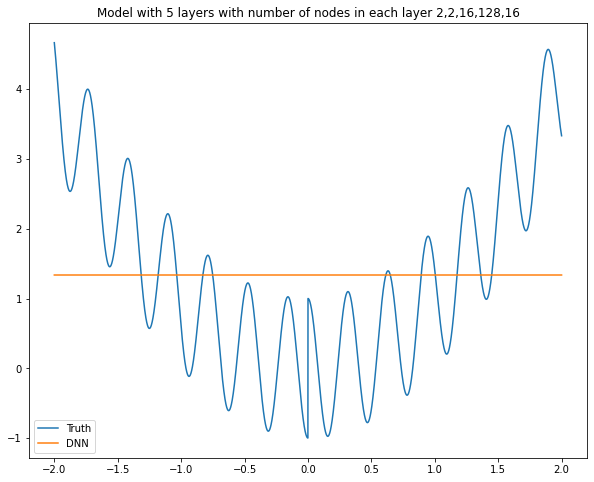

Model: "sequential_441"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2626 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2627 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2628 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2629 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2630 (Dense)           (None, 32)                4128      
_________________________________________________________________
dense_2631 (Dense)           (None, 1)                 33        
Total params: 6,395
Trainable params: 6,395
Non-trainable params: 0
__________________________________________________

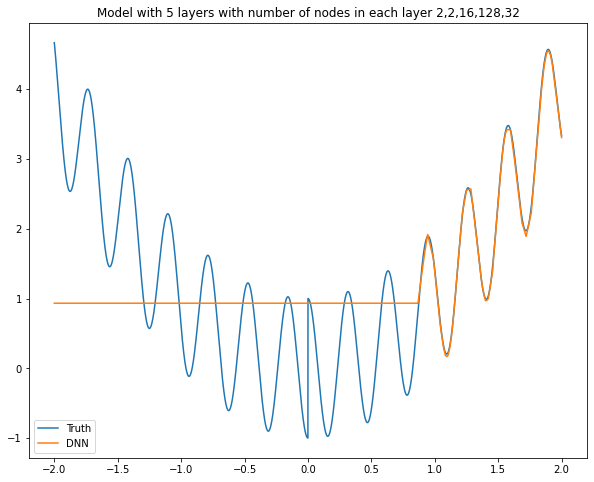

Model: "sequential_442"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2632 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2633 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2634 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2635 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2636 (Dense)           (None, 64)                8256      
_________________________________________________________________
dense_2637 (Dense)           (None, 1)                 65        
Total params: 10,555
Trainable params: 10,555
Non-trainable params: 0
________________________________________________

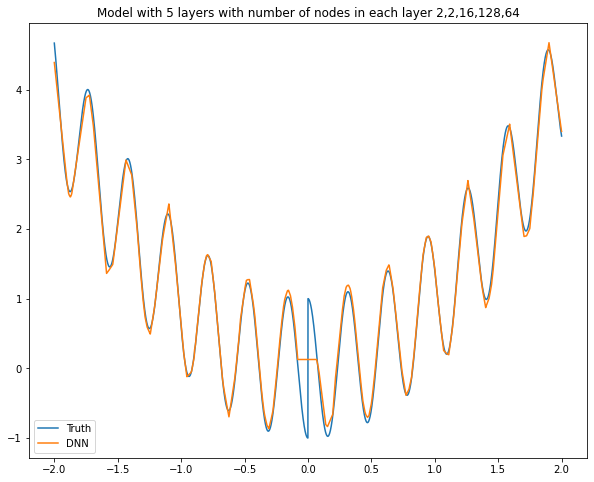

Model: "sequential_443"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2638 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2639 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2640 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2641 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2642 (Dense)           (None, 128)               16512     
_________________________________________________________________
dense_2643 (Dense)           (None, 1)                 129       
Total params: 18,875
Trainable params: 18,875
Non-trainable params: 0
________________________________________________

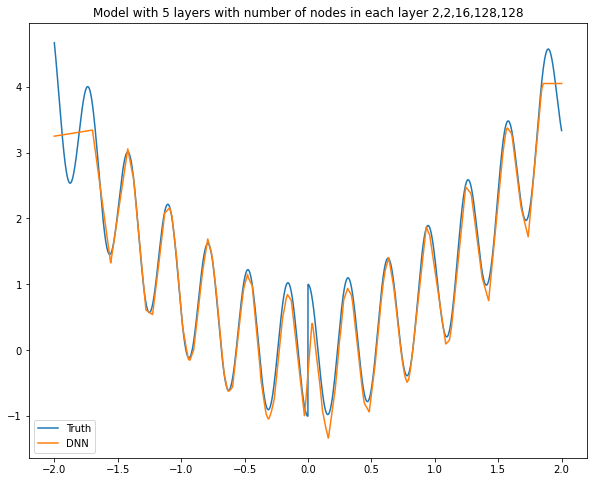

Model: "sequential_444"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2644 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2645 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2646 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2647 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2648 (Dense)           (None, 256)               33024     
_________________________________________________________________
dense_2649 (Dense)           (None, 1)                 257       
Total params: 35,515
Trainable params: 35,515
Non-trainable params: 0
________________________________________________

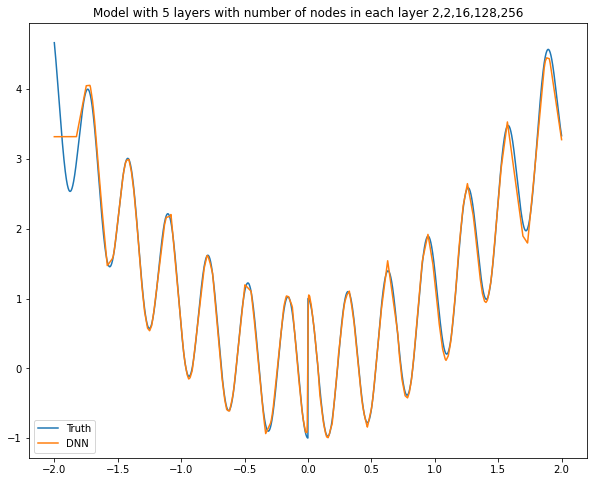

Model: "sequential_445"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2650 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2651 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2652 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2653 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2654 (Dense)           (None, 512)               66048     
_________________________________________________________________
dense_2655 (Dense)           (None, 1)                 513       
Total params: 68,795
Trainable params: 68,795
Non-trainable params: 0
________________________________________________

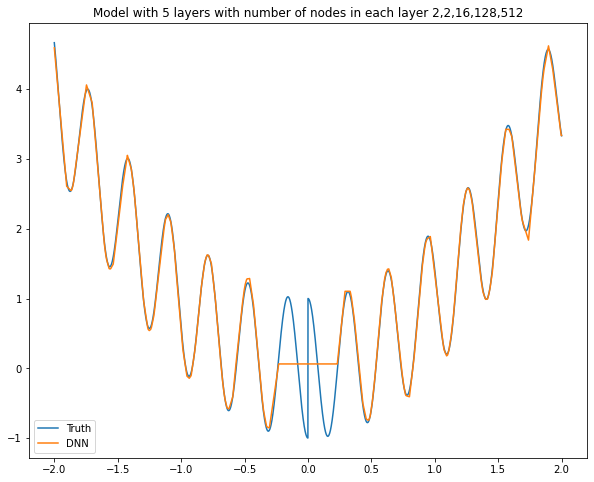

Model: "sequential_446"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2656 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2657 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2658 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2659 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2660 (Dense)           (None, 1024)              132096    
_________________________________________________________________
dense_2661 (Dense)           (None, 1)                 1025      
Total params: 135,355
Trainable params: 135,355
Non-trainable params: 0
______________________________________________

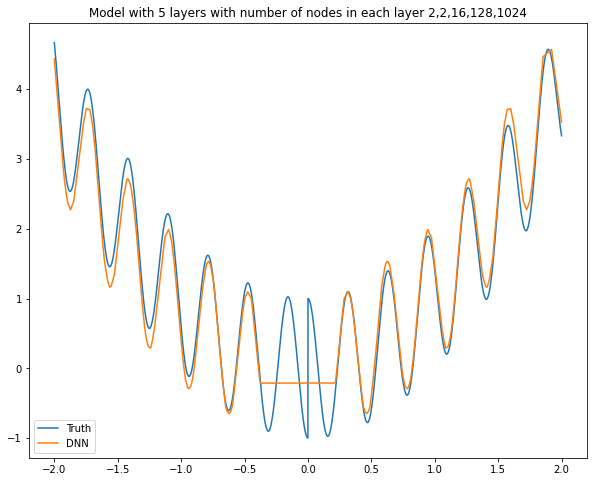

Model: "sequential_447"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2662 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2663 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2664 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2665 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_2666 (Dense)           (None, 2048)              264192    
_________________________________________________________________
dense_2667 (Dense)           (None, 1)                 2049      
Total params: 268,475
Trainable params: 268,475
Non-trainable params: 0
______________________________________________

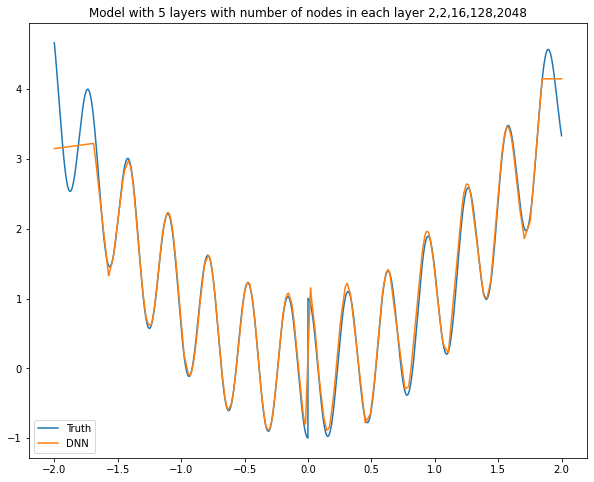

Model: "sequential_448"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2668 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2669 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2670 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2671 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2672 (Dense)           (None, 2)                 514       
_________________________________________________________________
dense_2673 (Dense)           (None, 1)                 3         
Total params: 4,927
Trainable params: 4,927
Non-trainable params: 0
__________________________________________________

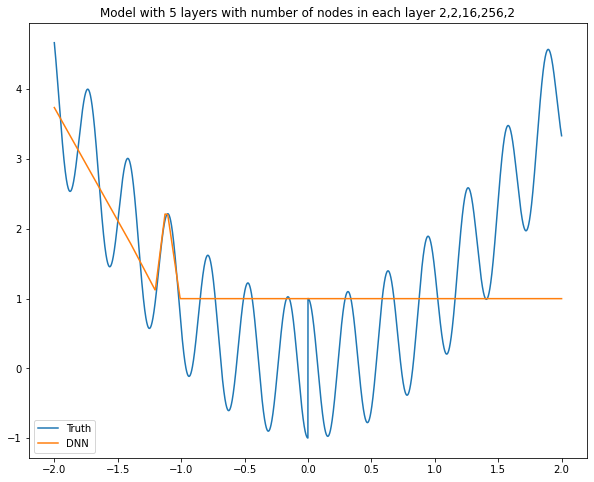

Model: "sequential_449"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2674 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2675 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2676 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2677 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2678 (Dense)           (None, 4)                 1028      
_________________________________________________________________
dense_2679 (Dense)           (None, 1)                 5         
Total params: 5,443
Trainable params: 5,443
Non-trainable params: 0
__________________________________________________

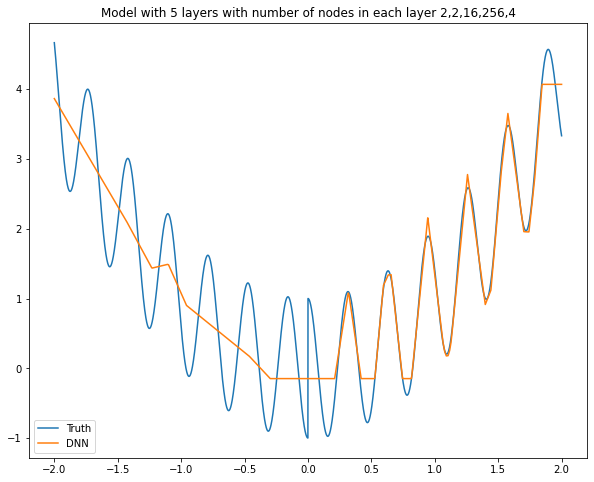

Model: "sequential_450"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2680 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2681 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2682 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2683 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2684 (Dense)           (None, 8)                 2056      
_________________________________________________________________
dense_2685 (Dense)           (None, 1)                 9         
Total params: 6,475
Trainable params: 6,475
Non-trainable params: 0
__________________________________________________

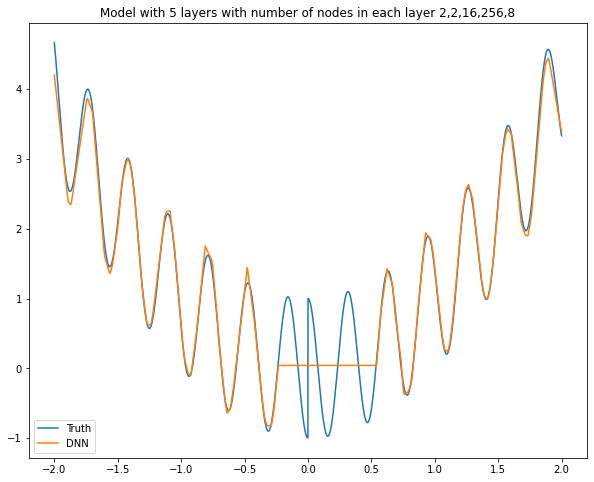

Model: "sequential_451"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2686 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2687 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2688 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2689 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2690 (Dense)           (None, 16)                4112      
_________________________________________________________________
dense_2691 (Dense)           (None, 1)                 17        
Total params: 8,539
Trainable params: 8,539
Non-trainable params: 0
__________________________________________________

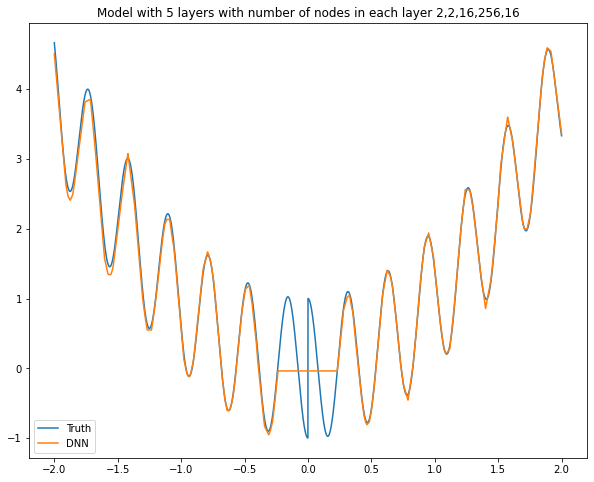

Model: "sequential_452"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2692 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2693 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2694 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2695 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2696 (Dense)           (None, 32)                8224      
_________________________________________________________________
dense_2697 (Dense)           (None, 1)                 33        
Total params: 12,667
Trainable params: 12,667
Non-trainable params: 0
________________________________________________

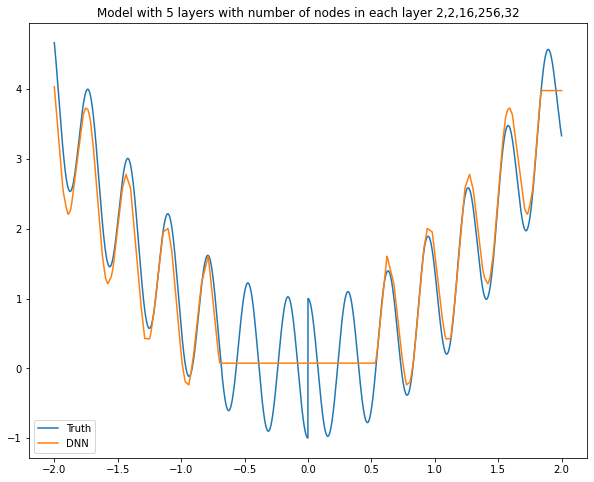

Model: "sequential_453"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2698 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2699 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2700 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2701 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2702 (Dense)           (None, 64)                16448     
_________________________________________________________________
dense_2703 (Dense)           (None, 1)                 65        
Total params: 20,923
Trainable params: 20,923
Non-trainable params: 0
________________________________________________

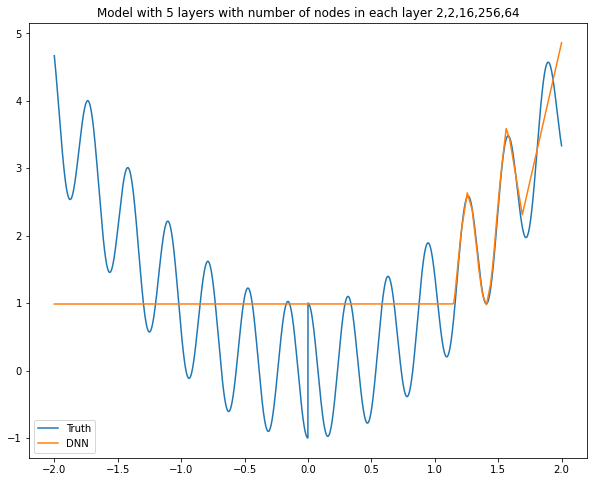

Model: "sequential_454"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2704 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2705 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2706 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2707 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2708 (Dense)           (None, 128)               32896     
_________________________________________________________________
dense_2709 (Dense)           (None, 1)                 129       
Total params: 37,435
Trainable params: 37,435
Non-trainable params: 0
________________________________________________

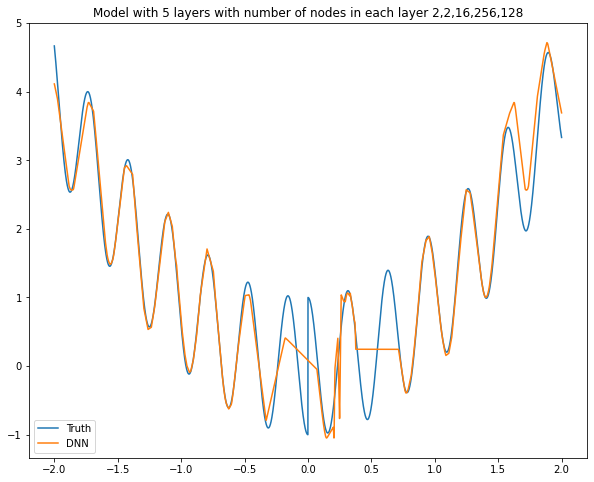

Model: "sequential_455"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2710 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2711 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2712 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2713 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2714 (Dense)           (None, 256)               65792     
_________________________________________________________________
dense_2715 (Dense)           (None, 1)                 257       
Total params: 70,459
Trainable params: 70,459
Non-trainable params: 0
________________________________________________

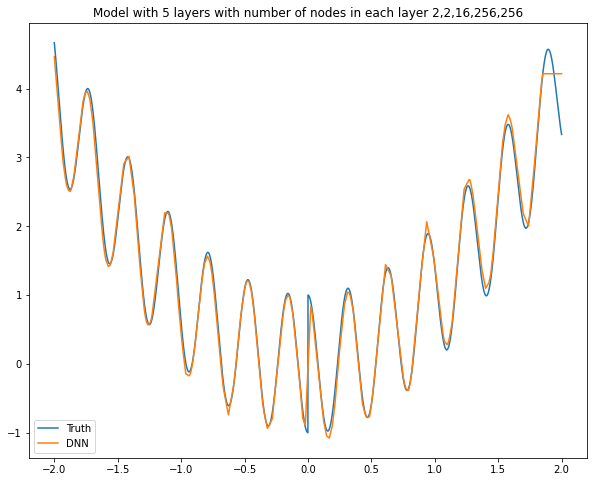

Model: "sequential_456"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2716 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2717 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2718 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2719 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2720 (Dense)           (None, 512)               131584    
_________________________________________________________________
dense_2721 (Dense)           (None, 1)                 513       
Total params: 136,507
Trainable params: 136,507
Non-trainable params: 0
______________________________________________

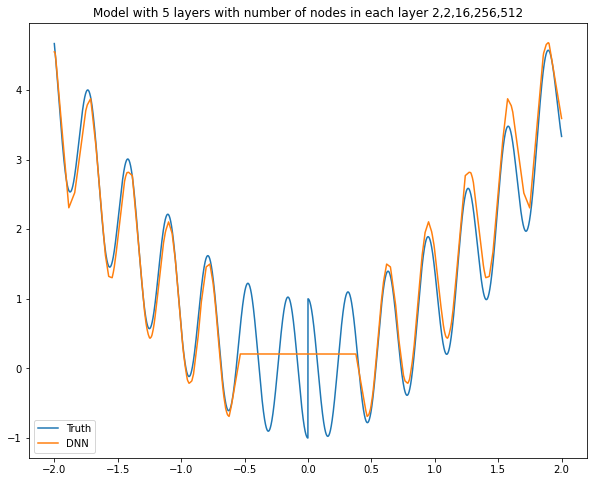

Model: "sequential_457"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2722 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2723 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2724 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2725 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2726 (Dense)           (None, 1024)              263168    
_________________________________________________________________
dense_2727 (Dense)           (None, 1)                 1025      
Total params: 268,603
Trainable params: 268,603
Non-trainable params: 0
______________________________________________

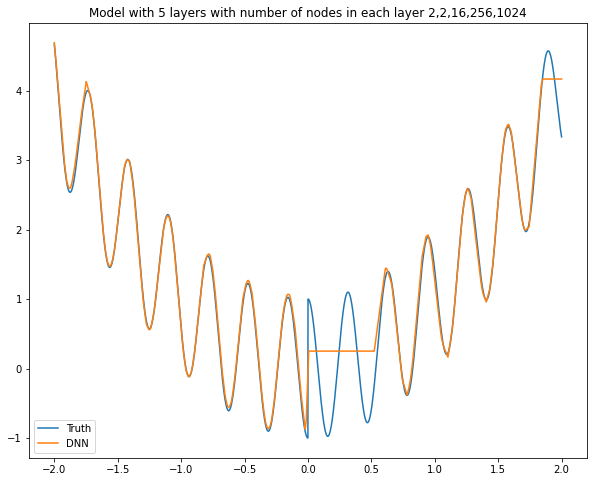

Model: "sequential_458"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2728 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2729 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2730 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2731 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_2732 (Dense)           (None, 2048)              526336    
_________________________________________________________________
dense_2733 (Dense)           (None, 1)                 2049      
Total params: 532,795
Trainable params: 532,795
Non-trainable params: 0
______________________________________________

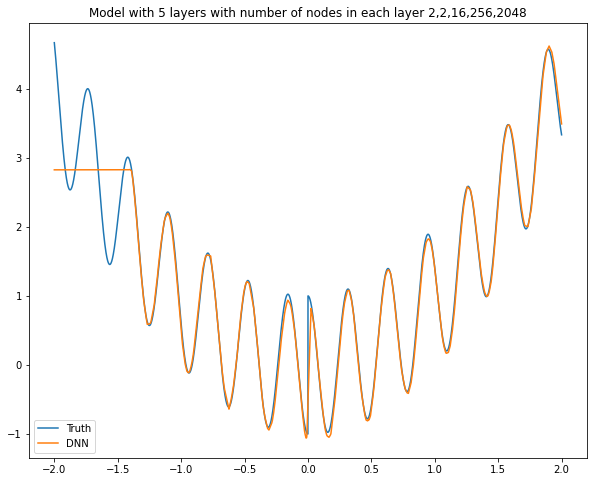

Model: "sequential_459"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2734 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2735 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2736 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2737 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2738 (Dense)           (None, 2)                 1026      
_________________________________________________________________
dense_2739 (Dense)           (None, 1)                 3         
Total params: 9,791
Trainable params: 9,791
Non-trainable params: 0
__________________________________________________

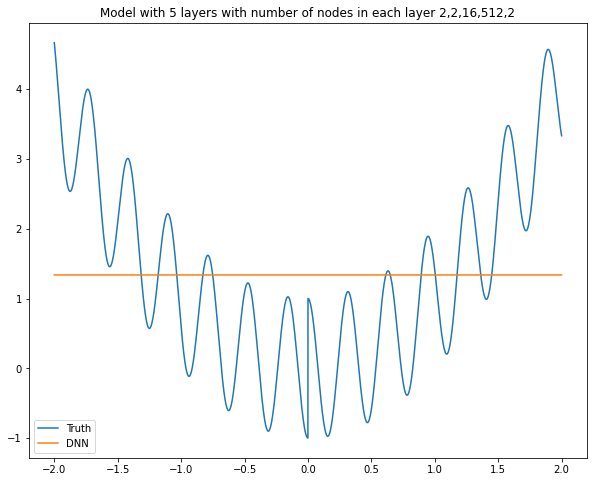

Model: "sequential_460"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2740 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2741 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2742 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2743 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2744 (Dense)           (None, 4)                 2052      
_________________________________________________________________
dense_2745 (Dense)           (None, 1)                 5         
Total params: 10,819
Trainable params: 10,819
Non-trainable params: 0
________________________________________________

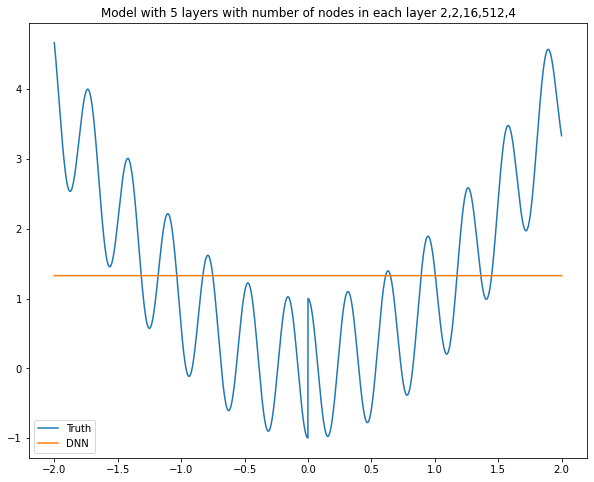

Model: "sequential_461"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2746 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2747 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2748 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2749 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2750 (Dense)           (None, 8)                 4104      
_________________________________________________________________
dense_2751 (Dense)           (None, 1)                 9         
Total params: 12,875
Trainable params: 12,875
Non-trainable params: 0
________________________________________________

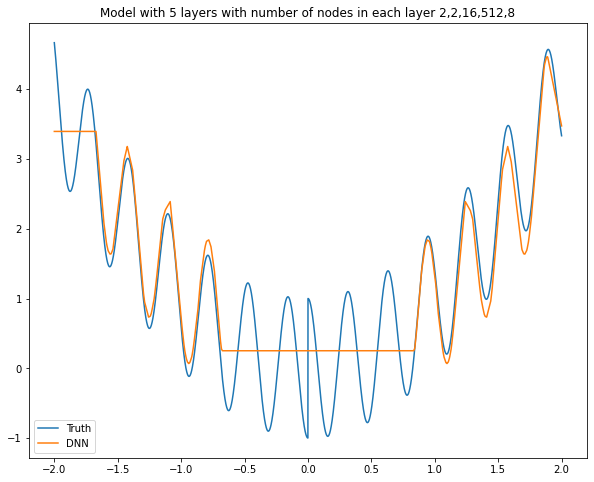

Model: "sequential_462"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2752 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2753 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2754 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2755 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2756 (Dense)           (None, 16)                8208      
_________________________________________________________________
dense_2757 (Dense)           (None, 1)                 17        
Total params: 16,987
Trainable params: 16,987
Non-trainable params: 0
________________________________________________

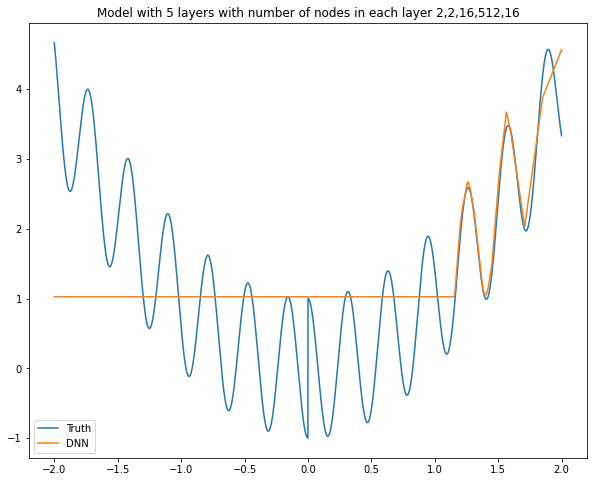

Model: "sequential_463"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2758 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2759 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2760 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2761 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2762 (Dense)           (None, 32)                16416     
_________________________________________________________________
dense_2763 (Dense)           (None, 1)                 33        
Total params: 25,211
Trainable params: 25,211
Non-trainable params: 0
________________________________________________

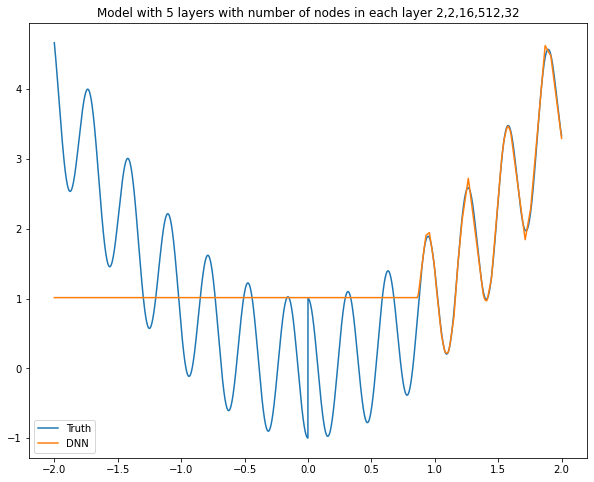

Model: "sequential_464"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2764 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2765 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2766 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2767 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2768 (Dense)           (None, 64)                32832     
_________________________________________________________________
dense_2769 (Dense)           (None, 1)                 65        
Total params: 41,659
Trainable params: 41,659
Non-trainable params: 0
________________________________________________

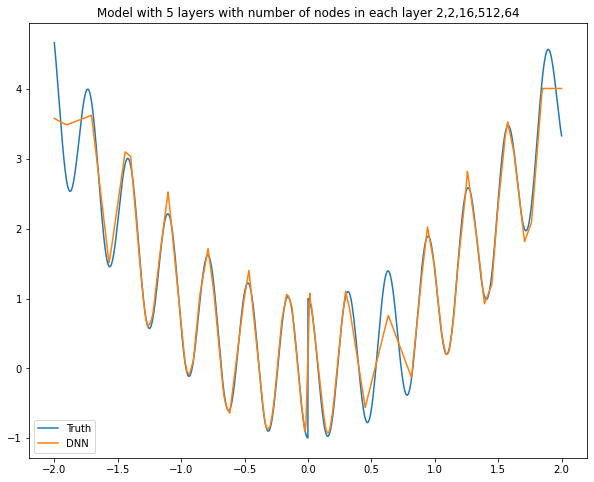

Model: "sequential_465"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2770 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2771 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2772 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2773 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2774 (Dense)           (None, 128)               65664     
_________________________________________________________________
dense_2775 (Dense)           (None, 1)                 129       
Total params: 74,555
Trainable params: 74,555
Non-trainable params: 0
________________________________________________

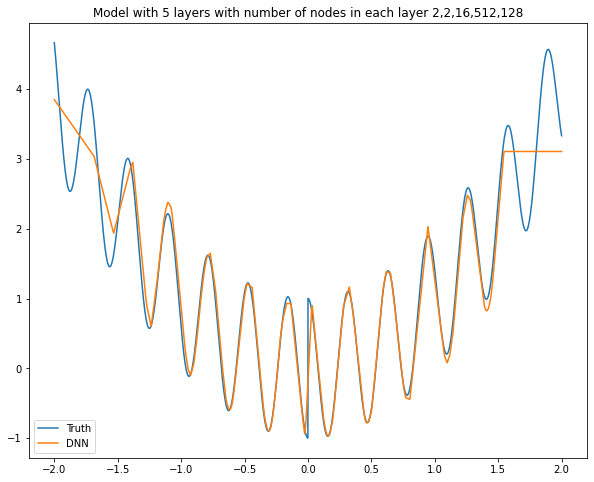

Model: "sequential_466"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2776 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2777 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2778 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2779 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2780 (Dense)           (None, 256)               131328    
_________________________________________________________________
dense_2781 (Dense)           (None, 1)                 257       
Total params: 140,347
Trainable params: 140,347
Non-trainable params: 0
______________________________________________

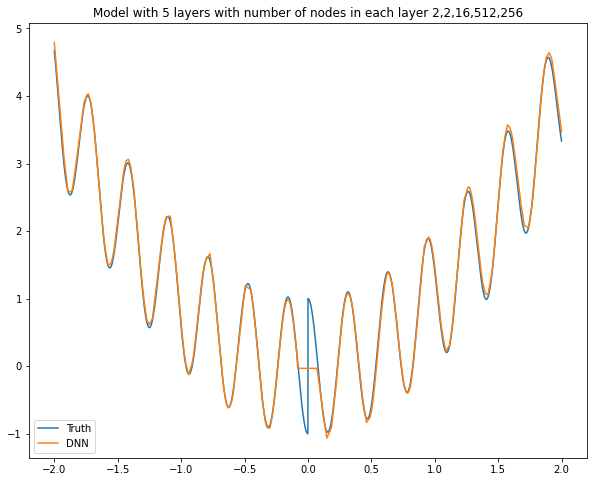

Model: "sequential_467"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2782 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2783 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2784 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2785 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2786 (Dense)           (None, 512)               262656    
_________________________________________________________________
dense_2787 (Dense)           (None, 1)                 513       
Total params: 271,931
Trainable params: 271,931
Non-trainable params: 0
______________________________________________

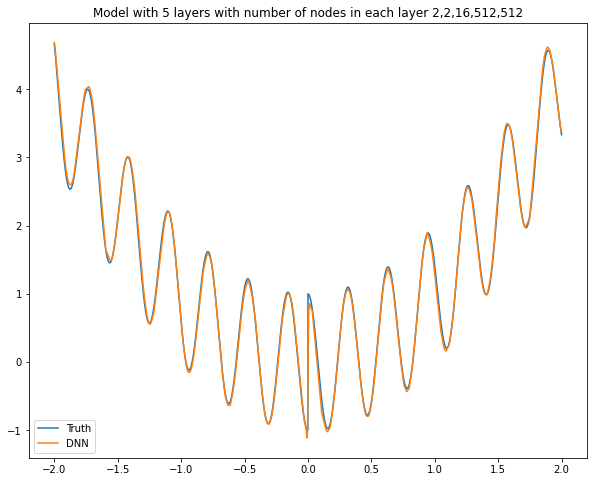

Model: "sequential_468"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2788 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2789 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2790 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2791 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2792 (Dense)           (None, 1024)              525312    
_________________________________________________________________
dense_2793 (Dense)           (None, 1)                 1025      
Total params: 535,099
Trainable params: 535,099
Non-trainable params: 0
______________________________________________

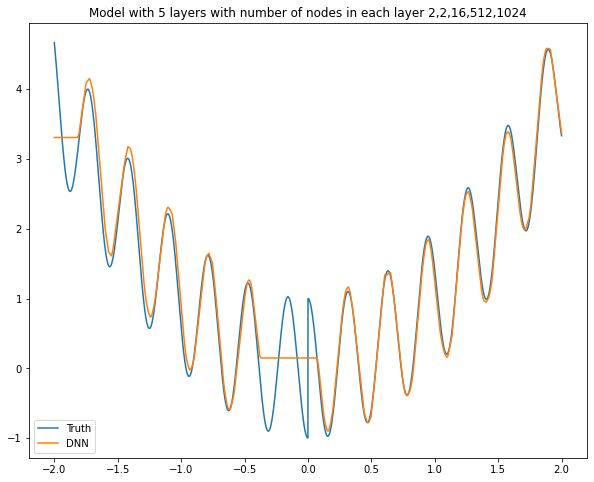

Model: "sequential_469"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2794 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2795 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2796 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2797 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_2798 (Dense)           (None, 2048)              1050624   
_________________________________________________________________
dense_2799 (Dense)           (None, 1)                 2049      
Total params: 1,061,435
Trainable params: 1,061,435
Non-trainable params: 0
__________________________________________

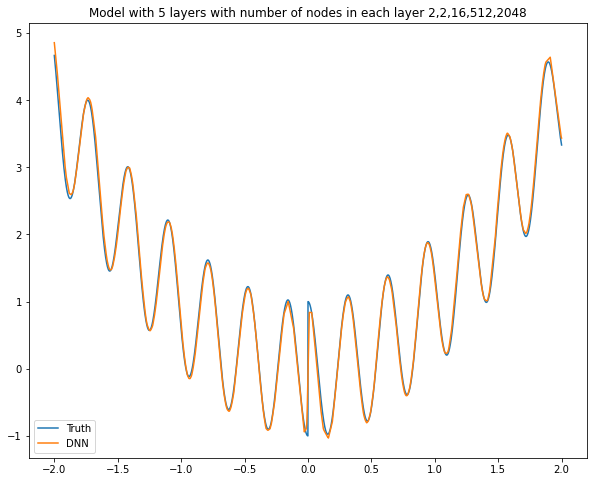

Model: "sequential_470"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2800 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2801 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2802 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2803 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2804 (Dense)           (None, 2)                 2050      
_________________________________________________________________
dense_2805 (Dense)           (None, 1)                 3         
Total params: 19,519
Trainable params: 19,519
Non-trainable params: 0
________________________________________________

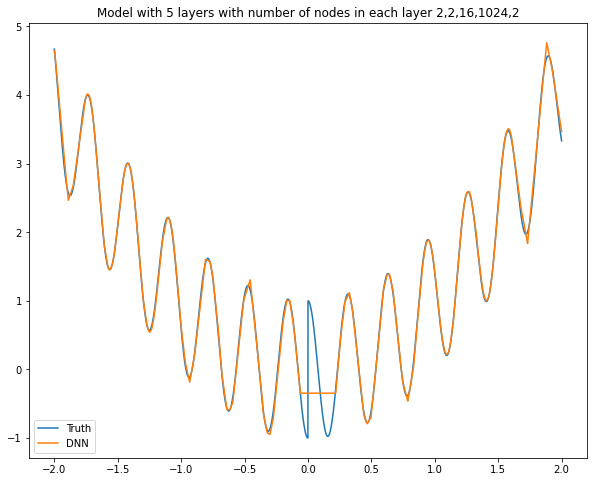

Model: "sequential_471"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2806 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2807 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2808 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2809 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2810 (Dense)           (None, 4)                 4100      
_________________________________________________________________
dense_2811 (Dense)           (None, 1)                 5         
Total params: 21,571
Trainable params: 21,571
Non-trainable params: 0
________________________________________________

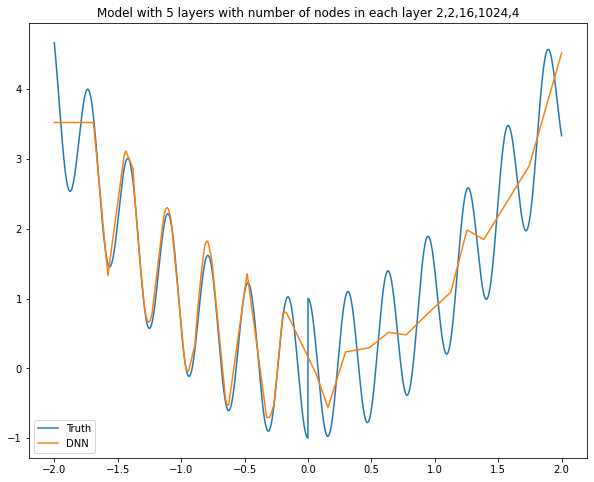

Model: "sequential_472"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2812 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2813 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2814 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2815 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2816 (Dense)           (None, 8)                 8200      
_________________________________________________________________
dense_2817 (Dense)           (None, 1)                 9         
Total params: 25,675
Trainable params: 25,675
Non-trainable params: 0
________________________________________________

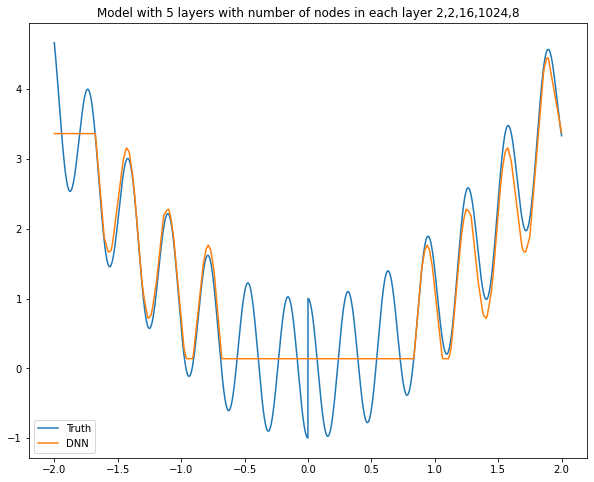

Model: "sequential_473"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2818 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2819 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2820 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2821 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2822 (Dense)           (None, 16)                16400     
_________________________________________________________________
dense_2823 (Dense)           (None, 1)                 17        
Total params: 33,883
Trainable params: 33,883
Non-trainable params: 0
________________________________________________

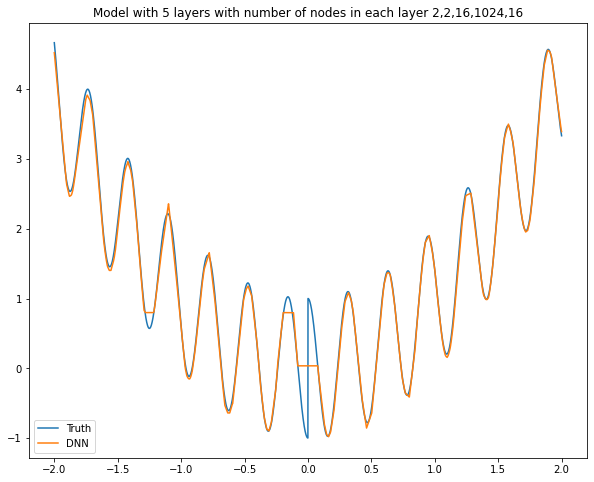

Model: "sequential_474"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2824 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2825 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2826 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2827 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2828 (Dense)           (None, 32)                32800     
_________________________________________________________________
dense_2829 (Dense)           (None, 1)                 33        
Total params: 50,299
Trainable params: 50,299
Non-trainable params: 0
________________________________________________

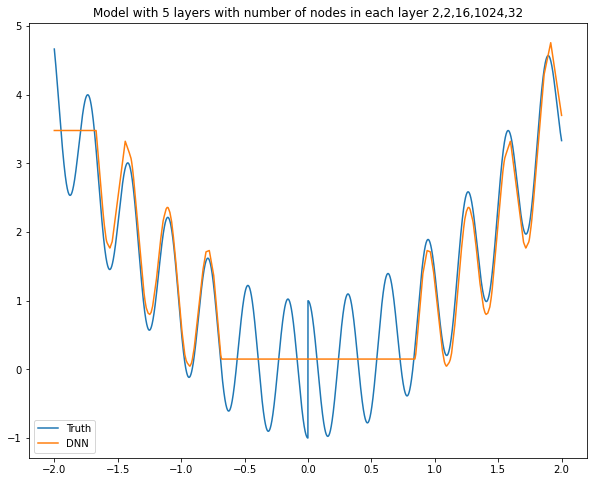

Model: "sequential_475"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2830 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2831 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2832 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2833 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2834 (Dense)           (None, 64)                65600     
_________________________________________________________________
dense_2835 (Dense)           (None, 1)                 65        
Total params: 83,131
Trainable params: 83,131
Non-trainable params: 0
________________________________________________

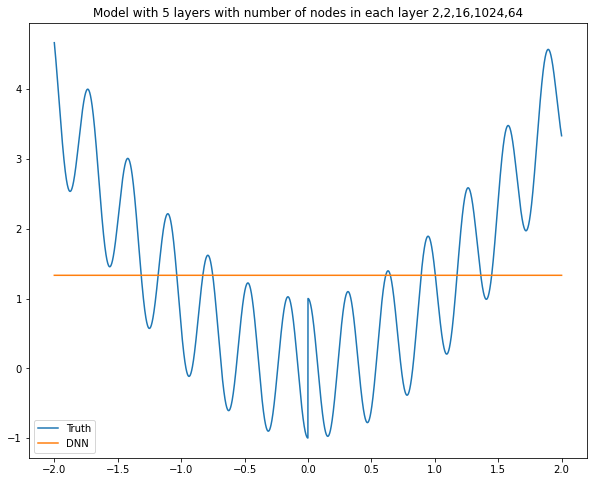

Model: "sequential_476"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2836 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2837 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2838 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2839 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2840 (Dense)           (None, 128)               131200    
_________________________________________________________________
dense_2841 (Dense)           (None, 1)                 129       
Total params: 148,795
Trainable params: 148,795
Non-trainable params: 0
______________________________________________

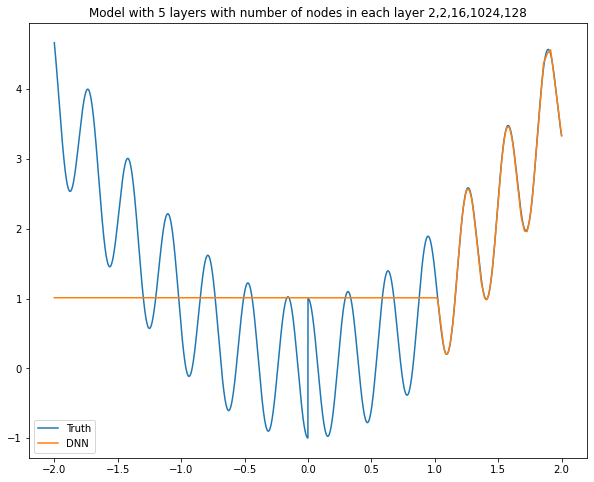

Model: "sequential_477"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2842 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2843 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2844 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2845 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2846 (Dense)           (None, 256)               262400    
_________________________________________________________________
dense_2847 (Dense)           (None, 1)                 257       
Total params: 280,123
Trainable params: 280,123
Non-trainable params: 0
______________________________________________

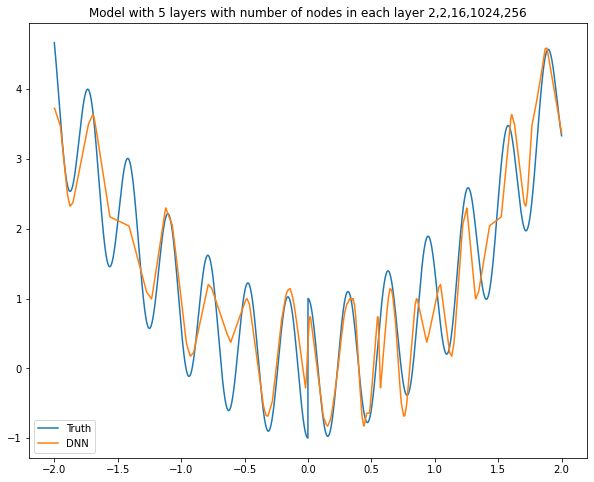

Model: "sequential_478"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2848 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2849 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2850 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2851 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2852 (Dense)           (None, 512)               524800    
_________________________________________________________________
dense_2853 (Dense)           (None, 1)                 513       
Total params: 542,779
Trainable params: 542,779
Non-trainable params: 0
______________________________________________

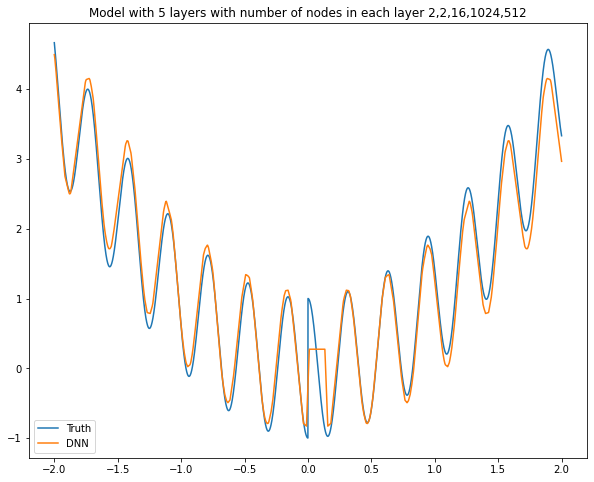

Model: "sequential_479"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2854 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2855 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2856 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2857 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2858 (Dense)           (None, 1024)              1049600   
_________________________________________________________________
dense_2859 (Dense)           (None, 1)                 1025      
Total params: 1,068,091
Trainable params: 1,068,091
Non-trainable params: 0
__________________________________________

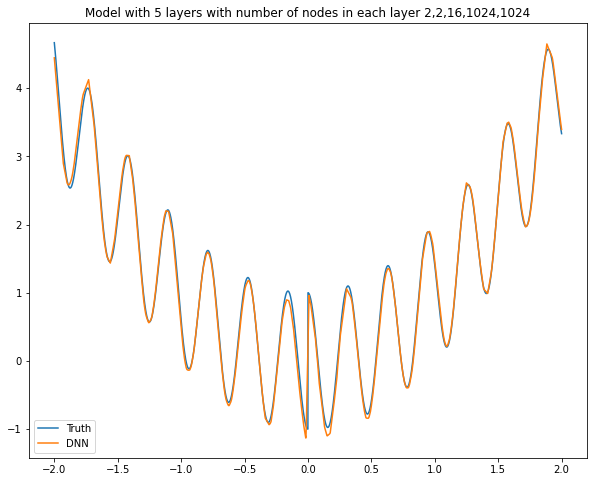

Model: "sequential_480"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2860 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2861 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2862 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2863 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_2864 (Dense)           (None, 2048)              2099200   
_________________________________________________________________
dense_2865 (Dense)           (None, 1)                 2049      
Total params: 2,118,715
Trainable params: 2,118,715
Non-trainable params: 0
__________________________________________

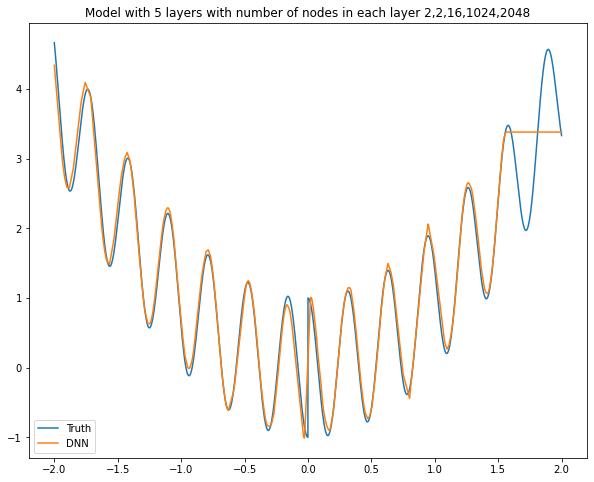

Model: "sequential_481"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2866 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2867 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2868 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2869 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2870 (Dense)           (None, 2)                 4098      
_________________________________________________________________
dense_2871 (Dense)           (None, 1)                 3         
Total params: 38,975
Trainable params: 38,975
Non-trainable params: 0
________________________________________________

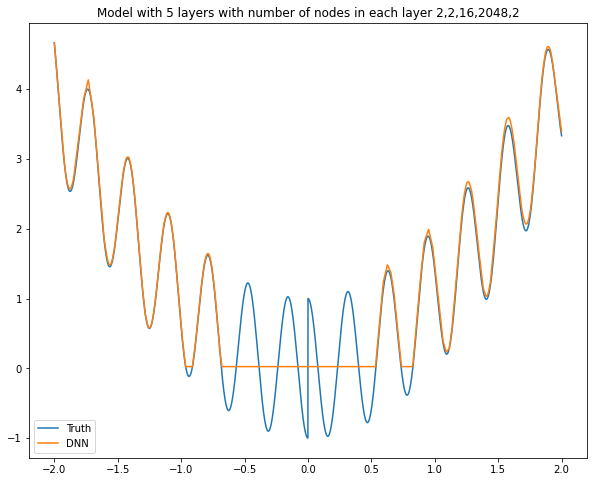

Model: "sequential_482"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2872 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2873 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2874 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2875 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2876 (Dense)           (None, 4)                 8196      
_________________________________________________________________
dense_2877 (Dense)           (None, 1)                 5         
Total params: 43,075
Trainable params: 43,075
Non-trainable params: 0
________________________________________________

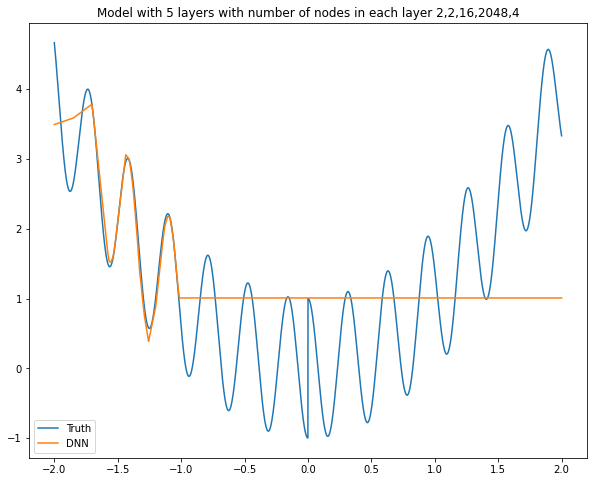

Model: "sequential_483"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2878 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2879 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2880 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2881 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2882 (Dense)           (None, 8)                 16392     
_________________________________________________________________
dense_2883 (Dense)           (None, 1)                 9         
Total params: 51,275
Trainable params: 51,275
Non-trainable params: 0
________________________________________________

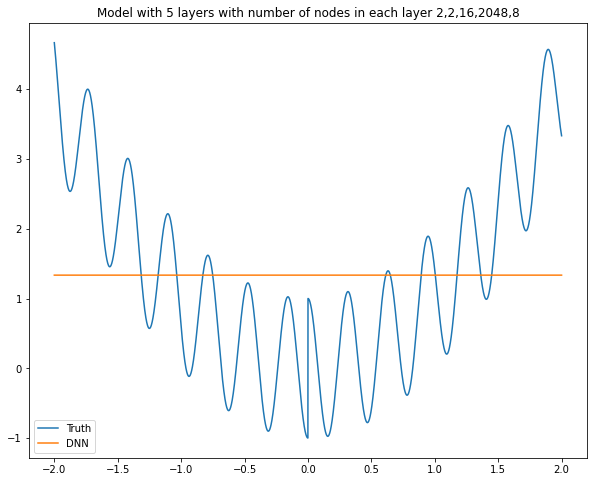

Model: "sequential_484"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2884 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2885 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2886 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2887 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2888 (Dense)           (None, 16)                32784     
_________________________________________________________________
dense_2889 (Dense)           (None, 1)                 17        
Total params: 67,675
Trainable params: 67,675
Non-trainable params: 0
________________________________________________

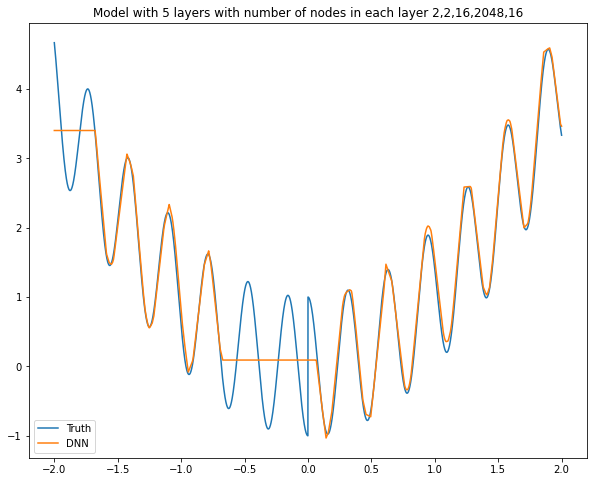

Model: "sequential_485"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2890 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2891 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2892 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2893 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2894 (Dense)           (None, 32)                65568     
_________________________________________________________________
dense_2895 (Dense)           (None, 1)                 33        
Total params: 100,475
Trainable params: 100,475
Non-trainable params: 0
______________________________________________

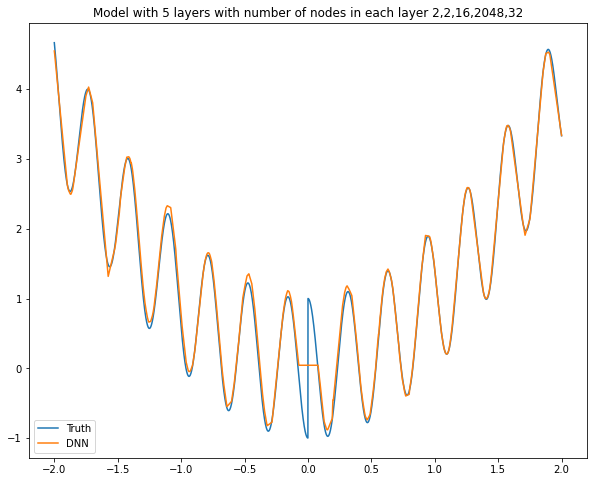

Model: "sequential_486"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2896 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2897 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2898 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2899 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2900 (Dense)           (None, 64)                131136    
_________________________________________________________________
dense_2901 (Dense)           (None, 1)                 65        
Total params: 166,075
Trainable params: 166,075
Non-trainable params: 0
______________________________________________

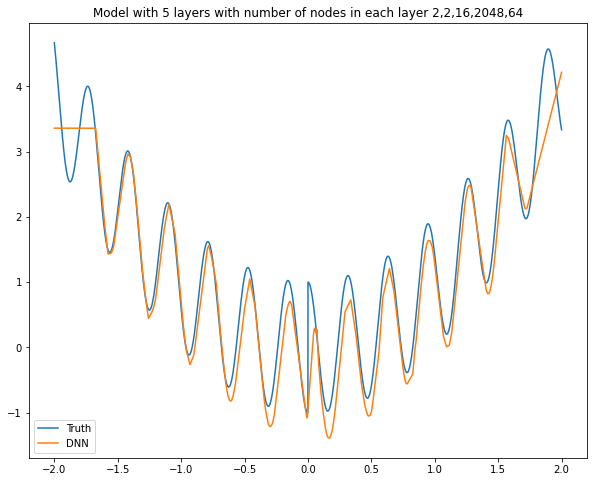

Model: "sequential_487"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2902 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2903 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2904 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2905 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2906 (Dense)           (None, 128)               262272    
_________________________________________________________________
dense_2907 (Dense)           (None, 1)                 129       
Total params: 297,275
Trainable params: 297,275
Non-trainable params: 0
______________________________________________

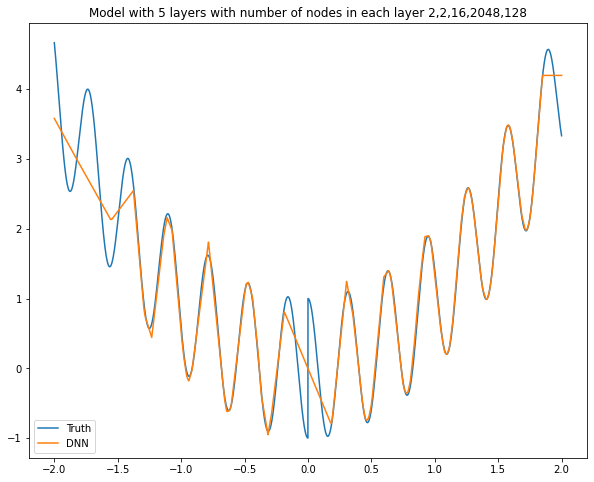

Model: "sequential_488"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2908 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2909 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2910 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2911 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2912 (Dense)           (None, 256)               524544    
_________________________________________________________________
dense_2913 (Dense)           (None, 1)                 257       
Total params: 559,675
Trainable params: 559,675
Non-trainable params: 0
______________________________________________

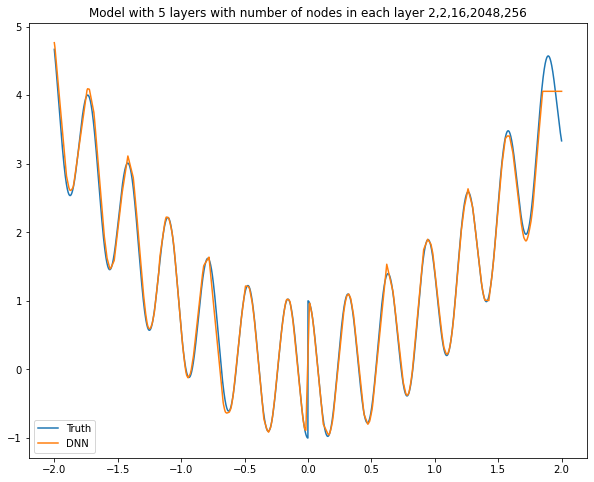

Model: "sequential_489"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2914 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2915 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2916 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2917 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2918 (Dense)           (None, 512)               1049088   
_________________________________________________________________
dense_2919 (Dense)           (None, 1)                 513       
Total params: 1,084,475
Trainable params: 1,084,475
Non-trainable params: 0
__________________________________________

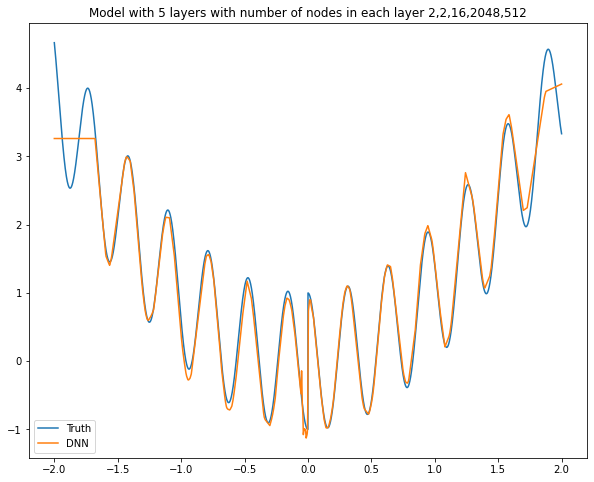

Model: "sequential_490"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2920 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2921 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2922 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2923 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2924 (Dense)           (None, 1024)              2098176   
_________________________________________________________________
dense_2925 (Dense)           (None, 1)                 1025      
Total params: 2,134,075
Trainable params: 2,134,075
Non-trainable params: 0
__________________________________________

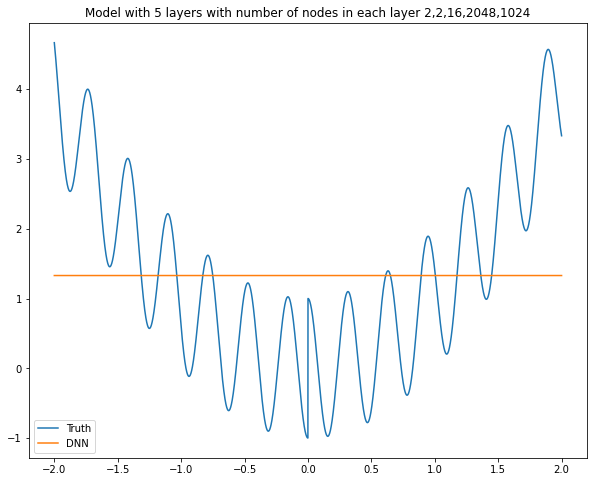

Model: "sequential_491"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2926 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2927 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2928 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2929 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_2930 (Dense)           (None, 2048)              4196352   
_________________________________________________________________
dense_2931 (Dense)           (None, 1)                 2049      
Total params: 4,233,275
Trainable params: 4,233,275
Non-trainable params: 0
__________________________________________

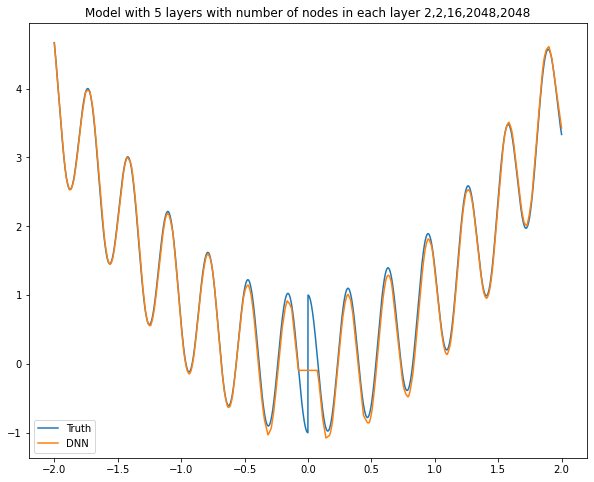

Model: "sequential_492"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2932 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2933 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2934 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2935 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2936 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2937 (Dense)           (None, 1)                 3         
Total params: 181
Trainable params: 181
Non-trainable params: 0
______________________________________________________

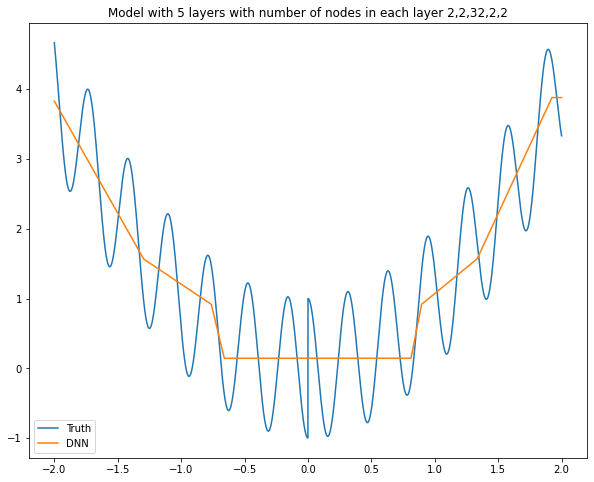

Model: "sequential_493"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2938 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2939 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2940 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2941 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2942 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_2943 (Dense)           (None, 1)                 5         
Total params: 189
Trainable params: 189
Non-trainable params: 0
______________________________________________________

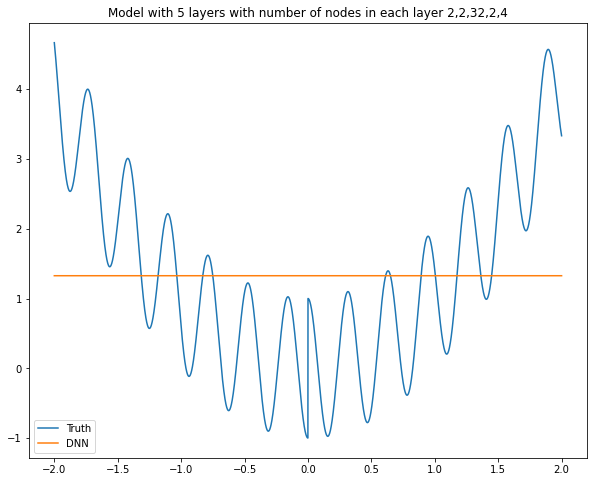

Model: "sequential_494"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2944 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2945 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2946 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2947 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2948 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_2949 (Dense)           (None, 1)                 9         
Total params: 205
Trainable params: 205
Non-trainable params: 0
______________________________________________________

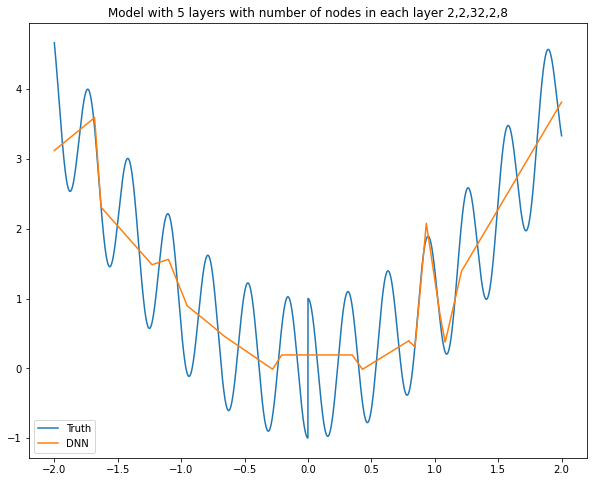

Model: "sequential_495"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2950 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2951 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2952 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2953 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2954 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_2955 (Dense)           (None, 1)                 17        
Total params: 237
Trainable params: 237
Non-trainable params: 0
______________________________________________________

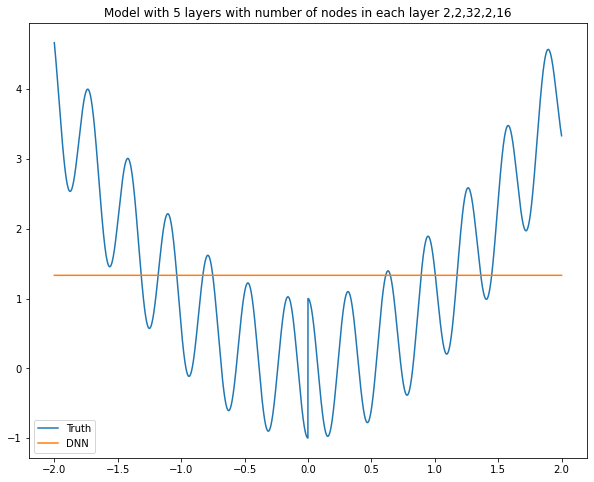

Model: "sequential_496"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2956 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2957 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2958 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2959 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2960 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2961 (Dense)           (None, 1)                 33        
Total params: 301
Trainable params: 301
Non-trainable params: 0
______________________________________________________

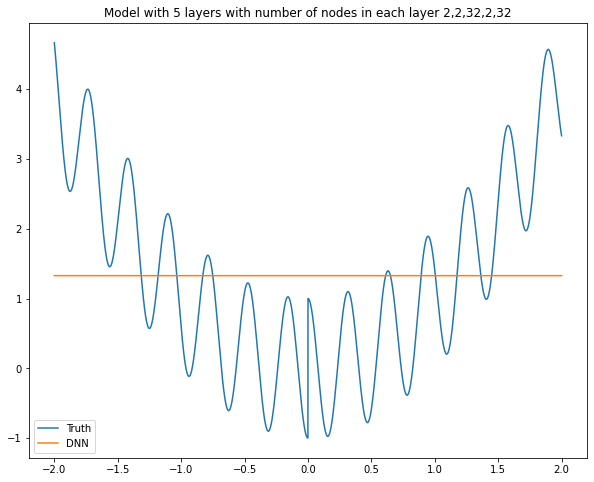

Model: "sequential_497"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2962 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2963 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2964 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2965 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2966 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_2967 (Dense)           (None, 1)                 65        
Total params: 429
Trainable params: 429
Non-trainable params: 0
______________________________________________________

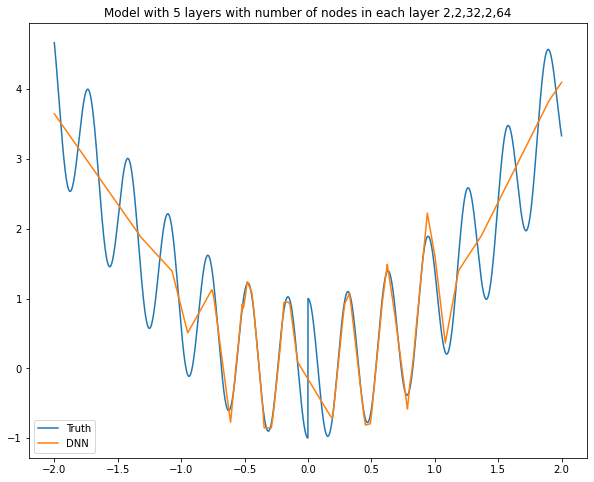

Model: "sequential_498"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2968 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2969 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2970 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2971 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2972 (Dense)           (None, 128)               384       
_________________________________________________________________
dense_2973 (Dense)           (None, 1)                 129       
Total params: 685
Trainable params: 685
Non-trainable params: 0
______________________________________________________

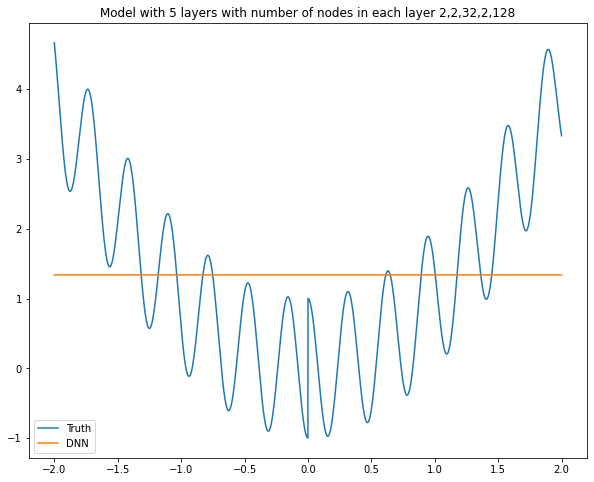

Model: "sequential_499"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2974 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2975 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2976 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2977 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2978 (Dense)           (None, 256)               768       
_________________________________________________________________
dense_2979 (Dense)           (None, 1)                 257       
Total params: 1,197
Trainable params: 1,197
Non-trainable params: 0
__________________________________________________

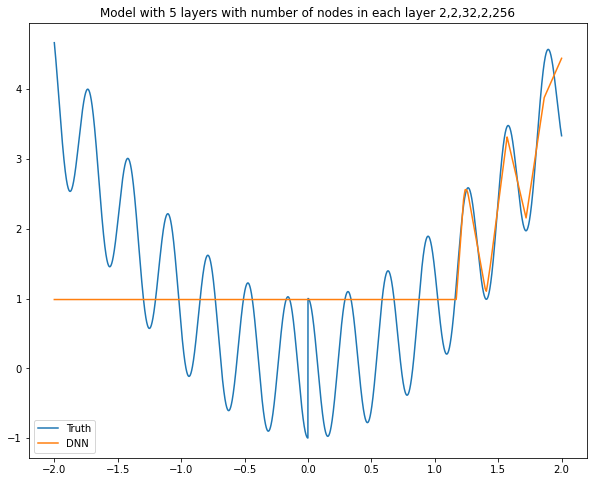

Model: "sequential_500"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2980 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2981 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2982 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2983 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2984 (Dense)           (None, 512)               1536      
_________________________________________________________________
dense_2985 (Dense)           (None, 1)                 513       
Total params: 2,221
Trainable params: 2,221
Non-trainable params: 0
__________________________________________________

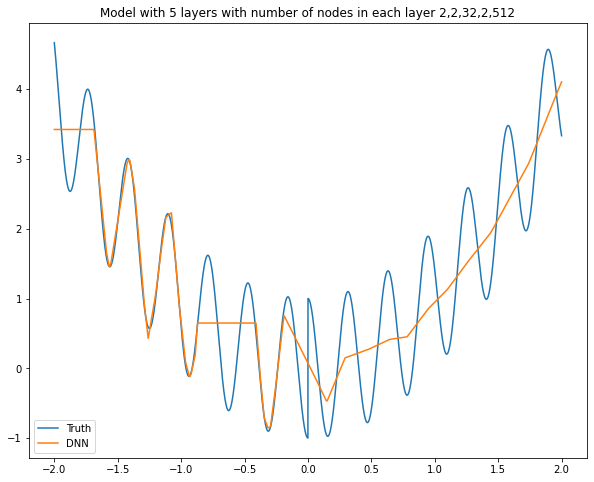

Model: "sequential_501"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2986 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2987 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2988 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2989 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2990 (Dense)           (None, 1024)              3072      
_________________________________________________________________
dense_2991 (Dense)           (None, 1)                 1025      
Total params: 4,269
Trainable params: 4,269
Non-trainable params: 0
__________________________________________________

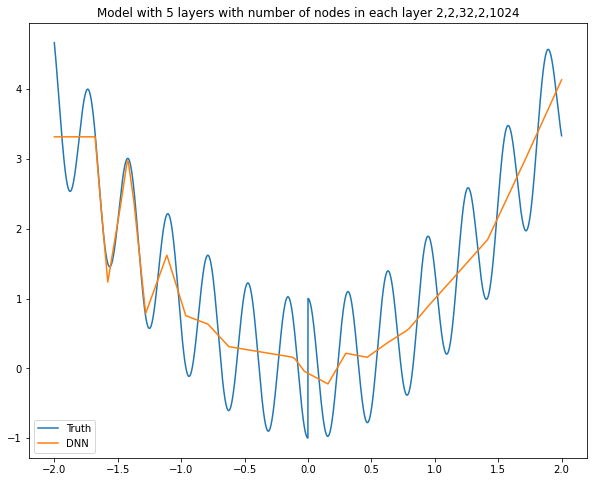

Model: "sequential_502"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2992 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2993 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_2994 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_2995 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_2996 (Dense)           (None, 2048)              6144      
_________________________________________________________________
dense_2997 (Dense)           (None, 1)                 2049      
Total params: 8,365
Trainable params: 8,365
Non-trainable params: 0
__________________________________________________

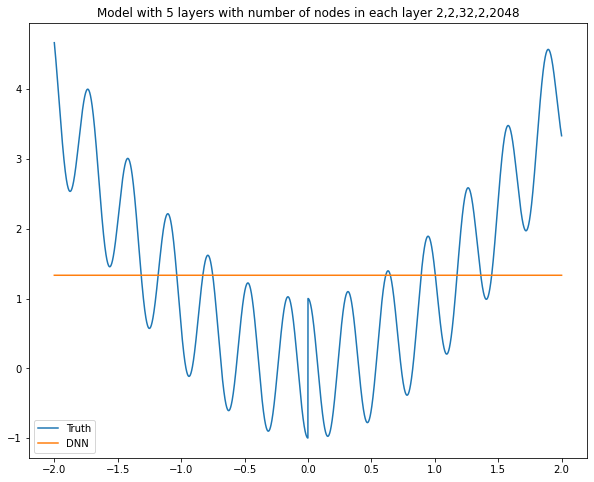

Model: "sequential_503"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2998 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_2999 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3000 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3001 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3002 (Dense)           (None, 2)                 10        
_________________________________________________________________
dense_3003 (Dense)           (None, 1)                 3         
Total params: 251
Trainable params: 251
Non-trainable params: 0
______________________________________________________

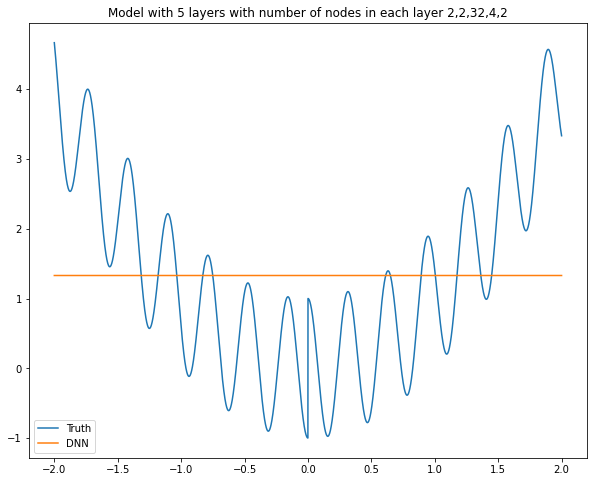

Model: "sequential_504"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3004 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3005 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3006 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3007 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3008 (Dense)           (None, 4)                 20        
_________________________________________________________________
dense_3009 (Dense)           (None, 1)                 5         
Total params: 263
Trainable params: 263
Non-trainable params: 0
______________________________________________________

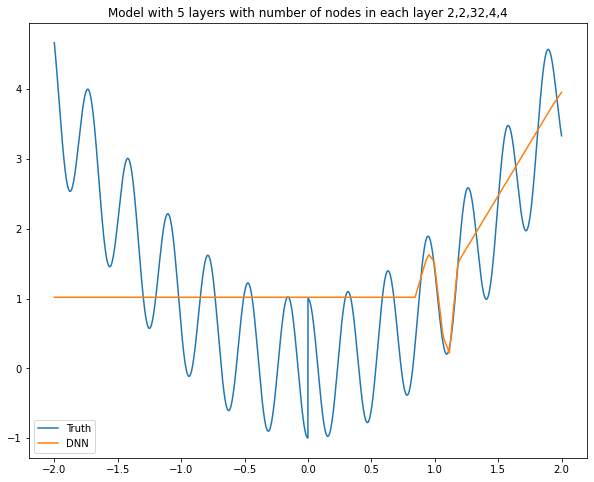

Model: "sequential_505"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3010 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3011 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3012 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3013 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3014 (Dense)           (None, 8)                 40        
_________________________________________________________________
dense_3015 (Dense)           (None, 1)                 9         
Total params: 287
Trainable params: 287
Non-trainable params: 0
______________________________________________________

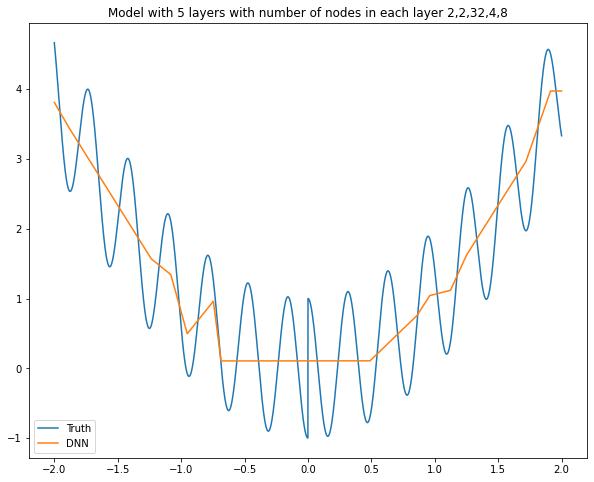

Model: "sequential_506"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3016 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3017 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3018 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3019 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3020 (Dense)           (None, 16)                80        
_________________________________________________________________
dense_3021 (Dense)           (None, 1)                 17        
Total params: 335
Trainable params: 335
Non-trainable params: 0
______________________________________________________

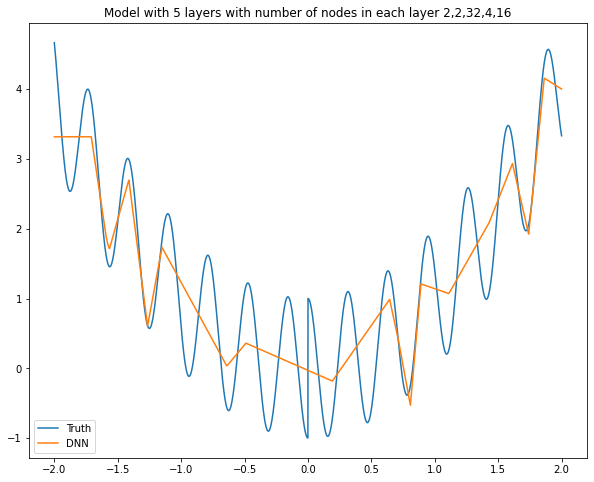

Model: "sequential_507"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3022 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3023 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3024 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3025 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3026 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_3027 (Dense)           (None, 1)                 33        
Total params: 431
Trainable params: 431
Non-trainable params: 0
______________________________________________________

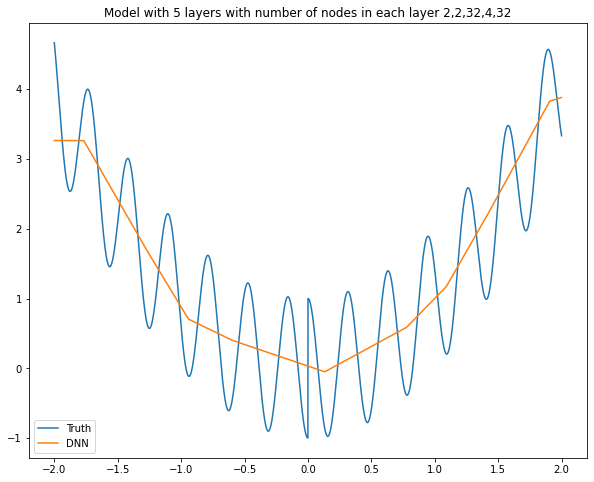

Model: "sequential_508"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3028 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3029 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3030 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3031 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3032 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_3033 (Dense)           (None, 1)                 65        
Total params: 623
Trainable params: 623
Non-trainable params: 0
______________________________________________________

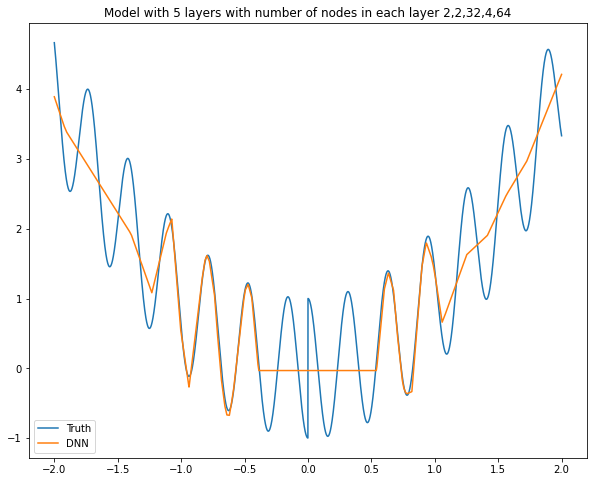

Model: "sequential_509"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3034 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3035 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3036 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3037 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3038 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_3039 (Dense)           (None, 1)                 129       
Total params: 1,007
Trainable params: 1,007
Non-trainable params: 0
__________________________________________________

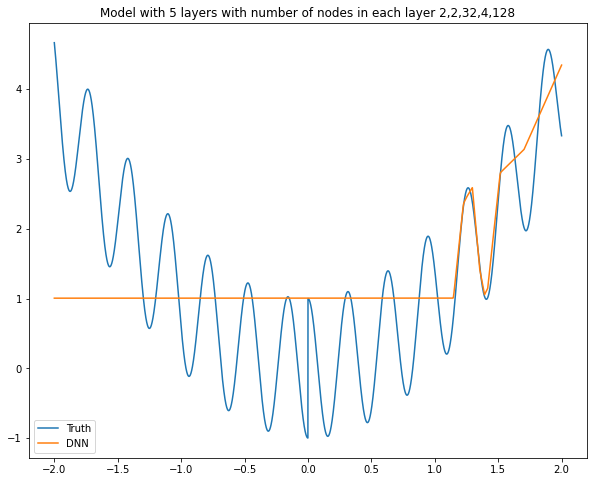

Model: "sequential_510"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3040 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3041 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3042 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3043 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3044 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_3045 (Dense)           (None, 1)                 257       
Total params: 1,775
Trainable params: 1,775
Non-trainable params: 0
__________________________________________________

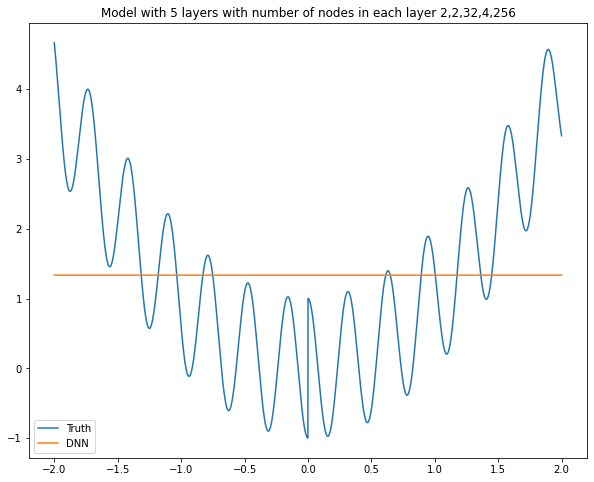

Model: "sequential_511"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3046 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3047 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3048 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3049 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3050 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_3051 (Dense)           (None, 1)                 513       
Total params: 3,311
Trainable params: 3,311
Non-trainable params: 0
__________________________________________________

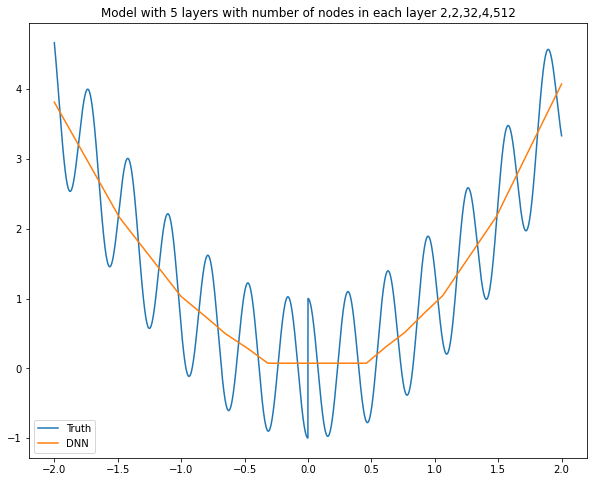

Model: "sequential_512"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3052 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3053 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3054 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3055 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3056 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_3057 (Dense)           (None, 1)                 1025      
Total params: 6,383
Trainable params: 6,383
Non-trainable params: 0
__________________________________________________

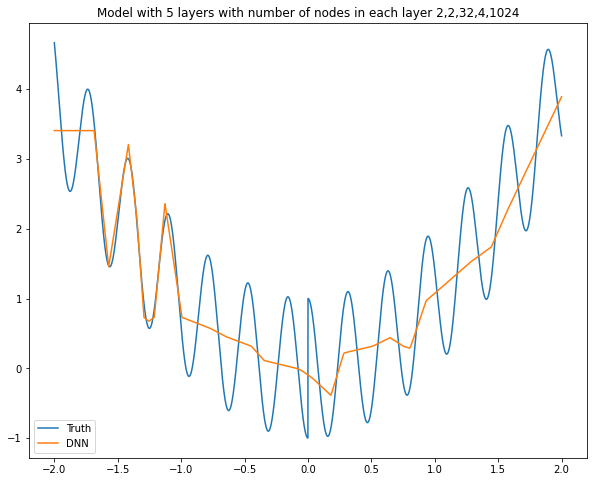

Model: "sequential_513"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3058 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3059 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3060 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3061 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3062 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_3063 (Dense)           (None, 1)                 2049      
Total params: 12,527
Trainable params: 12,527
Non-trainable params: 0
________________________________________________

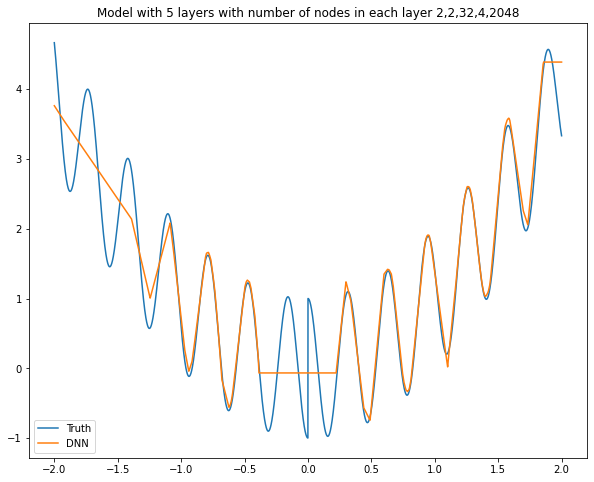

Model: "sequential_514"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3064 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3065 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3066 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3067 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3068 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_3069 (Dense)           (None, 1)                 3         
Total params: 391
Trainable params: 391
Non-trainable params: 0
______________________________________________________

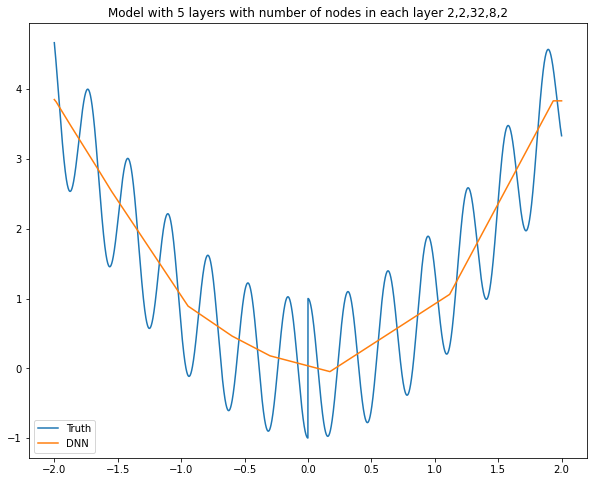

Model: "sequential_515"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3070 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3071 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3072 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3073 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3074 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_3075 (Dense)           (None, 1)                 5         
Total params: 411
Trainable params: 411
Non-trainable params: 0
______________________________________________________

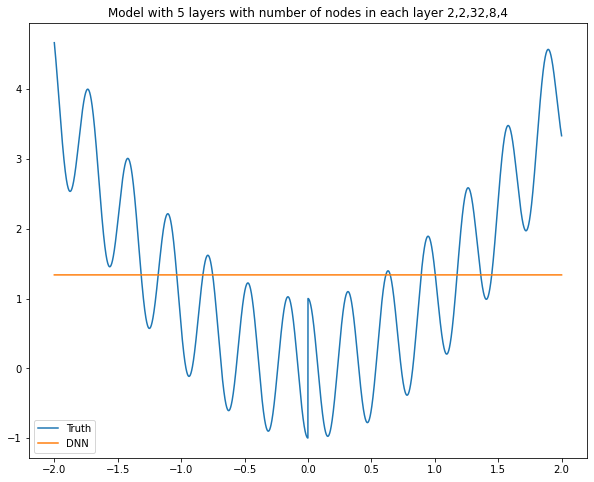

Model: "sequential_516"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3076 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3077 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3078 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3079 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3080 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_3081 (Dense)           (None, 1)                 9         
Total params: 451
Trainable params: 451
Non-trainable params: 0
______________________________________________________

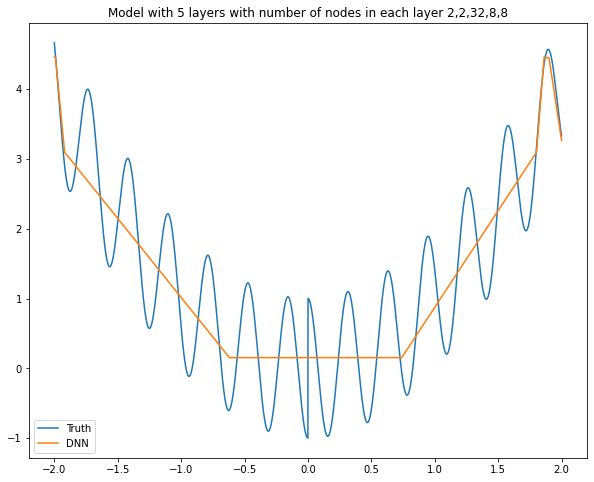

Model: "sequential_517"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3082 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3083 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3084 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3085 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3086 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_3087 (Dense)           (None, 1)                 17        
Total params: 531
Trainable params: 531
Non-trainable params: 0
______________________________________________________

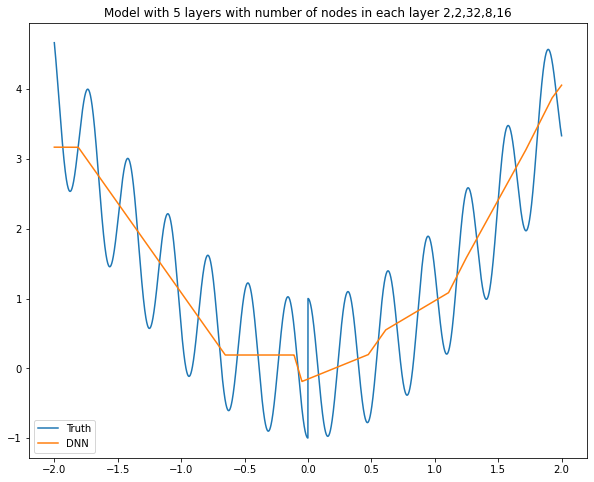

Model: "sequential_518"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3088 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3089 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3090 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3091 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3092 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_3093 (Dense)           (None, 1)                 33        
Total params: 691
Trainable params: 691
Non-trainable params: 0
______________________________________________________

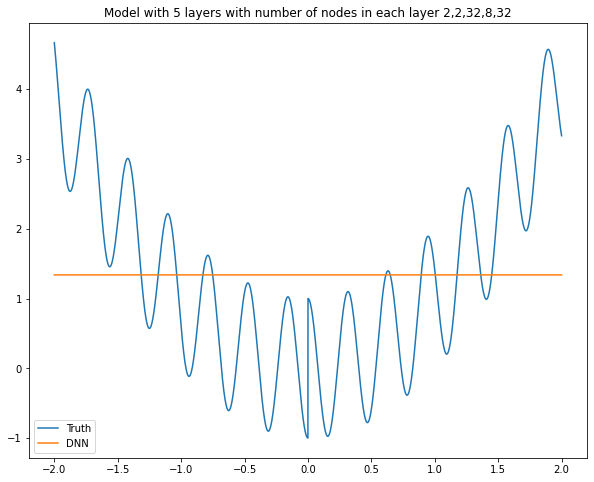

Model: "sequential_519"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3094 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3095 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3096 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3097 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3098 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_3099 (Dense)           (None, 1)                 65        
Total params: 1,011
Trainable params: 1,011
Non-trainable params: 0
__________________________________________________

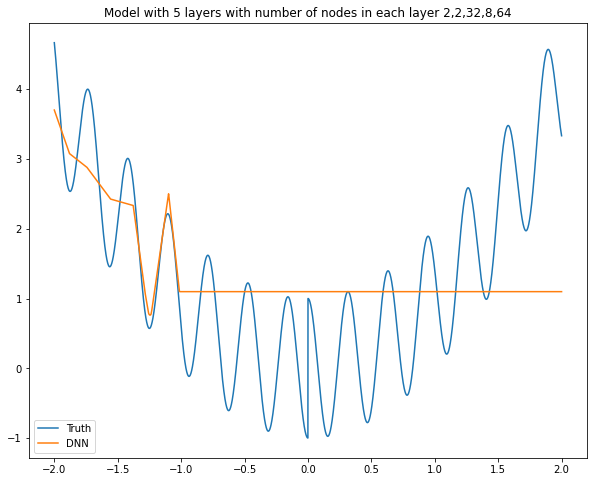

Model: "sequential_520"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3100 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3101 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3102 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3103 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3104 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_3105 (Dense)           (None, 1)                 129       
Total params: 1,651
Trainable params: 1,651
Non-trainable params: 0
__________________________________________________

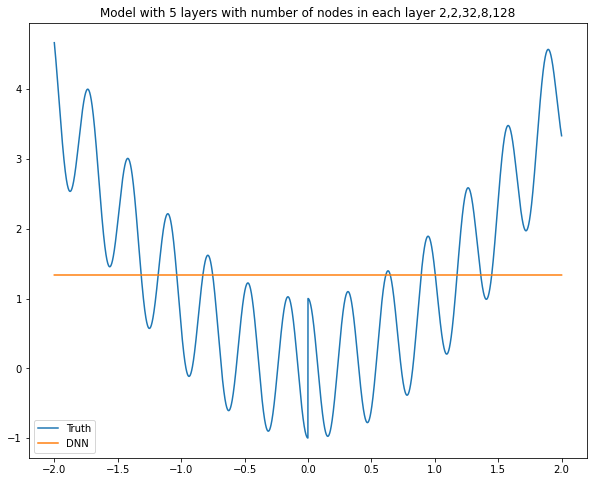

Model: "sequential_521"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3106 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3107 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3108 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3109 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3110 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_3111 (Dense)           (None, 1)                 257       
Total params: 2,931
Trainable params: 2,931
Non-trainable params: 0
__________________________________________________

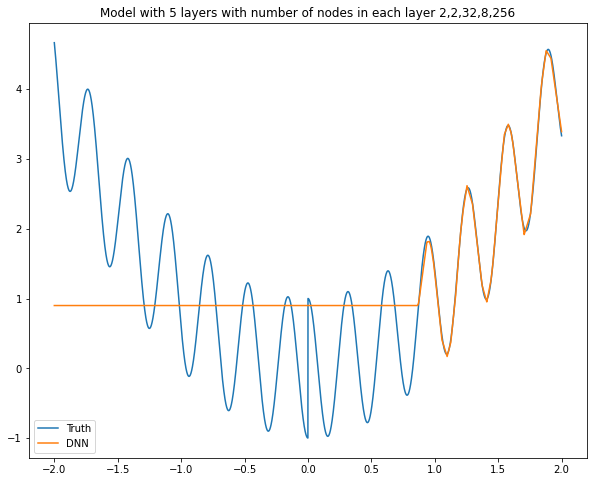

Model: "sequential_522"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3112 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3113 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3114 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3115 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3116 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_3117 (Dense)           (None, 1)                 513       
Total params: 5,491
Trainable params: 5,491
Non-trainable params: 0
__________________________________________________

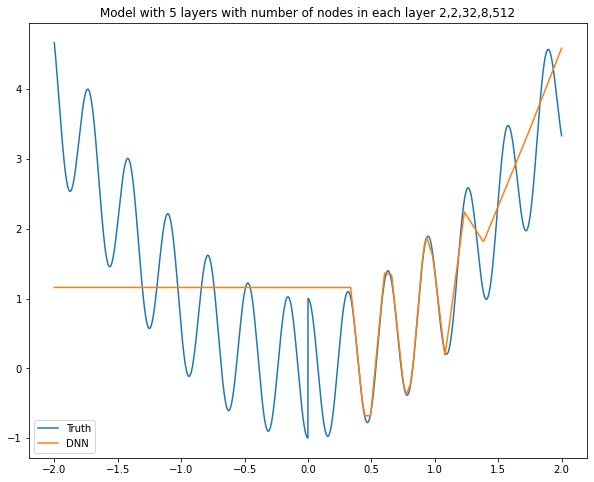

Model: "sequential_523"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3118 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3119 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3120 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3121 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3122 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_3123 (Dense)           (None, 1)                 1025      
Total params: 10,611
Trainable params: 10,611
Non-trainable params: 0
________________________________________________

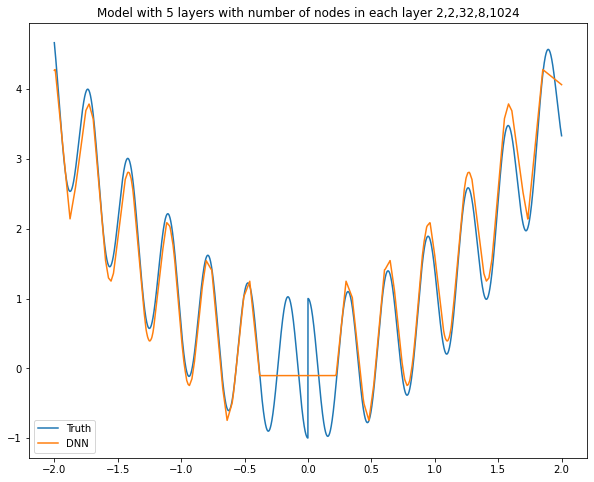

Model: "sequential_524"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3124 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3125 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3126 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3127 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3128 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_3129 (Dense)           (None, 1)                 2049      
Total params: 20,851
Trainable params: 20,851
Non-trainable params: 0
________________________________________________

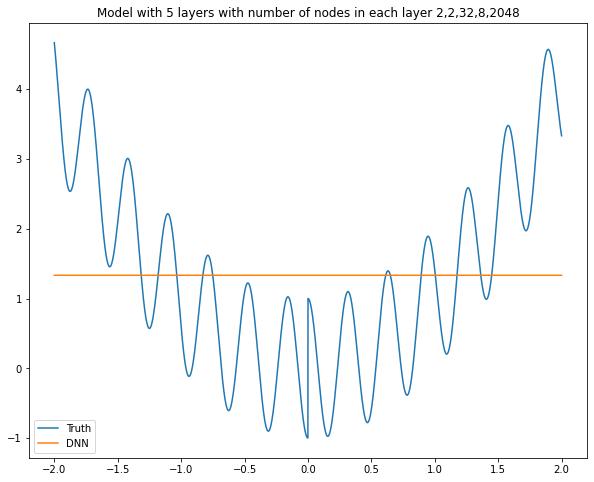

Model: "sequential_525"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3130 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3131 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3132 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3133 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3134 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_3135 (Dense)           (None, 1)                 3         
Total params: 671
Trainable params: 671
Non-trainable params: 0
______________________________________________________

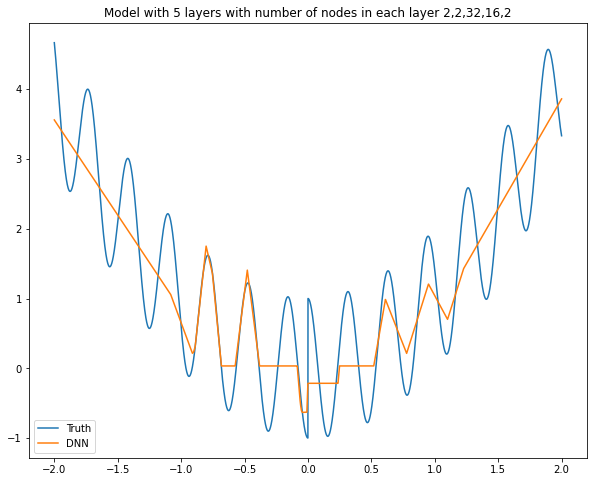

Model: "sequential_526"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3136 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3137 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3138 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3139 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3140 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_3141 (Dense)           (None, 1)                 5         
Total params: 707
Trainable params: 707
Non-trainable params: 0
______________________________________________________

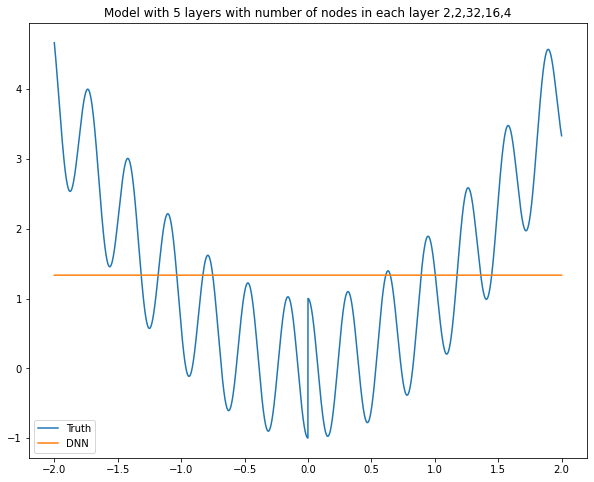

Model: "sequential_527"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3142 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3143 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3144 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3145 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3146 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_3147 (Dense)           (None, 1)                 9         
Total params: 779
Trainable params: 779
Non-trainable params: 0
______________________________________________________

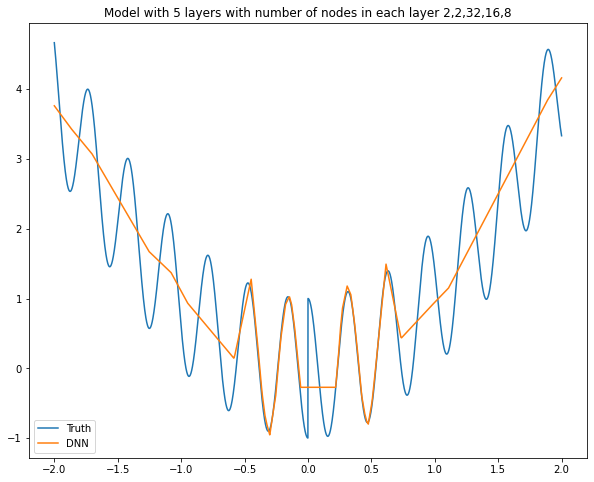

Model: "sequential_528"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3148 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3149 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3150 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3151 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3152 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_3153 (Dense)           (None, 1)                 17        
Total params: 923
Trainable params: 923
Non-trainable params: 0
______________________________________________________

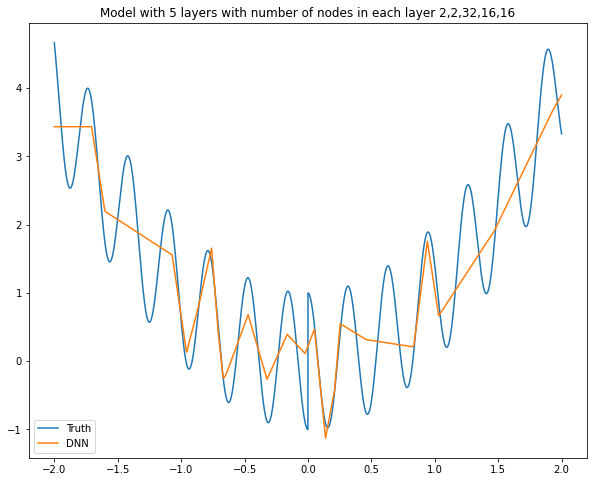

Model: "sequential_529"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3154 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3155 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3156 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3157 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3158 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_3159 (Dense)           (None, 1)                 33        
Total params: 1,211
Trainable params: 1,211
Non-trainable params: 0
__________________________________________________

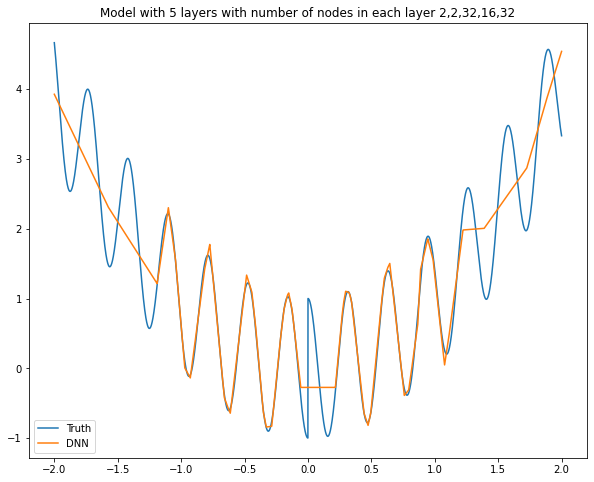

Model: "sequential_530"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3160 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3161 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3162 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3163 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3164 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_3165 (Dense)           (None, 1)                 65        
Total params: 1,787
Trainable params: 1,787
Non-trainable params: 0
__________________________________________________

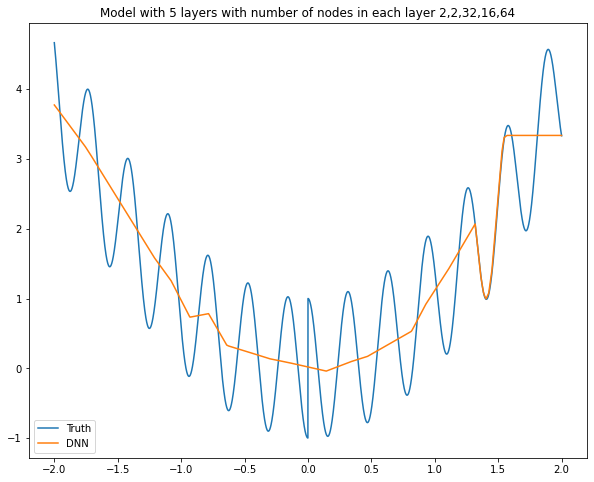

Model: "sequential_531"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3166 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3167 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3168 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3169 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3170 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_3171 (Dense)           (None, 1)                 129       
Total params: 2,939
Trainable params: 2,939
Non-trainable params: 0
__________________________________________________

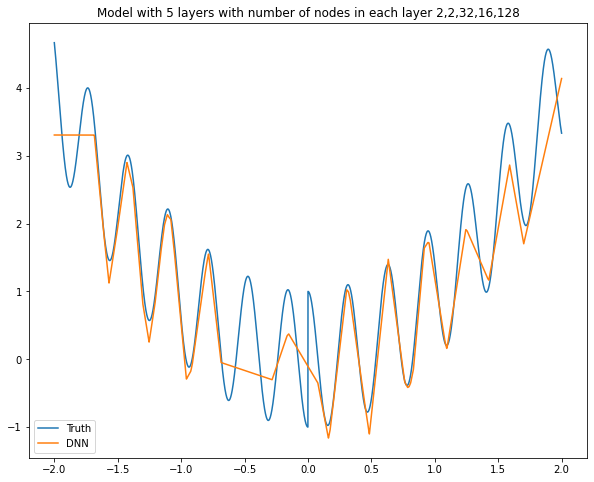

Model: "sequential_532"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3172 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3173 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3174 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3175 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3176 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_3177 (Dense)           (None, 1)                 257       
Total params: 5,243
Trainable params: 5,243
Non-trainable params: 0
__________________________________________________

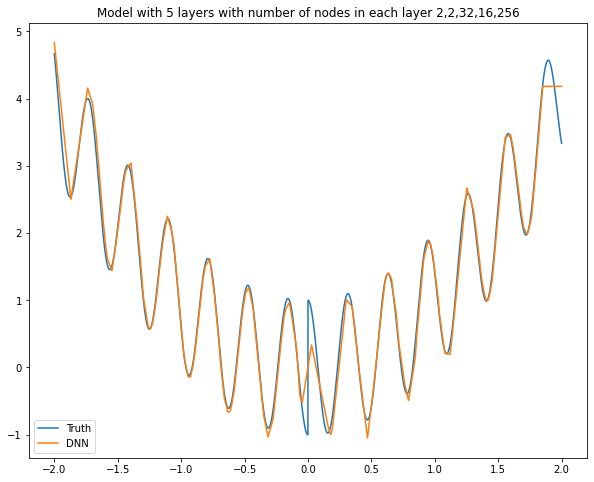

Model: "sequential_533"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3178 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3179 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3180 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3181 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3182 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_3183 (Dense)           (None, 1)                 513       
Total params: 9,851
Trainable params: 9,851
Non-trainable params: 0
__________________________________________________

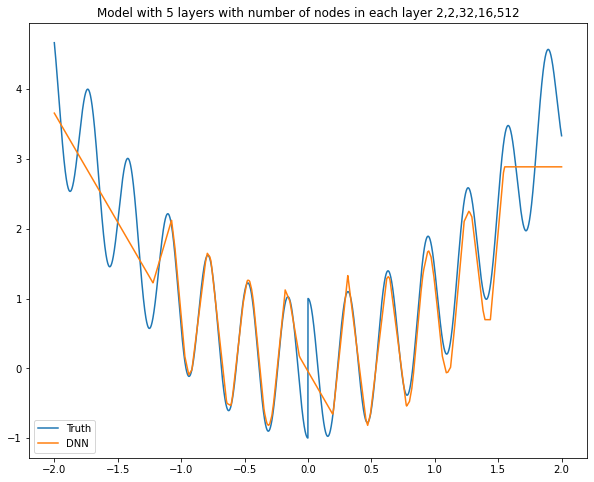

Model: "sequential_534"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3184 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3185 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3186 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3187 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3188 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_3189 (Dense)           (None, 1)                 1025      
Total params: 19,067
Trainable params: 19,067
Non-trainable params: 0
________________________________________________

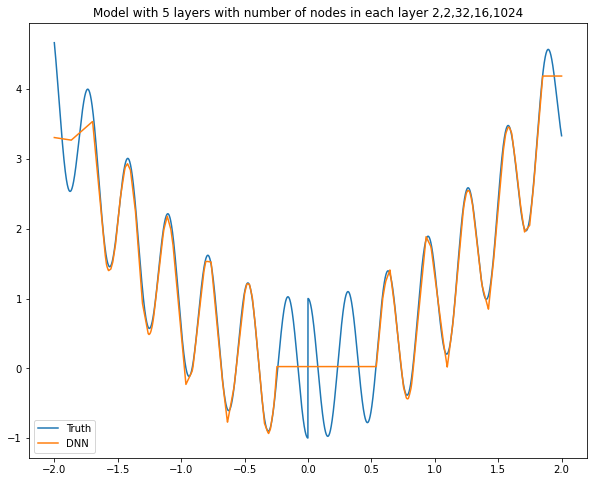

Model: "sequential_535"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3190 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3191 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3192 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3193 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3194 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_3195 (Dense)           (None, 1)                 2049      
Total params: 37,499
Trainable params: 37,499
Non-trainable params: 0
________________________________________________

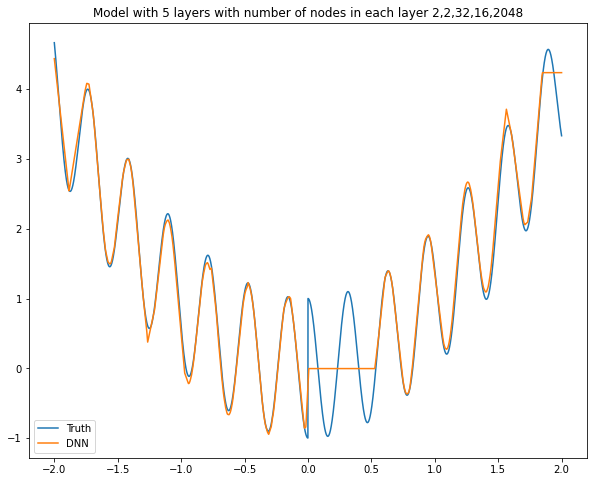

Model: "sequential_536"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3196 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3197 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3198 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3199 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3200 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_3201 (Dense)           (None, 1)                 3         
Total params: 1,231
Trainable params: 1,231
Non-trainable params: 0
__________________________________________________

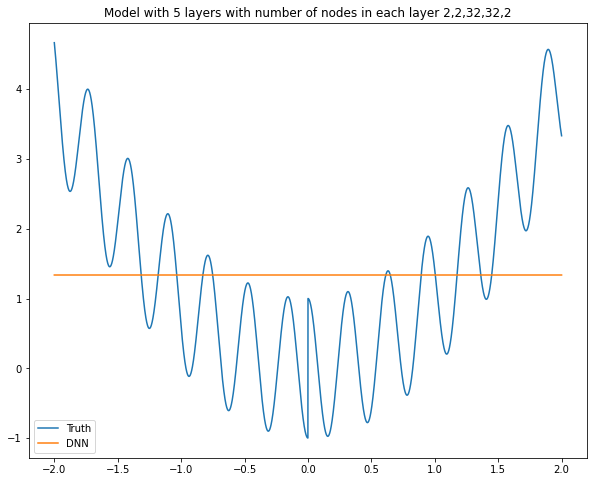

Model: "sequential_537"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3202 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3203 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3204 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3205 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3206 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3207 (Dense)           (None, 1)                 5         
Total params: 1,299
Trainable params: 1,299
Non-trainable params: 0
__________________________________________________

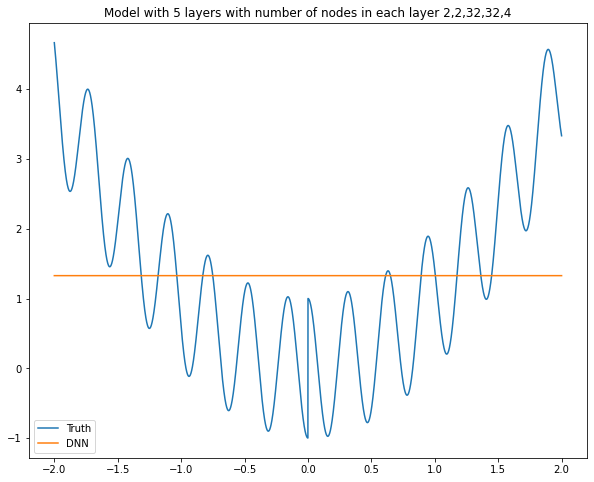

Model: "sequential_538"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3208 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3209 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3210 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3211 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3212 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3213 (Dense)           (None, 1)                 9         
Total params: 1,435
Trainable params: 1,435
Non-trainable params: 0
__________________________________________________

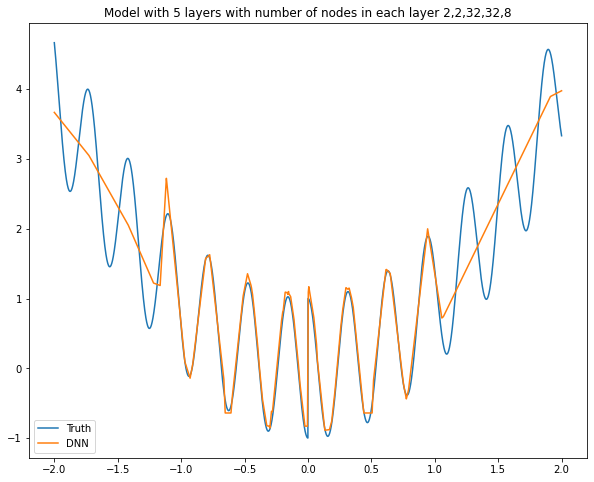

Model: "sequential_539"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3214 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3215 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3216 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3217 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3218 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3219 (Dense)           (None, 1)                 17        
Total params: 1,707
Trainable params: 1,707
Non-trainable params: 0
__________________________________________________

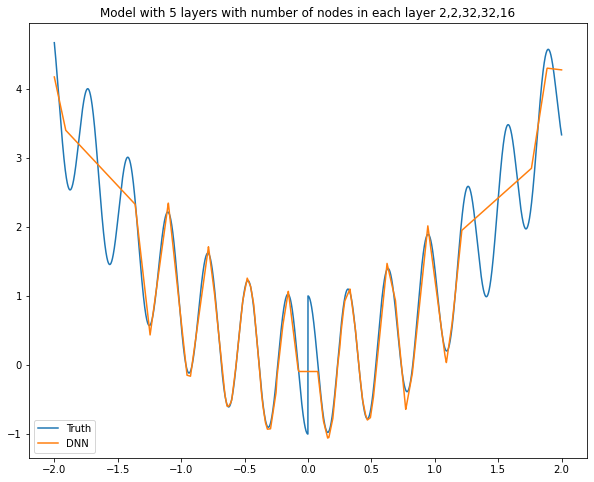

Model: "sequential_540"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3220 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3221 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3222 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3223 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3224 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3225 (Dense)           (None, 1)                 33        
Total params: 2,251
Trainable params: 2,251
Non-trainable params: 0
__________________________________________________

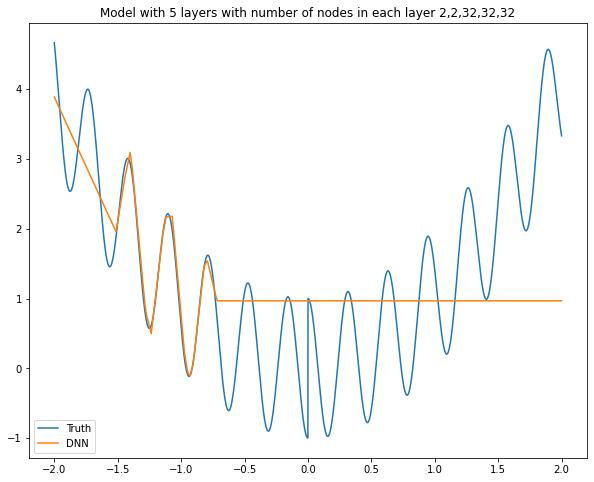

Model: "sequential_541"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3226 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3227 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3228 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3229 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3230 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3231 (Dense)           (None, 1)                 65        
Total params: 3,339
Trainable params: 3,339
Non-trainable params: 0
__________________________________________________

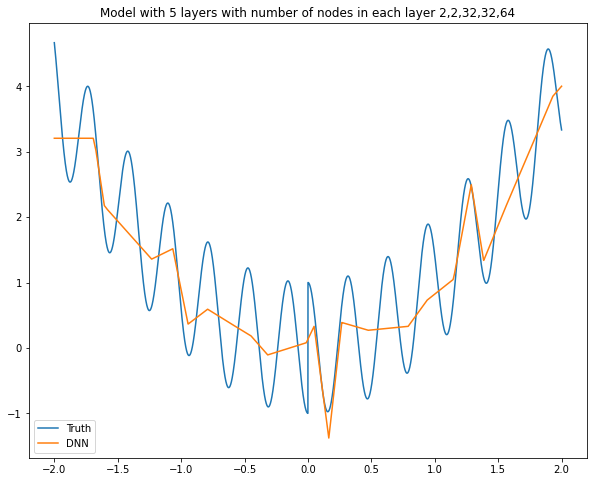

Model: "sequential_542"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3232 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3233 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3234 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3235 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3236 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3237 (Dense)           (None, 1)                 129       
Total params: 5,515
Trainable params: 5,515
Non-trainable params: 0
__________________________________________________

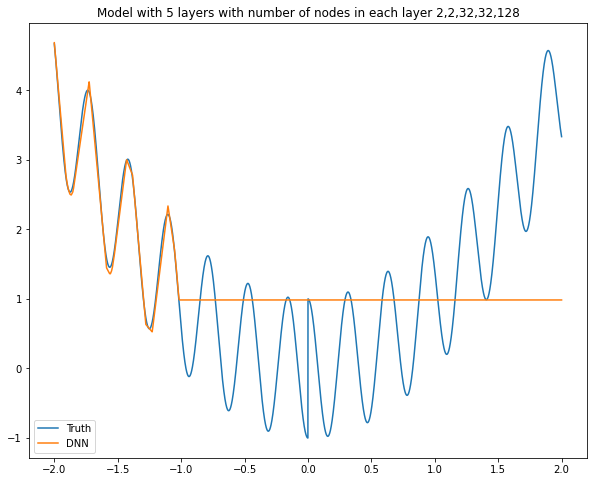

Model: "sequential_543"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3238 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3239 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3240 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3241 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3242 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3243 (Dense)           (None, 1)                 257       
Total params: 9,867
Trainable params: 9,867
Non-trainable params: 0
__________________________________________________

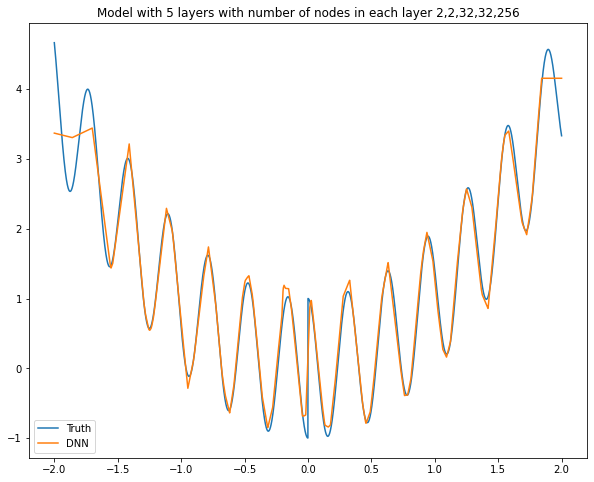

Model: "sequential_544"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3244 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3245 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3246 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3247 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3248 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3249 (Dense)           (None, 1)                 513       
Total params: 18,571
Trainable params: 18,571
Non-trainable params: 0
________________________________________________

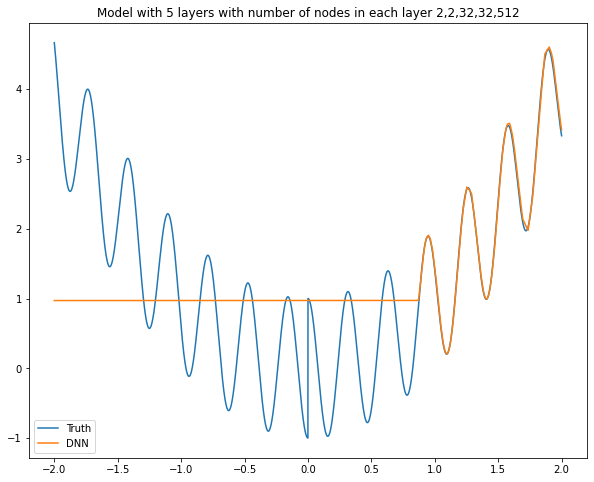

Model: "sequential_545"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3250 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3251 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3252 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3253 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3254 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3255 (Dense)           (None, 1)                 1025      
Total params: 35,979
Trainable params: 35,979
Non-trainable params: 0
________________________________________________

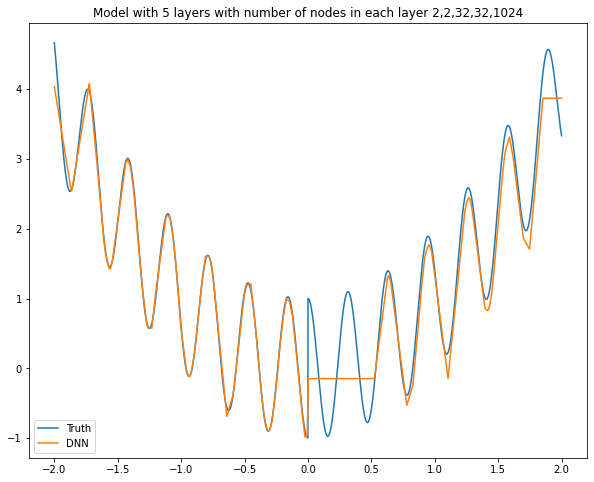

Model: "sequential_546"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3256 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3257 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3258 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3259 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3260 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3261 (Dense)           (None, 1)                 2049      
Total params: 70,795
Trainable params: 70,795
Non-trainable params: 0
________________________________________________

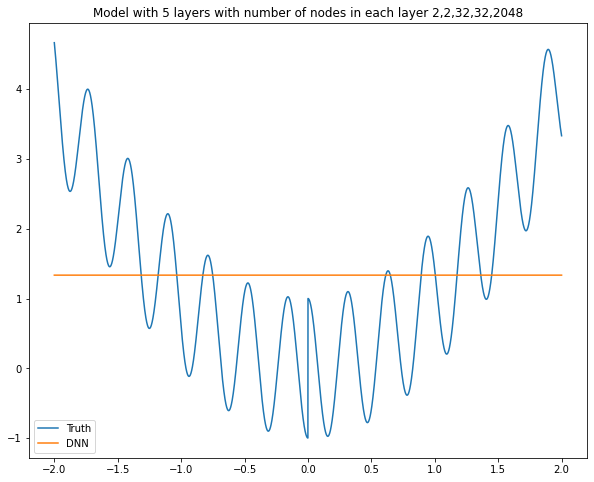

Model: "sequential_547"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3262 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3263 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3264 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3265 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3266 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3267 (Dense)           (None, 1)                 3         
Total params: 2,351
Trainable params: 2,351
Non-trainable params: 0
__________________________________________________

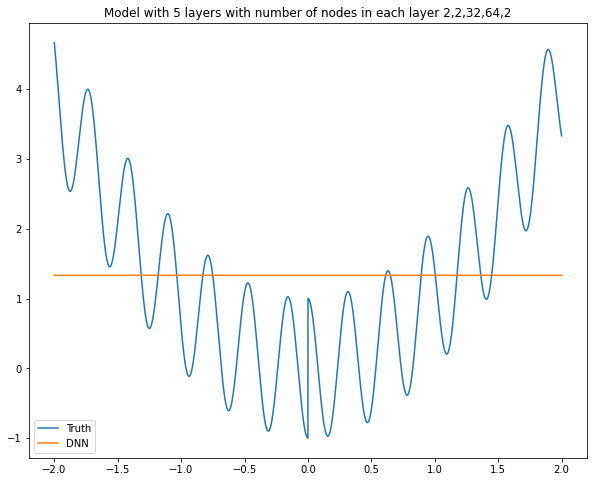

Model: "sequential_548"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3268 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3269 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3270 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3271 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3272 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3273 (Dense)           (None, 1)                 5         
Total params: 2,483
Trainable params: 2,483
Non-trainable params: 0
__________________________________________________

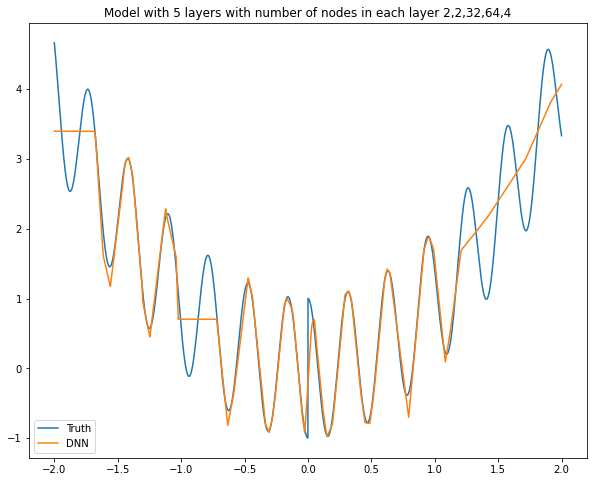

Model: "sequential_549"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3274 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3275 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3276 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3277 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3278 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3279 (Dense)           (None, 1)                 9         
Total params: 2,747
Trainable params: 2,747
Non-trainable params: 0
__________________________________________________

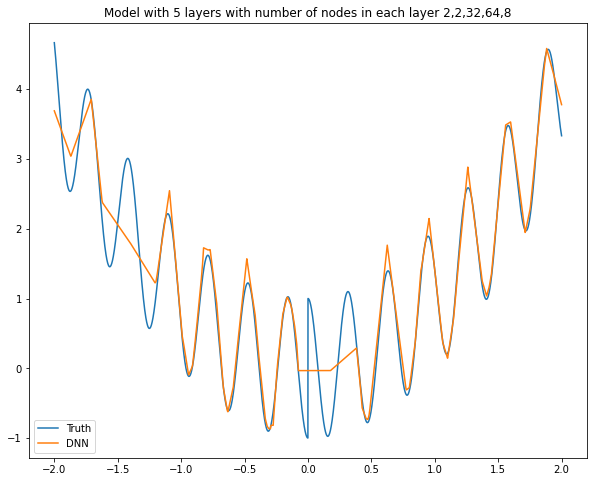

Model: "sequential_550"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3280 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3281 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3282 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3283 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3284 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3285 (Dense)           (None, 1)                 17        
Total params: 3,275
Trainable params: 3,275
Non-trainable params: 0
__________________________________________________

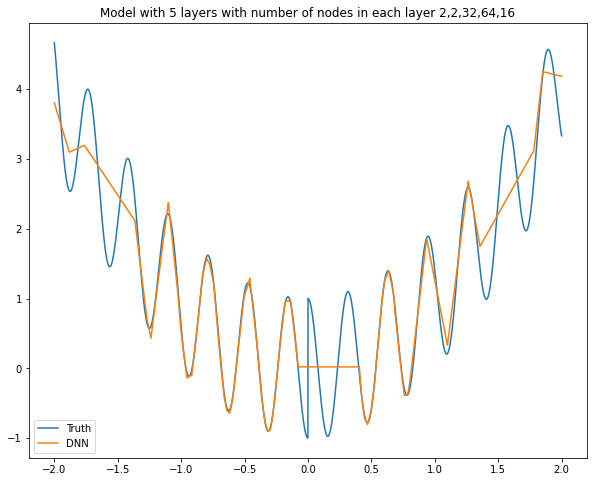

Model: "sequential_551"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3286 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3287 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3288 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3289 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3290 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3291 (Dense)           (None, 1)                 33        
Total params: 4,331
Trainable params: 4,331
Non-trainable params: 0
__________________________________________________

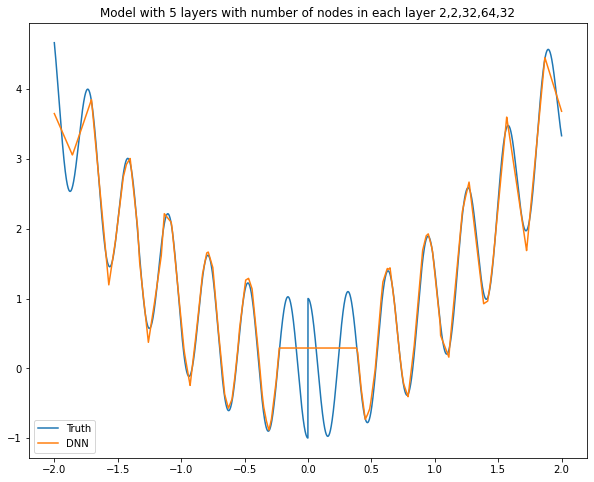

Model: "sequential_552"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3292 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3293 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3294 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3295 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3296 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_3297 (Dense)           (None, 1)                 65        
Total params: 6,443
Trainable params: 6,443
Non-trainable params: 0
__________________________________________________

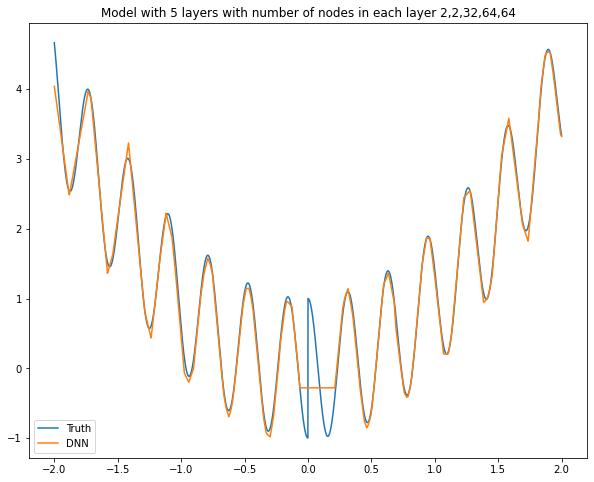

Model: "sequential_553"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3298 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3299 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3300 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3301 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3302 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_3303 (Dense)           (None, 1)                 129       
Total params: 10,667
Trainable params: 10,667
Non-trainable params: 0
________________________________________________

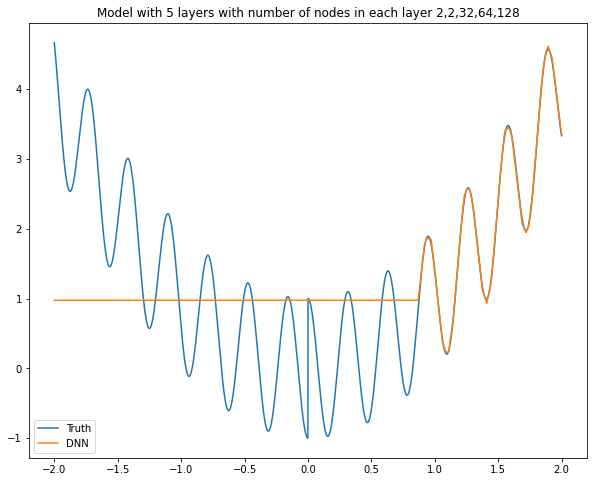

Model: "sequential_554"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3304 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3305 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3306 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3307 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3308 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_3309 (Dense)           (None, 1)                 257       
Total params: 19,115
Trainable params: 19,115
Non-trainable params: 0
________________________________________________

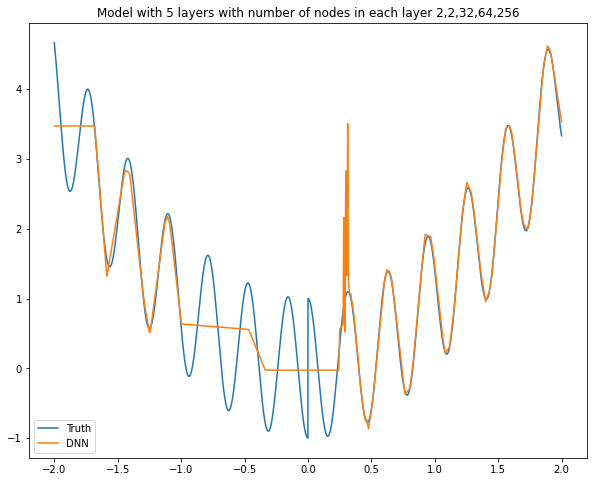

Model: "sequential_555"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3310 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3311 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3312 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3313 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3314 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_3315 (Dense)           (None, 1)                 513       
Total params: 36,011
Trainable params: 36,011
Non-trainable params: 0
________________________________________________

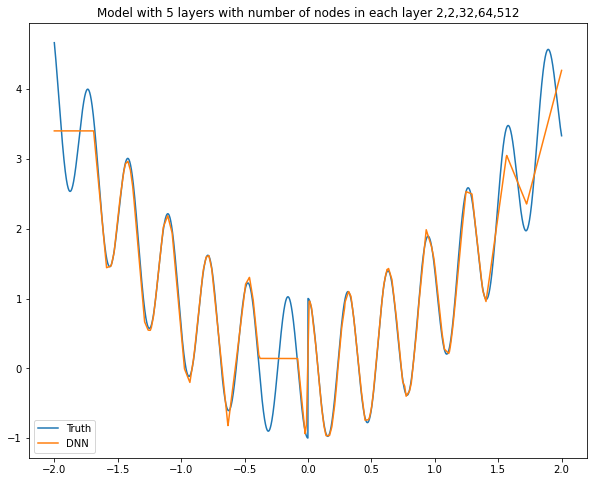

Model: "sequential_556"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3316 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3317 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3318 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3319 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3320 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_3321 (Dense)           (None, 1)                 1025      
Total params: 69,803
Trainable params: 69,803
Non-trainable params: 0
________________________________________________

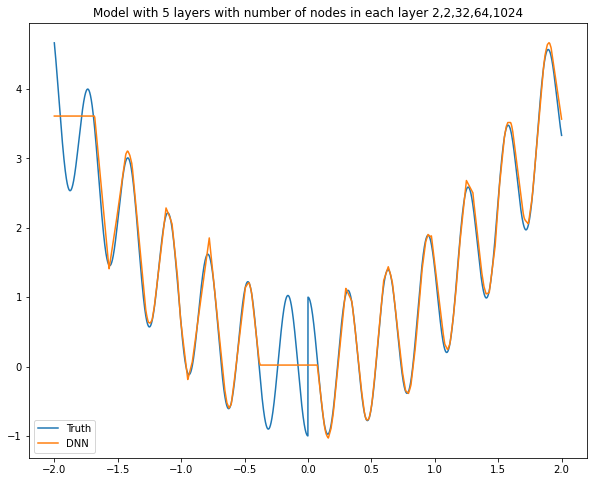

Model: "sequential_557"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3322 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3323 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3324 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3325 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3326 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_3327 (Dense)           (None, 1)                 2049      
Total params: 137,387
Trainable params: 137,387
Non-trainable params: 0
______________________________________________

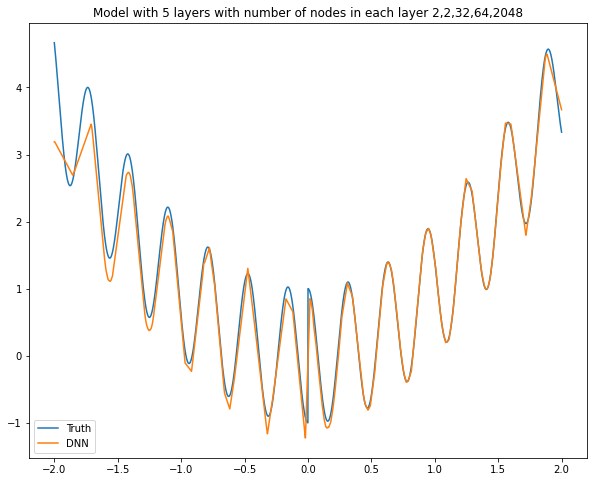

Model: "sequential_558"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3328 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3329 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3330 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3331 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3332 (Dense)           (None, 2)                 258       
_________________________________________________________________
dense_3333 (Dense)           (None, 1)                 3         
Total params: 4,591
Trainable params: 4,591
Non-trainable params: 0
__________________________________________________

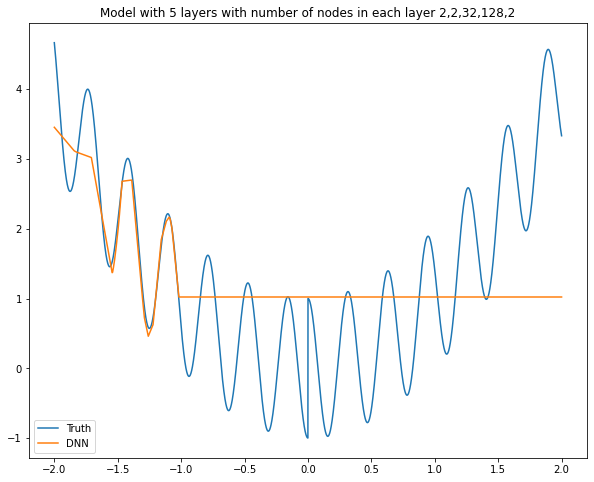

Model: "sequential_559"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3334 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3335 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3336 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3337 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3338 (Dense)           (None, 4)                 516       
_________________________________________________________________
dense_3339 (Dense)           (None, 1)                 5         
Total params: 4,851
Trainable params: 4,851
Non-trainable params: 0
__________________________________________________

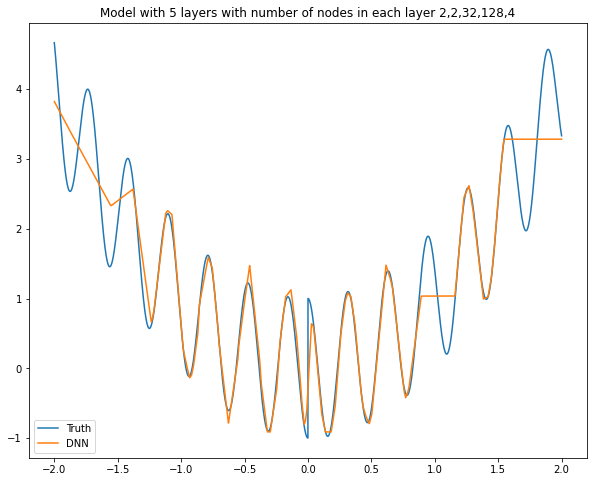

Model: "sequential_560"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3340 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3341 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3342 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3343 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3344 (Dense)           (None, 8)                 1032      
_________________________________________________________________
dense_3345 (Dense)           (None, 1)                 9         
Total params: 5,371
Trainable params: 5,371
Non-trainable params: 0
__________________________________________________

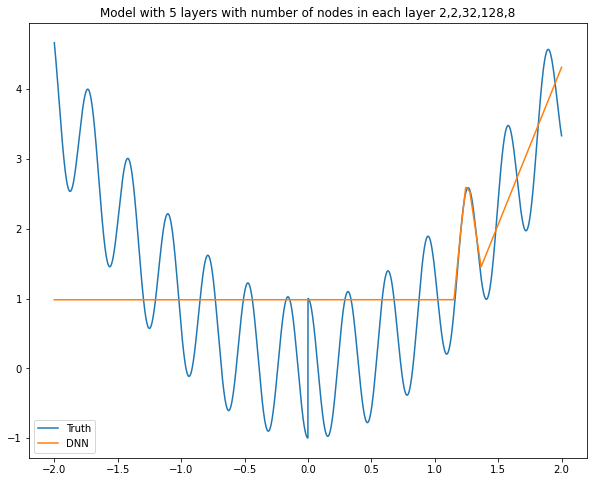

Model: "sequential_561"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3346 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3347 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3348 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3349 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3350 (Dense)           (None, 16)                2064      
_________________________________________________________________
dense_3351 (Dense)           (None, 1)                 17        
Total params: 6,411
Trainable params: 6,411
Non-trainable params: 0
__________________________________________________

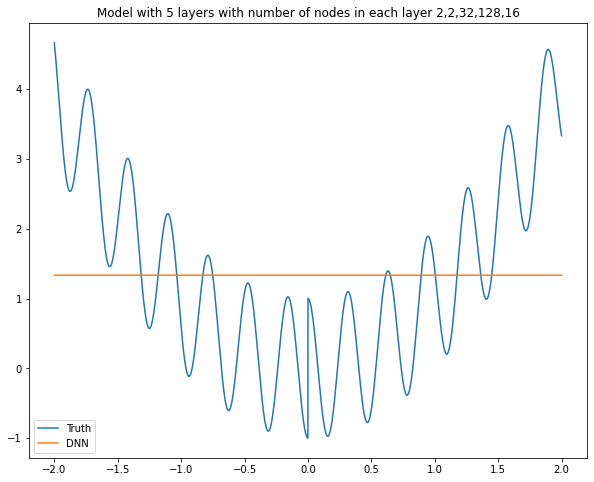

Model: "sequential_562"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3352 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3353 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3354 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3355 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3356 (Dense)           (None, 32)                4128      
_________________________________________________________________
dense_3357 (Dense)           (None, 1)                 33        
Total params: 8,491
Trainable params: 8,491
Non-trainable params: 0
__________________________________________________

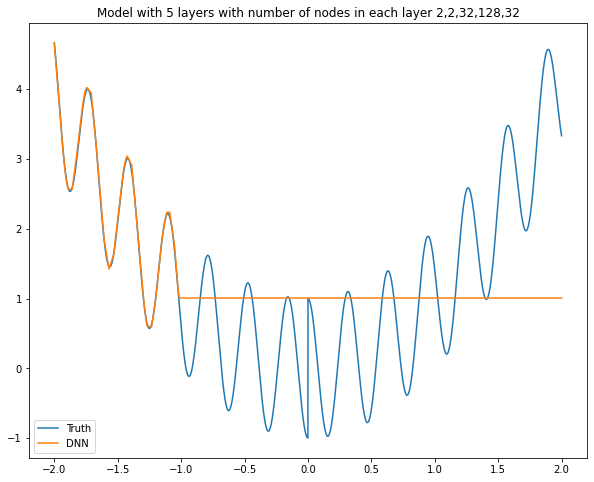

Model: "sequential_563"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3358 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3359 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3360 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3361 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3362 (Dense)           (None, 64)                8256      
_________________________________________________________________
dense_3363 (Dense)           (None, 1)                 65        
Total params: 12,651
Trainable params: 12,651
Non-trainable params: 0
________________________________________________

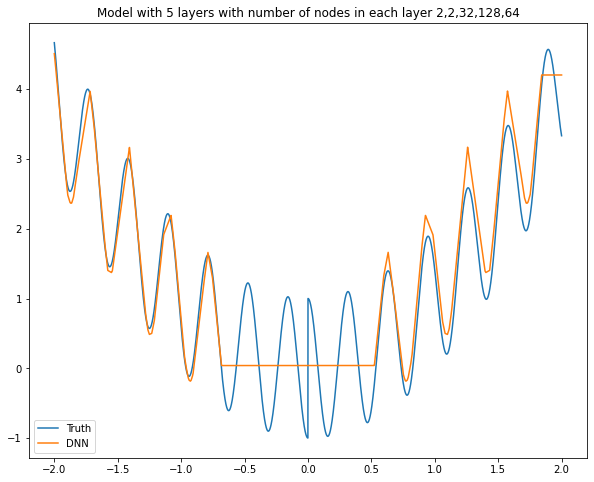

Model: "sequential_564"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3364 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3365 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3366 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3367 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3368 (Dense)           (None, 128)               16512     
_________________________________________________________________
dense_3369 (Dense)           (None, 1)                 129       
Total params: 20,971
Trainable params: 20,971
Non-trainable params: 0
________________________________________________

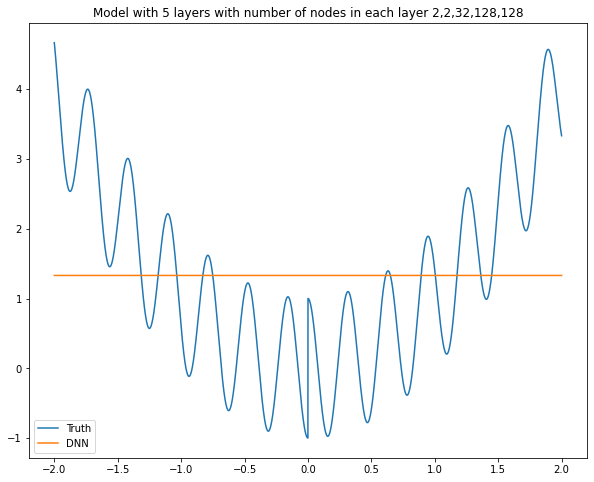

Model: "sequential_565"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3370 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3371 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3372 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3373 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3374 (Dense)           (None, 256)               33024     
_________________________________________________________________
dense_3375 (Dense)           (None, 1)                 257       
Total params: 37,611
Trainable params: 37,611
Non-trainable params: 0
________________________________________________

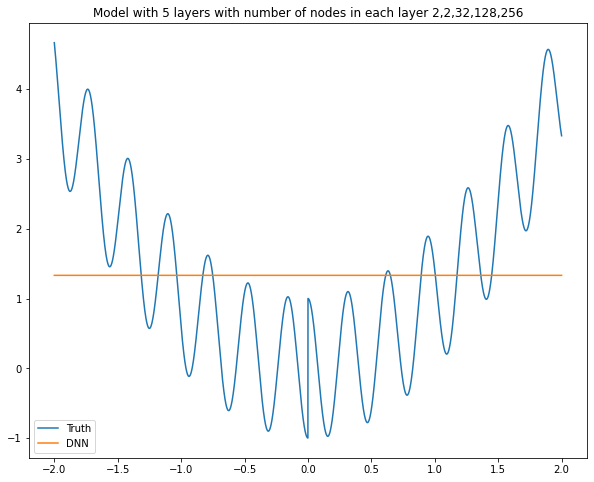

Model: "sequential_566"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3376 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3377 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3378 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3379 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3380 (Dense)           (None, 512)               66048     
_________________________________________________________________
dense_3381 (Dense)           (None, 1)                 513       
Total params: 70,891
Trainable params: 70,891
Non-trainable params: 0
________________________________________________

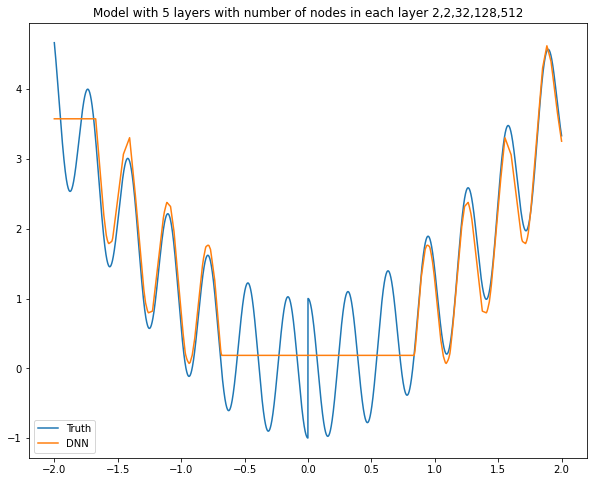

Model: "sequential_567"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3382 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3383 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3384 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3385 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3386 (Dense)           (None, 1024)              132096    
_________________________________________________________________
dense_3387 (Dense)           (None, 1)                 1025      
Total params: 137,451
Trainable params: 137,451
Non-trainable params: 0
______________________________________________

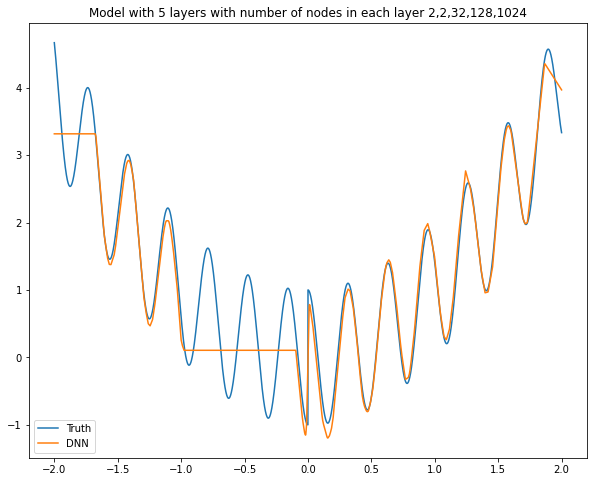

Model: "sequential_568"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3388 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3389 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3390 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3391 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3392 (Dense)           (None, 2048)              264192    
_________________________________________________________________
dense_3393 (Dense)           (None, 1)                 2049      
Total params: 270,571
Trainable params: 270,571
Non-trainable params: 0
______________________________________________

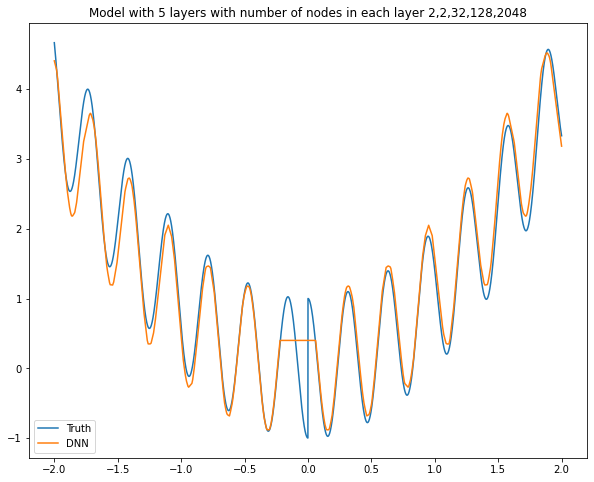

Model: "sequential_569"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3394 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3395 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3396 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3397 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3398 (Dense)           (None, 2)                 514       
_________________________________________________________________
dense_3399 (Dense)           (None, 1)                 3         
Total params: 9,071
Trainable params: 9,071
Non-trainable params: 0
__________________________________________________

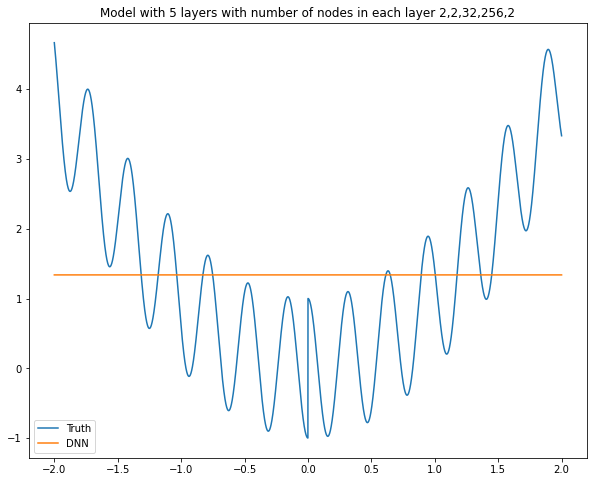

Model: "sequential_570"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3400 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3401 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3402 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3403 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3404 (Dense)           (None, 4)                 1028      
_________________________________________________________________
dense_3405 (Dense)           (None, 1)                 5         
Total params: 9,587
Trainable params: 9,587
Non-trainable params: 0
__________________________________________________

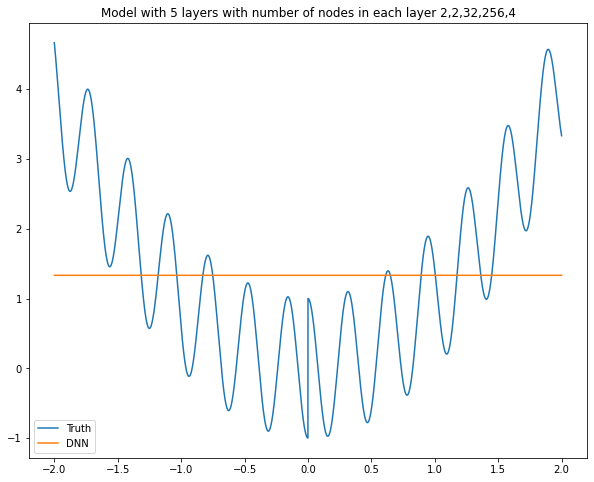

Model: "sequential_571"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3406 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3407 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3408 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3409 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3410 (Dense)           (None, 8)                 2056      
_________________________________________________________________
dense_3411 (Dense)           (None, 1)                 9         
Total params: 10,619
Trainable params: 10,619
Non-trainable params: 0
________________________________________________

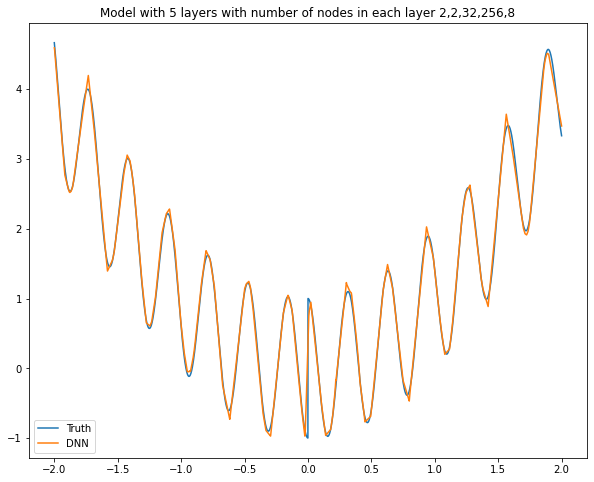

Model: "sequential_572"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3412 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3413 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3414 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3415 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3416 (Dense)           (None, 16)                4112      
_________________________________________________________________
dense_3417 (Dense)           (None, 1)                 17        
Total params: 12,683
Trainable params: 12,683
Non-trainable params: 0
________________________________________________

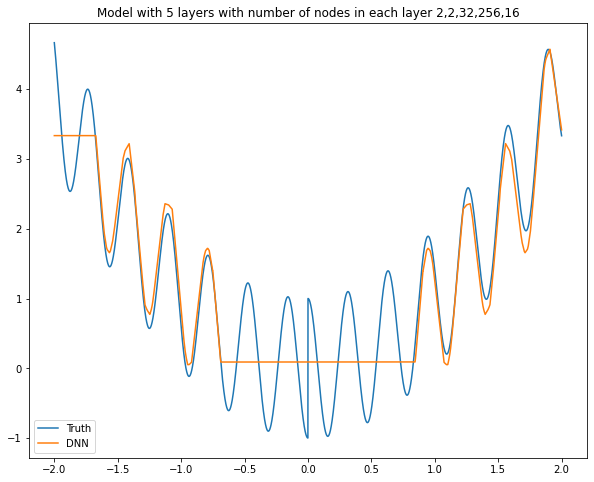

Model: "sequential_573"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3418 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3419 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3420 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3421 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3422 (Dense)           (None, 32)                8224      
_________________________________________________________________
dense_3423 (Dense)           (None, 1)                 33        
Total params: 16,811
Trainable params: 16,811
Non-trainable params: 0
________________________________________________

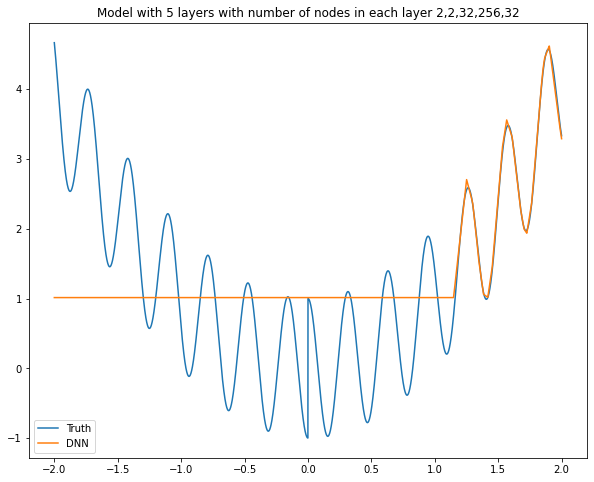

Model: "sequential_574"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3424 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3425 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3426 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3427 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3428 (Dense)           (None, 64)                16448     
_________________________________________________________________
dense_3429 (Dense)           (None, 1)                 65        
Total params: 25,067
Trainable params: 25,067
Non-trainable params: 0
________________________________________________

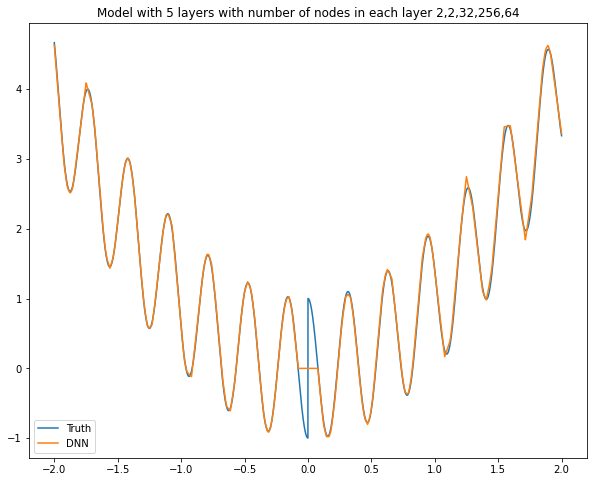

Model: "sequential_575"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3430 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3431 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3432 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3433 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3434 (Dense)           (None, 128)               32896     
_________________________________________________________________
dense_3435 (Dense)           (None, 1)                 129       
Total params: 41,579
Trainable params: 41,579
Non-trainable params: 0
________________________________________________

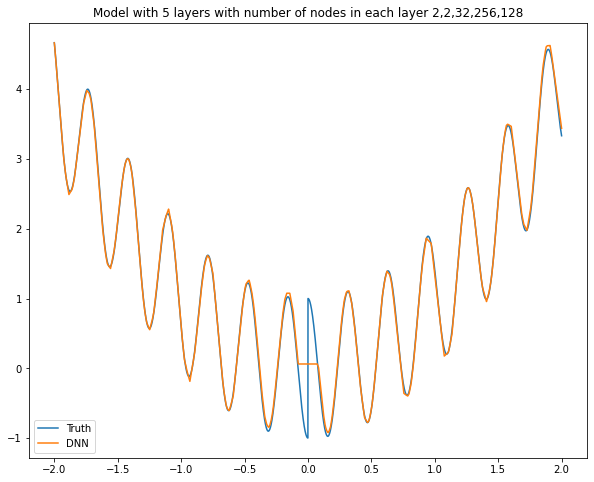

Model: "sequential_576"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3436 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3437 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3438 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3439 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3440 (Dense)           (None, 256)               65792     
_________________________________________________________________
dense_3441 (Dense)           (None, 1)                 257       
Total params: 74,603
Trainable params: 74,603
Non-trainable params: 0
________________________________________________

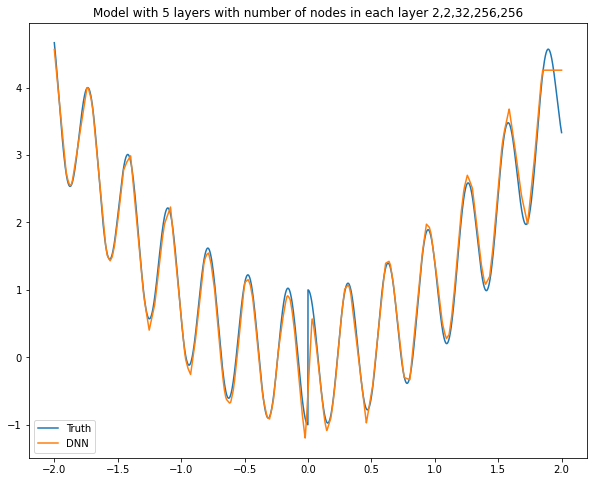

Model: "sequential_577"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3442 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3443 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3444 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3445 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3446 (Dense)           (None, 512)               131584    
_________________________________________________________________
dense_3447 (Dense)           (None, 1)                 513       
Total params: 140,651
Trainable params: 140,651
Non-trainable params: 0
______________________________________________

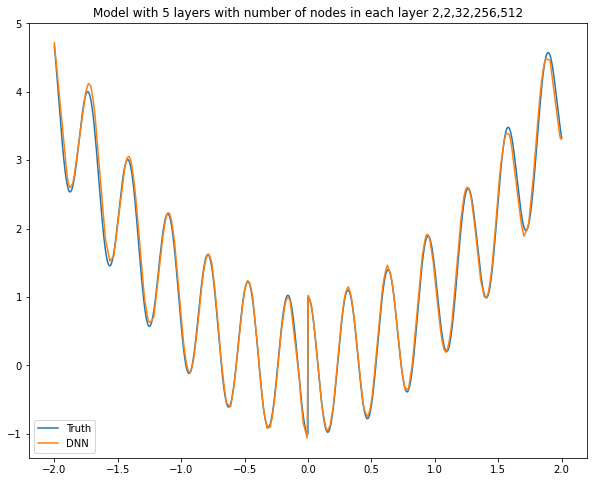

Model: "sequential_578"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3448 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3449 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3450 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3451 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3452 (Dense)           (None, 1024)              263168    
_________________________________________________________________
dense_3453 (Dense)           (None, 1)                 1025      
Total params: 272,747
Trainable params: 272,747
Non-trainable params: 0
______________________________________________

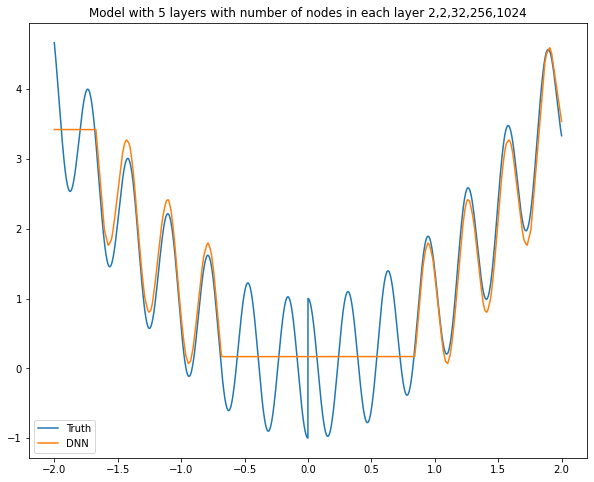

Model: "sequential_579"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3454 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3455 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3456 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3457 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3458 (Dense)           (None, 2048)              526336    
_________________________________________________________________
dense_3459 (Dense)           (None, 1)                 2049      
Total params: 536,939
Trainable params: 536,939
Non-trainable params: 0
______________________________________________

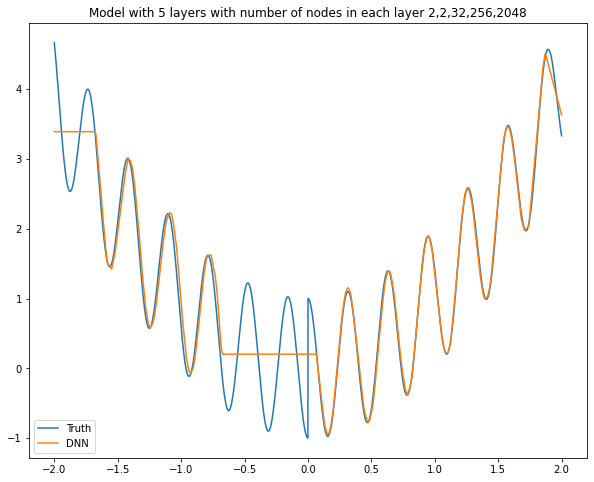

Model: "sequential_580"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3460 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3461 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3462 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3463 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3464 (Dense)           (None, 2)                 1026      
_________________________________________________________________
dense_3465 (Dense)           (None, 1)                 3         
Total params: 18,031
Trainable params: 18,031
Non-trainable params: 0
________________________________________________

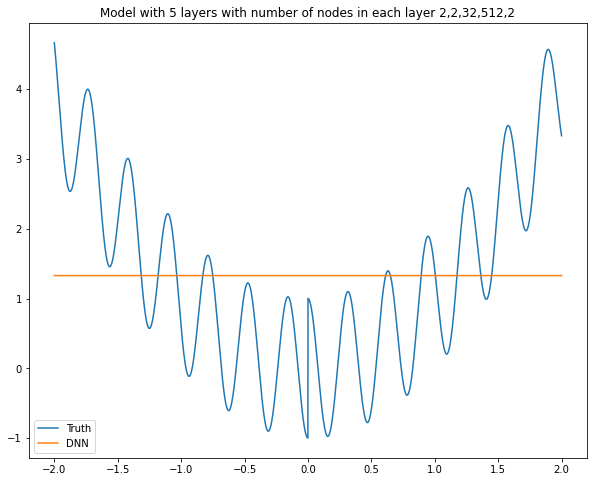

Model: "sequential_581"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3466 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3467 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3468 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3469 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3470 (Dense)           (None, 4)                 2052      
_________________________________________________________________
dense_3471 (Dense)           (None, 1)                 5         
Total params: 19,059
Trainable params: 19,059
Non-trainable params: 0
________________________________________________

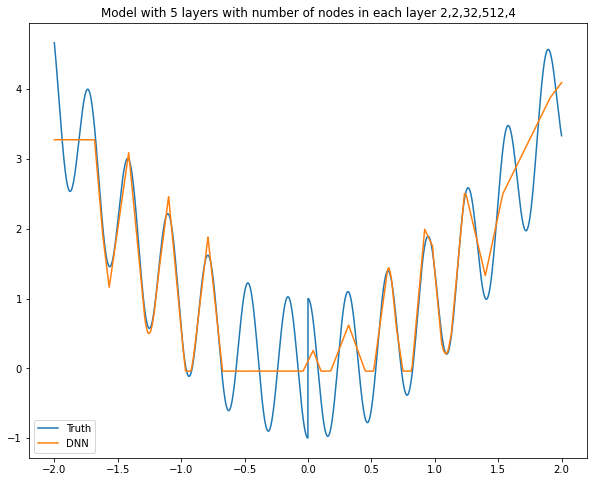

Model: "sequential_582"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3472 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3473 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3474 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3475 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3476 (Dense)           (None, 8)                 4104      
_________________________________________________________________
dense_3477 (Dense)           (None, 1)                 9         
Total params: 21,115
Trainable params: 21,115
Non-trainable params: 0
________________________________________________

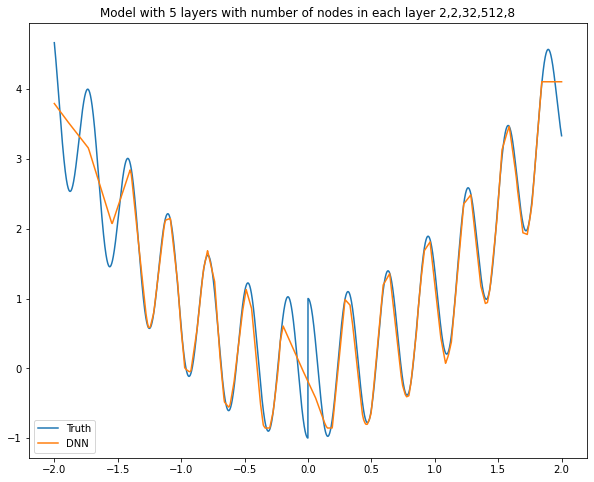

Model: "sequential_583"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3478 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3479 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3480 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3481 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3482 (Dense)           (None, 16)                8208      
_________________________________________________________________
dense_3483 (Dense)           (None, 1)                 17        
Total params: 25,227
Trainable params: 25,227
Non-trainable params: 0
________________________________________________

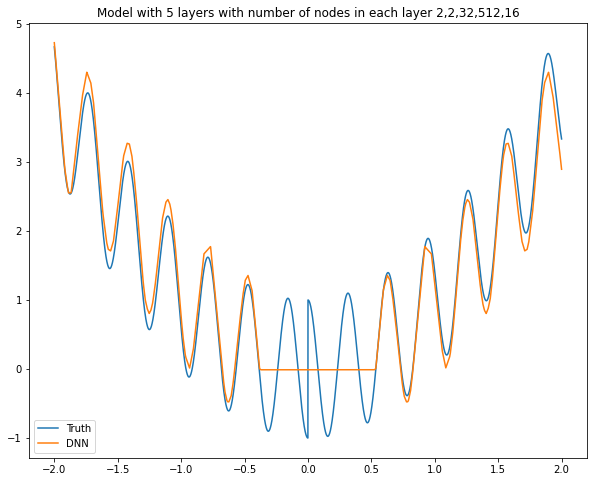

Model: "sequential_584"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3484 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3485 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3486 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3487 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3488 (Dense)           (None, 32)                16416     
_________________________________________________________________
dense_3489 (Dense)           (None, 1)                 33        
Total params: 33,451
Trainable params: 33,451
Non-trainable params: 0
________________________________________________

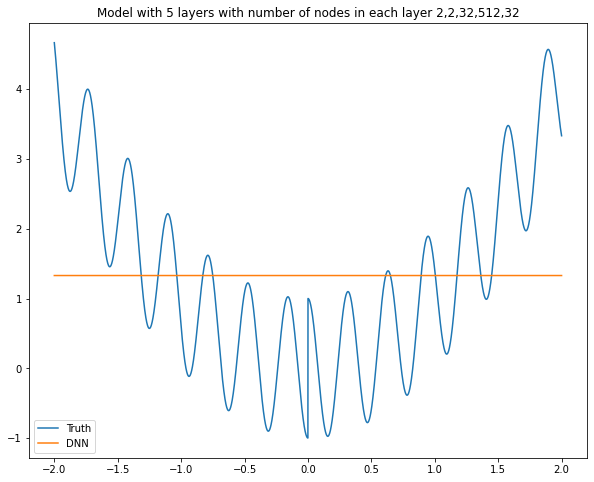

Model: "sequential_585"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3490 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3491 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3492 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3493 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3494 (Dense)           (None, 64)                32832     
_________________________________________________________________
dense_3495 (Dense)           (None, 1)                 65        
Total params: 49,899
Trainable params: 49,899
Non-trainable params: 0
________________________________________________

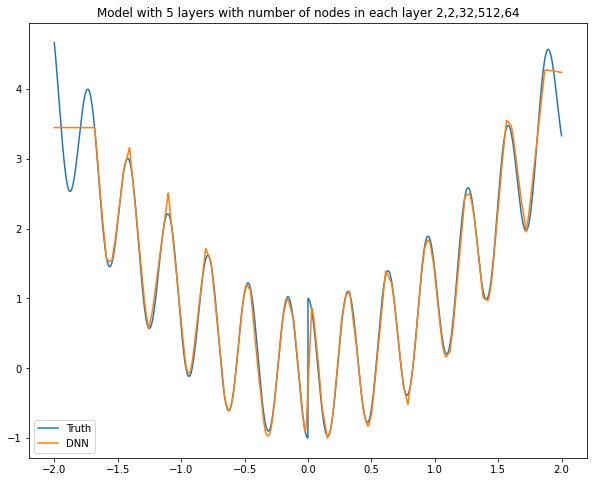

Model: "sequential_586"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3496 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3497 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3498 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3499 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3500 (Dense)           (None, 128)               65664     
_________________________________________________________________
dense_3501 (Dense)           (None, 1)                 129       
Total params: 82,795
Trainable params: 82,795
Non-trainable params: 0
________________________________________________

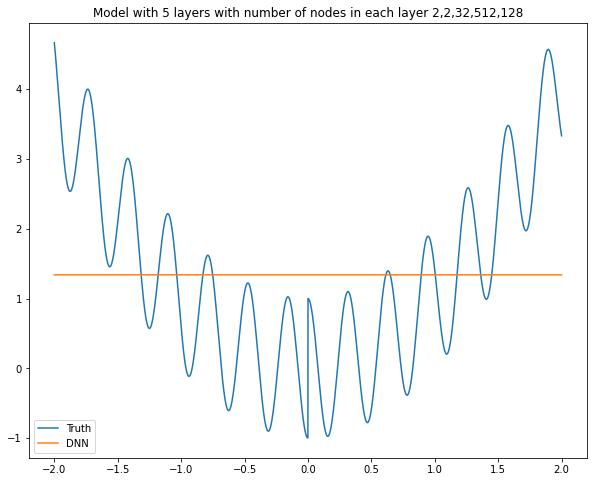

Model: "sequential_587"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3502 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3503 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3504 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3505 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3506 (Dense)           (None, 256)               131328    
_________________________________________________________________
dense_3507 (Dense)           (None, 1)                 257       
Total params: 148,587
Trainable params: 148,587
Non-trainable params: 0
______________________________________________

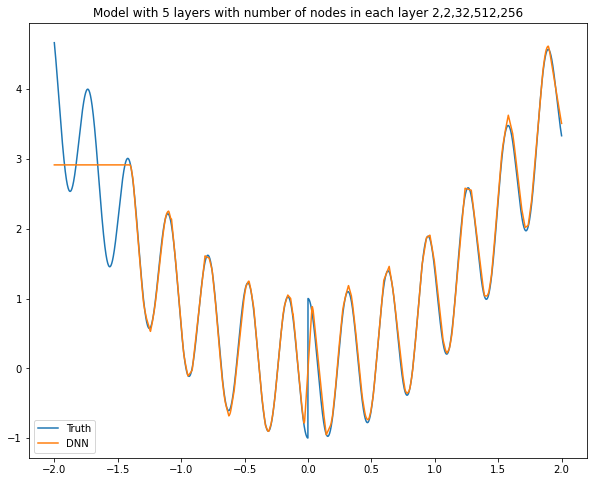

Model: "sequential_588"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3508 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3509 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3510 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3511 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3512 (Dense)           (None, 512)               262656    
_________________________________________________________________
dense_3513 (Dense)           (None, 1)                 513       
Total params: 280,171
Trainable params: 280,171
Non-trainable params: 0
______________________________________________

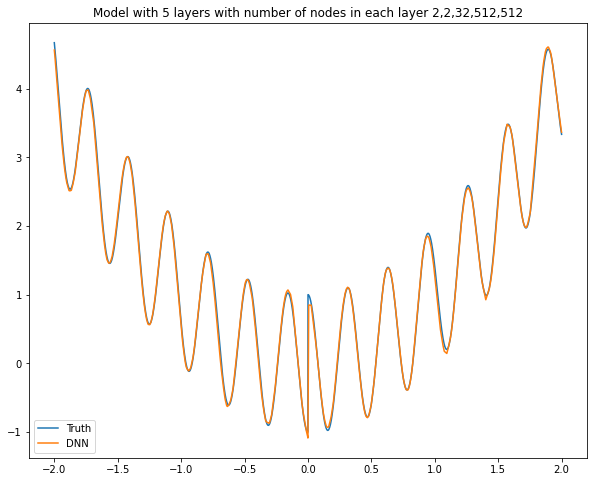

Model: "sequential_589"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3514 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3515 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3516 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3517 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3518 (Dense)           (None, 1024)              525312    
_________________________________________________________________
dense_3519 (Dense)           (None, 1)                 1025      
Total params: 543,339
Trainable params: 543,339
Non-trainable params: 0
______________________________________________

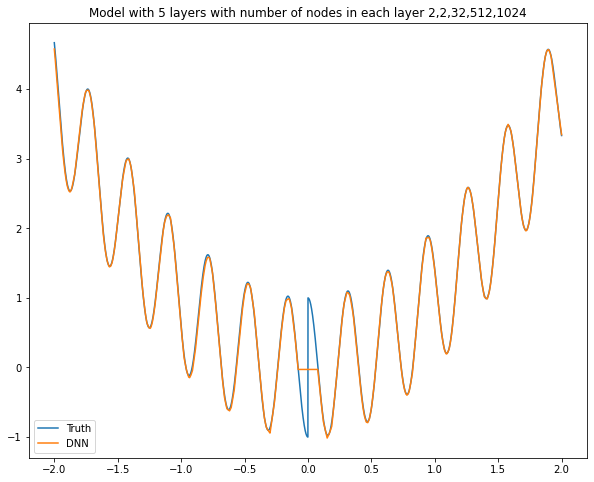

Model: "sequential_590"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3520 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3521 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3522 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3523 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3524 (Dense)           (None, 2048)              1050624   
_________________________________________________________________
dense_3525 (Dense)           (None, 1)                 2049      
Total params: 1,069,675
Trainable params: 1,069,675
Non-trainable params: 0
__________________________________________

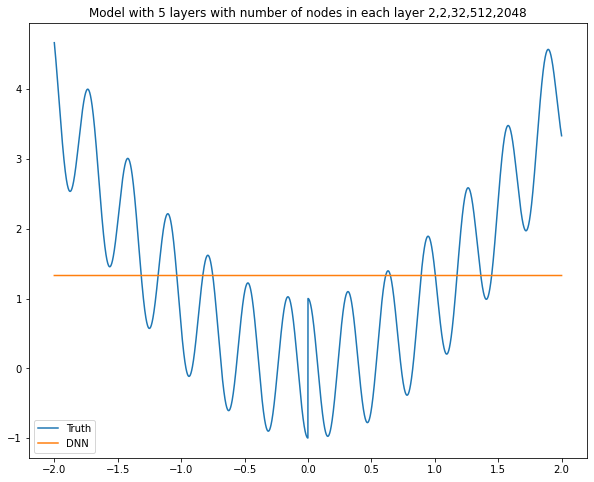

Model: "sequential_591"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3526 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3527 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3528 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3529 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3530 (Dense)           (None, 2)                 2050      
_________________________________________________________________
dense_3531 (Dense)           (None, 1)                 3         
Total params: 35,951
Trainable params: 35,951
Non-trainable params: 0
________________________________________________

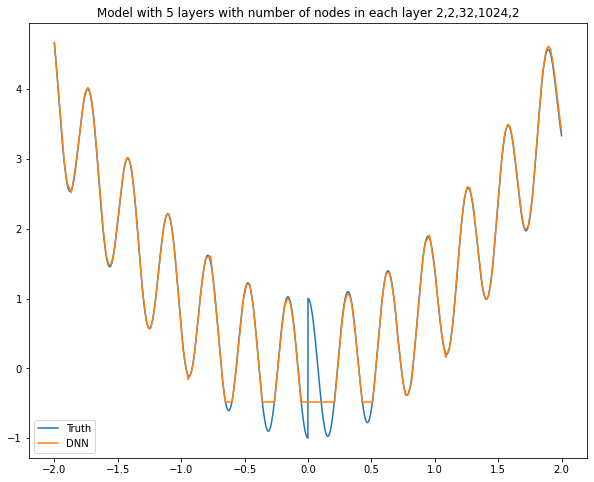

Model: "sequential_592"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3532 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3533 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3534 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3535 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3536 (Dense)           (None, 4)                 4100      
_________________________________________________________________
dense_3537 (Dense)           (None, 1)                 5         
Total params: 38,003
Trainable params: 38,003
Non-trainable params: 0
________________________________________________

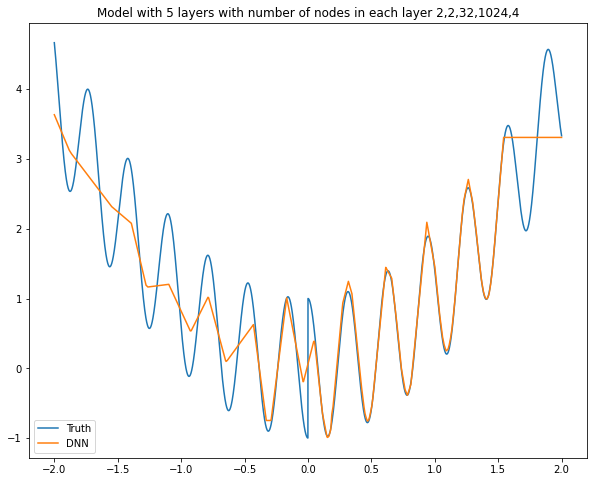

Model: "sequential_593"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3538 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3539 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3540 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3541 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3542 (Dense)           (None, 8)                 8200      
_________________________________________________________________
dense_3543 (Dense)           (None, 1)                 9         
Total params: 42,107
Trainable params: 42,107
Non-trainable params: 0
________________________________________________

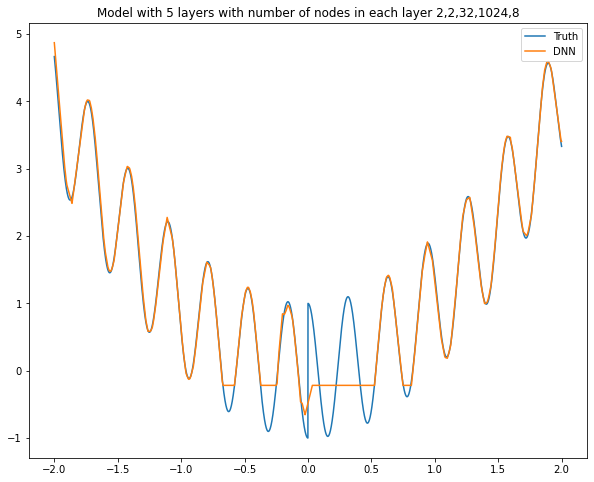

Model: "sequential_594"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3544 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3545 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3546 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3547 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3548 (Dense)           (None, 16)                16400     
_________________________________________________________________
dense_3549 (Dense)           (None, 1)                 17        
Total params: 50,315
Trainable params: 50,315
Non-trainable params: 0
________________________________________________

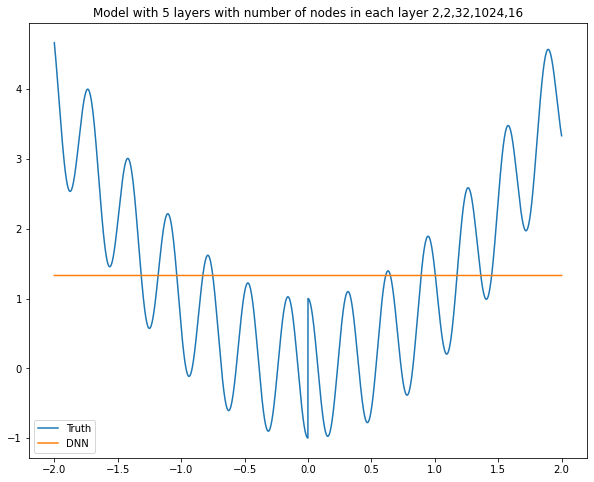

Model: "sequential_595"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3550 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3551 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3552 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3553 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3554 (Dense)           (None, 32)                32800     
_________________________________________________________________
dense_3555 (Dense)           (None, 1)                 33        
Total params: 66,731
Trainable params: 66,731
Non-trainable params: 0
________________________________________________

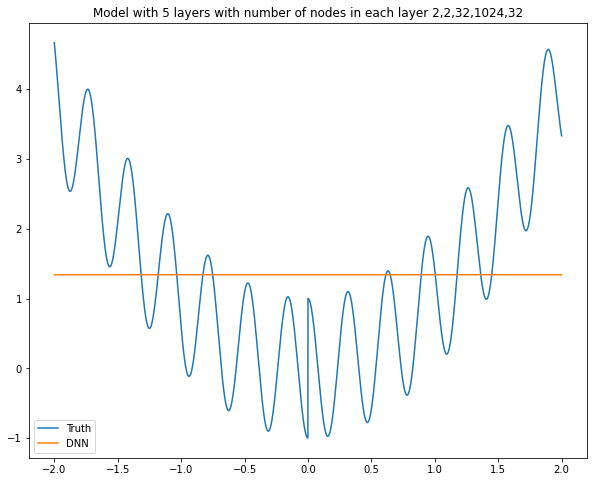

Model: "sequential_596"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3556 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3557 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3558 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3559 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3560 (Dense)           (None, 64)                65600     
_________________________________________________________________
dense_3561 (Dense)           (None, 1)                 65        
Total params: 99,563
Trainable params: 99,563
Non-trainable params: 0
________________________________________________

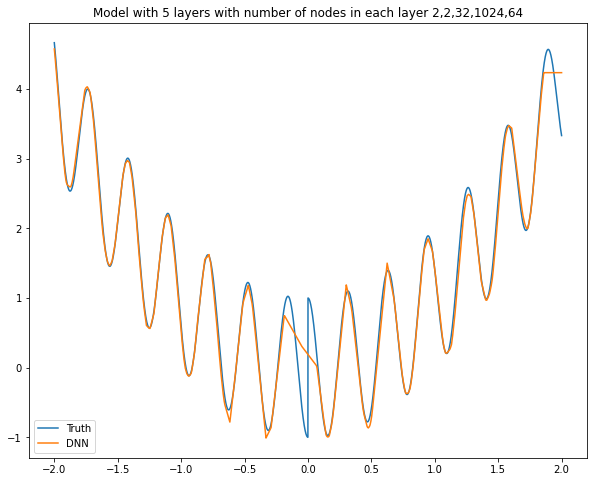

Model: "sequential_597"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3562 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3563 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3564 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3565 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3566 (Dense)           (None, 128)               131200    
_________________________________________________________________
dense_3567 (Dense)           (None, 1)                 129       
Total params: 165,227
Trainable params: 165,227
Non-trainable params: 0
______________________________________________

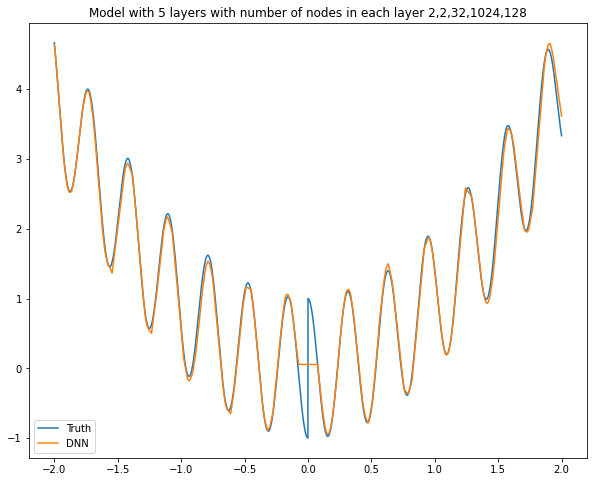

Model: "sequential_598"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3568 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3569 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3570 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3571 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3572 (Dense)           (None, 256)               262400    
_________________________________________________________________
dense_3573 (Dense)           (None, 1)                 257       
Total params: 296,555
Trainable params: 296,555
Non-trainable params: 0
______________________________________________

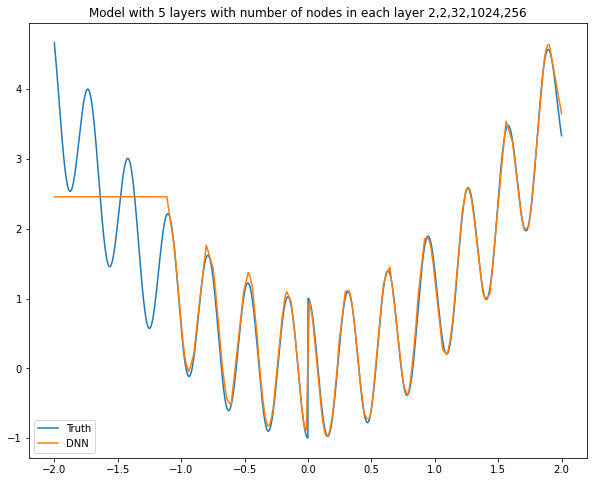

Model: "sequential_599"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3574 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3575 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3576 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3577 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3578 (Dense)           (None, 512)               524800    
_________________________________________________________________
dense_3579 (Dense)           (None, 1)                 513       
Total params: 559,211
Trainable params: 559,211
Non-trainable params: 0
______________________________________________

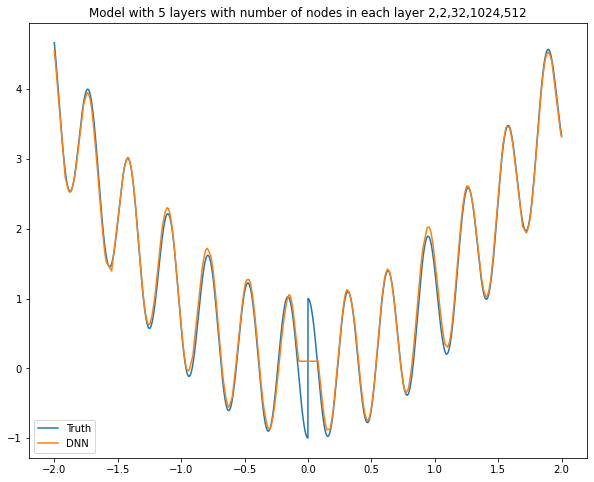

Model: "sequential_600"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3580 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3581 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3582 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3583 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3584 (Dense)           (None, 1024)              1049600   
_________________________________________________________________
dense_3585 (Dense)           (None, 1)                 1025      
Total params: 1,084,523
Trainable params: 1,084,523
Non-trainable params: 0
__________________________________________

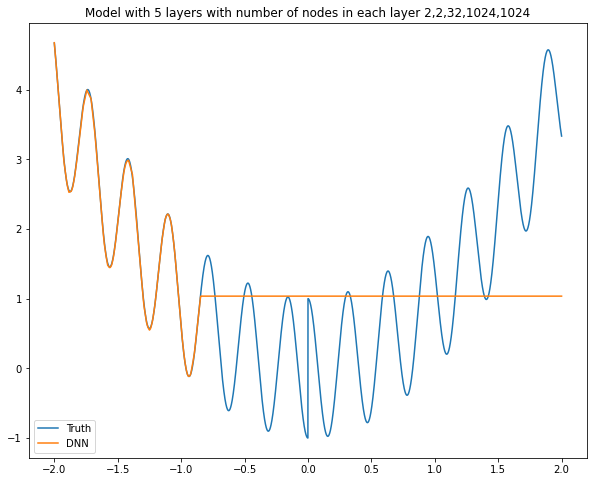

Model: "sequential_601"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3586 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3587 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3588 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3589 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3590 (Dense)           (None, 2048)              2099200   
_________________________________________________________________
dense_3591 (Dense)           (None, 1)                 2049      
Total params: 2,135,147
Trainable params: 2,135,147
Non-trainable params: 0
__________________________________________

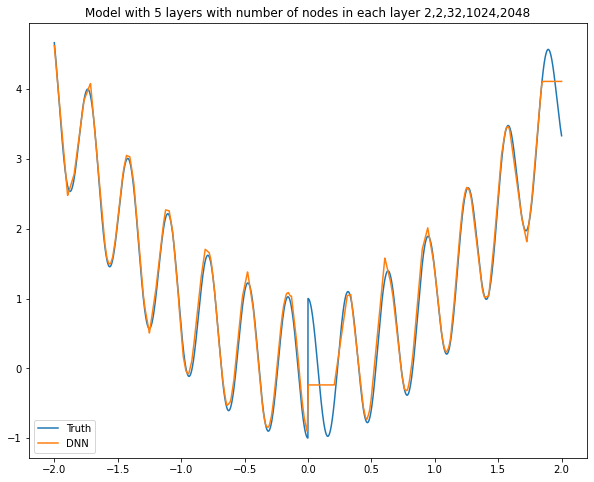

Model: "sequential_602"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3592 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3593 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3594 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3595 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3596 (Dense)           (None, 2)                 4098      
_________________________________________________________________
dense_3597 (Dense)           (None, 1)                 3         
Total params: 71,791
Trainable params: 71,791
Non-trainable params: 0
________________________________________________

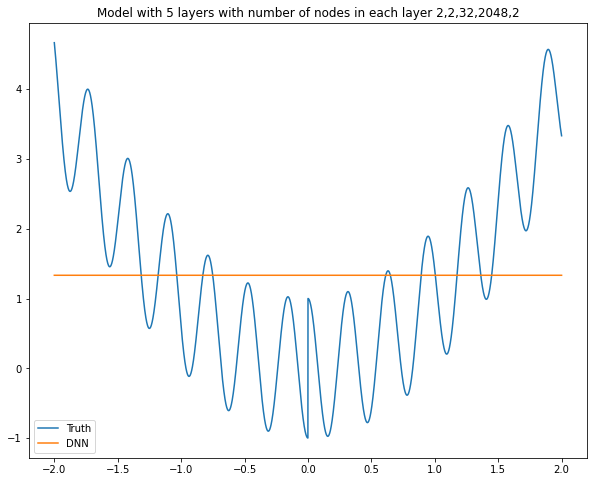

Model: "sequential_603"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3598 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3599 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3600 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3601 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3602 (Dense)           (None, 4)                 8196      
_________________________________________________________________
dense_3603 (Dense)           (None, 1)                 5         
Total params: 75,891
Trainable params: 75,891
Non-trainable params: 0
________________________________________________

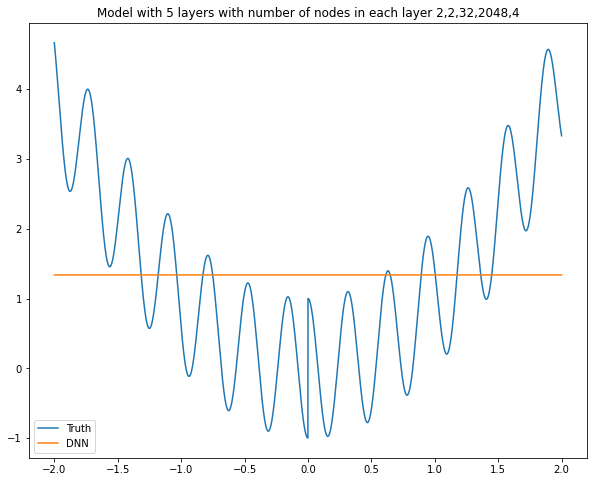

Model: "sequential_604"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3604 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3605 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3606 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3607 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3608 (Dense)           (None, 8)                 16392     
_________________________________________________________________
dense_3609 (Dense)           (None, 1)                 9         
Total params: 84,091
Trainable params: 84,091
Non-trainable params: 0
________________________________________________

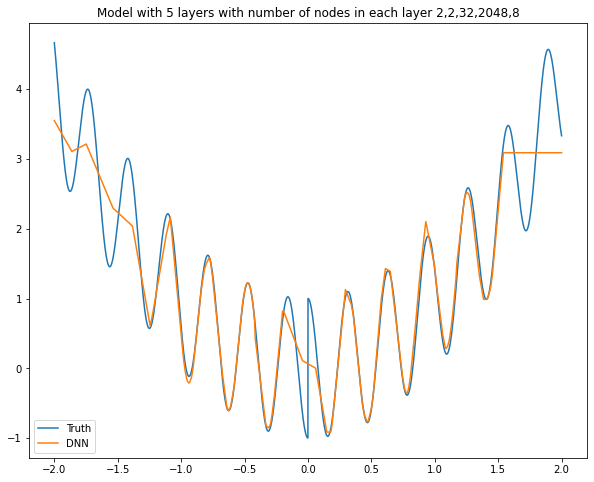

Model: "sequential_605"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3610 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3611 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3612 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3613 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3614 (Dense)           (None, 16)                32784     
_________________________________________________________________
dense_3615 (Dense)           (None, 1)                 17        
Total params: 100,491
Trainable params: 100,491
Non-trainable params: 0
______________________________________________

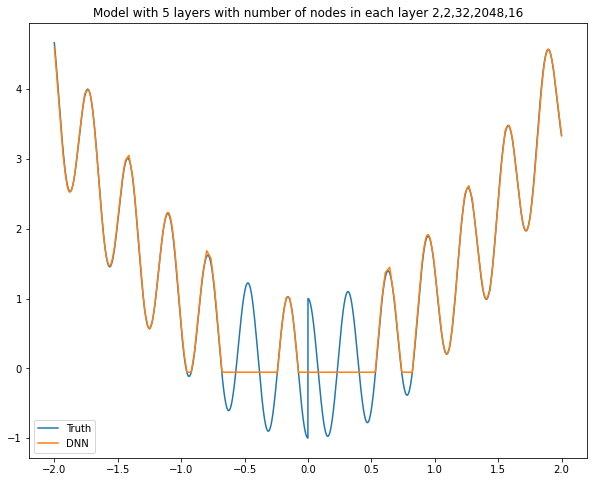

Model: "sequential_606"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3616 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3617 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3618 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3619 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3620 (Dense)           (None, 32)                65568     
_________________________________________________________________
dense_3621 (Dense)           (None, 1)                 33        
Total params: 133,291
Trainable params: 133,291
Non-trainable params: 0
______________________________________________

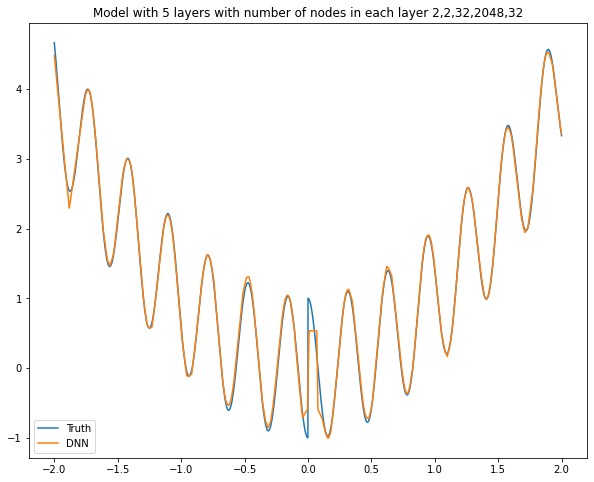

Model: "sequential_607"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3622 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3623 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3624 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3625 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3626 (Dense)           (None, 64)                131136    
_________________________________________________________________
dense_3627 (Dense)           (None, 1)                 65        
Total params: 198,891
Trainable params: 198,891
Non-trainable params: 0
______________________________________________

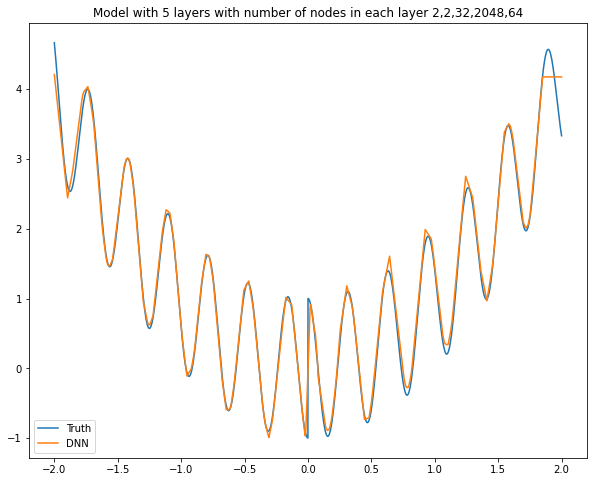

Model: "sequential_608"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3628 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3629 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3630 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3631 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3632 (Dense)           (None, 128)               262272    
_________________________________________________________________
dense_3633 (Dense)           (None, 1)                 129       
Total params: 330,091
Trainable params: 330,091
Non-trainable params: 0
______________________________________________

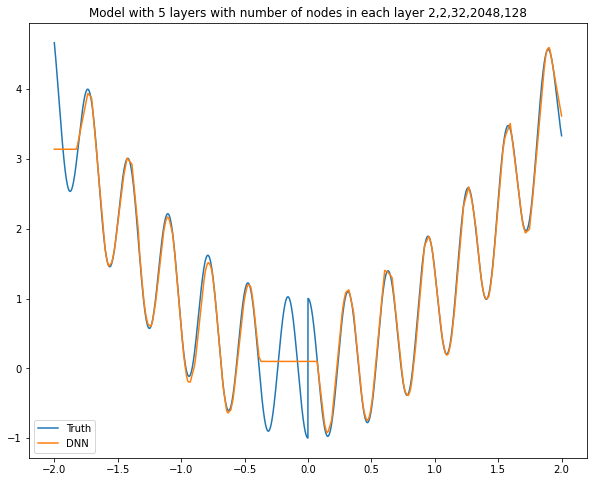

Model: "sequential_609"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3634 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3635 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3636 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3637 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3638 (Dense)           (None, 256)               524544    
_________________________________________________________________
dense_3639 (Dense)           (None, 1)                 257       
Total params: 592,491
Trainable params: 592,491
Non-trainable params: 0
______________________________________________

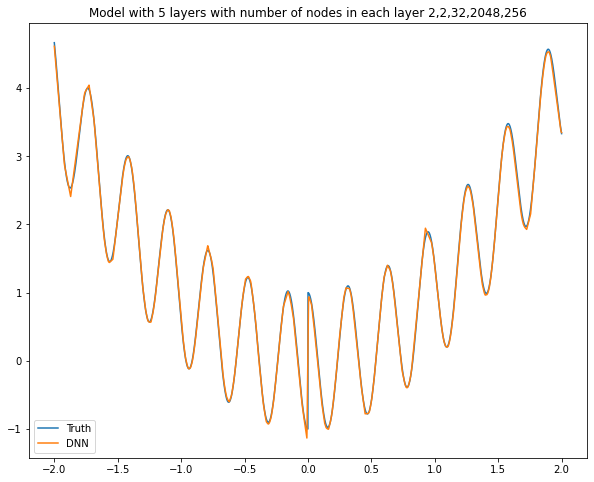

Model: "sequential_610"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3640 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3641 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3642 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3643 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3644 (Dense)           (None, 512)               1049088   
_________________________________________________________________
dense_3645 (Dense)           (None, 1)                 513       
Total params: 1,117,291
Trainable params: 1,117,291
Non-trainable params: 0
__________________________________________

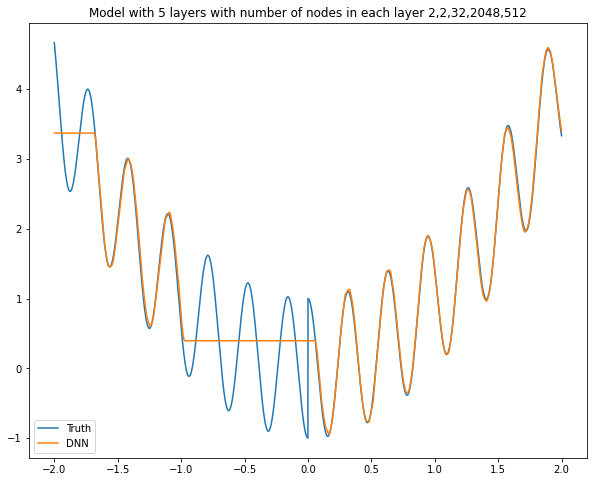

Model: "sequential_611"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3646 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3647 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3648 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3649 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3650 (Dense)           (None, 1024)              2098176   
_________________________________________________________________
dense_3651 (Dense)           (None, 1)                 1025      
Total params: 2,166,891
Trainable params: 2,166,891
Non-trainable params: 0
__________________________________________

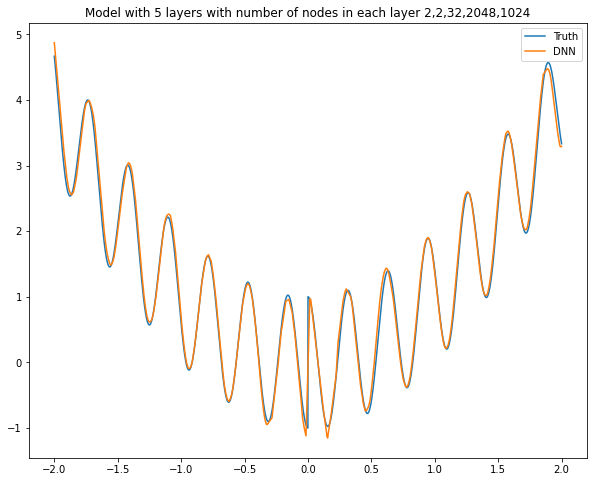

Model: "sequential_612"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3652 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3653 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3654 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3655 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3656 (Dense)           (None, 2048)              4196352   
_________________________________________________________________
dense_3657 (Dense)           (None, 1)                 2049      
Total params: 4,266,091
Trainable params: 4,266,091
Non-trainable params: 0
__________________________________________

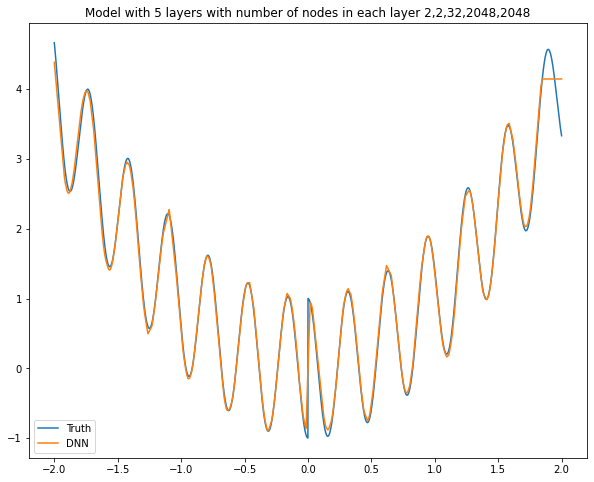

Model: "sequential_613"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3658 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3659 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3660 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3661 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3662 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3663 (Dense)           (None, 1)                 3         
Total params: 341
Trainable params: 341
Non-trainable params: 0
______________________________________________________

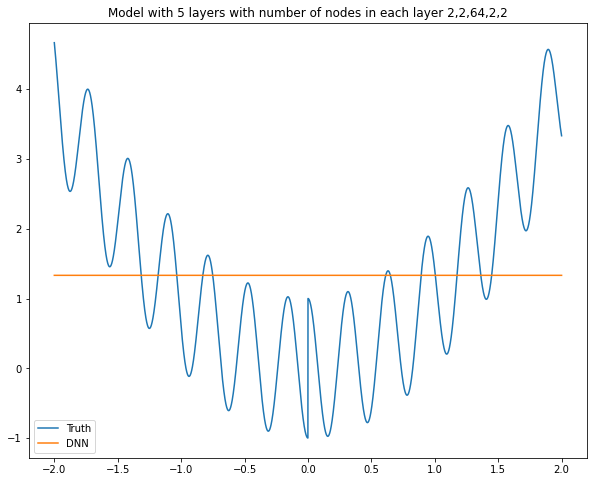

Model: "sequential_614"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3664 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3665 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3666 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3667 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3668 (Dense)           (None, 4)                 12        
_________________________________________________________________
dense_3669 (Dense)           (None, 1)                 5         
Total params: 349
Trainable params: 349
Non-trainable params: 0
______________________________________________________

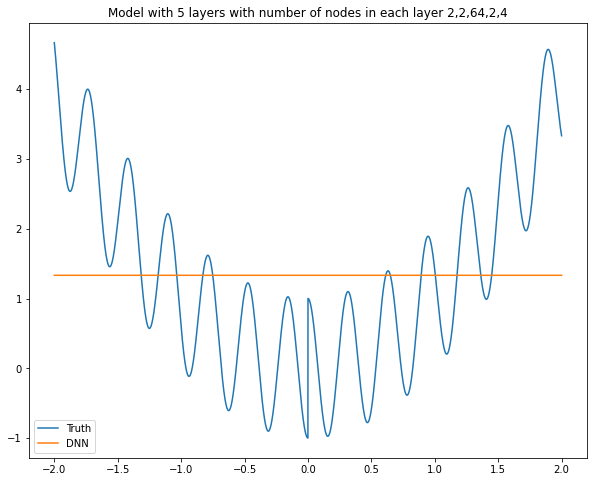

Model: "sequential_615"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3670 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3671 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3672 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3673 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3674 (Dense)           (None, 8)                 24        
_________________________________________________________________
dense_3675 (Dense)           (None, 1)                 9         
Total params: 365
Trainable params: 365
Non-trainable params: 0
______________________________________________________

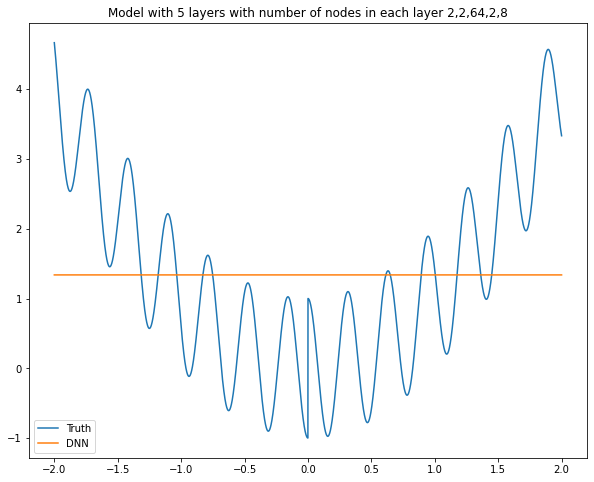

Model: "sequential_616"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3676 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3677 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3678 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3679 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3680 (Dense)           (None, 16)                48        
_________________________________________________________________
dense_3681 (Dense)           (None, 1)                 17        
Total params: 397
Trainable params: 397
Non-trainable params: 0
______________________________________________________

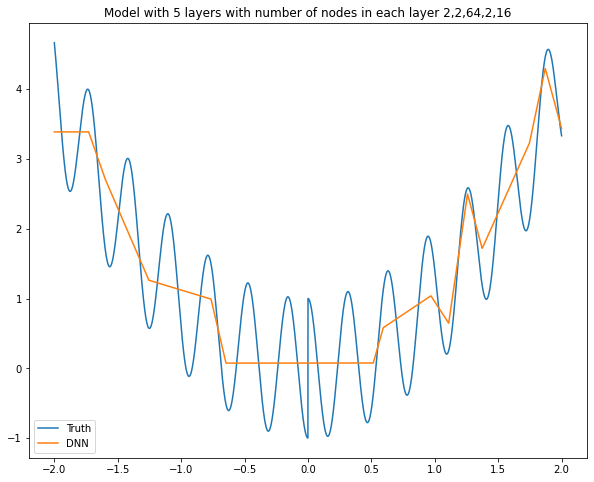

Model: "sequential_617"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3682 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3683 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3684 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3685 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3686 (Dense)           (None, 32)                96        
_________________________________________________________________
dense_3687 (Dense)           (None, 1)                 33        
Total params: 461
Trainable params: 461
Non-trainable params: 0
______________________________________________________

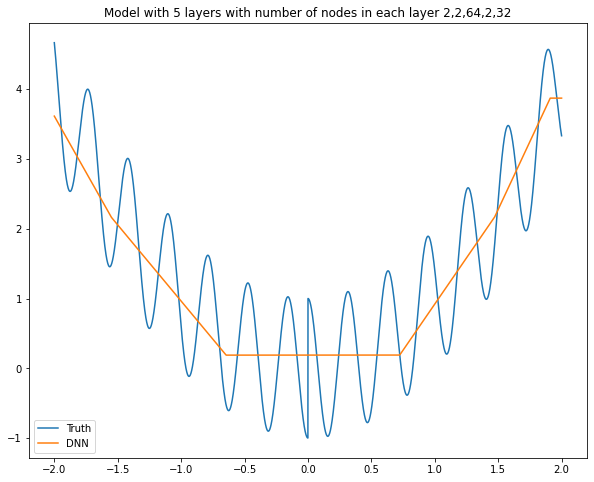

Model: "sequential_618"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3688 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3689 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3690 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3691 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3692 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3693 (Dense)           (None, 1)                 65        
Total params: 589
Trainable params: 589
Non-trainable params: 0
______________________________________________________

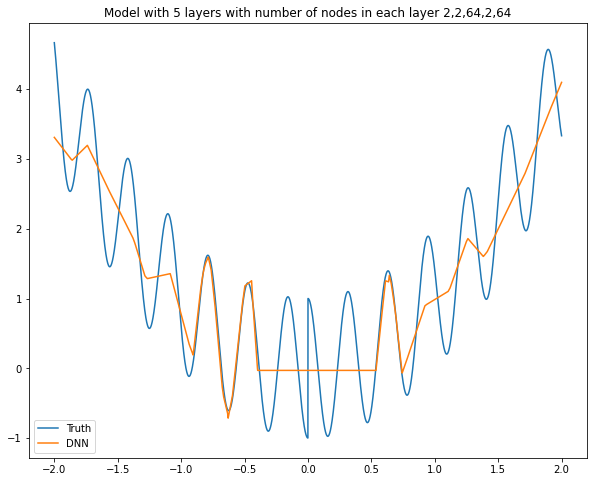

Model: "sequential_619"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3694 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3695 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3696 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3697 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3698 (Dense)           (None, 128)               384       
_________________________________________________________________
dense_3699 (Dense)           (None, 1)                 129       
Total params: 845
Trainable params: 845
Non-trainable params: 0
______________________________________________________

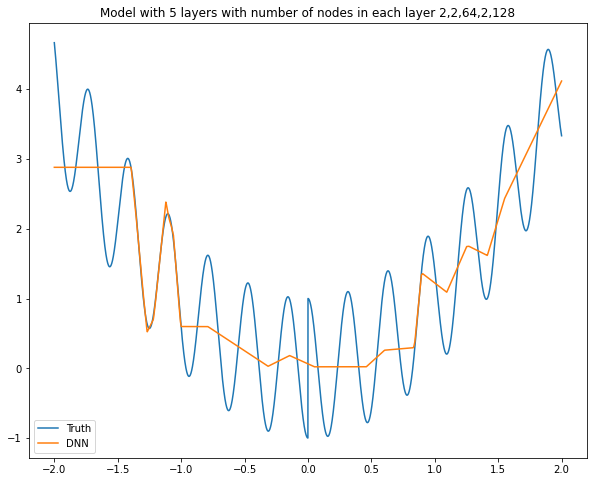

Model: "sequential_620"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3700 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3701 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3702 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3703 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3704 (Dense)           (None, 256)               768       
_________________________________________________________________
dense_3705 (Dense)           (None, 1)                 257       
Total params: 1,357
Trainable params: 1,357
Non-trainable params: 0
__________________________________________________

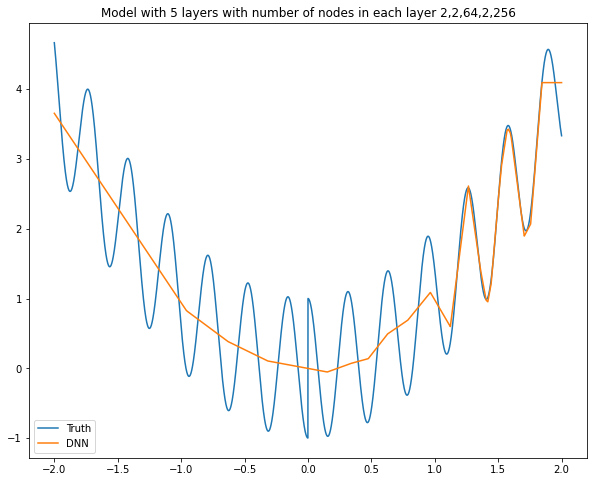

Model: "sequential_621"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3706 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3707 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3708 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3709 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3710 (Dense)           (None, 512)               1536      
_________________________________________________________________
dense_3711 (Dense)           (None, 1)                 513       
Total params: 2,381
Trainable params: 2,381
Non-trainable params: 0
__________________________________________________

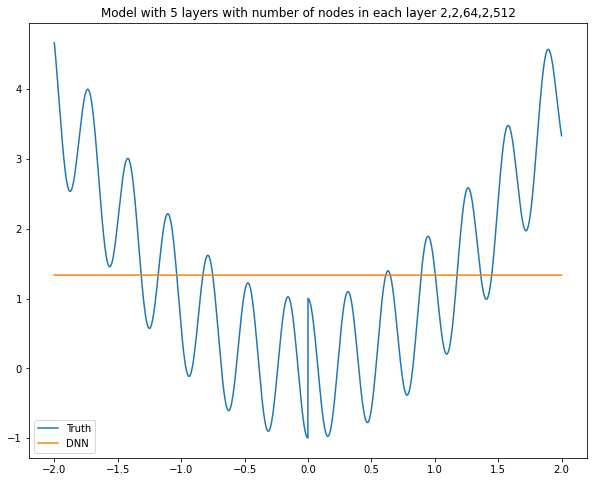

Model: "sequential_622"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3712 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3713 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3714 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3715 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3716 (Dense)           (None, 1024)              3072      
_________________________________________________________________
dense_3717 (Dense)           (None, 1)                 1025      
Total params: 4,429
Trainable params: 4,429
Non-trainable params: 0
__________________________________________________

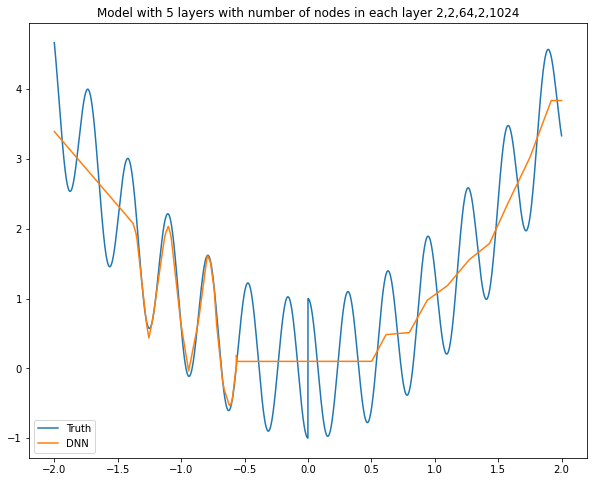

Model: "sequential_623"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3718 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3719 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3720 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3721 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3722 (Dense)           (None, 2048)              6144      
_________________________________________________________________
dense_3723 (Dense)           (None, 1)                 2049      
Total params: 8,525
Trainable params: 8,525
Non-trainable params: 0
__________________________________________________

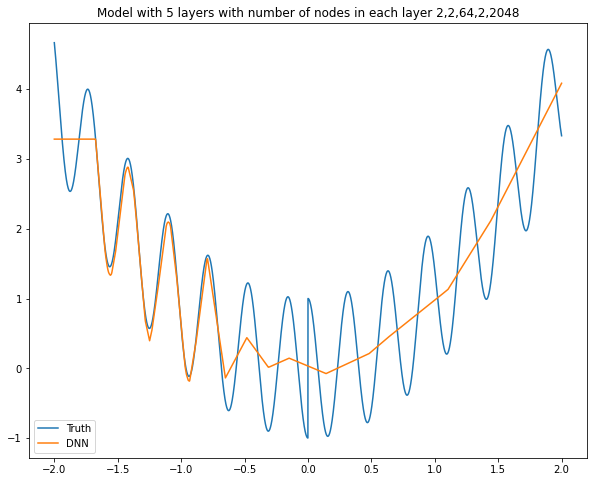

Model: "sequential_624"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3724 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3725 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3726 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3727 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3728 (Dense)           (None, 2)                 10        
_________________________________________________________________
dense_3729 (Dense)           (None, 1)                 3         
Total params: 475
Trainable params: 475
Non-trainable params: 0
______________________________________________________

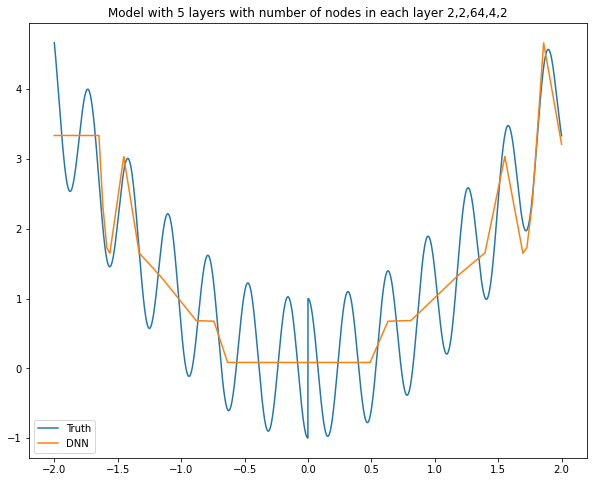

Model: "sequential_625"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3730 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3731 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3732 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3733 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3734 (Dense)           (None, 4)                 20        
_________________________________________________________________
dense_3735 (Dense)           (None, 1)                 5         
Total params: 487
Trainable params: 487
Non-trainable params: 0
______________________________________________________

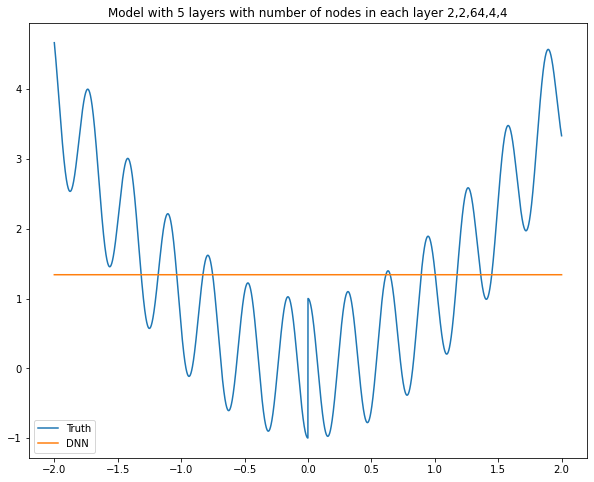

Model: "sequential_626"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3736 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3737 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3738 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3739 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3740 (Dense)           (None, 8)                 40        
_________________________________________________________________
dense_3741 (Dense)           (None, 1)                 9         
Total params: 511
Trainable params: 511
Non-trainable params: 0
______________________________________________________

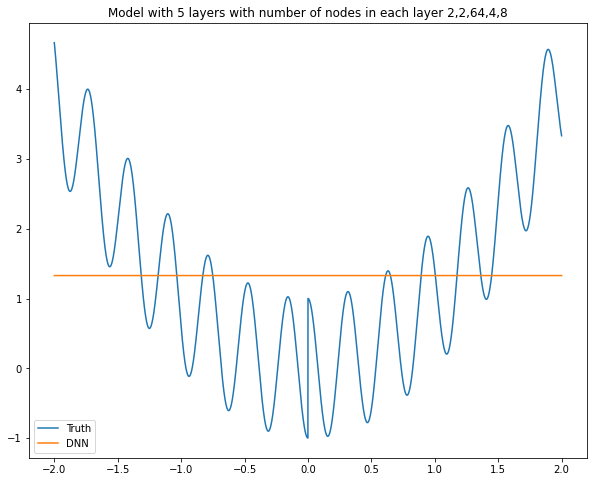

Model: "sequential_627"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3742 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3743 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3744 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3745 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3746 (Dense)           (None, 16)                80        
_________________________________________________________________
dense_3747 (Dense)           (None, 1)                 17        
Total params: 559
Trainable params: 559
Non-trainable params: 0
______________________________________________________

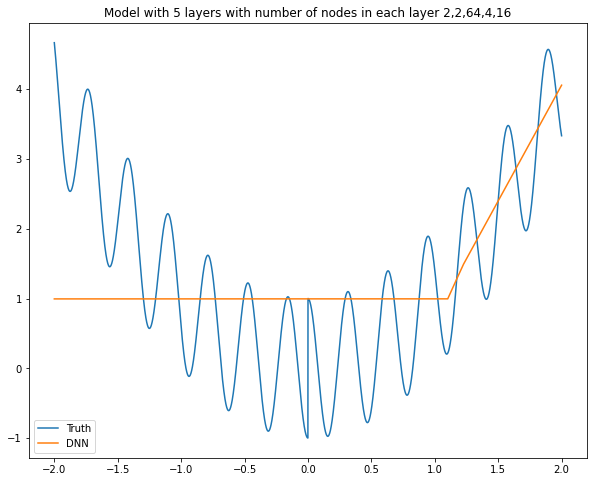

Model: "sequential_628"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3748 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3749 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3750 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3751 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3752 (Dense)           (None, 32)                160       
_________________________________________________________________
dense_3753 (Dense)           (None, 1)                 33        
Total params: 655
Trainable params: 655
Non-trainable params: 0
______________________________________________________

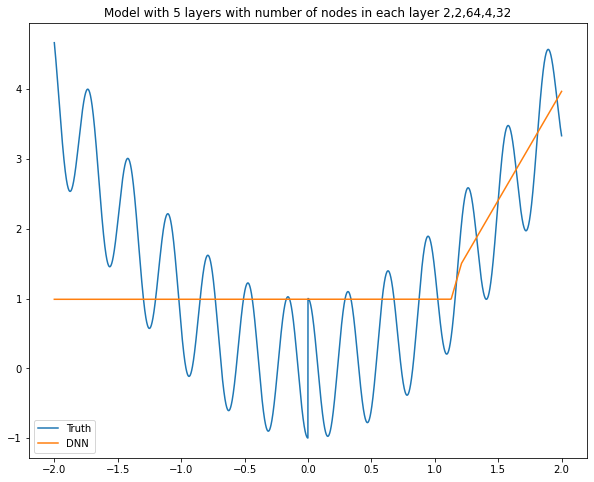

Model: "sequential_629"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3754 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3755 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3756 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3757 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3758 (Dense)           (None, 64)                320       
_________________________________________________________________
dense_3759 (Dense)           (None, 1)                 65        
Total params: 847
Trainable params: 847
Non-trainable params: 0
______________________________________________________

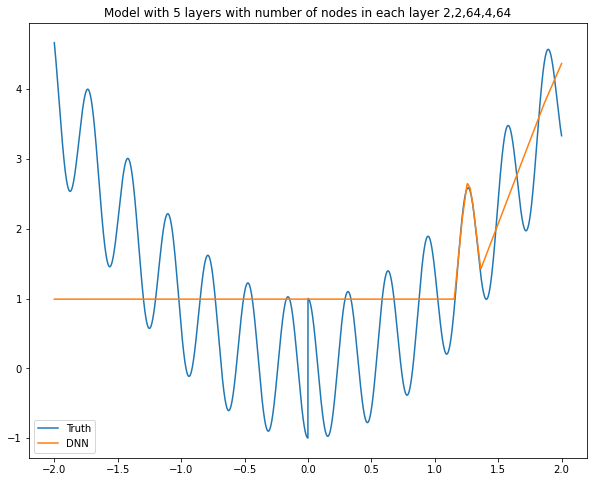

Model: "sequential_630"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3760 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3761 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3762 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3763 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3764 (Dense)           (None, 128)               640       
_________________________________________________________________
dense_3765 (Dense)           (None, 1)                 129       
Total params: 1,231
Trainable params: 1,231
Non-trainable params: 0
__________________________________________________

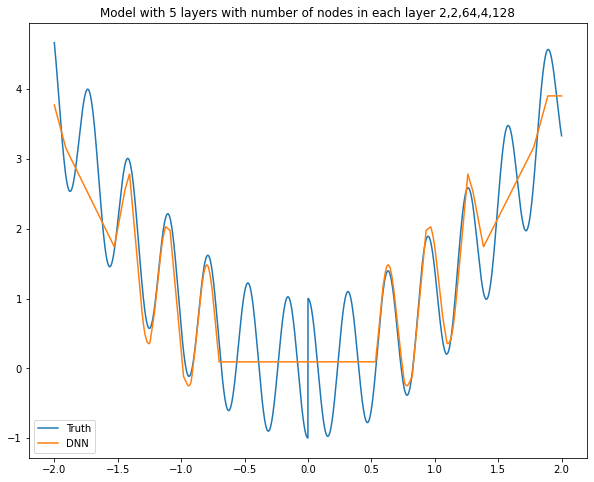

Model: "sequential_631"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3766 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3767 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3768 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3769 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3770 (Dense)           (None, 256)               1280      
_________________________________________________________________
dense_3771 (Dense)           (None, 1)                 257       
Total params: 1,999
Trainable params: 1,999
Non-trainable params: 0
__________________________________________________

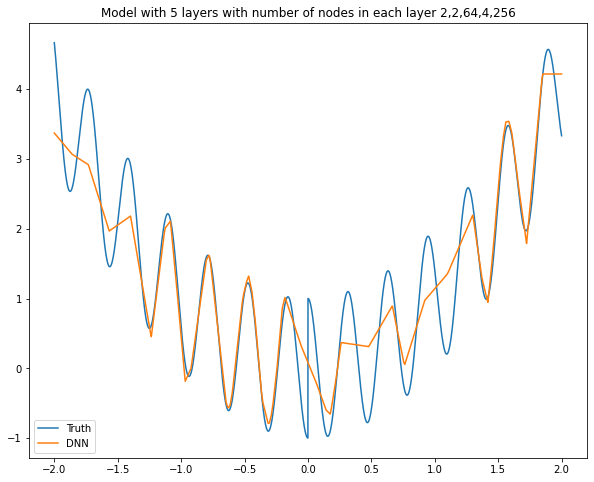

Model: "sequential_632"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3772 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3773 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3774 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3775 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3776 (Dense)           (None, 512)               2560      
_________________________________________________________________
dense_3777 (Dense)           (None, 1)                 513       
Total params: 3,535
Trainable params: 3,535
Non-trainable params: 0
__________________________________________________

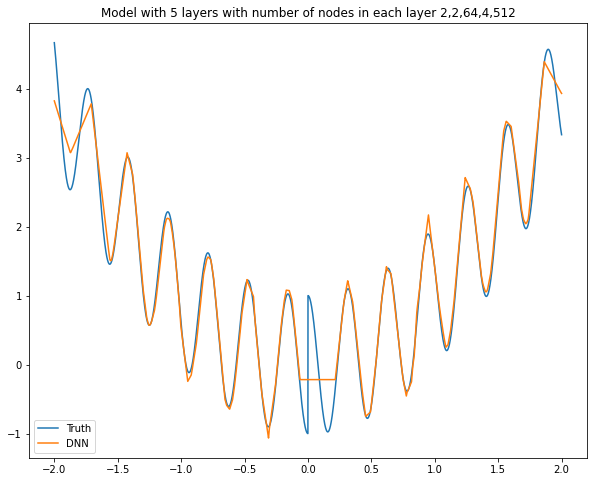

Model: "sequential_633"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3778 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3779 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3780 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3781 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3782 (Dense)           (None, 1024)              5120      
_________________________________________________________________
dense_3783 (Dense)           (None, 1)                 1025      
Total params: 6,607
Trainable params: 6,607
Non-trainable params: 0
__________________________________________________

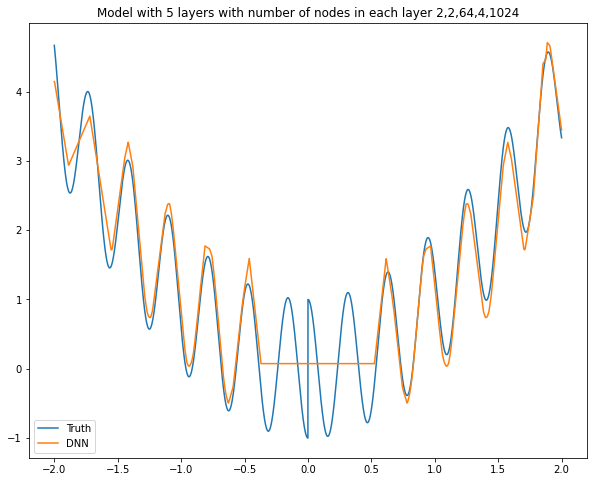

Model: "sequential_634"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3784 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3785 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3786 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3787 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3788 (Dense)           (None, 2048)              10240     
_________________________________________________________________
dense_3789 (Dense)           (None, 1)                 2049      
Total params: 12,751
Trainable params: 12,751
Non-trainable params: 0
________________________________________________

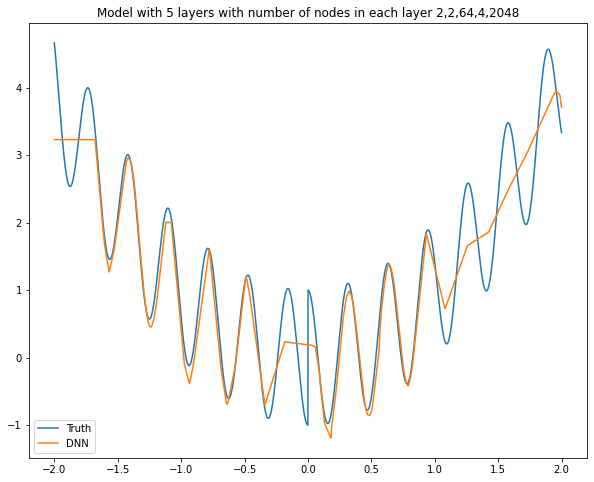

Model: "sequential_635"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3790 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3791 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3792 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3793 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3794 (Dense)           (None, 2)                 18        
_________________________________________________________________
dense_3795 (Dense)           (None, 1)                 3         
Total params: 743
Trainable params: 743
Non-trainable params: 0
______________________________________________________

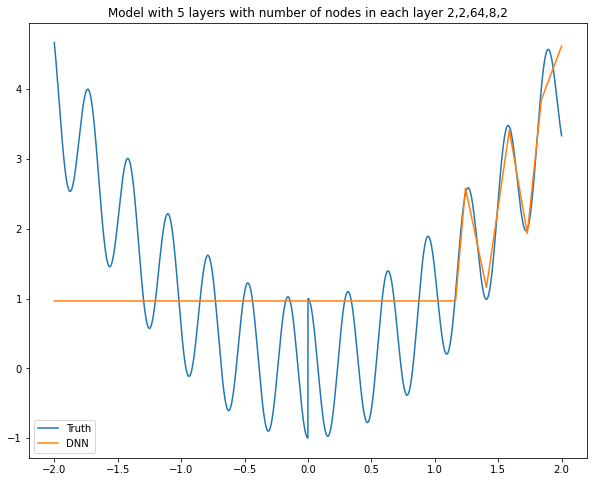

Model: "sequential_636"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3796 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3797 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3798 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3799 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3800 (Dense)           (None, 4)                 36        
_________________________________________________________________
dense_3801 (Dense)           (None, 1)                 5         
Total params: 763
Trainable params: 763
Non-trainable params: 0
______________________________________________________

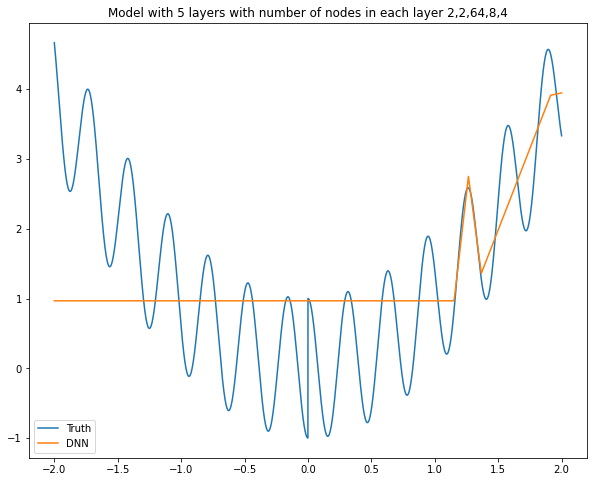

Model: "sequential_637"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3802 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3803 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3804 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3805 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3806 (Dense)           (None, 8)                 72        
_________________________________________________________________
dense_3807 (Dense)           (None, 1)                 9         
Total params: 803
Trainable params: 803
Non-trainable params: 0
______________________________________________________

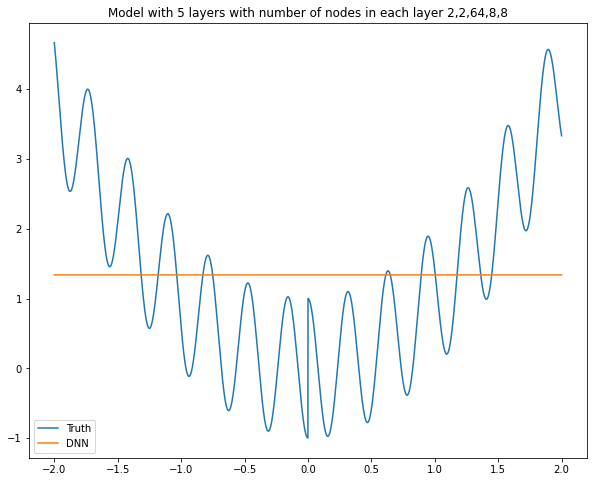

Model: "sequential_638"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3808 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3809 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3810 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3811 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3812 (Dense)           (None, 16)                144       
_________________________________________________________________
dense_3813 (Dense)           (None, 1)                 17        
Total params: 883
Trainable params: 883
Non-trainable params: 0
______________________________________________________

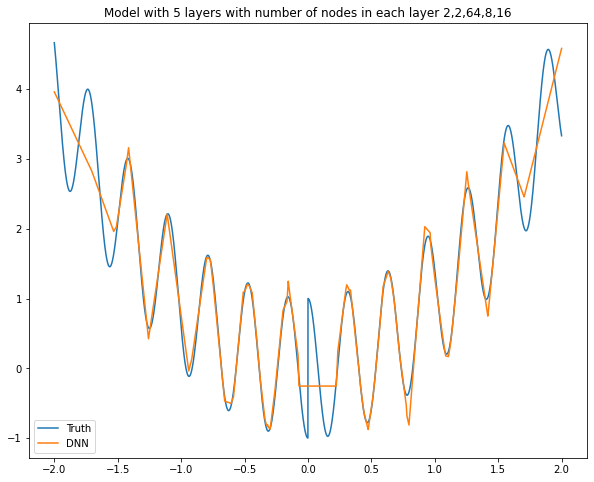

Model: "sequential_639"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3814 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3815 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3816 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3817 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3818 (Dense)           (None, 32)                288       
_________________________________________________________________
dense_3819 (Dense)           (None, 1)                 33        
Total params: 1,043
Trainable params: 1,043
Non-trainable params: 0
__________________________________________________

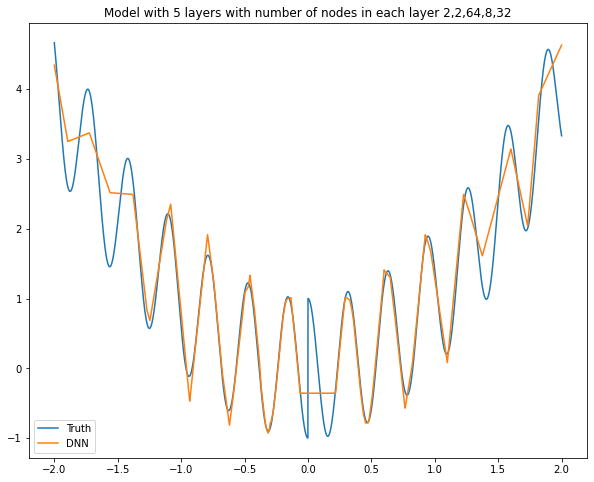

Model: "sequential_640"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3820 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3821 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3822 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3823 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3824 (Dense)           (None, 64)                576       
_________________________________________________________________
dense_3825 (Dense)           (None, 1)                 65        
Total params: 1,363
Trainable params: 1,363
Non-trainable params: 0
__________________________________________________

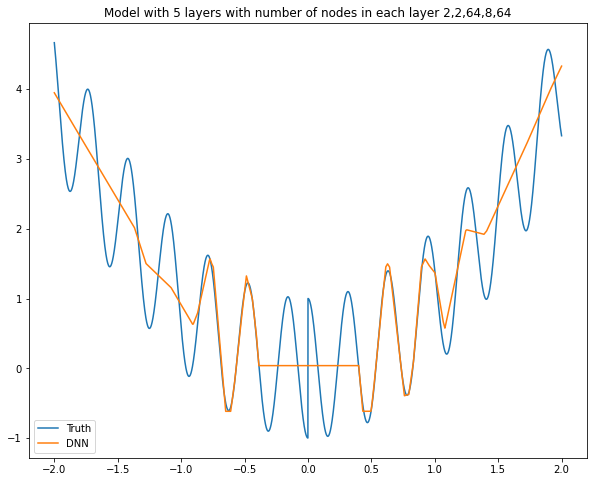

Model: "sequential_641"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3826 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3827 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3828 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3829 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3830 (Dense)           (None, 128)               1152      
_________________________________________________________________
dense_3831 (Dense)           (None, 1)                 129       
Total params: 2,003
Trainable params: 2,003
Non-trainable params: 0
__________________________________________________

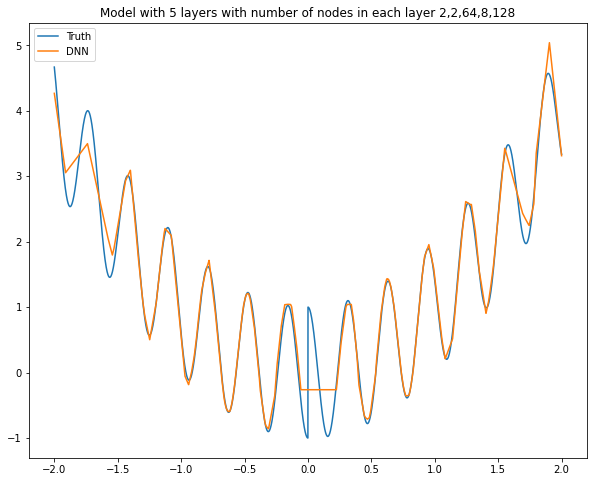

Model: "sequential_642"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3832 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3833 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3834 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3835 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3836 (Dense)           (None, 256)               2304      
_________________________________________________________________
dense_3837 (Dense)           (None, 1)                 257       
Total params: 3,283
Trainable params: 3,283
Non-trainable params: 0
__________________________________________________

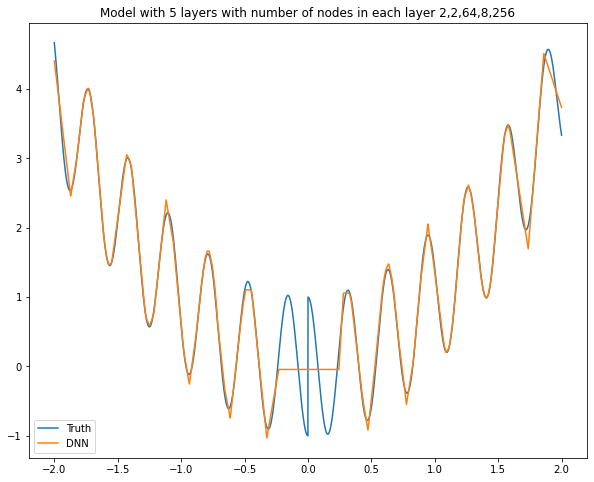

Model: "sequential_643"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3838 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3839 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3840 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3841 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3842 (Dense)           (None, 512)               4608      
_________________________________________________________________
dense_3843 (Dense)           (None, 1)                 513       
Total params: 5,843
Trainable params: 5,843
Non-trainable params: 0
__________________________________________________

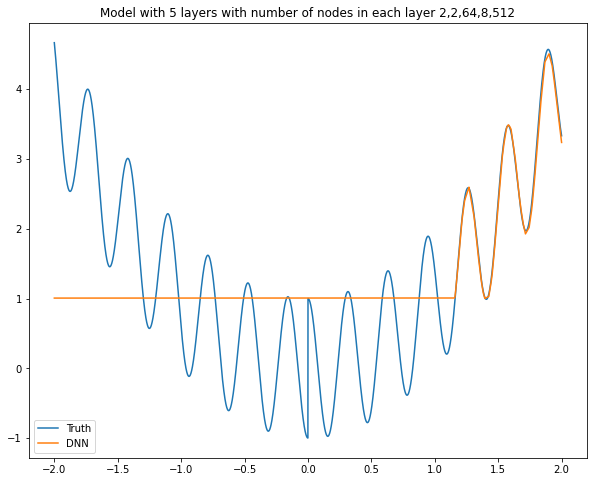

Model: "sequential_644"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3844 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3845 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3846 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3847 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3848 (Dense)           (None, 1024)              9216      
_________________________________________________________________
dense_3849 (Dense)           (None, 1)                 1025      
Total params: 10,963
Trainable params: 10,963
Non-trainable params: 0
________________________________________________

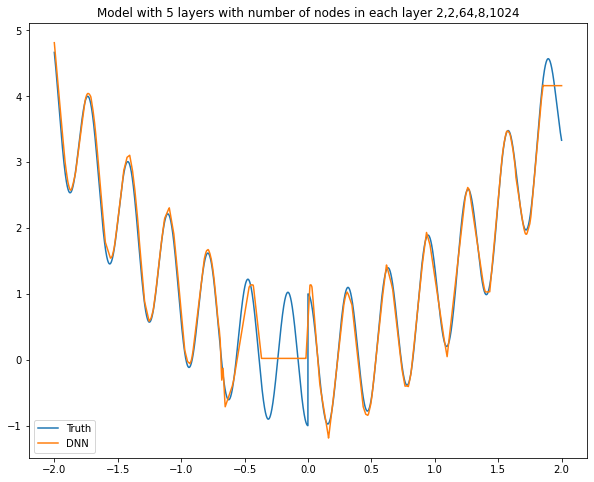

Model: "sequential_645"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3850 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3851 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3852 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3853 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_3854 (Dense)           (None, 2048)              18432     
_________________________________________________________________
dense_3855 (Dense)           (None, 1)                 2049      
Total params: 21,203
Trainable params: 21,203
Non-trainable params: 0
________________________________________________

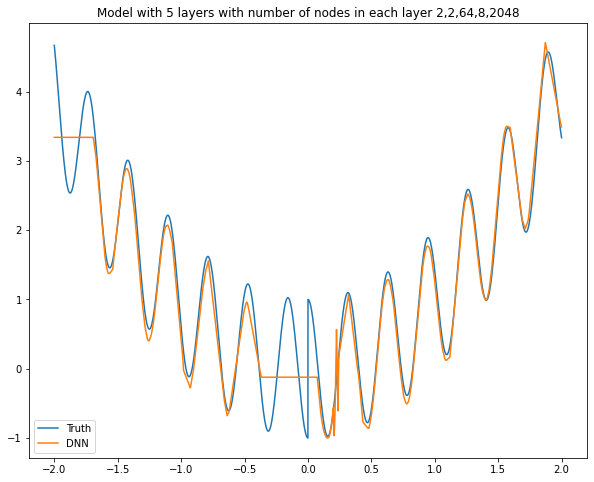

Model: "sequential_646"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3856 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3857 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3858 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3859 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3860 (Dense)           (None, 2)                 34        
_________________________________________________________________
dense_3861 (Dense)           (None, 1)                 3         
Total params: 1,279
Trainable params: 1,279
Non-trainable params: 0
__________________________________________________

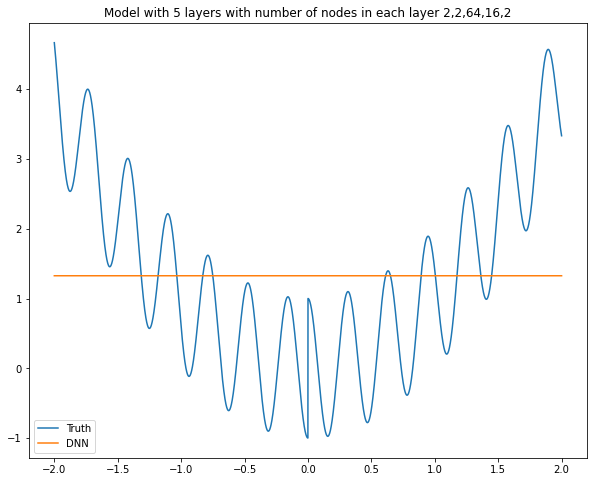

Model: "sequential_647"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3862 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3863 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3864 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3865 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3866 (Dense)           (None, 4)                 68        
_________________________________________________________________
dense_3867 (Dense)           (None, 1)                 5         
Total params: 1,315
Trainable params: 1,315
Non-trainable params: 0
__________________________________________________

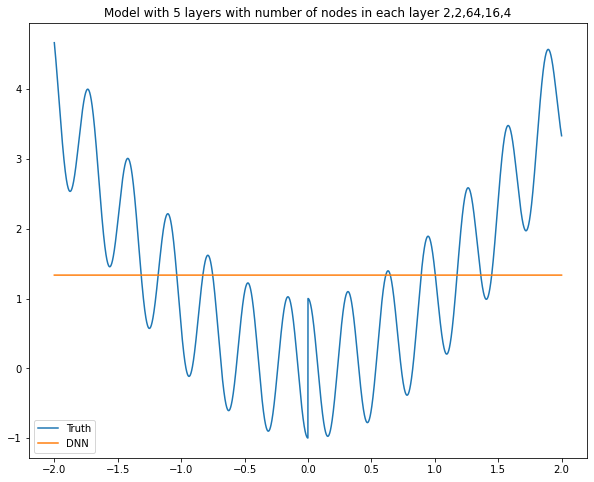

Model: "sequential_648"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3868 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3869 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3870 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3871 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3872 (Dense)           (None, 8)                 136       
_________________________________________________________________
dense_3873 (Dense)           (None, 1)                 9         
Total params: 1,387
Trainable params: 1,387
Non-trainable params: 0
__________________________________________________

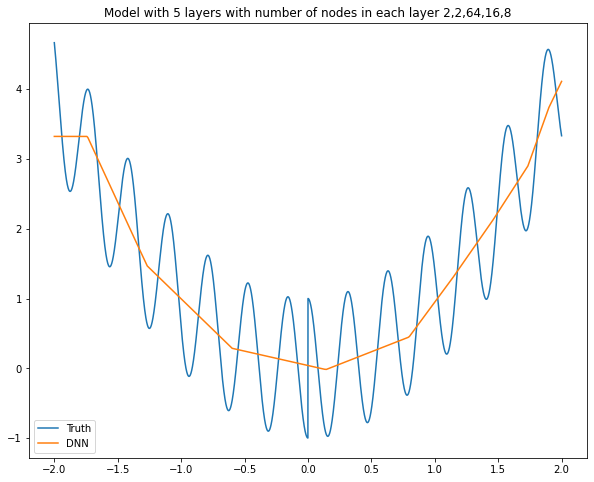

Model: "sequential_649"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3874 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3875 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3876 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3877 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3878 (Dense)           (None, 16)                272       
_________________________________________________________________
dense_3879 (Dense)           (None, 1)                 17        
Total params: 1,531
Trainable params: 1,531
Non-trainable params: 0
__________________________________________________

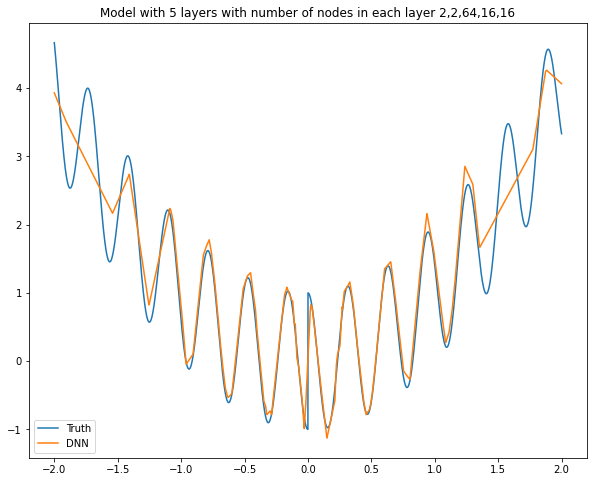

Model: "sequential_650"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3880 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3881 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3882 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3883 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3884 (Dense)           (None, 32)                544       
_________________________________________________________________
dense_3885 (Dense)           (None, 1)                 33        
Total params: 1,819
Trainable params: 1,819
Non-trainable params: 0
__________________________________________________

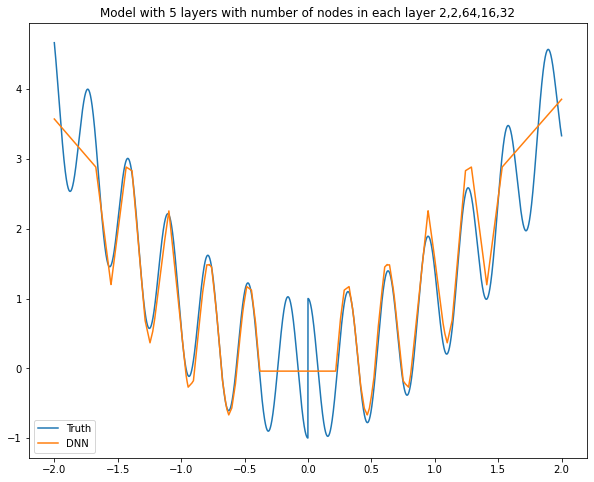

Model: "sequential_651"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3886 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3887 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3888 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3889 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3890 (Dense)           (None, 64)                1088      
_________________________________________________________________
dense_3891 (Dense)           (None, 1)                 65        
Total params: 2,395
Trainable params: 2,395
Non-trainable params: 0
__________________________________________________

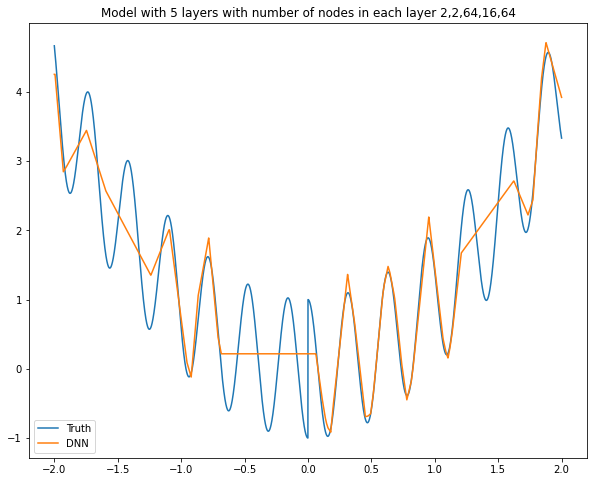

Model: "sequential_652"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3892 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3893 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3894 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3895 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3896 (Dense)           (None, 128)               2176      
_________________________________________________________________
dense_3897 (Dense)           (None, 1)                 129       
Total params: 3,547
Trainable params: 3,547
Non-trainable params: 0
__________________________________________________

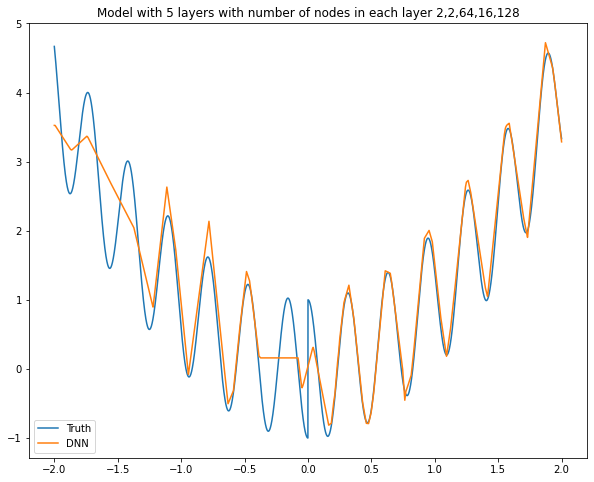

Model: "sequential_653"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3898 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3899 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3900 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3901 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3902 (Dense)           (None, 256)               4352      
_________________________________________________________________
dense_3903 (Dense)           (None, 1)                 257       
Total params: 5,851
Trainable params: 5,851
Non-trainable params: 0
__________________________________________________

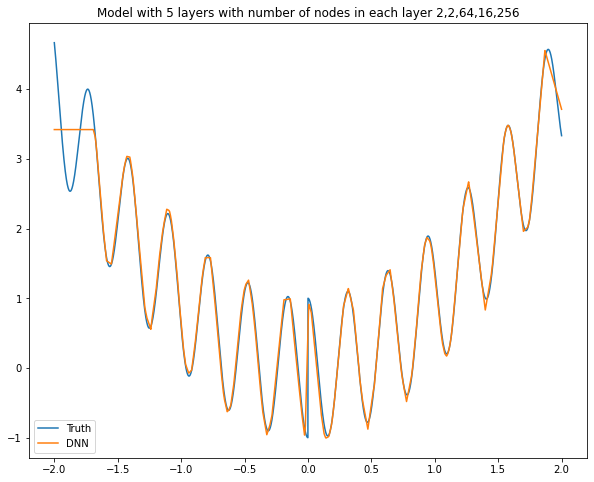

Model: "sequential_654"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3904 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3905 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3906 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3907 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3908 (Dense)           (None, 512)               8704      
_________________________________________________________________
dense_3909 (Dense)           (None, 1)                 513       
Total params: 10,459
Trainable params: 10,459
Non-trainable params: 0
________________________________________________

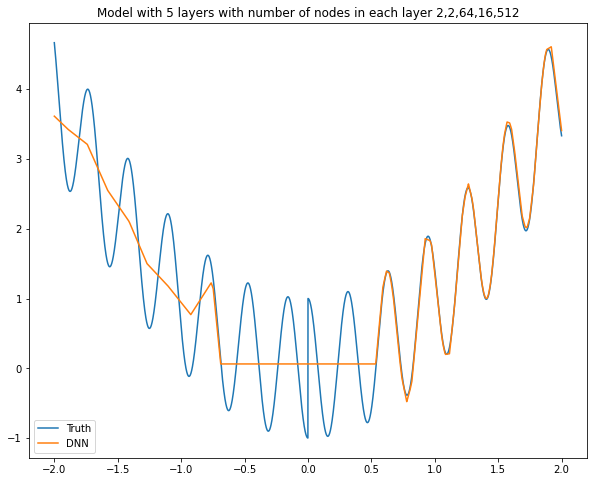

Model: "sequential_655"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3910 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3911 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3912 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3913 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3914 (Dense)           (None, 1024)              17408     
_________________________________________________________________
dense_3915 (Dense)           (None, 1)                 1025      
Total params: 19,675
Trainable params: 19,675
Non-trainable params: 0
________________________________________________

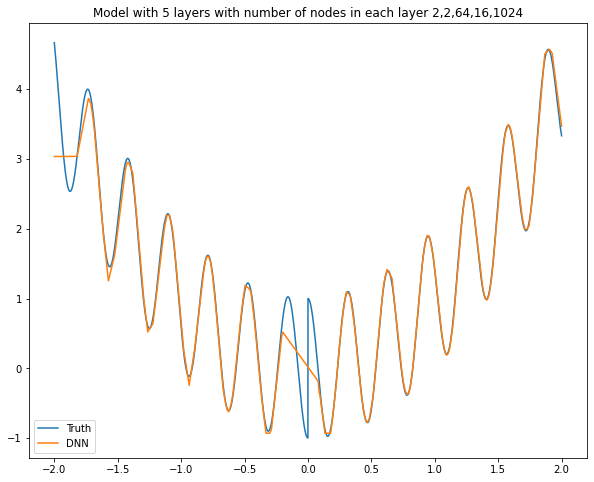

Model: "sequential_656"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3916 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3917 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3918 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3919 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_3920 (Dense)           (None, 2048)              34816     
_________________________________________________________________
dense_3921 (Dense)           (None, 1)                 2049      
Total params: 38,107
Trainable params: 38,107
Non-trainable params: 0
________________________________________________

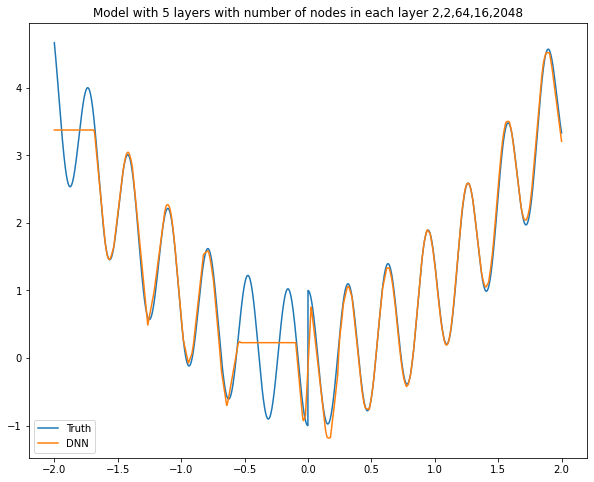

Model: "sequential_657"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3922 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3923 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3924 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3925 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3926 (Dense)           (None, 2)                 66        
_________________________________________________________________
dense_3927 (Dense)           (None, 1)                 3         
Total params: 2,351
Trainable params: 2,351
Non-trainable params: 0
__________________________________________________

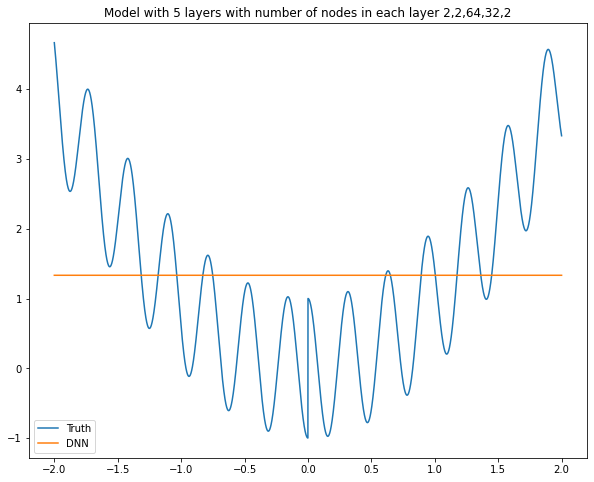

Model: "sequential_658"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3928 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3929 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3930 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3931 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3932 (Dense)           (None, 4)                 132       
_________________________________________________________________
dense_3933 (Dense)           (None, 1)                 5         
Total params: 2,419
Trainable params: 2,419
Non-trainable params: 0
__________________________________________________

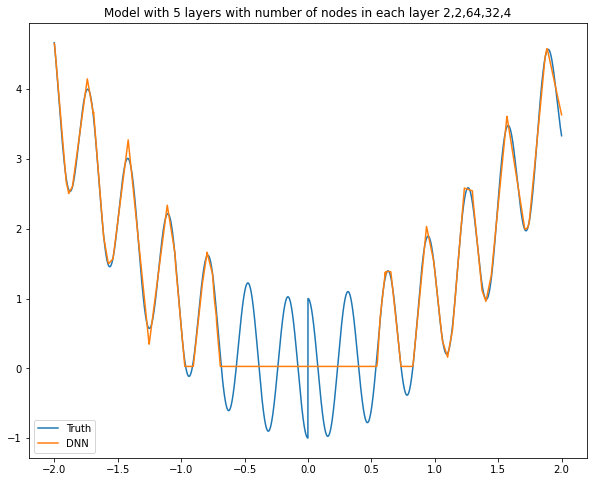

Model: "sequential_659"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3934 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3935 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3936 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3937 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3938 (Dense)           (None, 8)                 264       
_________________________________________________________________
dense_3939 (Dense)           (None, 1)                 9         
Total params: 2,555
Trainable params: 2,555
Non-trainable params: 0
__________________________________________________

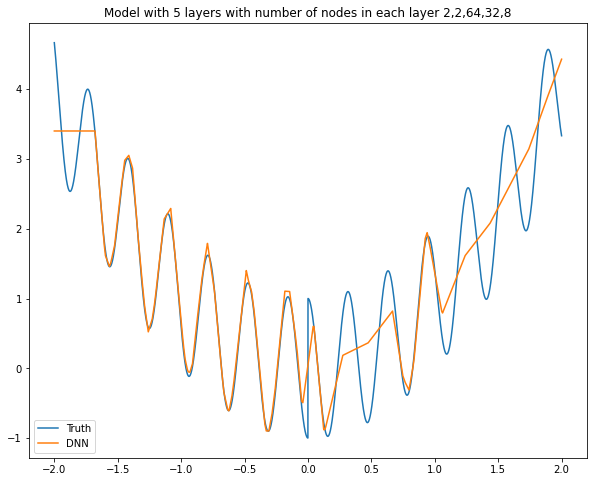

Model: "sequential_660"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3940 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3941 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3942 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3943 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3944 (Dense)           (None, 16)                528       
_________________________________________________________________
dense_3945 (Dense)           (None, 1)                 17        
Total params: 2,827
Trainable params: 2,827
Non-trainable params: 0
__________________________________________________

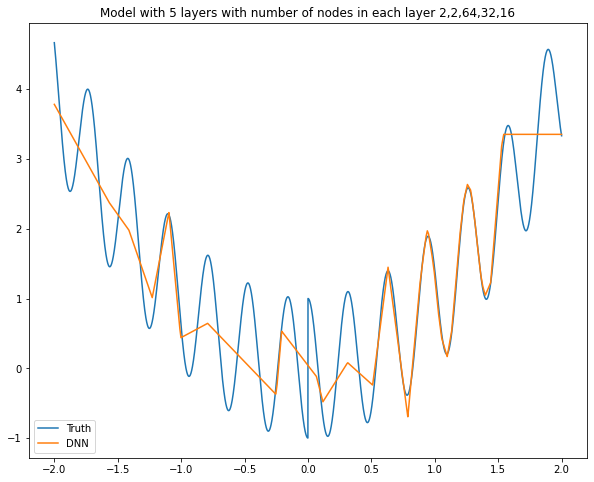

Model: "sequential_661"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3946 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3947 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3948 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3949 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3950 (Dense)           (None, 32)                1056      
_________________________________________________________________
dense_3951 (Dense)           (None, 1)                 33        
Total params: 3,371
Trainable params: 3,371
Non-trainable params: 0
__________________________________________________

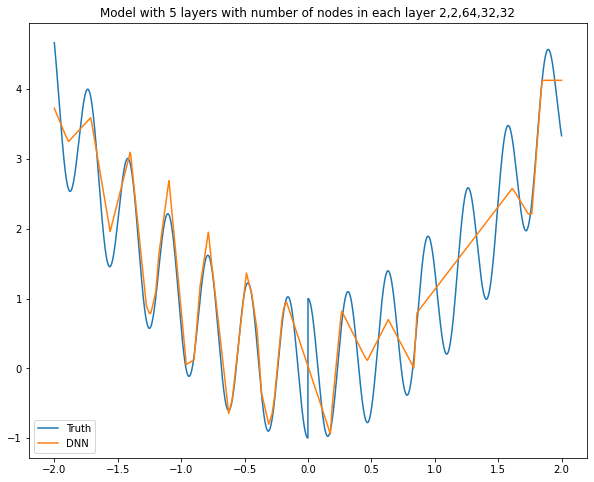

Model: "sequential_662"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3952 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3953 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3954 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3955 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3956 (Dense)           (None, 64)                2112      
_________________________________________________________________
dense_3957 (Dense)           (None, 1)                 65        
Total params: 4,459
Trainable params: 4,459
Non-trainable params: 0
__________________________________________________

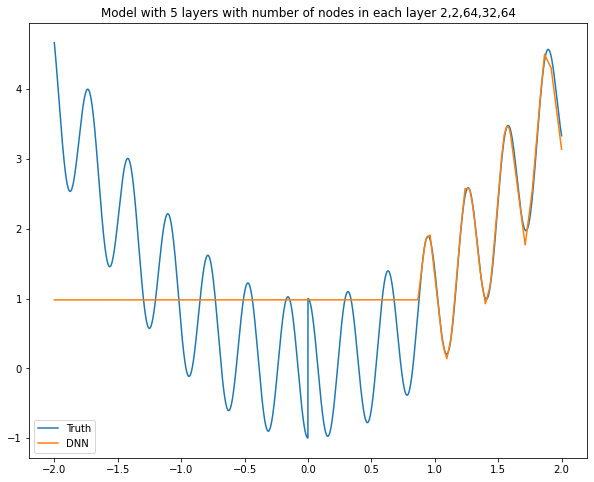

Model: "sequential_663"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3958 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3959 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3960 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3961 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3962 (Dense)           (None, 128)               4224      
_________________________________________________________________
dense_3963 (Dense)           (None, 1)                 129       
Total params: 6,635
Trainable params: 6,635
Non-trainable params: 0
__________________________________________________

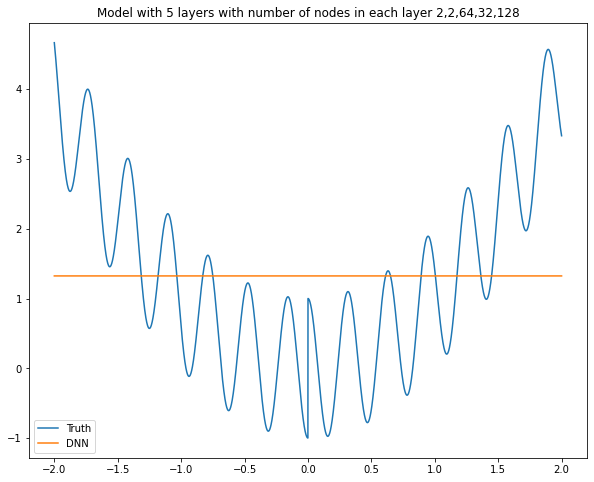

Model: "sequential_664"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3964 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3965 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3966 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3967 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3968 (Dense)           (None, 256)               8448      
_________________________________________________________________
dense_3969 (Dense)           (None, 1)                 257       
Total params: 10,987
Trainable params: 10,987
Non-trainable params: 0
________________________________________________

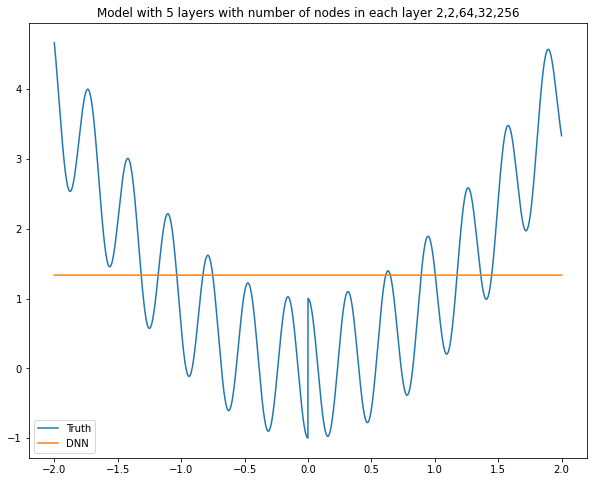

Model: "sequential_665"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3970 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3971 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3972 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3973 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3974 (Dense)           (None, 512)               16896     
_________________________________________________________________
dense_3975 (Dense)           (None, 1)                 513       
Total params: 19,691
Trainable params: 19,691
Non-trainable params: 0
________________________________________________

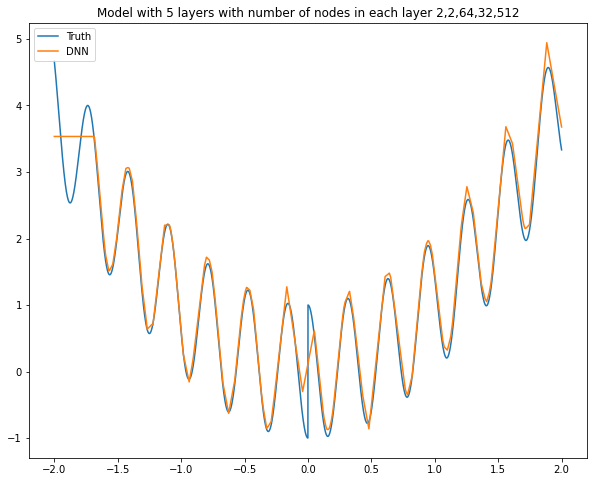

Model: "sequential_666"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3976 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3977 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3978 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3979 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3980 (Dense)           (None, 1024)              33792     
_________________________________________________________________
dense_3981 (Dense)           (None, 1)                 1025      
Total params: 37,099
Trainable params: 37,099
Non-trainable params: 0
________________________________________________

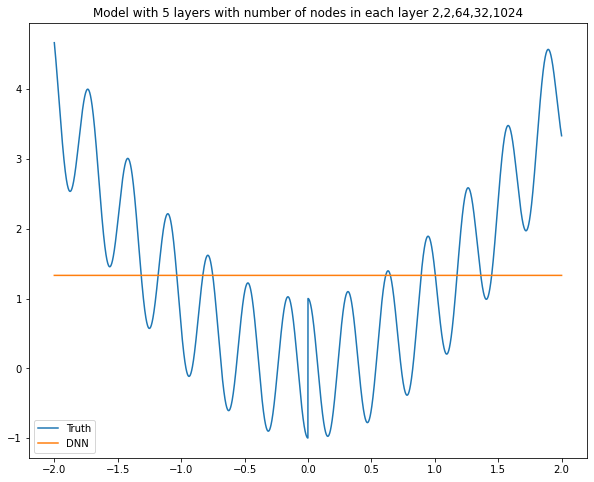

Model: "sequential_667"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3982 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3983 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3984 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3985 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_3986 (Dense)           (None, 2048)              67584     
_________________________________________________________________
dense_3987 (Dense)           (None, 1)                 2049      
Total params: 71,915
Trainable params: 71,915
Non-trainable params: 0
________________________________________________

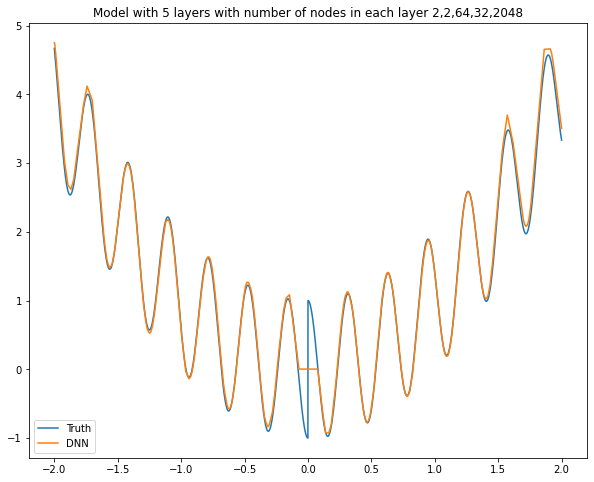

Model: "sequential_668"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3988 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3989 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3990 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3991 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_3992 (Dense)           (None, 2)                 130       
_________________________________________________________________
dense_3993 (Dense)           (None, 1)                 3         
Total params: 4,495
Trainable params: 4,495
Non-trainable params: 0
__________________________________________________

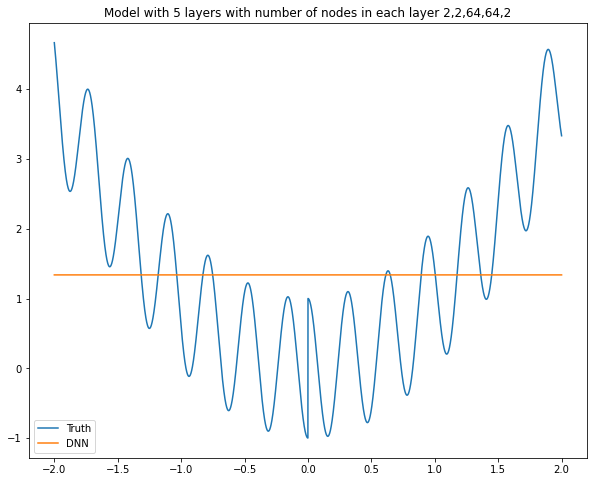

Model: "sequential_669"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3994 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_3995 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_3996 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_3997 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_3998 (Dense)           (None, 4)                 260       
_________________________________________________________________
dense_3999 (Dense)           (None, 1)                 5         
Total params: 4,627
Trainable params: 4,627
Non-trainable params: 0
__________________________________________________

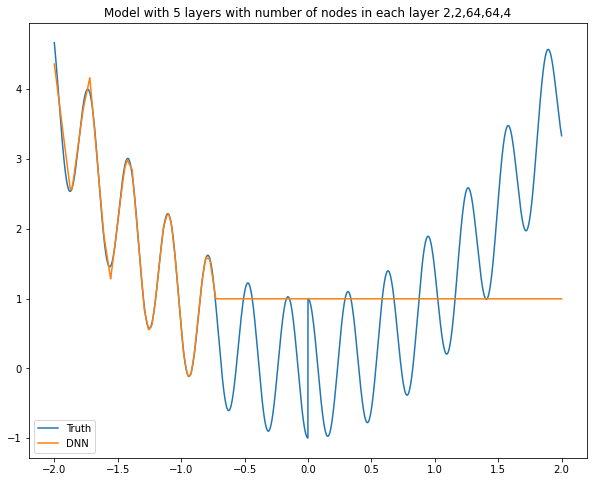

Model: "sequential_670"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4000 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4001 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4002 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4003 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4004 (Dense)           (None, 8)                 520       
_________________________________________________________________
dense_4005 (Dense)           (None, 1)                 9         
Total params: 4,891
Trainable params: 4,891
Non-trainable params: 0
__________________________________________________

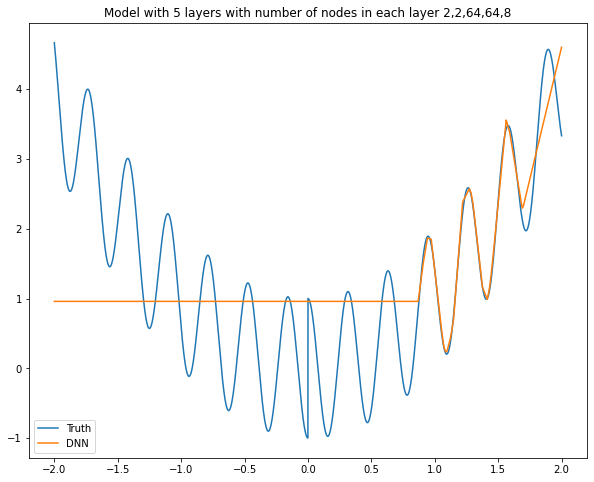

Model: "sequential_671"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4006 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4007 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4008 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4009 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4010 (Dense)           (None, 16)                1040      
_________________________________________________________________
dense_4011 (Dense)           (None, 1)                 17        
Total params: 5,419
Trainable params: 5,419
Non-trainable params: 0
__________________________________________________

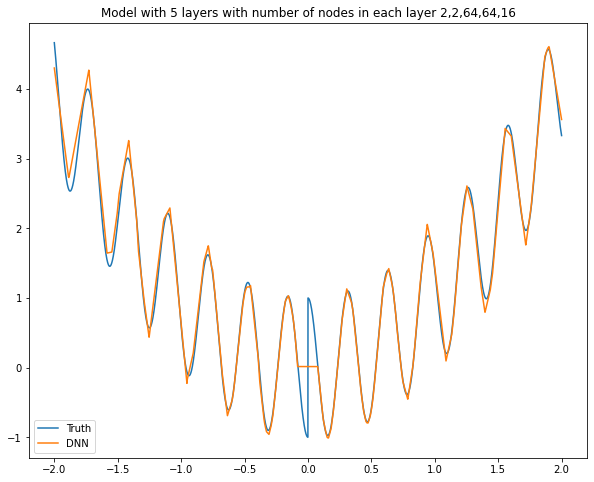

Model: "sequential_672"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4012 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4013 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4014 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4015 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4016 (Dense)           (None, 32)                2080      
_________________________________________________________________
dense_4017 (Dense)           (None, 1)                 33        
Total params: 6,475
Trainable params: 6,475
Non-trainable params: 0
__________________________________________________

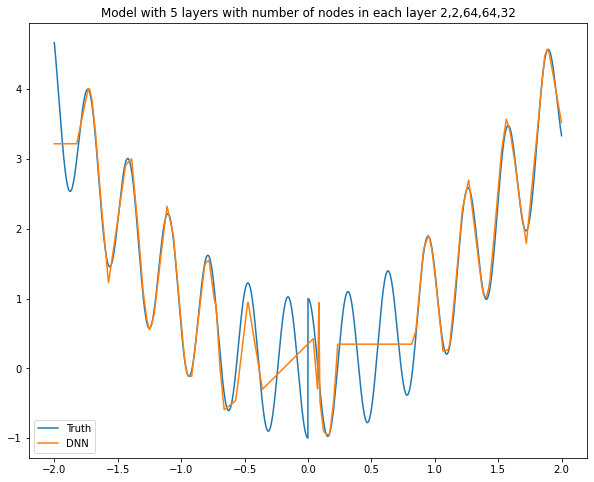

Model: "sequential_673"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4018 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4019 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4020 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4021 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4022 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4023 (Dense)           (None, 1)                 65        
Total params: 8,587
Trainable params: 8,587
Non-trainable params: 0
__________________________________________________

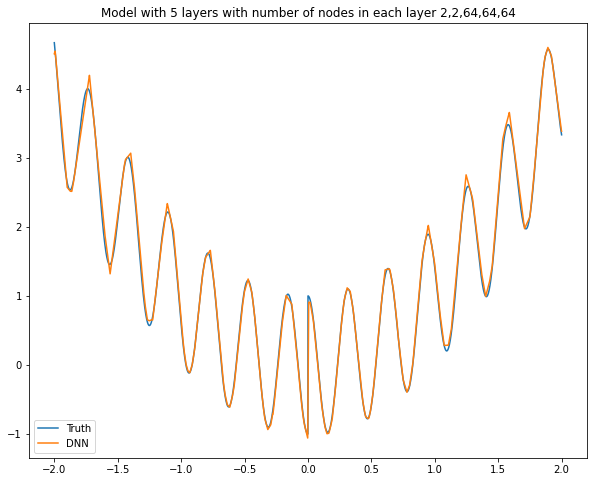

Model: "sequential_674"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4024 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4025 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4026 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4027 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4028 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4029 (Dense)           (None, 1)                 129       
Total params: 12,811
Trainable params: 12,811
Non-trainable params: 0
________________________________________________

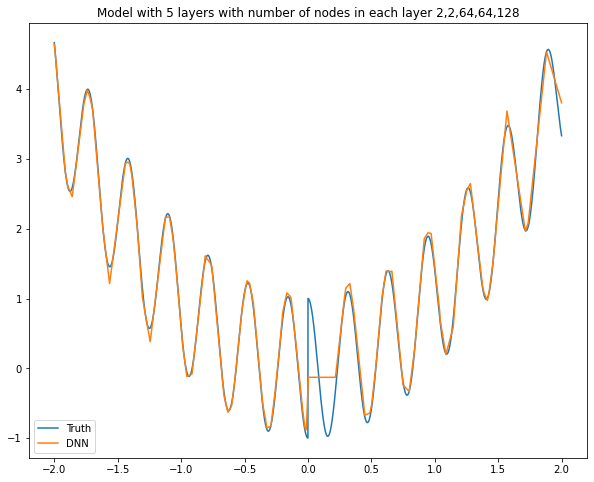

Model: "sequential_675"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4030 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4031 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4032 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4033 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4034 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4035 (Dense)           (None, 1)                 257       
Total params: 21,259
Trainable params: 21,259
Non-trainable params: 0
________________________________________________

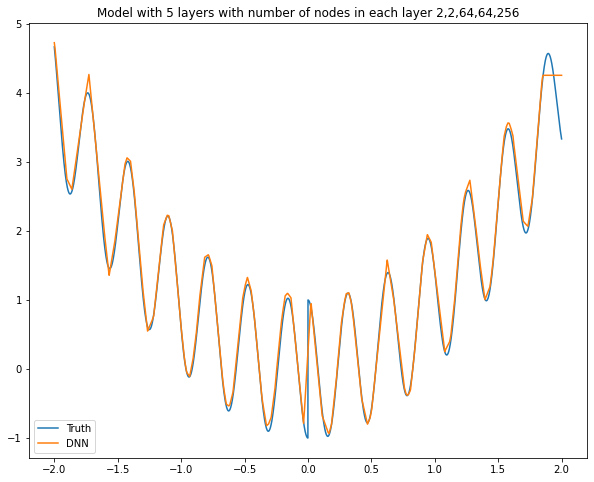

Model: "sequential_676"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4036 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4037 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4038 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4039 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4040 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4041 (Dense)           (None, 1)                 513       
Total params: 38,155
Trainable params: 38,155
Non-trainable params: 0
________________________________________________

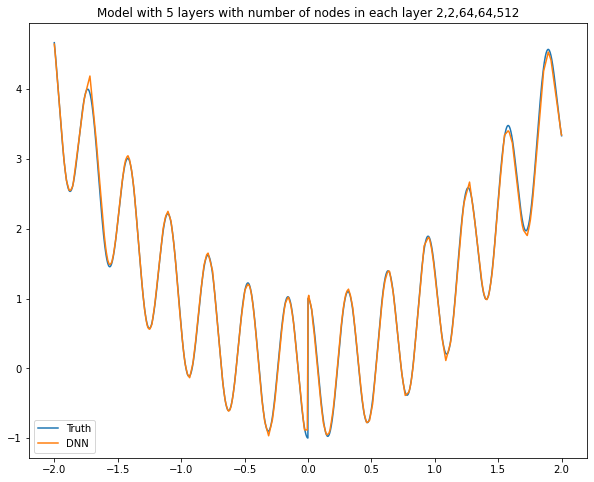

Model: "sequential_677"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4042 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4043 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4044 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4045 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4046 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4047 (Dense)           (None, 1)                 1025      
Total params: 71,947
Trainable params: 71,947
Non-trainable params: 0
________________________________________________

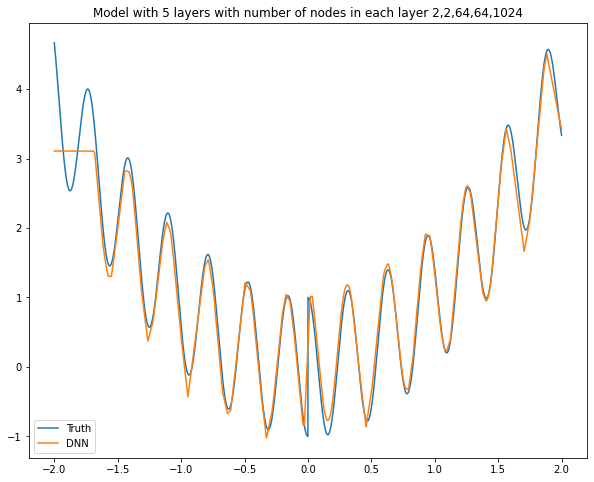

Model: "sequential_678"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4048 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4049 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4050 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4051 (Dense)           (None, 64)                4160      
_________________________________________________________________
dense_4052 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4053 (Dense)           (None, 1)                 2049      
Total params: 139,531
Trainable params: 139,531
Non-trainable params: 0
______________________________________________

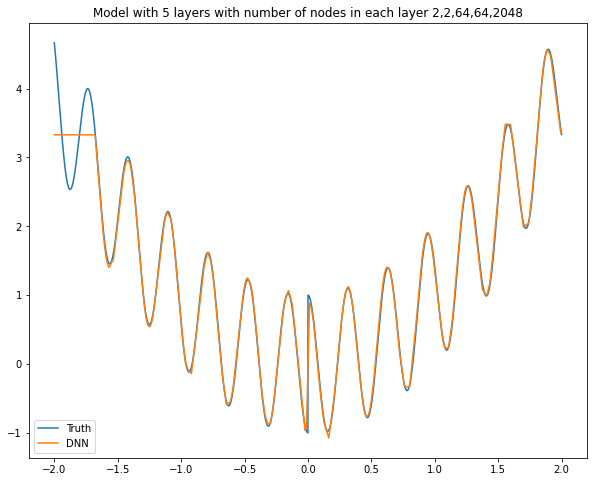

Model: "sequential_679"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4054 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4055 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4056 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4057 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4058 (Dense)           (None, 2)                 258       
_________________________________________________________________
dense_4059 (Dense)           (None, 1)                 3         
Total params: 8,783
Trainable params: 8,783
Non-trainable params: 0
__________________________________________________

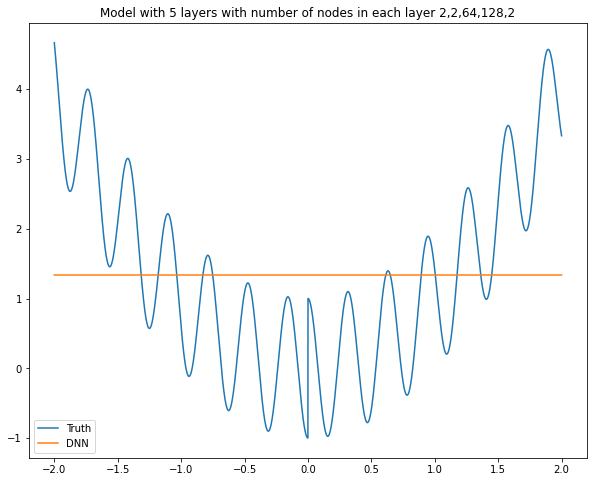

Model: "sequential_680"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4060 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4061 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4062 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4063 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4064 (Dense)           (None, 4)                 516       
_________________________________________________________________
dense_4065 (Dense)           (None, 1)                 5         
Total params: 9,043
Trainable params: 9,043
Non-trainable params: 0
__________________________________________________

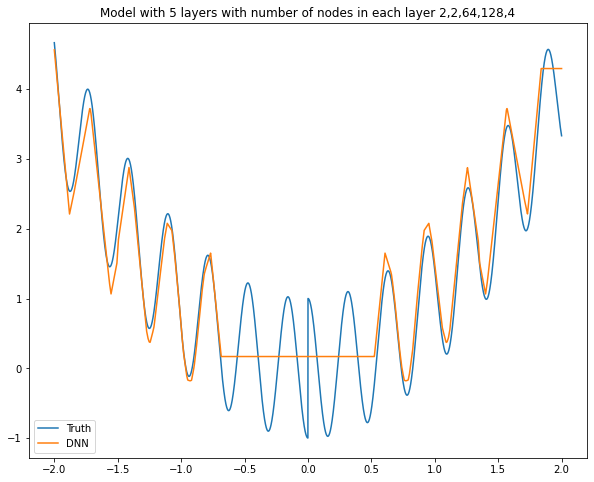

Model: "sequential_681"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4066 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4067 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4068 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4069 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4070 (Dense)           (None, 8)                 1032      
_________________________________________________________________
dense_4071 (Dense)           (None, 1)                 9         
Total params: 9,563
Trainable params: 9,563
Non-trainable params: 0
__________________________________________________

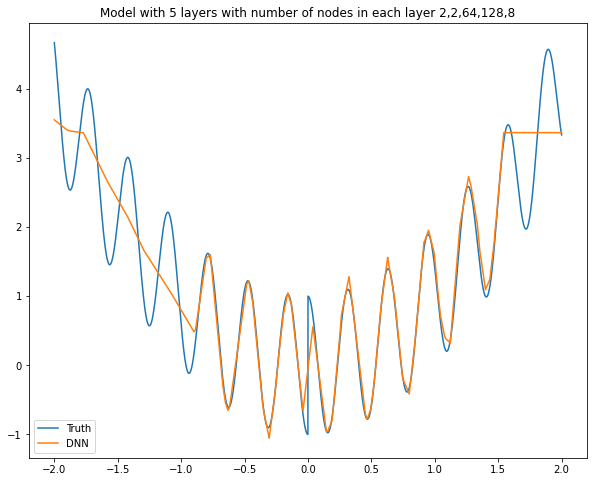

Model: "sequential_682"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4072 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4073 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4074 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4075 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4076 (Dense)           (None, 16)                2064      
_________________________________________________________________
dense_4077 (Dense)           (None, 1)                 17        
Total params: 10,603
Trainable params: 10,603
Non-trainable params: 0
________________________________________________

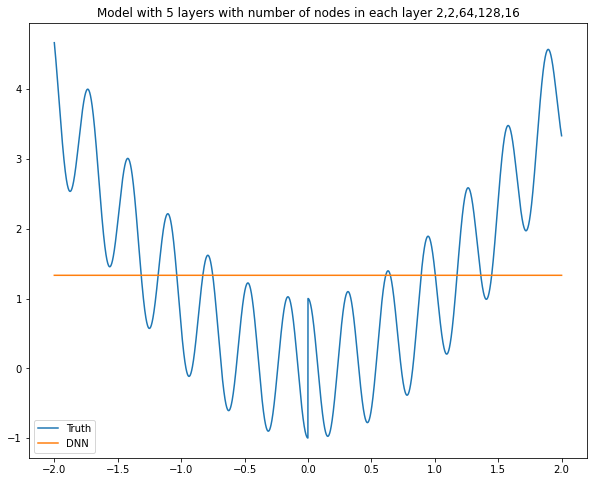

Model: "sequential_683"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4078 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4079 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4080 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4081 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4082 (Dense)           (None, 32)                4128      
_________________________________________________________________
dense_4083 (Dense)           (None, 1)                 33        
Total params: 12,683
Trainable params: 12,683
Non-trainable params: 0
________________________________________________

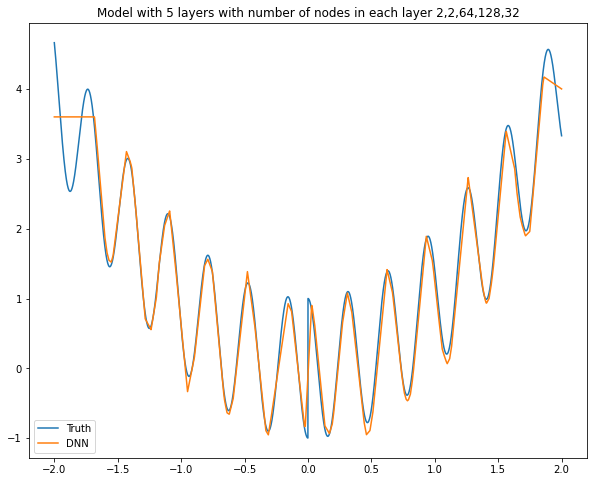

Model: "sequential_684"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4084 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4085 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4086 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4087 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4088 (Dense)           (None, 64)                8256      
_________________________________________________________________
dense_4089 (Dense)           (None, 1)                 65        
Total params: 16,843
Trainable params: 16,843
Non-trainable params: 0
________________________________________________

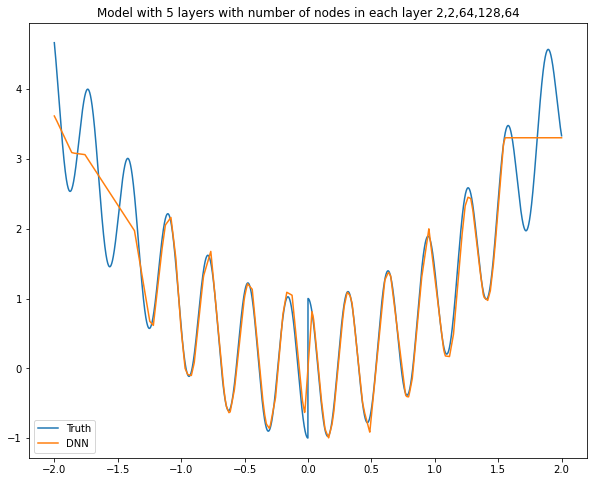

Model: "sequential_685"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4090 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4091 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4092 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4093 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4094 (Dense)           (None, 128)               16512     
_________________________________________________________________
dense_4095 (Dense)           (None, 1)                 129       
Total params: 25,163
Trainable params: 25,163
Non-trainable params: 0
________________________________________________

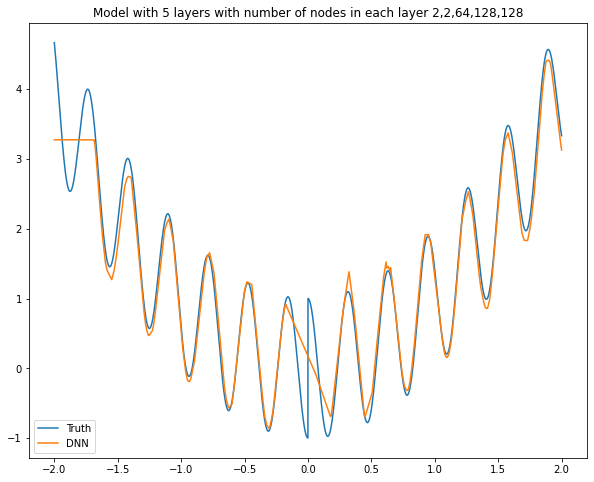

Model: "sequential_686"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4096 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4097 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4098 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4099 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4100 (Dense)           (None, 256)               33024     
_________________________________________________________________
dense_4101 (Dense)           (None, 1)                 257       
Total params: 41,803
Trainable params: 41,803
Non-trainable params: 0
________________________________________________

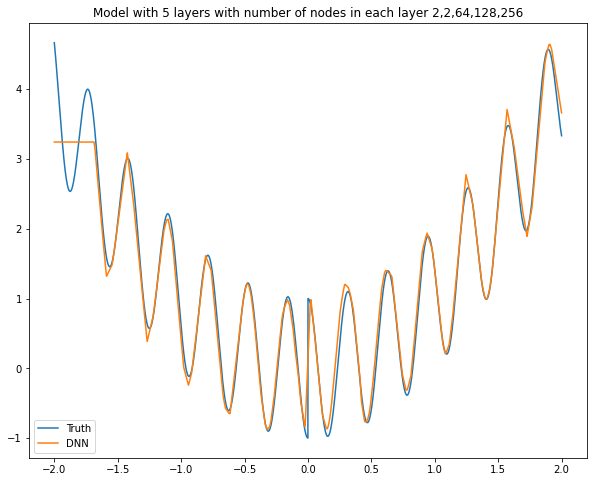

Model: "sequential_687"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4102 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4103 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4104 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4105 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4106 (Dense)           (None, 512)               66048     
_________________________________________________________________
dense_4107 (Dense)           (None, 1)                 513       
Total params: 75,083
Trainable params: 75,083
Non-trainable params: 0
________________________________________________

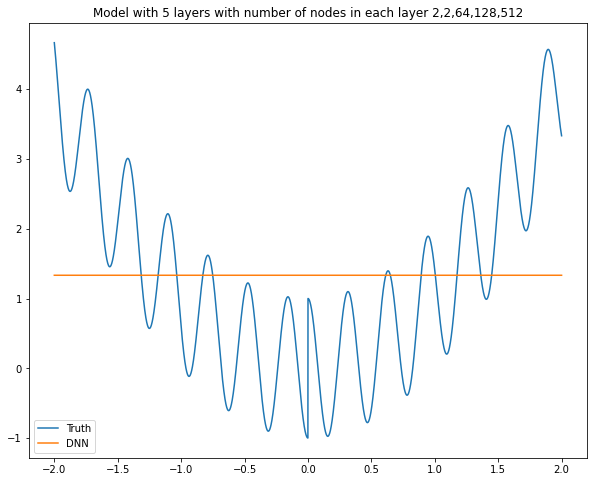

Model: "sequential_688"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4108 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4109 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4110 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4111 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4112 (Dense)           (None, 1024)              132096    
_________________________________________________________________
dense_4113 (Dense)           (None, 1)                 1025      
Total params: 141,643
Trainable params: 141,643
Non-trainable params: 0
______________________________________________

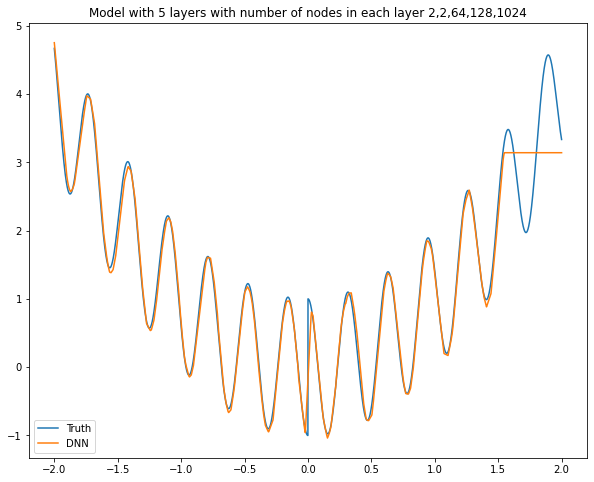

Model: "sequential_689"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4114 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4115 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4116 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4117 (Dense)           (None, 128)               8320      
_________________________________________________________________
dense_4118 (Dense)           (None, 2048)              264192    
_________________________________________________________________
dense_4119 (Dense)           (None, 1)                 2049      
Total params: 274,763
Trainable params: 274,763
Non-trainable params: 0
______________________________________________

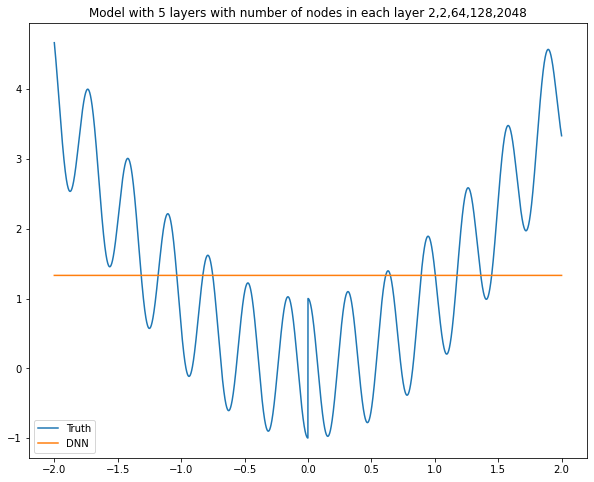

Model: "sequential_690"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4120 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4121 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4122 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4123 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4124 (Dense)           (None, 2)                 514       
_________________________________________________________________
dense_4125 (Dense)           (None, 1)                 3         
Total params: 17,359
Trainable params: 17,359
Non-trainable params: 0
________________________________________________

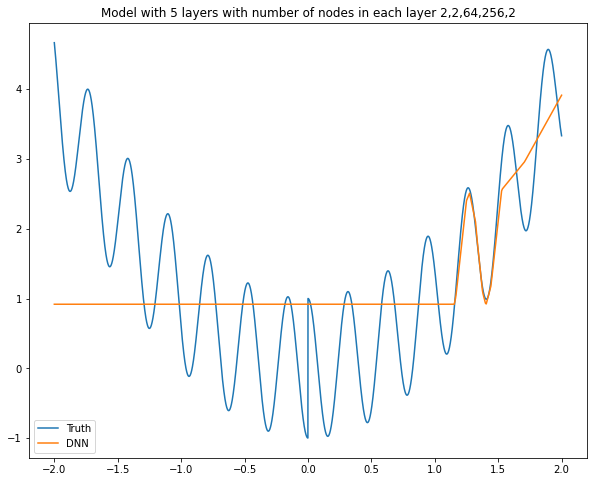

Model: "sequential_691"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4126 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4127 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4128 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4129 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4130 (Dense)           (None, 4)                 1028      
_________________________________________________________________
dense_4131 (Dense)           (None, 1)                 5         
Total params: 17,875
Trainable params: 17,875
Non-trainable params: 0
________________________________________________

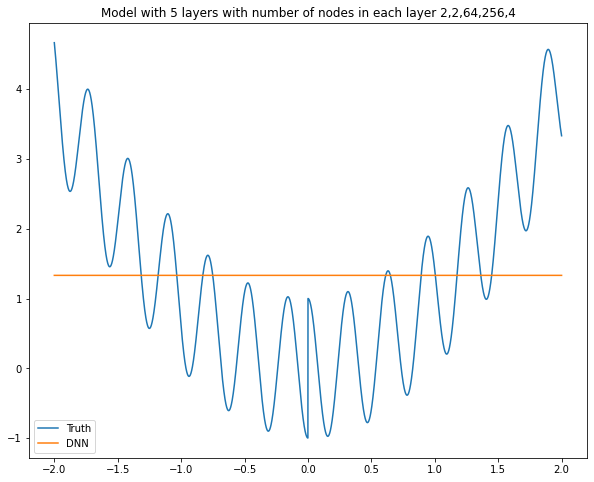

Model: "sequential_692"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4132 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4133 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4134 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4135 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4136 (Dense)           (None, 8)                 2056      
_________________________________________________________________
dense_4137 (Dense)           (None, 1)                 9         
Total params: 18,907
Trainable params: 18,907
Non-trainable params: 0
________________________________________________

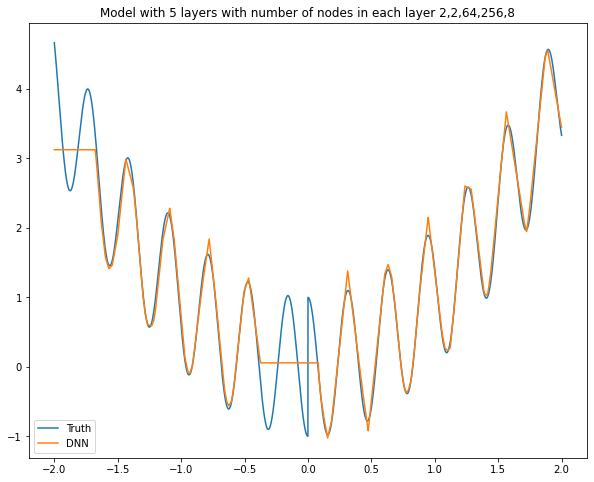

Model: "sequential_693"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4138 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4139 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4140 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4141 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4142 (Dense)           (None, 16)                4112      
_________________________________________________________________
dense_4143 (Dense)           (None, 1)                 17        
Total params: 20,971
Trainable params: 20,971
Non-trainable params: 0
________________________________________________

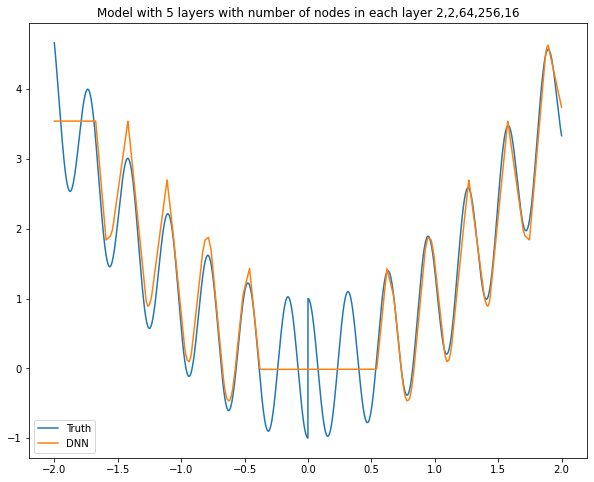

Model: "sequential_694"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4144 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4145 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4146 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4147 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4148 (Dense)           (None, 32)                8224      
_________________________________________________________________
dense_4149 (Dense)           (None, 1)                 33        
Total params: 25,099
Trainable params: 25,099
Non-trainable params: 0
________________________________________________

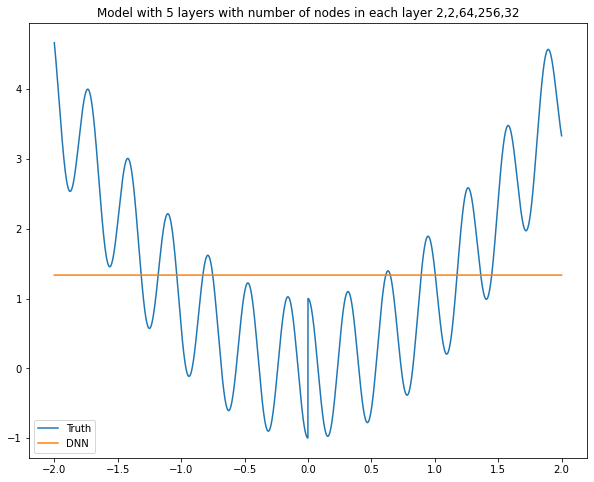

Model: "sequential_695"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4150 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4151 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4152 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4153 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4154 (Dense)           (None, 64)                16448     
_________________________________________________________________
dense_4155 (Dense)           (None, 1)                 65        
Total params: 33,355
Trainable params: 33,355
Non-trainable params: 0
________________________________________________

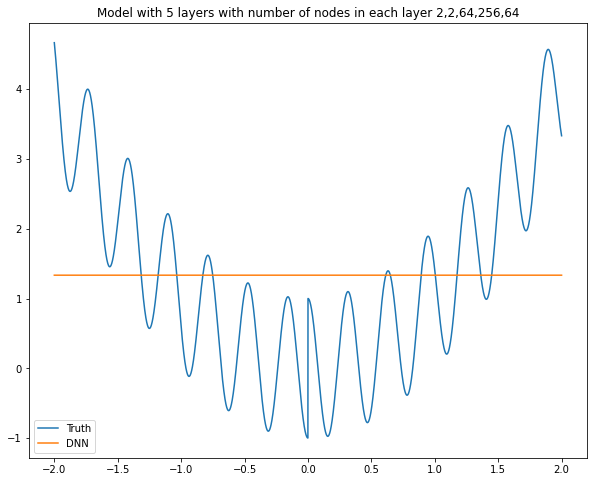

Model: "sequential_696"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4156 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4157 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4158 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4159 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4160 (Dense)           (None, 128)               32896     
_________________________________________________________________
dense_4161 (Dense)           (None, 1)                 129       
Total params: 49,867
Trainable params: 49,867
Non-trainable params: 0
________________________________________________

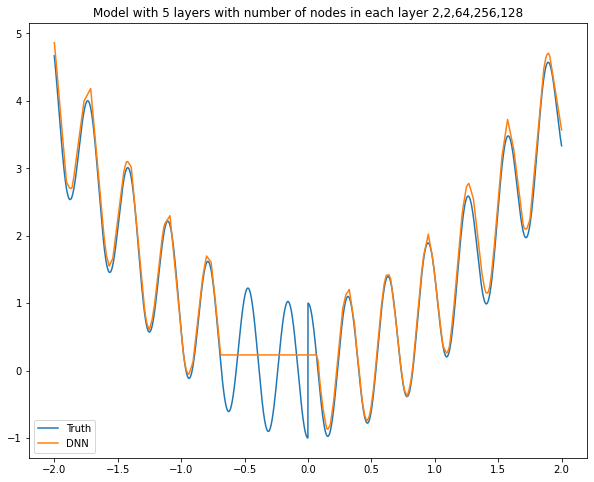

Model: "sequential_697"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4162 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4163 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4164 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4165 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4166 (Dense)           (None, 256)               65792     
_________________________________________________________________
dense_4167 (Dense)           (None, 1)                 257       
Total params: 82,891
Trainable params: 82,891
Non-trainable params: 0
________________________________________________

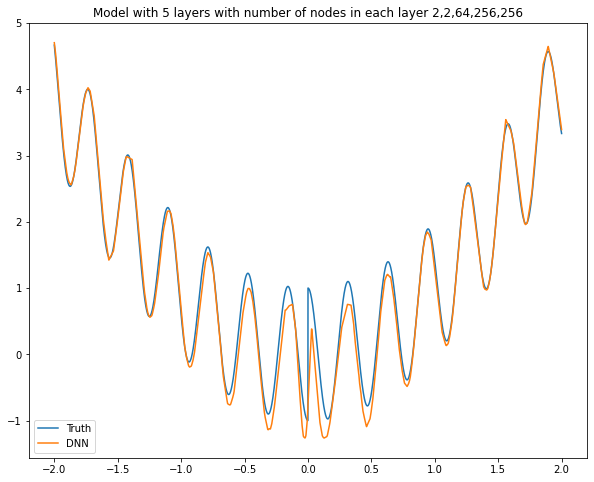

Model: "sequential_698"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4168 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4169 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4170 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4171 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4172 (Dense)           (None, 512)               131584    
_________________________________________________________________
dense_4173 (Dense)           (None, 1)                 513       
Total params: 148,939
Trainable params: 148,939
Non-trainable params: 0
______________________________________________

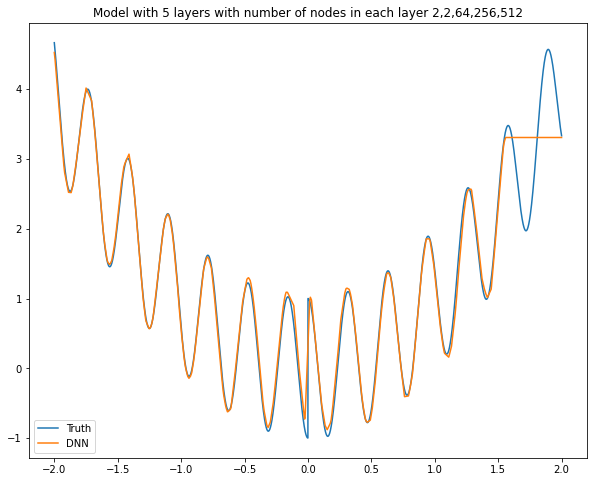

Model: "sequential_699"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4174 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4175 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4176 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4177 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4178 (Dense)           (None, 1024)              263168    
_________________________________________________________________
dense_4179 (Dense)           (None, 1)                 1025      
Total params: 281,035
Trainable params: 281,035
Non-trainable params: 0
______________________________________________

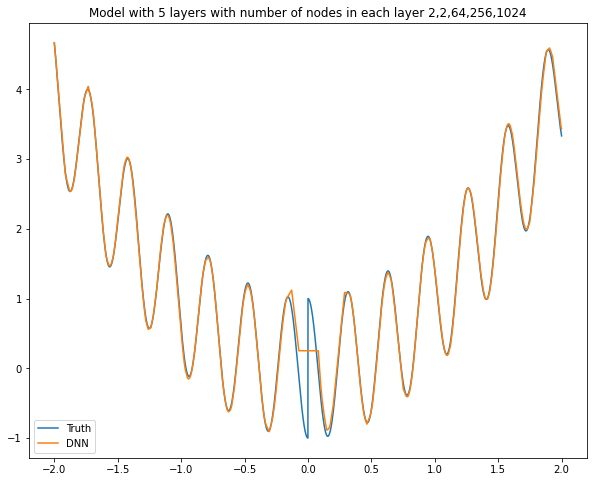

Model: "sequential_700"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4180 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4181 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4182 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4183 (Dense)           (None, 256)               16640     
_________________________________________________________________
dense_4184 (Dense)           (None, 2048)              526336    
_________________________________________________________________
dense_4185 (Dense)           (None, 1)                 2049      
Total params: 545,227
Trainable params: 545,227
Non-trainable params: 0
______________________________________________

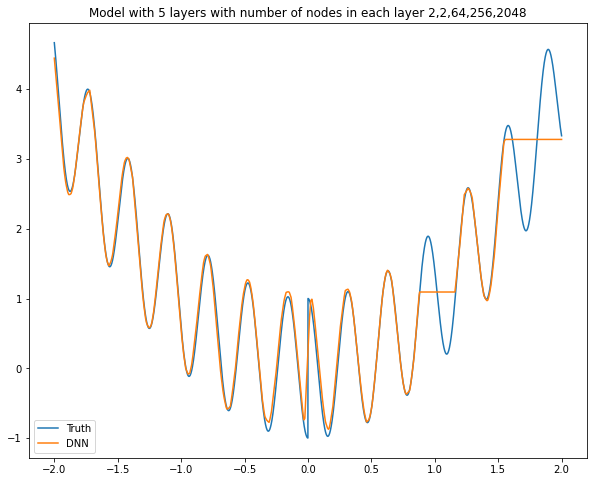

Model: "sequential_701"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4186 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4187 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4188 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4189 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4190 (Dense)           (None, 2)                 1026      
_________________________________________________________________
dense_4191 (Dense)           (None, 1)                 3         
Total params: 34,511
Trainable params: 34,511
Non-trainable params: 0
________________________________________________

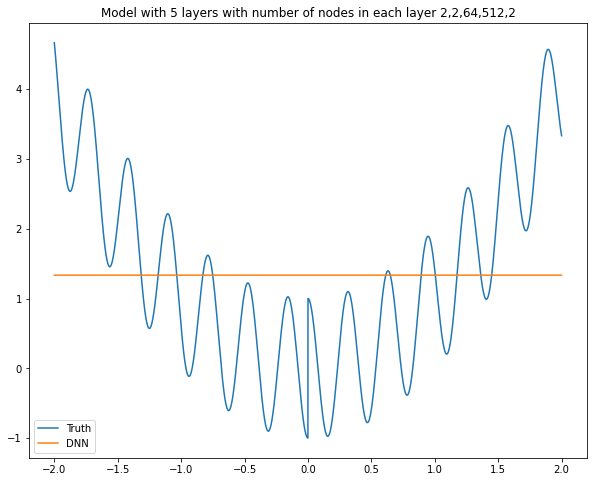

Model: "sequential_702"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4192 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4193 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4194 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4195 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4196 (Dense)           (None, 4)                 2052      
_________________________________________________________________
dense_4197 (Dense)           (None, 1)                 5         
Total params: 35,539
Trainable params: 35,539
Non-trainable params: 0
________________________________________________

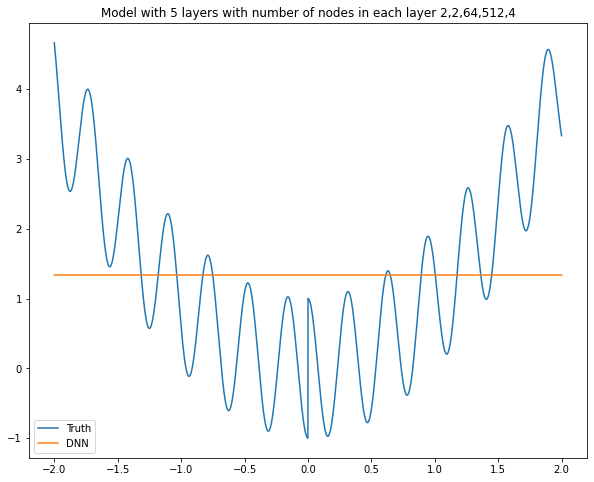

Model: "sequential_703"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4198 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4199 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4200 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4201 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4202 (Dense)           (None, 8)                 4104      
_________________________________________________________________
dense_4203 (Dense)           (None, 1)                 9         
Total params: 37,595
Trainable params: 37,595
Non-trainable params: 0
________________________________________________

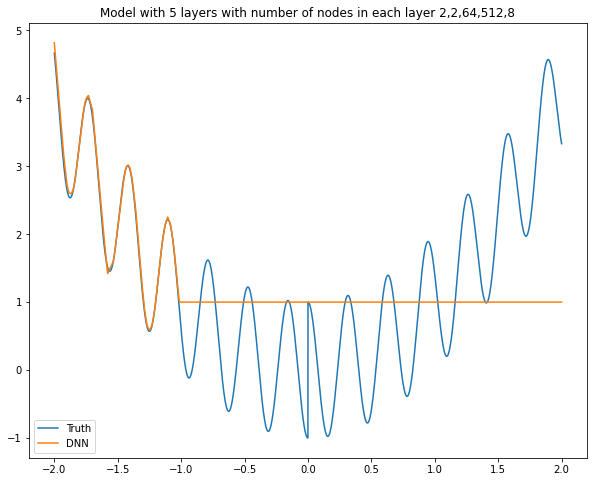

Model: "sequential_704"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4204 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4205 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4206 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4207 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4208 (Dense)           (None, 16)                8208      
_________________________________________________________________
dense_4209 (Dense)           (None, 1)                 17        
Total params: 41,707
Trainable params: 41,707
Non-trainable params: 0
________________________________________________

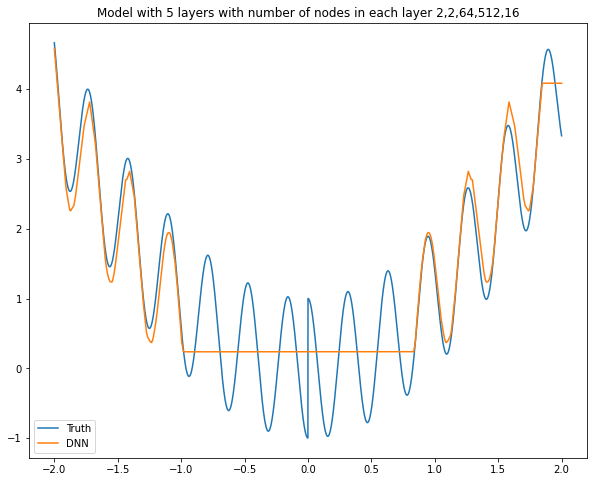

Model: "sequential_705"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4210 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4211 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4212 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4213 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4214 (Dense)           (None, 32)                16416     
_________________________________________________________________
dense_4215 (Dense)           (None, 1)                 33        
Total params: 49,931
Trainable params: 49,931
Non-trainable params: 0
________________________________________________

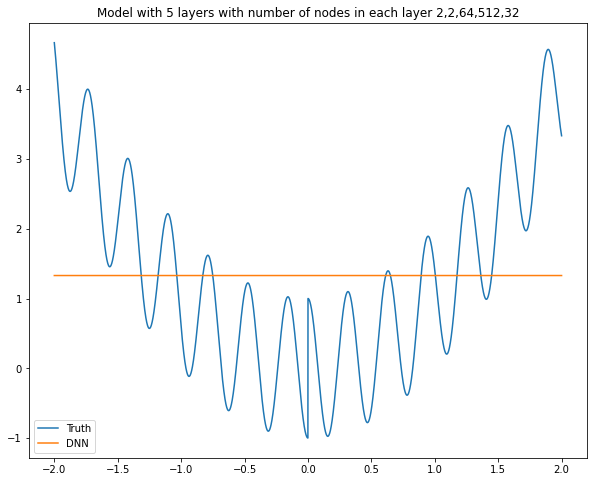

Model: "sequential_706"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4216 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4217 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4218 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4219 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4220 (Dense)           (None, 64)                32832     
_________________________________________________________________
dense_4221 (Dense)           (None, 1)                 65        
Total params: 66,379
Trainable params: 66,379
Non-trainable params: 0
________________________________________________

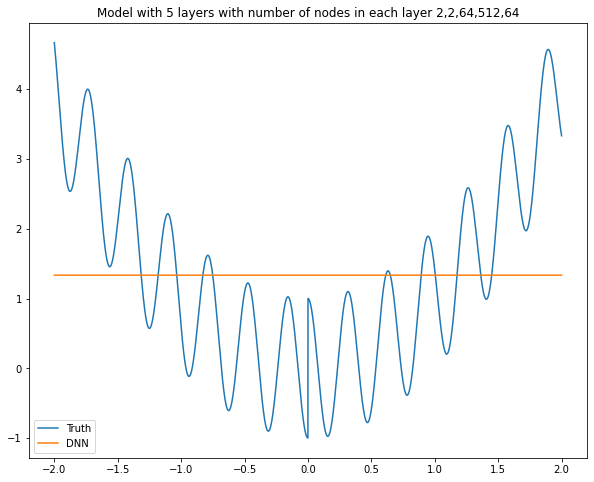

Model: "sequential_707"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4222 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4223 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4224 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4225 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4226 (Dense)           (None, 128)               65664     
_________________________________________________________________
dense_4227 (Dense)           (None, 1)                 129       
Total params: 99,275
Trainable params: 99,275
Non-trainable params: 0
________________________________________________

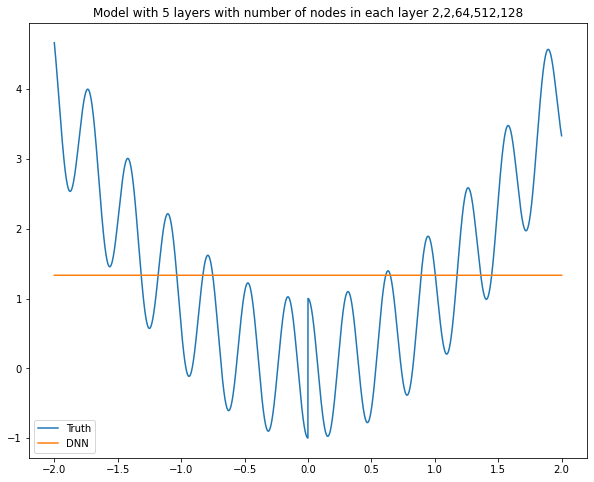

Model: "sequential_708"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4228 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4229 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4230 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4231 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4232 (Dense)           (None, 256)               131328    
_________________________________________________________________
dense_4233 (Dense)           (None, 1)                 257       
Total params: 165,067
Trainable params: 165,067
Non-trainable params: 0
______________________________________________

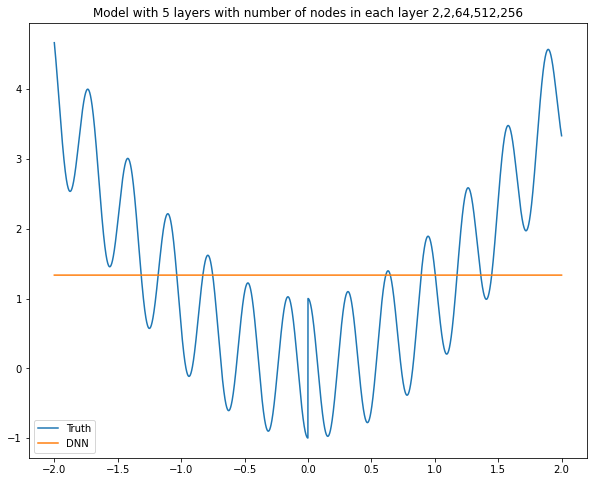

Model: "sequential_709"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4234 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4235 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4236 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4237 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4238 (Dense)           (None, 512)               262656    
_________________________________________________________________
dense_4239 (Dense)           (None, 1)                 513       
Total params: 296,651
Trainable params: 296,651
Non-trainable params: 0
______________________________________________

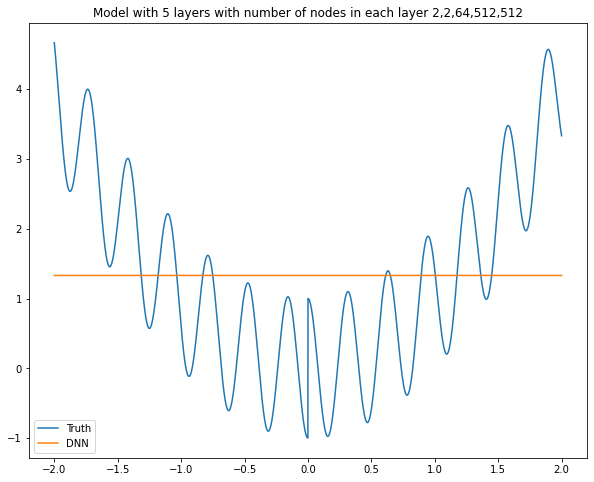

Model: "sequential_710"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4240 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4241 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4242 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4243 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4244 (Dense)           (None, 1024)              525312    
_________________________________________________________________
dense_4245 (Dense)           (None, 1)                 1025      
Total params: 559,819
Trainable params: 559,819
Non-trainable params: 0
______________________________________________

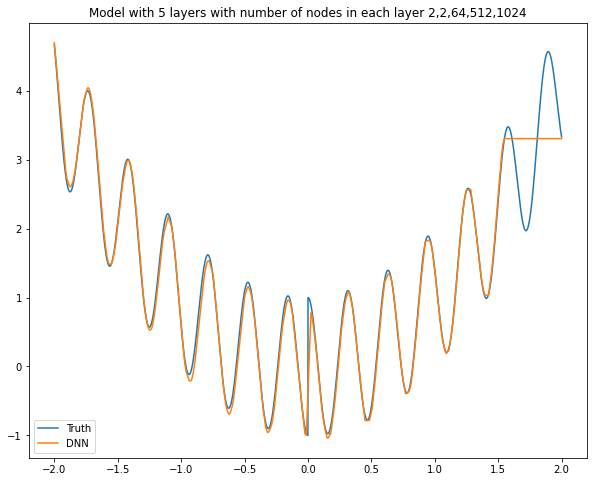

Model: "sequential_711"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4246 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4247 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4248 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4249 (Dense)           (None, 512)               33280     
_________________________________________________________________
dense_4250 (Dense)           (None, 2048)              1050624   
_________________________________________________________________
dense_4251 (Dense)           (None, 1)                 2049      
Total params: 1,086,155
Trainable params: 1,086,155
Non-trainable params: 0
__________________________________________

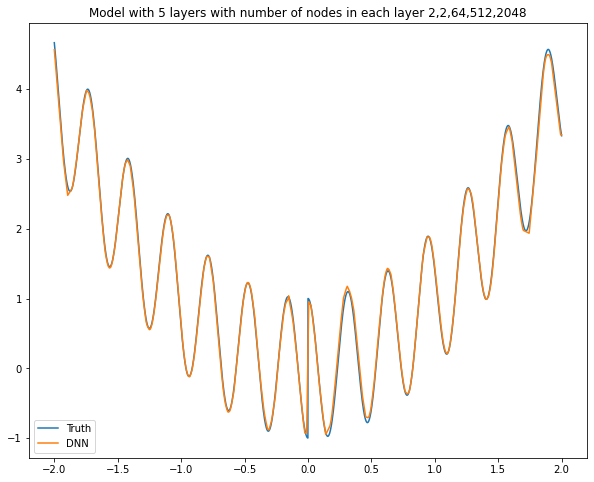

Model: "sequential_712"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4252 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4253 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4254 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4255 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4256 (Dense)           (None, 2)                 2050      
_________________________________________________________________
dense_4257 (Dense)           (None, 1)                 3         
Total params: 68,815
Trainable params: 68,815
Non-trainable params: 0
________________________________________________

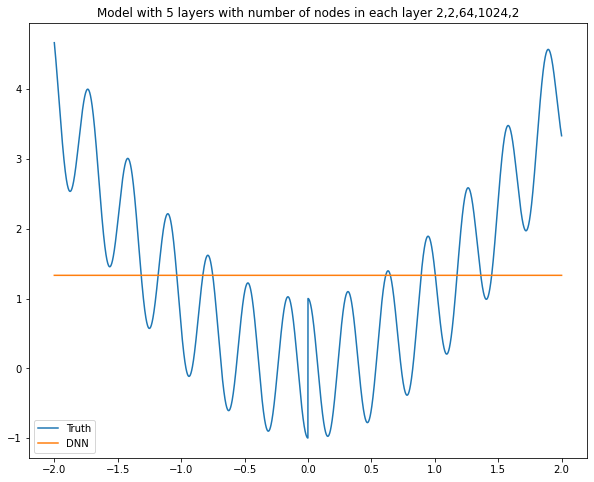

Model: "sequential_713"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4258 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4259 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4260 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4261 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4262 (Dense)           (None, 4)                 4100      
_________________________________________________________________
dense_4263 (Dense)           (None, 1)                 5         
Total params: 70,867
Trainable params: 70,867
Non-trainable params: 0
________________________________________________

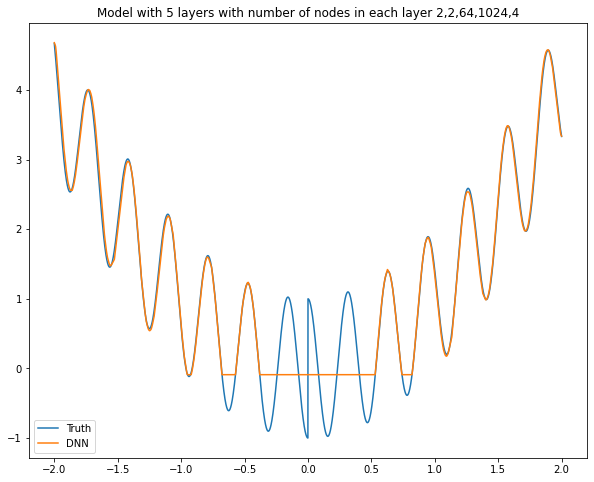

Model: "sequential_714"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4264 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4265 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4266 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4267 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4268 (Dense)           (None, 8)                 8200      
_________________________________________________________________
dense_4269 (Dense)           (None, 1)                 9         
Total params: 74,971
Trainable params: 74,971
Non-trainable params: 0
________________________________________________

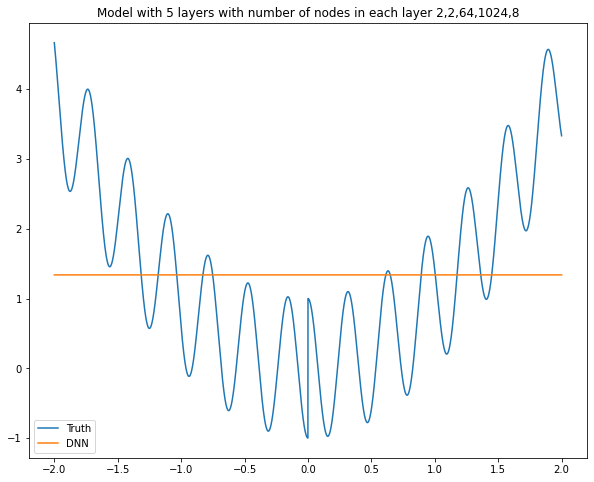

Model: "sequential_715"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4270 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4271 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4272 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4273 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4274 (Dense)           (None, 16)                16400     
_________________________________________________________________
dense_4275 (Dense)           (None, 1)                 17        
Total params: 83,179
Trainable params: 83,179
Non-trainable params: 0
________________________________________________

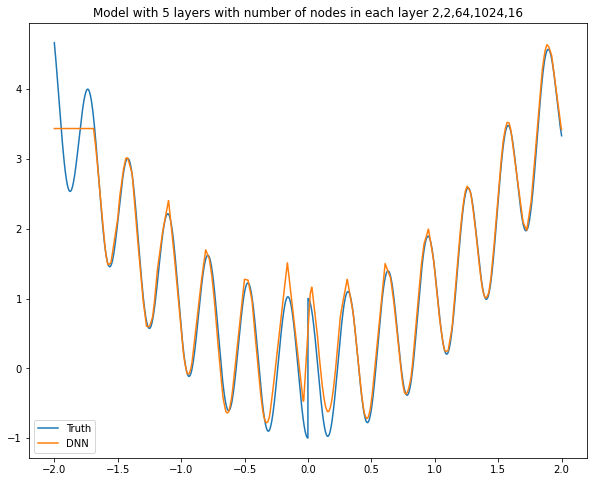

Model: "sequential_716"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4276 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4277 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4278 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4279 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4280 (Dense)           (None, 32)                32800     
_________________________________________________________________
dense_4281 (Dense)           (None, 1)                 33        
Total params: 99,595
Trainable params: 99,595
Non-trainable params: 0
________________________________________________

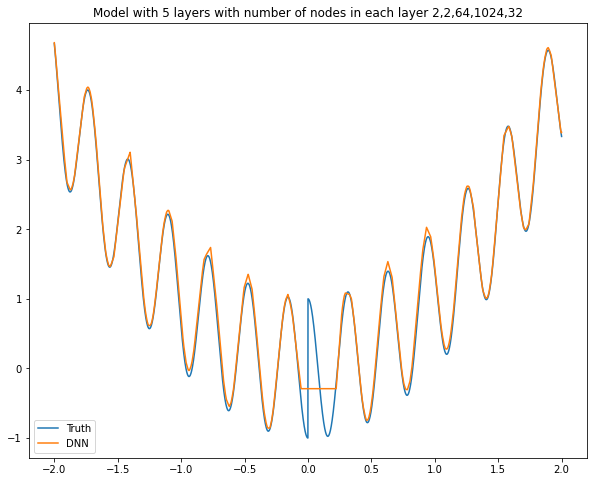

Model: "sequential_717"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4282 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4283 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4284 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4285 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4286 (Dense)           (None, 64)                65600     
_________________________________________________________________
dense_4287 (Dense)           (None, 1)                 65        
Total params: 132,427
Trainable params: 132,427
Non-trainable params: 0
______________________________________________

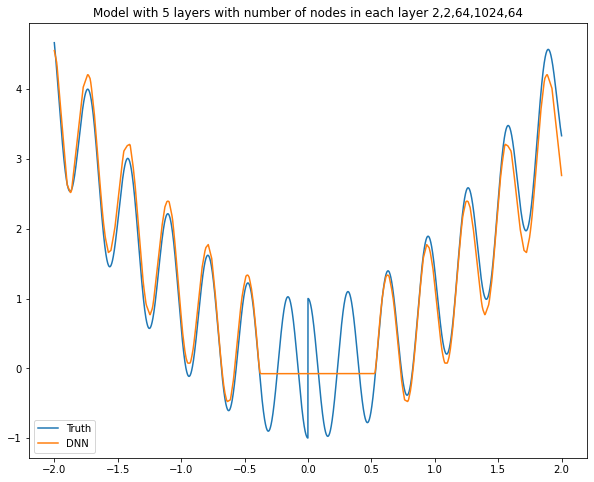

Model: "sequential_718"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4288 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4289 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4290 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4291 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4292 (Dense)           (None, 128)               131200    
_________________________________________________________________
dense_4293 (Dense)           (None, 1)                 129       
Total params: 198,091
Trainable params: 198,091
Non-trainable params: 0
______________________________________________

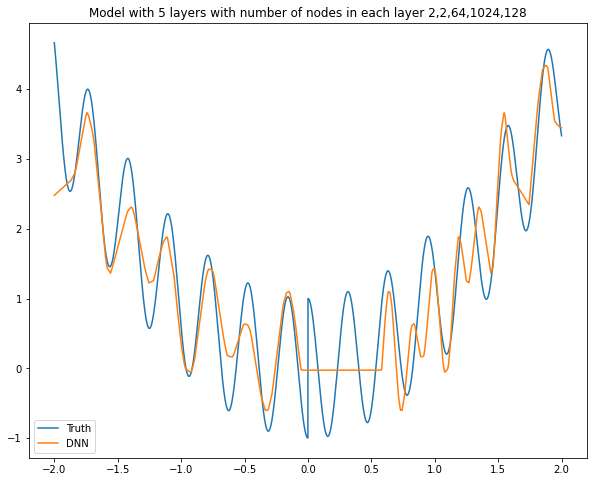

Model: "sequential_719"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4294 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4295 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4296 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4297 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4298 (Dense)           (None, 256)               262400    
_________________________________________________________________
dense_4299 (Dense)           (None, 1)                 257       
Total params: 329,419
Trainable params: 329,419
Non-trainable params: 0
______________________________________________

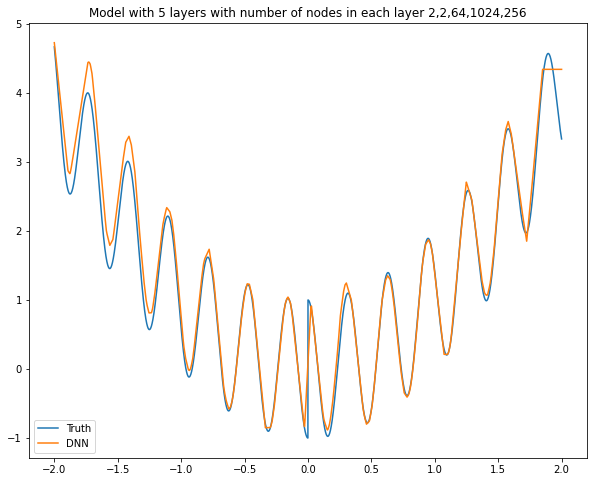

Model: "sequential_720"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4300 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4301 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4302 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4303 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4304 (Dense)           (None, 512)               524800    
_________________________________________________________________
dense_4305 (Dense)           (None, 1)                 513       
Total params: 592,075
Trainable params: 592,075
Non-trainable params: 0
______________________________________________

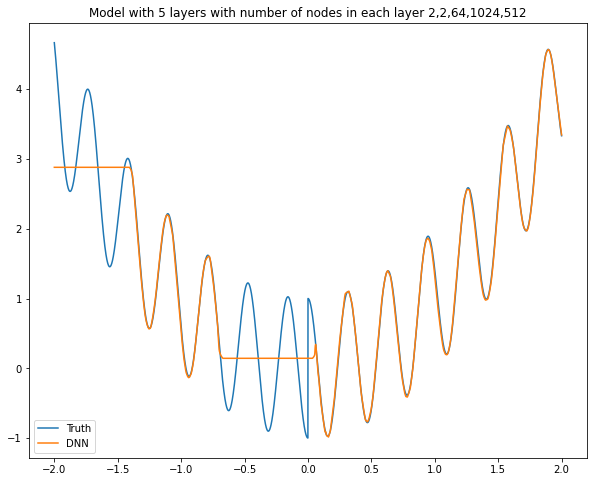

Model: "sequential_721"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4306 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4307 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4308 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4309 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4310 (Dense)           (None, 1024)              1049600   
_________________________________________________________________
dense_4311 (Dense)           (None, 1)                 1025      
Total params: 1,117,387
Trainable params: 1,117,387
Non-trainable params: 0
__________________________________________

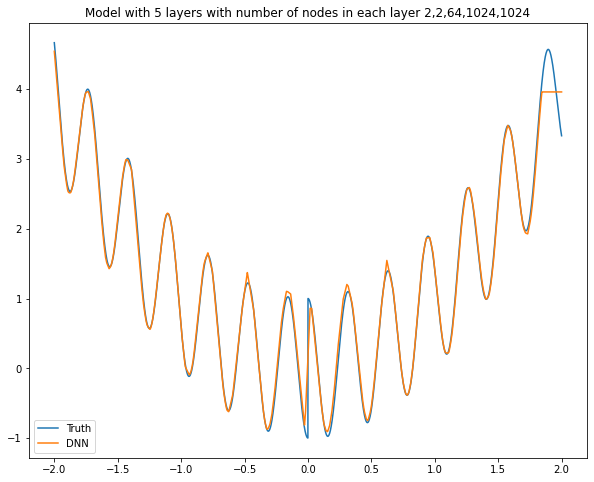

Model: "sequential_722"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4312 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4313 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4314 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4315 (Dense)           (None, 1024)              66560     
_________________________________________________________________
dense_4316 (Dense)           (None, 2048)              2099200   
_________________________________________________________________
dense_4317 (Dense)           (None, 1)                 2049      
Total params: 2,168,011
Trainable params: 2,168,011
Non-trainable params: 0
__________________________________________

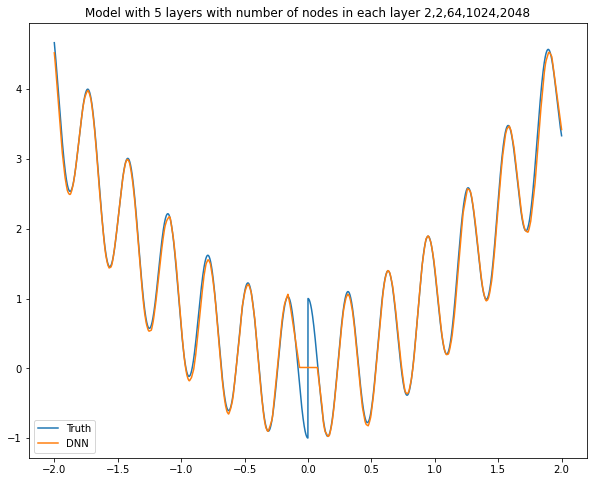

Model: "sequential_723"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4318 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4319 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4320 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4321 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4322 (Dense)           (None, 2)                 4098      
_________________________________________________________________
dense_4323 (Dense)           (None, 1)                 3         
Total params: 137,423
Trainable params: 137,423
Non-trainable params: 0
______________________________________________

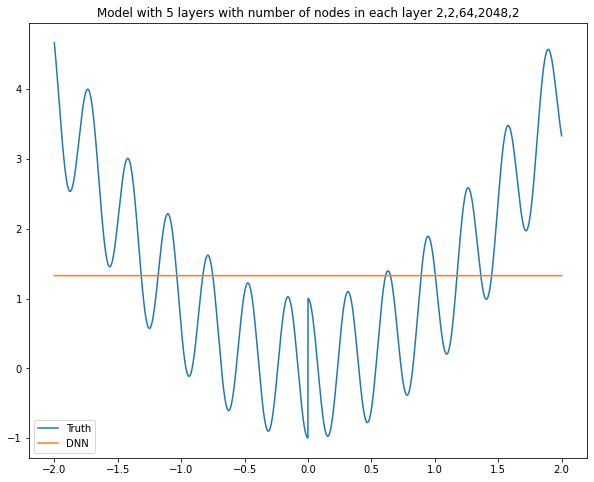

Model: "sequential_724"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4324 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4325 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4326 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4327 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4328 (Dense)           (None, 4)                 8196      
_________________________________________________________________
dense_4329 (Dense)           (None, 1)                 5         
Total params: 141,523
Trainable params: 141,523
Non-trainable params: 0
______________________________________________

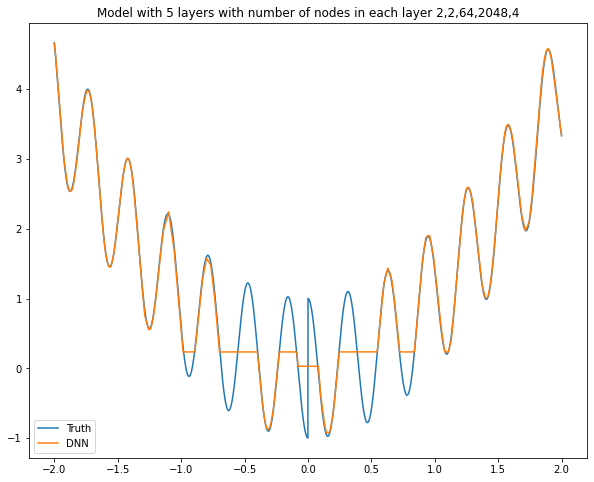

Model: "sequential_725"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4330 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4331 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4332 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4333 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4334 (Dense)           (None, 8)                 16392     
_________________________________________________________________
dense_4335 (Dense)           (None, 1)                 9         
Total params: 149,723
Trainable params: 149,723
Non-trainable params: 0
______________________________________________

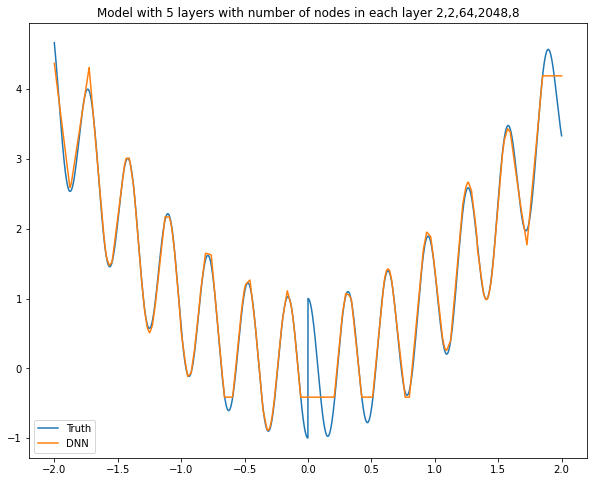

Model: "sequential_726"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4336 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4337 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4338 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4339 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4340 (Dense)           (None, 16)                32784     
_________________________________________________________________
dense_4341 (Dense)           (None, 1)                 17        
Total params: 166,123
Trainable params: 166,123
Non-trainable params: 0
______________________________________________

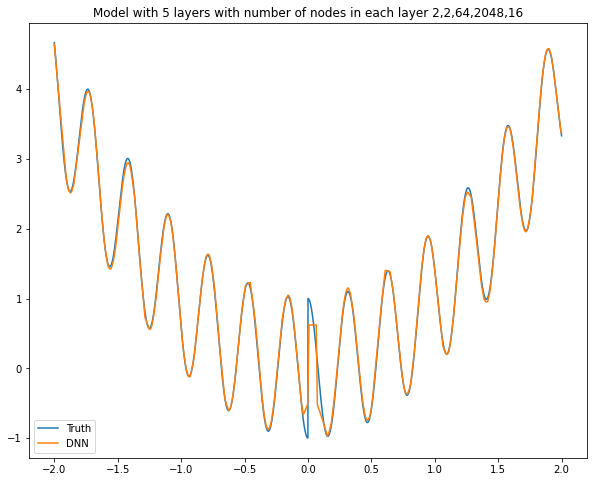

Model: "sequential_727"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4342 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4343 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4344 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4345 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4346 (Dense)           (None, 32)                65568     
_________________________________________________________________
dense_4347 (Dense)           (None, 1)                 33        
Total params: 198,923
Trainable params: 198,923
Non-trainable params: 0
______________________________________________

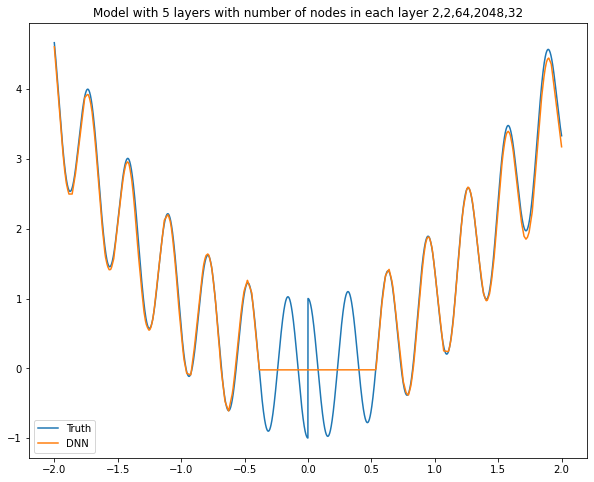

Model: "sequential_728"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4348 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4349 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4350 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4351 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4352 (Dense)           (None, 64)                131136    
_________________________________________________________________
dense_4353 (Dense)           (None, 1)                 65        
Total params: 264,523
Trainable params: 264,523
Non-trainable params: 0
______________________________________________

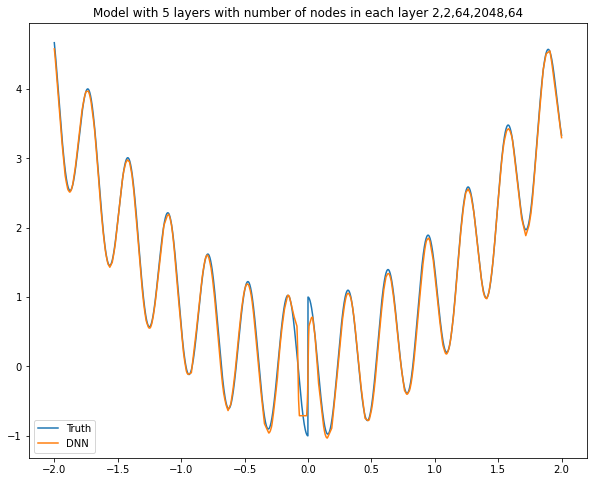

Model: "sequential_729"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4354 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4355 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4356 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4357 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4358 (Dense)           (None, 128)               262272    
_________________________________________________________________
dense_4359 (Dense)           (None, 1)                 129       
Total params: 395,723
Trainable params: 395,723
Non-trainable params: 0
______________________________________________

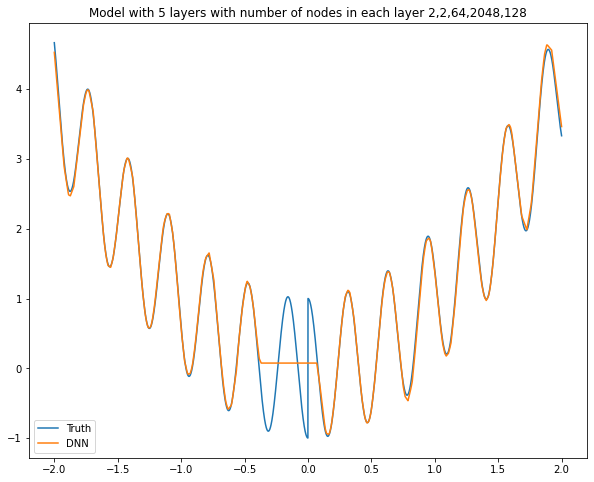

Model: "sequential_730"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4360 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4361 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4362 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4363 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4364 (Dense)           (None, 256)               524544    
_________________________________________________________________
dense_4365 (Dense)           (None, 1)                 257       
Total params: 658,123
Trainable params: 658,123
Non-trainable params: 0
______________________________________________

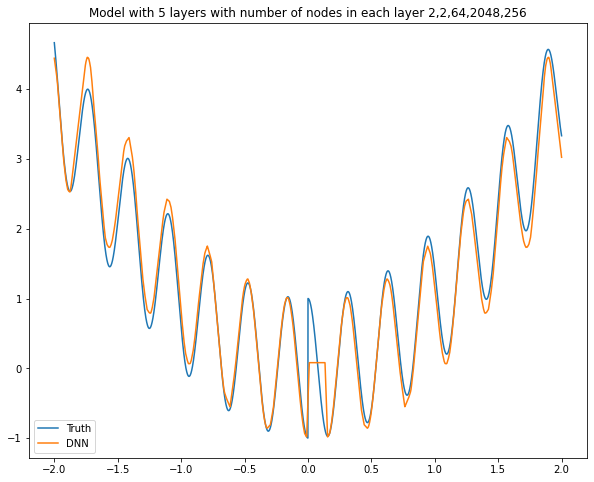

Model: "sequential_731"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4366 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4367 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4368 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4369 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4370 (Dense)           (None, 512)               1049088   
_________________________________________________________________
dense_4371 (Dense)           (None, 1)                 513       
Total params: 1,182,923
Trainable params: 1,182,923
Non-trainable params: 0
__________________________________________

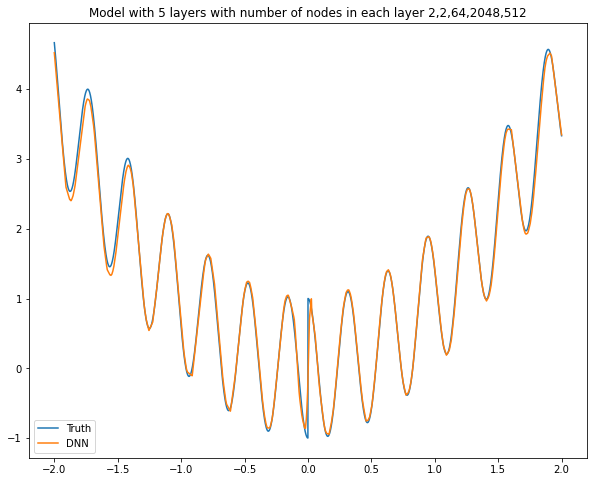

Model: "sequential_732"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4372 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4373 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4374 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4375 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4376 (Dense)           (None, 1024)              2098176   
_________________________________________________________________
dense_4377 (Dense)           (None, 1)                 1025      
Total params: 2,232,523
Trainable params: 2,232,523
Non-trainable params: 0
__________________________________________

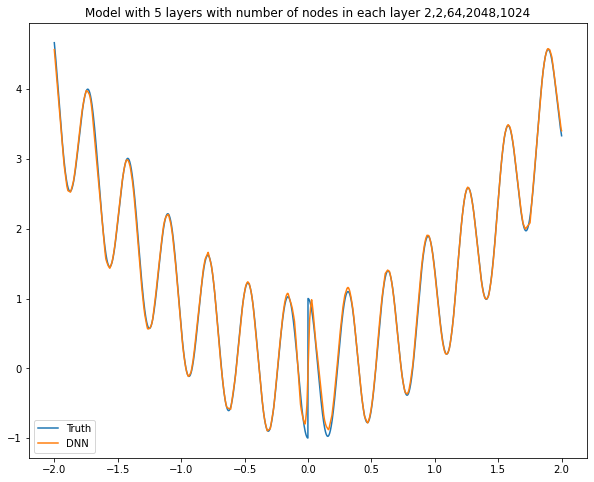

Model: "sequential_733"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4378 (Dense)           (None, 2)                 4         
_________________________________________________________________
dense_4379 (Dense)           (None, 2)                 6         
_________________________________________________________________
dense_4380 (Dense)           (None, 64)                192       
_________________________________________________________________
dense_4381 (Dense)           (None, 2048)              133120    
_________________________________________________________________
dense_4382 (Dense)           (None, 2048)              4196352   
_________________________________________________________________
dense_4383 (Dense)           (None, 1)                 2049      
Total params: 4,331,723
Trainable params: 4,331,723
Non-trainable params: 0
__________________________________________

In [ ]:
#for fun, do not run this unless you believe in your pc (mb collab is smart to use)
nodes = [2,4,8,16,32,64,128,256,512,1024,2048]
for n1 in nodes:
    for n2 in nodes:
        for n3 in nodes:
            for n4 in nodes:
                for n5 in nodes:
                    model = keras.Sequential([
                        keras.layers.Dense(n1, activation=tf.nn.relu, input_dim=1),
                        keras.layers.Dense(n2, activation=tf.nn.relu),
                        keras.layers.Dense(n3, activation=tf.nn.relu),
                        keras.layers.Dense(n4, activation=tf.nn.relu),
                        keras.layers.Dense(n5, activation=tf.nn.relu),
                        keras.layers.Dense(1)
                    ])
                    model.summary()

                    # Train the model
                    model.compile(loss='mean_squared_error',
                                  optimizer="adam",
                                  metrics=['accuracy'])

                    history = model.fit(x, f(x), epochs=1000, batch_size=128, verbose=0)
                    z = model.predict(x)
                    plt.figure(figsize=(10,8))
                    plt.title(f'Model with 5 layers with number of nodes in each layer {n1},{n2},{n3},{n4},{n5}')
                    plt.plot(x,f(x),label="Truth")
                    plt.plot(x,z,label="DNN")
                    plt.legend()
                    plt.show()



In [ ]:
#2,2,16,64,512
#2,2,32,2048,256
#2,2,64,512,2048
M = 16
layer = keras.layers.Dense(M, activation=tf.nn.relu)
layers = [keras.layers.Dense(M, activation=tf.nn.relu, input_dim=1)]
for l in range(0,15):
    
    model = keras.Sequential(layers)
    model.summary()

# Train the model
    model.compile(loss='mean_squared_error',
                  optimizer="adam",
                  metrics=['accuracy'])

    history= model.fit(x, f(x), epochs=1000, batch_size=128, verbose=0)
    
    z = model.predict(x)
    plt.figure(figsize=(10,8))
    plt.title(f'Model with {len(layers)} layers, each with 16 nodes')
    plt.plot(x,f(x),label="Truth")
    plt.plot(x,z,label="DNN")
    plt.legend()
    plt.show()
    layers.append(layer)

## Problem 4
Using the best setup from the previous problem, train a model using the noisy data.

In [ ]:

M = 16
model = keras.Sequential([
    keras.layers.Dense(10*M, activation=tf.nn.relu, input_dim=1),
    keras.layers.Dense(10*M, activation=tf.nn.relu),
    keras.layers.Dense(4*M, activation=tf.nn.relu),
    keras.layers.Dense(6*M, activation=tf.nn.relu),
    keras.layers.Dense(1)
])
model.summary()

# Train the model
model.compile(loss='mean_squared_error',
              optimizer="adam",
              metrics=['accuracy'])

history = model.fit(x, y, epochs=1000, batch_size=128, verbose=True)